In [1]:

from scipy.optimize import minimize

from functools import partial
from scipy.interpolate import interp1d

In [2]:
import numpy as np
import pandas as pd
#from ct import app,db
#from ct.models import *
#from ct.utils import *
from IPython.display import display, HTML
from IPython.display import IFrame as iframe

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf
cf.go_offline()
init_notebook_mode(connected=True)
import plotly.graph_objs as go
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
import qgrid
gr=qgrid.show_grid
pd.core.frame.DataFrame.gr=gr
import requests
#from ct.fs import SequentialFeatureSelector,BorutaPy
#from ct.fs import TimeSeriesSplit,runselector,fs1
%matplotlib inline
# if qgrid not shown run and restar jupyter:
#jupyter nbextension enable --py --sys-prefix qgrid
#jupyter nbextension enable --py --sys-prefix widgetsnbextension
#
#

In [3]:
import sys
sys.path.insert(1,"/core/github/cryptoderiv-quant-lib")

In [4]:
import pandas as pd
from datetime import datetime
import json
import cryptoderiv_quantlib as cq
from pytest import approx
from tests import utils as test_utils
from cryptoderiv_quantlib import VolModels
from cryptoderiv_quantlib import VolCurve, VolSurface, StickyOptions

In [5]:
# df0 = pd.read_pickle("bt_spikeDec_MAR22.pkl")
df0 = pd.read_pickle("/core/data/bt_spikeDec_MAR22.pkl")
#df0 = df0.append(pd.read_pickle("bt_spikeDec_DEC21.pkl"))
df1 = df0[['tm','expire','strike','ty','s','aiv','biv','vega']].reset_index(drop=True).sort_values(by=['tm','expire','strike']).drop_duplicates().reset_index(drop=True)
df1['params'] = [{} for i in range(len(df1))]
df1['tm'] = [int(df1['tm'][i].timestamp()*1000) for i in range(len(df1))]
df1['expire'] = [int(df1['expire'][i].timestamp()*1000) for i in range(len(df1))]

FileNotFoundError: [Errno 2] No such file or directory: '/core/data/bt_spikeDec_MAR22.pkl'

In [ ]:
#df = df1[df1.tm<=1638316800000+60000*0].set_index(['tm','expire','strike'])
df = df1.set_index(['tm','expire','strike'])
df

In [ ]:
#df.loc[([1638316800000],[1648195200000]),:]

In [ ]:
#df1['tm'].unique()

In [7]:
def step_err(aiv, biv, myiv):
    aiv = np.array(aiv)
    biv = np.array(biv)
    myiv = np.array(myiv)
    miv = 0.5 * (aiv + biv)
    halfspread = 0.5 * np.abs(aiv - biv)
    raw_err = np.abs(myiv - miv) 
    squared_err = raw_err * raw_err 
    step_err = raw_err + 999*(raw_err>halfspread)*(raw_err)
    squared_step_err = step_err * step_err
    return raw_err, step_err, squared_err, squared_step_err

# step_err([1.1,2.2,3.3,4.4,5.5],[1.,2.,3.,4.,5.],[1.1001,2.2,3.15,4.20,5.25])

In [8]:
#a.curves[0].params
#dir(a.curves[0])


In [75]:
def err_fun2(curve,df,useprevATMvol=True):
    x = [curve.params['skew_left'], curve.params['skew_right'], 
         curve.params['conv_left'], curve.params['conv_right'], 
         curve.params['rightwing'], curve.params['leftwing'], curve.params['vol_atm']]
        
    return err_fun3(x,df,useprevATMvol=True)
    
def err_fun3(x,df,useprevATMvol=True):
    skewleft=x[0]
    skewright=x[1]
    leftconv=x[2]
    rightconv=x[3]
    rightwing=x[4]
    leftwing=x[5]
    
    df['m'] = 0.5*(df['aiv']+df['biv'])
    S=df['s'].iloc[0]
    if useprevATMvol:
        volATM = x[6]
    else:
        volATM=interp1d(df.index, df['m'])([S])[0]

    kwargs = model._default_vol_model_config()
    kright=kwargs['kright']
    kleft=kwargs['kleft']
    
    df.loc[(df.logKFtau>=0)&(df.logKFtau<kright),'myvol']=volATM+(skewright*df['logKFtau']+rightconv*df['logKFtau']**2)
    df.loc[(df.logKFtau<0)&(df.logKFtau>kleft),'myvol']=volATM+(-skewleft*df['logKFtau']+leftconv*df['logKFtau']**2)
    yright=volATM+(skewright*kright+rightconv*kright**2)
    yleft=volATM+(-skewleft*kleft+leftconv*kleft**2)
    df.loc[(df.logKFtau>=kright),'myvol']=rightwing*(df['logKFtau']-kright)+yright
    df.loc[(df.logKFtau<=kleft),'myvol']=-leftwing*(df['logKFtau']-kleft)+yleft
    df['insidebidask']=False
    df.loc[(df.myvol>df.biv)&(df.myvol<df.aiv),'insidebidask']=True
    
    res0=(df['myvol']-df['m'])**2
    
    usevega = True
    useweights = False
    
    if usevega:
      if df['vega'].sum() != 0:
        res0*=df['vega']/df['vega'].sum()

#       if useweights:
#         ws=np.ones(len(df))
#         df['w']=np.ones(len(df))
#         df.loc[df['logKFtau']>2,'w']=0
#         df.loc[df['logKFtau']<-2,'w']=0
#         res*=df['w']
    return np.sqrt(res0.mean())

In [27]:
MODEL_TO_TEST = "parabolic_linear6"
model = VolModels.vol_model(MODEL_TO_TEST)

#dir(a.curves[0])
def err_fun1(curve,dftTOTM):
    x = [curve.params['skew_left'], curve.params['skew_right'], 
         curve.params['conv_left'], curve.params['conv_right'], 
         curve.params['rightwing'], curve.params['leftwing']]
    MODEL_TO_TEST = "parabolic_linear6"
    model = VolModels.vol_model(MODEL_TO_TEST)
    return np.sqrt(model._err_fun(x, usevega=True, df=dftTOTM, **model._default_vol_model_config()))
    
    

ts = df.index.get_level_values("tm").drop_duplicates()
res = []
res2 = []
errors = []
curve_configs = []
last_valid_curve = None
thres1 = 0.002
thres2 = 0.0015
cooldown_flag = False
change_curve_counter = 0 

from_pkl = True

if not from_pkl:
    for t in ts:
        dft = df.loc[[t]].droplevel("tm")
        Ts = dft.index.get_level_values("expire").drop_duplicates()
        for T in Ts:
            expiryStr = datetime.utcfromtimestamp(T / 1000).strftime("%Y-%m-%d %H:%M:%S")

            dftT = None
            try:
                dftT = dft.loc[[T]].droplevel("expire")
                tau = (T - t) / (1000 * 60 * 60 * 24 * 365)
                dftT["logKFtau"] = np.log(dftT.index / dftT["s"]) / np.sqrt(tau)
                S = dftT["s"].iloc[0]
                dftTOTM2 = dftT[
                              ((dftT.ty == 1) & (S < dftT.index))
                              | ((dftT.ty == -1) & (S > dftT.index))
                              ]

                if len(dftTOTM2) == 0:
                    continue

                __fitted_vol_pl6 = model._trigger_vol_fit(df.loc[([t],[T]),:], plot=False, vol_model_config_in={
                                                          "eps": 1e-09,
                                                          "maxfun": 100,
                                                          "maxiter": 100,
                                                          "kright": 1.5,
                                                          "kleft": -1.5,
                                                        })
                #print(dftTOTM2)
                err1 = err_fun1(__fitted_vol_pl6.curves[0], dftTOTM2)
                curr_err = err1
                #print(err1)
                #res.append([t, T, dftTOTM2, 
                #            __fitted_vol_pl6.curves[0], err1]) 
                print("x")

                if last_valid_curve is None:
                    last_valid_curve = __fitted_vol_pl6.curves[0]
                err2 = err_fun2(last_valid_curve, dftTOTM2)

                if cooldown_flag:
                    if err1 <= thres2:
                        # use new curve
                        last_valid_curve = __fitted_vol_pl6.curves[0]
                        curr_err = err1 
                        cooldown_flag = False
                        change_curve_counter = change_curve_counter +1 

                    else:
                        # keep the last_valid_curve
                        curr_err = err2

                else: # not on cooldown, use high threshold
                    if err2 <= thres1:
                        # keep the last_valid_curve
                        curr_err = err2 

                    elif err1 > thres1:
                        # freeze the last valid curve, wait for cooldown 
                        curr_err = err2
                        cooldown_flag = True

                    else:
                        # use new curve
                        last_valid_curve = __fitted_vol_pl6.curves[0]
                        curr_err = err1
                        change_curve_counter = change_curve_counter +1 

                res2.append([t, T, dftTOTM2, __fitted_vol_pl6.curves[0],
                             last_valid_curve, 
                             err1, err2, curr_err,      # 5,6,7
                             change_curve_counter 
                            ])
                print('y')


            except:
                pass
    
    else:
        res2 = pd.read_pickle('res2.pkl')

# pd.DataFrame(res2).to_pickle('res2.pkl')

pricing: tau=0.3132420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0394972  -0.03876594  0.03128399  0.05844013  0.14214935  0.11956141]
x
y
pricing: tau=0.3132401065449011


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04472579 -0.03809193  0.02738874  0.05904482  0.14101452  0.12020241]
x
y
pricing: tau=0.31323820395738206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03957826 -0.04508457  0.02832056  0.06296819  0.14013321  0.1227195 ]
x
y
pricing: tau=0.313236301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03852676 -0.0496242   0.02785575  0.0653228   0.13897497  0.12304677]
x
y
pricing: tau=0.313234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04550351 -0.04605917  0.02495621  0.06324394  0.14095802  0.12206127]
x
y
pricing: tau=0.31323249619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04235959 -0.04571192  0.02728159  0.06278063  0.13971084  0.12085211]
x
y
pricing: tau=0.31323059360730593


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04342074 -0.04485175  0.02737578  0.06270299  0.13921402  0.12227784]
x
y
pricing: tau=0.3132286910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04154846 -0.0469121   0.02936699  0.06456761  0.13800409  0.12180551]
x
y
pricing: tau=0.31322678843226787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03088065 -0.0551422   0.03602743  0.06743871  0.14064537  0.11741293]
x
y
pricing: tau=0.31322488584474883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04564476 -0.04286179  0.02731115  0.0613535   0.1400403   0.12166664]
x
y
pricing: tau=0.31322298325722986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04369718 -0.04359427  0.02837935  0.06198299  0.13834139  0.1259183 ]
x
y
pricing: tau=0.3132210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03514725 -0.04470726  0.03470189  0.06285599  0.13751332  0.12224287]
x
y
pricing: tau=0.3132191780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03935028 -0.04742382  0.03246044  0.06414259  0.139244    0.12204849]
x
y
pricing: tau=0.31321727549467276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04152108 -0.04324244  0.03008681  0.06213887  0.13827404  0.12254377]
x
y
pricing: tau=0.31321537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03378142 -0.04338465  0.03502245  0.06225096  0.13866197  0.12014595]
x
y
pricing: tau=0.3132134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03965951 -0.0461488   0.03168528  0.06335566  0.13897383  0.12002943]
x
y
pricing: tau=0.31321156773211567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03330153 -0.04671519  0.03542586  0.06385432  0.13844551  0.12007689]
x
y
pricing: tau=0.31320966514459664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03750736 -0.04304669  0.03355865  0.06223816  0.13832194  0.11947678]
x
y
pricing: tau=0.3132077625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03213134 -0.04750959  0.03650524  0.06453491  0.13827338  0.11850607]
x
y
pricing: tau=0.3132058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05078786 -0.04005758  0.02500283  0.06063948  0.13716207  0.12525692]
x
y
pricing: tau=0.3132039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04422278 -0.04158563  0.02985367  0.06119967  0.13863881  0.11984439]
x
y
pricing: tau=0.31320205479452057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04098629 -0.04144504  0.03206078  0.0612159   0.13861674  0.12011924]
x
y
pricing: tau=0.31320015220700154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04176817 -0.04031562  0.03189917  0.06044098  0.13887355  0.11973824]
x
y
pricing: tau=0.3131982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04182598 -0.04139174  0.03186992  0.06132136  0.13865904  0.11966066]
x
y
pricing: tau=0.3131963470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03866813 -0.04093027  0.03374886  0.06056833  0.13886591  0.11915261]
x
y
pricing: tau=0.31319444444444444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03680514 -0.04209357  0.03486263  0.06144855  0.13865568  0.11890823]
x
y
pricing: tau=0.3131925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03296058 -0.04242926  0.03719917  0.06142605  0.13856336  0.11817745]
x
y
pricing: tau=0.3131906392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03655267 -0.04048768  0.03505606  0.06022809  0.13879755  0.11880857]
x
y
pricing: tau=0.31318873668188735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0411832  -0.04145997  0.03224307  0.06127183  0.13871338  0.11968775]
x
y
pricing: tau=0.3131868340943683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04275442 -0.0438014   0.03115025  0.06240069  0.13918897  0.12169258]
x
y
pricing: tau=0.31318493150684934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02698794 -0.05818957  0.03866334  0.06954282  0.13802793  0.12362397]
x
y
pricing: tau=0.3131830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05401133 -0.02911212  0.02599576  0.05440806  0.13939218  0.12480627]
x
y
pricing: tau=0.3131811263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04934544 -0.03372698  0.02640602  0.05682972  0.1383229   0.13144579]
x
y
pricing: tau=0.31317922374429225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03744081 -0.03970712  0.03440025  0.05942853  0.14022441  0.12326068]
x
y
pricing: tau=0.3131773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03624645 -0.04242444  0.03475867  0.06156671  0.13915596  0.12321244]
x
y
pricing: tau=0.3131754185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03134801 -0.04579169  0.03722213  0.06354266  0.13861138  0.1235564 ]
x
y
pricing: tau=0.31317351598173515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0330231  -0.0471412   0.035182    0.06452715  0.1391764   0.12479685]
x
y
pricing: tau=0.3131716133942161


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03462185 -0.04464111  0.03286858  0.06288324  0.13960536  0.12965624]
x
y
pricing: tau=0.3131697108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0363884  -0.04520675  0.03258724  0.06181546  0.14194283  0.12447544]
x
y
pricing: tau=0.31316780821917806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03792668 -0.04461605  0.03325392  0.06225037  0.14056662  0.12025827]
x
y
pricing: tau=0.3131659056316591


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0374722  -0.04194039  0.03419305  0.06173322  0.13921368  0.12101008]
x
y
pricing: tau=0.31316400304414005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04175964 -0.03921324  0.03151386  0.06005236  0.1384505   0.12396436]
x
y
pricing: tau=0.313162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03872031 -0.03974498  0.03391018  0.05999081  0.14008196  0.12139388]
x
y
pricing: tau=0.313160197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03546279 -0.04270701  0.03543763  0.06188797  0.13963021  0.12157079]
x
y
pricing: tau=0.31315829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03366422 -0.04276711  0.03653027  0.06181287  0.13956863  0.1211771 ]
x
y
pricing: tau=0.3131563926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03114237 -0.04091444  0.03812366  0.06023489  0.13990725  0.12057265]
x
y
pricing: tau=0.3131544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03809122 -0.03972788  0.03382166  0.0598811   0.13975595  0.12202738]
x
y
pricing: tau=0.31315258751902586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04330976 -0.04375994  0.02872476  0.06214786  0.13995507  0.12751768]
x
y
pricing: tau=0.31315068493150683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0452237  -0.03623336  0.02875755  0.05784894  0.13921204  0.12860743]
x
y
pricing: tau=0.3131487823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04524276 -0.03664404  0.02876126  0.05799686  0.13937889  0.12849784]
x
y
pricing: tau=0.3131468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04739498 -0.03683528  0.02730224  0.05882742  0.13781069  0.12990176]
x
y
pricing: tau=0.3131449771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04427344 -0.04068977  0.02933742  0.06015208  0.14034863  0.12657409]
x
y
pricing: tau=0.31314307458143076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04029709 -0.03699662  0.0323754   0.05805065  0.13854473  0.12699949]
x
y
pricing: tau=0.3131411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05135278 -0.03016899  0.02655936  0.05419214  0.13958371  0.12598038]
x
y
pricing: tau=0.3131392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04961239 -0.03268189  0.02801045  0.05654897  0.13896414  0.1252704 ]
x
y
pricing: tau=0.31313736681887366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0448283  -0.03487322  0.03041898  0.05701846  0.139893    0.12487358]
x
y
pricing: tau=0.31313546423135463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04497622 -0.03354022  0.02994577  0.05609368  0.1394815   0.12798228]
x
y
pricing: tau=0.3131335616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03936074 -0.03351201  0.03392349  0.05681234  0.13868672  0.12548138]
x
y
pricing: tau=0.31313165905631657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04756435 -0.03022706  0.02932309  0.05466342  0.13943098  0.12484841]
x
y
pricing: tau=0.31312975646879754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04617767 -0.03455442  0.02952761  0.05726772  0.13941045  0.12545412]
x
y
pricing: tau=0.31312785388127856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04127113 -0.03475918  0.03243058  0.05636798  0.14078874  0.12259792]
x
y
pricing: tau=0.31312595129375953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04310365 -0.03658891  0.03066353  0.05756182  0.14049845  0.12399962]
x
y
pricing: tau=0.3131240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04233806 -0.03640657  0.03123703  0.05749216  0.14044618  0.12376291]
x
y
pricing: tau=0.31312214611872147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04680149 -0.03649545  0.02822496  0.05810375  0.13851878  0.12707828]
x
y
pricing: tau=0.31312024353120244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03952753 -0.03516665  0.03325768  0.05667189  0.14065535  0.12319334]
x
y
pricing: tau=0.3131183409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04053895 -0.03780041  0.03218574  0.05851938  0.1399745   0.12306653]
x
y
pricing: tau=0.3131164383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04173826 -0.03853755  0.03112896  0.05888936  0.13992283  0.12263469]
x
y
pricing: tau=0.31311453576864534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04193574 -0.03843878  0.03100564  0.05882813  0.13995431  0.12269411]
x
y
pricing: tau=0.3131126331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04742536 -0.03933448  0.02575442  0.0597454   0.13800363  0.13026037]
x
y
pricing: tau=0.3131107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04865548 -0.03912404  0.02500275  0.05967078  0.13812676  0.13036335]
x
y
pricing: tau=0.3131088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0402214  -0.04222772  0.03184138  0.06073926  0.14000136  0.12027553]
x
y
pricing: tau=0.31310692541856927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03875247 -0.0445517   0.03286625  0.06256673  0.13963619  0.11986076]
x
y
pricing: tau=0.31310502283105024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03247633 -0.04705797  0.03653176  0.06384382  0.13948856  0.11905211]
x
y
pricing: tau=0.3131031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04322872 -0.04113977  0.03015917  0.06116645  0.139467    0.10704253]
x
y
pricing: tau=0.3131012176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04444337 -0.03934928  0.02986049  0.06013531  0.1395192   0.10709353]
x
y
pricing: tau=0.31309931506849314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05194141 -0.04568059  0.01982657  0.06405063  0.14231681  0.14810514]
x
y
pricing: tau=0.3130974124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05028189 -0.04384578  0.021548    0.06268983  0.14287725  0.14996477]
x
y
pricing: tau=0.3130955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04542142 -0.04521215  0.024142    0.0624397   0.14349246  0.14916821]
x
y
pricing: tau=0.31309360730593605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05528464 -0.04268612  0.0181982   0.06140955  0.14474922  0.14803362]
x
y
pricing: tau=0.3130917047184171


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05401877 -0.04299554  0.01842997  0.06015168  0.14668697  0.14862404]
x
y
pricing: tau=0.31308980213089804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0504848  -0.04597472  0.02026718  0.0633636   0.14407083  0.14943095]
x
y
pricing: tau=0.313087899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05285936 -0.04685549  0.01882914  0.06376879  0.14421038  0.14907295]
x
y
pricing: tau=0.31308599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05234808 -0.04375124  0.01965229  0.06201963  0.14436464  0.1486137 ]
x
y
pricing: tau=0.31308409436834095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05227046 -0.04455829  0.01947675  0.06236023  0.14435792  0.14868152]
x
y
pricing: tau=0.3130821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05326584 -0.0432      0.01889818  0.06073745  0.14566076  0.14858452]
x
y
pricing: tau=0.3130802891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05396982 -0.04304191  0.0182815   0.06012777  0.14663845  0.1482789 ]
x
y
pricing: tau=0.31307838660578385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04740539 -0.04293569  0.02166528  0.05973033  0.14637672  0.14924285]
x
y
pricing: tau=0.3130764840182648


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04721889 -0.04712975  0.02137719  0.06290947  0.14544932  0.15004485]
x
y
pricing: tau=0.3130745814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0482455  -0.04611782  0.02109939  0.06221397  0.14580607  0.14969439]
x
y
pricing: tau=0.3130726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04822686 -0.04549879  0.02131244  0.06221678  0.14501609  0.14929428]
x
y
pricing: tau=0.3130707762557078


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04861516 -0.04560476  0.02100563  0.0622768   0.14503057  0.1493037 ]
x
y
pricing: tau=0.31306887366818875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04897612 -0.04262457  0.02163386  0.05967211  0.14620539  0.14813393]
x
y
pricing: tau=0.3130669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04984755 -0.04455482  0.02040634  0.06149803  0.14495874  0.14911729]
x
y
pricing: tau=0.3130650684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04866771 -0.0445302   0.02244233  0.06193887  0.14055581  0.14282487]
x
y
pricing: tau=0.31306316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03874686 -0.04354908  0.03126671  0.06014929  0.14298745  0.13234689]
x
y
pricing: tau=0.3130612633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04537581 -0.04375542  0.02554546  0.0608225   0.14144714  0.14126655]
x
y
pricing: tau=0.3130593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04483765 -0.04291631  0.02583145  0.0603581   0.14120462  0.14126103]
x
y
pricing: tau=0.31305745814307456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0369115  -0.04340725  0.0322303   0.06020004  0.14234522  0.13270873]
x
y
pricing: tau=0.31305555555555553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04731892 -0.04655788  0.02153225  0.06191799  0.14325096  0.14972294]
x
y
pricing: tau=0.31305365296803656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04925944 -0.04359514  0.02041759  0.06040324  0.14365523  0.14931098]
x
y
pricing: tau=0.3130517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04883205 -0.04453989  0.02108057  0.0611632   0.14347799  0.14825098]
x
y
pricing: tau=0.3130498477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05062609 -0.04776196  0.01987885  0.0637775   0.14260965  0.14818577]
x
y
pricing: tau=0.31304794520547946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04005098 -0.04364771  0.0292993   0.06086467  0.14196144  0.13274977]
x
y
pricing: tau=0.31304604261796043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04388348 -0.04258506  0.02486109  0.06030768  0.14135195  0.14128938]
x
y
pricing: tau=0.3130441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04971505 -0.04220375  0.02179176  0.06020946  0.14192711  0.14269654]
x
y
pricing: tau=0.31304223744292237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04763456 -0.04334395  0.02299171  0.06100752  0.14161371  0.14280174]
x
y
pricing: tau=0.31304033485540333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04824903 -0.04222632  0.02303464  0.06024377  0.14213105  0.14265763]
x
y
pricing: tau=0.3130384322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04867433 -0.04377713  0.02251506  0.0609331   0.14140203  0.14271987]
x
y
pricing: tau=0.31303652968036527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04641309 -0.04138004  0.02519415  0.05978237  0.14152019  0.14060769]
x
y
pricing: tau=0.3130346270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04884789 -0.03947833  0.02394764  0.05864985  0.14194114  0.14084328]
x
y
pricing: tau=0.31303272450532726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0484594  -0.04058468  0.02412891  0.05939841  0.14183244  0.1410976 ]
x
y
pricing: tau=0.31303082191780823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04775314 -0.04281116  0.02245149  0.05979091  0.1444393   0.14838347]
x
y
pricing: tau=0.3130289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04620528 -0.04108268  0.02483532  0.05899703  0.14250316  0.14135339]
x
y
pricing: tau=0.31302701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05030907 -0.04541611  0.01977064  0.06189912  0.14347314  0.14963136]
x
y
pricing: tau=0.31302511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04957184 -0.04620484  0.02009329  0.0623251   0.14336205  0.14978732]
x
y
pricing: tau=0.3130232115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04879669 -0.0449852   0.02128333  0.06177091  0.14341518  0.14888568]
x
y
pricing: tau=0.3130213089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04869564 -0.04524216  0.02068615  0.06156252  0.14368957  0.15019506]
x
y
pricing: tau=0.31301940639269404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05094603 -0.04436269  0.0201245   0.06128117  0.14374193  0.14848577]
x
y
pricing: tau=0.313017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04709971 -0.04597979  0.02153952  0.06243353  0.14245142  0.14975486]
x
y
pricing: tau=0.31301560121765604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0499597  -0.04156894  0.02050101  0.06004168  0.14094151  0.14410449]
x
y
pricing: tau=0.313013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04600909 -0.04158333  0.02472993  0.0604992   0.14042599  0.14198508]
x
y
pricing: tau=0.313011796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04701809 -0.04180414  0.02437694  0.06080315  0.14046043  0.14208122]
x
y
pricing: tau=0.31300989345509894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04797142 -0.04114959  0.0238277   0.06107698  0.13916479  0.14229348]
x
y
pricing: tau=0.3130079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0494492  -0.03912612  0.02344443  0.05971077  0.13977113  0.14141535]
x
y
pricing: tau=0.3130060882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04598123 -0.04095077  0.02507364  0.06085319  0.13909261  0.14200564]
x
y
pricing: tau=0.31300418569254185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04771592 -0.03880243  0.02451157  0.05936116  0.13978562  0.1410686 ]
x
y
pricing: tau=0.3130022831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04847031 -0.03898369  0.0236051   0.0594522   0.13987209  0.14253036]
x
y
pricing: tau=0.3130003805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04845484 -0.04081773  0.02235159  0.06043432  0.13953365  0.14340209]
x
y
pricing: tau=0.31299847792998475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04766479 -0.04143768  0.02289944  0.06085832  0.13954373  0.14343871]
x
y
pricing: tau=0.3129965753424658


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04893289 -0.04809523  0.02049771  0.06488051  0.14067205  0.14869615]
x
y
pricing: tau=0.31299467275494675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05157142 -0.04726089  0.01947022  0.06455884  0.14086305  0.14787136]
x
y
pricing: tau=0.3129927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04471637 -0.04394105  0.02482076  0.06238192  0.13962691  0.14162467]
x
y
pricing: tau=0.3129908675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04557683 -0.04662796  0.0238306   0.06411023  0.13923432  0.14264905]
x
y
pricing: tau=0.31298896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04810414 -0.04346014  0.02282783  0.06221325  0.13990848  0.14171032]
x
y
pricing: tau=0.3129870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04869108 -0.04389213  0.02232625  0.06210435  0.1397517   0.13936156]
x
y
pricing: tau=0.3129851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04787703 -0.04362743  0.02310879  0.06157522  0.14091551  0.13969092]
x
y
pricing: tau=0.31298325722983256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0478006  -0.0430827   0.02373874  0.06142096  0.14090091  0.1389412 ]
x
y
pricing: tau=0.3129813546423135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04517621 -0.04447016  0.0245904   0.06221225  0.14082204  0.14138668]
x
y
pricing: tau=0.3129794520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05095565 -0.04766513  0.0191293   0.06372819  0.14276611  0.1474605 ]
x
y
pricing: tau=0.3129775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04733764 -0.04672754  0.02166775  0.06335675  0.14047987  0.14158649]
x
y
pricing: tau=0.3129756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04870262 -0.04582846  0.02104756  0.06200012  0.14182573  0.14037253]
x
y
pricing: tau=0.31297374429223745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05140324 -0.04576107  0.01767978  0.06155756  0.14416226  0.1486415 ]
x
y
pricing: tau=0.3129718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05105294 -0.04604985  0.0181793   0.06187402  0.14294745  0.1470995 ]
x
y
pricing: tau=0.3129699391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05097153 -0.04633857  0.01782405  0.06184351  0.14412223  0.14875799]
x
y
pricing: tau=0.31296803652968036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05252245 -0.04391387  0.01747071  0.0607789   0.14320192  0.14699236]
x
y
pricing: tau=0.31296613394216133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05634079 -0.03982998  0.01567141  0.05845296  0.14363114  0.14623176]
x
y
pricing: tau=0.3129642313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05029534 -0.04012227  0.01991353  0.05848076  0.14262945  0.14308972]
x
y
pricing: tau=0.31296232876712327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05114513 -0.04008254  0.01910323  0.05837396  0.14266726  0.14344717]
x
y
pricing: tau=0.31296042617960423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04922699 -0.04130665  0.02031414  0.05918436  0.14246229  0.14309723]
x
y
pricing: tau=0.31295852359208526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04937084 -0.03867095  0.02160364  0.05786549  0.14269503  0.14139892]
x
y
pricing: tau=0.3129566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04868673 -0.04491855  0.02132218  0.06176225  0.14155603  0.14206711]
x
y
pricing: tau=0.3129547184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04683663 -0.04293863  0.02252066  0.06025504  0.14194639  0.14363432]
x
y
pricing: tau=0.31295281582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05189438 -0.0435048   0.01856461  0.06067758  0.1428661   0.14816558]
x
y
pricing: tau=0.31295091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04657975 -0.04575514  0.0227848   0.06241049  0.14114047  0.14170194]
x
y
pricing: tau=0.3129490106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05203692 -0.04766946  0.01828836  0.06379974  0.1425305   0.14813628]
x
y
pricing: tau=0.31294710806697107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04991924 -0.0395174   0.02171281  0.05930164  0.14079883  0.14288646]
x
y
pricing: tau=0.31294520547945204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04811214 -0.04412844  0.02244244  0.06185047  0.14042144  0.14301583]
x
y
pricing: tau=0.312943302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04513895 -0.04479831  0.02423755  0.06214584  0.1401764   0.14271839]
x
y
pricing: tau=0.31294140030441403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04901625 -0.04249159  0.02178703  0.06091221  0.14049904  0.14337998]
x
y
pricing: tau=0.312939497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04741099 -0.04437879  0.02279266  0.06211717  0.14075472  0.14347205]
x
y
pricing: tau=0.31293759512937597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04655841 -0.0446281   0.0233807   0.06243923  0.14078597  0.14383015]
x
y
pricing: tau=0.31293569254185694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05157978 -0.04590656  0.01970185  0.06318564  0.1426831   0.14877553]
x
y
pricing: tau=0.3129337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0426686  -0.04414207  0.02933948  0.06234286  0.14145438  0.12395692]
x
y
pricing: tau=0.3129318873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04300595 -0.04308424  0.02963719  0.06160485  0.14136859  0.12288225]
x
y
pricing: tau=0.31292998477929984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04575293 -0.03422389  0.02816329  0.05593926  0.14168906  0.12287738]
x
y
pricing: tau=0.3129280821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04444663 -0.0333257   0.02900121  0.05538752  0.14154938  0.1226249 ]
x
y
pricing: tau=0.3129261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03781939 -0.03535967  0.03298226  0.05614484  0.14191645  0.12129668]
x
y
pricing: tau=0.31292427701674275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03783094 -0.03474203  0.03342396  0.05505532  0.14317195  0.1187026 ]
x
y
pricing: tau=0.31292237442922377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04449846 -0.03483338  0.02709367  0.05587645  0.14158401  0.1273886 ]
x
y
pricing: tau=0.31292047184170474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04450089 -0.03915194  0.02591092  0.05851907  0.14244965  0.13604203]
x
y
pricing: tau=0.3129185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04887134 -0.03676299  0.02369765  0.05678019  0.14355865  0.13543049]
x
y
pricing: tau=0.3129166666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0420716  -0.03501933  0.03159002  0.05510645  0.14550321  0.12029933]
x
y
pricing: tau=0.31291476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0436026  -0.03462903  0.03067928  0.05484101  0.14563952  0.12053994]
x
y
pricing: tau=0.3129128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03907071 -0.03582556  0.03327264  0.05594221  0.14484149  0.12029582]
x
y
pricing: tau=0.3129109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03640183 -0.03608455  0.03525394  0.05605704  0.14481337  0.11922375]
x
y
pricing: tau=0.31290905631659055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03588692 -0.03591631  0.03511247  0.05567215  0.14480875  0.11907213]
x
y
pricing: tau=0.3129071537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03462426 -0.03615367  0.03591576  0.05592767  0.14474772  0.1195741 ]
x
y
pricing: tau=0.3129052511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03684103 -0.03601133  0.03421848  0.0558954   0.14468592  0.12021962]
x
y
pricing: tau=0.3129033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03889935 -0.03839696  0.03289403  0.05758265  0.14409108  0.11966111]
x
y
pricing: tau=0.3129014459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03455382 -0.0371032   0.03597253  0.05669802  0.14445949  0.1196026 ]
x
y
pricing: tau=0.31289954337899545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03534052 -0.03807209  0.03551737  0.05731398  0.14445563  0.11977602]
x
y
pricing: tau=0.3128976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03964831 -0.03650942  0.03271558  0.05650122  0.14189017  0.11977431]
x
y
pricing: tau=0.3128957382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04329049 -0.03535085  0.02958546  0.05565311  0.14201481  0.12173639]
x
y
pricing: tau=0.31289383561643835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04069208 -0.03650096  0.0310978   0.0564076   0.14165084  0.12140421]
x
y
pricing: tau=0.3128919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04160986 -0.03686893  0.03016693  0.05660937  0.1415549   0.12223161]
x
y
pricing: tau=0.3128900304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03849175 -0.03924641  0.03261548  0.05798547  0.14398652  0.12090004]
x
y
pricing: tau=0.31288812785388126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03737426 -0.03711875  0.03387663  0.05670846  0.14447281  0.12071979]
x
y
pricing: tau=0.31288622526636223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0407716  -0.03464471  0.03216085  0.05507519  0.14520045  0.12063121]
x
y
pricing: tau=0.31288432267884325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0453552  -0.03333814  0.02945469  0.0543291   0.14547764  0.12140913]
x
y
pricing: tau=0.3128824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04328855 -0.03549785  0.03021568  0.05570942  0.14485244  0.12097626]
x
y
pricing: tau=0.3128805175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0405739  -0.03821232  0.03139423  0.057281    0.14178477  0.12073536]
x
y
pricing: tau=0.31287861491628616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04135745 -0.03854576  0.03019771  0.0573126   0.14174932  0.1221615 ]
x
y
pricing: tau=0.3128767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04420205 -0.03604908  0.02824908  0.05588899  0.14196268  0.12319149]
x
y
pricing: tau=0.3128748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03998214 -0.03734612  0.03078163  0.05666541  0.14161159  0.12250261]
x
y
pricing: tau=0.31287290715372906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0396524  -0.0366774   0.03141709  0.0558757   0.14281004  0.12172216]
x
y
pricing: tau=0.31287100456621003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03997807 -0.03688275  0.03151683  0.05653833  0.1417096   0.121282  ]
x
y
pricing: tau=0.312869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04011762 -0.03942063  0.03091701  0.05799511  0.14138387  0.12201482]
x
y
pricing: tau=0.31286719939117197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04107967 -0.03583286  0.03030778  0.0560499   0.14151589  0.12259556]
x
y
pricing: tau=0.312865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0412923  -0.03590344  0.03021857  0.05611076  0.14157342  0.1225251 ]
x
y
pricing: tau=0.31286339421613396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04152791 -0.03587108  0.03000788  0.05611572  0.14149924  0.12270186]
x
y
pricing: tau=0.31286149162861493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03677185 -0.03823664  0.0332827   0.05691215  0.1430956   0.12125163]
x
y
pricing: tau=0.3128595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03838285 -0.03547604  0.03308439  0.05562792  0.1430541   0.11926393]
x
y
pricing: tau=0.31285768645357687


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04139294 -0.03624394  0.03075679  0.056504    0.14274411  0.12203272]
x
y
pricing: tau=0.31285578386605783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04336365 -0.03047806  0.0305903   0.05288774  0.14251064  0.11898812]
x
y
pricing: tau=0.3128538812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04292875 -0.03757798  0.03001463  0.05672021  0.14304872  0.11945283]
x
y
pricing: tau=0.31285197869101977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04332964 -0.03699245  0.02983486  0.0564455   0.14305247  0.11944301]
x
y
pricing: tau=0.31285007610350074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0467394  -0.0370902   0.02711347  0.05643016  0.14305758  0.12074748]
x
y
pricing: tau=0.3128481735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0459231  -0.03476739  0.0278023   0.054986    0.14337252  0.12040504]
x
y
pricing: tau=0.31284627092846273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04244782 -0.03605121  0.03026926  0.05583753  0.14292751  0.11928995]
x
y
pricing: tau=0.3128443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04523991 -0.03708538  0.02819221  0.05683487  0.14258861  0.12050241]
x
y
pricing: tau=0.31284246575342467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04523138 -0.0399433   0.02816297  0.0593225   0.14118952  0.12083316]
x
y
pricing: tau=0.31284056316590564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04481544 -0.03887717  0.02847595  0.05816487  0.14241355  0.12045589]
x
y
pricing: tau=0.3128386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04105477 -0.03952048  0.03069749  0.05830338  0.14244094  0.11984649]
x
y
pricing: tau=0.3128367579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04554533 -0.03972663  0.02743573  0.05834119  0.14236767  0.12036438]
x
y
pricing: tau=0.31283485540334854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0456122  -0.0389328   0.02731652  0.05760915  0.14272848  0.12046388]
x
y
pricing: tau=0.3128329528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04060537 -0.03789046  0.0300766   0.05689047  0.14248517  0.12006818]
x
y
pricing: tau=0.3128310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03935511 -0.03761891  0.03091775  0.05672524  0.14261865  0.12066877]
x
y
pricing: tau=0.31282914764079145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04165923 -0.03752211  0.02955524  0.05674352  0.14255777  0.12020899]
x
y
pricing: tau=0.3128272450532725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0398541  -0.04154724  0.03122117  0.06000269  0.14105654  0.12029124]
x
y
pricing: tau=0.31282534246575344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04401027 -0.03626773  0.02992419  0.05626084  0.14212811  0.11850309]
x
y
pricing: tau=0.3128234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03834597 -0.041176    0.03362359  0.05921924  0.14170121  0.11973273]
x
y
pricing: tau=0.3128215372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03583253 -0.04269627  0.03485717  0.05931797  0.1421413   0.11976266]
x
y
pricing: tau=0.31281963470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03987889 -0.0401832   0.03278337  0.05796843  0.14235746  0.11983773]
x
y
pricing: tau=0.3128177321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03865308 -0.04263995  0.03298568  0.05949597  0.14172359  0.12103855]
x
y
pricing: tau=0.3128158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03767917 -0.04304999  0.03351094  0.06006596  0.14259625  0.11894819]
x
y
pricing: tau=0.31281392694063925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03985906 -0.03884031  0.03232209  0.0571023   0.14285502  0.11853058]
x
y
pricing: tau=0.3128120243531202


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04028968 -0.04044795  0.03148375  0.05854407  0.14258239  0.12024631]
x
y
pricing: tau=0.3128101217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0349541  -0.0390439   0.0348649   0.05737198  0.14302365  0.11887912]
x
y
pricing: tau=0.3128082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03886419 -0.0397849   0.03164459  0.05861402  0.14147041  0.12253061]
x
y
pricing: tau=0.3128063165905632


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04413991 -0.03600624  0.02917582  0.05600828  0.14291887  0.12190002]
x
y
pricing: tau=0.31280441400304415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04076477 -0.03672884  0.03123576  0.05638122  0.14272473  0.12137256]
x
y
pricing: tau=0.3128025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04043723 -0.03932786  0.0315665   0.05854882  0.141322    0.12116268]
x
y
pricing: tau=0.3128006088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04215687 -0.03659919  0.0319229   0.05727284  0.1417751   0.11979142]
x
y
pricing: tau=0.31279870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04332044 -0.03838251  0.03141984  0.05848187  0.14155489  0.11965973]
x
y
pricing: tau=0.312796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04391255 -0.03714007  0.03048192  0.05753532  0.14170816  0.12042755]
x
y
pricing: tau=0.312794901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04133918 -0.03842674  0.03215545  0.05805911  0.14179124  0.12001586]
x
y
pricing: tau=0.31279299847792996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03726066 -0.03896491  0.03465896  0.05816898  0.14173585  0.11911135]
x
y
pricing: tau=0.312791095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04113464 -0.03608051  0.03274734  0.05632482  0.14251482  0.11903304]
x
y
pricing: tau=0.31278919330289195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03874233 -0.04011163  0.03385501  0.05840507  0.14212924  0.11898656]
x
y
pricing: tau=0.3127872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0424333  -0.03454891  0.03106225  0.05472715  0.1428147   0.1229884 ]
x
y
pricing: tau=0.3127853881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04102454 -0.03316052  0.03207216  0.05371859  0.14332735  0.12257417]
x
y
pricing: tau=0.31278348554033486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04155584 -0.03662303  0.03119651  0.05590632  0.14243328  0.12278932]
x
y
pricing: tau=0.31278158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03599175 -0.04213579  0.03453145  0.05927406  0.14097856  0.12251433]
x
y
pricing: tau=0.3127796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04263565 -0.03614642  0.03009647  0.05549291  0.14326165  0.1204183 ]
x
y
pricing: tau=0.31277777777777777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04315078 -0.03728179  0.02814141  0.05636661  0.14259414  0.12011507]
x
y
pricing: tau=0.31277587519025873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03651112 -0.03692647  0.03398804  0.05578988  0.1428865   0.11461138]
x
y
pricing: tau=0.3127739726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03251943 -0.03929651  0.03588767  0.05704413  0.14262916  0.11471243]
x
y
pricing: tau=0.3127720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03218878 -0.03916277  0.03612008  0.05691213  0.14270804  0.11455094]
x
y
pricing: tau=0.3127701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03853198 -0.03826262  0.03261799  0.05679406  0.14274273  0.1151309 ]
x
y
pricing: tau=0.31276826484018266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03597084 -0.03895751  0.0338126   0.05699637  0.14267591  0.11520012]
x
y
pricing: tau=0.31276636225266363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03633177 -0.03997598  0.03351936  0.05762807  0.14255987  0.11539019]
x
y
pricing: tau=0.3127644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04339194 -0.0353994   0.02950244  0.0550843   0.14285371  0.11778346]
x
y
pricing: tau=0.31276255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04329394 -0.03723168  0.02921153  0.05613247  0.14281839  0.11805393]
x
y
pricing: tau=0.31276065449010654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0405774  -0.03823037  0.03092511  0.05665668  0.14293844  0.1175146 ]
x
y
pricing: tau=0.3127587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04016821 -0.0382475   0.03100375  0.05703022  0.14255756  0.11796414]
x
y
pricing: tau=0.3127568493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04120224 -0.03808785  0.03031828  0.05685784  0.14269789  0.11827425]
x
y
pricing: tau=0.31275494672754944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03613035 -0.03857075  0.03345323  0.0569112   0.14269181  0.11719757]
x
y
pricing: tau=0.31275304414003047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04044754 -0.03887531  0.03014481  0.05729904  0.14224758  0.11660795]
x
y
pricing: tau=0.31275114155251144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04196946 -0.04053444  0.02916363  0.05857296  0.14188993  0.11704217]
x
y
pricing: tau=0.3127492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03999024 -0.04119789  0.03043713  0.05896823  0.14165991  0.1174719 ]
x
y
pricing: tau=0.3127473363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04150647 -0.03905006  0.02948983  0.05745375  0.14229582  0.11678151]
x
y
pricing: tau=0.31274543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04152143 -0.04048434  0.02912994  0.05845013  0.14190053  0.11736192]
x
y
pricing: tau=0.3127435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04101604 -0.04039212  0.02941705  0.05836022  0.14191198  0.11730398]
x
y
pricing: tau=0.3127416286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03837368 -0.0414489   0.03101866  0.05880313  0.14215747  0.11684045]
x
y
pricing: tau=0.31273972602739725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03403009 -0.04013181  0.03426979  0.0581153   0.1420499   0.11616777]
x
y
pricing: tau=0.3127378234398782


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02999196 -0.04065604  0.03637803  0.05815568  0.14195984  0.11600292]
x
y
pricing: tau=0.3127359208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03308998 -0.04055246  0.03486815  0.05836496  0.14189147  0.11511702]
x
y
pricing: tau=0.3127340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03353217 -0.03966131  0.0343829   0.05719836  0.14367549  0.11649679]
x
y
pricing: tau=0.3127321156773212


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03139923 -0.0431781   0.03551808  0.05937653  0.14314881  0.11621957]
x
y
pricing: tau=0.31273021308980214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03416496 -0.0404693   0.03401295  0.05794976  0.14332027  0.11658575]
x
y
pricing: tau=0.3127283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03442018 -0.04205009  0.03399879  0.05894713  0.14298399  0.11619013]
x
y
pricing: tau=0.3127264079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03296711 -0.04172073  0.03493131  0.05873886  0.14293735  0.1159434 ]
x
y
pricing: tau=0.31272450532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03670935 -0.04170246  0.03309172  0.05889127  0.14341652  0.1159326 ]
x
y
pricing: tau=0.312722602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03617048 -0.0419247   0.03283248  0.0589896   0.14318385  0.11619476]
x
y
pricing: tau=0.312720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03236273 -0.04127803  0.03521939  0.05858602  0.1434423   0.11640257]
x
y
pricing: tau=0.31271879756468796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03526304 -0.04086707  0.03354996  0.05841217  0.14345059  0.1158586 ]
x
y
pricing: tau=0.3127168949771689


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03394158 -0.0395613   0.03467977  0.0578269   0.14319591  0.11596006]
x
y
pricing: tau=0.31271499238964995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03665506 -0.03841448  0.03301601  0.05715691  0.14328243  0.11643226]
x
y
pricing: tau=0.3127130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02976613 -0.04052829  0.03747647  0.05829254  0.14337722  0.11517187]
x
y
pricing: tau=0.3127111872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03231443 -0.04404739  0.03560908  0.06026134  0.14317633  0.11582287]
x
y
pricing: tau=0.31270928462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03594467 -0.04216948  0.03362022  0.05997921  0.14205067  0.11622048]
x
y
pricing: tau=0.3127073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04261407 -0.03925329  0.02939034  0.05847889  0.14234966  0.11766569]
x
y
pricing: tau=0.3127054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03412644 -0.03934799  0.03481831  0.05759543  0.14362652  0.11590613]
x
y
pricing: tau=0.31270357686453576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03678273 -0.03905003  0.03322633  0.05757667  0.14363621  0.11637133]
x
y
pricing: tau=0.31270167427701673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0363976  -0.03909608  0.03326325  0.05771552  0.14347664  0.11646281]
x
y
pricing: tau=0.3126997716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03248045 -0.03924247  0.03552456  0.05750841  0.143928    0.11736281]
x
y
pricing: tau=0.31269786910197866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03615264 -0.03698145  0.03310949  0.0562464   0.14414454  0.11840618]
x
y
pricing: tau=0.3126959665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03944711 -0.03993245  0.03116376  0.05782642  0.14391225  0.11459059]
x
y
pricing: tau=0.31269406392694066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04206802 -0.03889127  0.0295924   0.05742646  0.14359709  0.11505632]
x
y
pricing: tau=0.3126921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04232378 -0.03832512  0.0298688   0.05734731  0.1434973   0.11442493]
x
y
pricing: tau=0.3126902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0409287  -0.03748288  0.03042333  0.05642933  0.14421567  0.11272079]
x
y
pricing: tau=0.31268835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04052033 -0.0380214   0.03053877  0.0566934   0.14378892  0.11274876]
x
y
pricing: tau=0.31268645357686453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03845527 -0.03868757  0.03171795  0.05707558  0.14371381  0.11314858]
x
y
pricing: tau=0.3126845509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03784961 -0.03741153  0.03246238  0.05640788  0.14395329  0.1129911 ]
x
y
pricing: tau=0.31268264840182647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03780122 -0.03797338  0.03246094  0.05675721  0.14378854  0.11292671]
x
y
pricing: tau=0.31268074581430744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03680312 -0.03776873  0.03306703  0.05654427  0.14384336  0.11271469]
x
y
pricing: tau=0.3126788432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0381925  -0.03783477  0.03221579  0.05668415  0.14381469  0.11300662]
x
y
pricing: tau=0.31267694063926943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03872794 -0.03687477  0.03189212  0.05590381  0.14417562  0.11309041]
x
y
pricing: tau=0.3126750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04453422 -0.03745873  0.02838416  0.056743    0.14391753  0.11411359]
x
y
pricing: tau=0.31267313546423137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04295637 -0.0343933   0.02936904  0.05459114  0.14450844  0.11296403]
x
y
pricing: tau=0.31267123287671234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03887613 -0.03900935  0.03142607  0.05740478  0.14339377  0.11257354]
x
y
pricing: tau=0.3126693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0384862  -0.04047203  0.03112671  0.05795001  0.14359573  0.1123245 ]
x
y
pricing: tau=0.31266742770167427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03749985 -0.04056099  0.03146971  0.05778899  0.1436394   0.11223814]
x
y
pricing: tau=0.31266552511415524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03884435 -0.03525546  0.0309542   0.05465434  0.14417642  0.1123453 ]
x
y
pricing: tau=0.3126636225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04131417 -0.03538765  0.0291791   0.05484543  0.14409925  0.11324956]
x
y
pricing: tau=0.3126617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03877808 -0.03614852  0.03069119  0.05537135  0.14382193  0.11295572]
x
y
pricing: tau=0.31265981735159815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04229633 -0.0348537   0.02804309  0.05464874  0.14389109  0.11461784]
x
y
pricing: tau=0.31265791476407917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04126765 -0.03540257  0.028636    0.05488641  0.14389936  0.11437229]
x
y
pricing: tau=0.31265601217656014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04170251 -0.03470633  0.02804777  0.05460458  0.14397097  0.11644038]
x
y
pricing: tau=0.3126541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04390601 -0.03760928  0.02634002  0.05618607  0.14392192  0.11704247]
x
y
pricing: tau=0.3126522070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04652635 -0.0356222   0.02530591  0.05525252  0.14407443  0.11673845]
x
y
pricing: tau=0.31265030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04592332 -0.03510683  0.0267161   0.05577581  0.14304301  0.11546866]
x
y
pricing: tau=0.312648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04578076 -0.03588493  0.02592968  0.05554783  0.14394473  0.11632319]
x
y
pricing: tau=0.312646499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03934102 -0.0362503   0.03002253  0.05555933  0.14381944  0.11496921]
x
y
pricing: tau=0.31264459665144595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03945216 -0.03765811  0.02964404  0.05609251  0.14358088  0.11321977]
x
y
pricing: tau=0.3126426940639269


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03910727 -0.03764237  0.02974079  0.05601985  0.1436598   0.11338654]
x
y
pricing: tau=0.31264079147640794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03890054 -0.03434141  0.02951976  0.05390231  0.1439944   0.11397471]
x
y
pricing: tau=0.3126388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03657055 -0.03320628  0.03284564  0.05318963  0.1441955   0.11730191]
x
y
pricing: tau=0.3126369863013699


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03882725 -0.03299091  0.03150813  0.05322211  0.14415043  0.11764449]
x
y
pricing: tau=0.31263508371385085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04085114 -0.03705697  0.02858182  0.0557089   0.14335365  0.11856937]
x
y
pricing: tau=0.3126331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03557517 -0.03698589  0.03194895  0.05562386  0.14327181  0.11784581]
x
y
pricing: tau=0.3126312785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04049501 -0.04271398  0.02932219  0.05988454  0.14245732  0.11828028]
x
y
pricing: tau=0.31262937595129375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04461939 -0.03902673  0.02705897  0.05798511  0.14274129  0.11892781]
x
y
pricing: tau=0.3126274733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04199135 -0.04126964  0.02879441  0.05946663  0.14247343  0.11924009]
x
y
pricing: tau=0.3126255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04018061 -0.04160823  0.02986856  0.05947444  0.14254222  0.11884183]
x
y
pricing: tau=0.31262366818873666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0357356  -0.04279162  0.03246666  0.06012767  0.14226497  0.11837471]
x
y
pricing: tau=0.3126217656012177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.039748   -0.04367806  0.02929169  0.06057325  0.14207952  0.11923023]
x
y
pricing: tau=0.31261986301369865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03698109 -0.04117133  0.03098396  0.05887976  0.14232985  0.11877039]
x
y
pricing: tau=0.3126179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03630509 -0.04185579  0.0317831   0.05951566  0.14211592  0.11802178]
x
y
pricing: tau=0.3126160578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03510331 -0.04163278  0.03249157  0.05933629  0.14216043  0.11793963]
x
y
pricing: tau=0.31261415525114156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03944797 -0.03802235  0.02953201  0.0563806   0.14417836  0.11914483]
x
y
pricing: tau=0.3126122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0350102  -0.04039878  0.03187619  0.0578716   0.14347093  0.11899092]
x
y
pricing: tau=0.3126103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03709161 -0.04104122  0.03070988  0.05865024  0.14314358  0.11927564]
x
y
pricing: tau=0.31260844748858446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0380298  -0.04126989  0.03002777  0.05879172  0.14310516  0.11956511]
x
y
pricing: tau=0.31260654490106543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04177882 -0.04042485  0.02775378  0.05827396  0.14340534  0.12019871]
x
y
pricing: tau=0.3126046423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03960951 -0.0409452   0.02908496  0.05866661  0.14318292  0.11983856]
x
y
pricing: tau=0.3126027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03885807 -0.04122753  0.0295194   0.05883237  0.14308195  0.11969582]
x
y
pricing: tau=0.3126008371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0386793  -0.04152699  0.0296363   0.05898809  0.14313299  0.11964943]
x
y
pricing: tau=0.31259893455098936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04596909 -0.04028075  0.02518845  0.05842889  0.14330782  0.12104055]
x
y
pricing: tau=0.31259703196347033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04106082 -0.04270646  0.0281319   0.06001056  0.14283449  0.1202948 ]
x
y
pricing: tau=0.3125951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04204414 -0.04137299  0.02876221  0.05920617  0.14339248  0.1185075 ]
x
y
pricing: tau=0.31259322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04067117 -0.04135811  0.02960704  0.05910748  0.14340602  0.11827085]
x
y
pricing: tau=0.31259132420091323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0415393  -0.04167464  0.02886902  0.059349    0.14326072  0.118479  ]
x
y
pricing: tau=0.3125894216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03964497 -0.04275583  0.02887486  0.0595261   0.1432172   0.11992646]
x
y
pricing: tau=0.31258751902587517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04276349 -0.04221069  0.02729759  0.0592074   0.14345591  0.11988286]
x
y
pricing: tau=0.31258561643835614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04626592 -0.04071538  0.02281291  0.05905047  0.13906791  0.11390723]
x
y
pricing: tau=0.31258371385083716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04447537 -0.043874    0.02343423  0.06080799  0.13904123  0.12002246]
x
y
pricing: tau=0.31258181126331813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05016271 -0.04121165  0.02127933  0.06051884  0.1407294   0.13848685]
x
y
pricing: tau=0.3125799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04741025 -0.0413958   0.02257029  0.0603933   0.14068162  0.13885273]
x
y
pricing: tau=0.31257800608828007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04847814 -0.04146325  0.02207596  0.06058639  0.14070057  0.13903043]
x
y
pricing: tau=0.31257610350076104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04581651 -0.04184972  0.0234538   0.06064756  0.14051185  0.13902119]
x
y
pricing: tau=0.312574200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04532745 -0.04273319  0.02344804  0.06119841  0.14030601  0.13956802]
x
y
pricing: tau=0.312572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04755904 -0.04040587  0.02233617  0.05995827  0.14058239  0.1395966 ]
x
y
pricing: tau=0.31257039573820394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0356457  -0.04154399  0.03140845  0.05977897  0.14164748  0.12857129]
x
y
pricing: tau=0.3125684931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03761755 -0.04245684  0.0301636   0.06039796  0.14153057  0.1287295 ]
x
y
pricing: tau=0.3125665905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04761545 -0.04055431  0.02261275  0.0591895   0.14144066  0.13808121]
x
y
pricing: tau=0.3125646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05128489 -0.03744674  0.02070794  0.05747701  0.141931    0.1381728 ]
x
y
pricing: tau=0.3125627853881279


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05788634 -0.03596042  0.01666089  0.0565781   0.14243783  0.13868975]
x
y
pricing: tau=0.31256088280060884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05907174 -0.03591309  0.01592981  0.05655079  0.14251615  0.13887348]
x
y
pricing: tau=0.3125589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06034371 -0.03584326  0.01512049  0.056554    0.14259377  0.1391578 ]
x
y
pricing: tau=0.3125570776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05137569 -0.04078592  0.02081557  0.05937436  0.14169848  0.13749391]
x
y
pricing: tau=0.31255517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05318466 -0.03635995  0.019833    0.05677599  0.14209605  0.13727038]
x
y
pricing: tau=0.3125532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04594294 -0.03624152  0.02408546  0.05625833  0.14199741  0.13623348]
x
y
pricing: tau=0.3125513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04716293 -0.03861924  0.02310456  0.05766766  0.14172569  0.13618222]
x
y
pricing: tau=0.31254946727549465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04945342 -0.03633989  0.02192492  0.05640843  0.14201019  0.13615623]
x
y
pricing: tau=0.3125475646879756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04632001 -0.03490834  0.02408216  0.05505674  0.14300384  0.13516739]
x
y
pricing: tau=0.31254566210045664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04542553 -0.03856836  0.02452823  0.05805696  0.14184402  0.1358251 ]
x
y
pricing: tau=0.3125437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05176962 -0.03882982  0.02034773  0.05798894  0.14240384  0.13717261]
x
y
pricing: tau=0.3125418569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04701002 -0.04488807  0.02322856  0.06203552  0.14083061  0.13737698]
x
y
pricing: tau=0.31253995433789955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05209163 -0.04497943  0.02042685  0.06228608  0.14111515  0.13765833]
x
y
pricing: tau=0.3125380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04737526 -0.04356134  0.02603003  0.06144515  0.14137068  0.11537942]
x
y
pricing: tau=0.3125361491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0454471  -0.04054687  0.02703516  0.0588558   0.14258184  0.11681943]
x
y
pricing: tau=0.31253424657534246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04617253 -0.04105478  0.0243861   0.06010909  0.13698195  0.11569433]
x
y
pricing: tau=0.3125323439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04751836 -0.03933691  0.02173607  0.05853319  0.13880227  0.11803855]
x
y
pricing: tau=0.3125304414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04919344 -0.0395165   0.0219862   0.05748641  0.14530689  0.13648844]
x
y
pricing: tau=0.31252853881278536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04055777 -0.03848541  0.03004869  0.05744593  0.14214418  0.11652436]
x
y
pricing: tau=0.3125266362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04250262 -0.03826641  0.0289161   0.05681882  0.14324271  0.11588636]
x
y
pricing: tau=0.31252473363774735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04559658 -0.03526123  0.02744547  0.05596989  0.14225104  0.11641683]
x
y
pricing: tau=0.3125228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0376737  -0.04521337  0.03260152  0.06164492  0.14149245  0.11448894]
x
y
pricing: tau=0.3125209284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03884497 -0.0424862   0.03185543  0.06014568  0.14194427  0.11737413]
x
y
pricing: tau=0.31251902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03874968 -0.04163015  0.03164324  0.05850158  0.1434079   0.11679061]
x
y
pricing: tau=0.31251712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03927966 -0.04240897  0.0307809   0.05879717  0.1437893   0.11966718]
x
y
pricing: tau=0.3125152207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04022196 -0.03713345  0.03043782  0.05681736  0.14260377  0.11995203]
x
y
pricing: tau=0.31251331811263316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04037408 -0.03705889  0.03009995  0.05677957  0.14240355  0.11920355]
x
y
pricing: tau=0.31251141552511413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03840982 -0.03797867  0.03060905  0.05741832  0.14210696  0.12141236]
x
y
pricing: tau=0.3125095129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0351819  -0.03892343  0.03256528  0.05742245  0.14298691  0.12067557]
x
y
pricing: tau=0.3125076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03429758 -0.04536642  0.03292829  0.0617626   0.14129228  0.12045705]
x
y
pricing: tau=0.3125057077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04040618 -0.03911647  0.02960658  0.05848644  0.14171406  0.12134093]
x
y
pricing: tau=0.31250380517503806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03697195 -0.03731308  0.03283676  0.05660305  0.14329729  0.11751433]
x
y
pricing: tau=0.31250190258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03972249 -0.03629702  0.03064859  0.05600444  0.14321868  0.11826908]
x
y
pricing: tau=0.3125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0478868  -0.0334967   0.02546443  0.05456895  0.14313418  0.11764046]
x
y
pricing: tau=0.31249809741248097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04117135 -0.03694385  0.02934672  0.05632321  0.14288651  0.11651817]
x
y
pricing: tau=0.31249619482496194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04172116 -0.03786119  0.02914054  0.057465    0.1423865   0.11666166]
x
y
pricing: tau=0.3124942922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04110451 -0.0369355   0.03006152  0.05680768  0.14283218  0.1167225 ]
x
y
pricing: tau=0.3124923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04529477 -0.0362532   0.02771172  0.05661522  0.1428872   0.11713558]
x
y
pricing: tau=0.3124904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04394459 -0.04081477  0.02874859  0.05958163  0.14207939  0.116434  ]
x
y
pricing: tau=0.31248858447488587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04401984 -0.03860412  0.02953127  0.05838002  0.14236492  0.11525295]
x
y
pricing: tau=0.31248668188736684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04637598 -0.03783102  0.02805751  0.05820838  0.14168896  0.11575041]
x
y
pricing: tau=0.3124847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04327091 -0.04073809  0.02959015  0.05950307  0.14145622  0.11517481]
x
y
pricing: tau=0.31248287671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0427022  -0.04162912  0.02987877  0.05992382  0.14152192  0.11536085]
x
y
pricing: tau=0.31248097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04482266 -0.03666749  0.02862899  0.05663678  0.14291418  0.11590417]
x
y
pricing: tau=0.3124790715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04162824 -0.0364453   0.03066144  0.05633531  0.14298993  0.11521765]
x
y
pricing: tau=0.3124771689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0437857  -0.03689787  0.02930396  0.05672689  0.14293022  0.11566794]
x
y
pricing: tau=0.31247526636225265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0442262  -0.0371332   0.0290219   0.05751153  0.14166408  0.11590952]
x
y
pricing: tau=0.3124733637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03894375 -0.03950723  0.0319164   0.05885891  0.1412213   0.11516747]
x
y
pricing: tau=0.31247146118721464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03946053 -0.04233388  0.03086494  0.05991909  0.14244096  0.11638751]
x
y
pricing: tau=0.3124695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04698968 -0.04239376  0.0260728   0.0603644   0.14218736  0.11791087]
x
y
pricing: tau=0.3124676560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04637756 -0.0425612   0.02642453  0.06040434  0.14218075  0.11778867]
x
y
pricing: tau=0.31246575342465754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04490666 -0.04300603  0.02717964  0.06014719  0.14261575  0.1175348 ]
x
y
pricing: tau=0.3124638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04891642 -0.03752537  0.02545496  0.05722612  0.14309277  0.11741898]
x
y
pricing: tau=0.3124619482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04039274 -0.04501628  0.03060802  0.06131548  0.14184229  0.11583831]
x
y
pricing: tau=0.31246004566210045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03930699 -0.04215974  0.03124502  0.05981986  0.14151059  0.11562039]
x
y
pricing: tau=0.3124581430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306628 -0.04105407  0.02850158  0.05923381  0.14161659  0.11714514]
x
y
pricing: tau=0.3124562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0415908  -0.03780279  0.02961368  0.05727864  0.14185916  0.11677311]
x
y
pricing: tau=0.31245433789954336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03326485 -0.03913808  0.03676365  0.05797142  0.141592    0.11452176]
x
y
pricing: tau=0.3124524353120244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0330837  -0.04163046  0.03603493  0.05940567  0.14134092  0.11713281]
x
y
pricing: tau=0.31245053272450535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03909861 -0.03974109  0.03269598  0.05825185  0.1419666   0.11760194]
x
y
pricing: tau=0.3124486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03929226 -0.04037239  0.03220114  0.05875397  0.14167171  0.11837312]
x
y
pricing: tau=0.3124467275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03316465 -0.03867293  0.03752716  0.05805124  0.13783594  0.11010937]
x
y
pricing: tau=0.31244482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03396077 -0.03992945  0.03709253  0.05800611  0.13968783  0.10926676]
x
y
pricing: tau=0.3124429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03993052 -0.03463239  0.03217102  0.05549041  0.13956124  0.11171894]
x
y
pricing: tau=0.3124410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0347712  -0.03567878  0.03604478  0.05539196  0.14343598  0.11604769]
x
y
pricing: tau=0.31243911719939116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0345682  -0.03861553  0.03604612  0.05769469  0.14297519  0.11595192]
x
y
pricing: tau=0.3124372146118721


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03127894 -0.03850217  0.03795738  0.05743023  0.14290588  0.1156125 ]
x
y
pricing: tau=0.3124353120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03557191 -0.03824213  0.03620346  0.05720482  0.14293697  0.11328019]
x
y
pricing: tau=0.3124334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0411116  -0.03972805  0.03141544  0.05802123  0.14270733  0.11661955]
x
y
pricing: tau=0.3124315068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04331439 -0.03946474  0.03010642  0.05805704  0.14266916  0.11704096]
x
y
pricing: tau=0.31242960426179606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0396834  -0.04193181  0.03175445  0.05946919  0.14216744  0.11876337]
x
y
pricing: tau=0.312427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04419893 -0.04184676  0.0292054   0.06033227  0.14179603  0.12105521]
x
y
pricing: tau=0.312425799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04185683 -0.03907263  0.03131271  0.05850468  0.1414581   0.11949145]
x
y
pricing: tau=0.31242389649923896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03845508 -0.03771484  0.03320557  0.05604392  0.14443216  0.11874994]
x
y
pricing: tau=0.31242199391171993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04707951 -0.03784077  0.02756751  0.05727782  0.14280791  0.12258717]
x
y
pricing: tau=0.3124200913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04006683 -0.038349    0.03200645  0.05738307  0.14262538  0.12098503]
x
y
pricing: tau=0.31241818873668187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04164802 -0.03737068  0.030908    0.05659722  0.14309204  0.12133057]
x
y
pricing: tau=0.31241628614916284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03661815 -0.03934008  0.03355687  0.05813007  0.14145123  0.1213983 ]
x
y
pricing: tau=0.31241438356164386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03711438 -0.03464961  0.03413585  0.05552306  0.14177737  0.12131335]
x
y
pricing: tau=0.31241248097412483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04047681 -0.03831617  0.03230407  0.05713272  0.14285829  0.12091079]
x
y
pricing: tau=0.3124105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03915608 -0.04163045  0.03245687  0.05897552  0.14252861  0.12101045]
x
y
pricing: tau=0.31240867579908677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04172271 -0.04090754  0.03120732  0.05864668  0.14262178  0.12176534]
x
y
pricing: tau=0.31240677321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04133817 -0.0392037   0.03187369  0.05745047  0.14301324  0.12073096]
x
y
pricing: tau=0.3124048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04269964 -0.0329398   0.03083904  0.05403333  0.14297575  0.12195144]
x
y
pricing: tau=0.31240296803652967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05030107 -0.03419161  0.02584111  0.05768212  0.13874236  0.12410195]
x
y
pricing: tau=0.31240106544901064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05223629 -0.03380313  0.02475902  0.05751433  0.13890794  0.12438566]
x
y
pricing: tau=0.3123991628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05165239 -0.03387649  0.02468968  0.05749692  0.13878461  0.1250084 ]
x
y
pricing: tau=0.3123972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0486996  -0.03330444  0.0265268   0.05600623  0.14043278  0.12377506]
x
y
pricing: tau=0.3123953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04130016 -0.04171368  0.030388    0.06140814  0.13810152  0.12331171]
x
y
pricing: tau=0.31239345509893457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04222594 -0.04155112  0.02981576  0.06132639  0.13817996  0.1234682 ]
x
y
pricing: tau=0.31239155251141554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03876095 -0.03763015  0.03266782  0.05793134  0.14027675  0.12115192]
x
y
pricing: tau=0.3123896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04135418 -0.0398591   0.03077337  0.05940452  0.13992517  0.12211948]
x
y
pricing: tau=0.3123877473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03946507 -0.03933158  0.03237993  0.05908949  0.13999689  0.12100927]
x
y
pricing: tau=0.31238584474885844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0418771  -0.03910451  0.03068262  0.05911991  0.14016722  0.12203128]
x
y
pricing: tau=0.3123839421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03604847 -0.04178563  0.03477926  0.06013668  0.14073997  0.1206409 ]
x
y
pricing: tau=0.3123820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03734621 -0.04387643  0.03408076  0.06293639  0.13877804  0.11969674]
x
y
pricing: tau=0.31238013698630135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04084409 -0.04052738  0.03222288  0.06060895  0.13872309  0.12117542]
x
y
pricing: tau=0.3123782343987823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03937096 -0.04081519  0.03299879  0.06067867  0.13867043  0.12117532]
x
y
pricing: tau=0.31237633181126334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03675777 -0.04248778  0.03413962  0.061709    0.13804193  0.12167237]
x
y
pricing: tau=0.3123744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03546571 -0.0425268   0.03493393  0.06167713  0.13803156  0.12140327]
x
y
pricing: tau=0.3123725266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03993639 -0.03697826  0.03290314  0.05886088  0.13923752  0.1200314 ]
x
y
pricing: tau=0.31237062404870625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04838957 -0.03390629  0.02780914  0.05757097  0.13982875  0.1211294 ]
x
y
pricing: tau=0.3123687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04488888 -0.03569024  0.02958031  0.0576996   0.14034576  0.12192356]
x
y
pricing: tau=0.3123668188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04551078 -0.03823056  0.02892758  0.05864008  0.1411393   0.12098967]
x
y
pricing: tau=0.31236491628614915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03905898 -0.03885865  0.03309955  0.05886708  0.14105917  0.11927577]
x
y
pricing: tau=0.3123630136986301


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04062115 -0.04303711  0.03172561  0.06244415  0.13882668  0.12076838]
x
y
pricing: tau=0.3123611111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04693647 -0.04022495  0.02869238  0.06032837  0.13990552  0.12091028]
x
y
pricing: tau=0.31235920852359206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04608861 -0.03888108  0.02996144  0.05977318  0.13968144  0.11962299]
x
y
pricing: tau=0.3123573059360731


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04276715 -0.04156563  0.03173319  0.06120649  0.13914029  0.11945724]
x
y
pricing: tau=0.31235540334855405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03693771 -0.03798012  0.0357808   0.05743971  0.14117814  0.11673088]
x
y
pricing: tau=0.312353500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0397216  -0.04109718  0.03259609  0.06030026  0.13888534  0.12141828]
x
y
pricing: tau=0.312351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03950983 -0.03840179  0.03347119  0.05853808  0.13963224  0.11829979]
x
y
pricing: tau=0.31234969558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04448926 -0.03664045  0.02908209  0.05774454  0.1401683   0.12333741]
x
y
pricing: tau=0.3123477929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04015199 -0.03987135  0.03202043  0.05870551  0.14133025  0.11952316]
x
y
pricing: tau=0.3123458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03932611 -0.04148115  0.03183259  0.06031558  0.14272118  0.12233306]
x
y
pricing: tau=0.31234398782343986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03997315 -0.04052504  0.0326153   0.05980099  0.14320073  0.11897187]
x
y
pricing: tau=0.31234208523592083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03811074 -0.04122031  0.03367731  0.06015026  0.14311172  0.11874562]
x
y
pricing: tau=0.31234018264840185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03467361 -0.04153328  0.03468627  0.06014211  0.14311513  0.12192081]
x
y
pricing: tau=0.3123382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03564192 -0.04224213  0.03402846  0.06056944  0.14308492  0.12206655]
x
y
pricing: tau=0.3123363774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03723528 -0.04134644  0.03315317  0.06013465  0.14325859  0.12216994]
x
y
pricing: tau=0.31233447488584476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03547468 -0.04443851  0.0345815   0.06196191  0.14271296  0.12121806]
x
y
pricing: tau=0.31233257229832573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03987476 -0.04502661  0.03209896  0.06407081  0.13638336  0.12243576]
x
y
pricing: tau=0.3123306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03566434 -0.04435654  0.03480953  0.06314611  0.13842564  0.12197427]
x
y
pricing: tau=0.31232876712328766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03153166 -0.04132309  0.03865311  0.06063407  0.13876208  0.10818542]
x
y
pricing: tau=0.31232686453576863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03486715 -0.03528629  0.03562544  0.05691344  0.13970524  0.12744737]
x
y
pricing: tau=0.3123249619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02786922 -0.03891103  0.03872261  0.05895648  0.13891651  0.12804354]
x
y
pricing: tau=0.31232305936073057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03555233 -0.03512673  0.03412913  0.05691999  0.13931195  0.12849679]
x
y
pricing: tau=0.3123211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03750541 -0.03609177  0.03270286  0.05693447  0.14049695  0.12799238]
x
y
pricing: tau=0.31231925418569256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02973988 -0.04202173  0.03947694  0.06132193  0.13955918  0.11927951]
x
y
pricing: tau=0.31231735159817353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02996838 -0.04460789  0.03968882  0.06277012  0.13964878  0.11885388]
x
y
pricing: tau=0.3123154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03720498 -0.03485954  0.03622168  0.05713082  0.14078105  0.12037   ]
x
y
pricing: tau=0.31231354642313547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03484646 -0.03715202  0.0367543   0.05879704  0.13958534  0.1223693 ]
x
y
pricing: tau=0.31231164383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03555932 -0.03730837  0.03458675  0.05911342  0.14478571  0.1340529 ]
x
y
pricing: tau=0.3123097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02918033 -0.03772352  0.03710101  0.05762298  0.14477276  0.1341287 ]
x
y
pricing: tau=0.3123078386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03642931 -0.03422143  0.03198111  0.056792    0.14026301  0.1285725 ]
x
y
pricing: tau=0.31230593607305934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04118479 -0.03801978  0.02979233  0.05958627  0.14265446  0.12363554]
x
y
pricing: tau=0.3123040334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04460614 -0.04025545  0.0283391   0.06070575  0.14291692  0.12171241]
x
y
pricing: tau=0.31230213089802134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03967576 -0.03699053  0.03194306  0.05866706  0.14293966  0.11996954]
x
y
pricing: tau=0.3123002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04083638 -0.03977997  0.03100996  0.06008181  0.13957424  0.12582137]
x
y
pricing: tau=0.31229832572298327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04087823 -0.03423265  0.03071432  0.05686686  0.13947992  0.12102039]
x
y
pricing: tau=0.31229642313546424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03768141 -0.03995434  0.03210087  0.06057018  0.13983937  0.1306241 ]
x
y
pricing: tau=0.3122945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04125708 -0.03623807  0.03300381  0.05838909  0.1435214   0.12449167]
x
y
pricing: tau=0.3122926179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03803601 -0.03561715  0.03517523  0.0578716   0.14354731  0.12386598]
x
y
pricing: tau=0.31229071537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03656784 -0.03615694  0.03530431  0.05800244  0.14346496  0.12530045]
x
y
pricing: tau=0.3122888127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03592751 -0.03259358  0.0369345   0.05582062  0.14401876  0.12332706]
x
y
pricing: tau=0.3122869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05036045 -0.02698724  0.02842337  0.05356499  0.14402456  0.1291002 ]
x
y
pricing: tau=0.31228500761035005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04977225 -0.02558288  0.02587612  0.05253192  0.14290991  0.13674836]
x
y
pricing: tau=0.3122831050228311


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04591882 -0.04223917  0.02552403  0.06220472  0.14052285  0.14321599]
x
y
pricing: tau=0.31228120243531204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04700275 -0.03650798  0.02583705  0.05914128  0.14097872  0.14202352]
x
y
pricing: tau=0.312279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04602578 -0.03535656  0.0260826   0.05833524  0.14157225  0.14245273]
x
y
pricing: tau=0.312277397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03840081 -0.03188725  0.03366922  0.05639662  0.14214613  0.13077423]
x
y
pricing: tau=0.31227549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04097924 -0.03614495  0.03103081  0.05923218  0.14149333  0.13249744]
x
y
pricing: tau=0.3122735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04178208 -0.03581623  0.0316998   0.05789782  0.14080441  0.13043159]
x
y
pricing: tau=0.3122716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04463666 -0.03062406  0.02978359  0.05479806  0.14098959  0.13410783]
x
y
pricing: tau=0.31226978691019786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04284753 -0.03714414  0.03095788  0.05987372  0.1398968   0.1333871 ]
x
y
pricing: tau=0.3122678843226788


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04133005 -0.03682092  0.03216167  0.06019257  0.1384165   0.13265641]
x
y
pricing: tau=0.3122659817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04245511 -0.03522349  0.03113675  0.05773931  0.14118826  0.13303972]
x
y
pricing: tau=0.3122640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0386088  -0.0358783   0.0332599   0.05903985  0.13931025  0.13299866]
x
y
pricing: tau=0.3122621765601218


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04174071 -0.03612364  0.03109334  0.05937603  0.13923566  0.13401075]
x
y
pricing: tau=0.31226027397260275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04095518 -0.03374418  0.03284729  0.0576398   0.13965908  0.12932185]
x
y
pricing: tau=0.3122583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03624989 -0.03813809  0.03445233  0.05958946  0.14004997  0.13200098]
x
y
pricing: tau=0.3122564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0362253  -0.03535064  0.03440071  0.05722523  0.14196019  0.13055826]
x
y
pricing: tau=0.31225456621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03040692 -0.04226581  0.03694072  0.06233236  0.13966215  0.13275175]
x
y
pricing: tau=0.3122526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0340791  -0.04380018  0.03440282  0.06301545  0.13746736  0.13148177]
x
y
pricing: tau=0.3122507610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03868898 -0.04024397  0.03159503  0.0622564   0.13568976  0.12907604]
x
y
pricing: tau=0.31224885844748856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0398034  -0.04271691  0.03105836  0.06385912  0.13507488  0.12752887]
x
y
pricing: tau=0.31224695585996953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04098487 -0.03974222  0.02988259  0.06107827  0.13782423  0.12873522]
x
y
pricing: tau=0.31224505327245056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03721151 -0.04266835  0.03128387  0.06252732  0.13796572  0.12858398]
x
y
pricing: tau=0.3122431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04042481 -0.03793928  0.02935554  0.05959598  0.13736113  0.13183168]
x
y
pricing: tau=0.3122412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03793216 -0.0451428   0.02948801  0.06362848  0.13674482  0.13321473]
x
y
pricing: tau=0.31223934550989346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03698574 -0.03841187  0.03345441  0.06016322  0.13873358  0.11943559]
x
y
pricing: tau=0.31223744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03718659 -0.0430683   0.03268427  0.06265107  0.13855966  0.11987923]
x
y
pricing: tau=0.3122355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03528931 -0.04393868  0.03320103  0.06308398  0.13872947  0.12005385]
x
y
pricing: tau=0.31223363774733637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04363457 -0.04226677  0.0283728   0.06297395  0.13645123  0.12307906]
x
y
pricing: tau=0.31223173515981734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04054179 -0.04450667  0.03109579  0.0634362   0.13800862  0.1238761 ]
x
y
pricing: tau=0.3122298325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03669573 -0.04314215  0.03292334  0.06247832  0.13770264  0.12296324]
x
y
pricing: tau=0.3122279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03837792 -0.04212071  0.03175318  0.06185259  0.13802521  0.12446255]
x
y
pricing: tau=0.3122260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03938873 -0.04560881  0.03093677  0.06417962  0.13740451  0.1251712 ]
x
y
pricing: tau=0.31222412480974127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04508773 -0.03837387  0.0276303   0.05963942  0.13977964  0.12390992]
x
y
pricing: tau=0.31222222222222223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04106821 -0.04253078  0.03043075  0.06307225  0.13770948  0.12297204]
x
y
pricing: tau=0.3122203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03430513 -0.04379684  0.03388657  0.06325671  0.1374967   0.12206121]
x
y
pricing: tau=0.31221841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0353441  -0.04246037  0.03382518  0.06257236  0.13782817  0.12126261]
x
y
pricing: tau=0.31221651445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03968674 -0.04291311  0.03101342  0.0630678   0.13770936  0.12236136]
x
y
pricing: tau=0.3122146118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03150657 -0.04163889  0.03626235  0.06204243  0.13771348  0.1215997 ]
x
y
pricing: tau=0.3122127092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03349982 -0.04180393  0.03493627  0.0622363   0.13762953  0.12171273]
x
y
pricing: tau=0.31221080669710805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03164911 -0.04477705  0.03567875  0.06426534  0.13685645  0.12211149]
x
y
pricing: tau=0.312208904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03530022 -0.04228649  0.03364195  0.06293043  0.13789319  0.12350513]
x
y
pricing: tau=0.31220700152207004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04092994 -0.04122083  0.03090072  0.06255169  0.13832669  0.12364954]
x
y
pricing: tau=0.312205098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03693388 -0.0408372   0.03290145  0.06196027  0.13835706  0.12398792]
x
y
pricing: tau=0.312203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03373689 -0.03625702  0.03525336  0.05910909  0.13906698  0.12176189]
x
y
pricing: tau=0.31220129375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03489613 -0.0378802   0.03444338  0.06023374  0.13851474  0.12203821]
x
y
pricing: tau=0.3121993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04032791 -0.03960363  0.0314569   0.06164245  0.13838386  0.12261999]
x
y
pricing: tau=0.3121974885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0429091  -0.04107328  0.02953029  0.06203449  0.13872386  0.12347085]
x
y
pricing: tau=0.31219558599695585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03953936 -0.04504434  0.03144659  0.06396864  0.13895723  0.12526859]
x
y
pricing: tau=0.3121936834094368


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0351488  -0.04608066  0.03580051  0.06436329  0.13901159  0.12251706]
x
y
pricing: tau=0.3121917808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03442324 -0.04133323  0.03593153  0.06083407  0.1399816   0.12309935]
x
y
pricing: tau=0.3121898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03624983 -0.04052755  0.03458741  0.06076304  0.13964132  0.12198628]
x
y
pricing: tau=0.3121879756468798


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03211737 -0.04008181  0.03715478  0.05983325  0.13992011  0.12072405]
x
y
pricing: tau=0.31218607305936075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03951619 -0.04088817  0.03272994  0.06036717  0.14025973  0.12179176]
x
y
pricing: tau=0.3121841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03228147 -0.03901593  0.03840073  0.05913787  0.1403643   0.11947078]
x
y
pricing: tau=0.3121822678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03183091 -0.03696649  0.0384649   0.05784507  0.14058473  0.11990003]
x
y
pricing: tau=0.31218036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03126651 -0.04061542  0.03747691  0.06006028  0.13960779  0.12172975]
x
y
pricing: tau=0.3121784627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03531171 -0.04248732  0.03548623  0.06155824  0.13939918  0.12192746]
x
y
pricing: tau=0.3121765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03722855 -0.03780474  0.0348651   0.05854917  0.14043484  0.12139575]
x
y
pricing: tau=0.31217465753424656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03625753 -0.03837829  0.03550512  0.05905739  0.1401627   0.12123768]
x
y
pricing: tau=0.3121727549467275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03681929 -0.03676405  0.03470799  0.05788844  0.14065559  0.12197386]
x
y
pricing: tau=0.31217085235920855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03295289 -0.03915389  0.03716185  0.05944101  0.14014417  0.12141392]
x
y
pricing: tau=0.3121689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03064688 -0.04348445  0.03791483  0.06251759  0.1387469   0.1222818 ]
x
y
pricing: tau=0.3121670471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03384724 -0.04426186  0.03626711  0.0632434   0.1385042   0.12119689]
x
y
pricing: tau=0.31216514459665146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03476712 -0.04278763  0.03604454  0.06209682  0.13910954  0.12033943]
x
y
pricing: tau=0.3121632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03614594 -0.04053645  0.03561498  0.06071329  0.13975706  0.12048091]
x
y
pricing: tau=0.3121613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03513862 -0.04325143  0.03627828  0.06240522  0.13931265  0.12066562]
x
y
pricing: tau=0.31215943683409436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03480137 -0.04176037  0.03626117  0.06112902  0.13976702  0.12039576]
x
y
pricing: tau=0.31215753424657533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03531308 -0.0417781   0.03613143  0.06131943  0.13978475  0.1206328 ]
x
y
pricing: tau=0.3121556316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0283646  -0.04440593  0.04029711  0.0626276   0.14054056  0.11792749]
x
y
pricing: tau=0.31215372907153727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03903545 -0.04019999  0.03349026  0.06104127  0.13929797  0.12144203]
x
y
pricing: tau=0.3121518264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03871442 -0.03875898  0.03375274  0.06021501  0.13933668  0.12129169]
x
y
pricing: tau=0.31214992389649926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03700861 -0.0400036   0.03472812  0.06091924  0.13925834  0.12171293]
x
y
pricing: tau=0.31214802130898023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04127667 -0.03994252  0.03209051  0.06101341  0.13918042  0.12182774]
x
y
pricing: tau=0.3121461187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03757259 -0.04030534  0.03516789  0.0617195   0.13843922  0.12086355]
x
y
pricing: tau=0.31214421613394217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04163636 -0.03849037  0.03270546  0.06071731  0.13869878  0.1215549 ]
x
y
pricing: tau=0.31214231354642313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03705874 -0.04263421  0.03598185  0.06290146  0.13830649  0.12005709]
x
y
pricing: tau=0.3121404109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0335443  -0.0429351   0.03863156  0.06260197  0.13975918  0.11679908]
x
y
pricing: tau=0.31213850837138507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03196232 -0.04008056  0.03933374  0.06045644  0.14028603  0.11671721]
x
y
pricing: tau=0.31213660578386604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03502584 -0.03779477  0.03770097  0.05965989  0.13907344  0.11825731]
x
y
pricing: tau=0.312134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03329652 -0.03804523  0.03856262  0.059685    0.13902031  0.11822169]
x
y
pricing: tau=0.31213280060882803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03529469 -0.04050257  0.03708361  0.06122173  0.13858984  0.11909339]
x
y
pricing: tau=0.312130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03890522 -0.04032779  0.03525373  0.06144867  0.13848055  0.11926073]
x
y
pricing: tau=0.31212899543378997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03474307 -0.04163947  0.03767956  0.06152971  0.13996871  0.11697472]
x
y
pricing: tau=0.31212709284627094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02897622 -0.04086004  0.04123884  0.06074749  0.14005494  0.11590074]
x
y
pricing: tau=0.3121251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0294632  -0.04194443  0.04108518  0.0616459   0.13976822  0.11564691]
x
y
pricing: tau=0.3121232876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03090773 -0.04059083  0.04017398  0.06069022  0.14014603  0.1160618 ]
x
y
pricing: tau=0.31212138508371384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02743958 -0.04077783  0.04228277  0.06065156  0.14006658  0.11542083]
x
y
pricing: tau=0.3121194824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03349591 -0.04007436  0.0386047   0.06040781  0.14030634  0.11652972]
x
y
pricing: tau=0.3121175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0326626  -0.04220092  0.03808194  0.06144163  0.13985452  0.11714855]
x
y
pricing: tau=0.31211567732115675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03247895 -0.04068522  0.03827905  0.0608185   0.13991266  0.11804678]
x
y
pricing: tau=0.31211377473363777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03269473 -0.04164963  0.03826444  0.06089802  0.13913748  0.11763734]
x
y
pricing: tau=0.31211187214611874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03251802 -0.03897531  0.03949142  0.05930924  0.13974227  0.11629071]
x
y
pricing: tau=0.3121099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03192851 -0.04214712  0.03953768  0.06144227  0.13832429  0.11616287]
x
y
pricing: tau=0.3121080669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03410214 -0.03814667  0.03829438  0.05828091  0.14002447  0.11673321]
x
y
pricing: tau=0.31210616438356165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03054709 -0.0403886   0.04031793  0.05932411  0.13979939  0.11602121]
x
y
pricing: tau=0.3121042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03525409 -0.03785959  0.03796907  0.05821246  0.14007617  0.11664412]
x
y
pricing: tau=0.3121023592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03654195 -0.03832264  0.03658371  0.0583336   0.13997003  0.11712451]
x
y
pricing: tau=0.31210045662100455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03901029 -0.03753649  0.03576628  0.05824261  0.14007107  0.11711765]
x
y
pricing: tau=0.3120985540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03786481 -0.03592231  0.03637798  0.05713199  0.13985141  0.11708767]
x
y
pricing: tau=0.3120966514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03631873 -0.03684382  0.0373205   0.0571748   0.14033057  0.11665582]
x
y
pricing: tau=0.3120947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03806529 -0.03349675  0.03670258  0.05533728  0.14065928  0.11653414]
x
y
pricing: tau=0.3120928462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03750605 -0.03350636  0.03632561  0.05543335  0.14060133  0.1196653 ]
x
y
pricing: tau=0.31209094368340945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04044879 -0.03345192  0.0335488   0.05549027  0.14055852  0.12093265]
x
y
pricing: tau=0.3120890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03731803 -0.0342736   0.03579072  0.05596304  0.1402346   0.11842891]
x
y
pricing: tau=0.3120871385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0378362  -0.03476532  0.03498333  0.05600974  0.14051183  0.11792477]
x
y
pricing: tau=0.31208523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03802812 -0.03536546  0.03421855  0.05617283  0.13994741  0.11948987]
x
y
pricing: tau=0.3120833333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03779711 -0.0374829   0.03458138  0.05783377  0.14045193  0.11819901]
x
y
pricing: tau=0.3120814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03815838 -0.03820712  0.03425281  0.05832664  0.14032974  0.1183068 ]
x
y
pricing: tau=0.31207952815829526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03359016 -0.03967764  0.0369536   0.05909616  0.14019158  0.1176383 ]
x
y
pricing: tau=0.31207762557077623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03526319 -0.03924936  0.03602047  0.0588815   0.14029489  0.11774377]
x
y
pricing: tau=0.31207572298325725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03674208 -0.03978149  0.03492213  0.05961284  0.1385921   0.11977894]
x
y
pricing: tau=0.3120738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0361374  -0.03999144  0.03523642  0.0596982   0.13859279  0.11972446]
x
y
pricing: tau=0.3120719178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03003245 -0.04036625  0.04016255  0.05955031  0.14004207  0.11624488]
x
y
pricing: tau=0.31207001522070016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03091339 -0.04026339  0.03961924  0.05956956  0.13996582  0.11636391]
x
y
pricing: tau=0.3120681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03642415 -0.03929037  0.03630256  0.05906282  0.14033256  0.11735738]
x
y
pricing: tau=0.3120662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03908959 -0.03750638  0.03399498  0.05785345  0.13969982  0.11917674]
x
y
pricing: tau=0.31206430745814306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04035317 -0.03775831  0.03320306  0.05856147  0.13957529  0.11887343]
x
y
pricing: tau=0.31206240487062403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03489384 -0.03493357  0.03661925  0.05678847  0.1388538   0.11917956]
x
y
pricing: tau=0.312060502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03736233 -0.03591492  0.03437673  0.05731911  0.13869914  0.12091765]
x
y
pricing: tau=0.31205859969558597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04035424 -0.03548431  0.03307348  0.05713924  0.13900503  0.12016174]
x
y
pricing: tau=0.312056697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04199531 -0.03270013  0.03256402  0.05549993  0.14047777  0.11914909]
x
y
pricing: tau=0.31205479452054796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04041736 -0.03477901  0.03344534  0.05657195  0.13942089  0.11964674]
x
y
pricing: tau=0.31205289193302893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03906388 -0.03582891  0.03431512  0.05739251  0.13902353  0.11950319]
x
y
pricing: tau=0.3120509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04036796 -0.03510978  0.03343417  0.05701044  0.13986802  0.11821238]
x
y
pricing: tau=0.31204908675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0405899  -0.03566423  0.03371341  0.05763131  0.13972733  0.11758434]
x
y
pricing: tau=0.31204718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03945019 -0.03704076  0.03426412  0.05814958  0.13985915  0.11731432]
x
y
pricing: tau=0.3120452815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03752512 -0.03771607  0.03505004  0.0583736   0.13977273  0.11761705]
x
y
pricing: tau=0.3120433789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03990803 -0.03780264  0.03365162  0.05907012  0.13887843  0.11966107]
x
y
pricing: tau=0.31204147640791474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04467334 -0.03510066  0.03081748  0.05722079  0.13967605  0.12023333]
x
y
pricing: tau=0.31203957382039577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04031354 -0.03695243  0.03346067  0.05852164  0.13897933  0.11961259]
x
y
pricing: tau=0.31203767123287673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0399845  -0.04339479  0.0320965   0.06270224  0.13926502  0.12032179]
x
y
pricing: tau=0.3120357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03278734 -0.04507014  0.03661166  0.06343379  0.13897225  0.1187961 ]
x
y
pricing: tau=0.31203386605783867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03219727 -0.04471372  0.03695325  0.06283604  0.13807998  0.11864513]
x
y
pricing: tau=0.31203196347031964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02908311 -0.04817446  0.03837029  0.06463143  0.13835904  0.11863705]
x
y
pricing: tau=0.3120300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04005972 -0.03470065  0.03279529  0.05728401  0.13932964  0.12014436]
x
y
pricing: tau=0.3120281582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03947265 -0.03809378  0.03278574  0.05932583  0.13892079  0.12028224]
x
y
pricing: tau=0.31202625570776255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04187342 -0.0359329   0.03145047  0.05748147  0.13936728  0.12077654]
x
y
pricing: tau=0.3120243531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03984513 -0.03667685  0.03256225  0.05784218  0.13930368  0.12061112]
x
y
pricing: tau=0.3120224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04309858 -0.03558518  0.03068656  0.05732081  0.13940214  0.12113963]
x
y
pricing: tau=0.3120205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04195704 -0.03593481  0.03162234  0.05763962  0.13931324  0.1208403 ]
x
y
pricing: tau=0.3120186453576865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04391366 -0.03582336  0.03015947  0.05753301  0.13933772  0.12134265]
x
y
pricing: tau=0.31201674277016744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04175261 -0.03593001  0.03183042  0.05764046  0.13932419  0.12066486]
x
y
pricing: tau=0.3120148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04108277 -0.03821242  0.03158846  0.05899826  0.139335    0.12052891]
x
y
pricing: tau=0.3120129375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0419333  -0.0350476   0.03168762  0.05691759  0.13960349  0.12077198]
x
y
pricing: tau=0.31201103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04096497 -0.03317707  0.03313172  0.05556179  0.14010347  0.1206    ]
x
y
pricing: tau=0.3120091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04041508 -0.03378323  0.03300465  0.05580334  0.13999926  0.12123136]
x
y
pricing: tau=0.3120072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03967476 -0.0336323   0.03332311  0.05560549  0.1400458   0.12133595]
x
y
pricing: tau=0.31200532724505325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03894221 -0.03378495  0.03376344  0.05567033  0.1400418   0.12122254]
x
y
pricing: tau=0.3120034246575342


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04014276 -0.03436639  0.03304132  0.05645394  0.13962275  0.12034864]
x
y
pricing: tau=0.31200152207001525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0401949  -0.03604214  0.03299114  0.05773854  0.13930917  0.12036387]
x
y
pricing: tau=0.3119996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03629496 -0.03635496  0.03579482  0.05764695  0.13947574  0.11894725]
x
y
pricing: tau=0.3119977168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04227295 -0.03812315  0.03114459  0.05906947  0.13913899  0.12104311]
x
y
pricing: tau=0.31199581430745815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04058243 -0.03570654  0.032373    0.05753712  0.13938123  0.120714  ]
x
y
pricing: tau=0.3119939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04296763 -0.03589559  0.03087311  0.05773721  0.13937959  0.12111299]
x
y
pricing: tau=0.3119920091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04093544 -0.03785483  0.03225681  0.05892069  0.13926752  0.12063125]
x
y
pricing: tau=0.31199010654490106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03943073 -0.03832124  0.03321841  0.05889624  0.13936687  0.12040064]
x
y
pricing: tau=0.311988203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03936984 -0.0390108   0.03320373  0.05976325  0.1389096   0.12037664]
x
y
pricing: tau=0.311986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04002521 -0.03782066  0.03264734  0.05893805  0.13931456  0.12061479]
x
y
pricing: tau=0.31198439878234396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03312859 -0.03658391  0.03682118  0.05811756  0.13865863  0.11995576]
x
y
pricing: tau=0.311982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02879663 -0.03965375  0.03923883  0.0601281   0.13792123  0.11918519]
x
y
pricing: tau=0.31198059360730596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03003559 -0.03838732  0.03868351  0.05934377  0.13824591  0.1192376 ]
x
y
pricing: tau=0.3119786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0318153  -0.03861541  0.03757989  0.0595788   0.13816824  0.1195571 ]
x
y
pricing: tau=0.3119767884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03622192 -0.03882059  0.03486221  0.05990843  0.13818433  0.12037494]
x
y
pricing: tau=0.31197488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03712425 -0.0327099   0.03438388  0.05535732  0.13934027  0.12075168]
x
y
pricing: tau=0.31197298325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04045077 -0.03324247  0.03240285  0.05597528  0.13914072  0.12105749]
x
y
pricing: tau=0.3119710806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03792265 -0.0360718   0.03307336  0.05772964  0.13889627  0.12342247]
x
y
pricing: tau=0.31196917808219177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04404197 -0.03225283  0.03038544  0.05553933  0.13918712  0.12151018]
x
y
pricing: tau=0.31196727549467274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04109313 -0.03560055  0.03182308  0.05738072  0.13897353  0.12121684]
x
y
pricing: tau=0.3119653729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03864549 -0.03802222  0.03319432  0.05887331  0.13891477  0.12094573]
x
y
pricing: tau=0.31196347031963473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03667405 -0.03939752  0.03348393  0.0601899   0.13837799  0.11252775]
x
y
pricing: tau=0.3119615677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03762881 -0.03807405  0.03210225  0.05950437  0.13814856  0.11335467]
x
y
pricing: tau=0.31195966514459667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03834115 -0.0382394   0.0316083   0.05957545  0.13820996  0.11347648]
x
y
pricing: tau=0.31195776255707763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03142972 -0.04015981  0.0354567   0.06017614  0.13850449  0.11248351]
x
y
pricing: tau=0.3119558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03990739 -0.03304851  0.03004716  0.05609832  0.13889492  0.11820153]
x
y
pricing: tau=0.31195395738203957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04069762 -0.03208622  0.02997231  0.05556426  0.139123    0.11803452]
x
y
pricing: tau=0.31195205479452054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04152825 -0.03300853  0.02906724  0.05621708  0.1388237   0.11855814]
x
y
pricing: tau=0.3119501522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04578722 -0.03294372  0.02687463  0.05634549  0.13893651  0.11822987]
x
y
pricing: tau=0.3119482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03858788 -0.03555139  0.03119858  0.05780948  0.13867434  0.11785507]
x
y
pricing: tau=0.31194634703196344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03581354 -0.0342297   0.03292766  0.0565161   0.13913148  0.11746673]
x
y
pricing: tau=0.31194444444444447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03822209 -0.03534397  0.03149433  0.05757156  0.13877739  0.11759265]
x
y
pricing: tau=0.31194254185692544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.033546   -0.03538698  0.03428954  0.05734067  0.13883427  0.11686419]
x
y
pricing: tau=0.3119406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03275966 -0.03533137  0.0347304   0.05727088  0.13883136  0.11674447]
x
y
pricing: tau=0.3119387366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03087479 -0.03562632  0.03589538  0.05741345  0.13875318  0.11638683]
x
y
pricing: tau=0.31193683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03341338 -0.03907078  0.03370412  0.05977984  0.13812111  0.11689729]
x
y
pricing: tau=0.3119349315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03946639 -0.03529876  0.03062694  0.05783599  0.1384178   0.11728748]
x
y
pricing: tau=0.3119330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03911337 -0.03563829  0.03052074  0.05787525  0.13850416  0.11758289]
x
y
pricing: tau=0.31193112633181125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03793395 -0.03525659  0.03146568  0.05762137  0.13863488  0.11743585]
x
y
pricing: tau=0.3119292237442922


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03743507 -0.03557589  0.03231066  0.05773285  0.1388322   0.1161655 ]
x
y
pricing: tau=0.3119273211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03847598 -0.03583974  0.03138182  0.05790154  0.13871941  0.11405611]
x
y
pricing: tau=0.3119254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03875399 -0.03549457  0.03054759  0.05776368  0.13877615  0.11745983]
x
y
pricing: tau=0.3119235159817352


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03534043 -0.03533981  0.03385856  0.05700409  0.13913173  0.11246452]
x
y
pricing: tau=0.31192161339421615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03462084 -0.03231539  0.03413324  0.05508462  0.13936892  0.11444192]
x
y
pricing: tau=0.3119197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04049473 -0.03280899  0.03198833  0.05563416  0.14060926  0.11210598]
x
y
pricing: tau=0.3119178082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03693217 -0.0317333   0.03285042  0.05438765  0.14094021  0.11318963]
x
y
pricing: tau=0.31191590563165905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03670015 -0.03459173  0.03276461  0.05728122  0.13943981  0.11333359]
x
y
pricing: tau=0.31191400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0366852  -0.03292969  0.03324191  0.05618496  0.13983954  0.11295805]
x
y
pricing: tau=0.311912100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03635884 -0.0318715   0.03320651  0.05517329  0.14013258  0.11280708]
x
y
pricing: tau=0.31191019786910196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03280511 -0.03983997  0.03474445  0.06093453  0.13807207  0.11438117]
x
y
pricing: tau=0.3119082952815829


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03034636 -0.04014275  0.03656488  0.06097341  0.13817304  0.11320285]
x
y
pricing: tau=0.31190639269406395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03644193 -0.04028713  0.03280353  0.06137764  0.13803681  0.11450173]
x
y
pricing: tau=0.3119044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03624607 -0.04012487  0.03297414  0.06126498  0.13807105  0.11436763]
x
y
pricing: tau=0.3119025875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03003896 -0.03806113  0.03577578  0.05859734  0.13896338  0.11651849]
x
y
pricing: tau=0.31190068493150686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03584654 -0.03569979  0.03349416  0.0576712   0.1398584   0.11301974]
x
y
pricing: tau=0.3118987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03618913 -0.03705267  0.03343425  0.05910273  0.13945466  0.11304557]
x
y
pricing: tau=0.3118968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03946644 -0.03175135  0.03153971  0.05526864  0.1403292   0.11355081]
x
y
pricing: tau=0.31189497716894976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03951541 -0.0342393   0.03070011  0.05678955  0.14011317  0.11608038]
x
y
pricing: tau=0.31189307458143073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03410444 -0.0356937   0.03560389  0.05766779  0.13994206  0.11152788]
x
y
pricing: tau=0.3118911719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03655637 -0.03580306  0.03320577  0.05733198  0.14032955  0.11256722]
x
y
pricing: tau=0.3118892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03747148 -0.03664884  0.03289966  0.05795532  0.14002829  0.11213511]
x
y
pricing: tau=0.3118873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02853504 -0.0416179   0.03700267  0.06203756  0.13746413  0.11393827]
x
y
pricing: tau=0.31188546423135466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03819686 -0.04078237  0.03073898  0.06140121  0.13810727  0.11632075]
x
y
pricing: tau=0.3118835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03581203 -0.03986558  0.03353482  0.06102272  0.13863789  0.11353573]
x
y
pricing: tau=0.3118816590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03262032 -0.04032056  0.0354179   0.061308    0.13818061  0.11353204]
x
y
pricing: tau=0.31187975646879756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03879367 -0.03483852  0.03198465  0.05725809  0.14033332  0.11388083]
x
y
pricing: tau=0.31187785388127853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04093157 -0.03985199  0.03043984  0.06093093  0.13861986  0.114604  ]
x
y
pricing: tau=0.3118759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03783702 -0.03351126  0.03332386  0.05691328  0.14002726  0.1126331 ]
x
y
pricing: tau=0.31187404870624047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04075863 -0.03838327  0.02922075  0.05923073  0.13913112  0.12056432]
x
y
pricing: tau=0.31187214611872144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0470077  -0.03062711  0.02436814  0.05375224  0.14178756  0.12580279]
x
y
pricing: tau=0.31187024353120246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04507634 -0.03744133  0.02264502  0.05911216  0.13823499  0.13196853]
x
y
pricing: tau=0.31186834094368343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04506555 -0.03811447  0.02240855  0.05985133  0.1374956   0.13267159]
x
y
pricing: tau=0.3118664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03970427 -0.03907902  0.02524921  0.06002322  0.13753591  0.13218593]
x
y
pricing: tau=0.31186453576864537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04270487 -0.03467177  0.02412919  0.05732793  0.13938812  0.13069805]
x
y
pricing: tau=0.31186263318112634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05819134 -0.03424472  0.01209443  0.05704194  0.1402418   0.14533125]
x
y
pricing: tau=0.3118607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04853998 -0.03488514  0.02092587  0.05722688  0.14009041  0.13071599]
x
y
pricing: tau=0.3118588280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04477269 -0.03563976  0.02314081  0.05741715  0.14010384  0.13005213]
x
y
pricing: tau=0.31185692541856924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04990493 -0.03661245  0.01965599  0.05821291  0.13910389  0.13256254]
x
y
pricing: tau=0.3118550228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04757501 -0.03668606  0.0210831   0.0582242   0.13893323  0.13219064]
x
y
pricing: tau=0.3118531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04271453 -0.03543928  0.02513816  0.05694466  0.13959403  0.13043109]
x
y
pricing: tau=0.3118512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04516754 -0.03476351  0.02408619  0.0567549   0.14006587  0.12868208]
x
y
pricing: tau=0.31184931506849317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05059336 -0.03799591  0.02017935  0.05900365  0.13897752  0.13109104]
x
y
pricing: tau=0.31184741248097414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05466273 -0.03579365  0.01708617  0.05823313  0.13828566  0.13534308]
x
y
pricing: tau=0.3118455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05467275 -0.03565472  0.01794017  0.05813846  0.13811529  0.13271789]
x
y
pricing: tau=0.3118436073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05210034 -0.03780783  0.01983512  0.06071038  0.13646934  0.12950851]
x
y
pricing: tau=0.31184170471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05109366 -0.03896341  0.02040443  0.06183778  0.13620493  0.12908959]
x
y
pricing: tau=0.311839802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05584356 -0.03804107  0.01462938  0.06090685  0.13672595  0.14148261]
x
y
pricing: tau=0.311837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0506338  -0.04110412  0.01943188  0.06262552  0.1361889   0.13044751]
x
y
pricing: tau=0.31183599695585995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05009071 -0.0361782   0.02002961  0.05937595  0.13746143  0.13114436]
x
y
pricing: tau=0.3118340943683409


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04980958 -0.03792015  0.02093704  0.06063406  0.13728991  0.12969483]
x
y
pricing: tau=0.31183219178082194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05303234 -0.03775531  0.01911887  0.06108185  0.13633601  0.13002414]
x
y
pricing: tau=0.3118302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05067581 -0.03658058  0.02080439  0.06022958  0.13666665  0.12999984]
x
y
pricing: tau=0.3118283866057839


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05133901 -0.03674882  0.02042609  0.06041065  0.13662503  0.13009902]
x
y
pricing: tau=0.31182648401826485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06353994 -0.03316953  0.01112974  0.05831716  0.13749503  0.14294331]
x
y
pricing: tau=0.3118245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05876141 -0.03432154  0.01365396  0.05886873  0.13735173  0.14407933]
x
y
pricing: tau=0.3118226788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.054134   -0.03515362  0.01941521  0.05896108  0.1376235   0.13011447]
x
y
pricing: tau=0.31182077625570775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04834449 -0.03856044  0.02245956  0.06069896  0.13697845  0.12928651]
x
y
pricing: tau=0.3118188736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04818039 -0.03738615  0.02291728  0.05989694  0.13726826  0.12899068]
x
y
pricing: tau=0.3118169710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05825629 -0.03434048  0.0138725   0.05852092  0.13751846  0.14389963]
x
y
pricing: tau=0.31181506849315066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04533287 -0.03649461  0.02430904  0.05935196  0.13744165  0.12917833]
x
y
pricing: tau=0.3118131659056317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04365421 -0.03674619  0.0252914   0.05951478  0.13726758  0.12899952]
x
y
pricing: tau=0.31181126331811265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04566012 -0.03603607  0.02407914  0.05907984  0.13744801  0.12936967]
x
y
pricing: tau=0.3118093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05005761 -0.03598885  0.02146474  0.05929168  0.13758947  0.13020042]
x
y
pricing: tau=0.3118074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.049164   -0.03634715  0.02193577  0.05951746  0.13741546  0.12996807]
x
y
pricing: tau=0.31180555555555556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0400217  -0.03681451  0.02747839  0.0593115   0.13730011  0.12835187]
x
y
pricing: tau=0.3118036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0423297  -0.03907493  0.02600228  0.06068153  0.13794995  0.12876961]
x
y
pricing: tau=0.3118017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04845681 -0.03594656  0.02268802  0.05883979  0.1384627   0.12960998]
x
y
pricing: tau=0.31179984779299846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04637954 -0.03600747  0.02387289  0.05873043  0.13849741  0.12942048]
x
y
pricing: tau=0.31179794520547943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04556504 -0.03624248  0.02412691  0.05871865  0.13847071  0.12922882]
x
y
pricing: tau=0.3117960426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04287222 -0.03685241  0.02577126  0.0588648   0.13843092  0.12793413]
x
y
pricing: tau=0.3117941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05489715 -0.03436802  0.01795718  0.05845316  0.13803908  0.13045814]
x
y
pricing: tau=0.3117922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04810854 -0.0347036   0.02243427  0.05840207  0.13816668  0.12922321]
x
y
pricing: tau=0.31179033485540336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04514165 -0.03611987  0.02365673  0.05859783  0.13899482  0.12938779]
x
y
pricing: tau=0.31178843226788433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0460134  -0.03630233  0.02314574  0.05881044  0.13893813  0.12950262]
x
y
pricing: tau=0.3117865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04815466 -0.03622161  0.02161949  0.05881916  0.13889045  0.12997952]
x
y
pricing: tau=0.31178462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04703072 -0.03650209  0.02191239  0.05878131  0.13890269  0.13037673]
x
y
pricing: tau=0.31178272450532724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05378096 -0.03112608  0.01757071  0.05503208  0.14280904  0.13256501]
x
y
pricing: tau=0.3117808219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05229925 -0.03136929  0.01841596  0.055273    0.14261013  0.13245627]
x
y
pricing: tau=0.3117789193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05690211 -0.03383717  0.01429082  0.05682952  0.14172721  0.13868398]
x
y
pricing: tau=0.31177701674277014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05689407 -0.03322943  0.0143297   0.05648806  0.14174569  0.13874463]
x
y
pricing: tau=0.31177511415525117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05450668 -0.03414214  0.01574329  0.05694802  0.14158278  0.13840757]
x
y
pricing: tau=0.31177321156773213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05210245 -0.0353659   0.01624737  0.05736134  0.14143735  0.13945799]
x
y
pricing: tau=0.3117713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05055058 -0.03783224  0.01711847  0.05876543  0.14120407  0.13915176]
x
y
pricing: tau=0.31176940639269407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04831516 -0.03538655  0.02029688  0.05762996  0.14191991  0.13008527]
x
y
pricing: tau=0.31176750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05572327 -0.03566349  0.01424003  0.05834566  0.14118685  0.13956942]
x
y
pricing: tau=0.311765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05567611 -0.03558541  0.01425366  0.05830684  0.14117112  0.13957401]
x
y
pricing: tau=0.311763698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05484806 -0.03684571  0.01465965  0.05911679  0.14106929  0.13967613]
x
y
pricing: tau=0.31176179604261794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05304473 -0.03704483  0.01552689  0.05905085  0.14095981  0.13940988]
x
y
pricing: tau=0.3117598934550989


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05343488 -0.03559675  0.01542686  0.0577205   0.14148731  0.13943349]
x
y
pricing: tau=0.3117579908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05035083 -0.03725393  0.01829905  0.05828958  0.14131035  0.13645638]
x
y
pricing: tau=0.3117560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0498883  -0.04176236  0.01820107  0.06176606  0.13932229  0.13866803]
x
y
pricing: tau=0.3117541856925419


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04649639 -0.03707299  0.02213064  0.05800129  0.14154531  0.13062233]
x
y
pricing: tau=0.31175228310502284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04738277 -0.03509351  0.02236599  0.05689748  0.14182701  0.12965189]
x
y
pricing: tau=0.3117503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05511148 -0.03554661  0.01604262  0.05752814  0.14091048  0.13757725]
x
y
pricing: tau=0.3117484779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05235104 -0.03742118  0.01749645  0.05877161  0.14038622  0.13757033]
x
y
pricing: tau=0.31174657534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04421527 -0.037993    0.02391273  0.05867854  0.14122183  0.12879617]
x
y
pricing: tau=0.3117446727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04123558 -0.03853806  0.02488935  0.05888726  0.14091225  0.12961262]
x
y
pricing: tau=0.3117427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04722665 -0.03771993  0.02115065  0.05934632  0.14044764  0.13137317]
x
y
pricing: tau=0.31174086757990865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0470333  -0.03641129  0.02124962  0.05828619  0.14075253  0.13142463]
x
y
pricing: tau=0.3117389649923896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04962622 -0.03402318  0.02071295  0.05730535  0.1408033   0.13168216]
x
y
pricing: tau=0.31173706240487065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05236032 -0.03727203  0.01730584  0.05849921  0.14051665  0.13779161]
x
y
pricing: tau=0.3117351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05028604 -0.03896211  0.01827648  0.05951944  0.14023226  0.13786322]
x
y
pricing: tau=0.3117332572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04277635 -0.03746133  0.02525733  0.05814253  0.141471    0.12946091]
x
y
pricing: tau=0.31173135464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04871631 -0.03640388  0.02091316  0.05835522  0.14158749  0.1351596 ]
x
y
pricing: tau=0.3117294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0487706  -0.03334695  0.02283896  0.05697855  0.14034893  0.12963675]
x
y
pricing: tau=0.3117275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04390714 -0.03203378  0.02570479  0.05537444  0.14157239  0.12888777]
x
y
pricing: tau=0.31172564687975646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05313379 -0.03758297  0.01771121  0.05877873  0.14038221  0.13666132]
x
y
pricing: tau=0.3117237442922374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04942228 -0.03421116  0.02177821  0.05664391  0.14180851  0.13008611]
x
y
pricing: tau=0.3117218417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05351088 -0.03410591  0.0180321   0.05701419  0.14225444  0.13652555]
x
y
pricing: tau=0.3117199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05724419 -0.03209277  0.01697624  0.05629814  0.14074919  0.13211225]
x
y
pricing: tau=0.3117180365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05733671 -0.03138638  0.0169395   0.05547434  0.1409592   0.13215069]
x
y
pricing: tau=0.31171613394216136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05128959 -0.03707399  0.02004021  0.0586968   0.13989571  0.13085381]
x
y
pricing: tau=0.3117142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04935896 -0.03669702  0.020414    0.05819583  0.13989647  0.13090234]
x
y
pricing: tau=0.3117123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0475626  -0.03897906  0.02128985  0.05944379  0.13969076  0.13051638]
x
y
pricing: tau=0.31171042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05555323 -0.03970974  0.01423434  0.06030527  0.13904413  0.14104407]
x
y
pricing: tau=0.31170852359208523


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05259714 -0.03040979  0.01963577  0.05457713  0.14151973  0.13234471]
x
y
pricing: tau=0.3117066210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04587621 -0.03665506  0.02353139  0.05797033  0.14133774  0.12992272]
x
y
pricing: tau=0.31170471841704717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0466189  -0.03663725  0.02309579  0.05805284  0.14126905  0.13011491]
x
y
pricing: tau=0.31170281582952813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0459799  -0.03444722  0.0232913   0.05650802  0.14155047  0.1292402 ]
x
y
pricing: tau=0.31170091324200916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04679828 -0.03337999  0.02281932  0.05601178  0.14159001  0.13091604]
x
y
pricing: tau=0.3116990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05226026 -0.03875424  0.01871999  0.05977109  0.14018838  0.13639251]
x
y
pricing: tau=0.3116971080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05315673 -0.03657259  0.01842276  0.05847057  0.14198838  0.1365857 ]
x
y
pricing: tau=0.31169520547945206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05425019 -0.03788733  0.01757168  0.06019641  0.14073158  0.13853638]
x
y
pricing: tau=0.31169330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04876189 -0.03631671  0.02168749  0.05853107  0.14134885  0.13738388]
x
y
pricing: tau=0.311691400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05549965 -0.03846875  0.01397089  0.05993641  0.14185464  0.14973841]
x
y
pricing: tau=0.31168949771689497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05045575 -0.03728514  0.02043369  0.05983884  0.14046058  0.13881977]
x
y
pricing: tau=0.31168759512937594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05493625 -0.03424616  0.01764727  0.05690339  0.14140267  0.12289901]
x
y
pricing: tau=0.3116856925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05657965 -0.03527525  0.01653614  0.05848983  0.13997365  0.12369713]
x
y
pricing: tau=0.3116837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05827057 -0.02808296  0.01731533  0.0539167   0.14193891  0.12155263]
x
y
pricing: tau=0.3116818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04987292 -0.03178123  0.0230753   0.05526302  0.14464445  0.11938307]
x
y
pricing: tau=0.31167998477929987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04753984 -0.03519944  0.02634845  0.05820073  0.14379446  0.1130566 ]
x
y
pricing: tau=0.31167808219178084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04663514 -0.03355745  0.02735442  0.05731595  0.14353326  0.11196074]
x
y
pricing: tau=0.3116761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04461029 -0.03522381  0.02865857  0.05849431  0.14301168  0.11145476]
x
y
pricing: tau=0.3116742770167428


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04737887 -0.03587947  0.02585435  0.0586841   0.14286546  0.11332008]
x
y
pricing: tau=0.31167237442922374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04346667 -0.03244412  0.02786439  0.05571262  0.14436588  0.11351951]
x
y
pricing: tau=0.3116704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04098853 -0.03804492  0.02800315  0.05971397  0.14339333  0.1226366 ]
x
y
pricing: tau=0.3116685692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03830297 -0.03910007  0.03068742  0.06045664  0.1435415   0.12141566]
x
y
pricing: tau=0.31166666666666665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04919094 -0.0306562   0.02515226  0.0564216   0.14370807  0.12331296]
x
y
pricing: tau=0.3116647640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05367449 -0.03265377  0.01813315  0.0571279   0.14287124  0.13612466]
x
y
pricing: tau=0.31166286149162864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05005353 -0.03035151  0.02185862  0.05569278  0.14345224  0.12949585]
x
y
pricing: tau=0.3116609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05508148 -0.036367    0.01614329  0.06005235  0.1402982   0.13972469]
x
y
pricing: tau=0.3116590563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04553419 -0.03648775  0.02313153  0.06043942  0.13973478  0.13013353]
x
y
pricing: tau=0.31165715372907155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05581209 -0.03897173  0.01426171  0.06234498  0.14048299  0.14419397]
x
y
pricing: tau=0.3116552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05190053 -0.03582139  0.02002083  0.0605543   0.14018455  0.13050255]
x
y
pricing: tau=0.3116533485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0547874  -0.03746622  0.01628596  0.06149127  0.1392947   0.13800238]
x
y
pricing: tau=0.31165144596651445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0597676  -0.02933767  0.01380711  0.05737981  0.14001016  0.14226079]
x
y
pricing: tau=0.3116495433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05896912 -0.03128484  0.01424496  0.05809184  0.14062468  0.14198876]
x
y
pricing: tau=0.3116476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0581461  -0.03109755  0.01460926  0.05791263  0.14063056  0.14204576]
x
y
pricing: tau=0.31164573820395736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05123039 -0.0318565   0.02047134  0.0577837   0.14053187  0.12946282]
x
y
pricing: tau=0.3116438356164384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06053823 -0.0305384   0.01283796  0.0571115   0.14132567  0.14307699]
x
y
pricing: tau=0.31164193302891935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04961187 -0.03380427  0.02319664  0.05872766  0.1411596   0.11894974]
x
y
pricing: tau=0.3116400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04693974 -0.03227793  0.02560988  0.05734017  0.14166085  0.11578731]
x
y
pricing: tau=0.3116381278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06510636 -0.02809776  0.01065971  0.05495599  0.14251617  0.13557045]
x
y
pricing: tau=0.31163622526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04929488 -0.03103728  0.02416592  0.05744606  0.14078281  0.11848416]
x
y
pricing: tau=0.3116343226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04375226 -0.03371097  0.02858132  0.05877705  0.14052462  0.11388946]
x
y
pricing: tau=0.3116324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05001671 -0.03302026  0.0240701   0.05868044  0.14051502  0.11838433]
x
y
pricing: tau=0.31163051750380516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0506245  -0.03029041  0.02382163  0.05642222  0.14113177  0.11840126]
x
y
pricing: tau=0.31162861491628613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0442599  -0.02856037  0.02899735  0.05445853  0.14303151  0.11606262]
x
y
pricing: tau=0.3116267123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05185244 -0.02635545  0.02400034  0.05385498  0.14303439  0.12117155]
x
y
pricing: tau=0.3116248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04636014 -0.02916679  0.02658547  0.0550685   0.14286914  0.12075716]
x
y
pricing: tau=0.3116229071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0370555  -0.03481568  0.0318467   0.0586469   0.14118883  0.12017517]
x
y
pricing: tau=0.31162100456621006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0482824  -0.02772377  0.02502806  0.05492275  0.14212199  0.12162684]
x
y
pricing: tau=0.311619101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04634723 -0.02721013  0.02689285  0.05437975  0.14259941  0.12080475]
x
y
pricing: tau=0.311617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04417907 -0.02637506  0.02881052  0.05393273  0.14277702  0.11989982]
x
y
pricing: tau=0.31161529680365296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04142319 -0.03341913  0.03033171  0.05856887  0.14035464  0.11854671]
x
y
pricing: tau=0.31161339421613393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0546109  -0.02739131  0.01881731  0.0556224   0.14037901  0.13937406]
x
y
pricing: tau=0.3116114916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05562087 -0.02642412  0.01870113  0.05468594  0.14068801  0.13906558]
x
y
pricing: tau=0.31160958904109587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04510334 -0.02954556  0.0268771   0.05583801  0.14121003  0.12565594]
x
y
pricing: tau=0.31160768645357684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05465122 -0.02876889  0.01773168  0.05586443  0.13780977  0.14192974]
x
y
pricing: tau=0.31160578386605786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04382137 -0.02752082  0.02908069  0.05414072  0.14120973  0.1227163 ]
x
y
pricing: tau=0.31160388127853883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05965254 -0.02447854  0.01540828  0.05323068  0.14112439  0.14111785]
x
y
pricing: tau=0.3116019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05773898 -0.02606013  0.01656792  0.053834    0.1409163   0.1408109 ]
x
y
pricing: tau=0.31160007610350077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0451253  -0.02814715  0.02763511  0.05447637  0.14119753  0.1247324 ]
x
y
pricing: tau=0.31159817351598174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03691962 -0.03780623  0.03179231  0.05994655  0.13904538  0.12535328]
x
y
pricing: tau=0.3115962709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03598595 -0.03136356  0.03355991  0.0559857   0.1405045   0.12220281]
x
y
pricing: tau=0.3115943683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05315861 -0.03064905  0.02029019  0.0585595   0.13623125  0.1412859 ]
x
y
pricing: tau=0.31159246575342464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03651553 -0.03338736  0.03366889  0.05850148  0.1377327   0.12478801]
x
y
pricing: tau=0.3115905631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05205325 -0.02880437  0.02032907  0.05666277  0.13673902  0.14353808]
x
y
pricing: tau=0.3115886605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03434105 -0.02723118  0.03520432  0.05434144  0.13870219  0.12699745]
x
y
pricing: tau=0.3115867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03282348 -0.02493731  0.03735176  0.0519468   0.14180665  0.12299665]
x
y
pricing: tau=0.31158485540334857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0513344  -0.02195518  0.02032762  0.05181051  0.14101152  0.14568675]
x
y
pricing: tau=0.31158295281582954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05332995 -0.02285556  0.01807888  0.05265313  0.1414072   0.14860726]
x
y
pricing: tau=0.3115810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05481316 -0.02638137  0.01627096  0.0551379   0.14046212  0.14903007]
x
y
pricing: tau=0.3115791476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05354093 -0.02574432  0.01841858  0.05631452  0.13835508  0.1500024 ]
x
y
pricing: tau=0.31157724505327244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05055055 -0.03253178  0.01992786  0.06050218  0.13692427  0.14983962]
x
y
pricing: tau=0.3115753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03645791 -0.0336364   0.03323059  0.06167633  0.13630498  0.13191549]
x
y
pricing: tau=0.3115734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0362245  -0.03275335  0.03208277  0.06100909  0.13631464  0.13563334]
x
y
pricing: tau=0.31157153729071535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03101808 -0.03899898  0.03505419  0.06507396  0.13249046  0.13529818]
x
y
pricing: tau=0.3115696347031964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03358557 -0.0366564   0.03295547  0.06322285  0.13481251  0.13614082]
x
y
pricing: tau=0.31156773211567734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03422802 -0.03294179  0.03348041  0.06018541  0.13732122  0.13468875]
x
y
pricing: tau=0.3115658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05076567 -0.03085147  0.02004695  0.06055073  0.13449649  0.15161578]
x
y
pricing: tau=0.3115639269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05067639 -0.03157751  0.02040923  0.06053563  0.13771797  0.15100345]
x
y
pricing: tau=0.31156202435312025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04793778 -0.02986807  0.02240281  0.05790961  0.13920486  0.15109509]
x
y
pricing: tau=0.3115601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03878686 -0.03142399  0.03127239  0.05856517  0.13862822  0.13498083]
x
y
pricing: tau=0.3115582191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04866301 -0.03640181  0.02121125  0.06311425  0.13461176  0.15180408]
x
y
pricing: tau=0.31155631659056315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04978026 -0.02712862  0.02149056  0.05592982  0.13750602  0.15011622]
x
y
pricing: tau=0.3115544140030441


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04983502 -0.01859479  0.02109029  0.05202915  0.13603363  0.15293648]
x
y
pricing: tau=0.3115525114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04631898 -0.02326744  0.02287299  0.05589491  0.13470603  0.15218089]
x
y
pricing: tau=0.3115506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04498203 -0.02791029  0.02373892  0.05893958  0.1354618   0.1515906 ]
x
y
pricing: tau=0.3115487062404871


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04620772 -0.02922261  0.02186334  0.05910659  0.13711138  0.15266263]
x
y
pricing: tau=0.31154680365296805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0465727  -0.03173416  0.0218254   0.06198676  0.13446206  0.15226451]
x
y
pricing: tau=0.311544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04857657 -0.02986537  0.02042276  0.0607075   0.13413265  0.15238302]
x
y
pricing: tau=0.31154299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04453931 -0.03318135  0.02271469  0.06134055  0.13535981  0.15242786]
x
y
pricing: tau=0.31154109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04997959 -0.02354885  0.0205088   0.05503067  0.13768506  0.15186796]
x
y
pricing: tau=0.3115391933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04503423 -0.02895958  0.0236714   0.05878534  0.13588196  0.15145614]
x
y
pricing: tau=0.3115372907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04818257 -0.02300762  0.02187517  0.05492445  0.13732004  0.15173894]
x
y
pricing: tau=0.31153538812785386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0479697  -0.02583634  0.02172341  0.05645299  0.13719037  0.15146289]
x
y
pricing: tau=0.31153348554033483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03361432 -0.0345709   0.0335185   0.06147149  0.13582922  0.13506643]
x
y
pricing: tau=0.31153158295281586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04540994 -0.0326718   0.02337754  0.06030255  0.13633324  0.15089727]
x
y
pricing: tau=0.3115296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04794624 -0.03423172  0.02245529  0.06232801  0.13613049  0.15050011]
x
y
pricing: tau=0.3115277777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04561306 -0.03266891  0.02512665  0.06168692  0.13541699  0.14941687]
x
y
pricing: tau=0.31152587519025876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04660642 -0.03057863  0.02462249  0.05987721  0.13752684  0.14991994]
x
y
pricing: tau=0.31152397260273973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0331946  -0.03468789  0.03622984  0.06164847  0.13735889  0.1325112 ]
x
y
pricing: tau=0.3115220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03240416 -0.03309093  0.0357051   0.06184849  0.13622526  0.13445928]
x
y
pricing: tau=0.31152016742770167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04403796 -0.03213746  0.02474469  0.06107459  0.13612412  0.15075203]
x
y
pricing: tau=0.31151826484018263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04476277 -0.033291    0.02348769  0.06211796  0.13601107  0.15351154]
x
y
pricing: tau=0.3115163622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0484922  -0.01929877  0.02150889  0.0532505   0.13705813  0.15324868]
x
y
pricing: tau=0.31151445966514457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0432838  -0.03240613  0.02383673  0.06127479  0.13565614  0.15367675]
x
y
pricing: tau=0.3115125570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05022296 -0.02667233  0.01952856  0.05843023  0.13598975  0.1539841 ]
x
y
pricing: tau=0.31151065449010656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04722484 -0.03265968  0.02068464  0.06180248  0.13595813  0.15376424]
x
y
pricing: tau=0.31150875190258753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0498999  -0.03184631  0.01961763  0.06162471  0.13556954  0.15364124]
x
y
pricing: tau=0.3115068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03041851 -0.03722703  0.0343841   0.06400876  0.13506101  0.13663795]
x
y
pricing: tau=0.31150494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04769979 -0.02855681  0.01952031  0.05868297  0.13727958  0.15508938]
x
y
pricing: tau=0.31150304414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04592029 -0.03006866  0.02111047  0.05964049  0.13695949  0.15455015]
x
y
pricing: tau=0.3115011415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03592729 -0.03607908  0.02942189  0.06254014  0.13686602  0.14024209]
x
y
pricing: tau=0.3114992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04614455 -0.03548998  0.0203504   0.06258512  0.13699427  0.15458038]
x
y
pricing: tau=0.31149733637747334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03784554 -0.03551745  0.02826055  0.06225261  0.13697153  0.13966352]
x
y
pricing: tau=0.3114954337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0486351  -0.0315713   0.01921411  0.06056109  0.13731988  0.15369748]
x
y
pricing: tau=0.31149353120243534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04846366 -0.029121    0.01927271  0.0593444   0.1370306   0.15404845]
x
y
pricing: tau=0.3114916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04996169 -0.03321424  0.01893345  0.06192537  0.13627094  0.15318697]
x
y
pricing: tau=0.3114897260273973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05331777 -0.02865651  0.0174277   0.05828845  0.13712776  0.15089357]
x
y
pricing: tau=0.31148782343987824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05285352 -0.02658978  0.01835829  0.05686705  0.13808999  0.14947343]
x
y
pricing: tau=0.3114859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03915615 -0.03393114  0.03011495  0.06062877  0.1375455   0.13271742]
x
y
pricing: tau=0.3114840182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03910047 -0.03327348  0.03015091  0.06069636  0.13674121  0.13279684]
x
y
pricing: tau=0.31148211567732115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04648748 -0.03580381  0.02271872  0.06329542  0.13455023  0.1490229 ]
x
y
pricing: tau=0.3114802130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05220315 -0.02863596  0.01996453  0.05885472  0.13643406  0.14854928]
x
y
pricing: tau=0.3114783105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04888061 -0.02925725  0.02106741  0.05825992  0.13764712  0.1516679 ]
x
y
pricing: tau=0.31147640791476405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05000805 -0.03099475  0.02054707  0.05919459  0.13760665  0.15099735]
x
y
pricing: tau=0.3114745053272451


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05156872 -0.0269243   0.01953085  0.05679847  0.13825483  0.15143705]
x
y
pricing: tau=0.31147260273972605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04976993 -0.0337493   0.02049258  0.06132671  0.13647265  0.1512357 ]
x
y
pricing: tau=0.311470700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03777563 -0.03275899  0.03255694  0.06005988  0.13742102  0.13379554]
x
y
pricing: tau=0.311468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04025454 -0.03191024  0.0311815   0.05911383  0.13794754  0.13461586]
x
y
pricing: tau=0.31146689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03599368 -0.03424786  0.03480993  0.06053301  0.13732843  0.13250266]
x
y
pricing: tau=0.3114649923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03207156 -0.03288454  0.03720795  0.05968424  0.13729173  0.13201645]
x
y
pricing: tau=0.3114630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04826494 -0.02935194  0.02369339  0.05804781  0.13770719  0.14967715]
x
y
pricing: tau=0.31146118721461186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05310432 -0.02697154  0.01986425  0.05815637  0.13602154  0.14995479]
x
y
pricing: tau=0.3114592846270928


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05711537 -0.02397749  0.01709045  0.05650378  0.1362152   0.1496711 ]
x
y
pricing: tau=0.3114573820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05395836 -0.02439422  0.01922223  0.05540973  0.13865024  0.14913716]
x
y
pricing: tau=0.3114554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0319296  -0.03644819  0.03427784  0.06195164  0.13764696  0.13390868]
x
y
pricing: tau=0.3114535768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05056334 -0.0257989   0.0200881   0.05651664  0.13821666  0.14896867]
x
y
pricing: tau=0.31145167427701675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04958766 -0.03153946  0.02086783  0.06002593  0.13712433  0.14846018]
x
y
pricing: tau=0.3114497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03298699 -0.03534272  0.03609198  0.06259714  0.13651379  0.12700316]
x
y
pricing: tau=0.3114478691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03350192 -0.03590552  0.03617652  0.06280349  0.13671508  0.12625485]
x
y
pricing: tau=0.31144596651445966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03374664 -0.0363074   0.0364524   0.06306326  0.13643857  0.12270324]
x
y
pricing: tau=0.31144406392694063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03583508 -0.0329741   0.03545023  0.06111797  0.13689229  0.12306311]
x
y
pricing: tau=0.3114421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03117325 -0.03939721  0.03757493  0.06521689  0.13517731  0.12538575]
x
y
pricing: tau=0.31144025875190257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03820714 -0.03269686  0.03348736  0.06117375  0.13685154  0.12702366]
x
y
pricing: tau=0.31143835616438353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03853409 -0.03274473  0.03328839  0.06118526  0.13683902  0.12705696]
x
y
pricing: tau=0.31143645357686456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05250934 -0.02725051  0.02159331  0.05845542  0.13662847  0.14272148]
x
y
pricing: tau=0.3114345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03491536 -0.0369507   0.03542178  0.06352349  0.13593761  0.12591051]
x
y
pricing: tau=0.3114326484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03904017 -0.03242266  0.03282675  0.06129424  0.13611037  0.12689219]
x
y
pricing: tau=0.31143074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03568869 -0.03643038  0.03514376  0.06269024  0.13599006  0.12514772]
x
y
pricing: tau=0.31142884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03626245 -0.03433909  0.03489468  0.06144433  0.13646042  0.12545621]
x
y
pricing: tau=0.3114269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03874756 -0.03544715  0.03328764  0.06225064  0.13621814  0.12594041]
x
y
pricing: tau=0.31142503805175037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03580616 -0.03657685  0.03508277  0.06282935  0.1360443   0.12528163]
x
y
pricing: tau=0.31142313546423134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03962588 -0.03108643  0.03310823  0.05973211  0.13676789  0.12597176]
x
y
pricing: tau=0.3114212328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04170814 -0.03222099  0.03168563  0.0604527   0.13665964  0.1264938 ]
x
y
pricing: tau=0.31141933028919333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05256847 -0.0297157   0.02142295  0.059532    0.13645348  0.14365157]
x
y
pricing: tau=0.3114174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03668044 -0.0355736   0.03490463  0.06228028  0.13613824  0.12488154]
x
y
pricing: tau=0.31141552511415527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03936914 -0.03062208  0.03397667  0.05918636  0.13722586  0.12565479]
x
y
pricing: tau=0.31141362252663624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03630535 -0.0323481   0.03606712  0.06051257  0.13679955  0.12507128]
x
y
pricing: tau=0.3114117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0353424  -0.03488288  0.03420848  0.06230556  0.13601892  0.13190073]
x
y
pricing: tau=0.3114098173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04803553 -0.0322088   0.02289914  0.06078499  0.13624907  0.14938649]
x
y
pricing: tau=0.31140791476407914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04983659 -0.02858631  0.02152299  0.05855085  0.13649133  0.14965585]
x
y
pricing: tau=0.3114060121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03781684 -0.0313265   0.03195523  0.06013575  0.1368439   0.13476133]
x
y
pricing: tau=0.3114041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05210551 -0.03193533  0.02076679  0.05988441  0.13746645  0.14828802]
x
y
pricing: tau=0.31140220700152205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03914349 -0.03459664  0.03273175  0.06069361  0.13803063  0.13262295]
x
y
pricing: tau=0.31140030441400307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03308751 -0.03828723  0.03627638  0.06312348  0.1376773   0.13528965]
x
y
pricing: tau=0.31139840182648404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0372008  -0.0311388   0.03433836  0.05859721  0.13965862  0.13501144]
x
y
pricing: tau=0.311396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0291934  -0.04026823  0.03926388  0.06397509  0.13885548  0.13378148]
x
y
pricing: tau=0.311394596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02590993 -0.04577176  0.04098324  0.0676219   0.13751848  0.13356232]
x
y
pricing: tau=0.31139269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03812598 -0.03071174  0.03478342  0.05888868  0.13906587  0.13455279]
x
y
pricing: tau=0.3113907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03717252 -0.03340434  0.03472558  0.06041032  0.138406    0.13524679]
x
y
pricing: tau=0.3113888888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03581901 -0.03824004  0.03528951  0.0633655   0.13829409  0.13506338]
x
y
pricing: tau=0.31138698630136985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03426373 -0.0370148   0.03680335  0.06255791  0.13813978  0.13374754]
x
y
pricing: tau=0.3113850837138508


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03211345 -0.04147033  0.03838574  0.0651162   0.13830821  0.13311774]
x
y
pricing: tau=0.3113831811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03727675 -0.03431959  0.03530052  0.0608939   0.13909318  0.13433627]
x
y
pricing: tau=0.3113812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03208228 -0.03468698  0.03872532  0.06107335  0.1385451   0.13260188]
x
y
pricing: tau=0.3113793759512938


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05054425 -0.03640805  0.02330451  0.06267563  0.13816824  0.15117929]
x
y
pricing: tau=0.31137747336377475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03593381 -0.03124783  0.03560841  0.05904247  0.13882361  0.13522584]
x
y
pricing: tau=0.3113755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03100214 -0.03400642  0.03866318  0.06061737  0.13835573  0.13433647]
x
y
pricing: tau=0.3113736681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03136623 -0.03714362  0.03655866  0.06216497  0.1385557   0.13673038]
x
y
pricing: tau=0.31137176560121765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03845278 -0.0313055   0.03230927  0.05877134  0.13937815  0.13842415]
x
y
pricing: tau=0.3113698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05088102 -0.03079118  0.02154389  0.05980003  0.13853102  0.15283451]
x
y
pricing: tau=0.3113679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05037608 -0.03272864  0.02138247  0.0608659   0.1389161   0.15421677]
x
y
pricing: tau=0.31136605783866056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03880482 -0.03569402  0.03141994  0.06217921  0.13840702  0.13984549]
x
y
pricing: tau=0.31136415525114153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03584862 -0.03724017  0.03255417  0.06243996  0.13818181  0.13897262]
x
y
pricing: tau=0.31136225266362255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03209299 -0.03651741  0.03515687  0.06242643  0.13774709  0.13922079]
x
y
pricing: tau=0.3113603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03384242 -0.03579467  0.03426523  0.06184899  0.13825381  0.13905642]
x
y
pricing: tau=0.3113584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04508295 -0.0273901   0.02488941  0.05747037  0.13844063  0.15325287]
x
y
pricing: tau=0.31135654490106546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02961774 -0.0306365   0.03814473  0.05912272  0.1381981   0.13752582]
x
y
pricing: tau=0.3113546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02971806 -0.03052991  0.03839503  0.05971961  0.13772096  0.13742355]
x
y
pricing: tau=0.3113527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03015691 -0.03358854  0.0379916   0.06187714  0.13724206  0.13767175]
x
y
pricing: tau=0.31135083713850836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03113795 -0.03493544  0.03622647  0.06290143  0.13752199  0.140194  ]
x
y
pricing: tau=0.31134893455098933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04075802 -0.03245248  0.03024173  0.0613863   0.13800886  0.1408515 ]
x
y
pricing: tau=0.3113470319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0397836  -0.03474259  0.03063893  0.06319813  0.13690779  0.14081853]
x
y
pricing: tau=0.31134512937595127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04207174 -0.03627566  0.02812775  0.0632046   0.13781358  0.1434784 ]
x
y
pricing: tau=0.3113432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03820762 -0.03356998  0.0314024   0.06110779  0.13962658  0.14029125]
x
y
pricing: tau=0.31134132420091326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03945377 -0.029809    0.03039827  0.0582246   0.14077882  0.1426272 ]
x
y
pricing: tau=0.31133942161339423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03851195 -0.03243968  0.03084634  0.05975996  0.14067884  0.14201879]
x
y
pricing: tau=0.3113375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03659389 -0.03326282  0.03225321  0.05991776  0.14097999  0.14132799]
x
y
pricing: tau=0.31133561643835617


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03841611 -0.03385981  0.03073642  0.06016751  0.14130318  0.1429482 ]
x
y
pricing: tau=0.31133371385083713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03780341 -0.03319837  0.03074416  0.05952662  0.14149448  0.14307579]
x
y
pricing: tau=0.3113318112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03699491 -0.03577287  0.03100492  0.06234982  0.13904557  0.14323098]
x
y
pricing: tau=0.31132990867579907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03928522 -0.02872541  0.03153203  0.05825765  0.14069922  0.1318631 ]
x
y
pricing: tau=0.31132800608828004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03681075 -0.03038693  0.03328527  0.05895321  0.13985058  0.13127483]
x
y
pricing: tau=0.311326103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03976234 -0.02989757  0.03120571  0.05866752  0.14014905  0.13220736]
x
y
pricing: tau=0.31132420091324203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04147352 -0.03071966  0.02984106  0.05904469  0.14005885  0.13194952]
x
y
pricing: tau=0.311322298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04315441 -0.03179128  0.02877484  0.059785    0.13998303  0.13227495]
x
y
pricing: tau=0.31132039573820397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03726737 -0.03644063  0.03252659  0.06227728  0.13955455  0.13069718]
x
y
pricing: tau=0.31131849315068494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03732885 -0.03297062  0.03239287  0.05927452  0.1405204   0.1312699 ]
x
y
pricing: tau=0.3113165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03733331 -0.03730786  0.03243645  0.06281511  0.13946951  0.13073555]
x
y
pricing: tau=0.3113146879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0373572  -0.03697949  0.03246318  0.06303702  0.13931508  0.13066191]
x
y
pricing: tau=0.31131278538812784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04317782 -0.02675064  0.02741732  0.05500308  0.14230413  0.13593957]
x
y
pricing: tau=0.3113108828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03784873 -0.02965839  0.03065734  0.05635063  0.14278504  0.13426594]
x
y
pricing: tau=0.3113089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03942204 -0.02955491  0.03085463  0.05626695  0.14273606  0.12932103]
x
y
pricing: tau=0.31130707762557075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04406083 -0.03059447  0.02745361  0.05679107  0.14283231  0.13009403]
x
y
pricing: tau=0.3113051750380518


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03991816 -0.03437751  0.03135137  0.05991662  0.14059014  0.12584496]
x
y
pricing: tau=0.31130327245053274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03517669 -0.03961468  0.03392648  0.06349195  0.139653    0.12715585]
x
y
pricing: tau=0.3113013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03651643 -0.03749115  0.03309996  0.06150644  0.1407366   0.12689341]
x
y
pricing: tau=0.3112994672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03602018 -0.03848413  0.03319504  0.06191263  0.14051855  0.12697907]
x
y
pricing: tau=0.31129756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03927461 -0.0357703   0.03205425  0.06047421  0.14072138  0.12617311]
x
y
pricing: tau=0.3112956621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0411438  -0.03437177  0.03123238  0.06014187  0.14040733  0.12643724]
x
y
pricing: tau=0.3112937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04149015 -0.03442438  0.03093211  0.0603561   0.13933865  0.12707844]
x
y
pricing: tau=0.31129185692541855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04166912 -0.03657202  0.03053649  0.06181809  0.1393902   0.12760582]
x
y
pricing: tau=0.3112899543378995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04016506 -0.03668878  0.03161514  0.06191249  0.13910271  0.12719046]
x
y
pricing: tau=0.3112880517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03504533 -0.03970785  0.03408581  0.06285258  0.13989007  0.12674106]
x
y
pricing: tau=0.3112861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03977194 -0.03310441  0.03096572  0.05934912  0.14082159  0.12888114]
x
y
pricing: tau=0.3112842465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0377052  -0.033043    0.03265088  0.05927797  0.14089089  0.12776492]
x
y
pricing: tau=0.31128234398782345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03178109 -0.03695699  0.03681083  0.06150658  0.14054633  0.12546714]
x
y
pricing: tau=0.3112804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03012429 -0.04402102  0.03743729  0.06532953  0.14119459  0.12409971]
x
y
pricing: tau=0.3112785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0334174  -0.04126173  0.03527529  0.06293152  0.14160357  0.12601567]
x
y
pricing: tau=0.31127663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03114014 -0.0410468   0.03629586  0.06264004  0.14150324  0.12612538]
x
y
pricing: tau=0.3112747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03185384 -0.04235737  0.03632649  0.06390577  0.14097489  0.12595688]
x
y
pricing: tau=0.3112728310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04316178 -0.03542452  0.03022802  0.06107951  0.14027117  0.12691464]
x
y
pricing: tau=0.31127092846270926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0424811  -0.03688793  0.03073822  0.06194337  0.14007768  0.12651794]
x
y
pricing: tau=0.3112690258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04107375 -0.03624465  0.0318674   0.06151086  0.14044799  0.12595998]
x
y
pricing: tau=0.31126712328767125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04264621 -0.03550058  0.0308262   0.06111855  0.14049404  0.12636842]
x
y
pricing: tau=0.3112652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04364453 -0.03489143  0.03020658  0.06080872  0.1409005   0.12683958]
x
y
pricing: tau=0.3112633181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04230567 -0.03443107  0.03115487  0.06054665  0.14054791  0.12624254]
x
y
pricing: tau=0.31126141552511416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04612237 -0.0328563   0.02792905  0.06011202  0.14071814  0.12911965]
x
y
pricing: tau=0.31125951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03991919 -0.03589179  0.03149691  0.06134514  0.14047062  0.12771726]
x
y
pricing: tau=0.3112576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03870571 -0.03654074  0.03217986  0.06159831  0.14046578  0.12758878]
x
y
pricing: tau=0.31125570776255707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.034952   -0.03900205  0.03425046  0.06283278  0.14025967  0.12714914]
x
y
pricing: tau=0.31125380517503803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03661292 -0.04242956  0.03281967  0.065001    0.13951551  0.12813525]
x
y
pricing: tau=0.311251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03753762 -0.03526742  0.0330115   0.06072344  0.14071326  0.12716735]
x
y
pricing: tau=0.31125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03398533 -0.03839816  0.03451372  0.06231435  0.14032438  0.12743355]
x
y
pricing: tau=0.311248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04065234 -0.03307352  0.03216203  0.05921987  0.14106147  0.12110454]
x
y
pricing: tau=0.31124619482496196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03486033 -0.03309719  0.03672873  0.05927131  0.14122096  0.11858649]
x
y
pricing: tau=0.31124429223744293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03516898 -0.03465421  0.03649784  0.06079154  0.13991122  0.11904334]
x
y
pricing: tau=0.3112423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03863588 -0.03060279  0.03533937  0.05842143  0.14185386  0.11825168]
x
y
pricing: tau=0.31124048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03732564 -0.03369604  0.03545877  0.06032203  0.14082383  0.11915919]
x
y
pricing: tau=0.31123858447488584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03707119 -0.0352215   0.03549712  0.06124504  0.14062144  0.11920989]
x
y
pricing: tau=0.3112366818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02912933 -0.04193789  0.0399443   0.0658637   0.14047762  0.12544655]
x
y
pricing: tau=0.3112347792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03379467 -0.03615693  0.0368513   0.06261927  0.13987192  0.12835446]
x
y
pricing: tau=0.31123287671232874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03617707 -0.0347012   0.03510027  0.06175605  0.14007792  0.12939988]
x
y
pricing: tau=0.31123097412480977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03267814 -0.03875181  0.03727307  0.06385735  0.13984485  0.128376  ]
x
y
pricing: tau=0.31122907153729074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02730734 -0.04239534  0.03993864  0.06607184  0.13905806  0.13090952]
x
y
pricing: tau=0.3112271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02750761 -0.03935572  0.04016587  0.06424882  0.13970181  0.13044603]
x
y
pricing: tau=0.3112252663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03362126 -0.03880299  0.03526045  0.06388996  0.13987581  0.13341004]
x
y
pricing: tau=0.31122336377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.029503   -0.04067533  0.03850779  0.06507248  0.13946653  0.13136198]
x
y
pricing: tau=0.3112214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03455682 -0.03631949  0.03603349  0.06257544  0.14039975  0.13143031]
x
y
pricing: tau=0.3112195585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0345817  -0.03287583  0.03628344  0.06045252  0.14093395  0.13117536]
x
y
pricing: tau=0.31121765601217655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03617637 -0.02990563  0.0355764   0.05908256  0.14064053  0.13175497]
x
y
pricing: tau=0.3112157534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04083317 -0.03143472  0.03135749  0.06031892  0.14035857  0.13461375]
x
y
pricing: tau=0.3112138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03223497 -0.0374588   0.03771209  0.06355026  0.13980705  0.13085038]
x
y
pricing: tau=0.3112119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03505673 -0.03462168  0.03724017  0.06175984  0.14013113  0.12968787]
x
y
pricing: tau=0.3112100456621005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03359118 -0.03863644  0.03670936  0.06451004  0.13886824  0.13141459]
x
y
pricing: tau=0.31120814307458144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03708551 -0.03539353  0.03452165  0.06227977  0.14030654  0.13211571]
x
y
pricing: tau=0.3112062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03467788 -0.03288232  0.03619045  0.06105644  0.14037096  0.13150406]
x
y
pricing: tau=0.3112043378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03098522 -0.03468446  0.03796034  0.06182849  0.14029749  0.13145798]
x
y
pricing: tau=0.31120243531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03212772 -0.03143897  0.03749674  0.06000827  0.1404578   0.13156634]
x
y
pricing: tau=0.3112005327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03590717 -0.0258419   0.03560707  0.05570937  0.14263776  0.12835482]
x
y
pricing: tau=0.3111986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03991623 -0.03170245  0.03256267  0.06055411  0.1408142   0.12789924]
x
y
pricing: tau=0.31119672754946726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0337156  -0.03530776  0.0345707   0.06228381  0.14012081  0.12887758]
x
y
pricing: tau=0.3111948249619482


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03526762 -0.03461166  0.03377193  0.06179853  0.1403929   0.12858328]
x
y
pricing: tau=0.31119292237442925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03515613 -0.03205874  0.03458458  0.06016296  0.1408396   0.12777799]
x
y
pricing: tau=0.3111910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03745035 -0.03452679  0.03378178  0.0624685   0.14045503  0.12809469]
x
y
pricing: tau=0.3111891171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03792738 -0.03354511  0.0321301   0.06060195  0.14230814  0.12848204]
x
y
pricing: tau=0.31118721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03861118 -0.03121478  0.0325435   0.05982775  0.14075347  0.12804643]
x
y
pricing: tau=0.3111853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0374385  -0.03091615  0.03332659  0.05966502  0.1407804   0.12766428]
x
y
pricing: tau=0.3111834094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03493312 -0.03688829  0.03395015  0.06344092  0.1395689   0.12888754]
x
y
pricing: tau=0.31118150684931506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0373971  -0.03289852  0.03277196  0.06067301  0.14022956  0.12933315]
x
y
pricing: tau=0.31117960426179603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02555302 -0.03762232  0.0391942   0.06220498  0.13682806  0.12616091]
x
y
pricing: tau=0.311177701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03048299 -0.0366794   0.03664026  0.06135271  0.1378348   0.12617147]
x
y
pricing: tau=0.31117579908675796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03899274 -0.03515973  0.02976519  0.05977699  0.13926523  0.13178406]
x
y
pricing: tau=0.311173896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0361846  -0.03502989  0.03179917  0.05880139  0.13739668  0.12714871]
x
y
pricing: tau=0.31117199391171996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03256426 -0.03446436  0.03409332  0.05874746  0.13929322  0.12600975]
x
y
pricing: tau=0.3111700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03146885 -0.0398922   0.0343445   0.06228821  0.13764955  0.12833076]
x
y
pricing: tau=0.3111681887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0365837  -0.03552872  0.03173583  0.05930738  0.14007584  0.12430622]
x
y
pricing: tau=0.31116628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03587713 -0.0372891   0.03102906  0.06091177  0.13858599  0.12789529]
x
y
pricing: tau=0.31116438356164383


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0284883  -0.03871694  0.03740946  0.06110253  0.13896171  0.12182859]
x
y
pricing: tau=0.3111624809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03458785 -0.03597212  0.03191891  0.05938415  0.14006097  0.12803618]
x
y
pricing: tau=0.31116057838660577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03698609 -0.03240911  0.03164347  0.05777476  0.1393376   0.12444768]
x
y
pricing: tau=0.31115867579908674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03291662 -0.03610937  0.0339233   0.05942353  0.1394683   0.12585348]
x
y
pricing: tau=0.3111567732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03639947 -0.03361998  0.03232382  0.05828967  0.13955403  0.12644598]
x
y
pricing: tau=0.31115487062404873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04015692 -0.03599499  0.02991389  0.06024592  0.13895734  0.12658705]
x
y
pricing: tau=0.3111529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03715714 -0.03594929  0.03111646  0.06029048  0.13892982  0.12560934]
x
y
pricing: tau=0.31115106544901067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03623141 -0.03605407  0.03170046  0.06038625  0.13935358  0.12431875]
x
y
pricing: tau=0.31114916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0386594  -0.03497347  0.03057802  0.05992237  0.13948093  0.12459647]
x
y
pricing: tau=0.3111472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03420682 -0.03688097  0.03290552  0.0608852   0.13950175  0.12441037]
x
y
pricing: tau=0.31114535768645357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04155266 -0.03384892  0.02861395  0.0591026   0.13992495  0.12731966]
x
y
pricing: tau=0.31114345509893454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0432629  -0.03583096  0.02819046  0.06034675  0.13991491  0.12476084]
x
y
pricing: tau=0.3111415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.040564   -0.03199325  0.03069185  0.0577784   0.14032107  0.12404457]
x
y
pricing: tau=0.3111396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04051118 -0.03509007  0.0295807   0.06003778  0.13911046  0.12793351]
x
y
pricing: tau=0.31113774733637745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04282791 -0.03350478  0.02895047  0.05922456  0.13894633  0.12688413]
x
y
pricing: tau=0.31113584474885847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04451629 -0.03163209  0.02901113  0.05822297  0.13939171  0.1241752 ]
x
y
pricing: tau=0.31113394216133944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04211644 -0.03642986  0.03014331  0.06078661  0.13901749  0.12290849]
x
y
pricing: tau=0.3111320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0411537  -0.0356396   0.02993242  0.06069789  0.13922544  0.12665876]
x
y
pricing: tau=0.3111301369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03914911 -0.03514101  0.03143106  0.06008748  0.13935832  0.12617589]
x
y
pricing: tau=0.31112823439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04062496 -0.03689503  0.03046405  0.06117443  0.13917639  0.1254698 ]
x
y
pricing: tau=0.3111263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03644665 -0.03473772  0.03291636  0.05920465  0.13982309  0.12332675]
x
y
pricing: tau=0.3111244292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03809961 -0.03643898  0.03201173  0.06077575  0.13907746  0.12348358]
x
y
pricing: tau=0.31112252663622525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03392995 -0.03696464  0.03429249  0.06076626  0.13905595  0.12280423]
x
y
pricing: tau=0.3111206240487062


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03496766 -0.03246803  0.03388617  0.05555306  0.14084407  0.12285765]
x
y
pricing: tau=0.31111872146118724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03626642 -0.03405703  0.03256491  0.05716467  0.13990985  0.12486464]
x
y
pricing: tau=0.3111168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03352061 -0.03606772  0.03418626  0.05841986  0.13974213  0.12413769]
x
y
pricing: tau=0.3111149162861492


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03569781 -0.03503068  0.03323896  0.05776394  0.14040716  0.12422599]
x
y
pricing: tau=0.31111301369863015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03012088 -0.03868382  0.03641466  0.05978556  0.14008172  0.1232938 ]
x
y
pricing: tau=0.3111111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03085491 -0.03719617  0.03602229  0.05882632  0.13996627  0.1230796 ]
x
y
pricing: tau=0.3111092085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03500345 -0.03025557  0.03369634  0.05483452  0.14139519  0.12370134]
x
y
pricing: tau=0.31110730593607305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03414423 -0.03236156  0.03270005  0.05571758  0.14108309  0.1255762 ]
x
y
pricing: tau=0.311105403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03302043 -0.03278003  0.03319135  0.0556191   0.14224177  0.12530735]
x
y
pricing: tau=0.311103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03595797 -0.03387263  0.03271437  0.05839114  0.13998161  0.12347555]
x
y
pricing: tau=0.31110159817351596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03645771 -0.03492996  0.03126096  0.05765162  0.14150097  0.12613203]
x
y
pricing: tau=0.311099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04106859 -0.03182563  0.02644498  0.05582009  0.14130979  0.13954954]
x
y
pricing: tau=0.31109779299847795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03871806 -0.03310564  0.02824829  0.05682647  0.14091289  0.13848603]
x
y
pricing: tau=0.3110958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0417819  -0.03070456  0.02606769  0.05606643  0.14054441  0.14072287]
x
y
pricing: tau=0.3110939878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.030829   -0.03501298  0.03567815  0.05884072  0.13987469  0.12959271]
x
y
pricing: tau=0.31109208523592086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03871104 -0.03405383  0.03094496  0.05795544  0.14073599  0.13077321]
x
y
pricing: tau=0.3110901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04077335 -0.03233219  0.02967412  0.05705776  0.14072903  0.13148493]
x
y
pricing: tau=0.3110882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04404638 -0.0315257   0.02782884  0.05675069  0.14078011  0.13198179]
x
y
pricing: tau=0.31108637747336376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0428168  -0.03137569  0.02953797  0.05698406  0.14033962  0.12903352]
x
y
pricing: tau=0.31108447488584473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0310905  -0.03568402  0.0366742   0.05861323  0.13955039  0.12457126]
x
y
pricing: tau=0.3110825722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04167182 -0.03354282  0.02884937  0.05730368  0.14035969  0.13231027]
x
y
pricing: tau=0.3110806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03690601 -0.03377088  0.03310322  0.05786291  0.14110611  0.12764673]
x
y
pricing: tau=0.3110787671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04300289 -0.03257872  0.02847024  0.05777191  0.14047013  0.13053294]
x
y
pricing: tau=0.31107686453576866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04239994 -0.03616353  0.02825339  0.05910748  0.13762567  0.12833507]
x
y
pricing: tau=0.31107496194824963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04449135 -0.03518165  0.02704431  0.05849487  0.13783228  0.12875458]
x
y
pricing: tau=0.3110730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04030877 -0.03468134  0.02950374  0.05821704  0.13778006  0.12995224]
x
y
pricing: tau=0.31107115677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04449836 -0.03509781  0.02548917  0.05797438  0.13829483  0.1326034 ]
x
y
pricing: tau=0.31106925418569253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0424448  -0.0335677   0.02776351  0.05734102  0.13794908  0.12932837]
x
y
pricing: tau=0.3110673515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04199431 -0.03596693  0.02793532  0.05892781  0.13778214  0.12938498]
x
y
pricing: tau=0.31106544901065447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04174608 -0.03807307  0.02787294  0.06011876  0.13769963  0.12955137]
x
y
pricing: tau=0.31106354642313544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04288552 -0.03597064  0.02721214  0.05893089  0.13778241  0.12973772]
x
y
pricing: tau=0.31106164383561646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04062653 -0.0350245   0.02801435  0.05796998  0.13823551  0.12974413]
x
y
pricing: tau=0.31105974124809743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03859229 -0.0382868   0.02875579  0.06032052  0.138897    0.13080108]
x
y
pricing: tau=0.3110578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03658164 -0.03673372  0.02975251  0.0595626   0.13869293  0.13107393]
x
y
pricing: tau=0.31105593607305937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04724743 -0.03321005  0.02035559  0.05750048  0.13645063  0.14693367]
x
y
pricing: tau=0.31105403348554034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0346128  -0.03339839  0.03092815  0.05706951  0.1370128   0.12819476]
x
y
pricing: tau=0.3110521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03285755 -0.03618382  0.03137557  0.05950664  0.13519655  0.12880914]
x
y
pricing: tau=0.3110502283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04899909 -0.03500953  0.01893823  0.05897178  0.13609327  0.145649  ]
x
y
pricing: tau=0.31104832572298324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03929273 -0.03722972  0.02724258  0.06012512  0.13949407  0.12879213]
x
y
pricing: tau=0.3110464231354642


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.040084   -0.03723321  0.02686209  0.06016452  0.13950636  0.12882016]
x
y
pricing: tau=0.3110445205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03792292 -0.03593258  0.02882716  0.05939826  0.13953424  0.12782697]
x
y
pricing: tau=0.3110426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04012646 -0.03521711  0.027425    0.05873135  0.13985055  0.12652653]
x
y
pricing: tau=0.3110407153729072


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.034097   -0.04246734  0.03068171  0.06298125  0.13827199  0.12657197]
x
y
pricing: tau=0.31103881278538814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04277636 -0.04001937  0.0248522   0.06186721  0.13833494  0.129221  ]
x
y
pricing: tau=0.3110369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04733095 -0.03668662  0.02141988  0.05883847  0.14059256  0.13034016]
x
y
pricing: tau=0.3110350076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04368963 -0.03442571  0.02312119  0.05540362  0.14318784  0.13174782]
x
y
pricing: tau=0.31103310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04130673 -0.03278782  0.02565959  0.05463824  0.14305692  0.12858454]
x
y
pricing: tau=0.311031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0402392  -0.03619551  0.02563941  0.05690295  0.14279295  0.13080436]
x
y
pricing: tau=0.311029299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03922987 -0.03985447  0.02874099  0.0590193   0.14201465  0.12217268]
x
y
pricing: tau=0.31102739726027395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0378277  -0.03564462  0.03011219  0.05769381  0.14022305  0.12705158]
x
y
pricing: tau=0.3110254946727549


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03997719 -0.03000286  0.0303921   0.05327648  0.14298725  0.12382377]
x
y
pricing: tau=0.31102359208523594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03760875 -0.03277181  0.03120742  0.05544481  0.14133587  0.12557759]
x
y
pricing: tau=0.3110216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04047003 -0.03260742  0.02983037  0.05555939  0.14145039  0.12538989]
x
y
pricing: tau=0.3110197869101979


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03742583 -0.03262819  0.03133421  0.0553235   0.14150906  0.12537293]
x
y
pricing: tau=0.31101788432267885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04105087 -0.03210385  0.03009722  0.05504587  0.14167281  0.12434628]
x
y
pricing: tau=0.3110159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.042139   -0.03469503  0.02839451  0.05632572  0.14188131  0.12547148]
x
y
pricing: tau=0.3110140791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03880261 -0.03333338  0.03102262  0.05540334  0.14224428  0.12427397]
x
y
pricing: tau=0.31101217656012176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03935717 -0.0348948   0.03168985  0.05680372  0.14204333  0.12390152]
x
y
pricing: tau=0.3110102739726027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04672403 -0.03295667  0.02745683  0.05628325  0.14285294  0.12476641]
x
y
pricing: tau=0.3110083713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03666226 -0.0342486   0.03362414  0.05647092  0.1428054   0.12264682]
x
y
pricing: tau=0.31100646879756466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04030131 -0.03298301  0.03002185  0.05659798  0.14140997  0.1303152 ]
x
y
pricing: tau=0.3110045662100457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04036408 -0.03764524  0.02990687  0.05956146  0.14079943  0.13007302]
x
y
pricing: tau=0.31100266362252665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03783364 -0.03315967  0.03125525  0.05657504  0.14168767  0.13012976]
x
y
pricing: tau=0.3110007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03966315 -0.03502452  0.03034847  0.05753665  0.1413813   0.13018875]
x
y
pricing: tau=0.3109988584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04018451 -0.03719326  0.02962275  0.05917334  0.1411517   0.13070088]
x
y
pricing: tau=0.31099695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04141142 -0.03252609  0.02866094  0.05619665  0.14168133  0.13142583]
x
y
pricing: tau=0.31099505327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03508032 -0.0324567   0.03268658  0.05603388  0.14146296  0.12945182]
x
y
pricing: tau=0.3109931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03105465 -0.03238474  0.03507835  0.05581012  0.14156427  0.12951072]
x
y
pricing: tau=0.31099124809741246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03760844 -0.03039694  0.03125292  0.05502146  0.14113749  0.1309556 ]
x
y
pricing: tau=0.31098934550989343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03786476 -0.0328105   0.03103978  0.05662866  0.14114733  0.13060214]
x
y
pricing: tau=0.3109874429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03886528 -0.03227562  0.0304503   0.05628484  0.14115176  0.13010286]
x
y
pricing: tau=0.3109855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03699275 -0.03337408  0.03161413  0.05675236  0.14156303  0.12950399]
x
y
pricing: tau=0.3109836377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03826808 -0.03428529  0.03045929  0.05711952  0.14170076  0.1310036 ]
x
y
pricing: tau=0.31098173515981736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03713792 -0.03764533  0.03178868  0.05950056  0.14118706  0.12980608]
x
y
pricing: tau=0.31097983257229833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04014799 -0.03604052  0.0297637   0.05822681  0.14153457  0.13048066]
x
y
pricing: tau=0.3109779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05334435 -0.03477365  0.01835392  0.05723411  0.14265064  0.14543212]
x
y
pricing: tau=0.31097602739726027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04061719 -0.03290474  0.02955453  0.05661714  0.14158184  0.13064636]
x
y
pricing: tau=0.31097412480974124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03522944 -0.03349889  0.03282132  0.05668603  0.14157401  0.12956867]
x
y
pricing: tau=0.3109722222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0423464  -0.03317313  0.02726197  0.05640761  0.14085962  0.13271729]
x
y
pricing: tau=0.3109703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0399587  -0.02944188  0.02877346  0.052826    0.14359113  0.13235858]
x
y
pricing: tau=0.3109684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03843329 -0.02870112  0.03007452  0.05232535  0.1436908   0.1314725 ]
x
y
pricing: tau=0.31096651445966517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03768767 -0.02929659  0.0305096   0.05272263  0.14356813  0.13129771]
x
y
pricing: tau=0.31096461187214613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04105276 -0.02828156  0.0280479   0.05220682  0.14315857  0.13281057]
x
y
pricing: tau=0.3109627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03953536 -0.02898019  0.02895424  0.05322512  0.14157017  0.13297214]
x
y
pricing: tau=0.31096080669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03770919 -0.03064653  0.03003491  0.05348391  0.14306673  0.13192045]
x
y
pricing: tau=0.31095890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04070096 -0.03277959  0.02712796  0.05509133  0.14246141  0.13369411]
x
y
pricing: tau=0.31095700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03602888 -0.03310845  0.03017299  0.05510671  0.14243525  0.13249733]
x
y
pricing: tau=0.310955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03994092 -0.03028677  0.02796557  0.05362116  0.14270933  0.13324196]
x
y
pricing: tau=0.31095319634703195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04145559 -0.03093371  0.02708789  0.0537911   0.14329097  0.12964435]
x
y
pricing: tau=0.3109512937595129


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04363123 -0.03234787  0.02518313  0.05499835  0.14247584  0.12936099]
x
y
pricing: tau=0.31094939117199394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04387389 -0.0331517   0.02513509  0.05546834  0.14273524  0.12903502]
x
y
pricing: tau=0.3109474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05330584 -0.0315932   0.01758431  0.05418725  0.14317383  0.13682577]
x
y
pricing: tau=0.3109455859969559


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05198791 -0.03215361  0.01764098  0.05443747  0.14275778  0.13777277]
x
y
pricing: tau=0.31094368340943684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05106278 -0.03787755  0.01863837  0.05888036  0.1417003   0.13810405]
x
y
pricing: tau=0.3109417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04336072 -0.03295431  0.02469955  0.05541873  0.14347502  0.13073181]
x
y
pricing: tau=0.3109398782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0502581  -0.03623541  0.01952567  0.05790904  0.14122824  0.13690262]
x
y
pricing: tau=0.31093797564687975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04696485 -0.03416217  0.02327688  0.05635044  0.14273401  0.12953187]
x
y
pricing: tau=0.3109360730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05203006 -0.03606235  0.0182107   0.05811901  0.14084758  0.13953686]
x
y
pricing: tau=0.3109341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05099567 -0.03498221  0.01903915  0.05810273  0.14158727  0.13983036]
x
y
pricing: tau=0.31093226788432266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0508615  -0.03308467  0.01923551  0.05588009  0.14253877  0.13851422]
x
y
pricing: tau=0.3109303652968037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0388501  -0.034381    0.02761467  0.05742194  0.14183077  0.13243546]
x
y
pricing: tau=0.31092846270928465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05382287 -0.03138555  0.01581665  0.05478537  0.14205399  0.14188603]
x
y
pricing: tau=0.3109265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05174947 -0.03349448  0.01728632  0.05609804  0.14179535  0.14105882]
x
y
pricing: tau=0.3109246575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05043848 -0.03336502  0.01776183  0.05607444  0.14151993  0.14159395]
x
y
pricing: tau=0.31092275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05044003 -0.0339773   0.01831038  0.05652653  0.14157096  0.14331217]
x
y
pricing: tau=0.3109208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05306949 -0.03287245  0.01665656  0.05582332  0.14193605  0.14376044]
x
y
pricing: tau=0.3109189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04217173 -0.03212264  0.02570051  0.05487045  0.143125    0.1336582 ]
x
y
pricing: tau=0.31091704718417046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03598995 -0.02984897  0.03303886  0.05326956  0.14344085  0.12295455]
x
y
pricing: tau=0.3109151445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03354361 -0.03411676  0.03648531  0.05601417  0.14309787  0.11406508]
x
y
pricing: tau=0.3109132420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03339319 -0.03239062  0.03347144  0.0543158   0.14424405  0.12402139]
x
y
pricing: tau=0.3109113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04126731 -0.0347226   0.02514357  0.05629844  0.14304022  0.14076438]
x
y
pricing: tau=0.3109094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03510261 -0.03262316  0.03198592  0.05524522  0.14303243  0.12628827]
x
y
pricing: tau=0.31090753424657536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03954073 -0.03445339  0.03150764  0.05729558  0.14273152  0.12490333]
x
y
pricing: tau=0.3109056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03474429 -0.03584305  0.03507497  0.05757399  0.1429943   0.12301707]
x
y
pricing: tau=0.3109037290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0313675  -0.03184565  0.03708155  0.05398651  0.14572105  0.12371356]
x
y
pricing: tau=0.31090182648401826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03768383 -0.03002243  0.03391765  0.05387037  0.14357438  0.1226764 ]
x
y
pricing: tau=0.31089992389649923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03888695 -0.03088268  0.03203635  0.05371603  0.14496351  0.12597193]
x
y
pricing: tau=0.3108980213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03301966 -0.03748402  0.03426406  0.05912563  0.14169616  0.12665524]
x
y
pricing: tau=0.31089611872146117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03042063 -0.0355379   0.0357418   0.05758672  0.14206205  0.12676876]
x
y
pricing: tau=0.31089421613394214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03187227 -0.03472984  0.03570589  0.05736423  0.14159594  0.12582802]
x
y
pricing: tau=0.31089231354642316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02984558 -0.03549438  0.03738705  0.05708201  0.14275776  0.12544292]
x
y
pricing: tau=0.31089041095890413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03638802 -0.03271218  0.03349403  0.05559079  0.14338495  0.12665607]
x
y
pricing: tau=0.3108885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03352145 -0.03073572  0.03479044  0.05445479  0.14386698  0.12657179]
x
y
pricing: tau=0.31088660578386607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03681759 -0.03079854  0.03413381  0.05448541  0.14421025  0.12552176]
x
y
pricing: tau=0.31088470319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03896766 -0.02850107  0.03260068  0.05293124  0.14377105  0.12612425]
x
y
pricing: tau=0.310882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03051893 -0.03530674  0.03812322  0.05669115  0.14327318  0.12577243]
x
y
pricing: tau=0.31088089802130897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03801399 -0.03049052  0.03368012  0.05406725  0.1441158   0.12728696]
x
y
pricing: tau=0.31087899543378994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03363481 -0.03366339  0.03533138  0.05586887  0.14362916  0.13006324]
x
y
pricing: tau=0.3108770928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03520538 -0.03681192  0.0343809   0.05801197  0.14325677  0.13051734]
x
y
pricing: tau=0.3108751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03457677 -0.03221327  0.03557393  0.05505174  0.14402207  0.12901135]
x
y
pricing: tau=0.3108732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03242047 -0.03094522  0.03615918  0.05458615  0.1433796   0.12981371]
x
y
pricing: tau=0.31087138508371387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03008934 -0.03155673  0.03814479  0.05498782  0.14321237  0.12660594]
x
y
pricing: tau=0.31086948249619484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02929091 -0.03334098  0.03751168  0.05614435  0.14258292  0.12840772]
x
y
pricing: tau=0.3108675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0377746  -0.03667849  0.03154746  0.05750226  0.14349237  0.12716443]
x
y
pricing: tau=0.3108656773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03467246 -0.03196943  0.03420192  0.05469823  0.14346597  0.12669959]
x
y
pricing: tau=0.31086377473363774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03372868 -0.03756863  0.0357856   0.05899617  0.14153218  0.12266214]
x
y
pricing: tau=0.3108618721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03449277 -0.03441361  0.03475148  0.05649697  0.14427413  0.12585789]
x
y
pricing: tau=0.3108599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0352155  -0.03453962  0.0344088   0.05607928  0.14494518  0.12572417]
x
y
pricing: tau=0.31085806697108065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0360951  -0.0349521   0.03422266  0.0563573   0.14476072  0.12345879]
x
y
pricing: tau=0.3108561643835616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03159511 -0.03814116  0.03704213  0.05903911  0.14362003  0.12292092]
x
y
pricing: tau=0.31085426179604264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03464322 -0.0400679   0.03511137  0.05940053  0.14557713  0.12357538]
x
y
pricing: tau=0.3108523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04246567 -0.03393886  0.02846328  0.05257838  0.14988838  0.13120455]
x
y
pricing: tau=0.3108504566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04956166 -0.03996277  0.02158403  0.0567865   0.14956049  0.14146724]
x
y
pricing: tau=0.31084855403348555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04100487 -0.04015432  0.03029942  0.05669023  0.14991651  0.12282868]
x
y
pricing: tau=0.3108466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04554973 -0.0388867   0.02926464  0.05580974  0.15068986  0.11920786]
x
y
pricing: tau=0.3108447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03823997 -0.04563928  0.03200481  0.06046497  0.14832039  0.12193597]
x
y
pricing: tau=0.31084284627092845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0372057  -0.04342439  0.03307247  0.0599384   0.14802668  0.12146194]
x
y
pricing: tau=0.3108409436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03298948 -0.04220852  0.03520107  0.05848663  0.14892395  0.12093599]
x
y
pricing: tau=0.3108390410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0351841  -0.04498826  0.0334156   0.06074334  0.14773839  0.12224715]
x
y
pricing: tau=0.31083713850837136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03722266 -0.04446024  0.03199078  0.06016458  0.1482345   0.12252226]
x
y
pricing: tau=0.3108352359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03931146 -0.03875506  0.03010501  0.0552902   0.14866286  0.12122184]
x
y
pricing: tau=0.31083333333333335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03675122 -0.03827022  0.0324272   0.05625449  0.14689118  0.12268554]
x
y
pricing: tau=0.3108314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04639663 -0.0323815   0.02587047  0.05262628  0.14690651  0.12832268]
x
y
pricing: tau=0.3108295281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03820884 -0.03762742  0.03046876  0.055071    0.14817804  0.12185504]
x
y
pricing: tau=0.31082762557077626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03683662 -0.04019586  0.0339898   0.05652545  0.1457333   0.11805784]
x
y
pricing: tau=0.3108257229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03834732 -0.03967341  0.03252659  0.05668064  0.14961399  0.12308147]
x
y
pricing: tau=0.3108238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03362666 -0.04000997  0.03502414  0.05816202  0.14786083  0.12123083]
x
y
pricing: tau=0.31082191780821916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03335897 -0.04265537  0.03362268  0.05942689  0.14801023  0.12420431]
x
y
pricing: tau=0.31082001522070013


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03096001 -0.04193111  0.03665478  0.05869126  0.14827296  0.12179069]
x
y
pricing: tau=0.31081811263318115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03909877 -0.04120297  0.03178826  0.05970123  0.14709361  0.12474796]
x
y
pricing: tau=0.3108162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03606643 -0.04413112  0.03423577  0.06135039  0.1466837   0.12317585]
x
y
pricing: tau=0.3108143074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03105811 -0.04438977  0.03703443  0.0615901   0.14632689  0.1230841 ]
x
y
pricing: tau=0.31081240487062406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03292867 -0.04253412  0.03636017  0.06031517  0.14709663  0.1223334 ]
x
y
pricing: tau=0.31081050228310503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03512651 -0.03932382  0.03440174  0.05773257  0.14841904  0.12350019]
x
y
pricing: tau=0.310808599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03447241 -0.0377803   0.0348893   0.05752364  0.14731043  0.12391659]
x
y
pricing: tau=0.31080669710806696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03365176 -0.04242385  0.03469734  0.06016192  0.14712514  0.12447252]
x
y
pricing: tau=0.31080479452054793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03459549 -0.03884464  0.03410325  0.05735377  0.14845019  0.12500329]
x
y
pricing: tau=0.3108028919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03701197 -0.04305804  0.03289296  0.06084871  0.1466539   0.1245909 ]
x
y
pricing: tau=0.31080098934550987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03594671 -0.04051234  0.03390246  0.05934576  0.14710636  0.12401714]
x
y
pricing: tau=0.3107990867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03607821 -0.03937341  0.03320511  0.05860984  0.14701334  0.12486345]
x
y
pricing: tau=0.31079718417047186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04644846 -0.03973259  0.02433313  0.05828801  0.14720187  0.13390642]
x
y
pricing: tau=0.31079528158295283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0369328  -0.03968275  0.03203558  0.058024    0.14892016  0.1238129 ]
x
y
pricing: tau=0.3107933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03057529 -0.03901462  0.03503006  0.05584532  0.1486682   0.1242549 ]
x
y
pricing: tau=0.31079147640791477


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04027073 -0.03869032  0.02759144  0.05683674  0.14621458  0.13220626]
x
y
pricing: tau=0.31078957382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04018473 -0.04022141  0.03007868  0.05772266  0.14786151  0.11981217]
x
y
pricing: tau=0.3107876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0413131  -0.04066695  0.03186243  0.05810011  0.14830518  0.11994352]
x
y
pricing: tau=0.3107857686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03979984 -0.04042675  0.03373209  0.0579934   0.14826268  0.11661028]
x
y
pricing: tau=0.31078386605783864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0289684  -0.04512257  0.04067635  0.06116961  0.14662496  0.11547513]
x
y
pricing: tau=0.3107819634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03732989 -0.04465448  0.03575068  0.06109815  0.14657323  0.11653414]
x
y
pricing: tau=0.31078006088280064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03653676 -0.04291714  0.03644376  0.05991988  0.14706395  0.11556702]
x
y
pricing: tau=0.3107781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04467549 -0.04260931  0.03159103  0.06037584  0.14666018  0.11740991]
x
y
pricing: tau=0.31077625570776257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04486914 -0.04075931  0.03253167  0.0594217   0.1470755   0.11559261]
x
y
pricing: tau=0.31077435312024354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0421766  -0.03946666  0.03388298  0.05815588  0.14758137  0.11551236]
x
y
pricing: tau=0.3107724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03523957 -0.04103074  0.03800569  0.05871922  0.14742098  0.11482539]
x
y
pricing: tau=0.3107705479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03337812 -0.03991781  0.0390166   0.05808067  0.1475257   0.1145265 ]
x
y
pricing: tau=0.31076864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03668391 -0.03944433  0.03687899  0.05811165  0.14751169  0.11560164]
x
y
pricing: tau=0.3107667427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03949095 -0.04011783  0.03507667  0.05858899  0.14731332  0.11609999]
x
y
pricing: tau=0.3107648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04213841 -0.04175628  0.0342182   0.06001605  0.14689346  0.11684467]
x
y
pricing: tau=0.31076293759512935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04274445 -0.04195827  0.03340279  0.05995366  0.14680304  0.11747464]
x
y
pricing: tau=0.3107610350076104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04021525 -0.04325934  0.03524473  0.0602714   0.14886166  0.11485383]
x
y
pricing: tau=0.31075913242009134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04455787 -0.04146761  0.03294824  0.05870302  0.15020936  0.11507218]
x
y
pricing: tau=0.3107572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04045453 -0.04232672  0.03535053  0.05877603  0.15038418  0.11400628]
x
y
pricing: tau=0.3107553272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04049115 -0.03785101  0.03540579  0.05730313  0.148149    0.11617124]
x
y
pricing: tau=0.31075342465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03204312 -0.04521676  0.03982002  0.06019622  0.14895584  0.11378952]
x
y
pricing: tau=0.3107515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0333801  -0.04540227  0.03870865  0.06066543  0.14942126  0.11379727]
x
y
pricing: tau=0.3107496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03928523 -0.04153499  0.0360108   0.05848401  0.15008758  0.11444292]
x
y
pricing: tau=0.31074771689497716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03974567 -0.04091834  0.03595387  0.05819221  0.15011247  0.11405909]
x
y
pricing: tau=0.3107458143074581


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04318174 -0.04430586  0.03444173  0.06069962  0.14887732  0.11340531]
x
y
pricing: tau=0.3107439117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04088223 -0.04471077  0.03582515  0.06092875  0.14916653  0.1140032 ]
x
y
pricing: tau=0.3107420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04256495 -0.04279603  0.03500833  0.05966256  0.1496046   0.11387964]
x
y
pricing: tau=0.3107401065449011


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03291276 -0.04737594  0.03873231  0.06204839  0.14845641  0.11979524]
x
y
pricing: tau=0.31073820395738205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0358356  -0.04773239  0.03690241  0.06240152  0.14850795  0.12023774]
x
y
pricing: tau=0.310736301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03932217 -0.0415058   0.03595294  0.05800484  0.14990296  0.11914995]
x
y
pricing: tau=0.310734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03478784 -0.04187543  0.03809524  0.05822269  0.1489074   0.11926033]
x
y
pricing: tau=0.31073249619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0365007  -0.04187022  0.03734481  0.05842057  0.14899214  0.11912322]
x
y
pricing: tau=0.3107305936073059


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03700151 -0.04183174  0.03709909  0.05844859  0.14897886  0.11916333]
x
y
pricing: tau=0.3107286910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04099186 -0.03992146  0.03503417  0.05736047  0.14937521  0.11931449]
x
y
pricing: tau=0.31072678843226786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04632401 -0.03936715  0.03170214  0.05825136  0.14752612  0.1207342 ]
x
y
pricing: tau=0.31072488584474883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04217667 -0.03741609  0.03527088  0.05726261  0.14716775  0.11872493]
x
y
pricing: tau=0.31072298325722986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04183836 -0.03857056  0.03548455  0.05855287  0.14601888  0.11862995]
x
y
pricing: tau=0.3107210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04150846 -0.03958388  0.03551206  0.05929261  0.14588054  0.11894255]
x
y
pricing: tau=0.3107191780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04256216 -0.03963593  0.03509897  0.05942141  0.14589025  0.11876471]
x
y
pricing: tau=0.31071727549467276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03952222 -0.03966454  0.03688036  0.05932618  0.14600761  0.11906335]
x
y
pricing: tau=0.31071537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03751363 -0.03879017  0.03808554  0.05884197  0.14549863  0.11871724]
x
y
pricing: tau=0.3107134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04222843 -0.03849982  0.03528591  0.05893274  0.14553501  0.11940766]
x
y
pricing: tau=0.31071156773211567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03497555 -0.03715395  0.03949671  0.0575497   0.14610056  0.1179931 ]
x
y
pricing: tau=0.31070966514459664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03204411 -0.04031757  0.04033569  0.05945021  0.14536701  0.11780625]
x
y
pricing: tau=0.3107077625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03448683 -0.04307385  0.03856236  0.06148113  0.14557491  0.11766431]
x
y
pricing: tau=0.3107058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03899245 -0.04359719  0.03539416  0.06173521  0.14533215  0.11749504]
x
y
pricing: tau=0.3107039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03959719 -0.04240146  0.03435308  0.06006202  0.14640554  0.11876182]
x
y
pricing: tau=0.31070205479452057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03816381 -0.04601244  0.03479019  0.06235021  0.14597048  0.11904859]
x
y
pricing: tau=0.31070015220700153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04839561 -0.03981682  0.02853374  0.06031148  0.14331477  0.12330274]
x
y
pricing: tau=0.3106982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03875021 -0.04083231  0.03431573  0.05925913  0.147017    0.11984567]
x
y
pricing: tau=0.31069634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03551037 -0.04231071  0.03666675  0.06010341  0.14657656  0.11650221]
x
y
pricing: tau=0.31069444444444444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03867851 -0.04167866  0.03417912  0.06030705  0.14442205  0.12006974]
x
y
pricing: tau=0.3106925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04061722 -0.04293253  0.03280712  0.0604446   0.14661389  0.11827888]
x
y
pricing: tau=0.3106906392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03853044 -0.04299211  0.03432745  0.06060337  0.1461448   0.11829182]
x
y
pricing: tau=0.31068873668188735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03841502 -0.04375446  0.03516037  0.0610525   0.1463449   0.11682874]
x
y
pricing: tau=0.3106868340943683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04435486 -0.04598301  0.03137583  0.06406522  0.14416687  0.11812395]
x
y
pricing: tau=0.31068493150684934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04285789 -0.04034285  0.03237613  0.05916971  0.14536745  0.11837734]
x
y
pricing: tau=0.3106830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03884967 -0.04179029  0.03432542  0.06012065  0.14431376  0.11847206]
x
y
pricing: tau=0.3106811263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04084886 -0.0440963   0.03362268  0.06132703  0.14561483  0.11626158]
x
y
pricing: tau=0.31067922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04537604 -0.04282423  0.03076329  0.06216671  0.14257704  0.12009468]
x
y
pricing: tau=0.3106773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04203336 -0.04703473  0.03281094  0.06397098  0.14462421  0.1173044 ]
x
y
pricing: tau=0.3106754185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04269686 -0.04715271  0.03269284  0.06419534  0.14462429  0.11725545]
x
y
pricing: tau=0.31067351598173515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04031281 -0.04479626  0.03452397  0.062525    0.14487232  0.11593236]
x
y
pricing: tau=0.3106716133942161


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03511671 -0.04290296  0.03722793  0.06069193  0.14536713  0.11543306]
x
y
pricing: tau=0.3106697108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03935428 -0.04315591  0.03353186  0.06006298  0.14699052  0.11777299]
x
y
pricing: tau=0.3106678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03608624 -0.04291154  0.03574181  0.05974459  0.14683082  0.11711183]
x
y
pricing: tau=0.3106659056316591


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0413714  -0.04290372  0.03217337  0.06084608  0.14426077  0.12026482]
x
y
pricing: tau=0.31066400304414005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0444126  -0.0399808   0.03072307  0.05910973  0.14539485  0.11959592]
x
y
pricing: tau=0.310662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05161208 -0.03955034  0.02654931  0.05954328  0.14526487  0.12055065]
x
y
pricing: tau=0.310660197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05058381 -0.03994254  0.02823642  0.06063757  0.14401534  0.11986101]
x
y
pricing: tau=0.31065829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0545599  -0.03596687  0.02739662  0.05826364  0.14510804  0.11830347]
x
y
pricing: tau=0.3106563926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05554359 -0.03589354  0.02677168  0.0582986   0.14456405  0.11842922]
x
y
pricing: tau=0.3106544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05254503 -0.03946857  0.02832227  0.0600563   0.1439857   0.11856308]
x
y
pricing: tau=0.31065258751902586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05179534 -0.03955241  0.02964525  0.05979278  0.14600469  0.11520337]
x
y
pricing: tau=0.3106506849315068


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04778642 -0.04238191  0.03171192  0.06213249  0.14472152  0.11522603]
x
y
pricing: tau=0.31064878234398785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04209078 -0.04378335  0.03515407  0.06288911  0.14442713  0.11433495]
x
y
pricing: tau=0.3106468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04012044 -0.0465966   0.03517225  0.06454973  0.14385222  0.11579844]
x
y
pricing: tau=0.3106449771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04593695 -0.04072607  0.03186461  0.06120877  0.14463955  0.1166899 ]
x
y
pricing: tau=0.31064307458143076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05375762 -0.04032019  0.02857582  0.06119699  0.14494717  0.11559455]
x
y
pricing: tau=0.3106411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05643685 -0.04051244  0.02689783  0.06132296  0.14513986  0.11611568]
x
y
pricing: tau=0.3106392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05466155 -0.03871604  0.02787446  0.05981977  0.14539916  0.11583236]
x
y
pricing: tau=0.31063736681887366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0538366  -0.03908399  0.02855697  0.05999564  0.14536512  0.11878071]
x
y
pricing: tau=0.31063546423135463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04689539 -0.03763531  0.03330212  0.05928145  0.14287935  0.11968006]
x
y
pricing: tau=0.3106335616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0486682  -0.03624063  0.03246926  0.05817251  0.14497303  0.11757687]
x
y
pricing: tau=0.31063165905631657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0509193  -0.03893404  0.03032796  0.05980257  0.1450968   0.12050883]
x
y
pricing: tau=0.3106297564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05154406 -0.03963731  0.02999637  0.06018771  0.14530852  0.12061122]
x
y
pricing: tau=0.31062785388127856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05082895 -0.03961976  0.0304565   0.06013769  0.14526143  0.12046769]
x
y
pricing: tau=0.31062595129375953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05115575 -0.03975353  0.03024783  0.06025903  0.14515048  0.12060435]
x
y
pricing: tau=0.3106240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04488095 -0.03941583  0.03364388  0.05966034  0.14501033  0.11972212]
x
y
pricing: tau=0.31062214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04609023 -0.04040334  0.03299106  0.06046394  0.14459294  0.11920511]
x
y
pricing: tau=0.31062024353120243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04284686 -0.04096844  0.03566617  0.06092244  0.14401847  0.11590711]
x
y
pricing: tau=0.3106183409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04337786 -0.04041573  0.03527817  0.05990299  0.14534532  0.11603327]
x
y
pricing: tau=0.31061643835616437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06377121 -0.04060448  0.01906548  0.06125051  0.14496023  0.13921647]
x
y
pricing: tau=0.31061453576864534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05223695 -0.04030183  0.02940451  0.06082387  0.14429007  0.12019155]
x
y
pricing: tau=0.3106126331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06351391 -0.0371201   0.01846056  0.05875904  0.14445521  0.13869864]
x
y
pricing: tau=0.31061073059360733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03114759 -0.05045689  0.04091197  0.06522997  0.14337514  0.11764624]
x
y
pricing: tau=0.3106088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0497676  -0.03461734  0.03068094  0.05662568  0.14387085  0.12154779]
x
y
pricing: tau=0.31060692541856927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05328636 -0.03342691  0.02824661  0.05581809  0.1444523   0.1229822 ]
x
y
pricing: tau=0.31060502283105024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05398086 -0.0343776   0.02808348  0.05661073  0.14395567  0.12264116]
x
y
pricing: tau=0.3106031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04991632 -0.03701276  0.03105889  0.05772438  0.14631624  0.12033786]
x
y
pricing: tau=0.3106012176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04982151 -0.03673504  0.03110397  0.05748637  0.14638595  0.12031094]
x
y
pricing: tau=0.31059931506849314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05075444 -0.03586715  0.03053685  0.05693777  0.1463784   0.12039893]
x
y
pricing: tau=0.3105974124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04830451 -0.03624237  0.03204738  0.0571196   0.1460439   0.11915122]
x
y
pricing: tau=0.3105955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04236978 -0.03814272  0.03527289  0.05753116  0.14608147  0.11907777]
x
y
pricing: tau=0.31059360730593605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04961227 -0.03739333  0.03141167  0.05759249  0.14630653  0.11954953]
x
y
pricing: tau=0.31059170471841707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04920976 -0.03459813  0.03135987  0.05656658  0.14298785  0.12258797]
x
y
pricing: tau=0.31058980213089804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04226484 -0.04031923  0.03503198  0.05934281  0.14506122  0.12018346]
x
y
pricing: tau=0.310587899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0451496  -0.03828755  0.03336919  0.05803626  0.14540494  0.11962038]
x
y
pricing: tau=0.31058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.061643   -0.04056401  0.01768937  0.0590722   0.14558356  0.14033833]
x
y
pricing: tau=0.31058409436834095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06467736 -0.04024452  0.01583936  0.05970022  0.14428203  0.13990656]
x
y
pricing: tau=0.3105821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06277357 -0.04520477  0.01660712  0.06313346  0.14355769  0.14081776]
x
y
pricing: tau=0.3105802891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06220053 -0.04527327  0.01695287  0.06318136  0.14347208  0.1408545 ]
x
y
pricing: tau=0.31057838660578385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06968379 -0.04283429  0.01244587  0.06133077  0.14521341  0.13969537]
x
y
pricing: tau=0.3105764840182648


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06498152 -0.04093116  0.016207    0.0595727   0.14633271  0.13945491]
x
y
pricing: tau=0.3105745814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0658975  -0.04156091  0.0162332   0.0604549   0.14653771  0.13945023]
x
y
pricing: tau=0.3105726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06604996 -0.04361366  0.01674215  0.06328843  0.14460499  0.13815071]
x
y
pricing: tau=0.3105707762557078


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0713649  -0.04404913  0.01331705  0.06267513  0.14610059  0.13729752]
x
y
pricing: tau=0.31056887366818875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06531019 -0.04357878  0.01751677  0.06276763  0.14541751  0.13868843]
x
y
pricing: tau=0.3105669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07113019 -0.04032816  0.01489065  0.0616279   0.1455912   0.13774422]
x
y
pricing: tau=0.3105650684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07031572 -0.03809154  0.01584498  0.06012981  0.1454034   0.13553307]
x
y
pricing: tau=0.31056316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06934786 -0.04081671  0.01579665  0.06165114  0.14527018  0.13772489]
x
y
pricing: tau=0.3105612633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06757011 -0.04169864  0.01665392  0.06216364  0.14515124  0.13868139]
x
y
pricing: tau=0.3105593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06947698 -0.03743513  0.01608641  0.05980098  0.14545314  0.13782081]
x
y
pricing: tau=0.31055745814307456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04865703 -0.03942804  0.03231308  0.05959336  0.14635097  0.11857022]
x
y
pricing: tau=0.31055555555555553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04988189 -0.03917033  0.03200096  0.05936056  0.14637937  0.11626051]
x
y
pricing: tau=0.31055365296803655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04786432 -0.04031847  0.0332375   0.05987487  0.14663832  0.11584463]
x
y
pricing: tau=0.3105517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0517873  -0.03720406  0.03031913  0.05830724  0.14613964  0.1191985 ]
x
y
pricing: tau=0.3105498477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06610789 -0.03889921  0.01814451  0.05951294  0.14674061  0.13668886]
x
y
pricing: tau=0.31054794520547946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04987447 -0.0416258   0.03137058  0.06024094  0.1469839   0.11866095]
x
y
pricing: tau=0.3105460426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05392099 -0.04096808  0.02957761  0.06085669  0.14498525  0.11713467]
x
y
pricing: tau=0.3105441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05429418 -0.03876909  0.02947077  0.06044718  0.14395402  0.11808303]
x
y
pricing: tau=0.31054223744292236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05391428 -0.03745916  0.02968873  0.05790182  0.1474811   0.1175536 ]
x
y
pricing: tau=0.31054033485540333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04625406 -0.04385545  0.03415851  0.06271809  0.14489368  0.11657172]
x
y
pricing: tau=0.3105384322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04913495 -0.03864931  0.03241746  0.05884168  0.14688682  0.11692245]
x
y
pricing: tau=0.31053652968036527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0507392  -0.0409865   0.0303627   0.06023911  0.14633885  0.1189906 ]
x
y
pricing: tau=0.3105346270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04935989 -0.04123689  0.0315469   0.06105537  0.14498944  0.1183253 ]
x
y
pricing: tau=0.31053272450532726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05007905 -0.04154535  0.03108681  0.06132011  0.14484944  0.11847667]
x
y
pricing: tau=0.31053082191780823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0507177  -0.04153018  0.03033966  0.06121673  0.144875    0.11919072]
x
y
pricing: tau=0.3105289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05289103 -0.04076532  0.02908919  0.06023311  0.14635397  0.11936655]
x
y
pricing: tau=0.31052701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04742718 -0.04207845  0.03266768  0.06140182  0.14493377  0.11715367]
x
y
pricing: tau=0.31052511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0486661  -0.04119201  0.03203642  0.06100173  0.14511873  0.11731058]
x
y
pricing: tau=0.3105232115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05463131 -0.0391839   0.02884735  0.0597896   0.1454728   0.11682303]
x
y
pricing: tau=0.3105213089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06675692 -0.0428209   0.01649435  0.06114587  0.14669958  0.13727549]
x
y
pricing: tau=0.31051940639269404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05240694 -0.04094817  0.0302599   0.06054604  0.14504884  0.11595515]
x
y
pricing: tau=0.31051750380517507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05525372 -0.03985792  0.02845984  0.05923876  0.14450067  0.1164137 ]
x
y
pricing: tau=0.31051560121765603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06764883 -0.04122696  0.01692809  0.0607753   0.14421273  0.13596216]
x
y
pricing: tau=0.310513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05370935 -0.03477384  0.02947538  0.05557949  0.14643307  0.11637818]
x
y
pricing: tau=0.31051179604261797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06543161 -0.03682755  0.01746968  0.05712392  0.14555547  0.13661512]
x
y
pricing: tau=0.31050989345509894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05167    -0.03510936  0.03035967  0.05570882  0.14669257  0.11806149]
x
y
pricing: tau=0.3105079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05155039 -0.03617607  0.03030266  0.05642851  0.14531738  0.11802777]
x
y
pricing: tau=0.3105060882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06495012 -0.03750654  0.01849016  0.05893521  0.14381052  0.13733948]
x
y
pricing: tau=0.31050418569254185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07399064 -0.03454169  0.01306601  0.05563094  0.14675262  0.13584431]
x
y
pricing: tau=0.3105022831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07379176 -0.03682324  0.01311032  0.0584926   0.1442529   0.13613792]
x
y
pricing: tau=0.3105003805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07215816 -0.03670671  0.01297906  0.05745893  0.14528601  0.13761055]
x
y
pricing: tau=0.3104984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06624915 -0.0327408   0.0166042   0.0549613   0.14535638  0.1369812 ]
x
y
pricing: tau=0.3104965753424658


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07087342 -0.0412248   0.01320793  0.06216541  0.14330331  0.13864747]
x
y
pricing: tau=0.31049467275494674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07082836 -0.04349596  0.01259738  0.0632044   0.14345287  0.13906101]
x
y
pricing: tau=0.3104927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07624588 -0.03710911  0.01037086  0.0588398   0.14489055  0.13707018]
x
y
pricing: tau=0.3104908675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0653359  -0.03597911  0.01867358  0.0569509   0.1466      0.13707524]
x
y
pricing: tau=0.31048896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06429106 -0.03730636  0.01916961  0.05795304  0.14627656  0.13749676]
x
y
pricing: tau=0.3104870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07153343 -0.0403256   0.01383125  0.06036463  0.14565627  0.13810218]
x
y
pricing: tau=0.3104851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06938927 -0.04094997  0.01353091  0.06020743  0.14521411  0.13830608]
x
y
pricing: tau=0.31048325722983255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06725246 -0.04787623  0.01491295  0.06593777  0.14216348  0.1376354 ]
x
y
pricing: tau=0.3104813546423135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0697812  -0.04473195  0.01388675  0.06368232  0.14474356  0.13661551]
x
y
pricing: tau=0.31047945205479455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07606544 -0.04359777  0.01077056  0.06308787  0.14523736  0.13555251]
x
y
pricing: tau=0.3104775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07022747 -0.04106961  0.01490314  0.06103023  0.1455544   0.13663835]
x
y
pricing: tau=0.3104756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07133684 -0.04118198  0.01414508  0.06092512  0.14572346  0.1365005 ]
x
y
pricing: tau=0.31047374429223745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06883418 -0.04448753  0.01506319  0.06280927  0.14515721  0.13775493]
x
y
pricing: tau=0.3104718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05300251 -0.04324338  0.02837843  0.06146952  0.1448181   0.11905206]
x
y
pricing: tau=0.3104699391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0519776  -0.04324345  0.02895715  0.06177881  0.14447492  0.11905811]
x
y
pricing: tau=0.31046803652968036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06731391 -0.04334976  0.01529876  0.0627491   0.14458851  0.13811874]
x
y
pricing: tau=0.3104661339421613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06871531 -0.04457529  0.01394225  0.06291481  0.14556957  0.13877251]
x
y
pricing: tau=0.3104642313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07015056 -0.04461728  0.01358653  0.06298061  0.14558689  0.13701824]
x
y
pricing: tau=0.31046232876712326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07149604 -0.04464825  0.01283873  0.06306632  0.14563364  0.13685852]
x
y
pricing: tau=0.3104604261796043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06762227 -0.04235809  0.01607142  0.06178507  0.14667924  0.13759699]
x
y
pricing: tau=0.31045852359208526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06910766 -0.03972133  0.01576537  0.05978992  0.14672494  0.13621945]
x
y
pricing: tau=0.3104566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06790922 -0.03938896  0.01670956  0.05964004  0.14676186  0.1362417 ]
x
y
pricing: tau=0.3104547184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05080913 -0.03747611  0.03099345  0.05776952  0.14746459  0.11604584]
x
y
pricing: tau=0.31045281582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05236111 -0.03983389  0.03002043  0.05969967  0.14621678  0.11636418]
x
y
pricing: tau=0.31045091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05289048 -0.03813284  0.02990955  0.05789579  0.14642868  0.116245  ]
x
y
pricing: tau=0.3104490106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06858488 -0.0446664   0.01474832  0.06326669  0.14494622  0.1387003 ]
x
y
pricing: tau=0.31044710806697107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06703552 -0.04543203  0.015602    0.06385476  0.14471375  0.13895525]
x
y
pricing: tau=0.31044520547945204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07136004 -0.04096927  0.01396296  0.06057423  0.14583834  0.13702696]
x
y
pricing: tau=0.310443302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06844629 -0.04204547  0.01594953  0.06106298  0.14585833  0.13706157]
x
y
pricing: tau=0.31044140030441403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06863363 -0.04023803  0.01648315  0.05999409  0.14610016  0.13640207]
x
y
pricing: tau=0.310439497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07096569 -0.03919705  0.01473968  0.05954763  0.14603553  0.13644108]
x
y
pricing: tau=0.31043759512937597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05384667 -0.03575862  0.02923839  0.05670453  0.14655225  0.11711878]
x
y
pricing: tau=0.31043569254185693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05385365 -0.03747552  0.02880543  0.05770534  0.14584274  0.11738318]
x
y
pricing: tau=0.3104337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05322671 -0.03913089  0.0289225   0.05868596  0.1457473   0.11787594]
x
y
pricing: tau=0.31043188736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0521701  -0.04477356  0.02886546  0.06307511  0.14385643  0.11932165]
x
y
pricing: tau=0.31042998477929984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05256034 -0.04608616  0.02872656  0.06300483  0.14518147  0.11593522]
x
y
pricing: tau=0.3104280821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06846364 -0.04186792  0.01425323  0.06136407  0.14528519  0.13745214]
x
y
pricing: tau=0.3104261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06725418 -0.03612991  0.01524834  0.05646921  0.14769182  0.13609972]
x
y
pricing: tau=0.31042427701674274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.054867   -0.0404493   0.02688222  0.05896121  0.14762126  0.11748596]
x
y
pricing: tau=0.31042237442922377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06636638 -0.040042    0.01588237  0.05885841  0.1475887   0.13696058]
x
y
pricing: tau=0.31042047184170474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06714056 -0.04008057  0.01536009  0.05891624  0.14762364  0.13691024]
x
y
pricing: tau=0.3104185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06766021 -0.0398486   0.01508748  0.05878548  0.14767093  0.13690829]
x
y
pricing: tau=0.3104166666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05022809 -0.04017853  0.02957857  0.05823766  0.1483794   0.11677576]
x
y
pricing: tau=0.31041476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04840358 -0.04048523  0.03059796  0.05823957  0.14842895  0.11654649]
x
y
pricing: tau=0.3104128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05437094 -0.03976431  0.02707555  0.05833769  0.14800454  0.1174759 ]
x
y
pricing: tau=0.3104109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05371127 -0.03925904  0.02746486  0.05788954  0.14817579  0.11737973]
x
y
pricing: tau=0.31040905631659055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05051259 -0.03797872  0.0291536   0.05675983  0.14850492  0.11666668]
x
y
pricing: tau=0.3104071537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0524358  -0.04589382  0.02691789  0.06245008  0.14631477  0.11785405]
x
y
pricing: tau=0.3104052511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06606125 -0.04472182  0.01522173  0.06219405  0.14559566  0.136172  ]
x
y
pricing: tau=0.3104033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0716022  -0.04360689  0.01203241  0.06155074  0.14703323  0.13690751]
x
y
pricing: tau=0.3104014459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07016502 -0.04434345  0.01199177  0.06195704  0.14690649  0.13791339]
x
y
pricing: tau=0.31039954337899545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07278478 -0.04591892  0.01029915  0.06287373  0.14705161  0.13789291]
x
y
pricing: tau=0.3103976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07091531 -0.04445155  0.01212337  0.06164146  0.14727931  0.13753647]
x
y
pricing: tau=0.3103957382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.068888   -0.04615714  0.01312747  0.06368919  0.14513375  0.13884794]
x
y
pricing: tau=0.31039383561643835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06774798 -0.04631577  0.01385844  0.0638339   0.14508085  0.13896181]
x
y
pricing: tau=0.3103919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06610774 -0.04846879  0.01459276  0.0647233   0.14597062  0.13965304]
x
y
pricing: tau=0.3103900304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07142817 -0.0439962   0.01248328  0.06200318  0.14676498  0.13826741]
x
y
pricing: tau=0.31038812785388126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0695     -0.04473918  0.01321219  0.06259982  0.14612637  0.13889765]
x
y
pricing: tau=0.3103862252663622


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05282099 -0.04175057  0.02730245  0.05987799  0.14673321  0.11895665]
x
y
pricing: tau=0.31038432267884325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05232656 -0.04270405  0.02762104  0.06060121  0.14648362  0.11896554]
x
y
pricing: tau=0.3103824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05370984 -0.04252519  0.02679689  0.06058261  0.1464518   0.1192068 ]
x
y
pricing: tau=0.3103805175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05310957 -0.04260996  0.02716237  0.06056345  0.14653768  0.11908124]
x
y
pricing: tau=0.31037861491628616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05071228 -0.04234987  0.02835311  0.06019829  0.14665313  0.11878088]
x
y
pricing: tau=0.3103767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04982417 -0.04934351  0.02808804  0.06525606  0.14456764  0.12018218]
x
y
pricing: tau=0.3103748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06680853 -0.04197474  0.01435553  0.0616451   0.14545893  0.13934094]
x
y
pricing: tau=0.31037290715372906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06617833 -0.04067361  0.0157571   0.06066448  0.14625369  0.13800283]
x
y
pricing: tau=0.31037100456621003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06882581 -0.04356251  0.01414666  0.0624378   0.14627664  0.13818307]
x
y
pricing: tau=0.310369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06798529 -0.0431971   0.01492481  0.06133823  0.15088987  0.13874033]
x
y
pricing: tau=0.31036719939117197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07061555 -0.04664531  0.01332395  0.0641377   0.14973664  0.13863232]
x
y
pricing: tau=0.310365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07226327 -0.04378086  0.01261028  0.06202739  0.15118916  0.13828627]
x
y
pricing: tau=0.31036339421613396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05089296 -0.05026866  0.02908094  0.06701324  0.14675281  0.11820884]
x
y
pricing: tau=0.3103614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07194491 -0.04816837  0.0126491   0.06664839  0.14745362  0.13835579]
x
y
pricing: tau=0.3103595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0719843  -0.04487067  0.01226658  0.06415135  0.14849973  0.13878248]
x
y
pricing: tau=0.31035768645357686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06816515 -0.04478629  0.01455658  0.06243191  0.15079222  0.13889099]
x
y
pricing: tau=0.31035578386605783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06958491 -0.04435875  0.01419401  0.06343234  0.14864928  0.13825897]
x
y
pricing: tau=0.3103538812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06823454 -0.04800165  0.01473284  0.06635254  0.14736611  0.13865489]
x
y
pricing: tau=0.31035197869101977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06808637 -0.04868232  0.01472716  0.06681147  0.14724271  0.13883419]
x
y
pricing: tau=0.31035007610350074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0553359  -0.04699363  0.02660498  0.06534194  0.14697794  0.11909943]
x
y
pricing: tau=0.31034817351598176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06559099 -0.04604961  0.01675911  0.06473359  0.14720351  0.13730546]
x
y
pricing: tau=0.31034627092846273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06728516 -0.04441123  0.01501292  0.06203938  0.15084894  0.13893023]
x
y
pricing: tau=0.3103443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06489186 -0.04652347  0.01589071  0.06299797  0.14839515  0.13835061]
x
y
pricing: tau=0.31034246575342467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04942473 -0.04898558  0.02861716  0.06396761  0.14838963  0.11931397]
x
y
pricing: tau=0.31034056316590564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0523334  -0.04543958  0.02984821  0.06266283  0.14754514  0.11445606]
x
y
pricing: tau=0.3103386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05180852 -0.04575303  0.03043063  0.06313782  0.14846483  0.11416587]
x
y
pricing: tau=0.3103367579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07142485 -0.04591308  0.01457298  0.06493294  0.14660912  0.13526911]
x
y
pricing: tau=0.31033485540334854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06790788 -0.04160704  0.0167467   0.06124313  0.14841326  0.13847796]
x
y
pricing: tau=0.3103329528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06981811 -0.04527162  0.0155055   0.06328036  0.14885158  0.13838213]
x
y
pricing: tau=0.3103310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07374325 -0.04590046  0.01247372  0.06376804  0.14904766  0.13893583]
x
y
pricing: tau=0.3103291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06771871 -0.04893235  0.0162348   0.0650805   0.14765213  0.13799694]
x
y
pricing: tau=0.31032724505327247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05029207 -0.04861488  0.03111522  0.06463034  0.14707427  0.11486258]
x
y
pricing: tau=0.31032534246575344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04715759 -0.05140592  0.03236904  0.06655225  0.14652808  0.11546717]
x
y
pricing: tau=0.3103234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05285442 -0.04657328  0.02898928  0.0638941   0.14692143  0.11701947]
x
y
pricing: tau=0.3103215372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05155706 -0.05110557  0.02938385  0.0671876   0.14596698  0.11698179]
x
y
pricing: tau=0.31031963470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05230084 -0.0520127   0.02819472  0.06757093  0.14589513  0.11822214]
x
y
pricing: tau=0.3103177321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05455641 -0.04809026  0.02689062  0.06509147  0.14603265  0.11796974]
x
y
pricing: tau=0.3103158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05215813 -0.04593973  0.02843073  0.06299108  0.14766217  0.11732856]
x
y
pricing: tau=0.31031392694063925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05561285 -0.04477901  0.02638576  0.06251758  0.14771002  0.11808213]
x
y
pricing: tau=0.3103120243531202


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07014101 -0.0475392   0.01375327  0.06541425  0.14675987  0.13756253]
x
y
pricing: tau=0.31031012176560124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07190577 -0.04745248  0.01283163  0.06546702  0.14681836  0.13731933]
x
y
pricing: tau=0.3103082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07044628 -0.0478454   0.01359333  0.0656133   0.14680408  0.13756566]
x
y
pricing: tau=0.3103063165905632


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06921197 -0.04808254  0.01393058  0.06561098  0.14667935  0.13781133]
x
y
pricing: tau=0.31030441400304415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05518781 -0.04850871  0.02628561  0.06475179  0.14977989  0.11784701]
x
y
pricing: tau=0.3103025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05516692 -0.04926677  0.02575062  0.06549833  0.14847389  0.11770615]
x
y
pricing: tau=0.3103006088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06976527 -0.04863802  0.01323143  0.06430165  0.15002155  0.13655185]
x
y
pricing: tau=0.31029870624048705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05388678 -0.0476821   0.02741327  0.06347415  0.1511502   0.11743518]
x
y
pricing: tau=0.310296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05707649 -0.04603648  0.02549196  0.06256402  0.15091389  0.11692551]
x
y
pricing: tau=0.310294901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06746192 -0.04620929  0.01515313  0.06269512  0.15019843  0.13602894]
x
y
pricing: tau=0.31029299847792996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07029085 -0.04513274  0.01328605  0.06173522  0.15182355  0.13708747]
x
y
pricing: tau=0.310291095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06988863 -0.04418715  0.0134392   0.06093423  0.15211918  0.13711776]
x
y
pricing: tau=0.31028919330289195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06713595 -0.04592998  0.01497677  0.06192442  0.15095438  0.1364312 ]
x
y
pricing: tau=0.3102872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07063515 -0.04519583  0.01237367  0.06131107  0.15218293  0.13783322]
x
y
pricing: tau=0.3102853881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07166828 -0.04626138  0.01182026  0.06269155  0.15149012  0.13775451]
x
y
pricing: tau=0.31028348554033486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07062358 -0.04637163  0.01229283  0.06266201  0.15088059  0.13780324]
x
y
pricing: tau=0.3102815829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05125908 -0.04667345  0.02899471  0.06236195  0.15083864  0.11567783]
x
y
pricing: tau=0.3102796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05321786 -0.04952591  0.02755445  0.06516949  0.14897316  0.11655265]
x
y
pricing: tau=0.31027777777777776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05552081 -0.0476066   0.025957    0.06344273  0.14994877  0.11851753]
x
y
pricing: tau=0.31027587519025873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0688198  -0.04874926  0.01421623  0.06463953  0.1489917   0.13655996]
x
y
pricing: tau=0.3102739726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05389132 -0.05186885  0.02693711  0.0667213   0.14873816  0.11752424]
x
y
pricing: tau=0.3102720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0545444  -0.04966555  0.0265206   0.06435885  0.1506245   0.11757856]
x
y
pricing: tau=0.3102701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05238129 -0.05094527  0.02752387  0.06537649  0.14970752  0.11726721]
x
y
pricing: tau=0.31026826484018266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05083963 -0.05292236  0.02850143  0.06691774  0.14912959  0.11699714]
x
y
pricing: tau=0.31026636225266363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05068199 -0.05252834  0.02820156  0.06667955  0.14875098  0.11763386]
x
y
pricing: tau=0.3102644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05102275 -0.050522    0.0276487   0.06507079  0.14991535  0.11829302]
x
y
pricing: tau=0.31026255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05276229 -0.05216375  0.02586347  0.06576533  0.14989769  0.11897799]
x
y
pricing: tau=0.31026065449010654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05136151 -0.05261554  0.02709481  0.06689599  0.14921144  0.11847061]
x
y
pricing: tau=0.3102587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05255681 -0.05213591  0.02608571  0.06669666  0.14927723  0.11935166]
x
y
pricing: tau=0.3102568493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05380761 -0.05617002  0.02565969  0.06877396  0.14707887  0.11715677]
x
y
pricing: tau=0.31025494672754944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06520494 -0.05712594  0.01538963  0.06965794  0.1448136   0.13167673]
x
y
pricing: tau=0.31025304414003047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0540167  -0.05661902  0.025449    0.0686916   0.14739129  0.11573985]
x
y
pricing: tau=0.31025114155251143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05866945 -0.05342956  0.02342781  0.06749849  0.14641016  0.11558148]
x
y
pricing: tau=0.3102492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06523024 -0.06006708  0.01622605  0.07241097  0.14319662  0.13158256]
x
y
pricing: tau=0.31024733637747337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05160092 -0.05764802  0.0278491   0.07011096  0.14587797  0.11487339]
x
y
pricing: tau=0.31024543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05073326 -0.05929265  0.02772817  0.07061061  0.14612982  0.11462016]
x
y
pricing: tau=0.3102435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05370003 -0.05601434  0.02628111  0.06853714  0.14720563  0.11492767]
x
y
pricing: tau=0.3102416286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06486032 -0.05727792  0.01628667  0.06998008  0.14471367  0.13171527]
x
y
pricing: tau=0.31023972602739724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06581174 -0.05534838  0.01497164  0.06845466  0.14538885  0.13245092]
x
y
pricing: tau=0.3102378234398782


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06416133 -0.05452536  0.01588623  0.06628498  0.14768602  0.13130777]
x
y
pricing: tau=0.3102359208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06674216 -0.05625936  0.01438891  0.06788672  0.14735555  0.13169754]
x
y
pricing: tau=0.3102340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06736437 -0.05389433  0.01414801  0.06606538  0.14786437  0.13124449]
x
y
pricing: tau=0.3102321156773212


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06401072 -0.05631772  0.01594884  0.06744314  0.14748316  0.13138643]
x
y
pricing: tau=0.31023021308980214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06810202 -0.05612091  0.01345327  0.06736775  0.14793105  0.13176094]
x
y
pricing: tau=0.3102283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06849588 -0.05283093  0.01453978  0.06604288  0.14645563  0.13051862]
x
y
pricing: tau=0.3102264079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05435736 -0.05380872  0.02607225  0.06517433  0.15019484  0.11445706]
x
y
pricing: tau=0.31022450532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06762653 -0.0536469   0.0152898   0.06689941  0.14629524  0.13126231]
x
y
pricing: tau=0.310222602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05072838 -0.05430508  0.02810419  0.06595678  0.14943805  0.1160362 ]
x
y
pricing: tau=0.310220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05957487 -0.05778221  0.01908418  0.06871956  0.14680334  0.13307257]
x
y
pricing: tau=0.31021879756468795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04883174 -0.05535882  0.0293186   0.06645412  0.14943645  0.11572301]
x
y
pricing: tau=0.3102168949771689


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0632605  -0.05690792  0.01764198  0.0683403   0.14744     0.13242235]
x
y
pricing: tau=0.31021499238964995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06284308 -0.0565828   0.01787695  0.06813858  0.14739925  0.13239516]
x
y
pricing: tau=0.3102130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06345614 -0.05625867  0.01784473  0.06805102  0.14745456  0.13197409]
x
y
pricing: tau=0.3102111872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07220729 -0.05374082  0.01211096  0.06708073  0.147299    0.13208281]
x
y
pricing: tau=0.31020928462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0712519  -0.05379273  0.01327166  0.06736908  0.14714237  0.13160579]
x
y
pricing: tau=0.3102073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0689438  -0.05619712  0.01401168  0.06847718  0.14696063  0.13203308]
x
y
pricing: tau=0.3102054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0666096  -0.05513501  0.01568539  0.06783477  0.14670093  0.13173135]
x
y
pricing: tau=0.31020357686453576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06725377 -0.05515796  0.01529656  0.06785636  0.14676643  0.13174316]
x
y
pricing: tau=0.3102016742770167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06687207 -0.05494201  0.01554543  0.06770162  0.14676541  0.13170431]
x
y
pricing: tau=0.3101997716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06403614 -0.05729354  0.0167411   0.06859826  0.14748383  0.13232209]
x
y
pricing: tau=0.3101978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06477654 -0.05771963  0.01615632  0.06880287  0.14746786  0.13188228]
x
y
pricing: tau=0.3101959665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06465817 -0.05675197  0.01660478  0.06867854  0.14651385  0.13206402]
x
y
pricing: tau=0.31019406392694066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06699809 -0.05304316  0.01565702  0.06654981  0.14715382  0.13254073]
x
y
pricing: tau=0.3101921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06541504 -0.05427363  0.01609855  0.06709998  0.14732791  0.13460912]
x
y
pricing: tau=0.3101902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06683586 -0.05515288  0.0151096   0.06739532  0.14765354  0.13477017]
x
y
pricing: tau=0.31018835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07014504 -0.05388795  0.01357342  0.06686621  0.14749462  0.1346414 ]
x
y
pricing: tau=0.31018645357686453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0658015  -0.05629624  0.0160058   0.06778372  0.14805674  0.13448495]
x
y
pricing: tau=0.3101845509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0644869  -0.05549591  0.01556109  0.06695121  0.148474    0.13600389]
x
y
pricing: tau=0.31018264840182647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06253451 -0.05220255  0.01728886  0.06493182  0.14847176  0.13491843]
x
y
pricing: tau=0.31018074581430743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06407631 -0.05205737  0.01641001  0.06488112  0.14858907  0.13487809]
x
y
pricing: tau=0.31017884322678846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06432229 -0.05164328  0.01635969  0.06474607  0.14853522  0.13473065]
x
y
pricing: tau=0.3101769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06566802 -0.05173069  0.01556783  0.06476314  0.14871708  0.13474168]
x
y
pricing: tau=0.3101750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06551758 -0.0533254   0.01574816  0.06581692  0.14863311  0.13500088]
x
y
pricing: tau=0.31017313546423136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06225056 -0.05208552  0.01776015  0.06495788  0.14845959  0.13468699]
x
y
pricing: tau=0.31017123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06561269 -0.05238447  0.01517958  0.06500723  0.14868777  0.13516366]
x
y
pricing: tau=0.3101693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0619133  -0.05223518  0.01770253  0.06505152  0.14832836  0.13511224]
x
y
pricing: tau=0.31016742770167427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06478471 -0.05335345  0.01543788  0.06612693  0.14733095  0.13534154]
x
y
pricing: tau=0.31016552511415524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06448258 -0.05203842  0.01554519  0.0640865   0.14972389  0.13538352]
x
y
pricing: tau=0.3101636225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06256169 -0.05210712  0.0172731   0.06411461  0.14936969  0.13323626]
x
y
pricing: tau=0.3101617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05086192 -0.05008288  0.02847456  0.06227559  0.15210794  0.11615667]
x
y
pricing: tau=0.3101598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04657795 -0.04762502  0.03104829  0.06070178  0.15224429  0.11553202]
x
y
pricing: tau=0.31015791476407917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04331721 -0.04988104  0.03277691  0.06267754  0.14871624  0.11561488]
x
y
pricing: tau=0.31015601217656014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0509878  -0.05318031  0.02714997  0.06460738  0.14841805  0.11779973]
x
y
pricing: tau=0.3101541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06203507 -0.05924685  0.01746716  0.06971339  0.14453078  0.13272687]
x
y
pricing: tau=0.3101522070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06152395 -0.05817099  0.01720966  0.06909337  0.14439015  0.1338887 ]
x
y
pricing: tau=0.31015030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06382701 -0.05908423  0.01521069  0.0695511   0.14437385  0.13370248]
x
y
pricing: tau=0.310148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06262828 -0.05504725  0.01528406  0.06586169  0.14451678  0.13285462]
x
y
pricing: tau=0.310146499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0550807  -0.0542576   0.02435923  0.06450861  0.14782885  0.11180999]
x
y
pricing: tau=0.31014459665144595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05337009 -0.05683234  0.02588436  0.06585027  0.1476911   0.108827  ]
x
y
pricing: tau=0.3101426940639269


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05403678 -0.04812104  0.02499364  0.06235774  0.14602063  0.10804732]
x
y
pricing: tau=0.31014079147640794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05532014 -0.0518584   0.02498926  0.06268102  0.14935859  0.11340917]
x
y
pricing: tau=0.3101388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05057397 -0.04799308  0.02923694  0.06033688  0.1488226   0.10916254]
x
y
pricing: tau=0.3101369863013699


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05094498 -0.04848153  0.0280191   0.06016193  0.14995973  0.11170283]
x
y
pricing: tau=0.31013508371385085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05718307 -0.04957457  0.02392403  0.06110952  0.14985486  0.11200786]
x
y
pricing: tau=0.3101331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05582671 -0.04784862  0.02487534  0.05984317  0.15021713  0.11181564]
x
y
pricing: tau=0.3101312785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05547052 -0.0548503   0.02416238  0.06454432  0.1489939   0.11302411]
x
y
pricing: tau=0.31012937595129375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05462847 -0.0549923   0.02457262  0.06469093  0.14856126  0.11143728]
x
y
pricing: tau=0.3101274733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05192312 -0.05743449  0.02724765  0.06657146  0.14843653  0.10700912]
x
y
pricing: tau=0.3101255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05703407 -0.05576585  0.02424958  0.06609519  0.14828745  0.1072786 ]
x
y
pricing: tau=0.31012366818873666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05610186 -0.05306668  0.02551543  0.06461632  0.1481204   0.10675786]
x
y
pricing: tau=0.3101217656012177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05403317 -0.05140647  0.02492016  0.06313904  0.14793877  0.1100134 ]
x
y
pricing: tau=0.31011986301369865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0597087  -0.05238646  0.02189835  0.06379759  0.14822285  0.1097996 ]
x
y
pricing: tau=0.3101179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05690405 -0.05276744  0.02546258  0.0634232   0.14884251  0.09395052]
x
y
pricing: tau=0.3101160578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05399602 -0.05610836  0.02687088  0.06582168  0.14810942  0.09377902]
x
y
pricing: tau=0.31011415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05270519 -0.0525167   0.02802308  0.0631644   0.14929117  0.09589605]
x
y
pricing: tau=0.3101122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05081836 -0.05371501  0.02947593  0.06408704  0.1492008   0.09552742]
x
y
pricing: tau=0.3101103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05478025 -0.05247453  0.02750629  0.06377676  0.1491072   0.09544538]
x
y
pricing: tau=0.31010844748858446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0520754  -0.05224537  0.0286784   0.06369053  0.14890071  0.09568484]
x
y
pricing: tau=0.31010654490106543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04883453 -0.05766024  0.03015361  0.06752752  0.14737245  0.09381942]
x
y
pricing: tau=0.3101046423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05323637 -0.05434741  0.02812963  0.06566632  0.14804699  0.09482055]
x
y
pricing: tau=0.3101027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05282648 -0.05338166  0.0280537   0.06473012  0.14849191  0.09767455]
x
y
pricing: tau=0.3101008371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05558725 -0.05306347  0.02664563  0.06484408  0.14842961  0.0977696 ]
x
y
pricing: tau=0.31009893455098936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05555411 -0.05369884  0.02662689  0.06501034  0.14896971  0.09838756]
x
y
pricing: tau=0.3100970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05751976 -0.05243063  0.02547377  0.06418022  0.14901841  0.09807389]
x
y
pricing: tau=0.3100951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05223536 -0.05100249  0.0284302   0.06322366  0.1490426   0.09773151]
x
y
pricing: tau=0.31009322678843226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.054104   -0.05248665  0.02659668  0.06392471  0.14868233  0.09668979]
x
y
pricing: tau=0.31009132420091323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.056052   -0.05097011  0.02596969  0.06249835  0.15003062  0.09490624]
x
y
pricing: tau=0.3100894216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05452904 -0.050237    0.02790862  0.06257008  0.15023425  0.09574566]
x
y
pricing: tau=0.31008751902587517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05520427 -0.05087071  0.0268647   0.06298397  0.15011373  0.09802468]
x
y
pricing: tau=0.31008561643835614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05372986 -0.05031014  0.02793376  0.06258434  0.1502577   0.09767209]
x
y
pricing: tau=0.31008371385083716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05593963 -0.04754884  0.0271521   0.06065709  0.15110513  0.09757329]
x
y
pricing: tau=0.31008181126331813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04953689 -0.05133079  0.03134162  0.06295832  0.15028656  0.0965429 ]
x
y
pricing: tau=0.3100799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05609638 -0.05132491  0.02621653  0.06309361  0.14961382  0.10163237]
x
y
pricing: tau=0.31007800608828007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05348495 -0.0523408   0.02786262  0.06426202  0.1484248   0.10132656]
x
y
pricing: tau=0.31007610350076104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04981653 -0.05234608  0.02992313  0.06345748  0.14954042  0.10074417]
x
y
pricing: tau=0.310074200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04924998 -0.05451739  0.03033749  0.06638716  0.14752936  0.10115112]
x
y
pricing: tau=0.310072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05375407 -0.05095258  0.0284478   0.06413862  0.14833355  0.10113468]
x
y
pricing: tau=0.31007039573820394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05591935 -0.05093691  0.02502758  0.06326509  0.1488715   0.10972937]
x
y
pricing: tau=0.3100684931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05270815 -0.05031248  0.02762246  0.06298944  0.14890243  0.10923082]
x
y
pricing: tau=0.3100665905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0496439  -0.05053292  0.02951347  0.06313517  0.14895087  0.10860655]
x
y
pricing: tau=0.3100646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0522381  -0.05165398  0.02836524  0.06394911  0.14879832  0.10842951]
x
y
pricing: tau=0.31006278538812787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05759336 -0.05071561  0.02544154  0.06352136  0.14900089  0.10880375]
x
y
pricing: tau=0.31006088280060884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05122872 -0.05193216  0.02958147  0.063122    0.1498365   0.10742693]
x
y
pricing: tau=0.3100589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05036097 -0.05030416  0.02954909  0.06184464  0.15163439  0.10497533]
x
y
pricing: tau=0.3100570776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05146815 -0.05210675  0.02961342  0.06305732  0.15176787  0.10408506]
x
y
pricing: tau=0.31005517503805174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04816145 -0.04746806  0.03202129  0.06074572  0.14914871  0.10353542]
x
y
pricing: tau=0.3100532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04750967 -0.04890713  0.03102483  0.06089253  0.14969406  0.10454657]
x
y
pricing: tau=0.3100513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04734934 -0.0488297   0.03163428  0.06117275  0.14960921  0.10423764]
x
y
pricing: tau=0.31004946727549465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05375672 -0.04686342  0.02733331  0.06004349  0.14994849  0.10632564]
x
y
pricing: tau=0.3100475646879757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05448137 -0.04879515  0.02654587  0.06147046  0.14928325  0.10618094]
x
y
pricing: tau=0.31004566210045664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05006526 -0.05318445  0.02885649  0.06475433  0.14780315  0.10526854]
x
y
pricing: tau=0.3100437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04986709 -0.04916982  0.02933253  0.06261288  0.1482829   0.10598073]
x
y
pricing: tau=0.3100418569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05406958 -0.0489038   0.02850979  0.06249548  0.14893674  0.10600181]
x
y
pricing: tau=0.31003995433789955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05029979 -0.04913065  0.03090219  0.06270696  0.14792847  0.10441059]
x
y
pricing: tau=0.3100380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05230772 -0.04779733  0.02957468  0.06194371  0.14813171  0.10509411]
x
y
pricing: tau=0.3100361491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05036593 -0.049103    0.03050202  0.06269799  0.14970419  0.10467236]
x
y
pricing: tau=0.31003424657534245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04943621 -0.04809088  0.03114313  0.06192493  0.14988634  0.10381475]
x
y
pricing: tau=0.3100323439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05057916 -0.05010932  0.03026428  0.06386838  0.14717538  0.10450837]
x
y
pricing: tau=0.3100304414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05049265 -0.05122066  0.0292562   0.06422559  0.14718393  0.10629734]
x
y
pricing: tau=0.3100285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04495579 -0.05020759  0.03376806  0.06340541  0.14770781  0.10356947]
x
y
pricing: tau=0.3100266362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05329672 -0.05072192  0.0288908   0.06436498  0.14725463  0.10506889]
x
y
pricing: tau=0.31002473363774735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05136737 -0.05032021  0.0302927   0.06389896  0.14763468  0.10413467]
x
y
pricing: tau=0.3100228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0516026  -0.05038606  0.02980454  0.06353013  0.14985414  0.10417436]
x
y
pricing: tau=0.3100209284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05680313 -0.05018289  0.02704032  0.06372285  0.14997134  0.10450262]
x
y
pricing: tau=0.31001902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05280208 -0.05048211  0.02913155  0.06328577  0.14974098  0.10387776]
x
y
pricing: tau=0.3100171232876712


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05383343 -0.05003852  0.02852146  0.06310726  0.14973828  0.10410077]
x
y
pricing: tau=0.3100152207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05149713 -0.04747625  0.02974003  0.06149664  0.14989654  0.10440388]
x
y
pricing: tau=0.31001331811263316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04905171 -0.04818683  0.03103648  0.06120513  0.14919056  0.10434105]
x
y
pricing: tau=0.31001141552511413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04975826 -0.04907477  0.03076221  0.06218217  0.14990971  0.10610941]
x
y
pricing: tau=0.31000951293759516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04761051 -0.0496099   0.03236498  0.06255452  0.14990143  0.10553997]
x
y
pricing: tau=0.3100076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04928297 -0.05111443  0.03120388  0.06318513  0.15001595  0.10298556]
x
y
pricing: tau=0.3100057077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05140781 -0.04968718  0.0297785   0.06227761  0.14991145  0.10369856]
x
y
pricing: tau=0.31000380517503806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05039216 -0.04940989  0.03037622  0.06151646  0.1510371   0.10348476]
x
y
pricing: tau=0.31000190258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0506694  -0.04641219  0.03050988  0.06032185  0.15033072  0.10347911]
x
y
pricing: tau=0.31


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04956242 -0.05096872  0.03124921  0.06318442  0.14978125  0.1033653 ]
x
y
pricing: tau=0.30999809741248097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04874321 -0.049652    0.03194868  0.06243259  0.14991132  0.1033548 ]
x
y
pricing: tau=0.30999619482496193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04810708 -0.04887394  0.03234422  0.0613276   0.15112283  0.10318663]
x
y
pricing: tau=0.3099942922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04753714 -0.04932619  0.03272057  0.06222458  0.14989334  0.10307452]
x
y
pricing: tau=0.30999238964992387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05013838 -0.04939721  0.03056614  0.062412    0.14991191  0.10589719]
x
y
pricing: tau=0.3099904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.053652   -0.04810264  0.02910369  0.061904    0.15001998  0.10580992]
x
y
pricing: tau=0.30998858447488586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05332264 -0.04913895  0.02945498  0.06246531  0.15018391  0.10602885]
x
y
pricing: tau=0.30998668188736683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05128318 -0.04704958  0.03140726  0.06114101  0.15056921  0.10490241]
x
y
pricing: tau=0.3099847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04689623 -0.05096124  0.03303316  0.06292032  0.15059533  0.10670787]
x
y
pricing: tau=0.30998287671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04714334 -0.05119658  0.03116596  0.06267096  0.15054603  0.11225195]
x
y
pricing: tau=0.30998097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05153838 -0.05511947  0.02860482  0.06902365  0.14379182  0.11259831]
x
y
pricing: tau=0.3099790715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04783888 -0.05372354  0.03025012  0.06675396  0.14618442  0.11258597]
x
y
pricing: tau=0.3099771689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04691357 -0.05096232  0.03084921  0.0634076   0.14862768  0.11213522]
x
y
pricing: tau=0.30997526636225264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05004463 -0.04941391  0.02893449  0.06265748  0.14972545  0.11261317]
x
y
pricing: tau=0.3099733637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05037118 -0.04702319  0.02896296  0.06118922  0.15007979  0.11264295]
x
y
pricing: tau=0.30997146118721464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05167554 -0.04589195  0.02821502  0.06115548  0.14961479  0.11329057]
x
y
pricing: tau=0.3099695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04633991 -0.04584502  0.03142493  0.06089416  0.14965819  0.11252274]
x
y
pricing: tau=0.3099676560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04361185 -0.0473245   0.0323504   0.06156874  0.14936725  0.11315202]
x
y
pricing: tau=0.30996575342465754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04632405 -0.04761215  0.03068142  0.06196608  0.14935501  0.11138875]
x
y
pricing: tau=0.3099638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04986769 -0.0465595   0.02815445  0.0615144   0.14932334  0.11248411]
x
y
pricing: tau=0.3099619482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04948355 -0.04529498  0.02932212  0.06093394  0.14939959  0.10978163]
x
y
pricing: tau=0.30996004566210045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05433812 -0.04557794  0.02593092  0.06110739  0.14918711  0.10954346]
x
y
pricing: tau=0.3099581430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05347779 -0.04550234  0.02742691  0.06109449  0.14922791  0.10870775]
x
y
pricing: tau=0.3099562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05447693 -0.04525632  0.0272774   0.06152234  0.14927642  0.11029092]
x
y
pricing: tau=0.30995433789954335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0523022  -0.04634657  0.0283967   0.06174733  0.14962216  0.10997214]
x
y
pricing: tau=0.3099524353120244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05196918 -0.04792421  0.02757361  0.06244251  0.14943118  0.1113168 ]
x
y
pricing: tau=0.30995053272450535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0473487  -0.04942259  0.03001403  0.06327662  0.14896863  0.11123219]
x
y
pricing: tau=0.3099486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05639214 -0.04691069  0.02389878  0.06186019  0.14917415  0.11306074]
x
y
pricing: tau=0.3099467275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05909999 -0.04463812  0.02270485  0.06081272  0.14935426  0.11332637]
x
y
pricing: tau=0.30994482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05565171 -0.04454289  0.02476454  0.06056171  0.14944944  0.11275646]
x
y
pricing: tau=0.3099429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05402837 -0.04543451  0.02589587  0.06013872  0.15099959  0.11228427]
x
y
pricing: tau=0.3099410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05696392 -0.04682057  0.0246216   0.06121733  0.15098128  0.11173443]
x
y
pricing: tau=0.30993911719939116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0594034  -0.0489009   0.02321205  0.06417793  0.14824535  0.1123309 ]
x
y
pricing: tau=0.3099372146118721


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05349701 -0.04889054  0.02645798  0.06376667  0.14838388  0.11177315]
x
y
pricing: tau=0.3099353120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05173046 -0.04923937  0.02749653  0.06390024  0.14835979  0.11149089]
x
y
pricing: tau=0.3099334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05288233 -0.04804463  0.02694903  0.06348322  0.14826896  0.11172247]
x
y
pricing: tau=0.3099315068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04859711 -0.04830206  0.02917007  0.06332241  0.14828911  0.1115375 ]
x
y
pricing: tau=0.30992960426179605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04746285 -0.055078    0.03012503  0.06715644  0.14799756  0.11075806]
x
y
pricing: tau=0.309927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04832496 -0.05430312  0.02966897  0.06671336  0.14809028  0.11070078]
x
y
pricing: tau=0.309925799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04852036 -0.04797697  0.0302253   0.06231046  0.14914806  0.11004865]
x
y
pricing: tau=0.30992389649923896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05581813 -0.04825209  0.0256877   0.06245009  0.14941015  0.11131066]
x
y
pricing: tau=0.30992199391171993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05560925 -0.04752128  0.02557419  0.06220044  0.14915022  0.11299449]
x
y
pricing: tau=0.3099200913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05558505 -0.04446637  0.02619315  0.06022594  0.14981966  0.11305742]
x
y
pricing: tau=0.30991818873668187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05139644 -0.04394     0.02870358  0.05970955  0.14981294  0.11250327]
x
y
pricing: tau=0.30991628614916283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05018286 -0.04828924  0.02927333  0.06282709  0.14827496  0.11225508]
x
y
pricing: tau=0.30991438356164386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05405703 -0.04932632  0.02696787  0.06351503  0.14888213  0.11283781]
x
y
pricing: tau=0.3099124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04355614 -0.05153507  0.03382051  0.06474817  0.14814051  0.1110706 ]
x
y
pricing: tau=0.3099105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04980464 -0.05225045  0.03002636  0.06480965  0.14917296  0.11126006]
x
y
pricing: tau=0.30990867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05089344 -0.04635859  0.03060672  0.06178616  0.14898996  0.11284725]
x
y
pricing: tau=0.30990677321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05261477 -0.04628079  0.02959897  0.06190581  0.14891211  0.1127434 ]
x
y
pricing: tau=0.3099048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05243238 -0.04729751  0.02964526  0.06253505  0.14874124  0.11287091]
x
y
pricing: tau=0.30990296803652967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04748039 -0.05093     0.03248361  0.06401082  0.14866493  0.11127472]
x
y
pricing: tau=0.30990106544901064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04962816 -0.04935038  0.03117656  0.06355854  0.14742746  0.11157473]
x
y
pricing: tau=0.3098991628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07644391 -0.04638174  0.00702805  0.06182668  0.1498872   0.13365737]
x
y
pricing: tau=0.30989726027397263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07419399 -0.04408853  0.00927306  0.06069811  0.14883338  0.13739486]
x
y
pricing: tau=0.3098953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07064263 -0.04259553  0.01209956  0.05957201  0.14889676  0.13884295]
x
y
pricing: tau=0.30989345509893457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06516227 -0.04487119  0.0150292   0.06110356  0.1481963   0.13980414]
x
y
pricing: tau=0.30989155251141554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05444044 -0.04796951  0.02522518  0.06294258  0.14759658  0.11977752]
x
y
pricing: tau=0.3098896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07124671 -0.04879557  0.01191547  0.06490515  0.14674102  0.13642941]
x
y
pricing: tau=0.3098877473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06933115 -0.0461754   0.01300993  0.06390225  0.14626531  0.13690911]
x
y
pricing: tau=0.30988584474885844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0675326  -0.04882452  0.01337335  0.06451547  0.14690956  0.13865312]
x
y
pricing: tau=0.3098839421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05321019 -0.04610889  0.02778062  0.06259292  0.14685639  0.11494239]
x
y
pricing: tau=0.3098820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06765323 -0.04631032  0.01427131  0.06293842  0.14743397  0.13801864]
x
y
pricing: tau=0.30988013698630135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0558704  -0.04624758  0.02552037  0.06290284  0.14669762  0.1187212 ]
x
y
pricing: tau=0.30987823439878237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0659794  -0.04761792  0.01519211  0.06399433  0.1458748   0.13747465]
x
y
pricing: tau=0.30987633181126334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05681382 -0.04660247  0.02485103  0.06324542  0.14600884  0.11659392]
x
y
pricing: tau=0.3098744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06847371 -0.04977138  0.01307974  0.06553438  0.14522524  0.13597902]
x
y
pricing: tau=0.3098725266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06852484 -0.049163    0.01271176  0.06523394  0.14622296  0.13731886]
x
y
pricing: tau=0.30987062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07051702 -0.04409427  0.01211308  0.06238878  0.1464542   0.13640861]
x
y
pricing: tau=0.3098687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06839009 -0.04656073  0.01300258  0.06312807  0.1473714   0.13703082]
x
y
pricing: tau=0.3098668188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07066844 -0.04594347  0.01173009  0.06294632  0.14736916  0.13671446]
x
y
pricing: tau=0.30986491628614915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06956388 -0.04854923  0.01189189  0.06407193  0.14737927  0.13663996]
x
y
pricing: tau=0.3098630136986301


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06938267 -0.04771505  0.01185551  0.0636409   0.14742054  0.13689753]
x
y
pricing: tau=0.3098611111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05648022 -0.04577076  0.02521128  0.06206648  0.14736484  0.11296382]
x
y
pricing: tau=0.3098592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05559167 -0.0461786   0.02577334  0.06227336  0.14740204  0.11274391]
x
y
pricing: tau=0.3098573059360731


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05395337 -0.04746414  0.02678847  0.06319865  0.14708224  0.11245733]
x
y
pricing: tau=0.30985540334855405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05524521 -0.04976115  0.0258282   0.06458918  0.14681898  0.11277422]
x
y
pricing: tau=0.309853500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05478741 -0.0482733   0.02607607  0.06285395  0.14844693  0.11253583]
x
y
pricing: tau=0.309851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05408895 -0.0562358   0.02482869  0.06784177  0.14663049  0.11640051]
x
y
pricing: tau=0.30984969558599695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05659147 -0.05074353  0.02363395  0.06402612  0.14768287  0.11669835]
x
y
pricing: tau=0.3098477929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05499922 -0.0531807   0.02440874  0.06576957  0.14698333  0.11649274]
x
y
pricing: tau=0.3098458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05502332 -0.05169543  0.02471976  0.06468235  0.14743959  0.11596567]
x
y
pricing: tau=0.30984398782343986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05655373 -0.05016055  0.02375976  0.06320138  0.14844242  0.11766908]
x
y
pricing: tau=0.3098420852359208


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07229564 -0.05058376  0.01026228  0.06400549  0.14901745  0.13742603]
x
y
pricing: tau=0.30984018264840185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0690647  -0.05318594  0.01231026  0.06599895  0.14715459  0.13683192]
x
y
pricing: tau=0.3098382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07179908 -0.0512974   0.01034928  0.06475069  0.14878586  0.1379923 ]
x
y
pricing: tau=0.3098363774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06514502 -0.05633293  0.01536406  0.06877742  0.14438269  0.13249253]
x
y
pricing: tau=0.30983447488584476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05454215 -0.0539759   0.02524323  0.0666004   0.14686448  0.11568892]
x
y
pricing: tau=0.3098325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05509988 -0.04933739  0.02499379  0.06297206  0.14807138  0.11571741]
x
y
pricing: tau=0.3098306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05820156 -0.05051736  0.02306414  0.06389944  0.14789928  0.11628746]
x
y
pricing: tau=0.30982876712328766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07128992 -0.05113735  0.01145378  0.06483546  0.1472582   0.13505101]
x
y
pricing: tau=0.30982686453576863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0546723  -0.05136995  0.02485258  0.06438353  0.1475899   0.116238  ]
x
y
pricing: tau=0.3098249619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05517152 -0.05231671  0.02453181  0.06518041  0.14730476  0.11634204]
x
y
pricing: tau=0.30982305936073057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05658223 -0.05211111  0.02369956  0.06510088  0.147303    0.11659306]
x
y
pricing: tau=0.3098211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05962812 -0.04909685  0.02264439  0.06317019  0.14807847  0.11596927]
x
y
pricing: tau=0.30981925418569256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05988279 -0.04926153  0.02248197  0.06330073  0.14802589  0.11598503]
x
y
pricing: tau=0.30981735159817353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0582601  -0.05006671  0.02449633  0.06457445  0.14698271  0.11258455]
x
y
pricing: tau=0.3098154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0573012  -0.04878769  0.02487649  0.06377385  0.14721109  0.11303442]
x
y
pricing: tau=0.30981354642313547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05401742 -0.0488638   0.02691999  0.06364211  0.14732117  0.11231492]
x
y
pricing: tau=0.30981164383561643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05845746 -0.04938675  0.0236227   0.06402904  0.14709962  0.113802  ]
x
y
pricing: tau=0.3098097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05690242 -0.04877696  0.02492701  0.06365076  0.14720735  0.11289868]
x
y
pricing: tau=0.30980783866057837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05489705 -0.04936184  0.0257657   0.0637997   0.14720421  0.1131319 ]
x
y
pricing: tau=0.30980593607305934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05665727 -0.04938724  0.02470303  0.06391449  0.14716202  0.11347685]
x
y
pricing: tau=0.3098040334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05400265 -0.0493778   0.02631348  0.06374963  0.14726978  0.11292558]
x
y
pricing: tau=0.30980213089802133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05222464 -0.04802132  0.02755217  0.06308907  0.1471923   0.1126534 ]
x
y
pricing: tau=0.3098002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05255724 -0.0494483   0.02717968  0.06371525  0.14729627  0.11268596]
x
y
pricing: tau=0.30979832572298327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05193808 -0.04930384  0.02767068  0.06403696  0.14692277  0.11271975]
x
y
pricing: tau=0.30979642313546424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05463169 -0.05000178  0.0251792   0.06449312  0.14650632  0.11444062]
x
y
pricing: tau=0.3097945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04739453 -0.04735833  0.03335647  0.06238083  0.14806568  0.10425656]
x
y
pricing: tau=0.3097926179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0537882  -0.04830561  0.02925362  0.06315889  0.14777561  0.10559405]
x
y
pricing: tau=0.30979071537290714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0532102  -0.0469643   0.02998485  0.06252331  0.1475311   0.10503332]
x
y
pricing: tau=0.3097888127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05544668 -0.04615359  0.02887877  0.06201307  0.14789225  0.10535093]
x
y
pricing: tau=0.3097869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05100186 -0.04640696  0.03139765  0.06146913  0.14840254  0.10449669]
x
y
pricing: tau=0.30978500761035005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05348122 -0.04717645  0.02922353  0.06189493  0.14815823  0.10585127]
x
y
pricing: tau=0.3097831050228311


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05158517 -0.0447058   0.03036547  0.05985537  0.1494865   0.10564584]
x
y
pricing: tau=0.30978120243531204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05020624 -0.04998314  0.0309397   0.06442803  0.14653363  0.10562302]
x
y
pricing: tau=0.309779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05284886 -0.04537332  0.02960244  0.06182895  0.14649065  0.10614245]
x
y
pricing: tau=0.309777397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05193096 -0.04750249  0.0301192   0.06232894  0.14844125  0.10581053]
x
y
pricing: tau=0.30977549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05209563 -0.04642804  0.03008354  0.06174584  0.1482784   0.10582704]
x
y
pricing: tau=0.3097735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05149527 -0.04665214  0.03056304  0.06120017  0.14936625  0.10517289]
x
y
pricing: tau=0.3097716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05221851 -0.04768979  0.02986581  0.0624581   0.14797949  0.10587611]
x
y
pricing: tau=0.30976978691019785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0539537  -0.04628849  0.02945653  0.06164832  0.14843175  0.10549544]
x
y
pricing: tau=0.3097678843226788


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05221144 -0.04783621  0.03067893  0.06234134  0.14848733  0.10453613]
x
y
pricing: tau=0.3097659817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05350538 -0.0512042   0.02980194  0.06450531  0.14805239  0.10449586]
x
y
pricing: tau=0.3097640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05224373 -0.05174542  0.03053497  0.06479175  0.14796813  0.10429772]
x
y
pricing: tau=0.3097621765601218


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.056184   -0.04757886  0.02793644  0.06092139  0.15062524  0.10539551]
x
y
pricing: tau=0.30976027397260275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04997922 -0.04720172  0.0309861   0.06050525  0.15047867  0.10478439]
x
y
pricing: tau=0.3097583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0469588  -0.04842354  0.0327084   0.06281822  0.14792879  0.10556415]
x
y
pricing: tau=0.3097564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04430789 -0.04885934  0.03425061  0.06257286  0.148774    0.10511316]
x
y
pricing: tau=0.30975456621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0510198  -0.04750645  0.02998546  0.06221056  0.14869837  0.10471287]
x
y
pricing: tau=0.3097526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05141587 -0.04980701  0.02951749  0.06250735  0.15048995  0.09924361]
x
y
pricing: tau=0.3097507610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05045514 -0.05389331  0.02920166  0.06711477  0.14608629  0.11813202]
x
y
pricing: tau=0.30974885844748856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05161416 -0.05189681  0.02834109  0.06535555  0.14741327  0.11885037]
x
y
pricing: tau=0.3097469558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0551387  -0.04731312  0.02629776  0.06235024  0.1482557   0.11861651]
x
y
pricing: tau=0.30974505327245055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04755155 -0.04882652  0.03024244  0.06261833  0.14949568  0.11993973]
x
y
pricing: tau=0.3097431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05675664 -0.04914834  0.02427789  0.06281773  0.1489465   0.11940039]
x
y
pricing: tau=0.3097412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05800515 -0.04876273  0.02354383  0.06311653  0.14864686  0.11963712]
x
y
pricing: tau=0.30973934550989346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05843035 -0.04954618  0.02306598  0.06348211  0.14873927  0.11992726]
x
y
pricing: tau=0.30973744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05479553 -0.05024534  0.02581316  0.06374526  0.14885928  0.11856365]
x
y
pricing: tau=0.3097355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06933262 -0.04743801  0.013681    0.06260336  0.14905185  0.13750669]
x
y
pricing: tau=0.30973363774733637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07193658 -0.04896633  0.01200166  0.06365688  0.14911714  0.13766913]
x
y
pricing: tau=0.30973173515981733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07194949 -0.04637654  0.01205592  0.0616365   0.14961968  0.1373626 ]
x
y
pricing: tau=0.3097298325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05691524 -0.04851651  0.02505228  0.06207783  0.14925161  0.11746959]
x
y
pricing: tau=0.3097279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06902812 -0.05045687  0.01358212  0.06381756  0.14832502  0.13686381]
x
y
pricing: tau=0.3097260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05726922 -0.05086236  0.02404422  0.06339924  0.14912364  0.11862659]
x
y
pricing: tau=0.30972412480974126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06982682 -0.0484687   0.01411805  0.06291362  0.14846816  0.13554593]
x
y
pricing: tau=0.30972222222222223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05486743 -0.04934528  0.02719762  0.06369719  0.14827622  0.1171944 ]
x
y
pricing: tau=0.3097203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05522444 -0.04963992  0.02692645  0.06386162  0.14825348  0.11731222]
x
y
pricing: tau=0.30971841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05505619 -0.04995813  0.02713369  0.06473032  0.14691119  0.11736796]
x
y
pricing: tau=0.30971651445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05536552 -0.0491285   0.02667091  0.06353451  0.14826006  0.11738868]
x
y
pricing: tau=0.3097146118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05556145 -0.05005279  0.0268049   0.06482944  0.146895    0.11745124]
x
y
pricing: tau=0.3097127092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05494949 -0.05002809  0.02718571  0.0647682   0.14691407  0.11735913]
x
y
pricing: tau=0.30971080669710804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0549813  -0.05007108  0.02715416  0.06479096  0.14690863  0.11739908]
x
y
pricing: tau=0.30970890410958907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05528165 -0.05000799  0.02694908  0.06474477  0.14692923  0.11747948]
x
y
pricing: tau=0.30970700152207004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05724165 -0.05231886  0.02541358  0.06635844  0.14609174  0.11804728]
x
y
pricing: tau=0.309705098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07030371 -0.05227889  0.01412424  0.06650195  0.14569378  0.13632262]
x
y
pricing: tau=0.309703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05831168 -0.04937056  0.02434935  0.06415208  0.14616416  0.12112183]
x
y
pricing: tau=0.30970129375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05783186 -0.04890651  0.02696503  0.06390129  0.1468669   0.10567778]
x
y
pricing: tau=0.3096993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05563753 -0.05241861  0.02801537  0.06613741  0.14625093  0.10533531]
x
y
pricing: tau=0.3096974885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06119271 -0.04891332  0.02522956  0.06349429  0.14750387  0.10601726]
x
y
pricing: tau=0.30969558599695585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05633337 -0.05299066  0.02756257  0.06579293  0.14729654  0.10689259]
x
y
pricing: tau=0.3096936834094368


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05798196 -0.04963017  0.02652588  0.06404657  0.1471982   0.10778787]
x
y
pricing: tau=0.3096917808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05601507 -0.04949629  0.02820881  0.06418684  0.14691278  0.1054679 ]
x
y
pricing: tau=0.3096898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05807742 -0.05151326  0.02642741  0.06615513  0.1457223   0.10797433]
x
y
pricing: tau=0.3096879756468798


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0588595  -0.04936236  0.02616226  0.06442979  0.14706911  0.10792971]
x
y
pricing: tau=0.30968607305936074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0550497  -0.04927036  0.02799658  0.06491714  0.14549776  0.10841304]
x
y
pricing: tau=0.3096841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0573461  -0.04962442  0.02662167  0.06542603  0.14520939  0.10897423]
x
y
pricing: tau=0.3096822678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05940185 -0.04969777  0.0253548   0.06469384  0.1463857   0.1066255 ]
x
y
pricing: tau=0.30968036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05773593 -0.0495054   0.02698899  0.06462762  0.14652717  0.10570127]
x
y
pricing: tau=0.3096784627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0569799  -0.04981378  0.02742708  0.06481049  0.14643632  0.10554228]
x
y
pricing: tau=0.3096765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05749872 -0.05241079  0.02679728  0.0664857   0.14549934  0.10572509]
x
y
pricing: tau=0.30967465753424656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06075545 -0.05363366  0.0241443   0.0673464   0.14561869  0.10982914]
x
y
pricing: tau=0.3096727549467275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05907092 -0.04862553  0.02581398  0.06384017  0.14576907  0.11001682]
x
y
pricing: tau=0.30967085235920855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06062336 -0.04546409  0.02426817  0.06137195  0.14674527  0.11266431]
x
y
pricing: tau=0.3096689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05911957 -0.04677522  0.02507669  0.06239558  0.14642597  0.11262002]
x
y
pricing: tau=0.3096670471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05877229 -0.04728428  0.02534635  0.06265982  0.14642413  0.11233682]
x
y
pricing: tau=0.30966514459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05877252 -0.04779507  0.02535304  0.06303584  0.14635042  0.11231117]
x
y
pricing: tau=0.3096632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0653449  -0.04543005  0.02007219  0.06198199  0.15035588  0.11325802]
x
y
pricing: tau=0.3096613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06010816 -0.04737019  0.02301719  0.06278674  0.14632866  0.11336834]
x
y
pricing: tau=0.30965943683409436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06275041 -0.04703756  0.02179356  0.06255324  0.14636182  0.11314102]
x
y
pricing: tau=0.30965753424657533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05973145 -0.04749114  0.02302806  0.0622954   0.14678584  0.11312341]
x
y
pricing: tau=0.3096556316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06136801 -0.04485633  0.02300349  0.06187672  0.14544573  0.11294445]
x
y
pricing: tau=0.30965372907153726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06167487 -0.0496005   0.02246314  0.06422813  0.14603111  0.11282766]
x
y
pricing: tau=0.3096518264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05811799 -0.05211301  0.02369567  0.06550682  0.14595238  0.11462081]
x
y
pricing: tau=0.30964992389649926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05641628 -0.05068291  0.02516401  0.06464464  0.1460978   0.11377857]
x
y
pricing: tau=0.3096480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05533207 -0.04775387  0.02679666  0.06279179  0.14672791  0.11096766]
x
y
pricing: tau=0.3096461187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05847118 -0.05102844  0.02387189  0.06492846  0.14590629  0.11430151]
x
y
pricing: tau=0.30964421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05424973 -0.05027877  0.02642895  0.06469109  0.14576017  0.11253986]
x
y
pricing: tau=0.30964231354642313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05809329 -0.04700592  0.02388143  0.06317408  0.14576724  0.11377169]
x
y
pricing: tau=0.3096404109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05698215 -0.04777552  0.02592279  0.06271599  0.14713547  0.10875227]
x
y
pricing: tau=0.30963850837138507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05507005 -0.04884712  0.02796165  0.06463283  0.14552237  0.10643946]
x
y
pricing: tau=0.30963660578386604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06002764 -0.04779769  0.02551381  0.06398395  0.1459011   0.106404  ]
x
y
pricing: tau=0.309634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0627877  -0.04670193  0.02390738  0.06318888  0.14626404  0.1068542 ]
x
y
pricing: tau=0.30963280060882803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05364667 -0.05304005  0.02974913  0.0672822   0.14495876  0.10512723]
x
y
pricing: tau=0.309630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05406927 -0.05012249  0.02988363  0.0651875   0.14561116  0.1047319 ]
x
y
pricing: tau=0.30962899543378997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05261242 -0.05177061  0.0308873   0.06618221  0.14544087  0.10394407]
x
y
pricing: tau=0.30962709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05001743 -0.05137557  0.03303478  0.06645066  0.14521182  0.10359401]
x
y
pricing: tau=0.3096251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04789253 -0.05233618  0.03285066  0.06655845  0.14523945  0.10665117]
x
y
pricing: tau=0.30962328767123287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0666437  -0.05209811  0.01234517  0.06589495  0.14767472  0.14712022]
x
y
pricing: tau=0.30962138508371384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05081923 -0.05189327  0.02717352  0.06599817  0.14523428  0.12604282]
x
y
pricing: tau=0.3096194824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05010815 -0.04937803  0.03040919  0.06460127  0.1455264   0.11987163]
x
y
pricing: tau=0.3096175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05676141 -0.04942724  0.02608131  0.06488107  0.14534799  0.12138347]
x
y
pricing: tau=0.30961567732115675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06628241 -0.04989231  0.01516613  0.06512089  0.14698565  0.14408229]
x
y
pricing: tau=0.30961377473363777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06450567 -0.04873324  0.01641769  0.06424044  0.14712717  0.14416448]
x
y
pricing: tau=0.30961187214611874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07164417 -0.05044217  0.01080555  0.06496169  0.14745284  0.1445779 ]
x
y
pricing: tau=0.3096099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0706933  -0.05116396  0.01378381  0.06550313  0.14719626  0.13949314]
x
y
pricing: tau=0.3096080669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06608479 -0.04957594  0.01686347  0.06487602  0.14533566  0.1386886 ]
x
y
pricing: tau=0.30960616438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06948564 -0.05191879  0.01447651  0.06615123  0.1470956   0.14031858]
x
y
pricing: tau=0.3096042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05308678 -0.04746337  0.02884928  0.06341768  0.14627354  0.11057936]
x
y
pricing: tau=0.3096023592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05164656 -0.05002418  0.0291539   0.06525813  0.1456388   0.11246239]
x
y
pricing: tau=0.30960045662100455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05308335 -0.04921309  0.02751684  0.06401608  0.14618939  0.11216073]
x
y
pricing: tau=0.3095985540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05456006 -0.04904132  0.02666289  0.06402755  0.14611224  0.11235355]
x
y
pricing: tau=0.30959665144596654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05886111 -0.05207124  0.02307833  0.06643207  0.14509963  0.11410963]
x
y
pricing: tau=0.3095947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05722084 -0.05180169  0.02509859  0.06622995  0.14518173  0.11311904]
x
y
pricing: tau=0.3095928462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05733856 -0.05175469  0.02523833  0.06584434  0.14565175  0.11252233]
x
y
pricing: tau=0.30959094368340945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05209236 -0.04702561  0.02980021  0.0629268   0.14612704  0.11056204]
x
y
pricing: tau=0.3095890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05038995 -0.04665755  0.03094194  0.0630694   0.14615059  0.10387424]
x
y
pricing: tau=0.3095871385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04741034 -0.04848065  0.03184117  0.06239838  0.14888397  0.10841236]
x
y
pricing: tau=0.30958523592085235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05521618 -0.04720363  0.02787519  0.06223315  0.14877789  0.105384  ]
x
y
pricing: tau=0.3095833333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0489714  -0.04908172  0.03244282  0.06409667  0.13914537  0.10360863]
x
y
pricing: tau=0.3095814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05089522 -0.0467782   0.03078399  0.06173883  0.14087047  0.10502671]
x
y
pricing: tau=0.30957952815829526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0502668  -0.04363939  0.03423103  0.06050586  0.14650204  0.10302804]
x
y
pricing: tau=0.3095776255707763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0498937  -0.0436935   0.03424286  0.06057842  0.14632741  0.10347952]
x
y
pricing: tau=0.30957572298325725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05141786 -0.0474815   0.03137847  0.06384604  0.14216047  0.10694246]
x
y
pricing: tau=0.3095738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04818084 -0.04804424  0.03394909  0.06383012  0.14269878  0.10638861]
x
y
pricing: tau=0.3095719178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04706031 -0.0463629   0.03473505  0.06285037  0.14266965  0.1062248 ]
x
y
pricing: tau=0.30957001522070016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04737125 -0.04647951  0.03427995  0.06284039  0.14311614  0.10553841]
x
y
pricing: tau=0.3095681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04824829 -0.04733893  0.03351705  0.06351031  0.14319082  0.09677807]
x
y
pricing: tau=0.3095662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05399221 -0.0440235   0.02875886  0.06066863  0.14712656  0.11210783]
x
y
pricing: tau=0.30956430745814306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05471267 -0.04339584  0.02873236  0.06042304  0.14497154  0.11171984]
x
y
pricing: tau=0.30956240487062403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0557935  -0.04382138  0.02808145  0.06134201  0.14371831  0.11171462]
x
y
pricing: tau=0.309560502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05397048 -0.04510776  0.02996316  0.06314303  0.14370126  0.11023983]
x
y
pricing: tau=0.309558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05932995 -0.04247544  0.02726613  0.0618201   0.14385501  0.11077087]
x
y
pricing: tau=0.309556697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05527433 -0.04520851  0.02969886  0.06272936  0.14492409  0.10983915]
x
y
pricing: tau=0.30955479452054796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05704798 -0.05082713  0.02830304  0.06679097  0.14265856  0.11056428]
x
y
pricing: tau=0.30955289193302893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05824203 -0.05019001  0.02723163  0.06634692  0.14271448  0.11106869]
x
y
pricing: tau=0.3095509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0559275  -0.05064004  0.02897813  0.06663201  0.14270606  0.11029998]
x
y
pricing: tau=0.30954908675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05780626 -0.04755879  0.02798988  0.06423546  0.14421407  0.11068254]
x
y
pricing: tau=0.30954718417047183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05740658 -0.04810093  0.02827202  0.06520013  0.14285655  0.1107065 ]
x
y
pricing: tau=0.3095452815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0594928  -0.04822158  0.0263328   0.06539108  0.14282861  0.11366113]
x
y
pricing: tau=0.30954337899543377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06005176 -0.04685724  0.02666298  0.06484642  0.14311551  0.11602909]
x
y
pricing: tau=0.30954147640791474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0604288  -0.04830004  0.02436087  0.06432551  0.14405933  0.11797674]
x
y
pricing: tau=0.30953957382039576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05541811 -0.05057261  0.02723721  0.06572979  0.1436232   0.1162877 ]
x
y
pricing: tau=0.30953767123287673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05755454 -0.04828321  0.025822    0.06408263  0.1449757   0.1183611 ]
x
y
pricing: tau=0.3095357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05945228 -0.0470931   0.02560899  0.06342702  0.14473734  0.1182956 ]
x
y
pricing: tau=0.30953386605783867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0608917  -0.04882347  0.02449844  0.06458103  0.14394675  0.11887175]
x
y
pricing: tau=0.30953196347031964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07215977 -0.0459655   0.01415671  0.06272417  0.14687958  0.13724152]
x
y
pricing: tau=0.3095300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06521939 -0.05181595  0.01833141  0.06678677  0.14227181  0.13474927]
x
y
pricing: tau=0.3095281582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05174808 -0.04662271  0.02995165  0.06251086  0.14579119  0.11808191]
x
y
pricing: tau=0.30952625570776254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0491787  -0.05008074  0.03097695  0.06499402  0.14499644  0.11788323]
x
y
pricing: tau=0.3095243531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06532349 -0.05027685  0.01783294  0.06581444  0.14287199  0.13486199]
x
y
pricing: tau=0.3095224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06296512 -0.05195534  0.01879182  0.06686413  0.14249055  0.13527692]
x
y
pricing: tau=0.3095205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05436512 -0.04962444  0.02726732  0.0645807   0.14498196  0.11832388]
x
y
pricing: tau=0.3095186453576865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.066096   -0.05321097  0.01708058  0.06755304  0.14276249  0.13463138]
x
y
pricing: tau=0.30951674277016744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06723633 -0.05073861  0.01629372  0.06582909  0.14247902  0.13433736]
x
y
pricing: tau=0.3095148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06621313 -0.05507623  0.01691308  0.06835493  0.14221583  0.13406234]
x
y
pricing: tau=0.3095129375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05865649 -0.04826262  0.02461814  0.0642406   0.14412456  0.1192034 ]
x
y
pricing: tau=0.30951103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0582619  -0.04633547  0.0253208   0.06289662  0.14450791  0.11905998]
x
y
pricing: tau=0.3095091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05276444 -0.04928707  0.02786139  0.06453127  0.14399371  0.11859669]
x
y
pricing: tau=0.3095072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05498355 -0.04920505  0.02576837  0.06486114  0.1437801   0.12087436]
x
y
pricing: tau=0.30950532724505325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05396512 -0.04816357  0.02713055  0.06388516  0.14426981  0.11937145]
x
y
pricing: tau=0.3095034246575342


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05246596 -0.04787224  0.02838373  0.06418259  0.14374371  0.11898542]
x
y
pricing: tau=0.30950152207001524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05268859 -0.04774725  0.02803528  0.06382285  0.14402829  0.11911022]
x
y
pricing: tau=0.3094996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05709956 -0.04805836  0.02514701  0.06395778  0.14419937  0.1200513 ]
x
y
pricing: tau=0.3094977168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05333979 -0.04894098  0.02738316  0.06426127  0.14383957  0.11934338]
x
y
pricing: tau=0.30949581430745815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05382712 -0.04899076  0.02705902  0.06391256  0.14527229  0.11934295]
x
y
pricing: tau=0.3094939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0516777  -0.04949313  0.02840646  0.06473853  0.14397741  0.11915557]
x
y
pricing: tau=0.3094920091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05153725 -0.04869926  0.02855627  0.06404202  0.14422753  0.11905632]
x
y
pricing: tau=0.30949010654490106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05292493 -0.04816311  0.02773049  0.06379652  0.14419423  0.11943792]
x
y
pricing: tau=0.309488203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0509026  -0.04831006  0.02895793  0.06374479  0.14426359  0.11891631]
x
y
pricing: tau=0.309486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05006455 -0.05051432  0.02942971  0.06547687  0.14368973  0.11875942]
x
y
pricing: tau=0.30948439878234396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05118286 -0.04846233  0.02882715  0.06388395  0.14425174  0.11892093]
x
y
pricing: tau=0.309482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04878944 -0.04930636  0.03046344  0.06478208  0.1438353   0.11516398]
x
y
pricing: tau=0.30948059360730595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04835487 -0.05040367  0.03053803  0.06545864  0.14373881  0.11532219]
x
y
pricing: tau=0.3094786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04785065 -0.0501555   0.03089329  0.06526927  0.14379769  0.11520298]
x
y
pricing: tau=0.3094767884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04881218 -0.05032678  0.03006426  0.06533777  0.14370366  0.11544183]
x
y
pricing: tau=0.30947488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04877046 -0.04976712  0.03012469  0.06490752  0.14385189  0.11538953]
x
y
pricing: tau=0.30947298325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04861829 -0.04667981  0.02986246  0.06262542  0.14394868  0.11595724]
x
y
pricing: tau=0.3094710806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04819426 -0.04686805  0.03006452  0.06270743  0.14392503  0.11596602]
x
y
pricing: tau=0.30946917808219176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04828948 -0.04670103  0.03003088  0.06257916  0.14401321  0.11592109]
x
y
pricing: tau=0.30946727549467273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04739845 -0.04702935  0.03041776  0.06229452  0.14446606  0.11571137]
x
y
pricing: tau=0.3094653729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04499901 -0.04587952  0.03127622  0.06229299  0.14208853  0.11563715]
x
y
pricing: tau=0.3094634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04731907 -0.04679927  0.03020123  0.0630719   0.1417269   0.11379251]
x
y
pricing: tau=0.3094615677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04661059 -0.04575755  0.03097308  0.06229196  0.14212109  0.1134422 ]
x
y
pricing: tau=0.30945966514459666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05123063 -0.04407504  0.02812121  0.06168736  0.14198954  0.11427128]
x
y
pricing: tau=0.30945776255707763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04702771 -0.0467719   0.03070272  0.06317389  0.14172317  0.11356487]
x
y
pricing: tau=0.3094558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05039018 -0.04644848  0.02977747  0.06165157  0.14189298  0.10931477]
x
y
pricing: tau=0.30945395738203957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05165918 -0.04469991  0.02901713  0.06067432  0.14160053  0.10950323]
x
y
pricing: tau=0.30945205479452054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04676977 -0.0472602   0.03186282  0.06199115  0.14119492  0.10954722]
x
y
pricing: tau=0.3094501522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06541512 -0.0445266   0.01382343  0.06171932  0.14670954  0.14582207]
x
y
pricing: tau=0.3094482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06104481 -0.04809747  0.01597571  0.06400217  0.1428158   0.14823253]
x
y
pricing: tau=0.3094463470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05711448 -0.04357221  0.01868638  0.06126336  0.14293387  0.14808465]
x
y
pricing: tau=0.30944444444444447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05725536 -0.0462358   0.01817857  0.06302442  0.14267395  0.14879837]
x
y
pricing: tau=0.30944254185692543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05736514 -0.0450329   0.01806884  0.06245446  0.14250247  0.14869278]
x
y
pricing: tau=0.3094406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06074806 -0.04415281  0.01571682  0.0616496   0.1429182   0.14847888]
x
y
pricing: tau=0.30943873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06241455 -0.04578454  0.01491437  0.06297877  0.1423812   0.13925886]
x
y
pricing: tau=0.30943683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06428592 -0.0449614   0.01409921  0.06278346  0.14263157  0.13910596]
x
y
pricing: tau=0.3094349315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06080659 -0.04406613  0.01613974  0.06124948  0.14368119  0.13915929]
x
y
pricing: tau=0.3094330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04803605 -0.04308396  0.02788171  0.0602961   0.14411465  0.12043438]
x
y
pricing: tau=0.30943112633181125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04869289 -0.04306621  0.02747986  0.06032593  0.1441129   0.12052783]
x
y
pricing: tau=0.3094292237442922


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04921185 -0.0429495   0.02715584  0.0602963   0.14411518  0.12066689]
x
y
pricing: tau=0.30942732115677324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04717424 -0.04302981  0.02866581  0.06037952  0.14408893  0.12021272]
x
y
pricing: tau=0.3094254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0471204  -0.04195563  0.02902298  0.060158    0.14369012  0.11846613]
x
y
pricing: tau=0.3094235159817352


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04451824 -0.04439335  0.03129896  0.06164737  0.14347653  0.11461972]
x
y
pricing: tau=0.30942161339421614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06464048 -0.04765134  0.01329155  0.06422906  0.14357696  0.13786518]
x
y
pricing: tau=0.3094197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05453838 -0.03985998  0.0230808   0.05868691  0.14378769  0.12305463]
x
y
pricing: tau=0.3094178082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05042608 -0.04356778  0.02576998  0.06074367  0.14471429  0.1196681 ]
x
y
pricing: tau=0.30941590563165905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05219863 -0.04243818  0.02519222  0.0606115   0.14283022  0.12157138]
x
y
pricing: tau=0.30941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05566935 -0.04093927  0.02247513  0.05968413  0.14322114  0.12229721]
x
y
pricing: tau=0.309412100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05139716 -0.04161326  0.02621351  0.05986801  0.14547658  0.11700146]
x
y
pricing: tau=0.30941019786910195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04984851 -0.04434764  0.02673245  0.06142738  0.1451765   0.11704906]
x
y
pricing: tau=0.309408295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04696116 -0.04379785  0.03013097  0.06071054  0.14541939  0.1121108 ]
x
y
pricing: tau=0.30940639269406395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04658356 -0.04467116  0.03277551  0.06213076  0.14431384  0.10686734]
x
y
pricing: tau=0.3094044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04526965 -0.04873506  0.03348528  0.06425338  0.14417758  0.10648026]
x
y
pricing: tau=0.3094025875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04576619 -0.04997342  0.03319798  0.06526459  0.14359747  0.10671629]
x
y
pricing: tau=0.30940068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05206329 -0.04350612  0.02909215  0.0609418   0.14565526  0.10834955]
x
y
pricing: tau=0.3093987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04751551 -0.04348004  0.03204659  0.06126725  0.14531367  0.10746194]
x
y
pricing: tau=0.3093968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04641531 -0.04365055  0.03249353  0.06123083  0.14530411  0.10752135]
x
y
pricing: tau=0.30939497716894976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04424443 -0.04272881  0.03393541  0.06026023  0.14433943  0.10706103]
x
y
pricing: tau=0.3093930745814307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04434455 -0.04629849  0.03412252  0.06274884  0.14341447  0.10633608]
x
y
pricing: tau=0.3093911719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04504641 -0.04747077  0.03391202  0.06365596  0.14303578  0.10646256]
x
y
pricing: tau=0.3093892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04965702 -0.04652505  0.03154821  0.06281265  0.1435054   0.10629918]
x
y
pricing: tau=0.3093873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05174831 -0.0468399   0.02989053  0.063021    0.14309279  0.10748414]
x
y
pricing: tau=0.30938546423135466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04807069 -0.04614662  0.03195859  0.06281683  0.14305637  0.10742904]
x
y
pricing: tau=0.3093835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04886814 -0.04684586  0.03063429  0.06313461  0.14319017  0.10830684]
x
y
pricing: tau=0.3093816590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04546827 -0.04714047  0.03289261  0.06326212  0.14314982  0.10739094]
x
y
pricing: tau=0.30937975646879756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04667923 -0.04550036  0.03212201  0.06236039  0.14299664  0.10799717]
x
y
pricing: tau=0.30937785388127853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04864875 -0.04384376  0.03107875  0.06159487  0.14315252  0.10753096]
x
y
pricing: tau=0.3093759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04543427 -0.04636186  0.03354626  0.06305279  0.14253242  0.10468125]
x
y
pricing: tau=0.30937404870624047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04812682 -0.04417348  0.03195357  0.06106657  0.14446028  0.10490511]
x
y
pricing: tau=0.30937214611872144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04506876 -0.04838543  0.03341941  0.06357202  0.14341384  0.10522407]
x
y
pricing: tau=0.30937024353120246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04616991 -0.0455912   0.03323069  0.06154385  0.14446883  0.10415674]
x
y
pricing: tau=0.30936834094368343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04892369 -0.04425877  0.03137604  0.06083594  0.1445895   0.10504887]
x
y
pricing: tau=0.3093664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04759854 -0.04565262  0.03199213  0.06157295  0.1443579   0.10513276]
x
y
pricing: tau=0.30936453576864537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04638899 -0.04713985  0.03275991  0.06306017  0.14268588  0.1048706 ]
x
y
pricing: tau=0.30936263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0511702  -0.04632312  0.02973297  0.06250792  0.14281903  0.10594028]
x
y
pricing: tau=0.3093607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04702264 -0.04713844  0.03224914  0.06278678  0.14283653  0.10504846]
x
y
pricing: tau=0.30935882800608827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05199807 -0.0447487   0.02674389  0.0613896   0.14314861  0.11126984]
x
y
pricing: tau=0.30935692541856924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04950151 -0.04566253  0.02826189  0.06202291  0.14291971  0.11083933]
x
y
pricing: tau=0.3093550228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0538452  -0.04635967  0.02588202  0.06317454  0.14191142  0.10956227]
x
y
pricing: tau=0.3093531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05322904 -0.04486731  0.02572492  0.06113679  0.14312808  0.11126375]
x
y
pricing: tau=0.3093512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05383314 -0.04565112  0.02592717  0.0616435   0.14305662  0.11037855]
x
y
pricing: tau=0.30934931506849317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04788415 -0.04552997  0.03072309  0.06161536  0.143123    0.10922345]
x
y
pricing: tau=0.30934741248097414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04473207 -0.04789188  0.03281022  0.0629507   0.14271524  0.10866217]
x
y
pricing: tau=0.3093455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04662971 -0.04745514  0.03090944  0.06268295  0.1425323   0.10984657]
x
y
pricing: tau=0.3093436073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04689345 -0.04699795  0.03110761  0.06248005  0.14270712  0.10933036]
x
y
pricing: tau=0.30934170471841704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04613623 -0.04683327  0.03156423  0.06237069  0.14274067  0.10923041]
x
y
pricing: tau=0.309339802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05037332 -0.04553163  0.02873614  0.06172439  0.14280224  0.11048588]
x
y
pricing: tau=0.309337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05680322 -0.04277657  0.02550506  0.06013447  0.14299943  0.1074462 ]
x
y
pricing: tau=0.30933599695585995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05828938 -0.03887716  0.02464955  0.05775169  0.14356913  0.10765068]
x
y
pricing: tau=0.3093340943683409


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05836697 -0.04454004  0.02328755  0.06157571  0.14231053  0.1095722 ]
x
y
pricing: tau=0.30933219178082194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05524343 -0.04338814  0.02466703  0.06031101  0.14018962  0.11031495]
x
y
pricing: tau=0.3093302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05364452 -0.04647843  0.02563398  0.06253073  0.14010518  0.10973541]
x
y
pricing: tau=0.3093283866057839


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05263452 -0.04342412  0.02658989  0.0606071   0.14011246  0.10922797]
x
y
pricing: tau=0.30932648401826485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05826034 -0.04503612  0.02184561  0.061815    0.13996101  0.11188504]
x
y
pricing: tau=0.3093245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05629789 -0.04495471  0.0229901   0.06156905  0.14031754  0.11099922]
x
y
pricing: tau=0.3093226788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05371807 -0.04735317  0.02394559  0.06317946  0.13975547  0.11142536]
x
y
pricing: tau=0.30932077625570775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04637699 -0.05012126  0.03056566  0.06518477  0.13927156  0.10460176]
x
y
pricing: tau=0.3093188736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05087375 -0.04793379  0.02852652  0.06428555  0.13920267  0.10256904]
x
y
pricing: tau=0.3093169710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05139676 -0.04857713  0.02843055  0.06459311  0.1393979   0.10285375]
x
y
pricing: tau=0.30931506849315066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05300538 -0.05374294  0.02633586  0.06768761  0.13890318  0.10379466]
x
y
pricing: tau=0.3093131659056317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04830727 -0.04920956  0.02935278  0.06332444  0.1415698   0.10428191]
x
y
pricing: tau=0.30931126331811265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05024481 -0.04846157  0.02872839  0.0632041   0.14131591  0.10453874]
x
y
pricing: tau=0.3093093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04736376 -0.04779589  0.03057465  0.06261124  0.14102028  0.10413301]
x
y
pricing: tau=0.3093074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05016867 -0.04685484  0.02841243  0.06247654  0.14113731  0.10520198]
x
y
pricing: tau=0.30930555555555556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05227392 -0.04639034  0.02751727  0.06147094  0.14199878  0.104956  ]
x
y
pricing: tau=0.3093036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05130148 -0.04879162  0.02857421  0.06331574  0.14148357  0.10384836]
x
y
pricing: tau=0.3093017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04835671 -0.04628215  0.03048161  0.06175413  0.14170986  0.10360008]
x
y
pricing: tau=0.30929984779299846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04863097 -0.05102677  0.03044024  0.06457178  0.14122312  0.10576078]
x
y
pricing: tau=0.30929794520547943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05075295 -0.05037912  0.02956727  0.06443993  0.14118428  0.10553769]
x
y
pricing: tau=0.30929604261796045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05126434 -0.05058817  0.02879568  0.06461699  0.14120066  0.10420509]
x
y
pricing: tau=0.3092941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04886223 -0.05007616  0.03057503  0.06427107  0.14126434  0.10333788]
x
y
pricing: tau=0.3092922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04908656 -0.05024045  0.03011529  0.06427238  0.14128028  0.10388207]
x
y
pricing: tau=0.30929033485540336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05061401 -0.04808191  0.02934556  0.06301171  0.14142355  0.10342521]
x
y
pricing: tau=0.30928843226788433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04730056 -0.0509157   0.03003393  0.06445357  0.14110191  0.1045698 ]
x
y
pricing: tau=0.3092865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05139556 -0.04807328  0.02883603  0.06306597  0.141478    0.10398063]
x
y
pricing: tau=0.30928462709284626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05201732 -0.04765774  0.02805691  0.06287701  0.14124279  0.10427814]
x
y
pricing: tau=0.30928272450532723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0505956  -0.04831761  0.02889434  0.06339501  0.14099718  0.10402163]
x
y
pricing: tau=0.3092808219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05354246 -0.0451858   0.02725641  0.06152398  0.14150951  0.1045595 ]
x
y
pricing: tau=0.30927891933028917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05233566 -0.04745668  0.02784077  0.06279621  0.141245    0.10434919]
x
y
pricing: tau=0.3092770167427702


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05237127 -0.04749542  0.02780405  0.06281095  0.14125815  0.10439573]
x
y
pricing: tau=0.30927511415525116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05426636 -0.0448029   0.02676867  0.06067532  0.14274832  0.10479038]
x
y
pricing: tau=0.30927321156773213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0547569  -0.04572724  0.02651113  0.06149423  0.14240253  0.10476603]
x
y
pricing: tau=0.3092713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0524044  -0.04793404  0.02776491  0.06265185  0.14220935  0.10442269]
x
y
pricing: tau=0.30926940639269407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05393544 -0.04595692  0.0270203   0.06183952  0.14216319  0.1046372 ]
x
y
pricing: tau=0.30926750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05510894 -0.04797349  0.02534463  0.06278728  0.14196858  0.10592291]
x
y
pricing: tau=0.309265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0582464  -0.0480645   0.02345778  0.06299309  0.14194222  0.10651274]
x
y
pricing: tau=0.309263698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0570438  -0.04617501  0.02464606  0.06165742  0.14243393  0.10547016]
x
y
pricing: tau=0.30926179604261794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05573882 -0.05119878  0.0239392   0.06470901  0.14157711  0.10652538]
x
y
pricing: tau=0.3092598934550989


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05780578 -0.04748448  0.02313199  0.06244021  0.1424936   0.1066537 ]
x
y
pricing: tau=0.30925799086757993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05178257 -0.05120485  0.0273097   0.06463593  0.142319    0.10547728]
x
y
pricing: tau=0.3092560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05419933 -0.04968652  0.0252866   0.06362692  0.14232813  0.10587439]
x
y
pricing: tau=0.30925418569254187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05202378 -0.05110114  0.02719719  0.06467974  0.14195943  0.10539433]
x
y
pricing: tau=0.30925228310502284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05126978 -0.05057538  0.02763793  0.06433369  0.14201684  0.10532438]
x
y
pricing: tau=0.3092503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05557687 -0.04870742  0.02503789  0.06299097  0.14260623  0.10608882]
x
y
pricing: tau=0.3092484779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05777191 -0.04905971  0.02376233  0.06366757  0.14191401  0.10636806]
x
y
pricing: tau=0.30924657534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05221534 -0.04580661  0.02783797  0.0610982   0.14208032  0.10463266]
x
y
pricing: tau=0.3092446727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05481508 -0.0446732   0.02597671  0.06060548  0.14195476  0.10530115]
x
y
pricing: tau=0.3092427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05577108 -0.04303248  0.02540803  0.06013742  0.14171377  0.10564167]
x
y
pricing: tau=0.30924086757990865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05307869 -0.04743296  0.0271075   0.06322416  0.14103642  0.10502628]
x
y
pricing: tau=0.3092389649923897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05272319 -0.04863891  0.02737663  0.06416544  0.14070254  0.10493186]
x
y
pricing: tau=0.30923706240487064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05138754 -0.04572709  0.02784416  0.06147601  0.14248736  0.10535396]
x
y
pricing: tau=0.3092351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05349411 -0.04861401  0.02544168  0.06345858  0.14176337  0.10665794]
x
y
pricing: tau=0.3092332572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05378481 -0.05042344  0.02444801  0.06462731  0.14153787  0.10771614]
x
y
pricing: tau=0.30923135464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05167673 -0.04831288  0.02709426  0.06367512  0.14074866  0.10277043]
x
y
pricing: tau=0.3092294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0528241  -0.04847174  0.02657562  0.06394355  0.1406915   0.10251061]
x
y
pricing: tau=0.3092275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05446477 -0.04810642  0.02503521  0.06309539  0.14200845  0.10383243]
x
y
pricing: tau=0.30922564687975646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05510522 -0.05063751  0.02355722  0.0645579   0.14125141  0.10433213]
x
y
pricing: tau=0.3092237442922374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05115723 -0.04702728  0.02818513  0.06206949  0.14228392  0.09547646]
x
y
pricing: tau=0.3092218417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0464142  -0.04828179  0.03104864  0.06312287  0.14203339  0.09439423]
x
y
pricing: tau=0.3092199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0445711  -0.05003768  0.03191611  0.06403536  0.14190942  0.09473038]
x
y
pricing: tau=0.3092180365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04964852 -0.05082575  0.02874089  0.06474661  0.14148575  0.09482283]
x
y
pricing: tau=0.30921613394216135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05420418 -0.04892316  0.02645233  0.06300451  0.14299355  0.09485805]
x
y
pricing: tau=0.3092142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04777748 -0.05229951  0.03086376  0.06507333  0.14284558  0.09386355]
x
y
pricing: tau=0.3092123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05064603 -0.04701804  0.02913821  0.06173777  0.14358376  0.09396843]
x
y
pricing: tau=0.30921042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05070045 -0.05282443  0.02727094  0.06454268  0.14354801  0.10102719]
x
y
pricing: tau=0.3092085235920852


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04391184 -0.04633277  0.03271381  0.0598235   0.14504321  0.09774463]
x
y
pricing: tau=0.3092066210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04751443 -0.04926617  0.02819209  0.0618908   0.14492775  0.10571247]
x
y
pricing: tau=0.30920471841704716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04979826 -0.04497241  0.02737183  0.05919169  0.1453229   0.10346179]
x
y
pricing: tau=0.30920281582952813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04591362 -0.04744242  0.02952716  0.06140936  0.14337343  0.09962074]
x
y
pricing: tau=0.30920091324200916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04831998 -0.04472695  0.02824859  0.05991946  0.14356386  0.10011999]
x
y
pricing: tau=0.3091990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04506027 -0.04712617  0.03014916  0.06154761  0.14324136  0.10066902]
x
y
pricing: tau=0.3091971080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04544441 -0.04927306  0.03010274  0.06227693  0.1439928   0.10096116]
x
y
pricing: tau=0.30919520547945206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05113279 -0.05078795  0.02563136  0.06335216  0.14449013  0.10626684]
x
y
pricing: tau=0.30919330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05049574 -0.04520102  0.02668433  0.06144339  0.14125149  0.11112811]
x
y
pricing: tau=0.309191400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05195566 -0.04750022  0.02508368  0.06103913  0.14519349  0.10991442]
x
y
pricing: tau=0.30918949771689497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05135452 -0.05043286  0.02627809  0.06341507  0.14452597  0.10854527]
x
y
pricing: tau=0.30918759512937594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05100311 -0.04970932  0.02604141  0.06293459  0.14446878  0.10978207]
x
y
pricing: tau=0.3091856925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04911576 -0.04837379  0.0265184   0.06270793  0.14373013  0.1088527 ]
x
y
pricing: tau=0.3091837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04759621 -0.05233771  0.02714347  0.06469864  0.14321593  0.10815343]
x
y
pricing: tau=0.3091818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05195154 -0.0500206   0.02437762  0.06326978  0.14349545  0.10693957]
x
y
pricing: tau=0.30917998477929987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04756494 -0.05056462  0.02756642  0.06349061  0.14372691  0.10588734]
x
y
pricing: tau=0.30917808219178083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05059474 -0.04924756  0.02548758  0.06296147  0.14375613  0.10691805]
x
y
pricing: tau=0.3091761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05110477 -0.05126422  0.02593197  0.06421558  0.14360319  0.10578664]
x
y
pricing: tau=0.30917427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04985734 -0.05048937  0.02672408  0.06342151  0.14402946  0.10541348]
x
y
pricing: tau=0.30917237442922374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0490679  -0.05097565  0.02726438  0.06396178  0.14360929  0.1050962 ]
x
y
pricing: tau=0.3091704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05313431 -0.05036781  0.02495544  0.06345004  0.14374513  0.10607733]
x
y
pricing: tau=0.3091685692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0523496  -0.04347391  0.0258371   0.06047716  0.14192258  0.1091422 ]
x
y
pricing: tau=0.30916666666666665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05066288 -0.0487684   0.02828409  0.06411471  0.14270627  0.10522042]
x
y
pricing: tau=0.3091647640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0522843  -0.04926198  0.02658693  0.06484094  0.14226919  0.1082713 ]
x
y
pricing: tau=0.30916286149162864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05345577 -0.04950929  0.02595644  0.06508512  0.1419209   0.10780329]
x
y
pricing: tau=0.3091609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05586411 -0.0438359   0.02506008  0.06239005  0.14256723  0.10715955]
x
y
pricing: tau=0.3091590563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05718384 -0.0477639   0.0225485   0.06471777  0.14167743  0.11008041]
x
y
pricing: tau=0.30915715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05493111 -0.04911782  0.02362046  0.06529149  0.14165618  0.10935328]
x
y
pricing: tau=0.3091552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05160721 -0.04970426  0.02553025  0.06556224  0.14184113  0.1089003 ]
x
y
pricing: tau=0.3091533485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0553353  -0.05105774  0.02360085  0.06665873  0.14130414  0.10899441]
x
y
pricing: tau=0.30915144596651445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05577695 -0.05112833  0.02324051  0.06671908  0.14126959  0.10921145]
x
y
pricing: tau=0.3091495433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05290959 -0.04929489  0.0249946   0.06517648  0.14223357  0.10827469]
x
y
pricing: tau=0.3091476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05661927 -0.05020397  0.02291692  0.06590626  0.14187692  0.10946129]
x
y
pricing: tau=0.3091457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05539972 -0.04948928  0.02378085  0.06554108  0.14216633  0.1094144 ]
x
y
pricing: tau=0.3091438356164384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05255175 -0.05087949  0.02522004  0.06602475  0.14196595  0.10902935]
x
y
pricing: tau=0.30914193302891935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05656395 -0.04827305  0.02342427  0.06500646  0.14212913  0.10891246]
x
y
pricing: tau=0.3091400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05633413 -0.04814273  0.02308397  0.06465917  0.14229466  0.10966279]
x
y
pricing: tau=0.3091381278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05343444 -0.04903087  0.02447761  0.06393716  0.14328137  0.1083567 ]
x
y
pricing: tau=0.30913622526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05551897 -0.04799876  0.02340516  0.06446753  0.14213844  0.1094202 ]
x
y
pricing: tau=0.3091343226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05433639 -0.05006895  0.02395516  0.06481928  0.14310809  0.10933847]
x
y
pricing: tau=0.3091324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05459959 -0.0463861   0.02405623  0.06318158  0.14286129  0.10867319]
x
y
pricing: tau=0.30913051750380516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05177636 -0.04690198  0.02548984  0.06422467  0.14171136  0.10852656]
x
y
pricing: tau=0.3091286149162861


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04813016 -0.04929376  0.02882419  0.06443651  0.14292402  0.10558328]
x
y
pricing: tau=0.30912671232876715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04813463 -0.04826804  0.02860007  0.06452959  0.14120462  0.1079315 ]
x
y
pricing: tau=0.3091248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0527256  -0.05130436  0.02666152  0.06655695  0.14192325  0.10537396]
x
y
pricing: tau=0.3091229071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05396113 -0.04971403  0.02695338  0.06501533  0.14313336  0.10189786]
x
y
pricing: tau=0.30912100456621006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04812669 -0.04935127  0.02861079  0.06453529  0.1433986   0.10550819]
x
y
pricing: tau=0.309119101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04251881 -0.04944583  0.03189202  0.0638173   0.1445336   0.10469984]
x
y
pricing: tau=0.309117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0487193  -0.04579692  0.02831419  0.06257101  0.14398956  0.10586874]
x
y
pricing: tau=0.30911529680365296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05049438 -0.04661882  0.02723335  0.06293728  0.14462902  0.10619659]
x
y
pricing: tau=0.30911339421613393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04680884 -0.05169191  0.0291681   0.0655581   0.14458171  0.1056681 ]
x
y
pricing: tau=0.3091114916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05158482 -0.04639813  0.026482    0.0627967   0.14467799  0.10642941]
x
y
pricing: tau=0.30910958904109587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04786285 -0.04753002  0.02853365  0.06304765  0.144712    0.10611261]
x
y
pricing: tau=0.3091076864535769


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05172609 -0.0446222   0.02598412  0.06173854  0.14314664  0.10788273]
x
y
pricing: tau=0.30910578386605786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04916465 -0.04736546  0.02757593  0.0628208   0.1447234   0.10568619]
x
y
pricing: tau=0.30910388127853883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05189372 -0.04594855  0.02579234  0.0605381   0.14435693  0.1083098 ]
x
y
pricing: tau=0.3091019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05156778 -0.04639429  0.02571769  0.06180562  0.1437878   0.1074985 ]
x
y
pricing: tau=0.30910007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04918305 -0.05161201  0.02720361  0.06405106  0.14687129  0.10530956]
x
y
pricing: tau=0.30909817351598173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04982272 -0.05220616  0.02687746  0.06627454  0.14369767  0.10537579]
x
y
pricing: tau=0.3090962709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05297284 -0.0495203   0.02466784  0.06396554  0.14540056  0.10769871]
x
y
pricing: tau=0.30909436834094367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05458973 -0.04754659  0.02433849  0.06313138  0.14500652  0.10723704]
x
y
pricing: tau=0.30909246575342464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05602079 -0.04837195  0.02141984  0.06391266  0.14248778  0.1179258 ]
x
y
pricing: tau=0.3090905631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05192775 -0.04844859  0.025882    0.06362723  0.14513332  0.10703683]
x
y
pricing: tau=0.30908866057838663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05152522 -0.04828663  0.02617572  0.06358436  0.14480766  0.10670431]
x
y
pricing: tau=0.3090867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05005711 -0.04940818  0.02797469  0.06428223  0.14470086  0.10552955]
x
y
pricing: tau=0.30908485540334857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05287495 -0.0522215   0.02619944  0.06729213  0.1425534   0.10813346]
x
y
pricing: tau=0.30908295281582954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05224013 -0.0472421   0.02720887  0.06442778  0.14243061  0.10702386]
x
y
pricing: tau=0.3090810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05419723 -0.04994301  0.02570218  0.06599581  0.14254999  0.10726637]
x
y
pricing: tau=0.3090791476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04934815 -0.05068623  0.02924626  0.06640918  0.14268151  0.10668275]
x
y
pricing: tau=0.30907724505327244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05181423 -0.05071444  0.02774075  0.06589543  0.14304865  0.10590611]
x
y
pricing: tau=0.3090753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05668991 -0.04794391  0.02530591  0.06542017  0.14047466  0.10705564]
x
y
pricing: tau=0.3090734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0569135  -0.0444174   0.02512734  0.06267007  0.14136848  0.1068868 ]
x
y
pricing: tau=0.30907153729071535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0494779  -0.04794991  0.0303718   0.06469295  0.14112728  0.10476994]
x
y
pricing: tau=0.30906963470319637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0520675  -0.0445012   0.02881094  0.06248901  0.14171012  0.10521264]
x
y
pricing: tau=0.30906773211567734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04937951 -0.04902332  0.0299949   0.06564147  0.14111023  0.10556835]
x
y
pricing: tau=0.3090658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05379729 -0.04802399  0.02744345  0.06501521  0.14058845  0.1056925 ]
x
y
pricing: tau=0.3090639269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05197217 -0.05145743  0.02757017  0.06658256  0.14094997  0.10602644]
x
y
pricing: tau=0.30906202435312025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05839995 -0.04346517  0.02256763  0.06091986  0.14387577  0.10999104]
x
y
pricing: tau=0.3090601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05020275 -0.04700407  0.02828223  0.06351388  0.14237878  0.10759908]
x
y
pricing: tau=0.3090582191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05503863 -0.04224784  0.02528629  0.06086737  0.14265121  0.10845177]
x
y
pricing: tau=0.30905631659056315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05089425 -0.04483193  0.02771109  0.06176223  0.14361447  0.10776575]
x
y
pricing: tau=0.3090544140030441


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05205821 -0.04569906  0.02695266  0.06289275  0.14244151  0.10805268]
x
y
pricing: tau=0.3090525114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05099186 -0.04562661  0.02626407  0.06292401  0.14238101  0.11327637]
x
y
pricing: tau=0.3090506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05550169 -0.04497781  0.02337997  0.0623324   0.14347048  0.11414863]
x
y
pricing: tau=0.3090487062404871


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05219702 -0.04450057  0.02557438  0.06139576  0.14421659  0.11355084]
x
y
pricing: tau=0.30904680365296805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05158555 -0.04439672  0.02674859  0.06052524  0.14573288  0.11266088]
x
y
pricing: tau=0.309044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04673334 -0.04488753  0.02967195  0.06071743  0.14561993  0.11203186]
x
y
pricing: tau=0.30904299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05251317 -0.04338542  0.02576338  0.05992287  0.14568344  0.11372446]
x
y
pricing: tau=0.30904109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05254145 -0.05032308  0.02507702  0.06472303  0.14449859  0.11461857]
x
y
pricing: tau=0.3090391933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05102213 -0.04758976  0.02648088  0.06326715  0.14451039  0.11340523]
x
y
pricing: tau=0.3090372907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05602638 -0.05126284  0.02296836  0.0657269   0.14338152  0.11523881]
x
y
pricing: tau=0.30903538812785386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05007055 -0.0534896   0.02787445  0.06733795  0.14203643  0.11214435]
x
y
pricing: tau=0.30903348554033483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05012137 -0.05716359  0.02753941  0.06932658  0.1427013   0.11203708]
x
y
pricing: tau=0.30903158295281585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05782229 -0.05337549  0.02199788  0.06747802  0.14301738  0.11116168]
x
y
pricing: tau=0.3090296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05862783 -0.05063715  0.02115503  0.06506252  0.14388579  0.11284687]
x
y
pricing: tau=0.3090277777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05481304 -0.05103074  0.0241746   0.06500996  0.14417986  0.11408952]
x
y
pricing: tau=0.30902587519025876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06690847 -0.05107319  0.01179705  0.06579445  0.14407092  0.13862844]
x
y
pricing: tau=0.3090239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06284421 -0.05045878  0.01450393  0.06492969  0.14400751  0.13819356]
x
y
pricing: tau=0.3090220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05142966 -0.0483971   0.02495483  0.06299361  0.14531769  0.12015066]
x
y
pricing: tau=0.30902016742770166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0504027  -0.04698227  0.02577666  0.06227145  0.14536934  0.11909384]
x
y
pricing: tau=0.30901826484018263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05292513 -0.04902757  0.0242397   0.06370385  0.14498559  0.12009597]
x
y
pricing: tau=0.3090163622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05318625 -0.04973668  0.02394228  0.0641103   0.14466539  0.11979538]
x
y
pricing: tau=0.30901445966514457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06345728 -0.04823511  0.01348641  0.06379049  0.14496804  0.13957566]
x
y
pricing: tau=0.3090125570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06358593 -0.04743713  0.01373231  0.06347137  0.14494833  0.13921494]
x
y
pricing: tau=0.30901065449010656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04935645 -0.04644077  0.0259669   0.06214089  0.14540078  0.11996243]
x
y
pricing: tau=0.30900875190258753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05143981 -0.05327237  0.02446398  0.06643159  0.14439187  0.1206173 ]
x
y
pricing: tau=0.3090068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06463567 -0.04961445  0.01301439  0.06487576  0.1450477   0.13945723]
x
y
pricing: tau=0.30900494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06854543 -0.05575405  0.01115402  0.06953175  0.14454091  0.13886654]
x
y
pricing: tau=0.30900304414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05358123 -0.05616727  0.02398089  0.06927754  0.14351959  0.12053835]
x
y
pricing: tau=0.3090011415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05518914 -0.05250976  0.02333874  0.06662622  0.14497389  0.12059108]
x
y
pricing: tau=0.3089992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05581799 -0.05304238  0.022962    0.06733668  0.14537454  0.12115083]
x
y
pricing: tau=0.30899733637747334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05449548 -0.05308265  0.02417463  0.06712754  0.14592183  0.11946273]
x
y
pricing: tau=0.3089954337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06616314 -0.05271333  0.01260591  0.06621907  0.14485035  0.13952548]
x
y
pricing: tau=0.30899353120243533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07150135 -0.0531511   0.00967915  0.06743132  0.14373946  0.13900727]
x
y
pricing: tau=0.3089916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07017512 -0.05285613  0.01038274  0.06710036  0.14389763  0.13920211]
x
y
pricing: tau=0.30898972602739727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05616851 -0.05623995  0.02252819  0.07066563  0.1403498   0.1198834 ]
x
y
pricing: tau=0.30898782343987824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07007198 -0.056549    0.01136358  0.07156268  0.14016523  0.13774068]
x
y
pricing: tau=0.3089859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05662065 -0.05889049  0.02269102  0.07273178  0.13957459  0.12102351]
x
y
pricing: tau=0.3089840182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05891073 -0.05528924  0.02163212  0.07085258  0.140877    0.11992546]
x
y
pricing: tau=0.30898211567732115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05668249 -0.0563071   0.02295273  0.07192557  0.14028609  0.11966593]
x
y
pricing: tau=0.3089802130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05690528 -0.05739871  0.02229035  0.07235645  0.14027949  0.12053805]
x
y
pricing: tau=0.3089783105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06945618 -0.05897415  0.01124772  0.07394943  0.13953409  0.13909805]
x
y
pricing: tau=0.3089764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06820754 -0.05844002  0.01164961  0.07275282  0.140759    0.13944581]
x
y
pricing: tau=0.3089745053272451


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06814032 -0.05537154  0.01132783  0.07097156  0.14081738  0.1397507 ]
x
y
pricing: tau=0.30897260273972604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07154969 -0.05086308  0.00927989  0.0657715   0.14561061  0.13631611]
x
y
pricing: tau=0.308970700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05633235 -0.04847883  0.02440639  0.06440591  0.14466271  0.10893861]
x
y
pricing: tau=0.308968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05147019 -0.05387569  0.02813239  0.06795742  0.14394702  0.10730155]
x
y
pricing: tau=0.30896689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05505219 -0.05358581  0.02615465  0.06791073  0.14493942  0.10805785]
x
y
pricing: tau=0.3089649923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04943076 -0.05037395  0.0293213   0.06611238  0.14509662  0.10828531]
x
y
pricing: tau=0.3089630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05602084 -0.05160482  0.02624854  0.06768663  0.14435396  0.10523091]
x
y
pricing: tau=0.30896118721461185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05064548 -0.05554342  0.03103802  0.06977607  0.14378219  0.10255512]
x
y
pricing: tau=0.3089592846270928


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05214913 -0.05496301  0.0296823   0.06876096  0.14509999  0.10353043]
x
y
pricing: tau=0.30895738203957385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0524736  -0.05701775  0.02937029  0.06979906  0.14462098  0.10376667]
x
y
pricing: tau=0.3089554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0506312  -0.05442723  0.03123398  0.06765905  0.14592472  0.10427854]
x
y
pricing: tau=0.3089535768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05196257 -0.05520041  0.02899099  0.06834274  0.14569343  0.11017761]
x
y
pricing: tau=0.30895167427701675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05326448 -0.05379908  0.02868252  0.06791024  0.14434158  0.10760726]
x
y
pricing: tau=0.3089497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04810111 -0.05254666  0.03318174  0.06754166  0.14457897  0.10205594]
x
y
pricing: tau=0.3089478691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04785276 -0.05453309  0.03332089  0.06863152  0.14392716  0.10217117]
x
y
pricing: tau=0.30894596651445966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0492909  -0.05349326  0.0317933   0.06813724  0.14404913  0.10270408]
x
y
pricing: tau=0.3089440639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0537787  -0.05389491  0.02830333  0.06800293  0.14457869  0.10387634]
x
y
pricing: tau=0.3089421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05152559 -0.05637595  0.02986768  0.06925307  0.14493109  0.10356308]
x
y
pricing: tau=0.30894025875190256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05253456 -0.05268855  0.02955221  0.0670155   0.14522409  0.10377398]
x
y
pricing: tau=0.3089383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05452919 -0.05588211  0.02835036  0.06916507  0.14484228  0.1040596 ]
x
y
pricing: tau=0.30893645357686456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04757491 -0.0570925   0.03270007  0.06944729  0.14525246  0.10435766]
x
y
pricing: tau=0.3089345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04775853 -0.05047808  0.03408285  0.06522091  0.14632308  0.10106137]
x
y
pricing: tau=0.3089326484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05085139 -0.05488054  0.03160238  0.06880178  0.14490418  0.10183253]
x
y
pricing: tau=0.30893074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05344734 -0.05118177  0.0277654   0.06600627  0.14596078  0.109684  ]
x
y
pricing: tau=0.30892884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0545581  -0.05467016  0.0245422   0.06771951  0.14641535  0.11806839]
x
y
pricing: tau=0.3089269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05486857 -0.05221394  0.02456398  0.06636277  0.14638739  0.11818605]
x
y
pricing: tau=0.30892503805175037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05188092 -0.05190626  0.02640347  0.06596918  0.14657458  0.11761009]
x
y
pricing: tau=0.30892313546423134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05409544 -0.053235    0.0241051   0.06674182  0.14610278  0.11649077]
x
y
pricing: tau=0.3089212328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05530818 -0.05376149  0.02208385  0.0665623   0.14722531  0.12117931]
x
y
pricing: tau=0.30891933028919333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04840146 -0.05400092  0.02977709  0.06722077  0.14604327  0.10816302]
x
y
pricing: tau=0.3089174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05300504 -0.0566916   0.02456172  0.06872635  0.14563851  0.11522753]
x
y
pricing: tau=0.30891552511415526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05544242 -0.05382328  0.02335411  0.06739639  0.14580586  0.11674941]
x
y
pricing: tau=0.30891362252663623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0555995  -0.05605766  0.0222449   0.06907007  0.14526217  0.12110327]
x
y
pricing: tau=0.3089117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06892943 -0.05627203  0.01061215  0.0690191   0.14705093  0.14140834]
x
y
pricing: tau=0.30890981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05494723 -0.05680029  0.02381855  0.06895748  0.14631742  0.12113133]
x
y
pricing: tau=0.30890791476407914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05631289 -0.05780928  0.02163429  0.06954161  0.14625189  0.11689231]
x
y
pricing: tau=0.3089060121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05640473 -0.05964003  0.02169941  0.07078631  0.14628254  0.11726913]
x
y
pricing: tau=0.3089041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06170773 -0.05554701  0.01886719  0.06843269  0.14643785  0.11802656]
x
y
pricing: tau=0.30890220700152204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05449318 -0.05457032  0.02370473  0.06624385  0.14819898  0.11529578]
x
y
pricing: tau=0.30890030441400307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05836898 -0.05009331  0.02171068  0.06439442  0.14717409  0.11552862]
x
y
pricing: tau=0.30889840182648404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05065938 -0.05826657  0.02507594  0.07019493  0.14487258  0.11679692]
x
y
pricing: tau=0.308896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05521502 -0.05526014  0.02197302  0.06873871  0.14442577  0.1184309 ]
x
y
pricing: tau=0.308894596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05600624 -0.05542202  0.02148517  0.0690154   0.14440502  0.11796243]
x
y
pricing: tau=0.30889269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05258988 -0.057109    0.02386277  0.06973628  0.14474684  0.11694898]
x
y
pricing: tau=0.3088907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05236254 -0.05639869  0.0244646   0.06922826  0.14440669  0.11298094]
x
y
pricing: tau=0.3088888888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05369804 -0.0543063   0.02451803  0.06807157  0.14500153  0.11255825]
x
y
pricing: tau=0.30888698630136985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05329159 -0.05647738  0.02472186  0.06868987  0.14544414  0.11313211]
x
y
pricing: tau=0.3088850837138508


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05675523 -0.05540692  0.02349716  0.06808262  0.14591329  0.11208684]
x
y
pricing: tau=0.3088831811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05819649 -0.05607799  0.022542    0.06882737  0.14498888  0.11429178]
x
y
pricing: tau=0.3088812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0581047  -0.0552617   0.02402834  0.06852971  0.1451296   0.1121297 ]
x
y
pricing: tau=0.3088793759512938


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05165561 -0.05687196  0.02816124  0.06855791  0.14604545  0.11143561]
x
y
pricing: tau=0.30887747336377475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05662238 -0.05774028  0.02477145  0.06921226  0.14603012  0.11196836]
x
y
pricing: tau=0.3088755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05676169 -0.05689724  0.02400201  0.06880717  0.14637283  0.11409966]
x
y
pricing: tau=0.3088736681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.052954   -0.05601703  0.02627639  0.0675806   0.14760252  0.11451193]
x
y
pricing: tau=0.30887176560121765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05499093 -0.05672976  0.02540222  0.06764272  0.14843337  0.11214234]
x
y
pricing: tau=0.3088698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05697321 -0.05536614  0.02413131  0.06732074  0.14739257  0.11266021]
x
y
pricing: tau=0.3088679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05606126 -0.05541934  0.02432601  0.06685671  0.14842545  0.11300187]
x
y
pricing: tau=0.30886605783866056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05284144 -0.05757089  0.0256338   0.06898307  0.14632527  0.11296982]
x
y
pricing: tau=0.3088641552511415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0559093  -0.04900119  0.02435787  0.06332232  0.14612718  0.11134346]
x
y
pricing: tau=0.30886225266362255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05643169 -0.05356653  0.02458729  0.06744225  0.14369437  0.11034063]
x
y
pricing: tau=0.3088603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05735178 -0.05417024  0.02333904  0.06775238  0.14367734  0.113059  ]
x
y
pricing: tau=0.3088584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0510693  -0.05324637  0.02791038  0.06709297  0.143529    0.10964051]
x
y
pricing: tau=0.30885654490106546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05698693 -0.0496701   0.0242605   0.06486892  0.14502782  0.11022251]
x
y
pricing: tau=0.3088546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05880548 -0.0504708   0.02278049  0.06486133  0.14469801  0.11176591]
x
y
pricing: tau=0.3088527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05661978 -0.04669704  0.02474307  0.06187996  0.14673199  0.11032836]
x
y
pricing: tau=0.30885083713850836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05800036 -0.05106776  0.02280118  0.06471313  0.14610208  0.11181459]
x
y
pricing: tau=0.30884893455098933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05664575 -0.05189869  0.02340798  0.06570503  0.14560983  0.1114541 ]
x
y
pricing: tau=0.3088470319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0592189  -0.05470709  0.02010182  0.06750427  0.14502724  0.11652123]
x
y
pricing: tau=0.30884512937595127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05910179 -0.04989427  0.01990979  0.06486527  0.14481522  0.1179665 ]
x
y
pricing: tau=0.3088432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05780437 -0.04910324  0.02085177  0.06301223  0.14766996  0.11768018]
x
y
pricing: tau=0.30884132420091326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05283157 -0.0531147   0.02409664  0.06584673  0.14643918  0.11583687]
x
y
pricing: tau=0.3088394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0723995  -0.05374191  0.00850705  0.06675674  0.14753187  0.13579542]
x
y
pricing: tau=0.3088375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05893786 -0.05445007  0.02052561  0.06673241  0.14667625  0.11672295]
x
y
pricing: tau=0.30883561643835616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.050915   -0.0540865   0.02926109  0.06656286  0.14643492  0.10917055]
x
y
pricing: tau=0.30883371385083713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05988947 -0.04957526  0.02376826  0.06415111  0.1459587   0.11071992]
x
y
pricing: tau=0.3088318112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05761585 -0.05434565  0.02535724  0.06739276  0.14534304  0.11157803]
x
y
pricing: tau=0.30882990867579907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05923456 -0.05052973  0.02332812  0.06472577  0.1416557   0.11410624]
x
y
pricing: tau=0.30882800608828004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05278542 -0.05160607  0.02859883  0.06484586  0.14199017  0.11118654]
x
y
pricing: tau=0.30882610350076106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05182393 -0.04835428  0.02778724  0.06242917  0.14222196  0.11333552]
x
y
pricing: tau=0.30882420091324203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05511473 -0.04894899  0.026447    0.06300539  0.14226469  0.11253551]
x
y
pricing: tau=0.308822298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05730742 -0.05186694  0.02594258  0.06531543  0.14045163  0.11232297]
x
y
pricing: tau=0.30882039573820397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05254048 -0.05411045  0.02968134  0.06586445  0.14261286  0.10557363]
x
y
pricing: tau=0.30881849315068494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05496209 -0.05230703  0.02709457  0.06531322  0.14085244  0.11151981]
x
y
pricing: tau=0.3088165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05557138 -0.05247962  0.02695938  0.06556569  0.14082028  0.11164005]
x
y
pricing: tau=0.3088146879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05738194 -0.05381996  0.02393982  0.06795323  0.13863857  0.11898659]
x
y
pricing: tau=0.30881278538812784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07274564 -0.05657832  0.00768451  0.06958581  0.13834334  0.14134567]
x
y
pricing: tau=0.3088108828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07546782 -0.05411701  0.00558979  0.06790979  0.1416229   0.144931  ]
x
y
pricing: tau=0.3088089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07483866 -0.05200308  0.00606559  0.0661567   0.14251494  0.14483594]
x
y
pricing: tau=0.3088070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07660355 -0.05159595  0.00530339  0.06658966  0.14141449  0.14425912]
x
y
pricing: tau=0.30880517503805177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07415669 -0.05634001  0.00680867  0.0692938   0.14111429  0.14471741]
x
y
pricing: tau=0.30880327245053274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07714927 -0.05265302  0.00547378  0.06713946  0.14136427  0.14357441]
x
y
pricing: tau=0.3088013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07499097 -0.05204771  0.00667984  0.06664003  0.14149504  0.14380258]
x
y
pricing: tau=0.3087994672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06796987 -0.05450809  0.00971043  0.06670809  0.14079147  0.14877889]
x
y
pricing: tau=0.30879756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0682223  -0.05357885  0.00958898  0.06589606  0.14343511  0.14584698]
x
y
pricing: tau=0.3087956621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07134503 -0.05230898  0.00832125  0.06509425  0.14342919  0.1429164 ]
x
y
pricing: tau=0.3087937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07586367 -0.04950098  0.00579322  0.06429935  0.14206331  0.14258538]
x
y
pricing: tau=0.30879185692541855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06751224 -0.05439309  0.01019694  0.06691681  0.14198762  0.14523528]
x
y
pricing: tau=0.3087899543378995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07338559 -0.0547462   0.00624844  0.06661016  0.14341999  0.14483349]
x
y
pricing: tau=0.30878805175038054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07247763 -0.05353424  0.00804353  0.0664254   0.14229077  0.14432226]
x
y
pricing: tau=0.3087861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06745181 -0.04692264  0.0127137   0.06213601  0.14195939  0.14269606]
x
y
pricing: tau=0.3087842465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07082544 -0.04768181  0.01121432  0.06233239  0.14604095  0.1426805 ]
x
y
pricing: tau=0.30878234398782345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07327356 -0.04672405  0.00936412  0.06166227  0.14674551  0.14257401]
x
y
pricing: tau=0.3087804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0740391  -0.04894996  0.00902358  0.06325853  0.14679998  0.1428245 ]
x
y
pricing: tau=0.3087785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06933817 -0.04953839  0.01131107  0.06319706  0.14653627  0.14359296]
x
y
pricing: tau=0.30877663622526635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06843051 -0.04685766  0.01292107  0.06242962  0.14617678  0.14319076]
x
y
pricing: tau=0.3087747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07074055 -0.05050661  0.010645    0.06486459  0.14609623  0.14395788]
x
y
pricing: tau=0.3087728310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07064895 -0.04890722  0.01033016  0.06225363  0.14765794  0.14250511]
x
y
pricing: tau=0.30877092846270926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07089681 -0.0469938   0.00824503  0.06066964  0.1477803   0.14521062]
x
y
pricing: tau=0.3087690258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06955594 -0.05005907  0.00869346  0.06265808  0.14730143  0.14525002]
x
y
pricing: tau=0.30876712328767125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06547084 -0.04928141  0.01111411  0.062174    0.14696172  0.14621139]
x
y
pricing: tau=0.3087652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07188996 -0.05169032  0.01045071  0.06493606  0.14824181  0.13965418]
x
y
pricing: tau=0.3087633181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06545268 -0.05466912  0.01612952  0.06778826  0.14348214  0.13105888]
x
y
pricing: tau=0.30876141552511416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05230205 -0.05271086  0.02709231  0.06561195  0.14534355  0.11628133]
x
y
pricing: tau=0.3087595129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05494185 -0.04801072  0.02577754  0.06332739  0.1418915   0.11635762]
x
y
pricing: tau=0.3087576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05534321 -0.04828535  0.02536558  0.06264084  0.14679293  0.11257648]
x
y
pricing: tau=0.30875570776255706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05412328 -0.04702012  0.02585584  0.06111743  0.14839689  0.1129018 ]
x
y
pricing: tau=0.30875380517503803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05391429 -0.0484559   0.02593216  0.06166792  0.14838761  0.1123886 ]
x
y
pricing: tau=0.308751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05532406 -0.04675586  0.02367822  0.06135654  0.14817034  0.11457927]
x
y
pricing: tau=0.30875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05973221 -0.04922236  0.02079765  0.06311899  0.14802838  0.11545193]
x
y
pricing: tau=0.308748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0583889  -0.05003064  0.02144044  0.0635001   0.14805079  0.11586695]
x
y
pricing: tau=0.30874619482496196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05448205 -0.05021379  0.02465859  0.06385506  0.14792678  0.11438853]
x
y
pricing: tau=0.30874429223744293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05442459 -0.05044313  0.0245793   0.06317895  0.14754886  0.11579059]
x
y
pricing: tau=0.3087423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05731281 -0.04996967  0.02193403  0.06282017  0.14739218  0.11627398]
x
y
pricing: tau=0.30874048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05537317 -0.0502341   0.02422635  0.06280709  0.14767586  0.11397733]
x
y
pricing: tau=0.30873858447488584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0583275  -0.04972377  0.02151399  0.06226443  0.14787931  0.11756995]
x
y
pricing: tau=0.3087366818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0626527  -0.05001281  0.01996385  0.06326271  0.14866535  0.11491005]
x
y
pricing: tau=0.3087347792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06016765 -0.05074515  0.02114622  0.0636542   0.14860261  0.1149644 ]
x
y
pricing: tau=0.30873287671232874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06210011 -0.05145361  0.02013149  0.06475281  0.14712326  0.11518915]
x
y
pricing: tau=0.30873097412480976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06138573 -0.04937643  0.0206831   0.06331686  0.14754246  0.11500076]
x
y
pricing: tau=0.30872907153729073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06002166 -0.04854226  0.02176074  0.06283322  0.147713    0.11449348]
x
y
pricing: tau=0.3087271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05725236 -0.05066564  0.02246226  0.06453474  0.14630104  0.11865036]
x
y
pricing: tau=0.30872526636225267


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05554724 -0.05280686  0.02278183  0.06609482  0.14565525  0.11860533]
x
y
pricing: tau=0.30872336377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05548901 -0.0564186   0.02340811  0.0688931   0.14483763  0.11607153]
x
y
pricing: tau=0.3087214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04585227 -0.05912901  0.0323562   0.06913779  0.14893129  0.10889757]
x
y
pricing: tau=0.3087195585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05057292 -0.05903315  0.02974457  0.06944213  0.14875376  0.10890035]
x
y
pricing: tau=0.30871765601217654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05203581 -0.05449059  0.02932861  0.06693553  0.14790518  0.10713911]
x
y
pricing: tau=0.3087157534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05369794 -0.05613828  0.02893951  0.06844424  0.14006185  0.10675147]
x
y
pricing: tau=0.3087138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05311039 -0.05637558  0.02940422  0.06874835  0.14067259  0.10715774]
x
y
pricing: tau=0.3087119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05310845 -0.05691964  0.02956027  0.06900389  0.14098203  0.10680705]
x
y
pricing: tau=0.3087100456621005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05160169 -0.05596594  0.03058646  0.06838764  0.1411697   0.1064361 ]
x
y
pricing: tau=0.30870814307458144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05151478 -0.05280335  0.02950202  0.06633989  0.14133895  0.10784443]
x
y
pricing: tau=0.3087062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05223467 -0.05470195  0.03010966  0.06772707  0.14094543  0.1067456 ]
x
y
pricing: tau=0.3087043378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0472199  -0.05859036  0.03367027  0.06987656  0.1406284   0.10633489]
x
y
pricing: tau=0.30870243531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05231832 -0.05329259  0.03043856  0.06640334  0.14198516  0.10643192]
x
y
pricing: tau=0.3087005327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05149053 -0.05650697  0.0310832   0.06815283  0.14172     0.10655781]
x
y
pricing: tau=0.3086986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06359477 -0.05566647  0.01784013  0.06803726  0.14770458  0.13289685]
x
y
pricing: tau=0.30869672754946725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06399927 -0.05262892  0.01623035  0.06584294  0.14822657  0.13656971]
x
y
pricing: tau=0.3086948249619482


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0626464  -0.05847354  0.01683807  0.06915882  0.14809086  0.1369515 ]
x
y
pricing: tau=0.30869292237442925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06593906 -0.0565331   0.01506902  0.0680467   0.14827359  0.13672664]
x
y
pricing: tau=0.3086910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05954498 -0.05777981  0.01841287  0.06923538  0.14723404  0.13754694]
x
y
pricing: tau=0.3086891171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05937491 -0.05629841  0.01867702  0.06833406  0.14753548  0.13743046]
x
y
pricing: tau=0.30868721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06381128 -0.05625963  0.01559721  0.0683021   0.1473867   0.13709408]
x
y
pricing: tau=0.3086853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06350867 -0.05696312  0.0156648   0.06883425  0.144203    0.13713195]
x
y
pricing: tau=0.3086834094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06170801 -0.06104286  0.01691966  0.07096782  0.14432896  0.1368365 ]
x
y
pricing: tau=0.30868150684931506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06508076 -0.05818837  0.01562981  0.06891182  0.14497958  0.13631809]
x
y
pricing: tau=0.308679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06553556 -0.05861968  0.01599394  0.06989585  0.14155211  0.13639982]
x
y
pricing: tau=0.308677701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05578907 -0.05451375  0.0251519   0.06655657  0.14266961  0.12031168]
x
y
pricing: tau=0.308675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06574168 -0.05707694  0.01537811  0.0685507   0.14108275  0.13695636]
x
y
pricing: tau=0.308673896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0506143  -0.05665034  0.02915302  0.06745801  0.14291071  0.11534092]
x
y
pricing: tau=0.30867199391171996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05279035 -0.05497058  0.02769668  0.06682507  0.14419878  0.11310217]
x
y
pricing: tau=0.3086700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05749568 -0.0526107   0.02436266  0.06493994  0.14412329  0.11038194]
x
y
pricing: tau=0.3086681887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05093405 -0.05121499  0.02873035  0.06414217  0.1438257   0.10987292]
x
y
pricing: tau=0.30866628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05490471 -0.05671124  0.02627228  0.06752158  0.14299069  0.11064677]
x
y
pricing: tau=0.30866438356164383


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05228315 -0.05761005  0.02806895  0.06859913  0.14337979  0.11041199]
x
y
pricing: tau=0.3086624809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05941367 -0.05332246  0.02456031  0.06614159  0.14399149  0.10992516]
x
y
pricing: tau=0.30866057838660577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05607586 -0.0561745   0.02723917  0.06780511  0.14342063  0.10984123]
x
y
pricing: tau=0.30865867579908673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05138132 -0.05605667  0.02998799  0.0675188   0.14355029  0.10894901]
x
y
pricing: tau=0.30865677321156776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05838586 -0.05150108  0.02454355  0.06456707  0.14303115  0.11028128]
x
y
pricing: tau=0.3086548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05596876 -0.05773086  0.02391389  0.06920808  0.14020076  0.11412677]
x
y
pricing: tau=0.3086529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05807263 -0.055608    0.02383774  0.068194    0.14090175  0.11321453]
x
y
pricing: tau=0.30865106544901066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05109875 -0.05083813  0.02819679  0.06489168  0.14304866  0.11379534]
x
y
pricing: tau=0.30864916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06423837 -0.05311383  0.01536729  0.06639791  0.14144549  0.1356291 ]
x
y
pricing: tau=0.3086472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06673287 -0.05952905  0.01376076  0.07014918  0.14159625  0.1352956 ]
x
y
pricing: tau=0.30864535768645357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06945229 -0.05643178  0.01276656  0.06804339  0.14249875  0.13489091]
x
y
pricing: tau=0.30864345509893454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05581566 -0.05536339  0.02462742  0.06758624  0.13853809  0.11712734]
x
y
pricing: tau=0.3086415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0670388  -0.0594265   0.01312341  0.07066782  0.13833303  0.13837018]
x
y
pricing: tau=0.3086396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0666412  -0.05487021  0.01388596  0.06758299  0.13860041  0.13782364]
x
y
pricing: tau=0.3086377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05464999 -0.05424482  0.02504175  0.06661954  0.1400315   0.12033781]
x
y
pricing: tau=0.30863584474885847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06539939 -0.05551399  0.01442432  0.0681094   0.13861423  0.13891262]
x
y
pricing: tau=0.30863394216133944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0652523  -0.05644526  0.01493718  0.06877439  0.13869228  0.13818913]
x
y
pricing: tau=0.3086320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06222291 -0.05751485  0.0170828   0.06898098  0.14137988  0.13734079]
x
y
pricing: tau=0.3086301369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0683519  -0.05500823  0.01298523  0.0676957   0.14159713  0.1373971 ]
x
y
pricing: tau=0.30862823439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06506662 -0.05468156  0.01539615  0.06762549  0.14124839  0.13710713]
x
y
pricing: tau=0.3086263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06659411 -0.05471697  0.01355243  0.06742411  0.14158966  0.13798968]
x
y
pricing: tau=0.3086244292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06543357 -0.05867137  0.01409732  0.06997138  0.14125023  0.13808413]
x
y
pricing: tau=0.30862252663622525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06723362 -0.05794114  0.0130174   0.0694002   0.14150355  0.1379736 ]
x
y
pricing: tau=0.3086206240487062


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06615073 -0.05467943  0.01363874  0.06761506  0.13853807  0.13875401]
x
y
pricing: tau=0.30861872146118724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06764846 -0.05397579  0.01281526  0.06709139  0.13877202  0.13869563]
x
y
pricing: tau=0.3086168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0575552  -0.05182215  0.02220473  0.06599813  0.13929668  0.12089794]
x
y
pricing: tau=0.3086149162861492


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0684432  -0.05482751  0.01152081  0.06822493  0.13771769  0.1381852 ]
x
y
pricing: tau=0.30861301369863015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05847617 -0.05343433  0.02276182  0.06722368  0.13863304  0.11547101]
x
y
pricing: tau=0.3086111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05363553 -0.05388786  0.02885566  0.06740956  0.13855212  0.10784126]
x
y
pricing: tau=0.3086092085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05153835 -0.05391551  0.03038376  0.06742622  0.1389735   0.10738031]
x
y
pricing: tau=0.30860730593607305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04875905 -0.0510704   0.03210058  0.06558482  0.13867286  0.10781317]
x
y
pricing: tau=0.308605403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05164654 -0.05282047  0.02938858  0.0667276   0.13867365  0.10836926]
x
y
pricing: tau=0.308603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05056854 -0.05489733  0.03103859  0.06787525  0.13873282  0.10700376]
x
y
pricing: tau=0.30860159817351596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05421804 -0.05243066  0.02869425  0.06640809  0.13928925  0.10775787]
x
y
pricing: tau=0.308599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05098355 -0.05645217  0.03073669  0.06889105  0.13773325  0.107955  ]
x
y
pricing: tau=0.30859779299847795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05264505 -0.05251393  0.02977608  0.0664124   0.13908988  0.10764265]
x
y
pricing: tau=0.3085958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05545444 -0.05339795  0.02576389  0.06712803  0.13849024  0.11480542]
x
y
pricing: tau=0.3085939878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05447281 -0.05335625  0.02624471  0.06780754  0.13774611  0.11440177]
x
y
pricing: tau=0.30859208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05676676 -0.05239022  0.0240022   0.06676774  0.13897739  0.11630774]
x
y
pricing: tau=0.3085901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05253957 -0.05444249  0.02702823  0.06814286  0.13846915  0.11436798]
x
y
pricing: tau=0.3085882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05546752 -0.05467617  0.02430482  0.0684692   0.1380327   0.11612201]
x
y
pricing: tau=0.30858637747336376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0552339  -0.05315916  0.0260376   0.06763966  0.13810245  0.11006677]
x
y
pricing: tau=0.30858447488584473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05165387 -0.05338223  0.02958131  0.06774325  0.13816023  0.10881533]
x
y
pricing: tau=0.3085825722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05189261 -0.0578675   0.03036543  0.07046801  0.13752927  0.10757846]
x
y
pricing: tau=0.3085806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05024393 -0.05338004  0.03232821  0.06721514  0.13890004  0.10617965]
x
y
pricing: tau=0.3085787671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05174956 -0.05385385  0.0312848   0.0672595   0.13897289  0.10630838]
x
y
pricing: tau=0.30857686453576866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05326873 -0.05259853  0.03001317  0.0673437   0.1381865   0.10768672]
x
y
pricing: tau=0.3085749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0515571  -0.05462407  0.03141611  0.06787713  0.13823203  0.10697282]
x
y
pricing: tau=0.3085730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05135338 -0.05663509  0.02926318  0.06878933  0.13965454  0.11156812]
x
y
pricing: tau=0.30857115677321156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05335727 -0.05157698  0.02794034  0.06586525  0.13923312  0.11304542]
x
y
pricing: tau=0.30856925418569253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05522666 -0.05301481  0.0252941   0.0668776   0.13835827  0.11516927]
x
y
pricing: tau=0.3085673515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05608772 -0.05437433  0.02497493  0.06803197  0.13305739  0.11563812]
x
y
pricing: tau=0.30856544901065447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05469509 -0.0556203   0.02632404  0.06807561  0.13570794  0.11280124]
x
y
pricing: tau=0.30856354642313544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05747672 -0.05189968  0.02495063  0.06559667  0.13372112  0.11563836]
x
y
pricing: tau=0.30856164383561646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06032151 -0.05550439  0.02004829  0.068686    0.13284078  0.12505823]
x
y
pricing: tau=0.30855974124809743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06062368 -0.05183936  0.02077642  0.06626939  0.13360905  0.12301076]
x
y
pricing: tau=0.3085578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05589107 -0.0552022   0.02434907  0.06757205  0.13362137  0.12120807]
x
y
pricing: tau=0.30855593607305937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06267736 -0.04399554  0.0206197   0.06060746  0.13442168  0.12200631]
x
y
pricing: tau=0.30855403348554034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06450843 -0.05025311  0.01685719  0.06540438  0.13195758  0.12601244]
x
y
pricing: tau=0.3085521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06742126 -0.05007504  0.01358983  0.06521346  0.13151391  0.13535205]
x
y
pricing: tau=0.3085502283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05881057 -0.04663172  0.02207654  0.0627833   0.13372589  0.1215119 ]
x
y
pricing: tau=0.30854832572298324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05897577 -0.04960051  0.02035455  0.06471528  0.13238735  0.12457217]
x
y
pricing: tau=0.3085464231354642


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05329355 -0.04816481  0.02518788  0.06317652  0.13235815  0.12300278]
x
y
pricing: tau=0.3085445205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05582935 -0.04987514  0.02444609  0.06443967  0.13303926  0.12031   ]
x
y
pricing: tau=0.3085426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05807258 -0.04790849  0.02228691  0.06298229  0.13173406  0.12421518]
x
y
pricing: tau=0.30854071537290717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05682559 -0.04638858  0.02391842  0.06149572  0.13523144  0.12168617]
x
y
pricing: tau=0.30853881278538814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05601836 -0.04736459  0.02438497  0.06345538  0.13366098  0.12064675]
x
y
pricing: tau=0.3085369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05814616 -0.05142882  0.02222663  0.06623007  0.13235967  0.12264261]
x
y
pricing: tau=0.3085350076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0581385  -0.04732276  0.0233872   0.06378059  0.13321094  0.1205666 ]
x
y
pricing: tau=0.30853310502283104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05582462 -0.0498347   0.02430181  0.06530975  0.13229957  0.12086232]
x
y
pricing: tau=0.308531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05599562 -0.05189833  0.0229783   0.0670048   0.13171256  0.12397586]
x
y
pricing: tau=0.308529299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05895894 -0.049043    0.02256187  0.06614972  0.13130396  0.12142206]
x
y
pricing: tau=0.30852739726027395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05873649 -0.04691652  0.02269631  0.06197976  0.13834426  0.1208772 ]
x
y
pricing: tau=0.308525494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05940531 -0.045545    0.02212199  0.06154051  0.13801914  0.12109107]
x
y
pricing: tau=0.30852359208523594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06083189 -0.04705774  0.02124401  0.06262278  0.13915067  0.12128411]
x
y
pricing: tau=0.3085216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05728104 -0.04852294  0.02378947  0.06435295  0.13758463  0.12027949]
x
y
pricing: tau=0.3085197869101979


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05542132 -0.05290204  0.02452675  0.06837311  0.13454015  0.12289656]
x
y
pricing: tau=0.30851788432267885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05494652 -0.04922413  0.02584802  0.06438683  0.13657417  0.11892336]
x
y
pricing: tau=0.3085159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05563503 -0.0474074   0.02550828  0.06288143  0.13747424  0.11986556]
x
y
pricing: tau=0.3085140791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05263561 -0.04884774  0.02726646  0.06431476  0.13612025  0.11917506]
x
y
pricing: tau=0.30851217656012175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05395013 -0.0502654   0.02610229  0.06532241  0.13613972  0.12019164]
x
y
pricing: tau=0.3085102739726027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05584082 -0.04987921  0.02494321  0.06506934  0.1361513   0.11991517]
x
y
pricing: tau=0.3085083713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05782442 -0.0453398   0.02296733  0.0614879   0.13766647  0.12166522]
x
y
pricing: tau=0.3085064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05920948 -0.05101014  0.02208907  0.06711967  0.13503581  0.12258966]
x
y
pricing: tau=0.3085045662100457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06042219 -0.04867167  0.02232886  0.06510529  0.13728812  0.12034618]
x
y
pricing: tau=0.30850266362252665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05573883 -0.04928449  0.02534226  0.06512197  0.13749797  0.11980382]
x
y
pricing: tau=0.3085007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05603171 -0.05059323  0.02500775  0.06563352  0.1377039   0.11973639]
x
y
pricing: tau=0.3084988584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05698783 -0.05086793  0.02525716  0.0659915   0.13785688  0.11949784]
x
y
pricing: tau=0.30849695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05230707 -0.0480349   0.02800229  0.06397821  0.13790825  0.11896032]
x
y
pricing: tau=0.3084950532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05568878 -0.05027109  0.02487365  0.06516336  0.13692594  0.12117599]
x
y
pricing: tau=0.3084931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05746581 -0.04945287  0.02347207  0.06422231  0.13753674  0.1205516 ]
x
y
pricing: tau=0.30849124809741246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05693926 -0.04930944  0.02430301  0.06409868  0.13760831  0.12019771]
x
y
pricing: tau=0.30848934550989343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06182738 -0.04933774  0.02144884  0.06542414  0.13694089  0.12118974]
x
y
pricing: tau=0.30848744292237446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05845426 -0.04816963  0.0234856   0.06361796  0.13975975  0.12044644]
x
y
pricing: tau=0.3084855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05841164 -0.04787803  0.02372302  0.06353142  0.13913642  0.12008018]
x
y
pricing: tau=0.3084836377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05876312 -0.04854003  0.02408732  0.06360743  0.14061886  0.11911527]
x
y
pricing: tau=0.30848173515981736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06330782 -0.04987933  0.01924649  0.06417364  0.14028268  0.1172162 ]
x
y
pricing: tau=0.30847983257229833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0583685  -0.04831244  0.02232518  0.06350172  0.13979804  0.11614039]
x
y
pricing: tau=0.3084779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05771779 -0.04787069  0.02298248  0.06372332  0.13920746  0.11610125]
x
y
pricing: tau=0.30847602739726027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05660515 -0.04594043  0.02365124  0.06242556  0.1399097   0.11477733]
x
y
pricing: tau=0.30847412480974123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05504896 -0.04679526  0.02457727  0.06305416  0.1396457   0.11453473]
x
y
pricing: tau=0.3084722222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05603746 -0.04517865  0.02407744  0.06123644  0.14119095  0.1147672 ]
x
y
pricing: tau=0.30847031963470317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05719716 -0.04823676  0.02315419  0.06307841  0.14103775  0.11491295]
x
y
pricing: tau=0.3084684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.057065   -0.04916611  0.0237466   0.06370995  0.14106688  0.11396623]
x
y
pricing: tau=0.30846651445966516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06143334 -0.0504958   0.02133545  0.06524116  0.13913293  0.11531002]
x
y
pricing: tau=0.30846461187214613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05740162 -0.04845258  0.02302727  0.06348435  0.14079739  0.11510226]
x
y
pricing: tau=0.3084627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05788477 -0.04879688  0.02274148  0.06356713  0.14082184  0.11438906]
x
y
pricing: tau=0.30846080669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06152609 -0.04871511  0.02007984  0.0635213   0.14028026  0.11699915]
x
y
pricing: tau=0.30845890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06061696 -0.04839135  0.02075855  0.06411767  0.13988497  0.11619309]
x
y
pricing: tau=0.30845700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05859531 -0.04928363  0.02248763  0.06355046  0.14125503  0.11455589]
x
y
pricing: tau=0.308455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05886731 -0.04752989  0.0230528   0.06273268  0.14136459  0.11357912]
x
y
pricing: tau=0.30845319634703194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05875039 -0.0475607   0.02304424  0.06271597  0.14139959  0.11372917]
x
y
pricing: tau=0.3084512937595129


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0534578  -0.04767619  0.02543397  0.0625513   0.14104949  0.11429216]
x
y
pricing: tau=0.30844939117199394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06051574 -0.0467454   0.0212421   0.06217673  0.14127071  0.11523187]
x
y
pricing: tau=0.3084474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05879317 -0.04643944  0.02415085  0.06241473  0.14163618  0.10819629]
x
y
pricing: tau=0.3084455859969559


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06032957 -0.0476462   0.02109     0.0621756   0.1401913   0.11394721]
x
y
pricing: tau=0.30844368340943684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05721477 -0.04609073  0.02371358  0.06054321  0.14054769  0.11344136]
x
y
pricing: tau=0.3084417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06284064 -0.04587461  0.02028274  0.06225449  0.13828536  0.11372464]
x
y
pricing: tau=0.3084398782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05828005 -0.04757345  0.02319057  0.06328622  0.1381997   0.11278827]
x
y
pricing: tau=0.30843797564687975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0626191  -0.04684876  0.02077176  0.0630133   0.13837224  0.11304741]
x
y
pricing: tau=0.3084360730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06025585 -0.04666966  0.02093543  0.06277672  0.13829021  0.11459926]
x
y
pricing: tau=0.3084341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05793564 -0.04071989  0.02253876  0.05751966  0.1411181   0.11514377]
x
y
pricing: tau=0.30843226788432265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05702095 -0.04353594  0.02320483  0.05937094  0.14108331  0.11471023]
x
y
pricing: tau=0.3084303652968037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06082868 -0.04264921  0.02097168  0.05907351  0.1406867   0.11529924]
x
y
pricing: tau=0.30842846270928465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05486976 -0.04390256  0.0243756   0.05999977  0.14022623  0.1140846 ]
x
y
pricing: tau=0.3084265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0564728  -0.04489176  0.02296213  0.06052389  0.14038354  0.1149812 ]
x
y
pricing: tau=0.3084246575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05651073 -0.0438278   0.02307421  0.05972659  0.14048352  0.11467403]
x
y
pricing: tau=0.30842275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05502012 -0.04614474  0.02449935  0.06120771  0.14027576  0.11374379]
x
y
pricing: tau=0.3084208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05398835 -0.04689478  0.0249475   0.06195294  0.13996784  0.1156376 ]
x
y
pricing: tau=0.3084189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0522967  -0.04416443  0.02636313  0.05986412  0.14074695  0.11505299]
x
y
pricing: tau=0.30841704718417046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05368529 -0.04525584  0.02543737  0.06086872  0.14044056  0.1155208 ]
x
y
pricing: tau=0.3084151445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05402696 -0.04490577  0.02509429  0.06035963  0.14049108  0.11331156]
x
y
pricing: tau=0.3084132420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05178621 -0.04520908  0.02646359  0.06074475  0.14013769  0.11371662]
x
y
pricing: tau=0.3084113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05380476 -0.04379581  0.02509276  0.05917546  0.14181986  0.11460556]
x
y
pricing: tau=0.3084094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05943635 -0.04717991  0.0215579   0.06235523  0.13994313  0.11517008]
x
y
pricing: tau=0.30840753424657535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05637161 -0.04392633  0.02432581  0.05941207  0.1415807   0.11592958]
x
y
pricing: tau=0.3084056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05660354 -0.0458416   0.02287754  0.06029264  0.14174428  0.11777304]
x
y
pricing: tau=0.3084037290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05765192 -0.04386848  0.02192528  0.05963228  0.1406404   0.11784411]
x
y
pricing: tau=0.30840182648401826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05598135 -0.04499104  0.02196506  0.06013641  0.14049672  0.12041457]
x
y
pricing: tau=0.30839992389649923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05552934 -0.04436151  0.02256888  0.05975324  0.14057657  0.11995386]
x
y
pricing: tau=0.3083980213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0562299  -0.04419712  0.02178929  0.06009307  0.14061634  0.12079995]
x
y
pricing: tau=0.30839611872146117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05335937 -0.04931902  0.02510991  0.06376746  0.14187857  0.11604672]
x
y
pricing: tau=0.30839421613394213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05385862 -0.05043022  0.0245163   0.06522888  0.13786024  0.11597283]
x
y
pricing: tau=0.30839231354642316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05496746 -0.04856419  0.0240225   0.06353131  0.13904437  0.11600575]
x
y
pricing: tau=0.3083904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04974072 -0.05050353  0.02757977  0.06556294  0.13762528  0.11493634]
x
y
pricing: tau=0.3083885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05850556 -0.04873649  0.02231828  0.065       0.13749083  0.11488976]
x
y
pricing: tau=0.30838660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0522554  -0.049985    0.02750857  0.06519579  0.13813438  0.11391998]
x
y
pricing: tau=0.30838470319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05435916 -0.05353381  0.02596859  0.06753745  0.13680483  0.11644032]
x
y
pricing: tau=0.308382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05564551 -0.05131763  0.02323779  0.06503805  0.13887356  0.11854128]
x
y
pricing: tau=0.30838089802130897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05670016 -0.046612    0.02325583  0.06323081  0.137927    0.11914039]
x
y
pricing: tau=0.30837899543378994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05885474 -0.04943273  0.02079214  0.06460333  0.1388593   0.11681354]
x
y
pricing: tau=0.3083770928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05866353 -0.04765763  0.02147058  0.0631391   0.1390177   0.11634341]
x
y
pricing: tau=0.30837519025875193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05491924 -0.05176311  0.02390326  0.06609183  0.13752115  0.11498391]
x
y
pricing: tau=0.3083732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05851713 -0.04778064  0.02226083  0.06350061  0.13807639  0.11741765]
x
y
pricing: tau=0.30837138508371387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05924782 -0.04833883  0.02212398  0.06355983  0.13829346  0.11762749]
x
y
pricing: tau=0.30836948249619484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05659002 -0.04744154  0.02400595  0.0631361   0.13844522  0.11682442]
x
y
pricing: tau=0.3083675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05763378 -0.04649453  0.02306114  0.06251076  0.13821736  0.11841814]
x
y
pricing: tau=0.3083656773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0514853  -0.04755818  0.02753052  0.06347864  0.13792969  0.11640212]
x
y
pricing: tau=0.30836377473363774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05214215 -0.0484226   0.02677066  0.06403099  0.13782165  0.11710251]
x
y
pricing: tau=0.3083618721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05462868 -0.04591691  0.02511671  0.06320154  0.13806991  0.11769791]
x
y
pricing: tau=0.3083599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05585357 -0.04802606  0.02358191  0.06434014  0.13799203  0.11936255]
x
y
pricing: tau=0.30835806697108065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05544625 -0.04629795  0.02386807  0.06344048  0.13753919  0.11946582]
x
y
pricing: tau=0.30835616438356167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05450837 -0.04519767  0.02450658  0.06221691  0.13821137  0.11933426]
x
y
pricing: tau=0.30835426179604264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05784442 -0.04416977  0.02252044  0.06146114  0.13856346  0.11904595]
x
y
pricing: tau=0.3083523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05472156 -0.04666826  0.02421548  0.06307516  0.13793354  0.11931813]
x
y
pricing: tau=0.3083504566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05133965 -0.04994016  0.0272367   0.06470552  0.13810958  0.11687684]
x
y
pricing: tau=0.30834855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04881332 -0.05193844  0.02873127  0.06595708  0.13782079  0.11660049]
x
y
pricing: tau=0.3083466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04938712 -0.04945137  0.02915523  0.06388687  0.13844799  0.11585613]
x
y
pricing: tau=0.3083447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05625142 -0.04814554  0.02481201  0.06437693  0.13673348  0.11448058]
x
y
pricing: tau=0.30834284627092845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04981941 -0.04933037  0.02907007  0.06462191  0.13806544  0.11475535]
x
y
pricing: tau=0.3083409436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04938457 -0.04696477  0.02958206  0.06335866  0.1379506   0.11383703]
x
y
pricing: tau=0.3083390410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0553725  -0.04406033  0.02615154  0.0621083   0.13801057  0.11503218]
x
y
pricing: tau=0.3083371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05386885 -0.04922982  0.0262479   0.06495751  0.13769677  0.11527384]
x
y
pricing: tau=0.3083352359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05214958 -0.05068776  0.02775247  0.06586328  0.13675434  0.11555336]
x
y
pricing: tau=0.30833333333333335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05080046 -0.04837878  0.02848227  0.06439095  0.1377858   0.11419428]
x
y
pricing: tau=0.3083314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05291857 -0.04918673  0.02727034  0.06500467  0.13699529  0.11776769]
x
y
pricing: tau=0.3083295281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05144016 -0.04585164  0.02909319  0.06362917  0.13971415  0.11638765]
x
y
pricing: tau=0.30832762557077625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05124691 -0.05015618  0.02857703  0.06618249  0.13799627  0.1178404 ]
x
y
pricing: tau=0.3083257229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04944084 -0.04714977  0.03017267  0.06435032  0.13905478  0.11576599]
x
y
pricing: tau=0.3083238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05338917 -0.04763607  0.02740777  0.06472164  0.1390271   0.11704415]
x
y
pricing: tau=0.30832191780821916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04623883 -0.04967451  0.03213798  0.06571382  0.1383248   0.11672371]
x
y
pricing: tau=0.3083200152207001


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05130892 -0.04529634  0.02897005  0.06320459  0.13941465  0.11588155]
x
y
pricing: tau=0.30831811263318115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05161572 -0.04689636  0.0286467   0.06405989  0.13933992  0.11437723]
x
y
pricing: tau=0.3083162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05515022 -0.0476528   0.02728444  0.06444631  0.14283062  0.11916538]
x
y
pricing: tau=0.3083143074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04850376 -0.05151629  0.03158062  0.06689244  0.14070365  0.11739341]
x
y
pricing: tau=0.30831240487062406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05267136 -0.04813377  0.03028566  0.06695604  0.13901184  0.11652987]
x
y
pricing: tau=0.308310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05158351 -0.04805309  0.03011786  0.06459249  0.14261137  0.11829144]
x
y
pricing: tau=0.308308599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05637587 -0.04701776  0.02660141  0.06404992  0.14264046  0.12028656]
x
y
pricing: tau=0.30830669710806696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05562791 -0.04500408  0.0271465   0.06263218  0.14282044  0.12036277]
x
y
pricing: tau=0.30830479452054793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05245972 -0.04775049  0.02941236  0.06434389  0.14243375  0.11887881]
x
y
pricing: tau=0.3083028919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05325638 -0.04706369  0.0289367   0.0637194   0.14273107  0.11844697]
x
y
pricing: tau=0.30830098934550987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0559315  -0.04986093  0.02727703  0.06507571  0.14303205  0.11859015]
x
y
pricing: tau=0.3082990867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05159633 -0.04941643  0.02964322  0.06409719  0.14345061  0.11786036]
x
y
pricing: tau=0.30829718417047186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05525138 -0.04451235  0.02786718  0.06139292  0.14366437  0.11871476]
x
y
pricing: tau=0.30829528158295283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05632596 -0.045227    0.02619962  0.06235473  0.14268635  0.11984099]
x
y
pricing: tau=0.3082933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05228846 -0.04625829  0.0294415   0.06286192  0.14287516  0.11789499]
x
y
pricing: tau=0.30829147640791477


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0567143  -0.0441151   0.0268211   0.06170565  0.14297164  0.11917227]
x
y
pricing: tau=0.30828957382039573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05635641 -0.04222546  0.02726241  0.06028698  0.14421381  0.11737884]
x
y
pricing: tau=0.3082876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05383668 -0.04650483  0.02800003  0.06329191  0.14251042  0.11885838]
x
y
pricing: tau=0.30828576864535767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04996395 -0.0444893   0.03150204  0.06224407  0.14256437  0.11757559]
x
y
pricing: tau=0.30828386605783864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04974513 -0.04686416  0.0309026   0.06335603  0.14286303  0.11785528]
x
y
pricing: tau=0.3082819634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04958988 -0.04278885  0.03137453  0.06066635  0.14452476  0.11677092]
x
y
pricing: tau=0.30828006088280063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05386772 -0.04665042  0.02765356  0.0631029   0.14328733  0.11948075]
x
y
pricing: tau=0.3082781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05517652 -0.04579156  0.02684919  0.06246878  0.14342128  0.11987453]
x
y
pricing: tau=0.30827625570776257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05272842 -0.04626681  0.02864872  0.06255356  0.14354152  0.11868603]
x
y
pricing: tau=0.30827435312024354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05172988 -0.04621785  0.02891054  0.06146301  0.14458542  0.11927894]
x
y
pricing: tau=0.3082724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05265576 -0.04858203  0.02749102  0.06434085  0.14245102  0.12039695]
x
y
pricing: tau=0.3082705479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05578088 -0.04614326  0.02582163  0.06307305  0.14246178  0.12124544]
x
y
pricing: tau=0.30826864535768644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05629833 -0.04676496  0.02552688  0.06369208  0.14219234  0.1213194 ]
x
y
pricing: tau=0.3082667427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06733217 -0.04896464  0.01444451  0.06524477  0.14331478  0.14006753]
x
y
pricing: tau=0.3082648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05152666 -0.04809173  0.02780185  0.0631071   0.1447408   0.11983894]
x
y
pricing: tau=0.30826293759512935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06552687 -0.04415412  0.01557086  0.06122677  0.14559044  0.13969071]
x
y
pricing: tau=0.3082610350076104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05415703 -0.04320762  0.02646776  0.06024221  0.14456587  0.12076586]
x
y
pricing: tau=0.30825913242009134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06564122 -0.04589749  0.01525521  0.06224618  0.14525209  0.13990889]
x
y
pricing: tau=0.3082572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06534216 -0.04414624  0.01578431  0.06114452  0.14559017  0.13936553]
x
y
pricing: tau=0.3082553272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06528485 -0.04590524  0.01499258  0.0620662   0.14539453  0.14004931]
x
y
pricing: tau=0.30825342465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06753876 -0.04533975  0.01389162  0.06241102  0.14445519  0.14003469]
x
y
pricing: tau=0.3082515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06624468 -0.04537409  0.01461836  0.06243258  0.14430513  0.14016373]
x
y
pricing: tau=0.3082496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06500065 -0.04575709  0.01530734  0.06265937  0.14418724  0.14030731]
x
y
pricing: tau=0.30824771689497715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05327944 -0.0446746   0.02638025  0.06167623  0.14414856  0.12097917]
x
y
pricing: tau=0.3082458143074581


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05187062 -0.04601908  0.02811925  0.06264678  0.14381745  0.11895553]
x
y
pricing: tau=0.3082439117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05236153 -0.04737988  0.0272009   0.06384206  0.14362778  0.12026029]
x
y
pricing: tau=0.3082420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06582744 -0.04977659  0.01448572  0.06549086  0.14389071  0.14105226]
x
y
pricing: tau=0.3082401065449011


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05589003 -0.04574775  0.02471512  0.06228379  0.14392908  0.12052488]
x
y
pricing: tau=0.30823820395738205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05184398 -0.0504347   0.02783833  0.06497702  0.14383003  0.1176474 ]
x
y
pricing: tau=0.308236301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0481339  -0.05055099  0.03140308  0.06470243  0.14421106  0.112928  ]
x
y
pricing: tau=0.308234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06857922 -0.0473184   0.0129974   0.06359311  0.14508118  0.14014514]
x
y
pricing: tau=0.30823249619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0664313  -0.04933795  0.01431536  0.06462391  0.14515077  0.14023796]
x
y
pricing: tau=0.3082305936073059


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05488778 -0.04830062  0.02555388  0.06382822  0.14392306  0.11940373]
x
y
pricing: tau=0.3082286910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05182384 -0.05353419  0.02747264  0.06688158  0.14357356  0.11763916]
x
y
pricing: tau=0.30822678843226786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05460168 -0.04650868  0.02594817  0.06223932  0.14438162  0.11887999]
x
y
pricing: tau=0.3082248858447489


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06702116 -0.04808901  0.0142123   0.06407568  0.14116367  0.13874241]
x
y
pricing: tau=0.30822298325722985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05083742 -0.04704018  0.02828342  0.06270491  0.14211965  0.11940661]
x
y
pricing: tau=0.3082210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05192911 -0.04338611  0.02781818  0.06060806  0.14270383  0.11993946]
x
y
pricing: tau=0.3082191780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06757791 -0.04856725  0.01417625  0.06413962  0.14148227  0.13893367]
x
y
pricing: tau=0.30821727549467276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06690297 -0.04604817  0.01498001  0.06228923  0.14198968  0.13825358]
x
y
pricing: tau=0.30821537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05514823 -0.0488884   0.0260222   0.06464065  0.14106829  0.1218695 ]
x
y
pricing: tau=0.3082134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05446265 -0.04597606  0.02657142  0.062512    0.14250454  0.12095761]
x
y
pricing: tau=0.30821156773211567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05675464 -0.04520618  0.02551301  0.06198175  0.14257477  0.11917898]
x
y
pricing: tau=0.30820966514459663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05493646 -0.0459458   0.0264577   0.06191917  0.14299033  0.12003789]
x
y
pricing: tau=0.3082077625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05063773 -0.05004659  0.03010282  0.06633062  0.13821963  0.12174322]
x
y
pricing: tau=0.3082058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06997683 -0.05184241  0.01327757  0.06787923  0.14024189  0.14433292]
x
y
pricing: tau=0.3082039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05424196 -0.05029879  0.02769274  0.06571429  0.13942856  0.12503926]
x
y
pricing: tau=0.30820205479452056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06657542 -0.05000708  0.01634382  0.06604193  0.14068899  0.14370247]
x
y
pricing: tau=0.30820015220700153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07198682 -0.04696201  0.01275203  0.0641992   0.14131104  0.14257647]
x
y
pricing: tau=0.3081982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06760783 -0.04813692  0.01443563  0.06520301  0.14070037  0.1443777 ]
x
y
pricing: tau=0.30819634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05261688 -0.04925072  0.02684726  0.06495575  0.13934015  0.12600282]
x
y
pricing: tau=0.30819444444444444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04893851 -0.05125232  0.02955121  0.06626522  0.13926786  0.12577089]
x
y
pricing: tau=0.3081925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04772311 -0.05060003  0.03080683  0.0659194   0.13909501  0.12484931]
x
y
pricing: tau=0.3081906392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04996488 -0.04756006  0.03009202  0.06393558  0.1396241   0.12485161]
x
y
pricing: tau=0.30818873668188734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0485712  -0.05016356  0.03055396  0.06485024  0.14000623  0.12432252]
x
y
pricing: tau=0.30818683409436837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06143295 -0.04812574  0.01945055  0.06425255  0.14102986  0.14107204]
x
y
pricing: tau=0.30818493150684934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06809956 -0.04599622  0.0148182   0.06320473  0.14366062  0.14329642]
x
y
pricing: tau=0.3081830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06850756 -0.04771591  0.01448766  0.06471434  0.14360638  0.14402334]
x
y
pricing: tau=0.3081811263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06529744 -0.04762301  0.01663501  0.0647355   0.14324692  0.14431395]
x
y
pricing: tau=0.30817922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06860146 -0.04709685  0.01461117  0.06419697  0.14356495  0.14337122]
x
y
pricing: tau=0.3081773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07055276 -0.04697988  0.01369751  0.06427214  0.14358519  0.14288991]
x
y
pricing: tau=0.3081754185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05996695 -0.05126686  0.02021157  0.06673667  0.13983543  0.14136667]
x
y
pricing: tau=0.30817351598173515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06312981 -0.05174373  0.01812361  0.06691593  0.1401574   0.14077916]
x
y
pricing: tau=0.3081716133942161


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05027238 -0.04882157  0.02982617  0.06433243  0.14228321  0.12457991]
x
y
pricing: tau=0.3081697108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05263964 -0.04892367  0.02823735  0.06445012  0.14209975  0.1251571 ]
x
y
pricing: tau=0.3081678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06264344 -0.04700228  0.01740152  0.06336108  0.14319203  0.14763346]
x
y
pricing: tau=0.3081659056316591


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06059347 -0.05217192  0.01541902  0.06604999  0.14352725  0.14777278]
x
y
pricing: tau=0.30816400304414004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06351072 -0.052178    0.01495728  0.06609153  0.14341635  0.14480636]
x
y
pricing: tau=0.308162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05175125 -0.05017856  0.02787426  0.06547802  0.14077248  0.1218098 ]
x
y
pricing: tau=0.308160197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0685744  -0.04960842  0.01429868  0.06537036  0.14292789  0.14058713]
x
y
pricing: tau=0.30815829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06802741 -0.04724246  0.01342015  0.06484035  0.14076292  0.14511605]
x
y
pricing: tau=0.3081563926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07001844 -0.04837984  0.01152382  0.06473933  0.14203373  0.14453774]
x
y
pricing: tau=0.3081544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07021162 -0.04573062  0.01232018  0.06347636  0.14173686  0.14360478]
x
y
pricing: tau=0.30815258751902586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06428082 -0.04731478  0.01696201  0.06442878  0.14011964  0.14072584]
x
y
pricing: tau=0.3081506849315068


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06852789 -0.04759215  0.01300443  0.06506389  0.14027475  0.14399299]
x
y
pricing: tau=0.30814878234398785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0692253  -0.0473644   0.01262352  0.06499492  0.14046004  0.14449468]
x
y
pricing: tau=0.3081468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06428332 -0.05041898  0.01497442  0.06604796  0.14069177  0.14536107]
x
y
pricing: tau=0.3081449771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06560548 -0.04883986  0.01456008  0.06577924  0.14031064  0.14510526]
x
y
pricing: tau=0.30814307458143075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06425843 -0.05444878  0.01466593  0.06836925  0.14072195  0.14552   ]
x
y
pricing: tau=0.3081411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06260589 -0.05396698  0.01638714  0.06819189  0.14076428  0.14550513]
x
y
pricing: tau=0.3081392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06145531 -0.05213948  0.0177019   0.06713939  0.14083163  0.14536372]
x
y
pricing: tau=0.30813736681887366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0600599  -0.05332285  0.01766635  0.0678692   0.14070807  0.14667544]
x
y
pricing: tau=0.3081354642313546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06140297 -0.05326066  0.01732074  0.06781069  0.14089827  0.14581541]
x
y
pricing: tau=0.3081335616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04605662 -0.05033066  0.02971344  0.06542006  0.13930088  0.12814387]
x
y
pricing: tau=0.30813165905631656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05922597 -0.04940733  0.01778922  0.06585672  0.13990074  0.14587755]
x
y
pricing: tau=0.3081297564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06173131 -0.04552027  0.01678101  0.06376838  0.13881234  0.14464966]
x
y
pricing: tau=0.30812785388127856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0607027  -0.04583281  0.01723508  0.06341386  0.13904901  0.14338877]
x
y
pricing: tau=0.3081259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06422802 -0.04981253  0.0140643   0.06546155  0.1404734   0.14484584]
x
y
pricing: tau=0.3081240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06454418 -0.04636915  0.0131931   0.06392902  0.13996889  0.14611343]
x
y
pricing: tau=0.30812214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05056103 -0.04761404  0.02821401  0.06519755  0.13936386  0.12178298]
x
y
pricing: tau=0.30812024353120243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05286819 -0.04600916  0.02682778  0.06434026  0.13914031  0.12229973]
x
y
pricing: tau=0.3081183409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04947905 -0.05201807  0.02798742  0.06708773  0.1382714   0.12346368]
x
y
pricing: tau=0.30811643835616437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04915816 -0.05310854  0.02818418  0.06768266  0.13858613  0.12310766]
x
y
pricing: tau=0.30811453576864534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05147664 -0.04707567  0.02730844  0.06472153  0.13679217  0.12257302]
x
y
pricing: tau=0.3081126331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06650714 -0.04770843  0.01456834  0.06591358  0.1357201   0.14098789]
x
y
pricing: tau=0.30811073059360733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06557625 -0.04803017  0.01508282  0.06606472  0.13574647  0.14109794]
x
y
pricing: tau=0.3081088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04999319 -0.04872377  0.03027416  0.06608085  0.13664471  0.11542344]
x
y
pricing: tau=0.30810692541856927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05040871 -0.05103911  0.02938173  0.06704287  0.1355611   0.11873667]
x
y
pricing: tau=0.30810502283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04846664 -0.05261391  0.03007478  0.0677957   0.13591825  0.11869504]
x
y
pricing: tau=0.3081031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04826738 -0.05112066  0.03061077  0.06687234  0.13602515  0.11815609]
x
y
pricing: tau=0.30810121765601217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04999641 -0.04978342  0.0294954   0.06613112  0.13627558  0.11895243]
x
y
pricing: tau=0.30809931506849314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0508553  -0.04571692  0.02917013  0.06413386  0.13700646  0.1178548 ]
x
y
pricing: tau=0.3080974124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05124448 -0.04558766  0.02966067  0.06399004  0.13779675  0.11515718]
x
y
pricing: tau=0.3080955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05329843 -0.04278951  0.02835211  0.06197448  0.13813371  0.11564267]
x
y
pricing: tau=0.30809360730593605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05214233 -0.04423414  0.02924824  0.06283398  0.13807278  0.11483592]
x
y
pricing: tau=0.30809170471841707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04748904 -0.04989531  0.03138554  0.06581122  0.13689804  0.11564483]
x
y
pricing: tau=0.30808980213089804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04896833 -0.04846147  0.03064937  0.0653113   0.13665613  0.11616931]
x
y
pricing: tau=0.308087899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0525144  -0.04371484  0.02818853  0.06207851  0.13839922  0.11530331]
x
y
pricing: tau=0.30808599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04986591 -0.04442897  0.0297546   0.06285086  0.13828658  0.11723661]
x
y
pricing: tau=0.30808409436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04761348 -0.04745378  0.03136254  0.0647586   0.13795473  0.1153329 ]
x
y
pricing: tau=0.3080821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05359048 -0.04491893  0.02709256  0.06307404  0.13876105  0.11661654]
x
y
pricing: tau=0.3080802891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04865348 -0.05288416  0.02990067  0.0682671   0.13640428  0.11696818]
x
y
pricing: tau=0.30807838660578385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05616027 -0.04386653  0.02566578  0.06284998  0.14170224  0.11704903]
x
y
pricing: tau=0.3080764840182648


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05075185 -0.04524977  0.02990204  0.06363887  0.14169914  0.115294  ]
x
y
pricing: tau=0.30807458143074584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05009296 -0.04455798  0.03048107  0.06320476  0.14184992  0.11597503]
x
y
pricing: tau=0.3080726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04676783 -0.04605668  0.03237674  0.06420285  0.14140298  0.11550732]
x
y
pricing: tau=0.3080707762557078


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04849753 -0.0452468   0.03154575  0.06373835  0.14150539  0.11560623]
x
y
pricing: tau=0.30806887366818875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04898645 -0.04816462  0.0308968   0.06552662  0.1412311   0.11584406]
x
y
pricing: tau=0.3080669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04554765 -0.05069778  0.03284236  0.06683686  0.14109321  0.11525946]
x
y
pricing: tau=0.3080650684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0471658  -0.05070631  0.03186611  0.06690972  0.14109803  0.11550999]
x
y
pricing: tau=0.30806316590563165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04852891 -0.05102343  0.03103125  0.0678381   0.13980211  0.11571651]
x
y
pricing: tau=0.3080612633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04578685 -0.05077799  0.03268911  0.06690073  0.14102652  0.11526742]
x
y
pricing: tau=0.3080593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05091845 -0.0459995   0.02998036  0.06437002  0.14130206  0.11611627]
x
y
pricing: tau=0.30805745814307456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05415909 -0.04409509  0.02790678  0.06304395  0.14132171  0.11807126]
x
y
pricing: tau=0.3080555555555556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05484755 -0.04460892  0.02729963  0.06332769  0.14131541  0.11848693]
x
y
pricing: tau=0.30805365296803655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04864001 -0.04803944  0.03098048  0.06562099  0.14076731  0.1173481 ]
x
y
pricing: tau=0.3080517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05131029 -0.04699727  0.02936042  0.06502829  0.14079904  0.11789912]
x
y
pricing: tau=0.3080498477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05106675 -0.04323305  0.02977293  0.0626628   0.14124874  0.118587  ]
x
y
pricing: tau=0.30804794520547946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04922189 -0.04647848  0.03108919  0.06448855  0.14111589  0.11777359]
x
y
pricing: tau=0.3080460426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04879603 -0.04666953  0.03170141  0.06416056  0.14230197  0.11710041]
x
y
pricing: tau=0.3080441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06456392 -0.04541666  0.01744068  0.06369047  0.14278728  0.14042453]
x
y
pricing: tau=0.30804223744292236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05255699 -0.04759392  0.02821798  0.0644839   0.14268136  0.12155564]
x
y
pricing: tau=0.30804033485540333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05150233 -0.04983568  0.02884564  0.06690638  0.14021781  0.12258206]
x
y
pricing: tau=0.3080384322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04940719 -0.04970384  0.03074609  0.06672385  0.14115647  0.11858487]
x
y
pricing: tau=0.3080365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05196607 -0.04970557  0.02919385  0.06682619  0.14021357  0.1202958 ]
x
y
pricing: tau=0.3080346270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05137683 -0.05088624  0.03001461  0.06763601  0.14025059  0.1192768 ]
x
y
pricing: tau=0.30803272450532726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05172389 -0.04842826  0.02940337  0.06668511  0.14028569  0.12028307]
x
y
pricing: tau=0.30803082191780823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05224392 -0.04643195  0.02893324  0.0654631   0.14039439  0.12084718]
x
y
pricing: tau=0.3080289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05169607 -0.04848516  0.02925015  0.066373    0.14039457  0.12028006]
x
y
pricing: tau=0.30802701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05480457 -0.04807703  0.02742982  0.06600409  0.14272389  0.1217255 ]
x
y
pricing: tau=0.30802511415525113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06526979 -0.05019238  0.01756299  0.06765126  0.1437938   0.14263623]
x
y
pricing: tau=0.3080232115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06089269 -0.05247879  0.01835729  0.0681522   0.14372656  0.14658458]
x
y
pricing: tau=0.30802130898021307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06213334 -0.04803222  0.01760693  0.06648231  0.13907457  0.14229377]
x
y
pricing: tau=0.30801940639269404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05052009 -0.04730947  0.02796396  0.0656309   0.13967461  0.1247148 ]
x
y
pricing: tau=0.30801750380517506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04592399 -0.04199673  0.03329947  0.06243026  0.14009715  0.12176827]
x
y
pricing: tau=0.30801560121765603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04141399 -0.04329269  0.03605331  0.06302235  0.13992901  0.12081363]
x
y
pricing: tau=0.308013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04113216 -0.04288054  0.03545064  0.06271833  0.13999682  0.12347602]
x
y
pricing: tau=0.30801179604261797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04438439 -0.04410925  0.0334926   0.06332707  0.14016481  0.12224407]
x
y
pricing: tau=0.30800989345509894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04563612 -0.03902948  0.03245608  0.05984086  0.14142145  0.12510717]
x
y
pricing: tau=0.3080079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04353677 -0.04028891  0.0340461   0.06056436  0.14107212  0.12295438]
x
y
pricing: tau=0.3080060882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04021537 -0.04280437  0.03578751  0.06166508  0.14167574  0.12197937]
x
y
pricing: tau=0.30800418569254184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03970401 -0.0451334   0.03616508  0.06310624  0.14099401  0.12142364]
x
y
pricing: tau=0.3080022831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04375394 -0.03970561  0.03423298  0.06002154  0.14199812  0.12220327]
x
y
pricing: tau=0.3080003805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04493469 -0.04049079  0.0338733   0.06080718  0.14167658  0.11955279]
x
y
pricing: tau=0.3079984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04517385 -0.04203943  0.03366546  0.06170779  0.14155647  0.1195332 ]
x
y
pricing: tau=0.3079965753424658


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0434337  -0.04194153  0.03476047  0.0615524   0.14158984  0.11919934]
x
y
pricing: tau=0.30799467275494674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04655374 -0.04211092  0.03282176  0.06183526  0.1415115   0.1198502 ]
x
y
pricing: tau=0.3079927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04115158 -0.04395109  0.03559279  0.06220403  0.14161137  0.11865421]
x
y
pricing: tau=0.3079908675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05063889 -0.0387802   0.02982335  0.05925735  0.14284196  0.12069546]
x
y
pricing: tau=0.30798896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04294104 -0.0465409   0.03356442  0.06436196  0.14124791  0.12027506]
x
y
pricing: tau=0.3079870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04436158 -0.04606207  0.03262217  0.06472888  0.13805053  0.1206301 ]
x
y
pricing: tau=0.3079851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04697744 -0.04739216  0.03071174  0.06568613  0.13805314  0.1213209 ]
x
y
pricing: tau=0.30798325722983255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04518982 -0.04566941  0.03182694  0.06401618  0.13878074  0.12085193]
x
y
pricing: tau=0.3079813546423135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03896163 -0.05008086  0.03561892  0.06633758  0.13837278  0.12001753]
x
y
pricing: tau=0.30797945205479454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04452684 -0.04531607  0.03258889  0.06385331  0.13874864  0.12100249]
x
y
pricing: tau=0.3079775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04146614 -0.04708885  0.03466044  0.06484343  0.13858784  0.11997388]
x
y
pricing: tau=0.3079756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0401359  -0.04949473  0.03528744  0.06615695  0.13845244  0.11968818]
x
y
pricing: tau=0.30797374429223745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04014654 -0.0497144   0.03495052  0.06623785  0.13839422  0.12024528]
x
y
pricing: tau=0.3079718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04731854 -0.04317272  0.03109103  0.06279531  0.13893752  0.12147667]
x
y
pricing: tau=0.3079699391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04576718 -0.04566039  0.03192336  0.06418896  0.13872544  0.12111653]
x
y
pricing: tau=0.30796803652968036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04819728 -0.04289448  0.03121232  0.06262059  0.13900616  0.11919382]
x
y
pricing: tau=0.3079661339421613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05189071 -0.04521108  0.02859742  0.06387086  0.13877421  0.11839883]
x
y
pricing: tau=0.3079642313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0515448  -0.04423601  0.02882912  0.06309518  0.13895626  0.11825718]
x
y
pricing: tau=0.30796232876712326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04838222 -0.04402795  0.03069375  0.06323726  0.1384417   0.11652104]
x
y
pricing: tau=0.3079604261796043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0501062  -0.04437283  0.02963205  0.06362866  0.13832192  0.11686785]
x
y
pricing: tau=0.30795852359208525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05673914 -0.04353076  0.02387747  0.06308282  0.13849835  0.12169406]
x
y
pricing: tau=0.3079566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04613829 -0.04922411  0.03168493  0.06621216  0.13806158  0.11613425]
x
y
pricing: tau=0.3079547184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04798813 -0.0487559   0.03024149  0.06565382  0.14106586  0.11659598]
x
y
pricing: tau=0.30795281582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05037102 -0.04442277  0.02944723  0.06342896  0.14138792  0.11679982]
x
y
pricing: tau=0.3079509132420091


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04697612 -0.04879432  0.03114994  0.06571086  0.14111151  0.11630477]
x
y
pricing: tau=0.3079490106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04689722 -0.04884105  0.03054775  0.06574542  0.14110565  0.11874735]
x
y
pricing: tau=0.30794710806697106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04930881 -0.05022117  0.02970835  0.06676344  0.14107143  0.11665794]
x
y
pricing: tau=0.30794520547945203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0503791  -0.0484681   0.02948224  0.06578994  0.14112899  0.11623606]
x
y
pricing: tau=0.307943302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.049135   -0.04322784  0.03057134  0.06267377  0.14165006  0.11605253]
x
y
pricing: tau=0.307941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04576218 -0.04622347  0.03162764  0.06373995  0.14189572  0.11789937]
x
y
pricing: tau=0.307939497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04962497 -0.04753656  0.0299237   0.06497431  0.14146141  0.11611154]
x
y
pricing: tau=0.30793759512937596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05372931 -0.04688109  0.0274386   0.06457862  0.1417203   0.11681433]
x
y
pricing: tau=0.30793569254185693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05370267 -0.0467286   0.02745745  0.06449299  0.14170348  0.11682481]
x
y
pricing: tau=0.3079337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05627793 -0.04664815  0.02590916  0.06460521  0.14167785  0.1173099 ]
x
y
pricing: tau=0.30793188736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05464154 -0.0491822   0.02671578  0.06599741  0.14146483  0.11694748]
x
y
pricing: tau=0.30792998477929984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0545605  -0.04664157  0.02694505  0.06449301  0.14167759  0.11702887]
x
y
pricing: tau=0.3079280821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0507687  -0.04890715  0.02907845  0.06564427  0.14146451  0.11629268]
x
y
pricing: tau=0.3079261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0513685  -0.05138162  0.02864114  0.06827071  0.13994521  0.11645786]
x
y
pricing: tau=0.3079242770167428


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05303707 -0.04802799  0.02786973  0.06619073  0.14037818  0.11675936]
x
y
pricing: tau=0.30792237442922377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05195427 -0.04792834  0.02853409  0.06604492  0.14042357  0.11654328]
x
y
pricing: tau=0.30792047184170473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05123443 -0.04895913  0.029082    0.06653958  0.1403492   0.11603452]
x
y
pricing: tau=0.3079185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06485775 -0.04847728  0.01607664  0.06700557  0.13942549  0.1390465 ]
x
y
pricing: tau=0.30791666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05195985 -0.04664075  0.02700919  0.06537496  0.13943218  0.11950919]
x
y
pricing: tau=0.30791476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05124509 -0.04641625  0.02752598  0.06522568  0.13945481  0.1192694 ]
x
y
pricing: tau=0.3079128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04863928 -0.04658023  0.0293696   0.06531669  0.13945351  0.11868199]
x
y
pricing: tau=0.3079109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04556191 -0.0505265   0.03130136  0.06753221  0.13912009  0.11757908]
x
y
pricing: tau=0.30790905631659055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04911573 -0.04777767  0.02963971  0.06616916  0.13940351  0.11771946]
x
y
pricing: tau=0.3079071537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05031458 -0.04906369  0.02874832  0.06673288  0.13946427  0.11791679]
x
y
pricing: tau=0.30790525114155254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05050414 -0.04940036  0.02865203  0.0675869   0.13823766  0.11800337]
x
y
pricing: tau=0.3079033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05207298 -0.04879546  0.02770396  0.06740413  0.13792555  0.11826153]
x
y
pricing: tau=0.3079014459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05250758 -0.04940874  0.02744262  0.06770669  0.13820687  0.11829059]
x
y
pricing: tau=0.30789954337899544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05187155 -0.04458223  0.02516598  0.06437328  0.13989545  0.11945351]
x
y
pricing: tau=0.3078976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06728689 -0.04564692  0.01562065  0.06563741  0.14084209  0.13735137]
x
y
pricing: tau=0.3078957382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04722301 -0.0446976   0.03238908  0.06461897  0.14081464  0.11478311]
x
y
pricing: tau=0.30789383561643835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05191527 -0.04424298  0.02715537  0.06323383  0.14135149  0.11903139]
x
y
pricing: tau=0.3078919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05206246 -0.04422839  0.02703761  0.06321491  0.14136912  0.11910036]
x
y
pricing: tau=0.3078900304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05237154 -0.0449157   0.02738019  0.06433977  0.13995587  0.11844591]
x
y
pricing: tau=0.30788812785388125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05002628 -0.04731848  0.02864688  0.06565087  0.13966194  0.1181024 ]
x
y
pricing: tau=0.3078862252663623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06448656 -0.04490301  0.01522059  0.06479322  0.13952178  0.1388123 ]
x
y
pricing: tau=0.30788432267884325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04999561 -0.04449967  0.02796811  0.06394589  0.13974038  0.11922358]
x
y
pricing: tau=0.3078824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04398091 -0.04675489  0.03257215  0.06503047  0.13989883  0.11665379]
x
y
pricing: tau=0.3078805175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0476749  -0.04486717  0.0305003   0.06378782  0.13998708  0.11705462]
x
y
pricing: tau=0.30787861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0448334  -0.04827717  0.03184724  0.06597548  0.13931149  0.11742864]
x
y
pricing: tau=0.3078767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04647525 -0.04587686  0.03075604  0.06459756  0.13977501  0.11763007]
x
y
pricing: tau=0.3078748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04995699 -0.04354093  0.02861763  0.06356288  0.13907929  0.11911955]
x
y
pricing: tau=0.30787290715372906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05170866 -0.04313563  0.02707092  0.06346627  0.13968392  0.11952105]
x
y
pricing: tau=0.30787100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04808727 -0.04408069  0.02923041  0.06402557  0.13944802  0.11905685]
x
y
pricing: tau=0.307869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04752853 -0.04564892  0.02966292  0.0652123   0.13928522  0.11886383]
x
y
pricing: tau=0.307867199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04576047 -0.04751326  0.03126776  0.06638515  0.13941246  0.12120998]
x
y
pricing: tau=0.307865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04685809 -0.04684263  0.03090567  0.0653978   0.14009297  0.12140836]
x
y
pricing: tau=0.30786339421613396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06102237 -0.04400357  0.01822542  0.06402358  0.14007206  0.14301403]
x
y
pricing: tau=0.3078614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06437836 -0.04569312  0.01595611  0.06527902  0.13997336  0.14282251]
x
y
pricing: tau=0.3078595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06426549 -0.04447232  0.01583007  0.06404213  0.1403105   0.14284378]
x
y
pricing: tau=0.30785768645357686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06243356 -0.04660413  0.01656842  0.0657544   0.13980439  0.1437865 ]
x
y
pricing: tau=0.30785578386605783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06210212 -0.04756714  0.01666049  0.06626446  0.13975947  0.14397913]
x
y
pricing: tau=0.3078538812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06182116 -0.04888401  0.01617344  0.06737281  0.13941871  0.14258829]
x
y
pricing: tau=0.30785197869101977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06232394 -0.04643093  0.01604832  0.06561001  0.13970839  0.14210796]
x
y
pricing: tau=0.30785007610350074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06104199 -0.04650538  0.01676108  0.06563137  0.13963341  0.14221724]
x
y
pricing: tau=0.30784817351598176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06234381 -0.04728748  0.01616971  0.0664573   0.13953146  0.1425988 ]
x
y
pricing: tau=0.30784627092846273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0657608  -0.04488197  0.01379917  0.06440846  0.14105171  0.14193157]
x
y
pricing: tau=0.3078443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06345523 -0.04481963  0.01427915  0.0646295   0.14066792  0.14049216]
x
y
pricing: tau=0.30784246575342467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06230627 -0.04612719  0.01493264  0.06519169  0.14064485  0.1427748 ]
x
y
pricing: tau=0.30784056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0584315  -0.05221465  0.01655549  0.0689142   0.14023179  0.1440392 ]
x
y
pricing: tau=0.3078386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04464088 -0.04907112  0.03057192  0.06674778  0.14049502  0.11999637]
x
y
pricing: tau=0.30783675799086757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04532205 -0.05042159  0.03025515  0.06709312  0.14010791  0.11699918]
x
y
pricing: tau=0.30783485540334854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04463652 -0.04983147  0.03034612  0.06664112  0.14016923  0.11758889]
x
y
pricing: tau=0.3078329528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04747739 -0.04630686  0.02980337  0.06507059  0.13995285  0.11487387]
x
y
pricing: tau=0.3078310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04560968 -0.04869351  0.03075221  0.06638784  0.13943624  0.11483814]
x
y
pricing: tau=0.3078291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05262523 -0.0459897   0.02610753  0.06486815  0.1399947   0.11599069]
x
y
pricing: tau=0.30782724505327247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05133131 -0.04784868  0.0264822   0.06611114  0.13912429  0.11665563]
x
y
pricing: tau=0.30782534246575344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05219237 -0.0479169   0.02532732  0.06614601  0.13931824  0.11918152]
x
y
pricing: tau=0.3078234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05190767 -0.04705692  0.02589729  0.06570452  0.13968014  0.11831273]
x
y
pricing: tau=0.3078215372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04864263 -0.04689803  0.02785027  0.06539356  0.14001311  0.11769144]
x
y
pricing: tau=0.30781963470319634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04956648 -0.04694469  0.02727241  0.06547503  0.13999515  0.11784323]
x
y
pricing: tau=0.3078177321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05025784 -0.04724764  0.02790401  0.06656808  0.13940004  0.11584801]
x
y
pricing: tau=0.3078158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04712222 -0.04794702  0.02856145  0.06599363  0.13987831  0.11689841]
x
y
pricing: tau=0.30781392694063925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04736534 -0.04809301  0.02873258  0.06568042  0.14023636  0.11622231]
x
y
pricing: tau=0.3078120243531202


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0478604  -0.04875335  0.02864001  0.06634616  0.14016605  0.12071049]
x
y
pricing: tau=0.30781012176560124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04679346 -0.04978656  0.02961774  0.06666467  0.14026702  0.11877097]
x
y
pricing: tau=0.3078082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04828997 -0.04936688  0.028417    0.06665069  0.14012663  0.1210291 ]
x
y
pricing: tau=0.3078063165905632


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05136335 -0.04162552  0.02692682  0.05863829  0.14490186  0.12077987]
x
y
pricing: tau=0.30780441400304415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0502197  -0.0435362   0.02728436  0.05991633  0.14516775  0.1193414 ]
x
y
pricing: tau=0.3078025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05105521 -0.04313314  0.02644251  0.05940396  0.14542632  0.11998622]
x
y
pricing: tau=0.3078006088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05198597 -0.04636546  0.0256105   0.06163211  0.14487931  0.12076592]
x
y
pricing: tau=0.30779870624048705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05329603 -0.04771305  0.02454281  0.06253352  0.14405528  0.12027788]
x
y
pricing: tau=0.307796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06704788 -0.04397281  0.0130504   0.0610239   0.14467275  0.13796851]
x
y
pricing: tau=0.307794901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0528431  -0.04747494  0.02455149  0.06231605  0.14414208  0.12109756]
x
y
pricing: tau=0.30779299847792996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06494842 -0.05196063  0.01322543  0.06652387  0.14293344  0.13940303]
x
y
pricing: tau=0.307791095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05319508 -0.04990042  0.02480636  0.06475318  0.14236231  0.12085556]
x
y
pricing: tau=0.30778919330289195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06454308 -0.05121041  0.01365963  0.06577616  0.14307235  0.13894362]
x
y
pricing: tau=0.3077872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06675966 -0.0459563   0.0128099   0.06301992  0.14322979  0.13835586]
x
y
pricing: tau=0.3077853881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06591065 -0.04520207  0.01331606  0.06184557  0.14447269  0.13829265]
x
y
pricing: tau=0.30778348554033486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04924716 -0.05112054  0.02657676  0.0651278   0.14299205  0.11932162]
x
y
pricing: tau=0.3077815829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06437637 -0.04603968  0.01381994  0.06216118  0.14436801  0.13883513]
x
y
pricing: tau=0.3077796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06399906 -0.04687797  0.01401172  0.06274693  0.14437723  0.13903101]
x
y
pricing: tau=0.30777777777777776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06729879 -0.04531648  0.01300004  0.06194696  0.14443125  0.13582217]
x
y
pricing: tau=0.30777587519025873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05123805 -0.04415856  0.02587182  0.06077222  0.14437008  0.11650883]
x
y
pricing: tau=0.30777397260273975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04825226 -0.04607373  0.02752994  0.06195463  0.14399362  0.11632766]
x
y
pricing: tau=0.3077720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04715033 -0.04879112  0.02822209  0.06375425  0.14363708  0.11633732]
x
y
pricing: tau=0.3077701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04779404 -0.04765068  0.02781538  0.06297675  0.14400177  0.1163071 ]
x
y
pricing: tau=0.30776826484018266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0502137  -0.04781663  0.02637228  0.06320617  0.14393601  0.11664365]
x
y
pricing: tau=0.30776636225266363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05075018 -0.05019995  0.02636252  0.06438269  0.1438701   0.11628251]
x
y
pricing: tau=0.3077644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05230197 -0.04775568  0.02555757  0.0630018   0.14438219  0.11636528]
x
y
pricing: tau=0.30776255707762556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0485293  -0.04548282  0.02831707  0.06131218  0.14420605  0.11538781]
x
y
pricing: tau=0.30776065449010653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04832195 -0.04638745  0.027816    0.06176865  0.14464562  0.11678087]
x
y
pricing: tau=0.3077587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05139334 -0.04643362  0.02597617  0.06283408  0.14336725  0.11703346]
x
y
pricing: tau=0.30775684931506847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04921508 -0.04759206  0.0269343   0.0624756   0.14436367  0.11676011]
x
y
pricing: tau=0.3077549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04757984 -0.04466244  0.02832634  0.06052151  0.14463119  0.11604704]
x
y
pricing: tau=0.30775304414003046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0505729  -0.04480842  0.02662669  0.0607402   0.14471115  0.11625804]
x
y
pricing: tau=0.30775114155251143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05329152 -0.04330568  0.02524868  0.06047286  0.14390977  0.11674799]
x
y
pricing: tau=0.3077492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05154076 -0.0439407   0.02480459  0.06075854  0.14365356  0.12090484]
x
y
pricing: tau=0.30774733637747337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05080424 -0.04388905  0.02523473  0.06064963  0.14370546  0.12081358]
x
y
pricing: tau=0.30774543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04953928 -0.04906086  0.0254964   0.06423716  0.14239702  0.1214029 ]
x
y
pricing: tau=0.3077435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04637736 -0.04816167  0.02815389  0.0631164   0.14413816  0.1198603 ]
x
y
pricing: tau=0.3077416286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0509026  -0.04619165  0.02538571  0.06205696  0.14361621  0.12021899]
x
y
pricing: tau=0.30773972602739724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05065811 -0.04925767  0.02533394  0.06364201  0.14328245  0.12031275]
x
y
pricing: tau=0.3077378234398782


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04849549 -0.04915436  0.02705328  0.06374928  0.1431196   0.11934973]
x
y
pricing: tau=0.30773592085235923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04985639 -0.0518188   0.02581068  0.0656952   0.14192844  0.12056742]
x
y
pricing: tau=0.3077340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0504584  -0.04998728  0.02583119  0.06436811  0.1427495   0.11987315]
x
y
pricing: tau=0.30773211567732117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05031536 -0.04820069  0.02587829  0.06324891  0.14305114  0.12041876]
x
y
pricing: tau=0.30773021308980214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05218253 -0.04811914  0.02479284  0.0632302   0.14289533  0.11997012]
x
y
pricing: tau=0.3077283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0529641  -0.04503587  0.02458105  0.06156402  0.14371927  0.11999133]
x
y
pricing: tau=0.3077264079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05108169 -0.04562914  0.02544813  0.06170068  0.14361901  0.12004854]
x
y
pricing: tau=0.30772450532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05053569 -0.04878693  0.02575097  0.06353915  0.14313943  0.12060164]
x
y
pricing: tau=0.307722602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06206025 -0.04572132  0.01458451  0.06169777  0.14452031  0.13952892]
x
y
pricing: tau=0.307720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06286638 -0.0471946   0.01417162  0.06272238  0.14426272  0.1393787 ]
x
y
pricing: tau=0.30771879756468795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04654443 -0.04536132  0.02786274  0.0609423   0.14471063  0.12002252]
x
y
pricing: tau=0.307716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05157359 -0.04626252  0.02443962  0.06203796  0.14429458  0.12143144]
x
y
pricing: tau=0.30771499238964994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06406958 -0.04711512  0.01369908  0.06319201  0.14389516  0.13918144]
x
y
pricing: tau=0.3077130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04753375 -0.04765972  0.02865408  0.06281675  0.14411169  0.11567734]
x
y
pricing: tau=0.3077111872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05352814 -0.04578888  0.02512959  0.06242626  0.14392196  0.11603831]
x
y
pricing: tau=0.30770928462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05433382 -0.0455077   0.02452537  0.0629358   0.14265618  0.11703161]
x
y
pricing: tau=0.3077073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04808233 -0.04762507  0.0279802   0.06270472  0.14414693  0.11602107]
x
y
pricing: tau=0.3077054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05142087 -0.04628855  0.02723814  0.06291081  0.14337169  0.11518304]
x
y
pricing: tau=0.30770357686453575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05145176 -0.04959661  0.0253734   0.06401618  0.14298769  0.12029273]
x
y
pricing: tau=0.3077016742770167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05114992 -0.05044507  0.02679916  0.06485148  0.14279644  0.11900383]
x
y
pricing: tau=0.3076997716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05076649 -0.04864763  0.02647492  0.06305047  0.14400408  0.12138661]
x
y
pricing: tau=0.3076978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05149163 -0.04945971  0.02599907  0.0638209   0.14332163  0.12184506]
x
y
pricing: tau=0.3076959665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04588507 -0.04650893  0.02967713  0.0619949   0.14406571  0.12266696]
x
y
pricing: tau=0.30769406392694065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0519378  -0.04424602  0.02642079  0.06082768  0.14440537  0.1208446 ]
x
y
pricing: tau=0.3076921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04988805 -0.04321887  0.02730833  0.06016382  0.14472189  0.12277817]
x
y
pricing: tau=0.3076902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05943499 -0.04796999  0.01670913  0.06341187  0.14377295  0.14261248]
x
y
pricing: tau=0.30768835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04849842 -0.04957031  0.0273954   0.06417758  0.14276922  0.12262688]
x
y
pricing: tau=0.3076864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06364182 -0.04850112  0.01462269  0.06371468  0.14439131  0.13928224]
x
y
pricing: tau=0.3076845509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06492311 -0.04795529  0.01394351  0.06339444  0.14456643  0.13908176]
x
y
pricing: tau=0.30768264840182646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0484887  -0.04865762  0.02799571  0.0633925   0.14288894  0.11928095]
x
y
pricing: tau=0.30768074581430743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04918851 -0.04853698  0.02790034  0.06380306  0.14260586  0.11970883]
x
y
pricing: tau=0.30767884322678846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04822225 -0.04723915  0.02865568  0.06227764  0.14439679  0.11910652]
x
y
pricing: tau=0.3076769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04360214 -0.0508776   0.03102418  0.06444723  0.14376549  0.11915546]
x
y
pricing: tau=0.3076750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04758457 -0.046069    0.02831661  0.0618483   0.14453557  0.12190393]
x
y
pricing: tau=0.30767313546423136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04810006 -0.04555402  0.02786397  0.06140091  0.14469783  0.12210158]
x
y
pricing: tau=0.30767123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04446843 -0.04843939  0.03055295  0.0626947   0.14439318  0.1189384 ]
x
y
pricing: tau=0.3076693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04735604 -0.0449988   0.02907428  0.0610346   0.14486724  0.1192403 ]
x
y
pricing: tau=0.30766742770167427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05105306 -0.04684112  0.02620429  0.06230652  0.14421126  0.1208502 ]
x
y
pricing: tau=0.30766552511415524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05141202 -0.04494502  0.02668565  0.06122673  0.14476287  0.1198384 ]
x
y
pricing: tau=0.3076636225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04930547 -0.04592759  0.02821919  0.06190389  0.14458621  0.11922765]
x
y
pricing: tau=0.3076617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04762966 -0.04790346  0.02895705  0.0619076   0.14550829  0.11892706]
x
y
pricing: tau=0.3076598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04256816 -0.04892521  0.03205093  0.06239378  0.14546588  0.11807944]
x
y
pricing: tau=0.30765791476407917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04333224 -0.04898762  0.03154576  0.0629677   0.14424699  0.11834803]
x
y
pricing: tau=0.30765601217656013


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0445156  -0.04936029  0.03084323  0.06340282  0.14392993  0.11861698]
x
y
pricing: tau=0.3076541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04725572 -0.05132066  0.02804472  0.06341075  0.14515534  0.11949077]
x
y
pricing: tau=0.30765220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04583387 -0.0492834   0.02929956  0.06327244  0.14364015  0.11929646]
x
y
pricing: tau=0.30765030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06460552 -0.04190828  0.01441635  0.05961796  0.14455188  0.13779832]
x
y
pricing: tau=0.307648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05009098 -0.04639393  0.02634474  0.061913    0.14376731  0.12049027]
x
y
pricing: tau=0.307646499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04839797 -0.04766214  0.02717988  0.06222563  0.14409619  0.12028873]
x
y
pricing: tau=0.30764459665144595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04632342 -0.04774748  0.02902069  0.06205173  0.14454942  0.11866345]
x
y
pricing: tau=0.3076426940639269


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04969103 -0.04668873  0.02691622  0.06123427  0.14501304  0.11923564]
x
y
pricing: tau=0.30764079147640794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04608421 -0.04783022  0.0288319   0.06199931  0.14452402  0.11922566]
x
y
pricing: tau=0.3076388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04525306 -0.04898412  0.02971144  0.06319685  0.14378687  0.11869554]
x
y
pricing: tau=0.3076369863013699


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04428797 -0.04938126  0.03055913  0.06348144  0.14380808  0.11835895]
x
y
pricing: tau=0.30763508371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04634259 -0.04630438  0.02984015  0.06132576  0.14500836  0.11789179]
x
y
pricing: tau=0.3076331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05121539 -0.04563654  0.02715445  0.06099435  0.14500824  0.11805469]
x
y
pricing: tau=0.3076312785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05085638 -0.04555587  0.02735223  0.06088777  0.14497141  0.1179181 ]
x
y
pricing: tau=0.30762937595129375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04378862 -0.05028538  0.03134895  0.06337075  0.14435254  0.11781331]
x
y
pricing: tau=0.3076274733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04523507 -0.05085813  0.03040561  0.06374635  0.14422205  0.11822353]
x
y
pricing: tau=0.3076255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04436649 -0.04753639  0.03092864  0.06181625  0.14476413  0.1183607 ]
x
y
pricing: tau=0.30762366818873665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04641699 -0.04356041  0.02992129  0.05985074  0.14512916  0.11861085]
x
y
pricing: tau=0.3076217656012177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04912937 -0.0447878   0.02776403  0.06046484  0.14485035  0.11906978]
x
y
pricing: tau=0.30761986301369865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05040597 -0.04495595  0.02659878  0.06052653  0.14477021  0.11976978]
x
y
pricing: tau=0.3076179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04446419 -0.04950664  0.0306871   0.06284474  0.14444775  0.11795133]
x
y
pricing: tau=0.3076160578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04589903 -0.04972677  0.02985581  0.06307712  0.14434877  0.11804164]
x
y
pricing: tau=0.30761415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05087014 -0.04634306  0.02700312  0.06142226  0.14460072  0.11950758]
x
y
pricing: tau=0.3076122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04479644 -0.04846952  0.03118994  0.06243131  0.14465673  0.1178274 ]
x
y
pricing: tau=0.3076103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0482813  -0.04535298  0.02893504  0.0607407   0.14495068  0.11844858]
x
y
pricing: tau=0.30760844748858446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05008633 -0.04553833  0.02773284  0.06073936  0.14553583  0.11913463]
x
y
pricing: tau=0.3076065449010654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04517978 -0.04572156  0.03065369  0.06117222  0.14451683  0.11837654]
x
y
pricing: tau=0.30760464231354645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06558605 -0.04311765  0.01390177  0.05948776  0.14582239  0.13772654]
x
y
pricing: tau=0.3076027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04971112 -0.04726152  0.02594697  0.06147694  0.144043    0.12033342]
x
y
pricing: tau=0.3076008371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04936945 -0.04511405  0.02629272  0.06029224  0.14534514  0.12046538]
x
y
pricing: tau=0.30759893455098936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04620345 -0.04663134  0.02821994  0.06180887  0.14399137  0.12003162]
x
y
pricing: tau=0.3075970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04854797 -0.04586627  0.02693996  0.06114753  0.14443348  0.11992863]
x
y
pricing: tau=0.3075951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04463566 -0.04646211  0.0290949   0.0615398   0.144331    0.11971508]
x
y
pricing: tau=0.30759322678843226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04552909 -0.04512397  0.02885678  0.06080335  0.14441979  0.119276  ]
x
y
pricing: tau=0.30759132420091323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0435485  -0.04658352  0.02970107  0.06160155  0.14432977  0.11961971]
x
y
pricing: tau=0.3075894216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04840772 -0.04713569  0.02657709  0.06159171  0.14532742  0.12039747]
x
y
pricing: tau=0.30758751902587517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04584844 -0.04703649  0.02850319  0.06213087  0.14407646  0.11952848]
x
y
pricing: tau=0.3075856164383562


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04832661 -0.04614318  0.02723097  0.06106576  0.14469633  0.11913724]
x
y
pricing: tau=0.30758371385083716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04866586 -0.04667409  0.02696586  0.06134327  0.14471414  0.11925996]
x
y
pricing: tau=0.30758181126331813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04769101 -0.04585078  0.02757541  0.06082801  0.14472426  0.11913342]
x
y
pricing: tau=0.3075799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04842287 -0.04589028  0.02711939  0.06085548  0.14478297  0.11924659]
x
y
pricing: tau=0.30757800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04862716 -0.04348413  0.02718304  0.05941174  0.14566934  0.11956275]
x
y
pricing: tau=0.30757610350076103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04388368 -0.04501083  0.02984402  0.06008805  0.14563675  0.11911778]
x
y
pricing: tau=0.307574200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04276944 -0.04555931  0.03050483  0.06046188  0.14553534  0.11962481]
x
y
pricing: tau=0.30757229832572297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0432469  -0.04460946  0.0298548   0.0596874   0.14546403  0.11952654]
x
y
pricing: tau=0.30757039573820394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.038591   -0.04508392  0.03453276  0.06077075  0.14417136  0.11449894]
x
y
pricing: tau=0.3075684931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04009279 -0.04809832  0.03289221  0.06279845  0.14497114  0.1158754 ]
x
y
pricing: tau=0.30756659056316593


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04151844 -0.04344498  0.03197005  0.06069369  0.14224258  0.11794202]
x
y
pricing: tau=0.3075646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04221301 -0.04311374  0.03154145  0.06031069  0.14429673  0.11805826]
x
y
pricing: tau=0.30756278538812787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.043372   -0.04381795  0.0308947   0.06189276  0.14114625  0.11799308]
x
y
pricing: tau=0.30756088280060884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03867723 -0.04601922  0.03264477  0.06165731  0.14255241  0.11899906]
x
y
pricing: tau=0.3075589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03945069 -0.04550097  0.03210119  0.06122051  0.14297116  0.11861207]
x
y
pricing: tau=0.3075570776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04465407 -0.04238886  0.02766868  0.05941685  0.14371397  0.12335115]
x
y
pricing: tau=0.30755517503805174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04638593 -0.04167454  0.02657789  0.05886398  0.14402327  0.12362037]
x
y
pricing: tau=0.3075532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0443337  -0.04386327  0.02808923  0.06060699  0.14332212  0.1229722 ]
x
y
pricing: tau=0.3075513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04679186 -0.04362946  0.02684665  0.06053924  0.14362337  0.1231996 ]
x
y
pricing: tau=0.30754946727549465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04559623 -0.04303908  0.02797704  0.06033987  0.14355061  0.12238108]
x
y
pricing: tau=0.30754756468797567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0457522  -0.04323201  0.02791123  0.06050762  0.14349835  0.12244227]
x
y
pricing: tau=0.30754566210045664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04515829 -0.04714758  0.02842995  0.06306186  0.14247537  0.12255045]
x
y
pricing: tau=0.3075437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0446515  -0.04388662  0.02974833  0.06052999  0.14376228  0.12031457]
x
y
pricing: tau=0.3075418569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04438797 -0.04481236  0.02993829  0.06088995  0.14372661  0.12019688]
x
y
pricing: tau=0.30753995433789955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04592832 -0.0425002   0.02863435  0.05942213  0.14401668  0.12074129]
x
y
pricing: tau=0.3075380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04809877 -0.0447491   0.02731632  0.06085958  0.14448004  0.12212017]
x
y
pricing: tau=0.3075361491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04920745 -0.04438594  0.02706137  0.06092183  0.14489114  0.12251971]
x
y
pricing: tau=0.30753424657534245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.045589   -0.04632413  0.02932623  0.06151742  0.14662711  0.11959388]
x
y
pricing: tau=0.3075323439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04375604 -0.04600921  0.03109441  0.06144175  0.14665916  0.11855573]
x
y
pricing: tau=0.3075304414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04257663 -0.04733978  0.03170127  0.0623249   0.14625699  0.11903855]
x
y
pricing: tau=0.3075285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04197932 -0.04500153  0.03215876  0.06092867  0.14633593  0.11890123]
x
y
pricing: tau=0.3075266362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04337572 -0.04563433  0.03119396  0.06127513  0.14686904  0.11896309]
x
y
pricing: tau=0.30752473363774735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0474474  -0.04655369  0.02873241  0.06244833  0.14216036  0.1195977 ]
x
y
pricing: tau=0.3075228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04620234 -0.04569605  0.02964101  0.06145746  0.14698391  0.11916415]
x
y
pricing: tau=0.3075209284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04038482 -0.04584985  0.03308811  0.06118644  0.14696001  0.11827467]
x
y
pricing: tau=0.30751902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04259679 -0.04420502  0.03174184  0.06062115  0.14676915  0.1189469 ]
x
y
pricing: tau=0.3075171232876712


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04393586 -0.04395306  0.03115689  0.06104497  0.14641825  0.11905106]
x
y
pricing: tau=0.3075152207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04154207 -0.04497337  0.03221006  0.06152578  0.14061756  0.11934426]
x
y
pricing: tau=0.30751331811263316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04216188 -0.04419362  0.03184734  0.06062954  0.14556614  0.11933203]
x
y
pricing: tau=0.30751141552511413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04223839 -0.04588284  0.03192327  0.06122384  0.14593632  0.11874707]
x
y
pricing: tau=0.30750951293759515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04586506 -0.04493411  0.0295883   0.06099371  0.14578696  0.11945838]
x
y
pricing: tau=0.3075076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04565295 -0.04564729  0.02991786  0.06172478  0.14093374  0.11887627]
x
y
pricing: tau=0.3075057077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04271432 -0.046036    0.03167783  0.06188177  0.14106591  0.11918507]
x
y
pricing: tau=0.30750380517503806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04551161 -0.04548631  0.02936692  0.06148401  0.14152762  0.12212922]
x
y
pricing: tau=0.307501902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04120317 -0.04673938  0.03206096  0.06129212  0.14516758  0.12134825]
x
y
pricing: tau=0.3075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03929749 -0.04727639  0.03358759  0.06206944  0.14051587  0.12086776]
x
y
pricing: tau=0.30749809741248096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04118004 -0.0474877   0.03246587  0.06236011  0.1400914   0.12134421]
x
y
pricing: tau=0.30749619482496193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04315487 -0.04738716  0.03056952  0.06244375  0.13972641  0.12445476]
x
y
pricing: tau=0.3074942922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04103626 -0.04565364  0.03198767  0.06132956  0.14023274  0.12392679]
x
y
pricing: tau=0.30749238964992387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04361013 -0.04494149  0.03025114  0.06090473  0.14023025  0.12432412]
x
y
pricing: tau=0.3074904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04144335 -0.04705688  0.03155823  0.06240091  0.14043194  0.12366266]
x
y
pricing: tau=0.30748858447488586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04182113 -0.0460561   0.03093186  0.06139343  0.13780013  0.12420207]
x
y
pricing: tau=0.30748668188736683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0382456  -0.04434893  0.03346401  0.0608834   0.13751737  0.12372703]
x
y
pricing: tau=0.3074847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04022911 -0.04730592  0.03154528  0.06182938  0.13895959  0.12494288]
x
y
pricing: tau=0.30748287671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04143236 -0.04656643  0.03124905  0.06161793  0.13904617  0.12449278]
x
y
pricing: tau=0.30748097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04158831 -0.04710265  0.03112162  0.06224252  0.13989136  0.1245877 ]
x
y
pricing: tau=0.3074790715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04148857 -0.04705908  0.03116544  0.06223313  0.13989567  0.12455214]
x
y
pricing: tau=0.3074771689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04392104 -0.04720455  0.02971902  0.06242197  0.13994224  0.12489858]
x
y
pricing: tau=0.30747526636225264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04307647 -0.0444416   0.0303458   0.06057115  0.14021976  0.12404435]
x
y
pricing: tau=0.3074733637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04141834 -0.04646115  0.0307688   0.06193003  0.13982533  0.12513816]
x
y
pricing: tau=0.30747146118721463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03692424 -0.04682407  0.03345904  0.06179001  0.14024119  0.12445362]
x
y
pricing: tau=0.3074695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.038479   -0.04579642  0.03270842  0.06102844  0.14080395  0.12468775]
x
y
pricing: tau=0.30746765601217657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03846546 -0.04605004  0.03268436  0.06117266  0.14080832  0.12475224]
x
y
pricing: tau=0.30746575342465754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03942083 -0.04550548  0.03248218  0.06069537  0.14085876  0.12193961]
x
y
pricing: tau=0.3074638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04207451 -0.04450165  0.03069798  0.06040509  0.14001525  0.12350244]
x
y
pricing: tau=0.3074619482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04035624 -0.0445696   0.0313559   0.06036229  0.14004715  0.12402164]
x
y
pricing: tau=0.30746004566210045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04225684 -0.04413311  0.03072664  0.05996093  0.14015901  0.12046031]
x
y
pricing: tau=0.3074581430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0429757  -0.04419195  0.02994064  0.05960859  0.14058071  0.12022383]
x
y
pricing: tau=0.3074562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04199464 -0.04238922  0.03038284  0.05825763  0.1405687   0.11981326]
x
y
pricing: tau=0.3074543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04298472 -0.04313954  0.02976689  0.05886287  0.1403892   0.12010773]
x
y
pricing: tau=0.3074524353120244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0493064  -0.04977241  0.02381025  0.0642287   0.13782757  0.12390316]
x
y
pricing: tau=0.30745053272450534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04797157 -0.04861878  0.02687323  0.06244769  0.13975779  0.11533179]
x
y
pricing: tau=0.3074486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04706553 -0.04640155  0.02768216  0.06256087  0.13832246  0.11742125]
x
y
pricing: tau=0.3074467275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04672633 -0.05299123  0.02622664  0.06556424  0.1398444   0.11766698]
x
y
pricing: tau=0.30744482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05152764 -0.05122909  0.02247761  0.06406038  0.14079259  0.12220168]
x
y
pricing: tau=0.3074429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04022071 -0.05298491  0.03161833  0.06459234  0.14078251  0.11681544]
x
y
pricing: tau=0.3074410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04098925 -0.04334152  0.032651    0.05799549  0.1423361   0.11477043]
x
y
pricing: tau=0.30743911719939115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04457709 -0.04575857  0.029314    0.05976159  0.14192167  0.11745306]
x
y
pricing: tau=0.3074372146118721


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04741894 -0.0477042   0.0265617   0.06125465  0.14135261  0.1189977 ]
x
y
pricing: tau=0.30743531202435315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0502482  -0.04344117  0.02520053  0.05899157  0.1414847   0.1195598 ]
x
y
pricing: tau=0.3074334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04941012 -0.04594444  0.02652177  0.06138567  0.14104531  0.11641935]
x
y
pricing: tau=0.3074315068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04519045 -0.04990341  0.02920651  0.06412713  0.14045732  0.11617397]
x
y
pricing: tau=0.30742960426179605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0418582  -0.05261724  0.03152204  0.06532897  0.14052016  0.11491655]
x
y
pricing: tau=0.307427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0429394  -0.05412234  0.03065186  0.06551733  0.14137589  0.11583947]
x
y
pricing: tau=0.307425799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04474205 -0.04814799  0.029914    0.06121106  0.14337789  0.11609045]
x
y
pricing: tau=0.30742389649923896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04633244 -0.05151303  0.02718853  0.06318982  0.14302151  0.11939298]
x
y
pricing: tau=0.3074219939117199


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04383363 -0.05166969  0.02753886  0.06272426  0.14342991  0.12320197]
x
y
pricing: tau=0.3074200913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04361667 -0.05162363  0.02815726  0.06378719  0.14167128  0.12230637]
x
y
pricing: tau=0.30741818873668186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04511731 -0.05185873  0.02733085  0.06478902  0.14051287  0.12238613]
x
y
pricing: tau=0.3074162861491629


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04575356 -0.05237885  0.02684828  0.06515075  0.14044734  0.12265248]
x
y
pricing: tau=0.30741438356164386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04567331 -0.05215523  0.02688571  0.06485039  0.14078449  0.12274227]
x
y
pricing: tau=0.3074124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04778418 -0.05249125  0.02562968  0.06515376  0.14076918  0.12299044]
x
y
pricing: tau=0.3074105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05026312 -0.05262343  0.02412012  0.065361    0.14074124  0.12338863]
x
y
pricing: tau=0.30740867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06215216 -0.0532214   0.01307567  0.06646156  0.14053917  0.14257791]
x
y
pricing: tau=0.30740677321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04782507 -0.04454975  0.02563181  0.05938518  0.14243871  0.12326158]
x
y
pricing: tau=0.3074048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04926981 -0.04645679  0.02474703  0.06010496  0.1433543   0.12362722]
x
y
pricing: tau=0.30740296803652967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06039867 -0.04840977  0.01438155  0.06180332  0.14326173  0.14204539]
x
y
pricing: tau=0.30740106544901064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06319947 -0.04868082  0.01268808  0.0628154   0.14175561  0.14186753]
x
y
pricing: tau=0.3073991628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04963527 -0.05128845  0.02461529  0.06460796  0.14049683  0.12311716]
x
y
pricing: tau=0.30739726027397263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06118199 -0.05467804  0.01359055  0.06723191  0.14041647  0.14284825]
x
y
pricing: tau=0.3073953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.044611   -0.04801206  0.03027239  0.06239991  0.14112554  0.11537857]
x
y
pricing: tau=0.30739345509893456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04573382 -0.04926021  0.02956668  0.06121082  0.14426856  0.11604983]
x
y
pricing: tau=0.30739155251141553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04778422 -0.04532166  0.02910913  0.05859857  0.14966804  0.11526346]
x
y
pricing: tau=0.3073896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04609291 -0.0499171   0.03015402  0.06237969  0.14809731  0.11417501]
x
y
pricing: tau=0.30738774733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05107659 -0.04765657  0.02670717  0.06112948  0.1481919   0.11606814]
x
y
pricing: tau=0.30738584474885844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05247844 -0.04869654  0.02463095  0.06193899  0.14825801  0.11776146]
x
y
pricing: tau=0.3073839421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05532814 -0.05038574  0.02276908  0.0633287   0.14770555  0.11857866]
x
y
pricing: tau=0.3073820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06781962 -0.05254491  0.01033381  0.06508875  0.14813912  0.14115049]
x
y
pricing: tau=0.30738013698630134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05223224 -0.0505865   0.02321343  0.06327302  0.1478326   0.12273063]
x
y
pricing: tau=0.30737823439878237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06579828 -0.05220781  0.01150317  0.06482309  0.14820951  0.14130752]
x
y
pricing: tau=0.30737633181126334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05239749 -0.05007486  0.02339909  0.06299638  0.14801101  0.12214305]
x
y
pricing: tau=0.3073744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06322146 -0.04996192  0.01358304  0.06271562  0.14798662  0.13964471]
x
y
pricing: tau=0.3073725266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06370075 -0.0506768   0.01328561  0.06342751  0.14811522  0.13974679]
x
y
pricing: tau=0.30737062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06763531 -0.05488296  0.01029425  0.06645503  0.14819578  0.141217  ]
x
y
pricing: tau=0.3073687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06607982 -0.05207206  0.01192394  0.0648711   0.14843511  0.14209988]
x
y
pricing: tau=0.3073668188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05351043 -0.05477809  0.02277936  0.06576098  0.14772906  0.12366887]
x
y
pricing: tau=0.30736491628614915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06464034 -0.05682753  0.0128299   0.06762282  0.14708312  0.14145671]
x
y
pricing: tau=0.3073630136986301


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06678732 -0.05431952  0.01158112  0.06570912  0.14894683  0.14193818]
x
y
pricing: tau=0.3073611111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05111065 -0.05320915  0.02511971  0.06537879  0.14696266  0.12323333]
x
y
pricing: tau=0.3073592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04564898 -0.05427406  0.02830607  0.06586145  0.14681891  0.12234577]
x
y
pricing: tau=0.3073573059360731


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05123929 -0.05314266  0.02571699  0.06574514  0.14679005  0.12231296]
x
y
pricing: tau=0.30735540334855405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04963954 -0.05508202  0.026282    0.06607178  0.14734231  0.12202826]
x
y
pricing: tau=0.307353500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05401482 -0.05402554  0.02392882  0.06588842  0.1469076   0.12268945]
x
y
pricing: tau=0.307351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04766683 -0.05051485  0.02872494  0.06304966  0.14796933  0.1206253 ]
x
y
pricing: tau=0.30734969558599695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06232583 -0.05202235  0.0157237   0.06437881  0.14841606  0.14403612]
x
y
pricing: tau=0.3073477929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04767549 -0.05090325  0.02857307  0.06320633  0.14849564  0.12456137]
x
y
pricing: tau=0.3073458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04871955 -0.05033354  0.02804725  0.0626074   0.14850001  0.12193072]
x
y
pricing: tau=0.30734398782343986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04425081 -0.05237355  0.03113904  0.06379717  0.14835167  0.12088592]
x
y
pricing: tau=0.3073420852359208


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04212358 -0.05253967  0.03238936  0.06384375  0.14824465  0.12057809]
x
y
pricing: tau=0.30734018264840185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04632376 -0.05102317  0.02983494  0.06321457  0.14797484  0.12226362]
x
y
pricing: tau=0.3073382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04361873 -0.04855766  0.0311263   0.06166409  0.14826549  0.12387968]
x
y
pricing: tau=0.3073363774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04415931 -0.04860416  0.03033005  0.0615888   0.1507914   0.12403208]
x
y
pricing: tau=0.30733447488584476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04398112 -0.04559599  0.03086045  0.06014342  0.1509814   0.12419544]
x
y
pricing: tau=0.3073325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03902873 -0.04836058  0.03545214  0.06184322  0.15030068  0.11576649]
x
y
pricing: tau=0.3073306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04505937 -0.04817305  0.03173713  0.06211106  0.14325088  0.1175046 ]
x
y
pricing: tau=0.30732876712328766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04523052 -0.04764691  0.03148751  0.06212278  0.14303629  0.11774   ]
x
y
pricing: tau=0.30732686453576863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04292803 -0.04708126  0.03286901  0.06167984  0.1431434   0.1175335 ]
x
y
pricing: tau=0.3073249619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04589434 -0.04722938  0.03043663  0.06151796  0.1433155   0.11880587]
x
y
pricing: tau=0.30732305936073057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04376429 -0.04663485  0.03213221  0.0610972   0.14352889  0.11780452]
x
y
pricing: tau=0.3073211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04497921 -0.04744106  0.03118511  0.06167363  0.14332727  0.11827365]
x
y
pricing: tau=0.30731925418569256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04431562 -0.04688044  0.03166777  0.06128951  0.14347336  0.11809762]
x
y
pricing: tau=0.3073173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04158469 -0.04653939  0.03332248  0.06091956  0.14358013  0.11776588]
x
y
pricing: tau=0.3073154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04340795 -0.04627577  0.0328666   0.06085153  0.14360589  0.11559959]
x
y
pricing: tau=0.30731354642313546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04257619 -0.04736448  0.03305984  0.06132854  0.1435945   0.11591966]
x
y
pricing: tau=0.30731164383561643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04275169 -0.04766947  0.03251145  0.06150087  0.14348439  0.11663429]
x
y
pricing: tau=0.3073097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04457412 -0.04710174  0.03109097  0.06154323  0.14298126  0.1171095 ]
x
y
pricing: tau=0.30730783866057837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04358284 -0.04931166  0.0315098   0.06274774  0.14282597  0.11681458]
x
y
pricing: tau=0.30730593607305934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04493793 -0.05015709  0.03092051  0.06344356  0.14279851  0.11698373]
x
y
pricing: tau=0.30730403348554036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04166352 -0.0503461   0.03244414  0.06333948  0.14266524  0.11712458]
x
y
pricing: tau=0.30730213089802133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04332375 -0.04996454  0.03144225  0.06322681  0.14293861  0.11739681]
x
y
pricing: tau=0.3073002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04511698 -0.04818378  0.03080781  0.06246161  0.14300363  0.11752331]
x
y
pricing: tau=0.30729832572298327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03776112 -0.04942129  0.03529045  0.06320427  0.14261069  0.11624231]
x
y
pricing: tau=0.30729642313546424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04318846 -0.05168137  0.03195827  0.0642309   0.14317065  0.11675992]
x
y
pricing: tau=0.3072945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306036 -0.04947774  0.03225685  0.06295887  0.1432914   0.11656894]
x
y
pricing: tau=0.3072926179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0419849  -0.05114543  0.0327089   0.06372742  0.14328902  0.11642084]
x
y
pricing: tau=0.30729071537290714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04846083 -0.05118412  0.02910053  0.06428982  0.14319767  0.11711063]
x
y
pricing: tau=0.3072888127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04809759 -0.05095561  0.02967073  0.06424212  0.14320762  0.11649377]
x
y
pricing: tau=0.3072869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05207179 -0.05060357  0.02671824  0.06392425  0.143444    0.11941407]
x
y
pricing: tau=0.3072850076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05118665 -0.05117227  0.02705399  0.06416699  0.14254366  0.12032005]
x
y
pricing: tau=0.30728310502283107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04524627 -0.0523491   0.03172209  0.0644022   0.14333573  0.11725338]
x
y
pricing: tau=0.30728120243531204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04417176 -0.0510886   0.0322985   0.0634767   0.14359938  0.11815314]
x
y
pricing: tau=0.307279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04359284 -0.05219635  0.03252185  0.06406374  0.14342129  0.11735514]
x
y
pricing: tau=0.307277397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04550627 -0.0519455   0.03205402  0.06390903  0.14347236  0.11725739]
x
y
pricing: tau=0.30727549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04791912 -0.04932341  0.03044299  0.06220113  0.14408903  0.11798218]
x
y
pricing: tau=0.3072735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04557471 -0.05157615  0.03206582  0.06370261  0.1435789   0.11700365]
x
y
pricing: tau=0.3072716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04443437 -0.04932396  0.03290354  0.06234572  0.14368794  0.11702341]
x
y
pricing: tau=0.30726978691019785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04562051 -0.04802966  0.03270918  0.06180227  0.14392835  0.11838206]
x
y
pricing: tau=0.3072678843226788


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04853848 -0.04732316  0.03079495  0.06106732  0.14411436  0.11930974]
x
y
pricing: tau=0.30726598173515984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04273652 -0.05215474  0.03388545  0.06367424  0.14384526  0.11808986]
x
y
pricing: tau=0.3072640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04066297 -0.05116082  0.03584175  0.0630653   0.14407756  0.11534711]
x
y
pricing: tau=0.3072621765601218


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04454838 -0.04955358  0.03334713  0.06226269  0.14416707  0.11653615]
x
y
pricing: tau=0.30726027397260275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237149 -0.05111817  0.03452362  0.06318667  0.14365031  0.11612889]
x
y
pricing: tau=0.3072583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04173707 -0.05048138  0.03538778  0.0629127   0.14417232  0.11529661]
x
y
pricing: tau=0.3072564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04259632 -0.04839855  0.03471261  0.0616609   0.14423046  0.11622895]
x
y
pricing: tau=0.30725456621004565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03877314 -0.0504902   0.03633506  0.06275947  0.14393333  0.1176667 ]
x
y
pricing: tau=0.3072526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04453207 -0.04816821  0.03305977  0.06154039  0.14436558  0.11876114]
x
y
pricing: tau=0.3072507610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03899216 -0.05157998  0.03682118  0.06317247  0.14440873  0.11627471]
x
y
pricing: tau=0.30724885844748856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04092939 -0.05249987  0.03565582  0.06383439  0.14456689  0.11669201]
x
y
pricing: tau=0.3072469558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04228897 -0.05160255  0.03484182  0.06332713  0.14448507  0.11681069]
x
y
pricing: tau=0.30724505327245055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0426883  -0.05218622  0.03488317  0.06356734  0.14450829  0.11505382]
x
y
pricing: tau=0.3072431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04291594 -0.0476653   0.03498832  0.06103093  0.14755168  0.11480895]
x
y
pricing: tau=0.3072412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04171227 -0.05340294  0.03482075  0.06467764  0.14637517  0.11671104]
x
y
pricing: tau=0.30723934550989346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04211747 -0.04865694  0.03511053  0.06145667  0.15142839  0.1158659 ]
x
y
pricing: tau=0.3072374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0445622  -0.04710962  0.03346557  0.06059263  0.15155193  0.11616834]
x
y
pricing: tau=0.3072355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04357623 -0.04898233  0.0341239   0.06173713  0.15157513  0.11604393]
x
y
pricing: tau=0.30723363774733636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04488506 -0.04906794  0.03330327  0.06187914  0.15154242  0.11627671]
x
y
pricing: tau=0.30723173515981733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04121399 -0.05243044  0.03532956  0.06339192  0.15115944  0.11580885]
x
y
pricing: tau=0.3072298325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04456247 -0.04755939  0.033928    0.0635379   0.14664639  0.11586227]
x
y
pricing: tau=0.3072279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03990921 -0.05287046  0.03636643  0.06746999  0.14455091  0.11526722]
x
y
pricing: tau=0.3072260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03938441 -0.0536372   0.03653133  0.06692337  0.14573738  0.11502926]
x
y
pricing: tau=0.30722412480974126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04036933 -0.05534277  0.03591686  0.0689554   0.14434832  0.11537055]
x
y
pricing: tau=0.30722222222222223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04274004 -0.05366057  0.03442709  0.06779266  0.14454149  0.11744949]
x
y
pricing: tau=0.3072203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04525465 -0.04844817  0.03288753  0.06401172  0.14672885  0.11820402]
x
y
pricing: tau=0.30721841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04465303 -0.04457105  0.03322323  0.06164974  0.14670257  0.11843437]
x
y
pricing: tau=0.30721651445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04011044 -0.0486548   0.03601581  0.06401792  0.14621196  0.11739961]
x
y
pricing: tau=0.3072146118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04195646 -0.04612803  0.0346405   0.06232224  0.14673203  0.11825101]
x
y
pricing: tau=0.3072127092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04285814 -0.0489302   0.03407503  0.06520172  0.14484766  0.11870791]
x
y
pricing: tau=0.30721080669710804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04290722 -0.04891779  0.03408541  0.06522918  0.14483696  0.11861064]
x
y
pricing: tau=0.30720890410958906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04255375 -0.05196691  0.03358053  0.06698199  0.14473782  0.11965095]
x
y
pricing: tau=0.30720700152207003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0426602  -0.04738275  0.03422501  0.06331314  0.14642494  0.11835765]
x
y
pricing: tau=0.307205098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0427773  -0.04886004  0.03414664  0.065165    0.1448906   0.11859916]
x
y
pricing: tau=0.30720319634703197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04667752 -0.04994325  0.03080219  0.06574259  0.14454387  0.12056194]
x
y
pricing: tau=0.30720129375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04075433 -0.0515481   0.03497921  0.06721101  0.14443134  0.11820331]
x
y
pricing: tau=0.3071993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04471382 -0.04831347  0.03288205  0.06532952  0.14431226  0.11901655]
x
y
pricing: tau=0.3071974885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04638587 -0.04828134  0.03172692  0.0654035   0.14420948  0.11972551]
x
y
pricing: tau=0.30719558599695584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04257818 -0.05081277  0.03443835  0.06637589  0.14463287  0.1180211 ]
x
y
pricing: tau=0.3071936834094368


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0422219  -0.05121435  0.03478009  0.06681231  0.14446002  0.11793194]
x
y
pricing: tau=0.3071917808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04093469 -0.05044953  0.0354832   0.06605504  0.14478565  0.11775391]
x
y
pricing: tau=0.3071898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04583207 -0.04789371  0.032367    0.06397918  0.14606028  0.11855035]
x
y
pricing: tau=0.3071879756468798


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04249615 -0.05016954  0.03450857  0.06525754  0.14587591  0.11794321]
x
y
pricing: tau=0.30718607305936074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03739719 -0.05276319  0.0379273   0.06737749  0.14449367  0.11732685]
x
y
pricing: tau=0.3071841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04124239 -0.04884347  0.03586687  0.06445236  0.14636141  0.11777441]
x
y
pricing: tau=0.3071822678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0423432  -0.05003306  0.03441695  0.06522043  0.14602777  0.11838709]
x
y
pricing: tau=0.30718036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04180631 -0.04900319  0.03475541  0.06436785  0.14637486  0.1182387 ]
x
y
pricing: tau=0.3071784627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04048893 -0.04997408  0.03512122  0.06482341  0.14622769  0.11870274]
x
y
pricing: tau=0.3071765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04232609 -0.05090746  0.03406592  0.06567446  0.14592815  0.11896481]
x
y
pricing: tau=0.30717465753424655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03992098 -0.05302133  0.03543136  0.06767811  0.14415317  0.11859559]
x
y
pricing: tau=0.3071727549467275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04151361 -0.04960973  0.0345705   0.06461949  0.14632486  0.11877   ]
x
y
pricing: tau=0.30717085235920855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04245265 -0.05034911  0.03385835  0.06498533  0.14606388  0.11891231]
x
y
pricing: tau=0.3071689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04370741 -0.04939046  0.03320919  0.06471955  0.14585371  0.11918448]
x
y
pricing: tau=0.3071670471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04252637 -0.05093625  0.03368508  0.06631468  0.14478711  0.11928817]
x
y
pricing: tau=0.30716514459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04383204 -0.05127313  0.03287282  0.06693529  0.14396611  0.1196369 ]
x
y
pricing: tau=0.3071632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04143794 -0.05182646  0.03436635  0.06701     0.14446522  0.11901238]
x
y
pricing: tau=0.3071613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04187244 -0.05190868  0.03410498  0.06709269  0.14442657  0.11910321]
x
y
pricing: tau=0.30715943683409436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03766446 -0.05009918  0.03745979  0.06594928  0.14413948  0.11711902]
x
y
pricing: tau=0.3071575342465753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04021288 -0.05098569  0.03554116  0.06649979  0.14434244  0.11621957]
x
y
pricing: tau=0.3071556316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04404505 -0.04968059  0.03319021  0.0659537   0.14416701  0.11764037]
x
y
pricing: tau=0.3071537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04397533 -0.05039971  0.03324701  0.06612631  0.14457967  0.11684202]
x
y
pricing: tau=0.3071518264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04034549 -0.05319988  0.03532579  0.06822784  0.14427585  0.11596115]
x
y
pricing: tau=0.30714992389649926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04020518 -0.0512545   0.03490374  0.06664089  0.144401    0.11857043]
x
y
pricing: tau=0.3071480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04007258 -0.04908068  0.03532068  0.06526027  0.14468251  0.11786001]
x
y
pricing: tau=0.3071461187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04314589 -0.04952861  0.03348037  0.06586498  0.14473789  0.11932949]
x
y
pricing: tau=0.30714421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03804626 -0.05234126  0.0362308   0.06753991  0.1441021   0.11903316]
x
y
pricing: tau=0.30714231354642313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04187471 -0.05111154  0.03466961  0.06715366  0.14391049  0.11654426]
x
y
pricing: tau=0.3071404109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04191612 -0.05110164  0.03469372  0.06713207  0.14395667  0.11641768]
x
y
pricing: tau=0.30713850837138507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04392841 -0.0516924   0.0332451   0.06776169  0.14384873  0.11747669]
x
y
pricing: tau=0.30713660578386603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04598039 -0.04945392  0.03215369  0.06656286  0.14413714  0.1176357 ]
x
y
pricing: tau=0.30713470319634706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04292463 -0.05094398  0.03420543  0.06733542  0.14405712  0.11671933]
x
y
pricing: tau=0.307132800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03971888 -0.05202122  0.03600889  0.06766763  0.14395253  0.11613578]
x
y
pricing: tau=0.307130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0434867  -0.04926289  0.03393708  0.06642321  0.14421777  0.11673303]
x
y
pricing: tau=0.30712899543378996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04056953 -0.05051203  0.03567614  0.0669481   0.14424702  0.1161587 ]
x
y
pricing: tau=0.30712709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04451996 -0.05070103  0.03270368  0.06705109  0.14441849  0.11791577]
x
y
pricing: tau=0.3071251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04375326 -0.04683358  0.03378297  0.06481988  0.14479572  0.11727144]
x
y
pricing: tau=0.30712328767123287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04345884 -0.04811842  0.03402703  0.06497338  0.14597181  0.11641819]
x
y
pricing: tau=0.30712138508371384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306633 -0.04871594  0.03427682  0.0652156   0.14628481  0.11640176]
x
y
pricing: tau=0.3071194824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03806271 -0.05451082  0.03725628  0.06868811  0.14520719  0.1157853 ]
x
y
pricing: tau=0.3071175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04037    -0.05634989  0.03595933  0.07014566  0.14498075  0.11638401]
x
y
pricing: tau=0.3071156773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04105981 -0.05618718  0.03559179  0.07008396  0.14494942  0.11643442]
x
y
pricing: tau=0.30711377473363777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03914646 -0.05159167  0.0373117   0.0651831   0.14745934  0.11785234]
x
y
pricing: tau=0.30711187214611874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05301383 -0.04845097  0.02317917  0.06472375  0.14521738  0.14789761]
x
y
pricing: tau=0.3071099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05676605 -0.05082254  0.0202043   0.06586554  0.14673778  0.14934091]
x
y
pricing: tau=0.3071080669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04077486 -0.05046691  0.03429689  0.06555262  0.14524537  0.12975536]
x
y
pricing: tau=0.30710616438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04371683 -0.04931381  0.0324067   0.06477883  0.14623118  0.13005499]
x
y
pricing: tau=0.3071042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05526094 -0.04764414  0.0216319   0.06436976  0.14586111  0.14864766]
x
y
pricing: tau=0.3071023592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04524671 -0.04947084  0.03141005  0.06549742  0.14516737  0.13081798]
x
y
pricing: tau=0.30710045662100455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06490469 -0.04698417  0.0166425   0.06482035  0.14492349  0.14394888]
x
y
pricing: tau=0.3070985540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05846466 -0.04569956  0.01966853  0.0637248   0.14587851  0.14612803]
x
y
pricing: tau=0.30709665144596654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04180731 -0.04839827  0.03241473  0.06522613  0.14416153  0.12894007]
x
y
pricing: tau=0.3070947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.041662   -0.04996208  0.03257188  0.0663099   0.1442353   0.12886127]
x
y
pricing: tau=0.3070928462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04398471 -0.05004063  0.03109295  0.0664819   0.14414613  0.1294139 ]
x
y
pricing: tau=0.30709094368340945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05763273 -0.05197299  0.01871737  0.06795054  0.14485977  0.14727342]
x
y
pricing: tau=0.3070890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05847883 -0.05184076  0.01827515  0.06795145  0.14483842  0.14712087]
x
y
pricing: tau=0.3070871385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04332508 -0.05006134  0.03363556  0.0663827   0.14427693  0.12107273]
x
y
pricing: tau=0.30708523592085235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306595 -0.05057821  0.03341659  0.0665992   0.14419819  0.1216257 ]
x
y
pricing: tau=0.3070833333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04774535 -0.04426832  0.03099985  0.06316432  0.14495669  0.1221029 ]
x
y
pricing: tau=0.3070814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04184529 -0.04979806  0.0349651   0.06614856  0.14449141  0.11896079]
x
y
pricing: tau=0.30707952815829526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04665895 -0.04843776  0.03167905  0.0659204   0.14377135  0.1203912 ]
x
y
pricing: tau=0.3070776255707763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04413927 -0.05031297  0.0336017   0.06665955  0.14420235  0.12335633]
x
y
pricing: tau=0.30707572298325725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05086107 -0.04780384  0.02951977  0.06506957  0.14472739  0.12449121]
x
y
pricing: tau=0.3070738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04938471 -0.04784724  0.03047482  0.06560506  0.14377552  0.12466249]
x
y
pricing: tau=0.3070719178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04358983 -0.05155979  0.03374532  0.06739375  0.14372372  0.12363901]
x
y
pricing: tau=0.30707001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0442765  -0.04715932  0.03407308  0.06482811  0.14447947  0.12154575]
x
y
pricing: tau=0.3070681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04416219 -0.05117374  0.03356831  0.06722293  0.14422727  0.12352837]
x
y
pricing: tau=0.3070662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04312529 -0.04896705  0.03431016  0.06585785  0.14437721  0.1232235 ]
x
y
pricing: tau=0.30706430745814306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03808986 -0.04870887  0.03729754  0.06585624  0.14405898  0.12291291]
x
y
pricing: tau=0.30706240487062403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03614627 -0.04945781  0.03895227  0.06623782  0.14454877  0.11979698]
x
y
pricing: tau=0.307060502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03721049 -0.04996687  0.03818419  0.06669366  0.14429358  0.12018156]
x
y
pricing: tau=0.307058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03810912 -0.04969158  0.03775777  0.06661013  0.14429128  0.1201787 ]
x
y
pricing: tau=0.307056697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03789592 -0.05220089  0.0376918   0.06806958  0.14407879  0.1201696 ]
x
y
pricing: tau=0.30705479452054796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04391879 -0.05095361  0.03342772  0.06728294  0.14380821  0.12420759]
x
y
pricing: tau=0.3070528919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03952091 -0.05045044  0.03619058  0.06672183  0.14401998  0.12319274]
x
y
pricing: tau=0.3070509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04065245 -0.0502744   0.03616811  0.06667485  0.14406536  0.12092332]
x
y
pricing: tau=0.30704908675799086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04289649 -0.05226882  0.03496128  0.0679554   0.14398651  0.12084643]
x
y
pricing: tau=0.30704718417047183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04283646 -0.0496433   0.03528983  0.06649802  0.14416227  0.12068946]
x
y
pricing: tau=0.3070452815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04533041 -0.0490664   0.03302765  0.06610593  0.14431014  0.12375467]
x
y
pricing: tau=0.30704337899543377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04181806 -0.0490806   0.03480602  0.065792    0.144394    0.12369514]
x
y
pricing: tau=0.30704147640791474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04057957 -0.04933349  0.03549248  0.06582696  0.14448187  0.12345266]
x
y
pricing: tau=0.30703957382039576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03770465 -0.05219494  0.03729279  0.0681116   0.14340596  0.12303559]
x
y
pricing: tau=0.30703767123287673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03875601 -0.05073383  0.03735142  0.06735324  0.14422634  0.12024787]
x
y
pricing: tau=0.3070357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04010985 -0.04992085  0.03656971  0.06645314  0.14409877  0.12069372]
x
y
pricing: tau=0.30703386605783867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03802346 -0.05237731  0.03698335  0.06773355  0.14396962  0.12294303]
x
y
pricing: tau=0.30703196347031964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03720261 -0.05204618  0.0377842   0.06760847  0.14409135  0.1230198 ]
x
y
pricing: tau=0.3070300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03792705 -0.04972517  0.0370595   0.06655008  0.1441296   0.12575166]
x
y
pricing: tau=0.3070281582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0314854  -0.05616819  0.04074087  0.06979514  0.14405793  0.12430028]
x
y
pricing: tau=0.30702625570776254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03604221 -0.05552655  0.03672275  0.06961658  0.14398915  0.12932319]
x
y
pricing: tau=0.3070243531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03920869 -0.05419085  0.03450358  0.06875375  0.1439849   0.13018377]
x
y
pricing: tau=0.3070224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03867448 -0.05260155  0.03552408  0.06775549  0.14439969  0.12931044]
x
y
pricing: tau=0.3070205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04144646 -0.05059685  0.03358593  0.06648498  0.14423427  0.12993107]
x
y
pricing: tau=0.30701864535768647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03807239 -0.05292281  0.03552111  0.06784035  0.14428541  0.12975121]
x
y
pricing: tau=0.30701674277016744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03762008 -0.05009199  0.03635499  0.0662463   0.14453191  0.1290369 ]
x
y
pricing: tau=0.3070148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04099557 -0.05276565  0.03269242  0.06757144  0.14424686  0.1337783 ]
x
y
pricing: tau=0.3070129375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05555604 -0.05105218  0.0201273   0.06706302  0.14524949  0.15183851]
x
y
pricing: tau=0.30701103500761034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05647832 -0.04867944  0.01891914  0.06544928  0.14525024  0.14772951]
x
y
pricing: tau=0.3070091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05924671 -0.04736495  0.01742517  0.06458346  0.14551157  0.14716503]
x
y
pricing: tau=0.3070072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05872994 -0.04895514  0.01928309  0.06557436  0.14528971  0.14603394]
x
y
pricing: tau=0.30700532724505325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04195901 -0.04839375  0.03306063  0.06466972  0.14511419  0.12761068]
x
y
pricing: tau=0.3070034246575343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04166954 -0.04745053  0.03214066  0.06401095  0.14523874  0.13135369]
x
y
pricing: tau=0.30700152207001524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05658477 -0.0508748   0.0187022   0.06642433  0.14548826  0.1496295 ]
x
y
pricing: tau=0.3069996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05511487 -0.05220944  0.01980552  0.06693668  0.14556991  0.1492918 ]
x
y
pricing: tau=0.3069977168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05748271 -0.05212408  0.01842006  0.06736845  0.14532827  0.14916142]
x
y
pricing: tau=0.30699581430745815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04005565 -0.0505615   0.03418594  0.0659281   0.14477062  0.1271813 ]
x
y
pricing: tau=0.3069939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04143426 -0.05191087  0.03333605  0.06729825  0.14353067  0.12683551]
x
y
pricing: tau=0.3069920091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04728005 -0.05185555  0.02912961  0.06667301  0.14486258  0.12841574]
x
y
pricing: tau=0.30699010654490105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04364325 -0.05146002  0.032109    0.06715014  0.1435866   0.12753103]
x
y
pricing: tau=0.306988203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04674937 -0.05224269  0.02970901  0.06768318  0.14339925  0.12851877]
x
y
pricing: tau=0.306986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0458769  -0.05198497  0.03026857  0.06682406  0.1448968   0.12793257]
x
y
pricing: tau=0.306984398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0446732  -0.05241782  0.03098232  0.06767217  0.14345183  0.12801778]
x
y
pricing: tau=0.306982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04666009 -0.0507481   0.03013921  0.06668272  0.14368913  0.12785931]
x
y
pricing: tau=0.30698059360730595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06000537 -0.04924015  0.01815882  0.06584673  0.14567415  0.14626643]
x
y
pricing: tau=0.3069786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0468671  -0.04844967  0.03017797  0.06550892  0.14353462  0.12792428]
x
y
pricing: tau=0.3069767884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04642905 -0.0483594   0.03046089  0.0654014   0.14363882  0.12775797]
x
y
pricing: tau=0.30697488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04549791 -0.04758741  0.03110238  0.0650249   0.14374974  0.12762946]
x
y
pricing: tau=0.3069729832572298


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04297655 -0.04903107  0.03261014  0.06500969  0.14521413  0.12670875]
x
y
pricing: tau=0.3069710806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04540347 -0.0464709   0.0313026   0.06431521  0.14401998  0.12741533]
x
y
pricing: tau=0.30696917808219176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04352291 -0.04367051  0.03257793  0.06245814  0.144645    0.12668863]
x
y
pricing: tau=0.30696727549467273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04138605 -0.04963654  0.03576836  0.06591747  0.14474995  0.11970707]
x
y
pricing: tau=0.30696537290715376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04150882 -0.04690476  0.03557721  0.06414706  0.14455834  0.119876  ]
x
y
pricing: tau=0.3069634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0410975  -0.04672855  0.03583013  0.06372819  0.14517538  0.11970982]
x
y
pricing: tau=0.3069615677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03901185 -0.04511394  0.03726805  0.06289567  0.14523613  0.1192842 ]
x
y
pricing: tau=0.30695966514459666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04150018 -0.04347238  0.03511448  0.06188533  0.14530317  0.12046125]
x
y
pricing: tau=0.30695776255707763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04058075 -0.04480636  0.03583505  0.06249562  0.14571672  0.11940291]
x
y
pricing: tau=0.3069558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03896092 -0.04395586  0.03722442  0.06269923  0.14504666  0.11974131]
x
y
pricing: tau=0.30695395738203957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03665631 -0.04820565  0.03850857  0.06510223  0.14490517  0.11944478]
x
y
pricing: tau=0.30695205479452053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04097035 -0.04753628  0.03596832  0.06489286  0.14481045  0.11978659]
x
y
pricing: tau=0.3069501522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04013253 -0.04920568  0.03585079  0.0657733   0.14481291  0.12215939]
x
y
pricing: tau=0.30694824961948247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03824656 -0.04849508  0.03710702  0.06455713  0.14613133  0.12161957]
x
y
pricing: tau=0.3069463470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04293038 -0.04703436  0.03418994  0.06297464  0.14775861  0.12227876]
x
y
pricing: tau=0.30694444444444446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04396605 -0.04718933  0.03355085  0.06314404  0.14769191  0.12251297]
x
y
pricing: tau=0.30694254185692543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04125327 -0.04907417  0.03536723  0.06418826  0.14752364  0.12157047]
x
y
pricing: tau=0.3069406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04274005 -0.04675475  0.03449083  0.06297692  0.14808814  0.12236887]
x
y
pricing: tau=0.30693873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04256628 -0.04859957  0.03287518  0.06407377  0.14780807  0.12704217]
x
y
pricing: tau=0.30693683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04217089 -0.04797392  0.03314552  0.06376539  0.14756819  0.12700491]
x
y
pricing: tau=0.3069349315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03843374 -0.04773287  0.03656608  0.06351684  0.14777763  0.12225065]
x
y
pricing: tau=0.3069330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03635706 -0.04756687  0.03810133  0.06336836  0.1479221   0.12174923]
x
y
pricing: tau=0.30693112633181124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03793613 -0.04779055  0.03714276  0.06361868  0.14785619  0.12202841]
x
y
pricing: tau=0.3069292237442922


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03694893 -0.04776031  0.03775547  0.06356955  0.14784993  0.12184357]
x
y
pricing: tau=0.30692732115677324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03500325 -0.0480845   0.03891045  0.06369081  0.14781023  0.12156555]
x
y
pricing: tau=0.3069254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03521994 -0.04722991  0.03882091  0.06294204  0.14794374  0.1216519 ]
x
y
pricing: tau=0.3069235159817352


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03924786 -0.0467229   0.03638854  0.06313448  0.14752042  0.12222829]
x
y
pricing: tau=0.30692161339421614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04187696 -0.04680731  0.0348208   0.06334738  0.14744112  0.1226158 ]
x
y
pricing: tau=0.3069197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04010661 -0.04734775  0.03586493  0.06347427  0.14774223  0.12234682]
x
y
pricing: tau=0.3069178082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0431991  -0.04589762  0.0339522   0.06215711  0.14880872  0.12285293]
x
y
pricing: tau=0.30691590563165905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03901057 -0.05134652  0.03629101  0.0652602   0.14850644  0.12261121]
x
y
pricing: tau=0.30691400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03933608 -0.05016087  0.03539172  0.06460652  0.14846512  0.12616622]
x
y
pricing: tau=0.306912100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04122832 -0.04919957  0.03444006  0.06512081  0.14676592  0.12667301]
x
y
pricing: tau=0.30691019786910195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04238199 -0.05437834  0.03340291  0.0682576   0.14637798  0.12672808]
x
y
pricing: tau=0.306908295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06015313 -0.05189182  0.01890206  0.06736131  0.14708397  0.14667297]
x
y
pricing: tau=0.30690639269406395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04356017 -0.04903119  0.03307508  0.06522216  0.14639604  0.12701322]
x
y
pricing: tau=0.3069044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04136694 -0.04873448  0.03444181  0.06494909  0.14649968  0.12658343]
x
y
pricing: tau=0.3069025875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04151234 -0.0531603   0.03449868  0.06736689  0.146401    0.12544156]
x
y
pricing: tau=0.30690068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04000607 -0.05145181  0.0355371   0.06669163  0.14596951  0.12638413]
x
y
pricing: tau=0.3068987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0415368  -0.0484007   0.03426028  0.06452962  0.14674841  0.12889187]
x
y
pricing: tau=0.3068968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04142216 -0.04843482  0.03435975  0.06456858  0.14672873  0.12880246]
x
y
pricing: tau=0.30689497716894976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04083732 -0.05010665  0.03431063  0.06556422  0.1465795   0.12925757]
x
y
pricing: tau=0.3068930745814307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04234444 -0.04735052  0.03287098  0.0639231   0.14711126  0.12858753]
x
y
pricing: tau=0.3068911719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306619 -0.04607439  0.03292969  0.06238769  0.14856037  0.12524269]
x
y
pricing: tau=0.3068892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04352265 -0.0497948   0.03255453  0.06503237  0.14825818  0.1253852 ]
x
y
pricing: tau=0.3068873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04373042 -0.04901626  0.0326363   0.06478016  0.14806221  0.12462109]
x
y
pricing: tau=0.30688546423135465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04376775 -0.04887203  0.03268768  0.06470777  0.14812027  0.12459745]
x
y
pricing: tau=0.3068835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04352875 -0.04838794  0.032822    0.06436154  0.14821324  0.12463566]
x
y
pricing: tau=0.3068816590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04112719 -0.04779207  0.03399748  0.06416439  0.148175    0.12480276]
x
y
pricing: tau=0.30687975646879756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04241273 -0.04959704  0.03458716  0.06502422  0.14819517  0.11979036]
x
y
pricing: tau=0.30687785388127853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04326773 -0.04937026  0.03473295  0.06503536  0.14785415  0.11746095]
x
y
pricing: tau=0.3068759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04624798 -0.05044737  0.03290151  0.06594144  0.14772367  0.11799186]
x
y
pricing: tau=0.30687404870624047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04505101 -0.0497127   0.03345581  0.06529799  0.14799218  0.1196771 ]
x
y
pricing: tau=0.30687214611872143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04083958 -0.05247239  0.03575396  0.06677708  0.14761738  0.1190039 ]
x
y
pricing: tau=0.30687024353120246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04101755 -0.05104075  0.03566798  0.06567014  0.14796774  0.11902798]
x
y
pricing: tau=0.3068683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04168567 -0.04865627  0.03560028  0.06405865  0.14833773  0.11891899]
x
y
pricing: tau=0.3068664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04037893 -0.04769273  0.03654141  0.06354152  0.14862284  0.11874353]
x
y
pricing: tau=0.30686453576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03832758 -0.04889333  0.03695823  0.06451627  0.14749173  0.12305737]
x
y
pricing: tau=0.30686263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04179337 -0.04810206  0.03459966  0.06471859  0.14698857  0.12424556]
x
y
pricing: tau=0.3068607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04272076 -0.0482135   0.03404983  0.06486766  0.1468947   0.12436458]
x
y
pricing: tau=0.30685882800608827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03931215 -0.04947232  0.03773812  0.06567862  0.14692526  0.11898638]
x
y
pricing: tau=0.30685692541856924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04243707 -0.04852332  0.03554642  0.06498979  0.14687586  0.11926828]
x
y
pricing: tau=0.3068550228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05432663 -0.05222518  0.02299324  0.06728417  0.1474771   0.15336403]
x
y
pricing: tau=0.30685312024353123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05769277 -0.04801898  0.02156125  0.06575434  0.14632176  0.15234978]
x
y
pricing: tau=0.3068512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04199523 -0.05092709  0.03472556  0.06676186  0.1475314   0.13274397]
x
y
pricing: tau=0.30684931506849317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04088595 -0.04728194  0.03810732  0.06519092  0.14624319  0.1201372 ]
x
y
pricing: tau=0.30684741248097414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03191754 -0.04415385  0.0454063   0.06266313  0.14178176  0.11755154]
x
y
pricing: tau=0.3068455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04554162 -0.03562611  0.03520212  0.05731194  0.14100446  0.11768864]
x
y
pricing: tau=0.3068436073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04304658 -0.03825094  0.03665032  0.05921991  0.14071536  0.11822787]
x
y
pricing: tau=0.30684170471841704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0405102  -0.04013295  0.03962934  0.06064448  0.14086408  0.11154512]
x
y
pricing: tau=0.306839802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05224547 -0.04294814  0.03180087  0.06265728  0.14183683  0.09612508]
x
y
pricing: tau=0.306837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03932647 -0.04416708  0.04018259  0.06191555  0.14266081  0.09328922]
x
y
pricing: tau=0.30683599695585995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03586799 -0.04592813  0.04048972  0.06264899  0.14264334  0.11534779]
x
y
pricing: tau=0.30683409436834097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03682742 -0.04474075  0.04035086  0.06246881  0.14259304  0.11621227]
x
y
pricing: tau=0.30683219178082194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03568343 -0.04285041  0.04075737  0.06156048  0.14340263  0.11757104]
x
y
pricing: tau=0.3068302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0390611  -0.04080321  0.03686988  0.06099105  0.14258072  0.12430883]
x
y
pricing: tau=0.3068283866057839


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03744071 -0.03916881  0.03795996  0.05966905  0.14339185  0.12465263]
x
y
pricing: tau=0.30682648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03625249 -0.03927331  0.03881892  0.06000881  0.14224043  0.11267008]
x
y
pricing: tau=0.3068245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03698178 -0.03921301  0.03863909  0.05960888  0.14359275  0.1128196 ]
x
y
pricing: tau=0.3068226788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03719888 -0.04139196  0.03792515  0.06058641  0.14343884  0.11373742]
x
y
pricing: tau=0.30682077625570775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04004485 -0.03895228  0.03670192  0.05925676  0.14441014  0.11360263]
x
y
pricing: tau=0.3068188736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03961732 -0.04246297  0.03691968  0.06313431  0.14108744  0.11366791]
x
y
pricing: tau=0.3068169710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04636695 -0.04209553  0.03143032  0.06267695  0.14013123  0.12368881]
x
y
pricing: tau=0.3068150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04890376 -0.04004172  0.03018786  0.06103796  0.14023946  0.12375923]
x
y
pricing: tau=0.3068131659056317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04800742 -0.04027588  0.03150397  0.06129631  0.14100909  0.10571195]
x
y
pricing: tau=0.30681126331811265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04231174 -0.03940359  0.0351809   0.06100326  0.14102755  0.10483409]
x
y
pricing: tau=0.3068093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03945842 -0.03663811  0.03895588  0.05866928  0.14171993  0.09827771]
x
y
pricing: tau=0.3068074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04262915 -0.03768444  0.03532261  0.05809812  0.14392104  0.10381764]
x
y
pricing: tau=0.30680555555555555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06577734 -0.03829025  0.01593195  0.05852532  0.15094528  0.14061372]
x
y
pricing: tau=0.3068036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04560556 -0.03836775  0.0342833   0.05719869  0.15239829  0.11986789]
x
y
pricing: tau=0.3068017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04066351 -0.03803851  0.03750686  0.05697494  0.15234142  0.11990829]
x
y
pricing: tau=0.30679984779299846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04774281 -0.03443417  0.03326912  0.05510364  0.15268203  0.12043844]
x
y
pricing: tau=0.3067979452054794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04841257 -0.03918535  0.03095315  0.05828915  0.15219151  0.12570962]
x
y
pricing: tau=0.30679604261796045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05762431 -0.04098406  0.0215164   0.06036466  0.15041389  0.14477469]
x
y
pricing: tau=0.3067941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04215844 -0.03750933  0.03597992  0.05732296  0.15198421  0.12089007]
x
y
pricing: tau=0.3067922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04464246 -0.03744261  0.03417003  0.05729862  0.15202373  0.12162837]
x
y
pricing: tau=0.30679033485540336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04336746 -0.03956511  0.03515683  0.05861969  0.15225462  0.12138971]
x
y
pricing: tau=0.3067884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04706075 -0.03436289  0.03326673  0.05667546  0.14973276  0.12444115]
x
y
pricing: tau=0.3067865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04085283 -0.04007417  0.03774265  0.0603591   0.15130842  0.12069882]
x
y
pricing: tau=0.30678462709284626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04444915 -0.0409212   0.03467469  0.05919835  0.15339643  0.12192642]
x
y
pricing: tau=0.30678272450532723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04276072 -0.04304411  0.03552717  0.06033797  0.1532364   0.12159069]
x
y
pricing: tau=0.3067808219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04226954 -0.04316187  0.03583505  0.0604386   0.15315373  0.12152675]
x
y
pricing: tau=0.30677891933028917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04251547 -0.04314616  0.03566919  0.06041033  0.15321564  0.12161199]
x
y
pricing: tau=0.3067770167427702


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04182681 -0.04316265  0.0361512   0.06029482  0.15071451  0.12158621]
x
y
pricing: tau=0.30677511415525116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04042155 -0.04448924  0.03703554  0.06127137  0.15041446  0.1212315 ]
x
y
pricing: tau=0.30677321156773213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04156885 -0.04586716  0.03525145  0.06188667  0.15095967  0.11649791]
x
y
pricing: tau=0.3067713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0449017  -0.04223065  0.03238192  0.0595602   0.15149205  0.1210911 ]
x
y
pricing: tau=0.30676940639269407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04340707 -0.04214861  0.03332409  0.05945013  0.15148833  0.12081252]
x
y
pricing: tau=0.30676750380517503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04337789 -0.04467932  0.03314433  0.06094966  0.15124438  0.12075932]
x
y
pricing: tau=0.306765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0442688  -0.04522349  0.03244456  0.06169922  0.1508568   0.12140414]
x
y
pricing: tau=0.30676369863013697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0391898  -0.04528514  0.0354947   0.06062951  0.15167913  0.12009912]
x
y
pricing: tau=0.30676179604261794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03716507 -0.04792828  0.03700703  0.0626837   0.15111554  0.11959874]
x
y
pricing: tau=0.3067598934550989


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06021811 -0.04310161  0.01502571  0.06124101  0.1502981   0.14442636]
x
y
pricing: tau=0.30675799086757993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04479861 -0.04370368  0.02784509  0.06101359  0.15049368  0.12660781]
x
y
pricing: tau=0.3067560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04074145 -0.0433113   0.03671247  0.06054024  0.15362482  0.12095288]
x
y
pricing: tau=0.30675418569254187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03819076 -0.04293248  0.03840253  0.05977748  0.15408566  0.11465705]
x
y
pricing: tau=0.30675228310502284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04300009 -0.04267062  0.0350063   0.0599283   0.15392716  0.11610062]
x
y
pricing: tau=0.3067503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04096565 -0.04263838  0.03648703  0.05991342  0.15390365  0.11571933]
x
y
pricing: tau=0.3067484779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04229291 -0.04347969  0.03530434  0.06003879  0.1533912   0.11801067]
x
y
pricing: tau=0.30674657534246574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0403937  -0.04649452  0.03600049  0.06199798  0.15279976  0.11858481]
x
y
pricing: tau=0.3067446727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04303399 -0.04632291  0.03467591  0.06212705  0.15283935  0.11865527]
x
y
pricing: tau=0.3067427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04472552 -0.0440472   0.03217119  0.06055218  0.15303155  0.12337664]
x
y
pricing: tau=0.30674086757990865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04331081 -0.04386265  0.03309508  0.06038004  0.15304804  0.12292315]
x
y
pricing: tau=0.3067389649923897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04399203 -0.04658596  0.03238353  0.06204832  0.15265014  0.12353112]
x
y
pricing: tau=0.30673706240487064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04758558 -0.04419497  0.03040041  0.06079213  0.15300789  0.12399513]
x
y
pricing: tau=0.3067351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04076276 -0.04575877  0.03515126  0.06156526  0.15279278  0.12192431]
x
y
pricing: tau=0.3067332572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04391997 -0.04358131  0.03334979  0.06046027  0.15308995  0.12237103]
x
y
pricing: tau=0.30673135464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04215986 -0.04169338  0.03429464  0.05918468  0.15326892  0.12239252]
x
y
pricing: tau=0.3067294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04064359 -0.04165872  0.0352536   0.05908701  0.15330359  0.1220119 ]
x
y
pricing: tau=0.3067275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04303047 -0.03982615  0.03359565  0.05804167  0.15346847  0.1229033 ]
x
y
pricing: tau=0.30672564687975645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03850885 -0.04253361  0.03612893  0.05946259  0.1530539   0.12238333]
x
y
pricing: tau=0.3067237442922374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04283446 -0.04267131  0.03350436  0.05970545  0.15319704  0.12305966]
x
y
pricing: tau=0.3067218417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04348949 -0.04490603  0.03317261  0.06086735  0.15268554  0.12353595]
x
y
pricing: tau=0.3067199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03885258 -0.04444609  0.03609748  0.06035618  0.1527539   0.12251551]
x
y
pricing: tau=0.3067180365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04055893 -0.04217693  0.03524403  0.05908421  0.15303715  0.12262174]
x
y
pricing: tau=0.30671613394216135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04154475 -0.0442759   0.03453851  0.06088675  0.15216669  0.12333204]
x
y
pricing: tau=0.3067142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04323022 -0.0421365   0.03370256  0.05974461  0.15237811  0.12344219]
x
y
pricing: tau=0.3067123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04153574 -0.04202997  0.03471348  0.05960848  0.15232718  0.12318959]
x
y
pricing: tau=0.30671042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04242677 -0.04127165  0.03481761  0.05937118  0.15243898  0.12236988]
x
y
pricing: tau=0.3067085235920852


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03910873 -0.04602653  0.03792592  0.06242677  0.150698    0.10160021]
x
y
pricing: tau=0.3067066210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04032857 -0.0470516   0.03683889  0.06332657  0.14634393  0.1005483 ]
x
y
pricing: tau=0.30670471841704716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04794539 -0.0464579   0.03019192  0.06284308  0.15259529  0.1327837 ]
x
y
pricing: tau=0.3067028158295282


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04568913 -0.0467615   0.03106947  0.06286615  0.15245032  0.12985585]
x
y
pricing: tau=0.30670091324200915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04537734 -0.0454716   0.03490862  0.06316146  0.14598789  0.10099912]
x
y
pricing: tau=0.3066990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03900836 -0.04910438  0.03824552  0.06499652  0.1457327   0.10200002]
x
y
pricing: tau=0.3066971080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04397448 -0.04277138  0.03370952  0.06072397  0.15271171  0.12863459]
x
y
pricing: tau=0.30669520547945206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04299831 -0.04563467  0.03332682  0.06273915  0.1518717   0.12684593]
x
y
pricing: tau=0.30669330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03909248 -0.04515057  0.03628321  0.06217811  0.15194846  0.12736795]
x
y
pricing: tau=0.306691400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04294739 -0.04547681  0.03386902  0.06259009  0.15187219  0.12820708]
x
y
pricing: tau=0.30668949771689497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04307514 -0.04680338  0.03306465  0.06350154  0.15198838  0.12678057]
x
y
pricing: tau=0.30668759512937593


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04023229 -0.04754333  0.03513872  0.06257839  0.15523271  0.12314497]
x
y
pricing: tau=0.3066856925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04058047 -0.04756881  0.03492017  0.06258085  0.15527074  0.12321817]
x
y
pricing: tau=0.3066837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04166354 -0.04793736  0.03471318  0.06286667  0.15522631  0.12562915]
x
y
pricing: tau=0.3066818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04678259 -0.04620439  0.03103803  0.06235401  0.15289755  0.12974536]
x
y
pricing: tau=0.30667998477929986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04066084 -0.0447836   0.0356528   0.0604502   0.15631048  0.12506471]
x
y
pricing: tau=0.30667808219178083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04338469 -0.04644024  0.03451492  0.0614839   0.15610437  0.12472848]
x
y
pricing: tau=0.3066761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03914851 -0.04579186  0.03536764  0.06107671  0.15619531  0.12612858]
x
y
pricing: tau=0.30667427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0401982  -0.04566101  0.03382236  0.0612857   0.15137357  0.12981986]
x
y
pricing: tau=0.30667237442922374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04005004 -0.04575404  0.03393392  0.06133226  0.15141282  0.12973775]
x
y
pricing: tau=0.3066704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04174091 -0.04566538  0.03261489  0.06126234  0.15142858  0.13024187]
x
y
pricing: tau=0.3066685692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04428867 -0.04567064  0.031327    0.06142895  0.1516196   0.13054333]
x
y
pricing: tau=0.30666666666666664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04154588 -0.04668548  0.03355792  0.06209218  0.14885131  0.12705971]
x
y
pricing: tau=0.30666476407914767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04041066 -0.04716779  0.03402475  0.06131528  0.14999185  0.12690922]
x
y
pricing: tau=0.30666286149162864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05626437 -0.04689298  0.02083315  0.0618215   0.14808937  0.14769588]
x
y
pricing: tau=0.3066609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0468052  -0.04724307  0.0299826   0.06188535  0.14871255  0.13013877]
x
y
pricing: tau=0.3066590563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04458293 -0.04733435  0.03147486  0.06188854  0.14925565  0.12942301]
x
y
pricing: tau=0.30665715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04559412 -0.04969275  0.03084138  0.063962    0.14784291  0.12928658]
x
y
pricing: tau=0.3066552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04368107 -0.05027947  0.0326459   0.06499722  0.14650827  0.12736517]
x
y
pricing: tau=0.3066533485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04265967 -0.04572475  0.03390777  0.06047132  0.1497438   0.12636038]
x
y
pricing: tau=0.30665144596651445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03820949 -0.0462422   0.03704567  0.06115253  0.14957806  0.12685542]
x
y
pricing: tau=0.3066495433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306121 -0.04557591  0.03388943  0.06044708  0.15003814  0.127341  ]
x
y
pricing: tau=0.3066476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04723165 -0.04462393  0.03157954  0.06099586  0.14899565  0.12809462]
x
y
pricing: tau=0.3066457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0414468  -0.04680765  0.03529896  0.06287542  0.14738476  0.12664741]
x
y
pricing: tau=0.3066438356164384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0409221  -0.0467786   0.03592016  0.06292347  0.14746721  0.12636515]
x
y
pricing: tau=0.30664193302891934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04289646 -0.04766148  0.03428498  0.06345223  0.14742465  0.12728531]
x
y
pricing: tau=0.3066400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0425738  -0.04793784  0.03450992  0.06365825  0.14740139  0.12714437]
x
y
pricing: tau=0.3066381278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04395716 -0.0454916   0.03386715  0.06230606  0.14745826  0.12738136]
x
y
pricing: tau=0.30663622526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05139298 -0.05145819  0.02613859  0.06645344  0.1447688   0.1434561 ]
x
y
pricing: tau=0.3066343226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04336692 -0.0476476   0.03445339  0.06320364  0.14793792  0.12669114]
x
y
pricing: tau=0.3066324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04590381 -0.04585339  0.03304216  0.06233528  0.14804391  0.12714824]
x
y
pricing: tau=0.30663051750380516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05317336 -0.04781423  0.02544152  0.06408606  0.14965809  0.14269399]
x
y
pricing: tau=0.3066286149162861


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05333902 -0.04812026  0.02454703  0.06439934  0.14969766  0.14554513]
x
y
pricing: tau=0.30662671232876715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05016388 -0.05090545  0.02763853  0.06610583  0.14925798  0.14327866]
x
y
pricing: tau=0.3066248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0587359  -0.05056058  0.02097375  0.06731809  0.14650904  0.14066384]
x
y
pricing: tau=0.3066229071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06173113 -0.04953569  0.01964212  0.06682942  0.14672653  0.13973311]
x
y
pricing: tau=0.30662100456621005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04544701 -0.04819916  0.03331239  0.06323944  0.14916639  0.12785036]
x
y
pricing: tau=0.306619101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06062581 -0.04573939  0.01881174  0.06153491  0.15087402  0.15343981]
x
y
pricing: tau=0.306617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06168987 -0.04720168  0.01803135  0.06180895  0.15154815  0.15470399]
x
y
pricing: tau=0.30661529680365296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05293841 -0.05554831  0.02288927  0.06745626  0.14790684  0.15176368]
x
y
pricing: tau=0.3066133942161339


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06446762 -0.0481283   0.01672892  0.06380588  0.1505173   0.15282388]
x
y
pricing: tau=0.3066114916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06480241 -0.0481323   0.01721927  0.06445662  0.14945085  0.15241446]
x
y
pricing: tau=0.30660958904109586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05099541 -0.04858378  0.0257887   0.06433997  0.14595993  0.15009021]
x
y
pricing: tau=0.3066076864535769


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05746052 -0.04710102  0.02149866  0.06270364  0.15073513  0.15372875]
x
y
pricing: tau=0.30660578386605786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05343529 -0.04854102  0.02464037  0.06479763  0.14591778  0.14969187]
x
y
pricing: tau=0.3066038812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05288795 -0.05099537  0.02479534  0.06632729  0.14603189  0.14984919]
x
y
pricing: tau=0.3066019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06057497 -0.04558025  0.01916806  0.06162856  0.14954421  0.15442136]
x
y
pricing: tau=0.30660007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05911195 -0.04290013  0.02108132  0.06074592  0.14863229  0.15311419]
x
y
pricing: tau=0.30659817351598173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06168135 -0.04652899  0.01892944  0.06383589  0.14759913  0.15319251]
x
y
pricing: tau=0.3065962709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06076203 -0.04929762  0.02005045  0.06712718  0.14431148  0.1512403 ]
x
y
pricing: tau=0.30659436834094367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05942223 -0.04923609  0.02114618  0.06638148  0.14800764  0.15278313]
x
y
pricing: tau=0.30659246575342464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05869829 -0.04707845  0.02182668  0.06409845  0.14748361  0.14948121]
x
y
pricing: tau=0.3065905631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05686493 -0.04797448  0.02232748  0.06424392  0.14752833  0.14957646]
x
y
pricing: tau=0.30658866057838663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06050989 -0.04861746  0.01936795  0.06567701  0.14786382  0.15381408]
x
y
pricing: tau=0.3065867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05515255 -0.04545688  0.02328072  0.06301178  0.14874967  0.1551491 ]
x
y
pricing: tau=0.30658485540334857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05775901 -0.04481087  0.02152603  0.0628285   0.14800281  0.15436432]
x
y
pricing: tau=0.30658295281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04885741 -0.05282216  0.02700282  0.06687778  0.14556186  0.14766201]
x
y
pricing: tau=0.3065810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05366699 -0.05111585  0.02500942  0.06619493  0.14688505  0.14664801]
x
y
pricing: tau=0.30657914764079147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05289946 -0.05188517  0.02539188  0.06662043  0.14690783  0.14674926]
x
y
pricing: tau=0.30657724505327244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0509121  -0.05350807  0.02619583  0.06739175  0.14707767  0.1473751 ]
x
y
pricing: tau=0.3065753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04766878 -0.05709951  0.02732397  0.0695437   0.14640175  0.14794698]
x
y
pricing: tau=0.3065734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0536186  -0.04845022  0.02489441  0.0657373   0.14593616  0.14606632]
x
y
pricing: tau=0.30657153729071535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05136437 -0.0539914   0.02514017  0.06872528  0.14600967  0.14672249]
x
y
pricing: tau=0.30656963470319637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05795161 -0.04879249  0.02063161  0.06535902  0.14699236  0.14872408]
x
y
pricing: tau=0.30656773211567734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05964023 -0.04875971  0.01920109  0.06520108  0.14972089  0.15230276]
x
y
pricing: tau=0.3065658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05918078 -0.0498694   0.01938191  0.06564775  0.15017561  0.15248976]
x
y
pricing: tau=0.3065639269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05446888 -0.05330657  0.02256308  0.06851827  0.146221    0.14922913]
x
y
pricing: tau=0.30656202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05954879 -0.04918422  0.01890982  0.06472364  0.14952843  0.14972849]
x
y
pricing: tau=0.3065601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05582398 -0.05129457  0.02242271  0.06617805  0.1486303   0.14605813]
x
y
pricing: tau=0.3065582191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05713309 -0.04945434  0.0216599   0.06549377  0.14845743  0.14630155]
x
y
pricing: tau=0.30655631659056315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05833889 -0.04754882  0.02158973  0.06410071  0.14873916  0.14392209]
x
y
pricing: tau=0.3065544140030441


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05765677 -0.05012375  0.02122741  0.06517105  0.14909523  0.14520317]
x
y
pricing: tau=0.30655251141552514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05467871 -0.04943949  0.02379459  0.06448598  0.14922771  0.14406595]
x
y
pricing: tau=0.3065506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05695909 -0.04935036  0.02279297  0.06466224  0.14921429  0.14433574]
x
y
pricing: tau=0.3065487062404871


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05636135 -0.04719238  0.02305428  0.06324936  0.14929062  0.14442667]
x
y
pricing: tau=0.30654680365296805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0557167  -0.05103131  0.02474036  0.06640623  0.14799156  0.14059891]
x
y
pricing: tau=0.306544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05535433 -0.05018543  0.02521501  0.0655054   0.14829954  0.14000811]
x
y
pricing: tau=0.30654299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05475403 -0.04978236  0.02573704  0.06507463  0.14869002  0.14000331]
x
y
pricing: tau=0.30654109589041095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0506627  -0.05062407  0.03149215  0.06709525  0.13643714  0.12504021]
x
y
pricing: tau=0.3065391933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04707628 -0.05108099  0.03364226  0.06728549  0.13625956  0.12469855]
x
y
pricing: tau=0.3065372907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04529947 -0.05215818  0.03443265  0.06825053  0.13496952  0.12626224]
x
y
pricing: tau=0.30653538812785386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05425379 -0.0462143   0.02902315  0.06448837  0.13362197  0.1276346 ]
x
y
pricing: tau=0.3065334855403349


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06785574 -0.04814314  0.01606399  0.06523419  0.13775777  0.14831338]
x
y
pricing: tau=0.30653158295281585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05753494 -0.05043627  0.02179273  0.06654667  0.13423621  0.14946311]
x
y
pricing: tau=0.3065296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05405586 -0.0557742   0.02391063  0.0697787   0.13382962  0.14816722]
x
y
pricing: tau=0.3065277777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04394509 -0.0511386   0.03301727  0.06702557  0.1332095   0.1317564 ]
x
y
pricing: tau=0.30652587519025876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05121703 -0.05089567  0.02850609  0.06754078  0.13259707  0.13225517]
x
y
pricing: tau=0.3065239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05109562 -0.05094386  0.02844949  0.06744895  0.13264128  0.13244048]
x
y
pricing: tau=0.3065220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05013934 -0.0530196   0.02892953  0.06892668  0.13207109  0.13332051]
x
y
pricing: tau=0.30652016742770166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05321197 -0.05405543  0.02951217  0.07051299  0.12998226  0.12760981]
x
y
pricing: tau=0.30651826484018263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0572308  -0.05764096  0.02520117  0.07177828  0.13109447  0.1367144 ]
x
y
pricing: tau=0.3065163622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06064482 -0.0571713   0.02338107  0.07242269  0.13034098  0.13696844]
x
y
pricing: tau=0.3065144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06178396 -0.05687937  0.02302003  0.07192536  0.13078939  0.13634191]
x
y
pricing: tau=0.3065125570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06336679 -0.05796616  0.02220158  0.07253668  0.1309952   0.13607828]
x
y
pricing: tau=0.30651065449010656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06688214 -0.05473564  0.0206045   0.07041638  0.13172707  0.13520637]
x
y
pricing: tau=0.30650875190258753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06349735 -0.05556404  0.02221284  0.07089329  0.13131341  0.13595484]
x
y
pricing: tau=0.3065068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06392081 -0.06155289  0.02161515  0.07438687  0.13104726  0.13606144]
x
y
pricing: tau=0.30650494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06692717 -0.05785363  0.02052914  0.07218377  0.13145714  0.13530122]
x
y
pricing: tau=0.30650304414003043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06754651 -0.05815254  0.01916949  0.07182159  0.13206177  0.13347424]
x
y
pricing: tau=0.3065011415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06437008 -0.05817742  0.0211971   0.07187691  0.13179264  0.1359596 ]
x
y
pricing: tau=0.30649923896499237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06342764 -0.0588991   0.02263969  0.07259181  0.1318252   0.13582833]
x
y
pricing: tau=0.30649733637747334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06250145 -0.05584222  0.02367624  0.070525    0.13213714  0.13518813]
x
y
pricing: tau=0.30649543378995436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05569787 -0.05599163  0.02885282  0.07063308  0.1313388   0.12613767]
x
y
pricing: tau=0.30649353120243533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05836897 -0.05514644  0.02757505  0.07036781  0.13158459  0.12908957]
x
y
pricing: tau=0.3064916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05621693 -0.05456963  0.02866757  0.06987286  0.1315336   0.12650405]
x
y
pricing: tau=0.30648972602739727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05690869 -0.05832879  0.02855016  0.07225774  0.13127941  0.1260321 ]
x
y
pricing: tau=0.30648782343987824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06093031 -0.05479883  0.02700955  0.06913443  0.1325876   0.12447657]
x
y
pricing: tau=0.3064859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05923781 -0.05621353  0.02750109  0.07012805  0.13226151  0.1255288 ]
x
y
pricing: tau=0.3064840182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05602623 -0.05504569  0.02847279  0.06931073  0.13217613  0.12651507]
x
y
pricing: tau=0.30648211567732114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05711785 -0.05321599  0.0283418   0.06833584  0.13222172  0.12547004]
x
y
pricing: tau=0.3064802130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06071544 -0.0505724   0.02605082  0.06630897  0.13377796  0.12613505]
x
y
pricing: tau=0.3064783105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05605631 -0.0548861   0.02904433  0.06899962  0.1331812   0.12547167]
x
y
pricing: tau=0.3064764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06024039 -0.0543438   0.02654126  0.06842736  0.13352204  0.12604918]
x
y
pricing: tau=0.3064745053272451


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0618249  -0.05455348  0.02577568  0.06897491  0.13348269  0.12622479]
x
y
pricing: tau=0.30647260273972604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06084253 -0.0540798   0.02637214  0.06865386  0.13342248  0.12608099]
x
y
pricing: tau=0.306470700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05375558 -0.05439536  0.03016693  0.06831804  0.13320161  0.1257189 ]
x
y
pricing: tau=0.306468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05538049 -0.05386725  0.02967472  0.06872819  0.13302608  0.12849207]
x
y
pricing: tau=0.30646689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05096491 -0.05643316  0.03201864  0.07005939  0.13257675  0.12828605]
x
y
pricing: tau=0.3064649923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05208722 -0.05727873  0.03104766  0.0704692   0.13256248  0.1258264 ]
x
y
pricing: tau=0.3064630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0491965  -0.05655745  0.03307785  0.0700534   0.13248645  0.12807823]
x
y
pricing: tau=0.30646118721461185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04591122 -0.05761263  0.03649558  0.07098358  0.13177184  0.12321632]
x
y
pricing: tau=0.3064592846270928


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04661137 -0.05551793  0.03742565  0.06798909  0.12897005  0.11430933]
x
y
pricing: tau=0.30645738203957384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05113347 -0.05852614  0.03287542  0.07198219  0.13094622  0.12155806]
x
y
pricing: tau=0.3064554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05175283 -0.0596586   0.03308949  0.07279698  0.13092205  0.12066866]
x
y
pricing: tau=0.3064535768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05133293 -0.06079008  0.03317512  0.07338385  0.13070708  0.12077079]
x
y
pricing: tau=0.30645167427701675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05582627 -0.05357888  0.03099777  0.06897806  0.13163265  0.120527  ]
x
y
pricing: tau=0.3064497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05468868 -0.05481953  0.03123847  0.06963646  0.13145887  0.12112965]
x
y
pricing: tau=0.3064478691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05236241 -0.05492882  0.03270288  0.06994909  0.13124928  0.12083037]
x
y
pricing: tau=0.30644596651445966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05381205 -0.0568838   0.03169983  0.07110678  0.13117046  0.12124005]
x
y
pricing: tau=0.3064440639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05085175 -0.05649049  0.03325266  0.07075332  0.13116138  0.12117496]
x
y
pricing: tau=0.3064421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05412529 -0.05483407  0.03176613  0.0699956   0.13140157  0.12099171]
x
y
pricing: tau=0.30644025875190256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05569619 -0.05113692  0.03055769  0.06713281  0.13205098  0.12131041]
x
y
pricing: tau=0.3064383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05521435 -0.0521886   0.03087231  0.06796404  0.13175878  0.12127789]
x
y
pricing: tau=0.30643645357686455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05359445 -0.05251234  0.03176685  0.06809187  0.13169406  0.12115707]
x
y
pricing: tau=0.3064345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0558839  -0.05139746  0.03024317  0.06764004  0.13172392  0.12198189]
x
y
pricing: tau=0.3064326484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05162975 -0.05349906  0.03276819  0.06947334  0.13146497  0.12337651]
x
y
pricing: tau=0.30643074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05535852 -0.05404359  0.03000977  0.06934089  0.13211666  0.12240945]
x
y
pricing: tau=0.3064288432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.059588   -0.05263743  0.02711897  0.06838021  0.13244942  0.1234066 ]
x
y
pricing: tau=0.3064269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05419088 -0.05398657  0.03030026  0.06893253  0.13217255  0.12274187]
x
y
pricing: tau=0.30642503805175036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05246385 -0.05057196  0.0317342   0.06544548  0.12923167  0.1210758 ]
x
y
pricing: tau=0.30642313546423133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.055641   -0.05279242  0.02950631  0.06826091  0.13234579  0.1228942 ]
x
y
pricing: tau=0.3064212328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05127184 -0.05435468  0.03264064  0.06921423  0.13119065  0.121946  ]
x
y
pricing: tau=0.3064193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05370625 -0.05223929  0.03140066  0.06818443  0.1313135   0.12198997]
x
y
pricing: tau=0.3064174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05076551 -0.05096986  0.03324772  0.06718215  0.13135523  0.12125158]
x
y
pricing: tau=0.30641552511415526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05388236 -0.05260252  0.02987552  0.06898037  0.129084    0.12540089]
x
y
pricing: tau=0.30641362252663623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05493456 -0.05335707  0.02901669  0.06935071  0.12942971  0.12622354]
x
y
pricing: tau=0.3064117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05168605 -0.05341147  0.03085821  0.06927841  0.12935197  0.12664382]
x
y
pricing: tau=0.30640981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05124645 -0.05469362  0.03091455  0.06956741  0.13023593  0.12696447]
x
y
pricing: tau=0.30640791476407914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0486701  -0.05576506  0.03386043  0.07049749  0.12959966  0.12264612]
x
y
pricing: tau=0.3064060121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04661726 -0.05393224  0.03562199  0.06990072  0.12854413  0.12090117]
x
y
pricing: tau=0.3064041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04703571 -0.05415264  0.03682165  0.07045036  0.12820938  0.11660714]
x
y
pricing: tau=0.3064022070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04688379 -0.05472543  0.03511817  0.06967635  0.12972105  0.1215047 ]
x
y
pricing: tau=0.30640030441400307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04698837 -0.05461442  0.03521091  0.07023572  0.12856033  0.12115506]
x
y
pricing: tau=0.30639840182648403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04229159 -0.05596949  0.03942009  0.07053913  0.12919543  0.11617672]
x
y
pricing: tau=0.306396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04755233 -0.05451336  0.03490826  0.07022737  0.1285978   0.12130042]
x
y
pricing: tau=0.30639459665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04616673 -0.0539715   0.0356647   0.06914716  0.1297818   0.1211549 ]
x
y
pricing: tau=0.30639269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05367509 -0.05015668  0.03192815  0.06711846  0.13020082  0.12100111]
x
y
pricing: tau=0.3063907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04940933 -0.05006487  0.03468863  0.06759144  0.12874679  0.11964053]
x
y
pricing: tau=0.3063888888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05624835 -0.04938554  0.03074186  0.06599381  0.13099676  0.11945927]
x
y
pricing: tau=0.30638698630136985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05271334 -0.0515234   0.03222813  0.06826655  0.12827381  0.11981309]
x
y
pricing: tau=0.3063850837138508


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04767894 -0.05319438  0.03482719  0.0688515   0.12830003  0.11951835]
x
y
pricing: tau=0.30638318112633184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04809244 -0.05037954  0.03489456  0.06717173  0.12857358  0.11900873]
x
y
pricing: tau=0.3063812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04961202 -0.05107548  0.03392903  0.06773857  0.12868157  0.11950931]
x
y
pricing: tau=0.3063793759512938


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05060895 -0.05020196  0.03340909  0.06718088  0.12869146  0.11943851]
x
y
pricing: tau=0.30637747336377474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05290499 -0.05182581  0.03176048  0.06816925  0.12854357  0.12028148]
x
y
pricing: tau=0.3063755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0531978  -0.05205393  0.03198191  0.06859113  0.12809871  0.1195575 ]
x
y
pricing: tau=0.3063736681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05711816 -0.04824689  0.02955399  0.06590449  0.12806859  0.1195357 ]
x
y
pricing: tau=0.30637176560121765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04880782 -0.05111823  0.03582136  0.06796111  0.12713102  0.11379023]
x
y
pricing: tau=0.3063698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04811923 -0.05353078  0.0359049   0.06933426  0.12690546  0.11493551]
x
y
pricing: tau=0.3063679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04809558 -0.05331156  0.03606768  0.06908972  0.13204219  0.11448212]
x
y
pricing: tau=0.30636605783866055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0473304  -0.05256594  0.03644607  0.06859971  0.13207954  0.11448394]
x
y
pricing: tau=0.3063641552511416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04732567 -0.05284442  0.03642594  0.0686063   0.13211613  0.11455216]
x
y
pricing: tau=0.30636225266362255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04607531 -0.05312237  0.0373519   0.06882601  0.12894175  0.11346672]
x
y
pricing: tau=0.3063603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05471091 -0.05096458  0.03107648  0.06727584  0.12757939  0.11531684]
x
y
pricing: tau=0.3063584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05812818 -0.05063909  0.02878522  0.06707331  0.12782319  0.11602591]
x
y
pricing: tau=0.30635654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05703871 -0.05135779  0.02913449  0.06751122  0.12540359  0.11679256]
x
y
pricing: tau=0.3063546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05924282 -0.05022697  0.02813072  0.0677194   0.12487546  0.11716142]
x
y
pricing: tau=0.3063527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05888987 -0.05109281  0.02791627  0.06800725  0.12508013  0.11787522]
x
y
pricing: tau=0.30635083713850836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06076998 -0.05016131  0.02677591  0.06745084  0.12515818  0.11827528]
x
y
pricing: tau=0.3063489345509893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06029568 -0.04890884  0.02710514  0.06644823  0.12545887  0.11797424]
x
y
pricing: tau=0.3063470319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05764924 -0.05265414  0.02837306  0.06877217  0.12482155  0.11815799]
x
y
pricing: tau=0.3063451293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05877038 -0.05314886  0.02769375  0.06943355  0.12471864  0.11870144]
x
y
pricing: tau=0.3063432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.056293   -0.05165647  0.02935268  0.06838682  0.12465497  0.11786087]
x
y
pricing: tau=0.30634132420091326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05650161 -0.05024647  0.02932619  0.06729868  0.12501577  0.11748878]
x
y
pricing: tau=0.3063394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05671296 -0.05124122  0.02917449  0.06817267  0.12466457  0.11777508]
x
y
pricing: tau=0.3063375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05624058 -0.0528051   0.02902561  0.06902394  0.12470216  0.11847456]
x
y
pricing: tau=0.30633561643835616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05709191 -0.05332328  0.02833123  0.06928388  0.12465553  0.11858198]
x
y
pricing: tau=0.30633371385083713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06028045 -0.05365045  0.02618836  0.06963937  0.12473281  0.11961361]
x
y
pricing: tau=0.3063318112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05998339 -0.05247042  0.02652252  0.06815482  0.12584721  0.11900547]
x
y
pricing: tau=0.30632990867579907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05552319 -0.05210311  0.02927907  0.06717328  0.12726648  0.11803027]
x
y
pricing: tau=0.30632800608828004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05375353 -0.05031448  0.03067586  0.06588152  0.12756784  0.11700997]
x
y
pricing: tau=0.30632610350076106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05613282 -0.0503189   0.02934631  0.06645204  0.12719663  0.11758529]
x
y
pricing: tau=0.30632420091324203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05658051 -0.05180439  0.02863443  0.06735256  0.12717311  0.11853567]
x
y
pricing: tau=0.306322298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05432463 -0.05066857  0.03054395  0.06670899  0.12718883  0.11716731]
x
y
pricing: tau=0.30632039573820397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05078163 -0.05112679  0.0324902   0.06677909  0.12704089  0.11667552]
x
y
pricing: tau=0.30631849315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05068395 -0.05184186  0.03201628  0.0675134   0.12650684  0.11790326]
x
y
pricing: tau=0.3063165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05294805 -0.05101286  0.03075912  0.0668806   0.12692468  0.11784547]
x
y
pricing: tau=0.30631468797564687


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05650336 -0.05079237  0.02861051  0.06689858  0.12706688  0.11851285]
x
y
pricing: tau=0.30631278538812784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05346087 -0.05271929  0.03053838  0.0679482   0.12682891  0.11784773]
x
y
pricing: tau=0.3063108828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05168429 -0.05342572  0.03159341  0.06839285  0.12658204  0.11748176]
x
y
pricing: tau=0.3063089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05416449 -0.05285702  0.03018985  0.06809182  0.12685831  0.11791492]
x
y
pricing: tau=0.3063070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05527345 -0.05119827  0.0296005   0.06715047  0.12702182  0.11794337]
x
y
pricing: tau=0.30630517503805177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04628251 -0.05388452  0.0348498   0.06860935  0.12615482  0.11654661]
x
y
pricing: tau=0.30630327245053274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05010973 -0.05193347  0.0322135   0.06745176  0.12696677  0.11802988]
x
y
pricing: tau=0.3063013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04941131 -0.05476822  0.03310737  0.06961122  0.12618416  0.11599893]
x
y
pricing: tau=0.3062994672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04853514 -0.05459795  0.03366791  0.0694563   0.12617424  0.11571048]
x
y
pricing: tau=0.30629756468797564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05275558 -0.05328376  0.03106105  0.06886189  0.12669124  0.1180525 ]
x
y
pricing: tau=0.3062956621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05297526 -0.05460527  0.03046621  0.06990562  0.12849388  0.11883864]
x
y
pricing: tau=0.3062937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05259094 -0.05278449  0.0317097   0.06923163  0.12816666  0.11565843]
x
y
pricing: tau=0.30629185692541855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04945534 -0.05333913  0.03349549  0.06936514  0.12807374  0.11524742]
x
y
pricing: tau=0.3062899543378995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04882842 -0.05322494  0.03390992  0.06927846  0.12801381  0.11503554]
x
y
pricing: tau=0.30628805175038054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04889503 -0.0532795   0.03344219  0.06912015  0.12811287  0.11557945]
x
y
pricing: tau=0.3062861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04993516 -0.0523665   0.03309991  0.06886263  0.12795753  0.11476849]
x
y
pricing: tau=0.3062842465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05110881 -0.05297126  0.03230906  0.06931358  0.12782028  0.11517314]
x
y
pricing: tau=0.30628234398782345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05285042 -0.05253309  0.03103307  0.06900021  0.12801465  0.11587985]
x
y
pricing: tau=0.3062804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05335904 -0.05292379  0.03061974  0.06926162  0.12797075  0.11611974]
x
y
pricing: tau=0.3062785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05146251 -0.05210707  0.0318429   0.06869518  0.12779333  0.1155233 ]
x
y
pricing: tau=0.30627663622526635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05038883 -0.05208617  0.03245829  0.0687061   0.12777384  0.11611142]
x
y
pricing: tau=0.3062747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05197071 -0.05216431  0.03148376  0.0688589   0.12775722  0.11648041]
x
y
pricing: tau=0.3062728310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05372135 -0.05039865  0.03054079  0.06769575  0.12801222  0.1164596 ]
x
y
pricing: tau=0.30627092846270926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05505378 -0.05035846  0.02951497  0.06747265  0.13322761  0.11741573]
x
y
pricing: tau=0.3062690258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05201366 -0.05205844  0.03183233  0.06807731  0.13331728  0.11560269]
x
y
pricing: tau=0.30626712328767125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05297492 -0.05112191  0.03067528  0.06698909  0.13325005  0.11490522]
x
y
pricing: tau=0.3062652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05397858 -0.05053364  0.02998247  0.06653704  0.1337816   0.11634241]
x
y
pricing: tau=0.3062633181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04884203 -0.0511366   0.03339263  0.06605739  0.13413511  0.11394373]
x
y
pricing: tau=0.30626141552511416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05204194 -0.05065771  0.03140655  0.06572874  0.13444504  0.11442708]
x
y
pricing: tau=0.3062595129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05025743 -0.04926407  0.0328764   0.06494485  0.13422819  0.11308905]
x
y
pricing: tau=0.3062576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05332944 -0.04974213  0.03082337  0.06541196  0.13413928  0.11421745]
x
y
pricing: tau=0.30625570776255706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05073733 -0.04923396  0.03248944  0.06497731  0.1342067   0.11347606]
x
y
pricing: tau=0.30625380517503803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04931592 -0.04913431  0.03346065  0.0648125   0.1342266   0.11280413]
x
y
pricing: tau=0.306251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05120815 -0.04915745  0.03229592  0.06491101  0.13428777  0.11327479]
x
y
pricing: tau=0.30625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05413755 -0.04655102  0.03096239  0.06309963  0.13503924  0.11247123]
x
y
pricing: tau=0.306248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0493215  -0.04844344  0.03364201  0.06436756  0.1342542   0.11226738]
x
y
pricing: tau=0.30624619482496196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05035766 -0.04822162  0.03303942  0.06422942  0.13440079  0.11250705]
x
y
pricing: tau=0.3062442922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0586209  -0.04545456  0.0286199   0.06257268  0.13545847  0.11280912]
x
y
pricing: tau=0.3062423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05607588 -0.04868991  0.02902337  0.06545187  0.13347417  0.11539311]
x
y
pricing: tau=0.30624048706240486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05244691 -0.04776583  0.03140806  0.06478948  0.13320158  0.11400386]
x
y
pricing: tau=0.30623858447488583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0557205  -0.04919788  0.02903518  0.06671712  0.13191626  0.11598921]
x
y
pricing: tau=0.3062366818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05370025 -0.04973331  0.02936349  0.06669198  0.13254192  0.1215404 ]
x
y
pricing: tau=0.30623477929984777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05288343 -0.04967544  0.02994413  0.06651893  0.13266533  0.12096055]
x
y
pricing: tau=0.3062328767123288


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05257175 -0.04852859  0.03038024  0.06573521  0.13280369  0.12011863]
x
y
pricing: tau=0.30623097412480976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05548155 -0.05140886  0.02816633  0.06832644  0.13112524  0.12236993]
x
y
pricing: tau=0.30622907153729073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0556426  -0.05117108  0.02822057  0.06832436  0.13120517  0.12286895]
x
y
pricing: tau=0.3062271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05727985 -0.05031979  0.02722695  0.06764648  0.1315723   0.12296722]
x
y
pricing: tau=0.30622526636225267


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05132928 -0.04895135  0.03104634  0.06665764  0.13110667  0.12108247]
x
y
pricing: tau=0.30622336377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05385458 -0.04886821  0.02966733  0.06670701  0.13142795  0.12620097]
x
y
pricing: tau=0.3062214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05277065 -0.05177047  0.03019707  0.06747962  0.1355905   0.12213177]
x
y
pricing: tau=0.3062195585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06376088 -0.05008181  0.0225728   0.06559523  0.13807518  0.13867538]
x
y
pricing: tau=0.30621765601217654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0569889  -0.05098949  0.02475059  0.06607407  0.13784624  0.14833237]
x
y
pricing: tau=0.3062157534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0577416  -0.0466746   0.02598477  0.06317523  0.13859532  0.14425137]
x
y
pricing: tau=0.30621385083713853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06597259 -0.05039538  0.02088676  0.06591452  0.13958908  0.14198849]
x
y
pricing: tau=0.3062119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05553926 -0.04828339  0.02744514  0.06433045  0.1391138   0.14426031]
x
y
pricing: tau=0.30621004566210047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0619899  -0.04601016  0.02189679  0.06320902  0.13832286  0.14548365]
x
y
pricing: tau=0.30620814307458144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06412334 -0.04363724  0.02051011  0.06220135  0.13743809  0.145137  ]
x
y
pricing: tau=0.3062062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06042099 -0.04135684  0.02358009  0.06033666  0.13831877  0.14380781]
x
y
pricing: tau=0.3062043378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03929965 -0.04466184  0.03871475  0.06137581  0.13921259  0.12759186]
x
y
pricing: tau=0.30620243531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05371379 -0.0464631   0.02701276  0.06395421  0.13632771  0.14854348]
x
y
pricing: tau=0.3062005327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04504581 -0.04736854  0.03491023  0.06441254  0.13588263  0.13325297]
x
y
pricing: tau=0.3061986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06153617 -0.04461282  0.02238025  0.06315585  0.13695396  0.1483771 ]
x
y
pricing: tau=0.30619672754946725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06340169 -0.04507271  0.02102406  0.06212771  0.13817216  0.14783009]
x
y
pricing: tau=0.3061948249619483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04983437 -0.04944752  0.03097935  0.06476599  0.13598016  0.13222441]
x
y
pricing: tau=0.30619292237442924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04764537 -0.0517      0.03350017  0.06694811  0.1359658   0.12981391]
x
y
pricing: tau=0.3061910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04479792 -0.04754703  0.03795911  0.06467688  0.13615543  0.12146815]
x
y
pricing: tau=0.3061891171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04714638 -0.05447335  0.03366737  0.06795406  0.13629424  0.12541538]
x
y
pricing: tau=0.30618721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05124479 -0.04728049  0.03188617  0.06344712  0.13786012  0.12162672]
x
y
pricing: tau=0.3061853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05165069 -0.05522904  0.03000287  0.06946121  0.13608475  0.12810032]
x
y
pricing: tau=0.3061834094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05615447 -0.05265771  0.02853717  0.06811097  0.13691525  0.12583019]
x
y
pricing: tau=0.30618150684931505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05696679 -0.04874484  0.02883745  0.06603983  0.13769383  0.12421896]
x
y
pricing: tau=0.306179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05185267 -0.05318695  0.03080173  0.06932573  0.13595991  0.12648575]
x
y
pricing: tau=0.306177701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05859645 -0.04911474  0.02768859  0.06636016  0.1377866   0.12429825]
x
y
pricing: tau=0.306175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0580991  -0.05416213  0.02622063  0.06925929  0.13683146  0.12746349]
x
y
pricing: tau=0.306173896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05333956 -0.05683596  0.02936295  0.07033611  0.13647875  0.12584148]
x
y
pricing: tau=0.30617199391171995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05302888 -0.05250244  0.03043158  0.06754686  0.13734431  0.12443525]
x
y
pricing: tau=0.3061700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0544816  -0.05314232  0.02994963  0.06826933  0.137121    0.12326778]
x
y
pricing: tau=0.3061681887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05967029 -0.04583561  0.02749607  0.06415246  0.13801342  0.12253715]
x
y
pricing: tau=0.30616628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05765188 -0.05334498  0.02754304  0.06861011  0.13676791  0.12508208]
x
y
pricing: tau=0.3061643835616438


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05760784 -0.05473175  0.02622158  0.07032613  0.13606275  0.12857845]
x
y
pricing: tau=0.3061624809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06184417 -0.0520449   0.0247321   0.06851205  0.13641     0.12465217]
x
y
pricing: tau=0.30616057838660576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0566102  -0.05545992  0.02809326  0.07076563  0.13545763  0.12462024]
x
y
pricing: tau=0.30615867579908673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05384522 -0.0564566   0.03015084  0.06965119  0.13803619  0.12206917]
x
y
pricing: tau=0.30615677321156776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05528848 -0.059451    0.0285588   0.07177811  0.13732349  0.12457099]
x
y
pricing: tau=0.3061548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05509045 -0.05673068  0.02886071  0.0700023   0.13456319  0.12433987]
x
y
pricing: tau=0.3061529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05644031 -0.05455715  0.0291675   0.06715798  0.14082489  0.12121792]
x
y
pricing: tau=0.30615106544901066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05628521 -0.05026083  0.03067751  0.06450023  0.14179141  0.11845702]
x
y
pricing: tau=0.30614916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05407191 -0.05384814  0.0308919   0.06660133  0.14087886  0.12067101]
x
y
pricing: tau=0.3061472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05650006 -0.04879865  0.02879048  0.06349966  0.14128919  0.12079097]
x
y
pricing: tau=0.30614535768645357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05365945 -0.05080024  0.03035268  0.06462187  0.14105664  0.12055326]
x
y
pricing: tau=0.30614345509893454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05532836 -0.05181999  0.02916957  0.06578708  0.14038192  0.12158165]
x
y
pricing: tau=0.3061415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05362333 -0.05280497  0.0301412   0.06624651  0.1405867   0.12136417]
x
y
pricing: tau=0.3061396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05336369 -0.05133221  0.03102767  0.06544051  0.14073518  0.11964834]
x
y
pricing: tau=0.3061377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0646857  -0.05225451  0.02247274  0.06681967  0.14007453  0.12508332]
x
y
pricing: tau=0.30613584474885847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05766507 -0.05065273  0.02727831  0.06548742  0.14039802  0.12205364]
x
y
pricing: tau=0.30613394216133943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05565336 -0.0527416   0.02839626  0.06662484  0.14012742  0.12167372]
x
y
pricing: tau=0.3061320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05753352 -0.05161771  0.02765347  0.06672683  0.13889753  0.12143782]
x
y
pricing: tau=0.30613013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06364757 -0.05078636  0.02388797  0.06625431  0.13923307  0.12258749]
x
y
pricing: tau=0.30612823439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.061228   -0.05305758  0.0249814   0.0671877   0.13919284  0.12265564]
x
y
pricing: tau=0.3061263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0624993  -0.05059312  0.02475191  0.0655654   0.14045597  0.12186038]
x
y
pricing: tau=0.3061244292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05561759 -0.05531189  0.027264    0.06964901  0.13570708  0.1240071 ]
x
y
pricing: tau=0.30612252663622525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05774819 -0.0562169   0.02506289  0.07083441  0.13402411  0.12576266]
x
y
pricing: tau=0.3061206240487062


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05675963 -0.05484178  0.02593406  0.0691762   0.13592249  0.12411512]
x
y
pricing: tau=0.30611872146118724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05351658 -0.04809102  0.03005407  0.06551051  0.13716587  0.11835747]
x
y
pricing: tau=0.3061168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05160292 -0.04841963  0.03110514  0.06546884  0.13773499  0.11905038]
x
y
pricing: tau=0.3061149162861492


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05284436 -0.05003826  0.02961023  0.06634261  0.13755637  0.1205573 ]
x
y
pricing: tau=0.30611301369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04681319 -0.05746638  0.0315787   0.07005467  0.13628054  0.12059377]
x
y
pricing: tau=0.3061111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06632287 -0.05321815  0.01806243  0.06827409  0.13699302  0.13612086]
x
y
pricing: tau=0.3061092085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06482997 -0.053968    0.01906453  0.0687136   0.13685352  0.13608379]
x
y
pricing: tau=0.30610730593607305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05472723 -0.05099695  0.02860394  0.06755184  0.1367032   0.12042457]
x
y
pricing: tau=0.306105403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05504032 -0.04843458  0.02859424  0.06572296  0.13621934  0.12183606]
x
y
pricing: tau=0.306103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05121284 -0.05252792  0.03139723  0.06701173  0.13805617  0.11780112]
x
y
pricing: tau=0.30610159817351595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05334741 -0.05347463  0.03014634  0.06816505  0.13736835  0.11849016]
x
y
pricing: tau=0.306099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05556379 -0.05097498  0.02899804  0.0671794   0.13776535  0.11939755]
x
y
pricing: tau=0.30609779299847795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05446614 -0.04815499  0.02919054  0.06565923  0.13784651  0.11944271]
x
y
pricing: tau=0.3060958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0683421  -0.05276725  0.01648623  0.06915498  0.13621024  0.13749606]
x
y
pricing: tau=0.3060939878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06713291 -0.05115974  0.01787944  0.06836573  0.13615284  0.1369465 ]
x
y
pricing: tau=0.30609208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06985947 -0.05197941  0.01594006  0.06869257  0.13620311  0.13605056]
x
y
pricing: tau=0.3060901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06865648 -0.0523903   0.01660033  0.06868627  0.1366093   0.13601719]
x
y
pricing: tau=0.3060882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0560078  -0.05050573  0.02711621  0.06727099  0.13220765  0.12103873]
x
y
pricing: tau=0.30608637747336376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05501302 -0.05099568  0.02760837  0.0676347   0.13213009  0.1219032 ]
x
y
pricing: tau=0.3060844748858447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0557498  -0.05003969  0.02715201  0.06706481  0.13223084  0.12224159]
x
y
pricing: tau=0.30608257229832575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04988516 -0.05210153  0.03102492  0.06787592  0.132626    0.11957961]
x
y
pricing: tau=0.3060806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04454447 -0.05235075  0.03430007  0.06668102  0.1349304   0.11788781]
x
y
pricing: tau=0.3060787671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04560142 -0.05147788  0.03395239  0.06632874  0.1352407   0.11885525]
x
y
pricing: tau=0.30607686453576866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05127778 -0.04678349  0.03186489  0.06369935  0.13633143  0.11577404]
x
y
pricing: tau=0.3060749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04959101 -0.04926248  0.03251061  0.06562204  0.13515436  0.11649058]
x
y
pricing: tau=0.3060730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0515156  -0.04877325  0.02984116  0.06667574  0.13238749  0.1189191 ]
x
y
pricing: tau=0.30607115677321156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05879308 -0.0502658   0.02327424  0.06764578  0.131434    0.12362646]
x
y
pricing: tau=0.30606925418569253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06008663 -0.05691327  0.02096978  0.07200457  0.13110034  0.1244937 ]
x
y
pricing: tau=0.3060673515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06059983 -0.05347996  0.02368432  0.07097509  0.13036812  0.11686007]
x
y
pricing: tau=0.30606544901065447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05530731 -0.05528758  0.02979639  0.07063747  0.13374008  0.10854675]
x
y
pricing: tau=0.3060635464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05607631 -0.05064728  0.03043278  0.06765705  0.13370255  0.10687095]
x
y
pricing: tau=0.30606164383561646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05029052 -0.05384109  0.03232138  0.07024875  0.13326911  0.11211673]
x
y
pricing: tau=0.30605974124809743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05231716 -0.05047977  0.03126813  0.06708002  0.13398999  0.10962627]
x
y
pricing: tau=0.3060578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04981979 -0.05258263  0.03256464  0.06891644  0.13321842  0.11008353]
x
y
pricing: tau=0.30605593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05021029 -0.05157737  0.03259736  0.06751378  0.13452845  0.10960903]
x
y
pricing: tau=0.30605403348554033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04681375 -0.05109579  0.03455218  0.06734081  0.13452841  0.10871082]
x
y
pricing: tau=0.3060521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0545137  -0.04782007  0.02994817  0.06539688  0.13416984  0.11191086]
x
y
pricing: tau=0.30605022831050227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0526688  -0.05249952  0.03075393  0.0679064   0.13507739  0.11133641]
x
y
pricing: tau=0.30604832572298324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05366769 -0.0475841   0.03085929  0.06519608  0.13566858  0.1054612 ]
x
y
pricing: tau=0.3060464231354642


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05180513 -0.05255133  0.03154757  0.06828491  0.13397501  0.10693207]
x
y
pricing: tau=0.30604452054794523


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05510687 -0.05206871  0.02731729  0.06844904  0.13465081  0.11080502]
x
y
pricing: tau=0.3060426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04312362 -0.05378881  0.03819916  0.0691203   0.1331439   0.10664809]
x
y
pricing: tau=0.30604071537290717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04798537 -0.05043583  0.03545073  0.06768463  0.13340646  0.10881131]
x
y
pricing: tau=0.30603881278538814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05284953 -0.05092192  0.03244918  0.06830577  0.13289409  0.10907173]
x
y
pricing: tau=0.3060369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05590007 -0.0503232   0.03128638  0.06800144  0.13318127  0.10917465]
x
y
pricing: tau=0.3060350076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04972223 -0.05350965  0.03420573  0.06918636  0.13345638  0.10944978]
x
y
pricing: tau=0.30603310502283104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05290744 -0.04965039  0.03241075  0.06742256  0.1334      0.10997365]
x
y
pricing: tau=0.306031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05422414 -0.05053407  0.0304081   0.06838489  0.13237748  0.11225274]
x
y
pricing: tau=0.306029299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05435388 -0.05309017  0.02934204  0.07062165  0.13031409  0.11473947]
x
y
pricing: tau=0.30602739726027395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05255413 -0.05422283  0.03056097  0.07055712  0.13158827  0.11369081]
x
y
pricing: tau=0.30602549467275497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06235169 -0.05340206  0.0218601   0.0700471   0.13331018  0.1515959 ]
x
y
pricing: tau=0.30602359208523594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06111873 -0.05572593  0.02182817  0.071509    0.13310446  0.15262728]
x
y
pricing: tau=0.3060216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05591297 -0.05624991  0.0273289   0.07185143  0.13188945  0.13149903]
x
y
pricing: tau=0.3060197869101979


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05257122 -0.06685354  0.02831108  0.07806176  0.13071415  0.13413497]
x
y
pricing: tau=0.30601788432267885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05867018 -0.05350294  0.02674544  0.07077313  0.13199896  0.13103001]
x
y
pricing: tau=0.3060159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06512171 -0.05713494  0.02018384  0.07207883  0.13493017  0.1451482 ]
x
y
pricing: tau=0.3060140791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05818703 -0.05509722  0.02575204  0.07104573  0.13283425  0.13678534]
x
y
pricing: tau=0.30601217656012175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0589378  -0.05323002  0.02728145  0.07057382  0.13408647  0.13231678]
x
y
pricing: tau=0.3060102739726027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06036065 -0.05483447  0.02459966  0.07132362  0.13229842  0.13543444]
x
y
pricing: tau=0.3060083713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06080839 -0.05052782  0.02506966  0.06878091  0.13276067  0.13419731]
x
y
pricing: tau=0.3060064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04946118 -0.05784347  0.03044093  0.07291097  0.13169424  0.13716981]
x
y
pricing: tau=0.3060045662100457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05058105 -0.05821344  0.02988608  0.07293212  0.13193391  0.13728969]
x
y
pricing: tau=0.30600266362252665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06097112 -0.05097264  0.02482798  0.06911092  0.13325835  0.13591847]
x
y
pricing: tau=0.3060007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05357017 -0.05632119  0.0275771   0.07191022  0.13246487  0.14041754]
x
y
pricing: tau=0.3059988584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05642144 -0.05586429  0.02573123  0.07230336  0.13125202  0.1357115 ]
x
y
pricing: tau=0.30599695585996955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06601661 -0.05875485  0.01937558  0.07428665  0.13154908  0.14195277]
x
y
pricing: tau=0.3059950532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06298401 -0.06587582  0.02020026  0.07821527  0.13104939  0.14297359]
x
y
pricing: tau=0.3059931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05723403 -0.0541343   0.02542608  0.07132272  0.13148568  0.13537321]
x
y
pricing: tau=0.30599124809741246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05349415 -0.05312093  0.02826568  0.06992224  0.1327861   0.13269733]
x
y
pricing: tau=0.30598934550989343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05360862 -0.05439455  0.0274274   0.07035146  0.13277553  0.13331254]
x
y
pricing: tau=0.30598744292237445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05443307 -0.05467247  0.02725086  0.07080544  0.13266451  0.13345183]
x
y
pricing: tau=0.3059855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05136027 -0.05409195  0.02998698  0.07077467  0.13204712  0.1290917 ]
x
y
pricing: tau=0.3059836377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0571282  -0.04769192  0.02849295  0.06714324  0.13316349  0.12471622]
x
y
pricing: tau=0.30598173515981736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05473382 -0.05543927  0.02831529  0.07122497  0.1321958   0.12723382]
x
y
pricing: tau=0.3059798325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05623825 -0.05768629  0.02629547  0.07334912  0.1304655   0.1305345 ]
x
y
pricing: tau=0.3059779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05440574 -0.05532264  0.02826142  0.07130244  0.13194191  0.12790062]
x
y
pricing: tau=0.30597602739726026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05065111 -0.05303974  0.03042442  0.07027303  0.13091425  0.12735176]
x
y
pricing: tau=0.30597412480974123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05253672 -0.05672075  0.02926625  0.07167861  0.13181467  0.12565801]
x
y
pricing: tau=0.3059722222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05828609 -0.052809    0.02523089  0.07089583  0.13014565  0.12802353]
x
y
pricing: tau=0.30597031963470317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05784849 -0.05434762  0.02514256  0.07188376  0.12995426  0.12884233]
x
y
pricing: tau=0.3059684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05345589 -0.04927859  0.02933462  0.06722673  0.13308538  0.12326848]
x
y
pricing: tau=0.30596651445966516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05116262 -0.04953195  0.03099387  0.06709209  0.13337399  0.12189678]
x
y
pricing: tau=0.30596461187214613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05099675 -0.05524228  0.02904687  0.07104369  0.1317685   0.12615707]
x
y
pricing: tau=0.3059627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05995584 -0.05267537  0.02493229  0.06999573  0.13233482  0.12541285]
x
y
pricing: tau=0.30596080669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05500428 -0.0517159   0.02951647  0.06854223  0.13342436  0.12058681]
x
y
pricing: tau=0.30595890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05537676 -0.05549547  0.02597328  0.07189527  0.13065626  0.12793791]
x
y
pricing: tau=0.30595700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05938995 -0.05018276  0.02436206  0.06940706  0.13165375  0.12521448]
x
y
pricing: tau=0.305955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05658895 -0.05288263  0.02572544  0.0717426   0.12986692  0.1250066 ]
x
y
pricing: tau=0.30595319634703194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0587723  -0.05101425  0.02533675  0.07050703  0.13138552  0.12573419]
x
y
pricing: tau=0.3059512937595129


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06046774 -0.05680359  0.02269626  0.07459647  0.12879298  0.12782103]
x
y
pricing: tau=0.30594939117199393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06642215 -0.05809499  0.01903688  0.07625675  0.12816982  0.12986872]
x
y
pricing: tau=0.3059474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0591442  -0.0537764   0.02543189  0.07275454  0.13008598  0.12495041]
x
y
pricing: tau=0.30594558599695587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05368549 -0.05669574  0.02766492  0.07415029  0.12946879  0.12365842]
x
y
pricing: tau=0.30594368340943684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05554988 -0.05940339  0.02547777  0.07585633  0.12891966  0.1258004 ]
x
y
pricing: tau=0.3059417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0564705  -0.05624529  0.02667522  0.07435946  0.12936231  0.1244783 ]
x
y
pricing: tau=0.3059398782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05540716 -0.05643488  0.02668964  0.07346579  0.13016521  0.12447728]
x
y
pricing: tau=0.30593797564687975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05749334 -0.05176766  0.0272644   0.07066827  0.13169884  0.12252042]
x
y
pricing: tau=0.3059360730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05641068 -0.05625673  0.02632111  0.07414153  0.12944663  0.12402478]
x
y
pricing: tau=0.3059341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05585759 -0.05567028  0.02667584  0.07395099  0.12959948  0.1257583 ]
x
y
pricing: tau=0.3059322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05787555 -0.05180676  0.02474362  0.0696709   0.13258184  0.12598582]
x
y
pricing: tau=0.3059303652968037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05233443 -0.05185876  0.03066067  0.06959587  0.13363013  0.12080463]
x
y
pricing: tau=0.30592846270928464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05772418 -0.05258592  0.02779713  0.06994067  0.13501311  0.11381194]
x
y
pricing: tau=0.3059265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06170758 -0.05392056  0.02370689  0.07148041  0.13411377  0.11646435]
x
y
pricing: tau=0.3059246575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04856368 -0.05891032  0.03257799  0.07389805  0.13415148  0.1097678 ]
x
y
pricing: tau=0.30592275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05188566 -0.05756228  0.02851454  0.07261662  0.13514641  0.11466874]
x
y
pricing: tau=0.3059208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04054233 -0.0427617   0.0411154   0.06349338  0.13746624  0.10316402]
x
y
pricing: tau=0.3059189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05831981 -0.0546702   0.02775185  0.07195112  0.13609618  0.10615616]
x
y
pricing: tau=0.30591704718417045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05110013 -0.05375364  0.03220395  0.07067001  0.13653847  0.10500787]
x
y
pricing: tau=0.3059151445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0474094  -0.05767823  0.03429429  0.07316396  0.13571449  0.10456559]
x
y
pricing: tau=0.30591324200913245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05130858 -0.05465965  0.03092501  0.07194977  0.13348533  0.10053537]
x
y
pricing: tau=0.3059113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04642128 -0.05244706  0.03694647  0.07071063  0.13326804  0.10686599]
x
y
pricing: tau=0.3059094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04833312 -0.05606425  0.03349997  0.0733667   0.13161197  0.11692318]
x
y
pricing: tau=0.30590753424657535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04830115 -0.05633101  0.03333887  0.07340943  0.13223607  0.11777079]
x
y
pricing: tau=0.3059056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05221461 -0.05691848  0.02985018  0.07591581  0.13040659  0.11123562]
x
y
pricing: tau=0.3059037290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05857217 -0.05161142  0.02659078  0.07079119  0.13261919  0.12717444]
x
y
pricing: tau=0.30590182648401826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05560605 -0.05656932  0.02866766  0.07438025  0.13058013  0.1279198 ]
x
y
pricing: tau=0.3058999238964992


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06627119 -0.05676547  0.01782378  0.07416846  0.1331917   0.15015391]
x
y
pricing: tau=0.3058980213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05333536 -0.05305639  0.02906983  0.07175008  0.13096082  0.1323538 ]
x
y
pricing: tau=0.30589611872146116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05547644 -0.05677805  0.02834454  0.0738274   0.13141401  0.13082698]
x
y
pricing: tau=0.3058942161339422


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06767978 -0.05766308  0.01739277  0.07361334  0.13506621  0.14821387]
x
y
pricing: tau=0.30589231354642316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06880552 -0.05747084  0.01663553  0.07341958  0.13526239  0.14819599]
x
y
pricing: tau=0.3058904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06666264 -0.05334389  0.0180589   0.07115835  0.1348992   0.1484393 ]
x
y
pricing: tau=0.3058885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06932911 -0.0553423   0.01617189  0.0726832   0.1349607   0.14862362]
x
y
pricing: tau=0.30588660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06931995 -0.05461513  0.01622728  0.07231161  0.13492615  0.1485995 ]
x
y
pricing: tau=0.30588470319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06532957 -0.05703237  0.0177192   0.07380922  0.13181011  0.14821593]
x
y
pricing: tau=0.305882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05622535 -0.05968586  0.02773221  0.07508983  0.13185262  0.12691735]
x
y
pricing: tau=0.30588089802130897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0653442  -0.05737641  0.02001029  0.07366581  0.13236671  0.14638899]
x
y
pricing: tau=0.30587899543378994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06136535 -0.05964177  0.02236877  0.07543995  0.13385701  0.14685679]
x
y
pricing: tau=0.3058770928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07129659 -0.05700873  0.01669041  0.07360199  0.13571646  0.1455348 ]
x
y
pricing: tau=0.30587519025875193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06335207 -0.05707832  0.0222285   0.07358438  0.13504357  0.14600228]
x
y
pricing: tau=0.3058732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06588452 -0.05523722  0.01925722  0.07225078  0.13564483  0.14681747]
x
y
pricing: tau=0.30587138508371386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07150707 -0.05385051  0.01587141  0.07121258  0.13907491  0.14814789]
x
y
pricing: tau=0.30586948249619483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07069502 -0.05388683  0.01680106  0.0712118   0.13640592  0.14582039]
x
y
pricing: tau=0.3058675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06797196 -0.0537328   0.01731542  0.07035166  0.13979896  0.14913743]
x
y
pricing: tau=0.30586567732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0644425  -0.05950726  0.01942825  0.07616578  0.13404853  0.14807838]
x
y
pricing: tau=0.30586377473363774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06387116 -0.05947673  0.02034724  0.07613465  0.13423482  0.1476016 ]
x
y
pricing: tau=0.3058618721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06607717 -0.06072552  0.01872651  0.07689146  0.13420391  0.14759929]
x
y
pricing: tau=0.3058599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06418794 -0.05933083  0.01977421  0.07586112  0.13425927  0.14781787]
x
y
pricing: tau=0.30585806697108064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06746851 -0.05643705  0.01724673  0.07401175  0.13459559  0.14806426]
x
y
pricing: tau=0.30585616438356167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06408465 -0.05747004  0.01830104  0.07452905  0.1368657   0.15090112]
x
y
pricing: tau=0.30585426179604264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06507202 -0.05699074  0.01780399  0.07403072  0.13670807  0.1504039 ]
x
y
pricing: tau=0.3058523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06587403 -0.05560166  0.01732498  0.07367607  0.13615323  0.15038311]
x
y
pricing: tau=0.3058504566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06726919 -0.05648316  0.01596463  0.07386623  0.13609127  0.14976167]
x
y
pricing: tau=0.30584855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06462445 -0.06106625  0.01764868  0.07773098  0.13562073  0.15079983]
x
y
pricing: tau=0.3058466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0640911  -0.05804215  0.01990257  0.07586684  0.13285236  0.14687571]
x
y
pricing: tau=0.3058447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04954567 -0.05787873  0.03241986  0.07518113  0.13375796  0.12944174]
x
y
pricing: tau=0.30584284627092845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05232798 -0.05367698  0.03048337  0.07232068  0.13485699  0.13004194]
x
y
pricing: tau=0.3058409436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04871997 -0.05615212  0.03242096  0.07399653  0.13337491  0.13020432]
x
y
pricing: tau=0.3058390410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0467987  -0.05685173  0.03482317  0.07454217  0.13339963  0.12589689]
x
y
pricing: tau=0.3058371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05666936 -0.05351045  0.02594898  0.07285838  0.13310269  0.13895781]
x
y
pricing: tau=0.3058352359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05023965 -0.05428624  0.03268212  0.07339097  0.13431307  0.12439421]
x
y
pricing: tau=0.30583333333333335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05151885 -0.05244732  0.03178887  0.07144519  0.13589572  0.12434528]
x
y
pricing: tau=0.3058314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05174121 -0.05223242  0.03296659  0.07199552  0.1350079   0.11717735]
x
y
pricing: tau=0.3058295281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05559181 -0.05582056  0.03019047  0.07480875  0.13508419  0.11190552]
x
y
pricing: tau=0.30582762557077625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05840919 -0.05590392  0.02830521  0.07418036  0.13522524  0.1181639 ]
x
y
pricing: tau=0.3058257229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04786993 -0.05343542  0.0363228   0.07289322  0.13530443  0.11540667]
x
y
pricing: tau=0.3058238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05313121 -0.05417918  0.03146263  0.07398905  0.13452014  0.11826011]
x
y
pricing: tau=0.30582191780821916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05001818 -0.05676944  0.03425139  0.07552197  0.13397411  0.10882876]
x
y
pricing: tau=0.3058200152207001


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04866252 -0.05438375  0.03490306  0.07388741  0.13503087  0.1112805 ]
x
y
pricing: tau=0.30581811263318115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0524695  -0.05828926  0.03176422  0.07652467  0.13651773  0.11153397]
x
y
pricing: tau=0.3058162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04888401 -0.0516454   0.03390622  0.06948876  0.13922524  0.1157829 ]
x
y
pricing: tau=0.3058143074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05029056 -0.06104438  0.03237029  0.07661162  0.13691434  0.11703069]
x
y
pricing: tau=0.30581240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0529851  -0.06050093  0.03061769  0.07628328  0.13710528  0.11787537]
x
y
pricing: tau=0.305810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04989591 -0.06015551  0.03268207  0.07560371  0.1372758   0.11685663]
x
y
pricing: tau=0.305808599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05028793 -0.05288018  0.03302279  0.07150281  0.13759185  0.116768  ]
x
y
pricing: tau=0.30580669710806696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05021619 -0.05645206  0.03236427  0.07342638  0.13713198  0.11519582]
x
y
pricing: tau=0.30580479452054793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04623077 -0.05526154  0.03637672  0.07238363  0.13783542  0.11649437]
x
y
pricing: tau=0.3058028919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05535008 -0.0575409   0.02910275  0.07351237  0.13824225  0.11960644]
x
y
pricing: tau=0.30580098934550987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05257174 -0.05785123  0.03153509  0.07393416  0.1378046   0.11813589]
x
y
pricing: tau=0.3057990867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05188188 -0.06245814  0.03166064  0.07743996  0.13610713  0.11760351]
x
y
pricing: tau=0.30579718417047186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0552248  -0.05664797  0.02966175  0.07347246  0.13806795  0.11914659]
x
y
pricing: tau=0.3057952815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05269541 -0.05728861  0.03108724  0.07377229  0.1378644   0.11895663]
x
y
pricing: tau=0.3057933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05225571 -0.05775893  0.03209677  0.07442968  0.13677463  0.11832436]
x
y
pricing: tau=0.30579147640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05018576 -0.05996495  0.03374265  0.07610655  0.13623301  0.11718306]
x
y
pricing: tau=0.30578957382039573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0525425  -0.0606222   0.03234348  0.07670757  0.13687553  0.11802447]
x
y
pricing: tau=0.3057876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05003168 -0.05346798  0.03552449  0.07224711  0.13730298  0.11583152]
x
y
pricing: tau=0.30578576864535767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05421343 -0.05492735  0.03210087  0.07334127  0.13730336  0.11719732]
x
y
pricing: tau=0.30578386605783864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05478261 -0.05460164  0.03048092  0.07304588  0.13713798  0.11901663]
x
y
pricing: tau=0.30578196347031966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05275621 -0.05519363  0.03306851  0.07377266  0.13695546  0.11646284]
x
y
pricing: tau=0.30578006088280063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05174354 -0.05738052  0.03377076  0.07523267  0.13676052  0.1164565 ]
x
y
pricing: tau=0.3057781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04527434 -0.05820769  0.03744249  0.07492975  0.13681254  0.11669289]
x
y
pricing: tau=0.30577625570776257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05253847 -0.05481938  0.03316531  0.07322029  0.13712586  0.11819219]
x
y
pricing: tau=0.30577435312024354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04860428 -0.05630593  0.03544187  0.07477309  0.13644948  0.11795417]
x
y
pricing: tau=0.3057724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05083948 -0.0544578   0.03457948  0.07358593  0.13673713  0.11639806]
x
y
pricing: tau=0.3057705479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05010579 -0.05236432  0.03465714  0.07111368  0.13875345  0.11832313]
x
y
pricing: tau=0.30576864535768644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05187396 -0.05803265  0.03258438  0.07513683  0.13763691  0.11870711]
x
y
pricing: tau=0.3057667427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05194605 -0.05550901  0.0321019   0.07270579  0.13855681  0.11860161]
x
y
pricing: tau=0.3057648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0548947  -0.05713691  0.02923553  0.07414141  0.13779582  0.12012661]
x
y
pricing: tau=0.3057629375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0563314  -0.0540954   0.02936316  0.0719015   0.13949121  0.11821974]
x
y
pricing: tau=0.30576103500761037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05388856 -0.05172798  0.03091195  0.06992318  0.1401418   0.11840633]
x
y
pricing: tau=0.30575913242009134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05604395 -0.04843085  0.02854202  0.06741634  0.13960187  0.12292654]
x
y
pricing: tau=0.3057572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05711088 -0.0513379   0.02769843  0.06984187  0.13845133  0.12508107]
x
y
pricing: tau=0.3057553272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05294629 -0.05530882  0.03120175  0.07095455  0.14035797  0.11695164]
x
y
pricing: tau=0.30575342465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05603104 -0.05475801  0.03013512  0.07123641  0.14042922  0.11844211]
x
y
pricing: tau=0.3057515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0525487  -0.05870963  0.03113189  0.07362074  0.13915972  0.12044381]
x
y
pricing: tau=0.3057496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05600699 -0.05563806  0.03004822  0.07288464  0.13863048  0.11895637]
x
y
pricing: tau=0.30574771689497715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05590378 -0.05817268  0.03020941  0.07477211  0.13833369  0.12007041]
x
y
pricing: tau=0.3057458143074581


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05530681 -0.05821635  0.03052326  0.07514365  0.1379777   0.12031062]
x
y
pricing: tau=0.30574391171993914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05407138 -0.05802992  0.03126552  0.07489031  0.13803446  0.12007252]
x
y
pricing: tau=0.3057420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05672545 -0.05822705  0.02971299  0.07515672  0.13687265  0.12239321]
x
y
pricing: tau=0.3057401065449011


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05426972 -0.05509214  0.03128285  0.07320397  0.13796476  0.12012923]
x
y
pricing: tau=0.30573820395738205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05344387 -0.0585026   0.03159075  0.07554048  0.13658447  0.12220468]
x
y
pricing: tau=0.305736301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04832893 -0.05575126  0.03529226  0.07405724  0.13732617  0.11683116]
x
y
pricing: tau=0.305734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05288761 -0.05754705  0.03155859  0.07544413  0.13713887  0.12018586]
x
y
pricing: tau=0.30573249619482495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04844316 -0.05957881  0.03496025  0.07635391  0.13662788  0.11870828]
x
y
pricing: tau=0.3057305936073059


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04861161 -0.05713244  0.03503665  0.07499467  0.13671243  0.11859239]
x
y
pricing: tau=0.3057286910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04836774 -0.05587897  0.03506366  0.0740386   0.13690468  0.11863742]
x
y
pricing: tau=0.30572678843226786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04756928 -0.0580703   0.03590284  0.07463418  0.13859062  0.11866569]
x
y
pricing: tau=0.3057248858447489


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04946229 -0.05767894  0.03450785  0.07489722  0.13833872  0.11884654]
x
y
pricing: tau=0.30572298325722985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05050597 -0.05463522  0.03404632  0.07294661  0.13867097  0.11910398]
x
y
pricing: tau=0.3057210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04750246 -0.0655007   0.03685578  0.08064575  0.13668551  0.11900219]
x
y
pricing: tau=0.3057191780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05515709 -0.06699684  0.03107048  0.08154563  0.13896333  0.12271933]
x
y
pricing: tau=0.30571727549467276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05198784 -0.06228222  0.03306747  0.07735284  0.14107902  0.11896627]
x
y
pricing: tau=0.3057153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05558507 -0.06043907  0.0306713   0.07619854  0.14122454  0.12082378]
x
y
pricing: tau=0.3057134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04727323 -0.06223297  0.03591492  0.07704349  0.14102333  0.11882411]
x
y
pricing: tau=0.30571156773211566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05002383 -0.05946152  0.03420549  0.07524978  0.14109984  0.11999768]
x
y
pricing: tau=0.30570966514459663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05171452 -0.06300772  0.03316832  0.07744274  0.14088618  0.11841958]
x
y
pricing: tau=0.3057077625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05135138 -0.06256481  0.03306041  0.07750638  0.14074311  0.11910617]
x
y
pricing: tau=0.3057058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05376166 -0.06079133  0.03158286  0.07596859  0.13885091  0.12140967]
x
y
pricing: tau=0.3057039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05554863 -0.06356594  0.03043763  0.07797481  0.13903623  0.12134045]
x
y
pricing: tau=0.30570205479452056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05157449 -0.06810697  0.03326259  0.08071629  0.13795208  0.12065389]
x
y
pricing: tau=0.30570015220700153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05214304 -0.06523596  0.0341643   0.07930517  0.13870421  0.12005035]
x
y
pricing: tau=0.3056982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05181128 -0.06653495  0.03346425  0.07942147  0.13845002  0.12126078]
x
y
pricing: tau=0.30569634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05382711 -0.0654093   0.03262752  0.07840697  0.13972634  0.12113596]
x
y
pricing: tau=0.30569444444444444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05300451 -0.06631349  0.03370938  0.07841555  0.1417288   0.11831703]
x
y
pricing: tau=0.3056925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05518061 -0.06180026  0.03094613  0.07605007  0.14022054  0.12506434]
x
y
pricing: tau=0.3056906392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06434207 -0.05610237  0.02245612  0.07338317  0.14052517  0.14477878]
x
y
pricing: tau=0.30568873668188734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07257518 -0.05752796  0.01592726  0.07373299  0.14406756  0.14794158]
x
y
pricing: tau=0.30568683409436836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06966082 -0.05866311  0.01821963  0.07506117  0.14061314  0.14541365]
x
y
pricing: tau=0.30568493150684933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06850314 -0.06207972  0.01820603  0.07663084  0.14064291  0.14594494]
x
y
pricing: tau=0.3056830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06526143 -0.05514308  0.02142955  0.07301764  0.14045851  0.14550274]
x
y
pricing: tau=0.30568112633181127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05459964 -0.05691078  0.03179397  0.07244133  0.14313156  0.12359738]
x
y
pricing: tau=0.30567922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05447281 -0.05773601  0.03195396  0.0721943   0.14363356  0.12309011]
x
y
pricing: tau=0.3056773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05190647 -0.05780147  0.03331719  0.07222141  0.14355672  0.12287355]
x
y
pricing: tau=0.3056754185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06560235 -0.05939617  0.0217954   0.07376923  0.14202709  0.14084496]
x
y
pricing: tau=0.30567351598173514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05558732 -0.05511557  0.03198745  0.07088019  0.1440596   0.12341197]
x
y
pricing: tau=0.3056716133942161


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06596058 -0.05725975  0.02114739  0.07258966  0.1426676   0.14440508]
x
y
pricing: tau=0.3056697108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06666221 -0.05787217  0.02037549  0.07269894  0.14291407  0.14478972]
x
y
pricing: tau=0.3056678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06591344 -0.05834084  0.0205639   0.07285301  0.14288329  0.14504404]
x
y
pricing: tau=0.3056659056316591


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06647433 -0.05612169  0.02085339  0.07169208  0.14295293  0.14431892]
x
y
pricing: tau=0.30566400304414004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06086403 -0.06012721  0.02390897  0.07366799  0.14303493  0.14645143]
x
y
pricing: tau=0.305662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05947563 -0.05849919  0.02487267  0.07285984  0.14291497  0.14658912]
x
y
pricing: tau=0.305660197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06475241 -0.06648417  0.01962928  0.07785124  0.14263816  0.14810255]
x
y
pricing: tau=0.30565829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06718505 -0.06363994  0.01848278  0.07639003  0.14276032  0.14784427]
x
y
pricing: tau=0.3056563926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0666431  -0.06303514  0.01990219  0.07593375  0.14292845  0.14437025]
x
y
pricing: tau=0.3056544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06858529 -0.06248543  0.01941578  0.07575776  0.1428986   0.14161779]
x
y
pricing: tau=0.30565258751902585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07370452 -0.06383721  0.01666685  0.07642353  0.14276764  0.13818404]
x
y
pricing: tau=0.3056506849315068


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07205232 -0.06354896  0.01769928  0.07622108  0.14236234  0.13810349]
x
y
pricing: tau=0.30564878234398785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07289163 -0.06846731  0.01697607  0.07920942  0.14214513  0.13807251]
x
y
pricing: tau=0.3056468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06916424 -0.0676507   0.01875025  0.07831783  0.14249201  0.13888617]
x
y
pricing: tau=0.3056449771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07242536 -0.06415746  0.01746195  0.07661661  0.142852    0.13826272]
x
y
pricing: tau=0.30564307458143075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05849902 -0.0621708   0.02844131  0.0745555   0.14374261  0.12125012]
x
y
pricing: tau=0.3056411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05437649 -0.0620972   0.03125068  0.07444556  0.14396053  0.11994922]
x
y
pricing: tau=0.3056392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05454215 -0.06160859  0.03033188  0.07451448  0.14212393  0.12306941]
x
y
pricing: tau=0.30563736681887366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05232446 -0.06117204  0.03194302  0.07418116  0.14229639  0.12198004]
x
y
pricing: tau=0.3056354642313546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05379379 -0.06129575  0.03121287  0.074791    0.1418727   0.1221887 ]
x
y
pricing: tau=0.3056335616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05205631 -0.06178429  0.03207804  0.07485926  0.14203586  0.12199296]
x
y
pricing: tau=0.3056316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05858518 -0.06265277  0.02811164  0.07582422  0.14141949  0.12327158]
x
y
pricing: tau=0.3056297564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05449683 -0.06242245  0.03111471  0.07568745  0.14149312  0.12071512]
x
y
pricing: tau=0.30562785388127856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05718355 -0.05931472  0.02974364  0.07407903  0.1423138   0.11990658]
x
y
pricing: tau=0.3056259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05552507 -0.06203906  0.03058457  0.07547254  0.14184288  0.12046929]
x
y
pricing: tau=0.3056240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0599613  -0.05912688  0.0269845   0.07370708  0.14258542  0.12113099]
x
y
pricing: tau=0.30562214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05518578 -0.06498768  0.02879203  0.07724801  0.14109002  0.12160737]
x
y
pricing: tau=0.30562024353120243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0674778  -0.06045646  0.01875256  0.0755135   0.14192044  0.13152224]
x
y
pricing: tau=0.3056183409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05676247 -0.05926861  0.03012091  0.07288606  0.14446113  0.11661922]
x
y
pricing: tau=0.30561643835616437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04722528 -0.06593599  0.03862909  0.07846657  0.14379645  0.1120775 ]
x
y
pricing: tau=0.30561453576864533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05938316 -0.06369882  0.02820979  0.07629612  0.14528109  0.12061832]
x
y
pricing: tau=0.30561263318112636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05748048 -0.05896456  0.03115426  0.07303641  0.14728672  0.11824937]
x
y
pricing: tau=0.3056107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0659202  -0.06239045  0.02136558  0.07490581  0.14592099  0.14024919]
x
y
pricing: tau=0.3056088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06776802 -0.06775224  0.01972976  0.07809924  0.14528064  0.13825904]
x
y
pricing: tau=0.30560692541856926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06037894 -0.06411994  0.02706105  0.07645197  0.14489285  0.12226816]
x
y
pricing: tau=0.30560502283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05987326 -0.06760871  0.02759451  0.07837953  0.14577655  0.11982998]
x
y
pricing: tau=0.3056031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06996189 -0.06632268  0.01752139  0.07847384  0.14439088  0.13837678]
x
y
pricing: tau=0.30560121765601217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06105737 -0.06218654  0.02662983  0.07588096  0.14472241  0.11985344]
x
y
pricing: tau=0.30559931506849314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07373889 -0.06310263  0.01596144  0.07689479  0.14418182  0.13622481]
x
y
pricing: tau=0.3055974124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06029578 -0.05910226  0.0277026   0.07327262  0.14666112  0.11890429]
x
y
pricing: tau=0.3055955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06090605 -0.06151184  0.0265964   0.07531872  0.14058982  0.12081594]
x
y
pricing: tau=0.3055936073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06313258 -0.06428359  0.02513529  0.07727654  0.13964815  0.12216385]
x
y
pricing: tau=0.30559170471841707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06376331 -0.06112747  0.02489372  0.07518593  0.14056227  0.12127151]
x
y
pricing: tau=0.30558980213089804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06207067 -0.06442066  0.02473465  0.07701453  0.13949426  0.12222549]
x
y
pricing: tau=0.305587899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06036108 -0.06391291  0.02608092  0.07713599  0.13931339  0.12169281]
x
y
pricing: tau=0.30558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0648293  -0.06282649  0.02470856  0.07643224  0.1397275   0.1198151 ]
x
y
pricing: tau=0.30558409436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07397708 -0.06670932  0.01486149  0.07893257  0.13970539  0.13787121]
x
y
pricing: tau=0.3055821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06283764 -0.06473993  0.02449603  0.07775057  0.13882957  0.12126936]
x
y
pricing: tau=0.3055802891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05892334 -0.06246679  0.02770558  0.07593386  0.14012979  0.11887611]
x
y
pricing: tau=0.30557838660578385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05701064 -0.06307061  0.02882697  0.07694894  0.13947495  0.11884134]
x
y
pricing: tau=0.3055764840182648


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06108553 -0.06532838  0.02564184  0.07859918  0.13848444  0.12135177]
x
y
pricing: tau=0.30557458143074584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05677885 -0.06246715  0.02840591  0.07639963  0.13983114  0.11925145]
x
y
pricing: tau=0.3055726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05872921 -0.06196278  0.02732181  0.07611573  0.1397733   0.11953266]
x
y
pricing: tau=0.3055707762557078


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05924339 -0.06828807  0.02645386  0.07979188  0.13840893  0.12036921]
x
y
pricing: tau=0.30556887366818875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06486595 -0.06818103  0.02108784  0.08032484  0.13849034  0.12884885]
x
y
pricing: tau=0.3055669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06070418 -0.06633679  0.02621396  0.07879911  0.13885652  0.11954435]
x
y
pricing: tau=0.3055650684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06054075 -0.06653026  0.02571742  0.07880761  0.13947003  0.11963506]
x
y
pricing: tau=0.30556316590563165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05765057 -0.06763515  0.02767243  0.07947475  0.13837328  0.11950813]
x
y
pricing: tau=0.3055612633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06530085 -0.06389039  0.02309219  0.07755932  0.13905362  0.12099003]
x
y
pricing: tau=0.3055593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06357093 -0.06004133  0.02396979  0.07528515  0.13957599  0.11987288]
x
y
pricing: tau=0.30555745814307456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05971715 -0.06402367  0.02622697  0.07753333  0.13996937  0.11906993]
x
y
pricing: tau=0.3055555555555556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05311317 -0.05820497  0.03097566  0.07322905  0.14282453  0.11598777]
x
y
pricing: tau=0.30555365296803655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07058923 -0.06338384  0.0147696   0.07695998  0.14426954  0.14878441]
x
y
pricing: tau=0.3055517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06480081 -0.06669717  0.01848943  0.07918074  0.14135358  0.14712895]
x
y
pricing: tau=0.3055498477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05752268 -0.05845002  0.02826278  0.0740946   0.14314954  0.12799513]
x
y
pricing: tau=0.30554794520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05810787 -0.06291651  0.02751565  0.07651041  0.14208218  0.12779183]
x
y
pricing: tau=0.3055460426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06454863 -0.06531547  0.01934784  0.0784365   0.14134229  0.1471993 ]
x
y
pricing: tau=0.3055441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06919515 -0.06574084  0.01564065  0.07900252  0.1438062   0.1504156 ]
x
y
pricing: tau=0.30554223744292236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06474378 -0.06540752  0.0188187   0.07921802  0.1405385   0.14729428]
x
y
pricing: tau=0.30554033485540333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05540356 -0.06334903  0.02907723  0.07886239  0.139638    0.12532667]
x
y
pricing: tau=0.3055384322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05625126 -0.06247782  0.0305171   0.07675524  0.14189323  0.11189712]
x
y
pricing: tau=0.3055365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05442319 -0.06186114  0.03062201  0.07648138  0.14190469  0.11640209]
x
y
pricing: tau=0.3055346270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05217681 -0.06527678  0.0305239   0.07913632  0.14158288  0.11845078]
x
y
pricing: tau=0.30553272450532726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05746903 -0.06307168  0.02534992  0.0779868   0.14173326  0.12515347]
x
y
pricing: tau=0.3055308219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07122424 -0.06269221  0.01359293  0.07748141  0.14208466  0.14657927]
x
y
pricing: tau=0.3055289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06921103 -0.06314028  0.01438232  0.07764895  0.14216163  0.14753482]
x
y
pricing: tau=0.30552701674277016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05649721 -0.05701298  0.02693585  0.0736142   0.14195998  0.12382889]
x
y
pricing: tau=0.30552511415525113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06910864 -0.06176849  0.01378896  0.07672712  0.14230415  0.1471783 ]
x
y
pricing: tau=0.3055232115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07042428 -0.06524618  0.01208609  0.0790456   0.14160994  0.1478706 ]
x
y
pricing: tau=0.30552130898021307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05841892 -0.06144149  0.02393636  0.07668988  0.14172831  0.12709435]
x
y
pricing: tau=0.30551940639269404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05027292 -0.05792754  0.03068198  0.07356351  0.14284288  0.11778096]
x
y
pricing: tau=0.30551750380517506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05420336 -0.0587192   0.029409    0.07441546  0.14210982  0.11235905]
x
y
pricing: tau=0.30551560121765603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05497015 -0.06547671  0.02699728  0.07925405  0.14005273  0.11427076]
x
y
pricing: tau=0.305513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05648338 -0.06100868  0.02665831  0.07614671  0.14135075  0.11486629]
x
y
pricing: tau=0.30551179604261797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05440281 -0.06174175  0.02714572  0.07636875  0.14160529  0.11980647]
x
y
pricing: tau=0.30550989345509894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05545205 -0.06140816  0.02823336  0.07659143  0.14145872  0.11769353]
x
y
pricing: tau=0.3055079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05412817 -0.06049639  0.02828962  0.07577059  0.14144552  0.1183906 ]
x
y
pricing: tau=0.3055060882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05417289 -0.05945071  0.02875509  0.07514687  0.14106737  0.11818783]
x
y
pricing: tau=0.30550418569254184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05338709 -0.05885188  0.02961764  0.07510072  0.14132694  0.11780608]
x
y
pricing: tau=0.3055022831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05338278 -0.06216902  0.02653052  0.07741118  0.14063265  0.12141022]
x
y
pricing: tau=0.3055003805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05346519 -0.06326982  0.02679765  0.07697501  0.1425842   0.11851615]
x
y
pricing: tau=0.3054984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05405371 -0.06407377  0.02816723  0.07793093  0.14207949  0.1153641 ]
x
y
pricing: tau=0.30549657534246577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05356196 -0.06353869  0.02901021  0.07772349  0.14098836  0.11793444]
x
y
pricing: tau=0.30549467275494674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05707421 -0.06675757  0.02629313  0.07961074  0.14083438  0.11792808]
x
y
pricing: tau=0.3054927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05244081 -0.061836    0.02937242  0.07354729  0.1412738   0.1174858 ]
x
y
pricing: tau=0.3054908675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05382201 -0.06134309  0.02829704  0.07326737  0.14246303  0.11918761]
x
y
pricing: tau=0.30548896499238964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05287044 -0.06243318  0.028349    0.07394754  0.14275132  0.11820467]
x
y
pricing: tau=0.3054870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05500139 -0.06162735  0.02740645  0.07139686  0.14508248  0.1190997 ]
x
y
pricing: tau=0.3054851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0500733  -0.0621673   0.02912823  0.0700931   0.14587284  0.11971786]
x
y
pricing: tau=0.30548325722983255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05425844 -0.06312777  0.02786944  0.07273046  0.14293151  0.11820176]
x
y
pricing: tau=0.3054813546423136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05253423 -0.06156317  0.03068466  0.07215752  0.14269481  0.11703886]
x
y
pricing: tau=0.30547945205479454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05262489 -0.0567829   0.02976902  0.06814461  0.14407285  0.11267873]
x
y
pricing: tau=0.3054775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05016348 -0.05661298  0.03169369  0.06762627  0.14227564  0.10775906]
x
y
pricing: tau=0.3054756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05699799 -0.05925926  0.02828554  0.07021281  0.14098803  0.10217058]
x
y
pricing: tau=0.30547374429223745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05162118 -0.05813006  0.0334357   0.06885237  0.14178115  0.10076287]
x
y
pricing: tau=0.3054718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05417658 -0.05763941  0.02956798  0.06832506  0.14477563  0.11727198]
x
y
pricing: tau=0.3054699391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05326011 -0.05753052  0.03153501  0.06910452  0.14031361  0.1068242 ]
x
y
pricing: tau=0.30546803652968035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05508015 -0.05482523  0.03236585  0.06684475  0.14261949  0.10628908]
x
y
pricing: tau=0.3054661339421613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05327166 -0.06074646  0.03251752  0.07113481  0.14074012  0.10767134]
x
y
pricing: tau=0.3054642313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0568065  -0.05631704  0.02948942  0.06692347  0.14392029  0.10639143]
x
y
pricing: tau=0.3054623287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05470967 -0.05930517  0.0273904   0.07012519  0.14305171  0.12060707]
x
y
pricing: tau=0.3054604261796043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05359696 -0.06019545  0.02919542  0.07093897  0.14246971  0.11260471]
x
y
pricing: tau=0.30545852359208525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05229181 -0.0527006   0.03414586  0.06426291  0.14443034  0.09966061]
x
y
pricing: tau=0.3054566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05116075 -0.05207504  0.03228067  0.06309627  0.14573662  0.10190329]
x
y
pricing: tau=0.3054547184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05163486 -0.06188564  0.03176545  0.0686052   0.14440761  0.10225033]
x
y
pricing: tau=0.30545281582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04747133 -0.06085581  0.03869059  0.06875835  0.14412284  0.09071679]
x
y
pricing: tau=0.3054509132420091


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.048593   -0.05784497  0.03608901  0.068266    0.14191668  0.09992521]
x
y
pricing: tau=0.3054490106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05012426 -0.0561104   0.03605222  0.06677623  0.14278158  0.09518865]
x
y
pricing: tau=0.30544710806697106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05251241 -0.06231967  0.0326766   0.06861429  0.14192575  0.09536663]
x
y
pricing: tau=0.30544520547945203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05667979 -0.05206068  0.03001327  0.0659142   0.14150173  0.09277235]
x
y
pricing: tau=0.30544330289193306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02314903 -0.09322378  0.0451333   0.05863554  0.17961995  0.00352012]
x
y
pricing: tau=0.305441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08223573 -0.17007076 -0.02410001  0.14121108  0.15368782  0.16789109]
x
y
pricing: tau=0.305439497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06234902 -0.07282024  0.02589204  0.08243808  0.13533939  0.07029813]
x
y
pricing: tau=0.30543759512937596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06183087 -0.07118311  0.0272007   0.07873477  0.13802364  0.06867466]
x
y
pricing: tau=0.30543569254185693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05528783 -0.05939416  0.03129019  0.07447431  0.13379232  0.0621294 ]
x
y
pricing: tau=0.3054337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04919489 -0.05697701  0.03444194  0.07164231  0.1351013   0.07240813]
x
y
pricing: tau=0.30543188736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04954613 -0.06147621  0.03217234  0.07363397  0.13803724  0.08591887]
x
y
pricing: tau=0.30542998477929983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05068045 -0.06182423  0.0327125   0.07378404  0.13415723  0.0962976 ]
x
y
pricing: tau=0.3054280821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05492963 -0.06194998  0.02935129  0.07501425  0.13675208  0.09428405]
x
y
pricing: tau=0.30542617960426177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05421912 -0.06193165  0.02845024  0.07361636  0.13262306  0.1085065 ]
x
y
pricing: tau=0.3054242770167428


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05923836 -0.06654764  0.02401021  0.07689574  0.13180984  0.10819505]
x
y
pricing: tau=0.30542237442922376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05976697 -0.06129231  0.02436531  0.07311655  0.13901031  0.10849333]
x
y
pricing: tau=0.30542047184170473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05613453 -0.06525893  0.02775452  0.07503043  0.13177022  0.10729699]
x
y
pricing: tau=0.3054185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05489491 -0.05932054  0.02845061  0.07185476  0.13586065  0.10928269]
x
y
pricing: tau=0.30541666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05854559 -0.0606151   0.02651475  0.07403444  0.13434016  0.11060951]
x
y
pricing: tau=0.30541476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05110366 -0.06118119  0.03050781  0.07411134  0.13481783  0.10950783]
x
y
pricing: tau=0.3054128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05552579 -0.0625314   0.02787154  0.07532575  0.13441017  0.11023209]
x
y
pricing: tau=0.3054109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05145414 -0.06988887  0.02931817  0.07774853  0.13993052  0.11041624]
x
y
pricing: tau=0.30540905631659054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04718713 -0.06876849  0.03324103  0.07556371  0.1418672   0.1055795 ]
x
y
pricing: tau=0.3054071537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05254022 -0.06666333  0.028943    0.0743034   0.14234005  0.10847862]
x
y
pricing: tau=0.30540525114155254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06506803 -0.06588985  0.01696692  0.07522556  0.13539547  0.12654322]
x
y
pricing: tau=0.3054033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05193023 -0.06318422  0.02895587  0.0716109   0.14287965  0.10937902]
x
y
pricing: tau=0.3054014459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05019767 -0.06018516  0.03036165  0.07122206  0.14123999  0.11157746]
x
y
pricing: tau=0.30539954337899544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05256996 -0.06442642  0.03070177  0.07562203  0.13785849  0.10550248]
x
y
pricing: tau=0.3053976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05205624 -0.06317591  0.03346158  0.07416135  0.13718515  0.10775205]
x
y
pricing: tau=0.3053957382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05206645 -0.06253018  0.03328268  0.07265032  0.14093214  0.10853962]
x
y
pricing: tau=0.30539383561643835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05022787 -0.06521055  0.03453885  0.07447862  0.14044708  0.10771269]
x
y
pricing: tau=0.3053919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05403282 -0.06190208  0.03176005  0.07130041  0.14561689  0.11082841]
x
y
pricing: tau=0.3053900304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05396677 -0.06325796  0.02995641  0.07230347  0.14562739  0.11922285]
x
y
pricing: tau=0.30538812785388125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05594667 -0.06554479  0.02761052  0.07299987  0.1459899   0.11502755]
x
y
pricing: tau=0.3053862252663623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05469304 -0.0630145   0.02754765  0.07069433  0.14657386  0.11777813]
x
y
pricing: tau=0.30538432267884325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05598069 -0.06807403  0.02734876  0.07462106  0.14619502  0.11810591]
x
y
pricing: tau=0.3053824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05836772 -0.06656347  0.02644745  0.07333987  0.15067556  0.11729336]
x
y
pricing: tau=0.3053805175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06118936 -0.06471664  0.02678422  0.07305476  0.15038876  0.1143032 ]
x
y
pricing: tau=0.30537861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05992214 -0.06079539  0.02754753  0.07004018  0.15224294  0.11591417]
x
y
pricing: tau=0.3053767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05867919 -0.06415883  0.02738256  0.07228033  0.15109427  0.11726367]
x
y
pricing: tau=0.3053748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05958556 -0.0655599   0.02695231  0.07322724  0.15046698  0.11692692]
x
y
pricing: tau=0.30537290715372906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0604372  -0.06694397  0.02625728  0.07433694  0.15015361  0.11836445]
x
y
pricing: tau=0.30537100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07208735 -0.06602016  0.01365927  0.07439527  0.15063311  0.14724154]
x
y
pricing: tau=0.305369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05955194 -0.06758139  0.02503355  0.07512287  0.15152755  0.12803719]
x
y
pricing: tau=0.305367199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05674784 -0.06643255  0.02701407  0.07469977  0.15129085  0.12764602]
x
y
pricing: tau=0.305365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0551246  -0.06341252  0.02950837  0.07282909  0.15155523  0.11783409]
x
y
pricing: tau=0.30536339421613395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05563697 -0.0639117   0.02812288  0.07321856  0.15123446  0.12709996]
x
y
pricing: tau=0.3053614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05695648 -0.06212321  0.02721053  0.07172559  0.15177535  0.12895947]
x
y
pricing: tau=0.3053595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05902333 -0.06064097  0.02549878  0.0710275   0.15155892  0.12636282]
x
y
pricing: tau=0.30535768645357686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0673117  -0.06511914  0.01545584  0.07384766  0.14933222  0.1477404 ]
x
y
pricing: tau=0.30535578386605783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07005381 -0.06399834  0.01344089  0.07342512  0.15280854  0.15213931]
x
y
pricing: tau=0.3053538812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06792307 -0.06843277  0.01536716  0.07619866  0.15006313  0.14866842]
x
y
pricing: tau=0.30535197869101977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07095416 -0.06723987  0.01364978  0.0752918   0.15138712  0.15036728]
x
y
pricing: tau=0.30535007610350073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07504214 -0.06746732  0.01092227  0.0773391   0.15018048  0.15300336]
x
y
pricing: tau=0.30534817351598176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0709242  -0.06622979  0.01367295  0.07637264  0.15047889  0.14984669]
x
y
pricing: tau=0.3053462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07023217 -0.06599583  0.013173    0.0758923   0.15072089  0.15682352]
x
y
pricing: tau=0.3053443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06755374 -0.06823321  0.01564524  0.0772887   0.15240737  0.15468307]
x
y
pricing: tau=0.30534246575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07232935 -0.07005968  0.01284209  0.07887248  0.15251113  0.15414898]
x
y
pricing: tau=0.30534056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06866205 -0.06939289  0.0160473   0.07879682  0.14917578  0.14789382]
x
y
pricing: tau=0.3053386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06762744 -0.06732573  0.01714366  0.07754146  0.14911901  0.14757044]
x
y
pricing: tau=0.30533675799086757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06893512 -0.06794015  0.01694673  0.0776166   0.14979766  0.14747701]
x
y
pricing: tau=0.30533485540334854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07229012 -0.06576197  0.01318475  0.07616074  0.15223299  0.15359107]
x
y
pricing: tau=0.3053329528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06959954 -0.07121817  0.0140852   0.07948616  0.15290179  0.15508673]
x
y
pricing: tau=0.30533105022831053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06481717 -0.07280279  0.0172167   0.0808907   0.15055309  0.15593111]
x
y
pricing: tau=0.3053291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0679869  -0.07047203  0.01509512  0.07963467  0.15245981  0.15650325]
x
y
pricing: tau=0.30532724505327247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06623885 -0.06895719  0.01728265  0.07883003  0.15227812  0.15577868]
x
y
pricing: tau=0.30532534246575344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06402454 -0.06980176  0.01903236  0.07943812  0.14950445  0.15243809]
x
y
pricing: tau=0.3053234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06754972 -0.0739511   0.0163117   0.0814234   0.15133691  0.1548456 ]
x
y
pricing: tau=0.3053215372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06984003 -0.07170464  0.01498516  0.07966591  0.15328012  0.15681562]
x
y
pricing: tau=0.30531963470319634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07450897 -0.06388257  0.01254139  0.07555805  0.15288636  0.15458222]
x
y
pricing: tau=0.3053177321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06957641 -0.06704391  0.01577606  0.07663051  0.15331981  0.15414362]
x
y
pricing: tau=0.3053158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06960364 -0.07081957  0.01561533  0.07888581  0.15209001  0.15358262]
x
y
pricing: tau=0.30531392694063925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06942166 -0.06735204  0.01465699  0.07650831  0.15443558  0.15735277]
x
y
pricing: tau=0.30531202435312027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07033893 -0.07015593  0.01428976  0.07866112  0.15259316  0.15641962]
x
y
pricing: tau=0.30531012176560124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07051479 -0.06927969  0.01405975  0.0784752   0.15357494  0.1545917 ]
x
y
pricing: tau=0.3053082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06909076 -0.06948228  0.01671118  0.07866173  0.15153993  0.14700279]
x
y
pricing: tau=0.3053063165905632


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06914681 -0.06605065  0.01842153  0.07575422  0.15213605  0.1433885 ]
x
y
pricing: tau=0.30530441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07317057 -0.0758417   0.01583445  0.08153318  0.15149648  0.14470275]
x
y
pricing: tau=0.3053025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07479636 -0.07623215  0.01429235  0.08159178  0.15169177  0.14528142]
x
y
pricing: tau=0.3053006088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06960691 -0.07611889  0.01833104  0.0818941   0.1513671   0.14501671]
x
y
pricing: tau=0.30529870624048705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07100426 -0.07393843  0.0172148   0.08011662  0.15185303  0.1451091 ]
x
y
pricing: tau=0.305296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06165741 -0.07560502  0.02699186  0.08058673  0.15231066  0.12463839]
x
y
pricing: tau=0.305294901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07151714 -0.0786525   0.01622907  0.08304382  0.15166098  0.14736965]
x
y
pricing: tau=0.30529299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06873695 -0.07988793  0.01770684  0.08329096  0.15176114  0.14724984]
x
y
pricing: tau=0.305291095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07068458 -0.07654266  0.0167051   0.08171579  0.15185547  0.14712016]
x
y
pricing: tau=0.30528919330289195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0744822  -0.07732854  0.01424368  0.08258777  0.1515284   0.14614778]
x
y
pricing: tau=0.3052872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07065545 -0.07494518  0.01617401  0.08043155  0.15242918  0.14966377]
x
y
pricing: tau=0.3052853881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07157267 -0.0710462   0.0167304   0.07852186  0.15277198  0.14911536]
x
y
pricing: tau=0.30528348554033485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07091999 -0.06852301  0.01730342  0.0768787   0.15265916  0.14880336]
x
y
pricing: tau=0.3052815829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05840466 -0.0689239   0.02827496  0.07742087  0.14636931  0.1278461 ]
x
y
pricing: tau=0.3052796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05744554 -0.06786681  0.02906356  0.07661015  0.14673273  0.12725676]
x
y
pricing: tau=0.30527777777777776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06872617 -0.07120443  0.01797104  0.07915768  0.14635981  0.14699799]
x
y
pricing: tau=0.3052758751902587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05667968 -0.06676311  0.0292689   0.07605516  0.14676809  0.12814379]
x
y
pricing: tau=0.30527397260273975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05977445 -0.06823725  0.02701951  0.07715988  0.14626794  0.12908815]
x
y
pricing: tau=0.3052720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05898956 -0.0690386   0.02738816  0.077204    0.14615258  0.12801275]
x
y
pricing: tau=0.3052701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05715025 -0.06909828  0.02893436  0.07767124  0.14603231  0.12724339]
x
y
pricing: tau=0.30526826484018266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06032122 -0.07018607  0.02763346  0.07803055  0.14779194  0.12503587]
x
y
pricing: tau=0.3052663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06099381 -0.06937552  0.02743828  0.07785808  0.14789481  0.1248535 ]
x
y
pricing: tau=0.3052644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05942031 -0.07052816  0.02812041  0.07838871  0.1477102   0.1251365 ]
x
y
pricing: tau=0.30526255707762556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05684579 -0.06896111  0.02860716  0.0775982   0.1459282   0.12786918]
x
y
pricing: tau=0.30526065449010653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05553936 -0.07355193  0.02971212  0.08053938  0.14744224  0.12584989]
x
y
pricing: tau=0.3052587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05763486 -0.07349862  0.02869334  0.08097467  0.14723417  0.1256293 ]
x
y
pricing: tau=0.30525684931506847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06036829 -0.07260259  0.02654484  0.08021146  0.14761093  0.12698098]
x
y
pricing: tau=0.3052549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06142159 -0.07261664  0.02524205  0.08023446  0.14763692  0.12624556]
x
y
pricing: tau=0.30525304414003046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0589059  -0.07341755  0.02692472  0.08079909  0.14767926  0.12577324]
x
y
pricing: tau=0.30525114155251143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06232329 -0.07020571  0.02550906  0.07981912  0.14543053  0.12078239]
x
y
pricing: tau=0.3052492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06184165 -0.07375752  0.02483873  0.08121704  0.14699428  0.11972308]
x
y
pricing: tau=0.30524733637747337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06063391 -0.07285362  0.02613443  0.08046436  0.14814985  0.11582861]
x
y
pricing: tau=0.30524543378995433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05455295 -0.06619501  0.03198862  0.07547492  0.14774883  0.112278  ]
x
y
pricing: tau=0.3052435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05422623 -0.07157561  0.03168883  0.08001498  0.14531754  0.12035488]
x
y
pricing: tau=0.30524162861491627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05725649 -0.07263274  0.02893174  0.07998774  0.14573192  0.12151297]
x
y
pricing: tau=0.30523972602739724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06893591 -0.0698613   0.01739501  0.07845191  0.14557684  0.14873068]
x
y
pricing: tau=0.3052378234398782


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05638636 -0.07045955  0.02817279  0.077667    0.1467397   0.13003032]
x
y
pricing: tau=0.30523592085235923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05914037 -0.06777586  0.02907237  0.07556118  0.147982    0.11985454]
x
y
pricing: tau=0.3052340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05337312 -0.06985357  0.03068247  0.07684183  0.14726697  0.12853849]
x
y
pricing: tau=0.30523211567732117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06661904 -0.07176526  0.01865865  0.07877728  0.14656985  0.14859831]
x
y
pricing: tau=0.30523021308980214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05839954 -0.07357404  0.02694283  0.07999797  0.14764512  0.12766862]
x
y
pricing: tau=0.3052283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.058766   -0.07287579  0.02600226  0.08028288  0.14553819  0.13112991]
x
y
pricing: tau=0.3052264079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05642744 -0.06866206  0.02814724  0.07737052  0.14633611  0.12998173]
x
y
pricing: tau=0.30522450532724504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05671011 -0.06980318  0.02770958  0.0777845   0.14618503  0.12866574]
x
y
pricing: tau=0.305222602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05994004 -0.0700064   0.02569692  0.07904815  0.14471502  0.13093488]
x
y
pricing: tau=0.305220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06022925 -0.07560056  0.02554742  0.08254975  0.14553747  0.12840438]
x
y
pricing: tau=0.30521879756468795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05804031 -0.07297132  0.02820362  0.08193188  0.14491266  0.11991115]
x
y
pricing: tau=0.305216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06403142 -0.07764402  0.02555902  0.08455907  0.14448782  0.11575763]
x
y
pricing: tau=0.30521499238964994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0706309  -0.07018116  0.02211335  0.08064564  0.14360462  0.1173305 ]
x
y
pricing: tau=0.3052130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05898951 -0.06871111  0.02687323  0.078715    0.14426032  0.12299785]
x
y
pricing: tau=0.3052111872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05925801 -0.07087632  0.02495829  0.08005305  0.14430021  0.13016071]
x
y
pricing: tau=0.30520928462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06014467 -0.07023474  0.02512602  0.07986005  0.14379928  0.12667353]
x
y
pricing: tau=0.3052073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05921106 -0.07342301  0.02574462  0.0816397   0.14377577  0.12551781]
x
y
pricing: tau=0.3052054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06052645 -0.07226153  0.0244131   0.0812374   0.14358714  0.13000804]
x
y
pricing: tau=0.30520357686453575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05872081 -0.07473886  0.02586497  0.08302616  0.14323621  0.12608936]
x
y
pricing: tau=0.3052016742770167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06114072 -0.07382006  0.0245259   0.08247345  0.14334076  0.12641808]
x
y
pricing: tau=0.3051997716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06162078 -0.07438329  0.02419905  0.08284977  0.1433051   0.1264992 ]
x
y
pricing: tau=0.3051978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06282125 -0.07156935  0.02395988  0.08097602  0.14364359  0.12628026]
x
y
pricing: tau=0.3051959665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06325787 -0.07138302  0.02363002  0.08085377  0.14367994  0.12651935]
x
y
pricing: tau=0.30519406392694065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0641323  -0.07321256  0.02302144  0.08203916  0.14369619  0.12632687]
x
y
pricing: tau=0.3051921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06062383 -0.07689286  0.02516014  0.08336195  0.14397808  0.12474958]
x
y
pricing: tau=0.3051902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06007613 -0.07616274  0.02551781  0.08292159  0.14403923  0.12464063]
x
y
pricing: tau=0.30518835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0609227  -0.07575984  0.02518404  0.08300504  0.14389275  0.1247517 ]
x
y
pricing: tau=0.3051864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06098291 -0.07584501  0.02512581  0.08307817  0.14381732  0.12491223]
x
y
pricing: tau=0.3051845509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05994378 -0.07620183  0.02484526  0.08298274  0.14406388  0.12956938]
x
y
pricing: tau=0.30518264840182646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06171018 -0.07112379  0.0248094   0.07939035  0.14479114  0.13080348]
x
y
pricing: tau=0.3051807458143075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06849872 -0.07679695  0.01720362  0.08348438  0.14403669  0.14907877]
x
y
pricing: tau=0.30517884322678845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06065591 -0.07598183  0.0247831   0.08295759  0.14336473  0.13258916]
x
y
pricing: tau=0.3051769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06930464 -0.07740902  0.01717797  0.0840836   0.14407513  0.14850634]
x
y
pricing: tau=0.3051750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07083616 -0.07511126  0.01554312  0.08271603  0.14429017  0.14750245]
x
y
pricing: tau=0.30517313546423136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07244828 -0.07571108  0.01276891  0.08298672  0.1444247   0.14816817]
x
y
pricing: tau=0.30517123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07252584 -0.07532334  0.01137941  0.08227523  0.14443221  0.14794871]
x
y
pricing: tau=0.3051693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0767866  -0.0756905   0.00915916  0.08342558  0.14490342  0.14925388]
x
y
pricing: tau=0.30516742770167427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07534449 -0.07607095  0.00956858  0.08339879  0.14525704  0.14987568]
x
y
pricing: tau=0.30516552511415523


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07586991 -0.07564589  0.00918912  0.08339309  0.14678418  0.15056318]
x
y
pricing: tau=0.3051636225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07771953 -0.07767574  0.00825975  0.0848533   0.14480604  0.14948054]
x
y
pricing: tau=0.3051617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07758745 -0.07861138  0.00835412  0.08473028  0.1466474   0.14934353]
x
y
pricing: tau=0.3051598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07814171 -0.07529402  0.00686105  0.08199978  0.14818432  0.1504389 ]
x
y
pricing: tau=0.30515791476407916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06239446 -0.06936549  0.02317185  0.07781246  0.14689589  0.12363628]
x
y
pricing: tau=0.30515601217656013


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0632155  -0.07160957  0.02370729  0.07781776  0.14896811  0.11803533]
x
y
pricing: tau=0.3051541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05967379 -0.07442167  0.02550474  0.07973825  0.14849508  0.12513124]
x
y
pricing: tau=0.30515220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05958876 -0.0700859   0.02630241  0.07761065  0.15092033  0.12344086]
x
y
pricing: tau=0.30515030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06932292 -0.07690246  0.01550575  0.08177655  0.15000858  0.14730461]
x
y
pricing: tau=0.305148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07020186 -0.0757416   0.0148745   0.08073002  0.1503833   0.14721934]
x
y
pricing: tau=0.305146499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06901769 -0.07326186  0.01521901  0.0793738   0.1502383   0.14800229]
x
y
pricing: tau=0.30514459665144594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07087771 -0.07301062  0.01436343  0.07937796  0.15033025  0.14766555]
x
y
pricing: tau=0.30514269406392697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06621455 -0.07313869  0.02149064  0.07878004  0.15139701  0.12404604]
x
y
pricing: tau=0.30514079147640794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06556453 -0.07064938  0.0236088   0.07702762  0.15219981  0.1172249 ]
x
y
pricing: tau=0.3051388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06312495 -0.07168749  0.02421803  0.07846573  0.15076283  0.12286772]
x
y
pricing: tau=0.3051369863013699


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05728416 -0.07486489  0.02736504  0.08001688  0.15031739  0.12411617]
x
y
pricing: tau=0.30513508371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06889062 -0.07401922  0.01619012  0.07953123  0.150726    0.14706793]
x
y
pricing: tau=0.3051331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06973726 -0.07809768  0.01612362  0.08215939  0.15043116  0.14642832]
x
y
pricing: tau=0.3051312785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06835642 -0.07898364  0.02179529  0.08279315  0.15103308  0.12156097]
x
y
pricing: tau=0.30512937595129375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06716252 -0.07714832  0.02401252  0.08179515  0.15126563  0.1163254 ]
x
y
pricing: tau=0.3051274733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06497714 -0.07987523  0.02557028  0.08279964  0.15113182  0.11508644]
x
y
pricing: tau=0.3051255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0652194  -0.07973157  0.02535665  0.08267789  0.15117173  0.11499835]
x
y
pricing: tau=0.3051236681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06696286 -0.07831175  0.02443661  0.08234857  0.15096858  0.11533585]
x
y
pricing: tau=0.3051217656012177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06692875 -0.07900055  0.02318703  0.08244041  0.15100845  0.11702768]
x
y
pricing: tau=0.30511986301369864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06801435 -0.07758048  0.02253138  0.08186061  0.1509433   0.11758554]
x
y
pricing: tau=0.3051179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06769646 -0.0756821   0.023443    0.08122618  0.15077501  0.1152551 ]
x
y
pricing: tau=0.3051160578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06800767 -0.07669657  0.02237954  0.08147503  0.1516383   0.11687588]
x
y
pricing: tau=0.30511415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06555258 -0.08013699  0.02374208  0.08302542  0.15145905  0.11580361]
x
y
pricing: tau=0.3051122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06566829 -0.07779802  0.024538    0.08124836  0.15226358  0.11491599]
x
y
pricing: tau=0.3051103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06995506 -0.07669633  0.02238404  0.08068513  0.15257975  0.11532546]
x
y
pricing: tau=0.30510844748858446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06583105 -0.07698134  0.02521459  0.08090134  0.1523428   0.11537494]
x
y
pricing: tau=0.3051065449010654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06574283 -0.07534506  0.02457298  0.07955894  0.15284099  0.11656996]
x
y
pricing: tau=0.30510464231354645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06280986 -0.07501987  0.02566229  0.07904961  0.15268867  0.11987391]
x
y
pricing: tau=0.3051027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06493289 -0.07651704  0.02448431  0.08032757  0.15229767  0.11976324]
x
y
pricing: tau=0.3051008371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06558479 -0.07874701  0.02385208  0.08149252  0.15234613  0.1201161 ]
x
y
pricing: tau=0.30509893455098935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07835532 -0.07954807  0.01214477  0.08308785  0.15158174  0.14153546]
x
y
pricing: tau=0.3050970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0663567  -0.08361219  0.0220742   0.08453376  0.15144066  0.123106  ]
x
y
pricing: tau=0.3050951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06652281 -0.07625163  0.02320649  0.0797181   0.15309693  0.11854795]
x
y
pricing: tau=0.30509322678843226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06978458 -0.07405217  0.02130199  0.07857709  0.15329427  0.11912548]
x
y
pricing: tau=0.3050913242009132


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06815779 -0.0770022   0.02124363  0.08032385  0.15259772  0.11996029]
x
y
pricing: tau=0.3050894216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06610327 -0.07646836  0.02259433  0.08003864  0.15262143  0.11962926]
x
y
pricing: tau=0.30508751902587516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06921438 -0.07599814  0.02072084  0.08032119  0.15228531  0.11841359]
x
y
pricing: tau=0.3050856164383562


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0682344  -0.07429034  0.02134937  0.07918557  0.15275638  0.12003385]
x
y
pricing: tau=0.30508371385083716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0678538  -0.0764633   0.02172585  0.0802459   0.15255126  0.11979752]
x
y
pricing: tau=0.3050818112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06534962 -0.07539846  0.02340346  0.07937376  0.15283759  0.11933665]
x
y
pricing: tau=0.3050799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06548915 -0.07450214  0.0233981   0.07883581  0.15304974  0.11904952]
x
y
pricing: tau=0.30507800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06406745 -0.07410419  0.02426939  0.07846148  0.1534516   0.11894722]
x
y
pricing: tau=0.30507610350076103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06488442 -0.07331297  0.02375049  0.07806532  0.15335786  0.11880912]
x
y
pricing: tau=0.305074200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06808678 -0.07810877  0.02140397  0.08117199  0.15244843  0.11983842]
x
y
pricing: tau=0.30507229832572297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06561526 -0.07574124  0.02443618  0.07923641  0.15343714  0.11716992]
x
y
pricing: tau=0.30507039573820394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06350098 -0.07144853  0.02569489  0.07683496  0.1535745   0.11698128]
x
y
pricing: tau=0.3050684931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06767639 -0.07581297  0.02266348  0.07945917  0.15287795  0.11794652]
x
y
pricing: tau=0.30506659056316593


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0680298  -0.07812845  0.02229377  0.08102417  0.15271846  0.11821721]
x
y
pricing: tau=0.3050646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07016917 -0.07534735  0.02141666  0.07900941  0.15346265  0.1179021 ]
x
y
pricing: tau=0.30506278538812787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06967614 -0.07850281  0.02092013  0.08116351  0.1527296   0.11932749]
x
y
pricing: tau=0.30506088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06653725 -0.07756083  0.02354098  0.08031177  0.15313477  0.11791925]
x
y
pricing: tau=0.3050589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06598782 -0.07949953  0.0224177   0.08139909  0.15285657  0.12300182]
x
y
pricing: tau=0.30505707762557077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07607213 -0.07798662  0.01341254  0.08076243  0.15361159  0.14218784]
x
y
pricing: tau=0.30505517503805174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07652021 -0.07951739  0.01228009  0.08169224  0.15341522  0.14131625]
x
y
pricing: tau=0.3050532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07507192 -0.07795657  0.01286954  0.08067782  0.15340126  0.14187923]
x
y
pricing: tau=0.3050513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07449056 -0.07947081  0.01242389  0.0823275   0.15266142  0.14328376]
x
y
pricing: tau=0.30504946727549465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06500543 -0.07695476  0.02345306  0.08071392  0.15263115  0.11818917]
x
y
pricing: tau=0.30504756468797567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06785138 -0.08039427  0.02112567  0.08309164  0.15191901  0.1196688 ]
x
y
pricing: tau=0.30504566210045664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06737787 -0.07882364  0.02166083  0.08184531  0.1524349   0.11900004]
x
y
pricing: tau=0.3050437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08045076 -0.0774177   0.01114135  0.08097755  0.15315715  0.13794303]
x
y
pricing: tau=0.3050418569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06813385 -0.07630103  0.02233068  0.07951954  0.15361389  0.11700021]
x
y
pricing: tau=0.30503995433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06819045 -0.07886949  0.02185238  0.08106485  0.15320036  0.11763956]
x
y
pricing: tau=0.3050380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07011724 -0.07492124  0.02018295  0.07885263  0.1533817   0.11900325]
x
y
pricing: tau=0.3050361491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06688584 -0.07443767  0.02219794  0.07858082  0.15334013  0.11839375]
x
y
pricing: tau=0.30503424657534245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06752533 -0.07698076  0.02019933  0.08020106  0.15287267  0.1207698 ]
x
y
pricing: tau=0.3050323439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06502901 -0.07445039  0.02286291  0.07831473  0.15327438  0.11720405]
x
y
pricing: tau=0.30503044140030444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06607342 -0.07152693  0.02216931  0.07665799  0.153235    0.11651304]
x
y
pricing: tau=0.3050285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08282885 -0.07486628  0.00862065  0.07960916  0.15200195  0.13734083]
x
y
pricing: tau=0.3050266362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07050669 -0.07427545  0.01983932  0.0786345   0.15309459  0.11687053]
x
y
pricing: tau=0.30502473363774735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06888183 -0.08128346  0.02056757  0.0827199   0.15256076  0.11527498]
x
y
pricing: tau=0.3050228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06932669 -0.08104067  0.02040352  0.08289697  0.15248374  0.11601686]
x
y
pricing: tau=0.3050209284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07119242 -0.08283451  0.01887104  0.08401537  0.15216865  0.11688817]
x
y
pricing: tau=0.30501902587519025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07304007 -0.07918214  0.01794317  0.08219323  0.15222963  0.11666856]
x
y
pricing: tau=0.3050171232876712


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0751416  -0.07588125  0.01641518  0.08021989  0.15254081  0.11637526]
x
y
pricing: tau=0.3050152207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07403586 -0.07658453  0.01728571  0.08042874  0.1532427   0.1161969 ]
x
y
pricing: tau=0.30501331811263316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07093861 -0.07992468  0.01975945  0.08238735  0.15254316  0.11552774]
x
y
pricing: tau=0.3050114155251142


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07421581 -0.07849738  0.01744305  0.08131361  0.15286778  0.11625648]
x
y
pricing: tau=0.30500951293759515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07113258 -0.07954831  0.02017371  0.08166246  0.15288621  0.11517318]
x
y
pricing: tau=0.3050076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07195006 -0.07907076  0.01993192  0.08198495  0.15278324  0.11550152]
x
y
pricing: tau=0.3050057077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07212984 -0.07732527  0.01990389  0.0806268   0.15308785  0.11514033]
x
y
pricing: tau=0.30500380517503806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07195197 -0.07942415  0.0206723   0.08154206  0.15311108  0.11386558]
x
y
pricing: tau=0.305001902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07060476 -0.07475125  0.02210534  0.07804344  0.15436166  0.11261167]
x
y
pricing: tau=0.305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0651704  -0.07376622  0.02527435  0.07697953  0.15488662  0.11184909]
x
y
pricing: tau=0.30499809741248096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06755598 -0.07424553  0.0236429   0.07745872  0.15441658  0.11244048]
x
y
pricing: tau=0.30499619482496193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06701801 -0.07402407  0.02403833  0.07727342  0.15449924  0.11222527]
x
y
pricing: tau=0.3049942922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06821273 -0.07415501  0.02218132  0.0772016   0.15450767  0.1142481 ]
x
y
pricing: tau=0.3049923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07281431 -0.07664191  0.01914888  0.07968403  0.15347959  0.11596785]
x
y
pricing: tau=0.3049904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07137947 -0.07511589  0.02068633  0.07880537  0.15353305  0.11456602]
x
y
pricing: tau=0.30498858447488586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07109043 -0.07566379  0.02095744  0.07901096  0.15361776  0.11424633]
x
y
pricing: tau=0.30498668188736683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07252824 -0.07561316  0.02069982  0.0793729   0.15348867  0.11375229]
x
y
pricing: tau=0.3049847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06950829 -0.07798094  0.02218629  0.08057802  0.15306047  0.11406694]
x
y
pricing: tau=0.30498287671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06849072 -0.07435276  0.02306216  0.07766128  0.15404157  0.1126038 ]
x
y
pricing: tau=0.30498097412480973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06708995 -0.07212665  0.0228696   0.07596224  0.15412219  0.11409829]
x
y
pricing: tau=0.3049790715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.073392   -0.07748953  0.01297548  0.0807492   0.15175906  0.14264923]
x
y
pricing: tau=0.30497716894977167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05688273 -0.07280789  0.02885203  0.07736287  0.15279336  0.11886347]
x
y
pricing: tau=0.30497526636225264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05242367 -0.06976869  0.03284532  0.07537273  0.15424204  0.12049851]
x
y
pricing: tau=0.30497336377473366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05574108 -0.06927847  0.02926988  0.07522166  0.15361619  0.12612131]
x
y
pricing: tau=0.30497146118721463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04751805 -0.072028    0.03604079  0.07720801  0.15342957  0.11804557]
x
y
pricing: tau=0.3049695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04932328 -0.06656552  0.03526218  0.07402956  0.1527261   0.1188174 ]
x
y
pricing: tau=0.30496765601217657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05183737 -0.06893691  0.03289205  0.07585386  0.15197263  0.12092397]
x
y
pricing: tau=0.30496575342465754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05592685 -0.06841009  0.0291671   0.07533793  0.15207488  0.12261949]
x
y
pricing: tau=0.3049638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05429784 -0.06590403  0.03109462  0.07385127  0.15301489  0.12083489]
x
y
pricing: tau=0.3049619482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05190984 -0.07247413  0.03105958  0.07731343  0.15172337  0.12307388]
x
y
pricing: tau=0.30496004566210044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05266144 -0.07480149  0.03081491  0.07977161  0.15001057  0.12357091]
x
y
pricing: tau=0.3049581430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05114685 -0.07422012  0.03186932  0.07926241  0.15020723  0.12301578]
x
y
pricing: tau=0.3049562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05392988 -0.07320322  0.03046095  0.07858762  0.150383    0.12263669]
x
y
pricing: tau=0.3049543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0548412  -0.07383882  0.02992868  0.07909322  0.15040613  0.12302958]
x
y
pricing: tau=0.3049524353120244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05625737 -0.07356406  0.03019771  0.07822739  0.15368621  0.12023106]
x
y
pricing: tau=0.30495053272450534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05112427 -0.07436257  0.03274875  0.07827309  0.15358603  0.12009151]
x
y
pricing: tau=0.3049486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05386776 -0.0670462   0.03147614  0.07457589  0.15302396  0.12102211]
x
y
pricing: tau=0.3049467275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05358716 -0.06849881  0.03097642  0.07531724  0.15266941  0.12147359]
x
y
pricing: tau=0.30494482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05345635 -0.07211265  0.03077963  0.07750463  0.15192153  0.12248931]
x
y
pricing: tau=0.3049429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05416304 -0.07289982  0.02998925  0.07839196  0.15141766  0.12293641]
x
y
pricing: tau=0.3049410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05709239 -0.06873011  0.02847345  0.07632744  0.15221505  0.12295917]
x
y
pricing: tau=0.30493911719939115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05567144 -0.07164306  0.02835923  0.07800699  0.1518016   0.12403103]
x
y
pricing: tau=0.3049372146118721


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05082213 -0.06832081  0.03332284  0.07596471  0.15284535  0.11700592]
x
y
pricing: tau=0.30493531202435314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05162589 -0.07172996  0.03275476  0.07813745  0.15191212  0.11341324]
x
y
pricing: tau=0.3049334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04560596 -0.07549351  0.03746565  0.08031051  0.15127919  0.11191368]
x
y
pricing: tau=0.3049315068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04404535 -0.07078162  0.03945943  0.07717205  0.15279506  0.10627731]
x
y
pricing: tau=0.30492960426179605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05551259 -0.06954166  0.03162405  0.07731427  0.15155023  0.11322004]
x
y
pricing: tau=0.304927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05250656 -0.06761787  0.03259762  0.07643554  0.15127328  0.12109704]
x
y
pricing: tau=0.304925799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04617335 -0.07197372  0.03791622  0.07772416  0.15268271  0.11309035]
x
y
pricing: tau=0.30492389649923896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04917967 -0.07294001  0.03577672  0.07905444  0.15083987  0.11559983]
x
y
pricing: tau=0.3049219939117199


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04688272 -0.06754081  0.03786932  0.07559581  0.15109407  0.11328189]
x
y
pricing: tau=0.3049200913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04798483 -0.07164862  0.03456672  0.07790845  0.15079548  0.12174531]
x
y
pricing: tau=0.30491818873668186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05703578 -0.07297508  0.02873363  0.07805698  0.15159308  0.12049936]
x
y
pricing: tau=0.3049162861491629


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0553574  -0.07070898  0.02961064  0.07723807  0.15392408  0.11895805]
x
y
pricing: tau=0.30491438356164385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05441609 -0.06496892  0.03010525  0.07333091  0.15437612  0.1190477 ]
x
y
pricing: tau=0.3049124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05664963 -0.05813532  0.02943385  0.07057893  0.15402686  0.11917139]
x
y
pricing: tau=0.3049105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04964702 -0.0671241   0.03288816  0.07617137  0.1530322   0.12032698]
x
y
pricing: tau=0.30490867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05153527 -0.06410233  0.03056102  0.07379142  0.15419402  0.11847938]
x
y
pricing: tau=0.3049067732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04804405 -0.06560562  0.0357334   0.07562046  0.15353882  0.10721974]
x
y
pricing: tau=0.3049048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05019516 -0.06961943  0.03356689  0.07705012  0.15248445  0.1117167 ]
x
y
pricing: tau=0.30490296803652966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05462698 -0.07052925  0.03189373  0.07878647  0.15118776  0.11238127]
x
y
pricing: tau=0.30490106544901063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05518354 -0.06881676  0.02980553  0.07682285  0.15287398  0.1166213 ]
x
y
pricing: tau=0.3048991628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05398321 -0.06968798  0.03020422  0.07812782  0.15116144  0.11840381]
x
y
pricing: tau=0.3048972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05343298 -0.0720548   0.02803998  0.0802733   0.15304959  0.12308279]
x
y
pricing: tau=0.3048953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05459246 -0.06562654  0.02752798  0.07670414  0.1532157   0.12290554]
x
y
pricing: tau=0.30489345509893456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04499261 -0.06856518  0.03637746  0.07863715  0.15236518  0.10697577]
x
y
pricing: tau=0.30489155251141553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05370128 -0.07285781  0.03022397  0.08132591  0.15135765  0.10291113]
x
y
pricing: tau=0.3048896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05389561 -0.07251236  0.02983286  0.08068115  0.15015421  0.09977595]
x
y
pricing: tau=0.30488774733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05531919 -0.07313072  0.02772264  0.08159273  0.15014417  0.10749565]
x
y
pricing: tau=0.30488584474885844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05943555 -0.07689037  0.02522985  0.08483163  0.14830458  0.10954436]
x
y
pricing: tau=0.3048839421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05655806 -0.08143416  0.02654357  0.08679358  0.14947051  0.10836202]
x
y
pricing: tau=0.3048820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05375716 -0.07357815  0.02844008  0.08263198  0.14794113  0.10906255]
x
y
pricing: tau=0.30488013698630134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05728386 -0.07836232  0.02693706  0.08594966  0.14822123  0.10956296]
x
y
pricing: tau=0.30487823439878237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05347871 -0.06388727  0.03264208  0.07665336  0.15106559  0.10683458]
x
y
pricing: tau=0.30487633181126333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0542535  -0.07371352  0.02945382  0.08203866  0.14864439  0.11012984]
x
y
pricing: tau=0.3048744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0572369  -0.06993166  0.02723057  0.07887766  0.15056862  0.11073435]
x
y
pricing: tau=0.30487252663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05650461 -0.07279719  0.02687949  0.08030147  0.14997671  0.11186237]
x
y
pricing: tau=0.30487062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05409686 -0.07156759  0.03035847  0.08082713  0.14977008  0.11022944]
x
y
pricing: tau=0.3048687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05023199 -0.07530054  0.03266251  0.08490873  0.14598032  0.10739912]
x
y
pricing: tau=0.3048668188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05274839 -0.07301088  0.03129411  0.08368494  0.14687152  0.11039367]
x
y
pricing: tau=0.30486491628614915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04988671 -0.06858208  0.03271018  0.08232754  0.14395844  0.10958904]
x
y
pricing: tau=0.3048630136986301


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04965429 -0.06585315  0.03191667  0.07942262  0.14534688  0.10911535]
x
y
pricing: tau=0.30486111111111114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0491543  -0.07270869  0.03324984  0.08515253  0.1432867   0.10823425]
x
y
pricing: tau=0.3048592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05216311 -0.07060418  0.0314634   0.08372507  0.14467482  0.10819135]
x
y
pricing: tau=0.3048573059360731


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05181884 -0.07127461  0.03067712  0.08440532  0.14357121  0.11082634]
x
y
pricing: tau=0.30485540334855404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0507196  -0.06884901  0.03143858  0.08285003  0.14364552  0.11049266]
x
y
pricing: tau=0.304853500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05444757 -0.06893291  0.02989488  0.0831847   0.14345179  0.10754621]
x
y
pricing: tau=0.304851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04870721 -0.06835224  0.03327735  0.08335544  0.14282074  0.10716389]
x
y
pricing: tau=0.30484969558599695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05752851 -0.06976174  0.02702175  0.08377729  0.14274685  0.10921613]
x
y
pricing: tau=0.3048477929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05615749 -0.0671503   0.02740428  0.08212439  0.14269023  0.10960683]
x
y
pricing: tau=0.3048458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04909463 -0.0735947   0.03128995  0.08473333  0.14235365  0.11077208]
x
y
pricing: tau=0.30484398782343985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05370458 -0.06823675  0.02928182  0.08188244  0.14229217  0.11020509]
x
y
pricing: tau=0.3048420852359209


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05705468 -0.06976905  0.02734283  0.08382733  0.141422    0.11070802]
x
y
pricing: tau=0.30484018264840185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05365883 -0.06222566  0.02995599  0.07901248  0.14361417  0.10816933]
x
y
pricing: tau=0.3048382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05524347 -0.0702491   0.02767249  0.0830987   0.14362396  0.10832901]
x
y
pricing: tau=0.3048363774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05564751 -0.07453765  0.02626099  0.0855843   0.14363215  0.11133113]
x
y
pricing: tau=0.30483447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05777059 -0.07243199  0.02530047  0.08433547  0.14335299  0.11103337]
x
y
pricing: tau=0.3048325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05777665 -0.07254858  0.02509547  0.08455031  0.14324686  0.11135632]
x
y
pricing: tau=0.3048306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05511485 -0.07267501  0.02657568  0.08439832  0.14329323  0.11117966]
x
y
pricing: tau=0.30482876712328766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05816822 -0.07259714  0.02547046  0.08444003  0.14346926  0.11031376]
x
y
pricing: tau=0.3048268645357686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05696126 -0.06840356  0.02658749  0.0821014   0.14283696  0.11128486]
x
y
pricing: tau=0.3048249619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05625379 -0.07208788  0.02883035  0.08545987  0.14236639  0.11145903]
x
y
pricing: tau=0.3048230593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05523453 -0.07425316  0.027568    0.08700855  0.1419364   0.11430756]
x
y
pricing: tau=0.3048211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05259608 -0.07391024  0.0284556   0.08648623  0.14192309  0.11408609]
x
y
pricing: tau=0.30481925418569256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05870154 -0.07077261  0.02504733  0.0843726   0.14254048  0.11461082]
x
y
pricing: tau=0.3048173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05373176 -0.06929838  0.02885005  0.08341868  0.14273837  0.1129002 ]
x
y
pricing: tau=0.3048154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05372083 -0.07227867  0.02856789  0.08502401  0.14292045  0.11334336]
x
y
pricing: tau=0.30481354642313546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05158323 -0.06878359  0.0294433   0.08367068  0.14200501  0.11420026]
x
y
pricing: tau=0.30481164383561643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05343271 -0.07114626  0.02746847  0.08510954  0.14167106  0.11537922]
x
y
pricing: tau=0.3048097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05055134 -0.07222676  0.0292613   0.08551045  0.1417673   0.11454972]
x
y
pricing: tau=0.30480783866057837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0500324  -0.06845777  0.03075558  0.08318033  0.14201036  0.10838345]
x
y
pricing: tau=0.30480593607305934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05668149 -0.06594889  0.02774641  0.08188239  0.14217763  0.10686385]
x
y
pricing: tau=0.30480403348554036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05299397 -0.0720813   0.02933524  0.08535191  0.14207299  0.10940805]
x
y
pricing: tau=0.30480213089802133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05409055 -0.07206974  0.02854926  0.0853742   0.14201242  0.10977213]
x
y
pricing: tau=0.3048002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05623641 -0.07186648  0.02754262  0.0850558   0.14240468  0.10939088]
x
y
pricing: tau=0.30479832572298327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0543485  -0.07103783  0.02882553  0.0846953   0.14233817  0.10901428]
x
y
pricing: tau=0.30479642313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05422486 -0.06955617  0.02883862  0.08388257  0.14228741  0.10924088]
x
y
pricing: tau=0.3047945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05470845 -0.07152464  0.02841098  0.08504001  0.14216384  0.10940794]
x
y
pricing: tau=0.30479261796042617


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05687373 -0.07322632  0.02754689  0.08545245  0.14364183  0.10908775]
x
y
pricing: tau=0.30479071537290714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05875037 -0.07027897  0.02662366  0.08338579  0.14419216  0.10900219]
x
y
pricing: tau=0.3047888127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05812042 -0.0714018   0.0258902   0.08426762  0.14391335  0.11383095]
x
y
pricing: tau=0.3047869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05853351 -0.07124252  0.02566001  0.08484526  0.14259535  0.11383029]
x
y
pricing: tau=0.3047850076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05568462 -0.06943143  0.02738653  0.08305898  0.14395129  0.11340939]
x
y
pricing: tau=0.30478310502283107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0529736  -0.06724016  0.02916563  0.08177748  0.14395011  0.11286011]
x
y
pricing: tau=0.30478120243531204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05178688 -0.0725245   0.03036187  0.08635372  0.14189974  0.11410862]
x
y
pricing: tau=0.304779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0540938  -0.07118682  0.02732964  0.08531836  0.1414959   0.11654129]
x
y
pricing: tau=0.304777397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0551599  -0.07195374  0.02602492  0.08578218  0.14162126  0.11594022]
x
y
pricing: tau=0.30477549467275494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05593532 -0.06998105  0.02635052  0.08488935  0.14166174  0.11484957]
x
y
pricing: tau=0.3047735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05477233 -0.07337653  0.02858807  0.0870885   0.14181553  0.11271316]
x
y
pricing: tau=0.3047716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0540148  -0.07777493  0.02857794  0.08948074  0.14170353  0.11300939]
x
y
pricing: tau=0.30476978691019785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05767316 -0.07017024  0.02631781  0.08553088  0.14143509  0.11418425]
x
y
pricing: tau=0.3047678843226788


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05288277 -0.06507517  0.03048028  0.08278598  0.14147597  0.11363099]
x
y
pricing: tau=0.30476598173515984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0529827  -0.06671019  0.03009486  0.08356548  0.14021655  0.1141604 ]
x
y
pricing: tau=0.3047640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05108024 -0.06392263  0.03133467  0.08199812  0.1417316   0.11383076]
x
y
pricing: tau=0.3047621765601218


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05258222 -0.06682366  0.03003449  0.08323418  0.14024545  0.11437788]
x
y
pricing: tau=0.30476027397260275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05541798 -0.06706489  0.02850457  0.0833055   0.1407182   0.11442666]
x
y
pricing: tau=0.3047583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05335144 -0.06663027  0.02985361  0.08342228  0.14040563  0.11429608]
x
y
pricing: tau=0.3047564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05441518 -0.06566615  0.02940841  0.08286644  0.14053107  0.11416796]
x
y
pricing: tau=0.30475456621004565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05526534 -0.06843043  0.02914765  0.08445814  0.14049146  0.11363352]
x
y
pricing: tau=0.3047526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05341862 -0.06657465  0.02982953  0.08299326  0.14081308  0.11409424]
x
y
pricing: tau=0.3047507610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05221164 -0.06327719  0.03074736  0.08160303  0.1403274   0.11430572]
x
y
pricing: tau=0.30474885844748856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04827955 -0.06453122  0.03471381  0.0822842   0.1407412   0.10719406]
x
y
pricing: tau=0.3047469558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04759599 -0.06320637  0.0350069   0.0815337   0.14074958  0.10762823]
x
y
pricing: tau=0.30474505327245055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04886615 -0.0647558   0.03386831  0.08275651  0.14043741  0.10843994]
x
y
pricing: tau=0.3047431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0455189  -0.06508358  0.03587151  0.08286768  0.14035755  0.10796343]
x
y
pricing: tau=0.3047412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0447563  -0.06333899  0.03643267  0.08183776  0.14056154  0.10787178]
x
y
pricing: tau=0.30473934550989346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04461577 -0.06212411  0.03659174  0.08108947  0.14075403  0.1077524 ]
x
y
pricing: tau=0.3047374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04648393 -0.06479466  0.03521358  0.08258255  0.1404389   0.10820864]
x
y
pricing: tau=0.3047355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04584341 -0.06534933  0.03554595  0.08319548  0.14032516  0.1084745 ]
x
y
pricing: tau=0.30473363774733636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04801766 -0.06620456  0.03388978  0.08346218  0.14080032  0.10853873]
x
y
pricing: tau=0.30473173515981733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0495752  -0.07004901  0.03270544  0.08557303  0.14038174  0.10869207]
x
y
pricing: tau=0.3047298325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05081705 -0.07006658  0.03221549  0.08560667  0.14051838  0.10829044]
x
y
pricing: tau=0.3047279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04868049 -0.06971618  0.03337874  0.08505612  0.14068243  0.10825652]
x
y
pricing: tau=0.3047260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04948945 -0.06661477  0.03319893  0.08358388  0.14058899  0.10829761]
x
y
pricing: tau=0.30472412480974126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0529657  -0.07478672  0.0302945   0.0883599   0.14031386  0.10972224]
x
y
pricing: tau=0.3047222222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04842288 -0.06941039  0.03328675  0.08415729  0.14030707  0.10782387]
x
y
pricing: tau=0.3047203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05298866 -0.06737279  0.03085184  0.08304205  0.14061316  0.10824422]
x
y
pricing: tau=0.30471841704718416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05382965 -0.06725357  0.02970144  0.08330487  0.14179426  0.10943934]
x
y
pricing: tau=0.30471651445966513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05699167 -0.06940923  0.02756615  0.08432312  0.14186033  0.10993102]
x
y
pricing: tau=0.3047146118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05485133 -0.0697024   0.02817438  0.08431905  0.14200113  0.11335166]
x
y
pricing: tau=0.30471270928462707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05473617 -0.06599564  0.02806213  0.08198232  0.14227698  0.11362391]
x
y
pricing: tau=0.3047108066971081


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05702559 -0.06761118  0.02732405  0.08308246  0.14076849  0.1130273 ]
x
y
pricing: tau=0.30470890410958906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05764458 -0.07022033  0.02539708  0.08462239  0.14060232  0.11867505]
x
y
pricing: tau=0.30470700152207003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05550832 -0.07151574  0.02624361  0.08518977  0.14080847  0.12020751]
x
y
pricing: tau=0.304705098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05320762 -0.07291486  0.02816184  0.08583725  0.1410475   0.11930725]
x
y
pricing: tau=0.30470319634703197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05460555 -0.07326147  0.02757609  0.08629139  0.14106661  0.11929826]
x
y
pricing: tau=0.30470129375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05703505 -0.07246914  0.02675596  0.08621248  0.1423783   0.11874952]
x
y
pricing: tau=0.3046993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05424402 -0.07213413  0.02846582  0.08587603  0.14238651  0.11828476]
x
y
pricing: tau=0.3046974885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05588283 -0.07094901  0.02700143  0.08508861  0.14248335  0.11921127]
x
y
pricing: tau=0.30469558599695584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0557322  -0.07337393  0.0262509   0.08660316  0.14228581  0.11872714]
x
y
pricing: tau=0.3046936834094368


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05731807 -0.07270543  0.02549885  0.08636101  0.14229668  0.1186089 ]
x
y
pricing: tau=0.30469178082191783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05768128 -0.07289704  0.02523638  0.08644228  0.14234915  0.11871668]
x
y
pricing: tau=0.3046898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05570826 -0.07370273  0.02677365  0.086946    0.14231618  0.11782304]
x
y
pricing: tau=0.30468797564687977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05703299 -0.07467231  0.02593528  0.0875844   0.14225492  0.11817481]
x
y
pricing: tau=0.30468607305936074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05843146 -0.07489173  0.02466748  0.08766939  0.14224337  0.11900009]
x
y
pricing: tau=0.3046841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05516509 -0.07574048  0.02676758  0.08769838  0.14229745  0.1178513 ]
x
y
pricing: tau=0.3046822678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05689032 -0.07514757  0.02591548  0.08749149  0.14233187  0.11795358]
x
y
pricing: tau=0.30468036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05598906 -0.07408304  0.02655455  0.08682985  0.14238851  0.11765194]
x
y
pricing: tau=0.3046784627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05272473 -0.07026893  0.0284249   0.08450647  0.14091715  0.11766751]
x
y
pricing: tau=0.3046765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0544784  -0.07048584  0.02698469  0.08467378  0.14088258  0.11835026]
x
y
pricing: tau=0.30467465753424655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05481932 -0.07242335  0.02667035  0.08611207  0.14048494  0.11879768]
x
y
pricing: tau=0.3046727549467276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.054035   -0.07150105  0.02732397  0.08596688  0.14017153  0.11872325]
x
y
pricing: tau=0.30467085235920854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0559047  -0.07162929  0.02628752  0.08601238  0.1403829   0.11879649]
x
y
pricing: tau=0.3046689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05445281 -0.07287767  0.02724232  0.08664492  0.14027227  0.11834796]
x
y
pricing: tau=0.3046670471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05654173 -0.07123968  0.02580687  0.08594814  0.14024673  0.1191411 ]
x
y
pricing: tau=0.30466514459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05653117 -0.07306887  0.02485286  0.08706956  0.14005143  0.11872758]
x
y
pricing: tau=0.3046632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05305883 -0.0710952   0.02746833  0.08623924  0.14025427  0.11818517]
x
y
pricing: tau=0.3046613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05505859 -0.07157024  0.026312    0.08688937  0.13984296  0.11844562]
x
y
pricing: tau=0.30465943683409435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0544144  -0.06796119  0.02740206  0.08439519  0.14052689  0.11861835]
x
y
pricing: tau=0.3046575342465753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05331238 -0.07125031  0.02755526  0.08623946  0.14046164  0.11950028]
x
y
pricing: tau=0.3046556316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05354915 -0.07132914  0.02736502  0.08626773  0.14050858  0.1197023 ]
x
y
pricing: tau=0.3046537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05886989 -0.06911192  0.02395443  0.08470807  0.14188454  0.12075736]
x
y
pricing: tau=0.3046518264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05286824 -0.07025782  0.0281832   0.08537584  0.14189536  0.11967388]
x
y
pricing: tau=0.30464992389649925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05456456 -0.06849066  0.02692679  0.08428618  0.14203063  0.1204193 ]
x
y
pricing: tau=0.3046480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0526943  -0.07084221  0.02906513  0.08577331  0.14188187  0.11528911]
x
y
pricing: tau=0.3046461187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05127599 -0.06874134  0.03002499  0.08444209  0.14206146  0.11504676]
x
y
pricing: tau=0.30464421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05054748 -0.06876689  0.0306193   0.08462138  0.14195252  0.11481668]
x
y
pricing: tau=0.3046423135464231


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05548973 -0.06337604  0.02727525  0.08245497  0.14139533  0.11605879]
x
y
pricing: tau=0.3046404109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05568877 -0.07396868  0.0244493   0.08821709  0.14096535  0.11913605]
x
y
pricing: tau=0.30463850837138506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05436371 -0.07253164  0.02671521  0.08713145  0.14189577  0.11190357]
x
y
pricing: tau=0.30463660578386603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05124839 -0.07263313  0.03042699  0.08775629  0.1410482   0.10452745]
x
y
pricing: tau=0.30463470319634706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04659974 -0.06260251  0.03597093  0.08169011  0.14223389  0.1008681 ]
x
y
pricing: tau=0.304632800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04836008 -0.07052975  0.03315023  0.08670211  0.1411027   0.10327386]
x
y
pricing: tau=0.304630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04588566 -0.07322364  0.0342508   0.08740939  0.14129384  0.10309174]
x
y
pricing: tau=0.30462899543378996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05183288 -0.07557419  0.0306466   0.08943401  0.14062964  0.10398917]
x
y
pricing: tau=0.30462709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04832092 -0.07573908  0.03235121  0.08929676  0.1401352   0.10387766]
x
y
pricing: tau=0.3046251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05028755 -0.07784596  0.03123534  0.09102598  0.13989882  0.1040222 ]
x
y
pricing: tau=0.30462328767123287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05444838 -0.07272475  0.02745405  0.08692421  0.14103994  0.1087507 ]
x
y
pricing: tau=0.30462138508371384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05562958 -0.07108517  0.0273792   0.08556539  0.14140277  0.10803809]
x
y
pricing: tau=0.3046194824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05047688 -0.07372731  0.03005463  0.08712101  0.14166553  0.10792354]
x
y
pricing: tau=0.3046175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05457368 -0.07159674  0.02660458  0.086763    0.14183475  0.11300561]
x
y
pricing: tau=0.3046156773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05403952 -0.07435076  0.02707591  0.08845089  0.14129517  0.11231137]
x
y
pricing: tau=0.30461377473363777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05008516 -0.07343969  0.02933906  0.08710204  0.14138661  0.11178101]
x
y
pricing: tau=0.30461187214611873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04959195 -0.071945    0.02991713  0.08743725  0.13977263  0.11175412]
x
y
pricing: tau=0.3046099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05310393 -0.07423959  0.02673671  0.08842707  0.13960605  0.11302889]
x
y
pricing: tau=0.30460806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05683809 -0.0735041   0.02423869  0.08805862  0.139767    0.11350021]
x
y
pricing: tau=0.30460616438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04935192 -0.07650356  0.02846236  0.08893106  0.14062689  0.11271364]
x
y
pricing: tau=0.3046042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04907043 -0.07181138  0.02866575  0.08582325  0.14099076  0.11176111]
x
y
pricing: tau=0.3046023592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05214105 -0.07097387  0.02792356  0.08565013  0.14056619  0.11165047]
x
y
pricing: tau=0.30460045662100454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05652015 -0.07092896  0.02624974  0.08555802  0.14141143  0.11013565]
x
y
pricing: tau=0.3045985540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05639585 -0.07144183  0.02554797  0.08545428  0.14148196  0.11242271]
x
y
pricing: tau=0.30459665144596654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0510797  -0.06775174  0.02852186  0.08319772  0.14127707  0.11313589]
x
y
pricing: tau=0.3045947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04591155 -0.06917138  0.03233605  0.08423388  0.14113184  0.1097428 ]
x
y
pricing: tau=0.3045928462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04975114 -0.06787632  0.0296927   0.08351945  0.1412763   0.11065267]
x
y
pricing: tau=0.30459094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05048002 -0.06555749  0.02948239  0.08203034  0.14168395  0.11109414]
x
y
pricing: tau=0.3045890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05281073 -0.06768087  0.02784449  0.08347687  0.14109041  0.11152759]
x
y
pricing: tau=0.3045871385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05350032 -0.07193678  0.0275057   0.08625345  0.14112664  0.11132666]
x
y
pricing: tau=0.30458523592085235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05517984 -0.06882791  0.0269492   0.0846982   0.14119528  0.11109216]
x
y
pricing: tau=0.3045833333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05311508 -0.06656008  0.02833497  0.08342607  0.14131997  0.11146749]
x
y
pricing: tau=0.3045814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05260006 -0.06543584  0.02773693  0.08286853  0.1415723   0.11137073]
x
y
pricing: tau=0.30457952815829525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06033644 -0.06666488  0.02412698  0.08479924  0.14079882  0.10936189]
x
y
pricing: tau=0.3045776255707763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0558094  -0.07210944  0.02792094  0.08808729  0.13997075  0.10384289]
x
y
pricing: tau=0.30457572298325725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05525348 -0.06861052  0.02815142  0.08587926  0.14063172  0.10452586]
x
y
pricing: tau=0.3045738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04941339 -0.0667004   0.03291624  0.08421049  0.13875328  0.09515796]
x
y
pricing: tau=0.3045719178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04826239 -0.06838414  0.03568645  0.08510111  0.13792378  0.08442314]
x
y
pricing: tau=0.30457001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05901714 -0.0658597   0.02785973  0.08468878  0.13780235  0.08435415]
x
y
pricing: tau=0.3045681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0482949  -0.06917815  0.03341141  0.08638504  0.13807431  0.0890374 ]
x
y
pricing: tau=0.3045662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05137571 -0.06945873  0.03284407  0.08661027  0.13866607  0.08926481]
x
y
pricing: tau=0.30456430745814306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04880511 -0.07004992  0.03309599  0.08679877  0.13809504  0.09072875]
x
y
pricing: tau=0.304562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04775481 -0.06903069  0.03426185  0.08582163  0.13824871  0.08637551]
x
y
pricing: tau=0.30456050228310505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04871492 -0.07172932  0.0329944   0.0873187   0.13811783  0.08691601]
x
y
pricing: tau=0.304558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05164879 -0.06748731  0.03241685  0.0849906   0.13855384  0.08717707]
x
y
pricing: tau=0.304556697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05113254 -0.07441957  0.03180597  0.08882733  0.13799772  0.08481695]
x
y
pricing: tau=0.30455479452054796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05248446 -0.07066137  0.03259958  0.08615527  0.13849789  0.08434874]
x
y
pricing: tau=0.3045528919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05147144 -0.07229371  0.03341519  0.08752675  0.13832897  0.08389394]
x
y
pricing: tau=0.3045509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05110228 -0.07396551  0.03347177  0.08833195  0.13833455  0.08346271]
x
y
pricing: tau=0.30454908675799086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05455172 -0.07199624  0.03110251  0.08684932  0.13858768  0.08558165]
x
y
pricing: tau=0.30454718417047183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05387523 -0.07252343  0.0319888   0.0870429   0.13902254  0.08730451]
x
y
pricing: tau=0.3045452815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05477588 -0.0697218   0.03001004  0.08432287  0.13927581  0.09204173]
x
y
pricing: tau=0.30454337899543377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05605633 -0.07314427  0.02648401  0.08619129  0.13905355  0.10062191]
x
y
pricing: tau=0.3045414764079148


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05872423 -0.06860788  0.02507714  0.08513578  0.1379561   0.10161449]
x
y
pricing: tau=0.30453957382039576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05761535 -0.07200981  0.02594293  0.08722134  0.13697079  0.10139766]
x
y
pricing: tau=0.3045376712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05781425 -0.069712    0.02620778  0.08567622  0.13711829  0.10077919]
x
y
pricing: tau=0.3045357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05510289 -0.07220913  0.0273368   0.0870482   0.13724667  0.10285542]
x
y
pricing: tau=0.30453386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05432715 -0.07248106  0.02886538  0.08753209  0.136937    0.10152508]
x
y
pricing: tau=0.30453196347031963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05749712 -0.07294673  0.02580087  0.08798834  0.13674895  0.10684564]
x
y
pricing: tau=0.3045300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05763695 -0.06676583  0.02613205  0.08312481  0.13928067  0.10796086]
x
y
pricing: tau=0.30452815829528157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05755182 -0.0663029   0.02591309  0.08290303  0.1391217   0.10807882]
x
y
pricing: tau=0.30452625570776254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05597123 -0.06797619  0.02752457  0.08404774  0.13901372  0.10711503]
x
y
pricing: tau=0.3045243531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05565423 -0.06706745  0.02779574  0.08286807  0.13946109  0.10703962]
x
y
pricing: tau=0.30452245053272453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05332739 -0.072854    0.02869767  0.08630863  0.13978732  0.10773703]
x
y
pricing: tau=0.3045205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05419298 -0.07106568  0.02847941  0.08531057  0.13972885  0.10785582]
x
y
pricing: tau=0.30451864535768647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05586089 -0.06425585  0.02687816  0.08032051  0.14060927  0.10863743]
x
y
pricing: tau=0.30451674277016744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05653417 -0.06746111  0.02627333  0.08373311  0.1392218   0.10745351]
x
y
pricing: tau=0.3045148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05044174 -0.06472497  0.03001578  0.0810542   0.14059566  0.10741803]
x
y
pricing: tau=0.3045129375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04886725 -0.06791037  0.03111406  0.08379231  0.139856    0.10597902]
x
y
pricing: tau=0.30451103500761034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0546048  -0.0657827   0.02628895  0.08278867  0.13974877  0.10953012]
x
y
pricing: tau=0.3045091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05061338 -0.07079896  0.02890888  0.08558588  0.13977188  0.10902585]
x
y
pricing: tau=0.3045072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04986876 -0.07016185  0.03052745  0.08493236  0.14016083  0.10772023]
x
y
pricing: tau=0.30450532724505325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0487951  -0.06552716  0.02970529  0.08173266  0.14019323  0.10914895]
x
y
pricing: tau=0.30450342465753427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04494404 -0.06976881  0.03537794  0.08539736  0.13916193  0.09480393]
x
y
pricing: tau=0.30450152207001524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05031537 -0.06927505  0.03209314  0.08515214  0.13946771  0.09474168]
x
y
pricing: tau=0.3044996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0470967  -0.06900118  0.03377675  0.08410704  0.13979133  0.09534479]
x
y
pricing: tau=0.3044977168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04363181 -0.07095319  0.03546961  0.08574169  0.13927576  0.09482839]
x
y
pricing: tau=0.30449581430745815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04307442 -0.07482642  0.03714819  0.08809201  0.13892548  0.08753089]
x
y
pricing: tau=0.3044939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03988273 -0.07157224  0.03905923  0.08674112  0.13850453  0.08798578]
x
y
pricing: tau=0.3044920091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03930107 -0.07141413  0.03950821  0.08667229  0.13862185  0.08789702]
x
y
pricing: tau=0.30449010654490105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04042483 -0.0685271   0.03911404  0.08487021  0.13894582  0.08656004]
x
y
pricing: tau=0.304488203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04101461 -0.07132564  0.03869486  0.08678492  0.13845828  0.08686949]
x
y
pricing: tau=0.304486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04156757 -0.07107632  0.03799833  0.08641473  0.13851668  0.08669125]
x
y
pricing: tau=0.304484398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04057489 -0.06962039  0.03815876  0.08542896  0.13848615  0.08555663]
x
y
pricing: tau=0.304482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04222824 -0.06899527  0.03658883  0.08483571  0.13919478  0.08644318]
x
y
pricing: tau=0.30448059360730595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04563698 -0.07026105  0.03490182  0.08526462  0.13912907  0.08599467]
x
y
pricing: tau=0.3044786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04723059 -0.06985757  0.03504127  0.085077    0.13947301  0.08545461]
x
y
pricing: tau=0.3044767884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04792497 -0.06246042  0.03426337  0.07938879  0.14175651  0.08505773]
x
y
pricing: tau=0.30447488584474885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04849968 -0.07106169  0.03387791  0.08425762  0.14057241  0.08501823]
x
y
pricing: tau=0.3044729832572298


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04610301 -0.06643245  0.03554904  0.08050115  0.14292368  0.08470132]
x
y
pricing: tau=0.3044710806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04419548 -0.06775473  0.03665613  0.08132894  0.14285533  0.08382133]
x
y
pricing: tau=0.30446917808219176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04130333 -0.06620197  0.03691524  0.07957364  0.14374811  0.08490527]
x
y
pricing: tau=0.30446727549467273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04821747 -0.07355811  0.03110393  0.0856343   0.14310432  0.10179494]
x
y
pricing: tau=0.30446537290715375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06041418 -0.07454546  0.02424255  0.08533581  0.14795001  0.09735103]
x
y
pricing: tau=0.3044634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05436885 -0.07242628  0.02949907  0.08273348  0.14835162  0.04749372]
x
y
pricing: tau=0.3044615677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04689546 -0.05159838  0.02916427  0.07009079  0.14774092  0.09987934]
x
y
pricing: tau=0.30445966514459666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.12201523  0.16509404  0.15858389 -0.10524716  0.21966802  0.0694311 ]
x
y
pricing: tau=0.3044577625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04895241 -0.05786723  0.03173784  0.07757047  0.14609968  0.10501207]
x
y
pricing: tau=0.3044558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06565463 -0.06811656  0.01547574  0.08402783  0.14264248  0.12777378]
x
y
pricing: tau=0.30445395738203956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04534718 -0.0777819   0.03168969  0.08910881  0.14043598  0.09021838]
x
y
pricing: tau=0.30445205479452053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05599664 -0.0647144   0.02524049  0.08216713  0.14206721  0.11086911]
x
y
pricing: tau=0.3044501522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05324415 -0.07476825  0.02634542  0.08817194  0.14125134  0.10600026]
x
y
pricing: tau=0.30444824961948247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06086281 -0.06221726  0.02206213  0.08054289  0.14217496  0.12920752]
x
y
pricing: tau=0.3044463470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05338611 -0.09007639  0.01901585  0.09793818  0.13760705  0.16417726]
x
y
pricing: tau=0.30444444444444446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.14060643 -0.21125264 -0.0301215   0.04658878  0.25390835 -0.36421162]
x
y
pricing: tau=0.30444254185692543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.31781665 -0.11542035 -0.13364998 -0.00348332  0.26376805 -0.26812494]
x
y
pricing: tau=0.3044406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.51955653  0.0075437  -0.20212289 -0.05608592  0.26508322 -0.33259125]
x
y
pricing: tau=0.30443873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.4290856  -0.02844273 -0.15628535 -0.04083929  0.26652827 -0.40332454]
x
y
pricing: tau=0.30443683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.09126243 -0.02737125 -0.01633535  0.05205551  0.18827016  0.15974684]
x
y
pricing: tau=0.3044349315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.17810017  0.19761628  0.36686632 -0.16775077  0.2710958  -0.82520893]
x
y
pricing: tau=0.3044330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.49443481  0.81811899 -0.19480072 -0.48865587  0.29004819  0.1187232 ]
x
y
pricing: tau=0.30443112633181124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.54568015  0.45275443 -0.23255527 -0.18781583  0.19534928  0.1795547 ]
x
y
pricing: tau=0.3044292237442922


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04444788 -0.05221689  0.02527303  0.0756701   0.15622121  0.1107303 ]
x
y
pricing: tau=0.30442732115677323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04795775 -0.04176315  0.0233867   0.06463006  0.16287719  0.10369958]
x
y
pricing: tau=0.3044254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03265599 -0.05893012  0.03327064  0.07749743  0.16483862  0.12286231]
x
y
pricing: tau=0.30442351598173517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.16006001  0.01149266  0.13115995 -0.03411876  0.21319734  0.08858058]
x
y
pricing: tau=0.30442161339421614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03323082 -0.05758807  0.04095782  0.07759201  0.15757179  0.08378551]
x
y
pricing: tau=0.3044197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02852269 -0.0621244   0.04307219  0.08230183  0.15341288  0.08176047]
x
y
pricing: tau=0.3044178082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03569336 -0.06119469  0.03761847  0.08156373  0.1537887   0.08541735]
x
y
pricing: tau=0.30441590563165905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03823412 -0.04617222  0.03625945  0.07115749  0.16217599  0.07375688]
x
y
pricing: tau=0.30441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04177981 -0.05408869  0.03089602  0.07638181  0.16625474  0.11078079]
x
y
pricing: tau=0.304412100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06675851 -0.06728217  0.01976973  0.08444639  0.16169406  0.06984005]
x
y
pricing: tau=0.304410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03011864 -0.07200096  0.03952639  0.08710521  0.15711139  0.05035201]
x
y
pricing: tau=0.304408295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04849988 -0.06214233  0.02933924  0.08610457  0.14927557  0.06329068]
x
y
pricing: tau=0.30440639269406394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03442517 -0.0699315   0.03703974  0.08808789  0.14925532  0.10480716]
x
y
pricing: tau=0.3044044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06317006 -0.05875609  0.02599621  0.0787977   0.15905313  0.08374938]
x
y
pricing: tau=0.3044025875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08907007 -0.13914137  0.01107561  0.13174631  0.16271802  0.18372968]
x
y
pricing: tau=0.30440068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-1.1316785  -0.38615352  0.79631062  0.08461577  0.23828612 -0.68766099]
x
y
pricing: tau=0.3043987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.65018576 -0.6081768   0.44937618  0.25146666  0.19828513 -0.73258576]
x
y
pricing: tau=0.3043968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.32760557 -0.82566856  0.17026137  0.39505525  0.17776035 -0.375201  ]
x
y
pricing: tau=0.30439497716894975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.17524783 -0.7095014   0.12480232  0.34155785  0.19279306 -0.26398541]
x
y
pricing: tau=0.3043930745814307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.11700191 -0.5977616  -0.05261738  0.2883414   0.20257524 -0.36144017]
x
y
pricing: tau=0.30439117199391175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.25820252 -0.45754825 -0.1154717   0.21544041  0.21092297 -0.36305094]
x
y
pricing: tau=0.3043892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.43175057  0.40150992 -0.04418898 -0.24049069  0.23467413 -0.44974564]
x
y
pricing: tau=0.3043873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.30821953 -0.09197163  0.27706106  0.00168626  0.24148015 -0.06666007]
x
y
pricing: tau=0.30438546423135465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 3.54042372e-04 -8.61327172e-01  8.60168696e-03  4.69270012e-01
  1.39154168e-01 -3.93812106e-01]
x
y
pricing: tau=0.3043835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02611239 -0.87016625 -0.00711735  0.47554184  0.14410168 -0.38454927]
x
y
pricing: tau=0.3043816590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08410569 -0.74761616 -0.00678588  0.40651171  0.15813056 -0.43933819]
x
y
pricing: tau=0.30437975646879756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02541113 -0.50243105  0.10241352  0.27730978  0.17232378 -0.47673427]
x
y
pricing: tau=0.3043778538812785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.19832293 -0.17513225  0.15874362  0.11973973  0.18084124  0.26687998]
x
y
pricing: tau=0.3043759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.18268646 -0.1678652   0.14668442  0.10787654  0.21870111  0.26523127]
x
y
pricing: tau=0.30437404870624046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.18462055 -0.16404299  0.14891308  0.1064951   0.2182077   0.26589939]
x
y
pricing: tau=0.3043721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.11575108 -0.05977061 -0.00531219  0.03437581  0.21397236 -0.03992629]
x
y
pricing: tau=0.30437024353120246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.03158853 -0.10534184  0.04836165  0.07871529  0.19127267  0.20727831]
x
y
pricing: tau=0.3043683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.41050324  0.0383288  -0.15874137  0.04518686  0.21497093  0.07610432]
x
y
pricing: tau=0.3043664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04724444 -0.04567171  0.01262376  0.06617849  0.16488636  0.16783292]
x
y
pricing: tau=0.30436453576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05344525 -0.04325688  0.01158267  0.06793911  0.16343831  0.15938258]
x
y
pricing: tau=0.30436263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.01131607 -0.02713046  0.06121062  0.05937937  0.16606953  0.13351307]
x
y
pricing: tau=0.3043607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00458235 -0.01574921  0.04845036  0.04382496  0.18515616  0.12797553]
x
y
pricing: tau=0.30435882800608827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.21119829  0.31468494 -0.068649   -0.15422925  0.22547505  0.25125014]
x
y
pricing: tau=0.30435692541856924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00806342  0.00817197  0.03506753  0.02834004  0.16272926  0.20315732]
x
y
pricing: tau=0.3043550228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.01527677  0.03165658  0.0390922   0.02686936  0.13928083  0.20019344]
x
y
pricing: tau=0.3043531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.2489008   0.32327389 -0.12317765 -0.14546155  0.17362457  0.31792553]
x
y
pricing: tau=0.3043512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[0.00707062 0.04746851 0.02601511 0.00920243 0.15345412 0.19131454]
x
y
pricing: tau=0.30434931506849316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.0057768   0.06229128  0.0402587  -0.00123308  0.15067359  0.15655408]
x
y
pricing: tau=0.30434741248097413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.22427157 -0.03931307  0.16145218  0.0541231   0.13505386  0.17131162]
x
y
pricing: tau=0.3043455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.04668692  0.03623598  0.06692641  0.02608436  0.12388836  0.12997281]
x
y
pricing: tau=0.30434360730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.01062978  0.02865289  0.03332113  0.01910968  0.13618859  0.1681615 ]
x
y
pricing: tau=0.30434170471841704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.01472763  0.05024049  0.03662917  0.00510446  0.14313427  0.18067113]
x
y
pricing: tau=0.304339802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.02950477  0.07030717  0.05846827 -0.00604003  0.14422987  0.13092668]
x
y
pricing: tau=0.304337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[0.02439545 0.02439455 0.0483874  0.03385919 0.14415209 0.09462397]
x
y
pricing: tau=0.30433599695585994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02077084 -0.02512365  0.04653953  0.06642173  0.14392121  0.10334617]
x
y
pricing: tau=0.30433409436834097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02541245 -0.00158309  0.03336034  0.04451755  0.13814385  0.09287797]
x
y
pricing: tau=0.30433219178082194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.01008767  0.01650809  0.04376776  0.03018438  0.13372671  0.17520521]
x
y
pricing: tau=0.3043302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.11554369 -0.12638685  0.28353667  0.07549584  0.15050402 -0.93187322]
x
y
pricing: tau=0.3043283866057839


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0141641  -0.00476132  0.03738393  0.04605152  0.13074766  0.10891192]
x
y
pricing: tau=0.30432648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01603204 -0.02448861  0.03572578  0.05865337  0.12715465  0.0796371 ]
x
y
pricing: tau=0.3043245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0159927  -0.02402923  0.03273367  0.05981877  0.12836408  0.10951895]
x
y
pricing: tau=0.3043226788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01375129 -0.01132539  0.03604472  0.05135158  0.12941504  0.1073232 ]
x
y
pricing: tau=0.30432077625570775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01136519 -0.01470381  0.03819125  0.05423181  0.12815675  0.09966594]
x
y
pricing: tau=0.3043188736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02264327 -0.0303444   0.02930794  0.06533748  0.13667743  0.12694097]
x
y
pricing: tau=0.3043169710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02442364 -0.01839627  0.02879858  0.05449298  0.13265435  0.12072645]
x
y
pricing: tau=0.3043150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02306642 -0.02363767  0.02741067  0.05918736  0.12687517  0.10772452]
x
y
pricing: tau=0.3043131659056317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01931094 -0.01173103  0.0300674   0.05124634  0.12877991  0.11512602]
x
y
pricing: tau=0.30431126331811265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0281172  -0.00763995  0.02450149  0.04715801  0.13544053  0.11957489]
x
y
pricing: tau=0.3043093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02677972 -0.014834    0.02677163  0.0525018   0.12856275  0.10643372]
x
y
pricing: tau=0.3043074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01936363 -0.01504716  0.03351515  0.05423611  0.12836536  0.10245464]
x
y
pricing: tau=0.30430555555555555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02312383 -0.009263    0.02812865  0.04814927  0.12774838  0.11586985]
x
y
pricing: tau=0.3043036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01816056 -0.00721591  0.03527279  0.04645351  0.13094673  0.08790676]
x
y
pricing: tau=0.3043017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02962498 -0.00713797  0.02696226  0.04811163  0.13169136  0.10008731]
x
y
pricing: tau=0.30429984779299846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02639205 -0.00923688  0.03128461  0.05028584  0.13050709  0.08208471]
x
y
pricing: tau=0.3042979452054794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[0.02474567 0.00431911 0.03284962 0.03621884 0.13653533 0.08948496]
x
y
pricing: tau=0.30429604261796045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[0.03510422 0.01512443 0.0309444  0.02935032 0.14176996 0.07316819]
x
y
pricing: tau=0.3042941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01209344 -0.01869279  0.04417818  0.05055105  0.14242805  0.07500509]
x
y
pricing: tau=0.3042922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00842914 -0.03325387  0.04626297  0.0575538   0.14731247  0.07845131]
x
y
pricing: tau=0.30429033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00961993 -0.02924734  0.04676132  0.05576767  0.14692819  0.07778914]
x
y
pricing: tau=0.3042884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01300358 -0.02826627  0.04583951  0.05374389  0.15096559  0.07646717]
x
y
pricing: tau=0.3042865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00899285 -0.02908767  0.04760794  0.05308836  0.15351406  0.07641384]
x
y
pricing: tau=0.30428462709284626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02160365 -0.0313857   0.04029197  0.0579386   0.15013184  0.08584485]
x
y
pricing: tau=0.30428272450532723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00467333 -0.00509004  0.05339215  0.03755044  0.15370868  0.06634019]
x
y
pricing: tau=0.3042808219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.01740628 -0.00784626  0.06230872  0.03699318  0.14097919  0.10423259]
x
y
pricing: tau=0.30427891933028917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00269604 -0.01090581  0.03936995  0.03927611  0.14134697  0.1546158 ]
x
y
pricing: tau=0.3042770167427702


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00830964 -0.01851039  0.03842379  0.04558289  0.13889117  0.14899215]
x
y
pricing: tau=0.30427511415525116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.30655704  0.55321882 -0.04439571 -0.3312708   0.25878669  0.16264916]
x
y
pricing: tau=0.3042732115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01494387 -0.03785576  0.03838983  0.05508355  0.13792987  0.06716529]
x
y
pricing: tau=0.3042713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.12862601 -0.17883539  0.17130964  0.0809309   0.21560065  0.12597111]
x
y
pricing: tau=0.30426940639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.03899494 -0.01449852  0.06563046  0.03596347  0.16476205  0.2120467 ]
x
y
pricing: tau=0.30426750380517503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.01287687 -0.00990793  0.04621654  0.03965677  0.15403012  0.1949064 ]
x
y
pricing: tau=0.304265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00894056 -0.00773496  0.04441011  0.03856286  0.15699325  0.19378987]
x
y
pricing: tau=0.30426369863013697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00546098 -0.01168011  0.03159958  0.03764341  0.15529427  0.19075499]
x
y
pricing: tau=0.30426179604261794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01634195 -0.00927225  0.01779399  0.03582332  0.15600983  0.21002732]
x
y
pricing: tau=0.30425989345509896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01986585 -0.00586151  0.02191922  0.03440223  0.14932052  0.18657013]
x
y
pricing: tau=0.30425799086757993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[0.00659649 0.00854833 0.04167444 0.02606045 0.14622808 0.14139723]
x
y
pricing: tau=0.3042560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.03328596 -0.00684513  0.06595909  0.03728933  0.14244017  0.20781657]
x
y
pricing: tau=0.30425418569254187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.01096793  0.01421964  0.0597042   0.02193022  0.15656399  0.13338282]
x
y
pricing: tau=0.30425228310502284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00846097 -0.01203437  0.04884749  0.0339515   0.15839624  0.14073771]
x
y
pricing: tau=0.3042503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00771806 -0.03283625  0.03563759  0.04561353  0.14750502  0.11906987]
x
y
pricing: tau=0.3042484779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00567162 -0.04072892  0.03194501  0.04817983  0.14449376  0.13085627]
x
y
pricing: tau=0.30424657534246574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00138579 -0.03494952  0.04924888  0.04468612  0.15889467  0.08349756]
x
y
pricing: tau=0.3042446727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01822189 -0.0374015   0.02837683  0.04571754  0.1618066   0.10893939]
x
y
pricing: tau=0.3042427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01363264 -0.02974004  0.03155945  0.04017767  0.16185229  0.10573215]
x
y
pricing: tau=0.3042408675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-1.22033065e-04 -3.54885230e-02  4.52663816e-02  4.55402727e-02
  1.58639792e-01  8.12212587e-02]
x
y
pricing: tau=0.30423896499238967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00081354 -0.03507661  0.04342471  0.04521584  0.15959683  0.09788767]
x
y
pricing: tau=0.30423706240487064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01920593 -0.03498057  0.02535017  0.04587079  0.15389381  0.13300361]
x
y
pricing: tau=0.3042351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01141842 -0.04035812  0.03258988  0.04814863  0.15907977  0.11861165]
x
y
pricing: tau=0.3042332572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02028653 -0.03589921  0.03195981  0.04399969  0.16071603  0.09454832]
x
y
pricing: tau=0.30423135464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00826665 -0.0466615   0.0424014   0.05426915  0.15337755  0.10023789]
x
y
pricing: tau=0.3042294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01485486 -0.05722082  0.03951101  0.06071346  0.15403176  0.10534048]
x
y
pricing: tau=0.3042275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01997588 -0.05029051  0.03069617  0.05378571  0.16063085  0.11747096]
x
y
pricing: tau=0.30422564687975645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03236352 -0.03309558  0.02527374  0.04253457  0.16342728  0.10699194]
x
y
pricing: tau=0.3042237442922374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04193265 -0.03122009  0.01924114  0.04237719  0.1668594   0.10586556]
x
y
pricing: tau=0.30422184170471844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01740286 -0.03419743  0.03541395  0.04603724  0.16547858  0.11124912]
x
y
pricing: tau=0.3042199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01529536 -0.02594658  0.03733232  0.04110441  0.16717129  0.11115414]
x
y
pricing: tau=0.3042180365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00741426 -0.02630631  0.04093466  0.04092505  0.16275711  0.11952082]
x
y
pricing: tau=0.30421613394216135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01134151 -0.0319891   0.04696581  0.04542388  0.16114847  0.11819213]
x
y
pricing: tau=0.3042142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01103783 -0.03078372  0.04760609  0.04454486  0.16139009  0.10650168]
x
y
pricing: tau=0.3042123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01502863 -0.03008684  0.04529737  0.04355584  0.16148841  0.10275445]
x
y
pricing: tau=0.30421042617960425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00918203 -0.02634298  0.04740275  0.04012654  0.16149443  0.09968786]
x
y
pricing: tau=0.3042085235920852


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01221291 -0.03025116  0.0452088   0.04287424  0.16087332  0.0986552 ]
x
y
pricing: tau=0.3042066210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00776844 -0.03957635  0.05146941  0.05042452  0.15227709  0.09233333]
x
y
pricing: tau=0.30420471841704716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00373355 -0.04072618  0.05965967  0.05168135  0.15366798  0.08905831]
x
y
pricing: tau=0.3042028158295282


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00848697 -0.02307456  0.05270634  0.03722119  0.15643104  0.08938332]
x
y
pricing: tau=0.30420091324200915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01751789 -0.02394722  0.0452205   0.03561736  0.16548149  0.10793646]
x
y
pricing: tau=0.3041990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02446685 -0.02557918  0.04131452  0.03878002  0.16869724  0.11073681]
x
y
pricing: tau=0.3041971080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00909967 -0.02288459  0.04932573  0.03582621  0.17119383  0.10824549]
x
y
pricing: tau=0.30419520547945206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01303795 -0.02335414  0.04491297  0.03464801  0.16425616  0.10428062]
x
y
pricing: tau=0.304193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04026941 -0.02432194  0.01989095  0.03391384  0.16637736  0.15531662]
x
y
pricing: tau=0.304191400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02868755 -0.00982669  0.02796674  0.02739955  0.16662267  0.15681235]
x
y
pricing: tau=0.30418949771689496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.030841   -0.02573814  0.0309372   0.03681278  0.1649014   0.09806815]
x
y
pricing: tau=0.30418759512937593


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03253496 -0.02847448  0.02904704  0.0384375   0.16512055  0.09976137]
x
y
pricing: tau=0.3041856925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02652425 -0.03648542  0.03652846  0.04780943  0.15339909  0.10075538]
x
y
pricing: tau=0.3041837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02797283 -0.02736778  0.03621403  0.04120256  0.16791705  0.11227352]
x
y
pricing: tau=0.3041818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01550575 -0.02583427  0.04959905  0.04382447  0.156872    0.12064647]
x
y
pricing: tau=0.30417998477929986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0201154  -0.03647255  0.04326171  0.04823709  0.16709089  0.11462031]
x
y
pricing: tau=0.30417808219178083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01576788 -0.03708469  0.0459024   0.04855902  0.1666883   0.11444152]
x
y
pricing: tau=0.3041761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02307022 -0.0305581   0.04136206  0.0435835   0.16885343  0.11759906]
x
y
pricing: tau=0.30417427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02475019 -0.03736978  0.03912931  0.05085452  0.15256357  0.13757475]
x
y
pricing: tau=0.30417237442922374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01843674 -0.03077628  0.04461412  0.04453647  0.16849396  0.12387429]
x
y
pricing: tau=0.3041704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02944708 -0.03252218  0.0325223   0.04652396  0.1681887   0.16035784]
x
y
pricing: tau=0.3041685692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02681114 -0.03646528  0.03354356  0.04965959  0.16936911  0.1679988 ]
x
y
pricing: tau=0.30416666666666664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03508449 -0.02516971  0.02896784  0.04480698  0.16981701  0.17211303]
x
y
pricing: tau=0.30416476407914766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02967591 -0.01802721  0.03235395  0.04011058  0.16984986  0.17133823]
x
y
pricing: tau=0.30416286149162863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02298556 -0.01960269  0.03722377  0.0407336   0.17179973  0.17133749]
x
y
pricing: tau=0.3041609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01676339 -0.02457585  0.0411464   0.04371442  0.17226574  0.17129949]
x
y
pricing: tau=0.30415905631659057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02650189 -0.02787797  0.03912168  0.0481264   0.16200591  0.13195746]
x
y
pricing: tau=0.30415715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02618171 -0.03243374  0.03631777  0.0486768   0.17198497  0.16587313]
x
y
pricing: tau=0.3041552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03527952 -0.02833874  0.03101054  0.04651428  0.17259208  0.16666677]
x
y
pricing: tau=0.3041533485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03154032 -0.01477092  0.03198988  0.03851233  0.17283039  0.16680303]
x
y
pricing: tau=0.30415144596651444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02736877 -0.01208515  0.03438991  0.03727039  0.17190596  0.16663821]
x
y
pricing: tau=0.3041495433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.015817   -0.01640056  0.04734377  0.0415653   0.17011935  0.13794226]
x
y
pricing: tau=0.3041476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01776733 -0.01366438  0.04393001  0.04117879  0.1682027   0.16681505]
x
y
pricing: tau=0.3041457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02233226 -0.01682201  0.04156111  0.04258464  0.16918991  0.16576455]
x
y
pricing: tau=0.3041438356164384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00727645 -0.01221774  0.05479272  0.03909668  0.16964248  0.12919841]
x
y
pricing: tau=0.30414193302891934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01269931 -0.0154217   0.05189031  0.04279554  0.16716201  0.12449471]
x
y
pricing: tau=0.3041400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01566985 -0.01611071  0.04892453  0.04288962  0.16765291  0.12936199]
x
y
pricing: tau=0.3041381278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00769977 -0.01405082  0.05244481  0.04187927  0.16710294  0.13137984]
x
y
pricing: tau=0.30413622526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01298445 -0.00895373  0.0477715   0.03777623  0.16758417  0.13200994]
x
y
pricing: tau=0.3041343226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01467371 -0.01945663  0.04622262  0.04447901  0.16748533  0.12856352]
x
y
pricing: tau=0.3041324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02850062 -0.01745983  0.03524843  0.04358772  0.16757391  0.16749138]
x
y
pricing: tau=0.30413051750380515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02280138 -0.01551624  0.03785514  0.04205587  0.16754749  0.16957431]
x
y
pricing: tau=0.3041286149162861


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03092026 -0.01932702  0.03358101  0.04526531  0.16684688  0.16833923]
x
y
pricing: tau=0.30412671232876715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02228685 -0.02172376  0.04187507  0.04613151  0.16757772  0.13518568]
x
y
pricing: tau=0.3041248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03368832 -0.01629811  0.03247544  0.04427617  0.16637738  0.16075755]
x
y
pricing: tau=0.3041229071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03607441 -0.01983354  0.03036733  0.04529128  0.16740348  0.16140212]
x
y
pricing: tau=0.30412100456621005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02590519 -0.01293439  0.03694991  0.04061475  0.16853246  0.16332236]
x
y
pricing: tau=0.304119101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0193744  -0.01194686  0.0436222   0.03945007  0.16944205  0.13591914]
x
y
pricing: tau=0.304117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03220668 -0.0181424   0.03237494  0.04357514  0.16764461  0.16764928]
x
y
pricing: tau=0.30411529680365296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03450859 -0.01650628  0.03141461  0.04298886  0.1674091   0.16685138]
x
y
pricing: tau=0.3041133942161339


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04172942 -0.00761407  0.02652475  0.03806974  0.17134856  0.15781681]
x
y
pricing: tau=0.3041114916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[0.04234259 0.00219561 0.05817482 0.03825476 0.15937443 0.03404674]
x
y
pricing: tau=0.3041095890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03147602 -0.0096818   0.04980749  0.04573511  0.15627288  0.11618901]
x
y
pricing: tau=0.3041076864535769


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.01272465  0.00805455  0.09669348  0.04270169  0.14601976 -0.05188598]
x
y
pricing: tau=0.30410578386605785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02039753 -0.02719055  0.0624935   0.06065223  0.15508265  0.03177404]
x
y
pricing: tau=0.3041038812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00871064 -0.01762594  0.06652429  0.04927196  0.14967448  0.06813685]
x
y
pricing: tau=0.3041019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00249211 -0.01279873  0.0697761   0.04563054  0.15037354  0.06739713]
x
y
pricing: tau=0.30410007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.01899197  0.0032979   0.08279939  0.03104431  0.15187271  0.0789299 ]
x
y
pricing: tau=0.30409817351598173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.02588561  0.0078626   0.09047484  0.02962511  0.1516241   0.05131995]
x
y
pricing: tau=0.3040962709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.03322033  0.01124541  0.09415078  0.02893726  0.15094867  0.05110964]
x
y
pricing: tau=0.30409436834094367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00273418 -0.02078245  0.0555305   0.05107827  0.16076506  0.12451376]
x
y
pricing: tau=0.30409246575342463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00481614 -0.02058367  0.05314111  0.05356564  0.16073773  0.12791985]
x
y
pricing: tau=0.30409056316590566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00663419 -0.02037899  0.05056221  0.05397678  0.15951192  0.13517996]
x
y
pricing: tau=0.3040886605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00500602 -0.01991524  0.05094208  0.05332622  0.15918477  0.138376  ]
x
y
pricing: tau=0.3040867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00216797 -0.0207869   0.05392601  0.05404771  0.14779373  0.10184967]
x
y
pricing: tau=0.30408485540334856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01031291 -0.02303087  0.04674694  0.05598353  0.14685525  0.11028415]
x
y
pricing: tau=0.30408295281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01434987 -0.02383489  0.04348828  0.05667139  0.15668611  0.1307143 ]
x
y
pricing: tau=0.3040810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00871067 -0.02461082  0.04499806  0.05634108  0.15748677  0.18328885]
x
y
pricing: tau=0.30407914764079147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00845572 -0.02532415  0.04514642  0.05680853  0.158448    0.18336688]
x
y
pricing: tau=0.30407724505327244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0175983  -0.02082927  0.040441    0.05491336  0.15903351  0.18244715]
x
y
pricing: tau=0.3040753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00638946 -0.03878867  0.05650083  0.06434241  0.15759175  0.14584079]
x
y
pricing: tau=0.3040734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00709148 -0.03763498  0.04992913  0.06324216  0.15670099  0.14401289]
x
y
pricing: tau=0.3040715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00153669 -0.03339349  0.05520433  0.05876261  0.15712706  0.14254799]
x
y
pricing: tau=0.30406963470319637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00109976 -0.040043    0.05233384  0.06325234  0.15621327  0.14549355]
x
y
pricing: tau=0.30406773211567734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00710849 -0.03517108  0.04868623  0.06069298  0.15651782  0.14713232]
x
y
pricing: tau=0.3040658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00052903 -0.03528879  0.05533335  0.0608713   0.1541646   0.13631699]
x
y
pricing: tau=0.3040639269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00815645 -0.03470583  0.05002039  0.06059979  0.1554009   0.14036458]
x
y
pricing: tau=0.30406202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01997865 -0.03479536  0.03571903  0.06019247  0.15601118  0.17913382]
x
y
pricing: tau=0.3040601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00972138 -0.03424891  0.0450012   0.05937949  0.15622365  0.1457794 ]
x
y
pricing: tau=0.3040582191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.009506   -0.03407525  0.04299736  0.05811376  0.15714071  0.1793467 ]
x
y
pricing: tau=0.30405631659056315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00710938 -0.03648627  0.04783087  0.05833978  0.15889704  0.14512739]
x
y
pricing: tau=0.3040544140030441


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01128966 -0.03781113  0.04261234  0.05932313  0.15925211  0.18079028]
x
y
pricing: tau=0.30405251141552514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01088251 -0.03319058  0.04260257  0.05608636  0.15904792  0.18086488]
x
y
pricing: tau=0.3040506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00043001 -0.03518217  0.0515751   0.05707274  0.15781759  0.15431347]
x
y
pricing: tau=0.3040487062404871


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01153243 -0.03238272  0.04235378  0.05559093  0.1574234   0.18126031]
x
y
pricing: tau=0.30404680365296805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00191489 -0.03296109  0.05352423  0.05546528  0.15697557  0.15300421]
x
y
pricing: tau=0.304044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00621889 -0.03277287  0.04791544  0.05625358  0.15566071  0.15327612]
x
y
pricing: tau=0.30404299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0070337  -0.03010733  0.04750392  0.05437831  0.15691654  0.15265189]
x
y
pricing: tau=0.30404109589041095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00738239 -0.03243639  0.04699701  0.05640039  0.15566067  0.15182053]
x
y
pricing: tau=0.3040391933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00257305 -0.03502784  0.05493294  0.05778049  0.14650429  0.12449696]
x
y
pricing: tau=0.3040372907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00895845 -0.03366178  0.04628802  0.05696022  0.15778382  0.1446572 ]
x
y
pricing: tau=0.30403538812785386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01233358 -0.0322168   0.03826033  0.05591997  0.15799372  0.1828965 ]
x
y
pricing: tau=0.3040334855403349


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00968533 -0.03481889  0.03898226  0.0571244   0.15818012  0.18169918]
x
y
pricing: tau=0.30403158295281585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.010706   -0.03464264  0.03845355  0.05716378  0.15812842  0.18158878]
x
y
pricing: tau=0.3040296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00651132 -0.03547231  0.0405834   0.05769543  0.15788944  0.1828245 ]
x
y
pricing: tau=0.3040277777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01042225 -0.03539117  0.03846467  0.05840773  0.15714038  0.1823231 ]
x
y
pricing: tau=0.30402587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00777488 -0.03712784  0.04007626  0.05974959  0.15673696  0.18286281]
x
y
pricing: tau=0.3040239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01040896 -0.03081251  0.03799154  0.05490351  0.15824435  0.18211822]
x
y
pricing: tau=0.3040220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00977411 -0.03474217  0.03780541  0.05719203  0.15783361  0.1820049 ]
x
y
pricing: tau=0.30402016742770166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01285247 -0.03200175  0.03733858  0.05525325  0.1586499   0.17980366]
x
y
pricing: tau=0.30401826484018263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0034728  -0.03451961  0.04857789  0.05612703  0.15947493  0.13883002]
x
y
pricing: tau=0.3040163622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00126864 -0.03401657  0.04937502  0.05526309  0.15999782  0.140331  ]
x
y
pricing: tau=0.3040144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00558623 -0.02934217  0.05006089  0.05199314  0.16088881  0.13786544]
x
y
pricing: tau=0.3040125570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00062979 -0.03691688  0.05182438  0.05695647  0.15961754  0.14229965]
x
y
pricing: tau=0.30401065449010656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00057533 -0.03772437  0.05056091  0.05757222  0.15920389  0.14901194]
x
y
pricing: tau=0.3040087519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-1.22969519e-04 -3.61778183e-02  5.10021560e-02  5.66463190e-02
  1.58981348e-01  1.49386021e-01]
x
y
pricing: tau=0.3040068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00242016 -0.0407145   0.04913189  0.05935288  0.15901667  0.15018362]
x
y
pricing: tau=0.30400494672754946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00963664 -0.03464071  0.04087744  0.05449439  0.16143255  0.17982824]
x
y
pricing: tau=0.30400304414003043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00041967 -0.03726919  0.05019212  0.05710292  0.15695547  0.15269252]
x
y
pricing: tau=0.3040011415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00355376 -0.03185812  0.05166811  0.05327543  0.15917446  0.13494973]
x
y
pricing: tau=0.30399923896499237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00494925 -0.03361648  0.05030353  0.05438892  0.15891149  0.13549762]
x
y
pricing: tau=0.30399733637747334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00621108 -0.03387806  0.04964721  0.05496763  0.15880955  0.13643949]
x
y
pricing: tau=0.30399543378995436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0107637  -0.0389553   0.04585538  0.05848616  0.15808937  0.13833346]
x
y
pricing: tau=0.30399353120243533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00874233 -0.0358404   0.04746103  0.05638608  0.1585518   0.13709648]
x
y
pricing: tau=0.3039916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00472103 -0.03995791  0.0502878   0.05850854  0.15857803  0.13597821]
x
y
pricing: tau=0.30398972602739727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00862346 -0.03927527  0.04866449  0.0584723   0.15882933  0.13551239]
x
y
pricing: tau=0.30398782343987824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00239735 -0.04087317  0.05505247  0.05851377  0.15893008  0.13355725]
x
y
pricing: tau=0.3039859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0090439  -0.03991559  0.04719476  0.05903389  0.1585943   0.13506409]
x
y
pricing: tau=0.3039840182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00963707 -0.03637838  0.04694714  0.05603461  0.15974538  0.13518487]
x
y
pricing: tau=0.30398211567732114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01305595 -0.0321871   0.04516275  0.0546843   0.15794174  0.13527076]
x
y
pricing: tau=0.3039802130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0100544  -0.03580766  0.04688448  0.05753934  0.15623267  0.13535664]
x
y
pricing: tau=0.3039783105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00911472 -0.03375594  0.04638083  0.05529369  0.15711769  0.13582414]
x
y
pricing: tau=0.3039764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00709853 -0.03434852  0.04824947  0.05646121  0.15579358  0.13753832]
x
y
pricing: tau=0.30397450532724507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02643779 -0.03042375  0.03061389  0.05393127  0.15708778  0.17476968]
x
y
pricing: tau=0.30397260273972604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01313321 -0.03383701  0.04112977  0.05736756  0.15467876  0.13414131]
x
y
pricing: tau=0.303970700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01221008 -0.03274698  0.03922352  0.05577796  0.15542813  0.1374133 ]
x
y
pricing: tau=0.303968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01714893 -0.03232239  0.03671912  0.05580496  0.1549196   0.13668586]
x
y
pricing: tau=0.30396689497716894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01499189 -0.03390691  0.03973595  0.05657821  0.1554155   0.12974393]
x
y
pricing: tau=0.3039649923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00671239 -0.03476212  0.04825326  0.05696334  0.15515326  0.13237568]
x
y
pricing: tau=0.3039630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01051331 -0.0325535   0.04586893  0.05566481  0.15561466  0.13292895]
x
y
pricing: tau=0.30396118721461185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01407406 -0.03010189  0.04242207  0.05451888  0.15548493  0.14353347]
x
y
pricing: tau=0.3039592846270929


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01469313 -0.03255135  0.04210893  0.05580468  0.15528811  0.14208299]
x
y
pricing: tau=0.30395738203957384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01360719 -0.03398905  0.04310247  0.05672281  0.15551467  0.14124667]
x
y
pricing: tau=0.3039554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01425222 -0.03512906  0.04290022  0.05772827  0.15483465  0.14219076]
x
y
pricing: tau=0.3039535768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00510705 -0.02972348  0.04969338  0.05400844  0.15609916  0.13634029]
x
y
pricing: tau=0.30395167427701675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00955553 -0.03410599  0.04858841  0.0569167   0.15769357  0.12941894]
x
y
pricing: tau=0.3039497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00627538 -0.03546706  0.05017949  0.05676159  0.15847441  0.12898393]
x
y
pricing: tau=0.3039478691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01244701 -0.03030651  0.04477738  0.05315815  0.15994521  0.13646769]
x
y
pricing: tau=0.30394596651445965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01358401 -0.03283946  0.04391646  0.05506666  0.15954651  0.13715312]
x
y
pricing: tau=0.3039440639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01224337 -0.0310198   0.04610817  0.05425475  0.15967583  0.13595603]
x
y
pricing: tau=0.3039421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01306477 -0.02954559  0.04544522  0.05390831  0.15896335  0.13648058]
x
y
pricing: tau=0.3039402587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0120657  -0.03052529  0.04565397  0.05471808  0.15842081  0.13631547]
x
y
pricing: tau=0.3039383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01159354 -0.03370727  0.04683072  0.05606965  0.15910152  0.13451681]
x
y
pricing: tau=0.30393645357686455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01199023 -0.0331232   0.04700832  0.05573083  0.15904973  0.13390991]
x
y
pricing: tau=0.3039345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01067604 -0.03637219  0.04824096  0.05820844  0.15829348  0.1325322 ]
x
y
pricing: tau=0.3039326484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0108658  -0.03684951  0.04875934  0.05896912  0.15823576  0.13366356]
x
y
pricing: tau=0.30393074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0121439  -0.03631774  0.04555771  0.05875791  0.15932333  0.13333035]
x
y
pricing: tau=0.3039288432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01613281 -0.03962473  0.03822886  0.06083515  0.15909073  0.17919448]
x
y
pricing: tau=0.3039269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01803364 -0.03388708  0.03651151  0.056841    0.16012172  0.179975  ]
x
y
pricing: tau=0.30392503805175036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02381688 -0.03121377  0.0337483   0.05509791  0.16075225  0.17881477]
x
y
pricing: tau=0.30392313546423133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02240489 -0.03038843  0.03415253  0.05419256  0.16154338  0.18114526]
x
y
pricing: tau=0.30392123287671235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02445936 -0.02652604  0.03141151  0.05182071  0.16177764  0.18310031]
x
y
pricing: tau=0.3039193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01890728 -0.02959183  0.03468386  0.05340847  0.16115909  0.18333565]
x
y
pricing: tau=0.3039174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01834988 -0.02940767  0.03409369  0.0534469   0.16096268  0.184066  ]
x
y
pricing: tau=0.30391552511415526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01682783 -0.02935367  0.03481435  0.05329689  0.16093074  0.18442065]
x
y
pricing: tau=0.30391362252663623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01743004 -0.0309649   0.03394828  0.05448477  0.16057071  0.18449957]
x
y
pricing: tau=0.3039117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01579898 -0.03019731  0.03459735  0.05406343  0.16081885  0.18495567]
x
y
pricing: tau=0.30390981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02279153 -0.03336639  0.0313688   0.05732688  0.15957908  0.18088713]
x
y
pricing: tau=0.30390791476407913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01663014 -0.03447065  0.03451781  0.05774329  0.15946625  0.1820721 ]
x
y
pricing: tau=0.3039060121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01368136 -0.03588942  0.03709883  0.05873009  0.15922715  0.18126555]
x
y
pricing: tau=0.30390410958904107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00722924 -0.03617286  0.04522878  0.05873752  0.15872665  0.14707074]
x
y
pricing: tau=0.3039022070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01153791 -0.0352911   0.03849168  0.05825737  0.15904148  0.17979677]
x
y
pricing: tau=0.30390030441400306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01199369 -0.03297968  0.0374274   0.05629356  0.1593949   0.18212705]
x
y
pricing: tau=0.30389840182648403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01314072 -0.03487457  0.03718338  0.05774956  0.15912238  0.17954445]
x
y
pricing: tau=0.303896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00916668 -0.03366981  0.03845654  0.05623472  0.1594363   0.18236719]
x
y
pricing: tau=0.30389459665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0105381  -0.03392231  0.03824305  0.05678608  0.15945998  0.18213232]
x
y
pricing: tau=0.30389269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00078922 -0.0457391   0.04715445  0.06329208  0.15838614  0.15616547]
x
y
pricing: tau=0.3038907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01663352 -0.03502064  0.03449454  0.05769422  0.15949058  0.18150875]
x
y
pricing: tau=0.3038888888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02055522 -0.03698283  0.03396112  0.05888552  0.15965506  0.17668479]
x
y
pricing: tau=0.30388698630136984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02075204 -0.03544155  0.03421568  0.05805687  0.1592646   0.17536111]
x
y
pricing: tau=0.3038850837138508


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01785818 -0.03699275  0.03641676  0.05911735  0.15948225  0.17623585]
x
y
pricing: tau=0.30388318112633184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00989348 -0.03531684  0.04497309  0.05811505  0.15887769  0.14592205]
x
y
pricing: tau=0.3038812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02045441 -0.03456938  0.03563322  0.05788221  0.15965113  0.17566689]
x
y
pricing: tau=0.3038793759512938


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01085485 -0.03387596  0.04529972  0.05727015  0.1596348   0.14549501]
x
y
pricing: tau=0.30387747336377474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00962529 -0.03333165  0.0443417   0.05736595  0.1588059   0.14743647]
x
y
pricing: tau=0.3038755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00925657 -0.03507895  0.04506124  0.05845582  0.15868487  0.14452614]
x
y
pricing: tau=0.3038736681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01709966 -0.03337662  0.03690506  0.05712137  0.15955061  0.17696493]
x
y
pricing: tau=0.30387176560121765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00724675 -0.03509437  0.04609271  0.05845324  0.15882497  0.14687873]
x
y
pricing: tau=0.3038698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0099625  -0.03656039  0.04447666  0.05949154  0.15835825  0.14481596]
x
y
pricing: tau=0.3038679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00876387 -0.04068706  0.04475468  0.06078951  0.15917641  0.14459784]
x
y
pricing: tau=0.30386605783866055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01847428 -0.03624009  0.0361957   0.05892456  0.15945718  0.17687016]
x
y
pricing: tau=0.3038641552511416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01180222 -0.03485224  0.0442918   0.05862107  0.1592198   0.14617515]
x
y
pricing: tau=0.30386225266362255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00837888 -0.03309861  0.04685899  0.05722384  0.15936405  0.1452724 ]
x
y
pricing: tau=0.3038603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00520169 -0.0403372   0.04939395  0.06138117  0.1591826   0.12903365]
x
y
pricing: tau=0.3038584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00955266 -0.0376433   0.0468902   0.05987328  0.15945828  0.12997415]
x
y
pricing: tau=0.30385654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00805679 -0.03852265  0.04735379  0.06056311  0.15927027  0.14431098]
x
y
pricing: tau=0.3038546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01527734 -0.03554609  0.0428645   0.05887935  0.15957009  0.14347188]
x
y
pricing: tau=0.3038527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01193871 -0.03991656  0.04519537  0.06142142  0.15936368  0.14179711]
x
y
pricing: tau=0.30385083713850836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00898716 -0.04208106  0.0466493   0.06188339  0.1593209   0.14087473]
x
y
pricing: tau=0.3038489345509893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01153636 -0.03516889  0.04613715  0.0584239   0.15961678  0.14073958]
x
y
pricing: tau=0.3038470319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01052039 -0.03389839  0.04703279  0.05809784  0.16022475  0.14024673]
x
y
pricing: tau=0.3038451293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02415348 -0.02962424  0.035586    0.05610148  0.15956681  0.16951952]
x
y
pricing: tau=0.3038432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02306915 -0.03424826  0.03422213  0.05809712  0.16054422  0.17381227]
x
y
pricing: tau=0.30384132420091325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01784984 -0.03734717  0.03706149  0.05997293  0.1594458   0.17236765]
x
y
pricing: tau=0.3038394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01302858 -0.03592405  0.04268794  0.0588123   0.16019907  0.1431055 ]
x
y
pricing: tau=0.3038375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01150791 -0.03607665  0.04382091  0.05895206  0.16016035  0.1425104 ]
x
y
pricing: tau=0.30383561643835616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02322327 -0.03578038  0.0339357   0.05912453  0.15932034  0.16918669]
x
y
pricing: tau=0.30383371385083713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01547331 -0.03545078  0.04139212  0.05844521  0.16007672  0.14153463]
x
y
pricing: tau=0.3038318112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01393779 -0.03689483  0.04306347  0.05976373  0.16000146  0.13995023]
x
y
pricing: tau=0.30382990867579907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00603849 -0.03717775  0.04767989  0.05877361  0.16064826  0.13945278]
x
y
pricing: tau=0.30382800608828003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0088117  -0.03751598  0.04556297  0.0594885   0.15988414  0.13751953]
x
y
pricing: tau=0.30382610350076106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00478976 -0.03809321  0.04932597  0.06001975  0.15951911  0.13101073]
x
y
pricing: tau=0.303824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01137422 -0.03478942  0.04415884  0.05782655  0.15995225  0.13798416]
x
y
pricing: tau=0.303822298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01259636 -0.03699499  0.04281971  0.05917718  0.15966294  0.13848665]
x
y
pricing: tau=0.30382039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00819599 -0.03719647  0.045485    0.05866222  0.16024362  0.13842994]
x
y
pricing: tau=0.30381849315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00569627 -0.03897366  0.04798328  0.0604218   0.15906448  0.12686768]
x
y
pricing: tau=0.3038165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01300295 -0.04132713  0.03683039  0.06125139  0.15804436  0.1751144 ]
x
y
pricing: tau=0.30381468797564687


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00219131 -0.03748482  0.04919535  0.05775119  0.15996947  0.12808721]
x
y
pricing: tau=0.30381278538812784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-1.22989308e-04 -4.22683796e-02  4.91972396e-02  6.10013581e-02
  1.59179074e-01  1.33064283e-01]
x
y
pricing: tau=0.3038108828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00286677 -0.04005341  0.05225394  0.0593294   0.15896272  0.13109439]
x
y
pricing: tau=0.30380898021308983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00250646 -0.03423713  0.04889722  0.05564313  0.16064185  0.13287656]
x
y
pricing: tau=0.3038070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0036727  -0.03443827  0.0479382   0.05551816  0.16005967  0.13381368]
x
y
pricing: tau=0.30380517503805177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00422264 -0.03496052  0.05084779  0.05728264  0.15881109  0.12077672]
x
y
pricing: tau=0.30380327245053274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00901957 -0.03421616  0.04611233  0.05555352  0.15990018  0.12423148]
x
y
pricing: tau=0.3038013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.010947   -0.03270728  0.0435414   0.05611937  0.15846365  0.1344871 ]
x
y
pricing: tau=0.3037994672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00543969 -0.03708991  0.04761939  0.05730197  0.15790233  0.13061755]
x
y
pricing: tau=0.30379756468797564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01105038 -0.03358882  0.04429989  0.05532211  0.15860179  0.13376053]
x
y
pricing: tau=0.3037956621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00843597 -0.03944011  0.04487489  0.05906348  0.15732541  0.13940975]
x
y
pricing: tau=0.3037937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00638628 -0.04097577  0.04552179  0.06098763  0.15665159  0.1440107 ]
x
y
pricing: tau=0.30379185692541855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00943731 -0.03982551  0.04624358  0.0619417   0.15662914  0.14231411]
x
y
pricing: tau=0.30378995433789957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00602751 -0.04332184  0.04839487  0.06486131  0.14985565  0.14450815]
x
y
pricing: tau=0.30378805175038054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01575792 -0.04071987  0.04098675  0.06189637  0.15150819  0.14328073]
x
y
pricing: tau=0.3037861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02341207 -0.03604805  0.03057513  0.05809466  0.15697585  0.17769492]
x
y
pricing: tau=0.3037842465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01013416 -0.0345618   0.04276689  0.05759488  0.15588332  0.15033883]
x
y
pricing: tau=0.30378234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00485085 -0.03957614  0.04640532  0.06007272  0.15626425  0.1445829 ]
x
y
pricing: tau=0.3037804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01027415 -0.03811414  0.04347622  0.05889222  0.15629243  0.14360149]
x
y
pricing: tau=0.3037785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01094631 -0.03540727  0.04318239  0.05704507  0.15675998  0.14334297]
x
y
pricing: tau=0.30377663622526635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01664864 -0.03713972  0.03990528  0.05875804  0.15668375  0.14449381]
x
y
pricing: tau=0.3037747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01150413 -0.04476111  0.0427575   0.06296138  0.15665869  0.14662353]
x
y
pricing: tau=0.3037728310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.018468   -0.04430229  0.03633428  0.06198677  0.15787871  0.17297855]
x
y
pricing: tau=0.3037709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0121793  -0.03787484  0.04468018  0.05804731  0.15882287  0.14160517]
x
y
pricing: tau=0.3037690258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0131191  -0.03744972  0.04337099  0.05807938  0.15798948  0.14318731]
x
y
pricing: tau=0.30376712328767125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 4.95450436e-05 -3.88422817e-02  5.03413649e-02  5.89058385e-02
  1.56997537e-01  1.46584663e-01]
x
y
pricing: tau=0.3037652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00798725 -0.03836001  0.04424622  0.05890938  0.15682242  0.13904793]
x
y
pricing: tau=0.3037633181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01019732 -0.04368806  0.04508282  0.06210561  0.15784525  0.12135783]
x
y
pricing: tau=0.30376141552511415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.007202   -0.04093965  0.04924411  0.06010654  0.15811849  0.11240944]
x
y
pricing: tau=0.3037595129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00528618 -0.04169044  0.05000454  0.06035263  0.15808342  0.11228358]
x
y
pricing: tau=0.3037576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00829109 -0.04268462  0.04901053  0.06185651  0.15733663  0.10951759]
x
y
pricing: tau=0.30375570776255706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0095842  -0.04137216  0.04527396  0.06001192  0.15785463  0.12412924]
x
y
pricing: tau=0.303753805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01169437 -0.03962276  0.04248145  0.05942887  0.1566293   0.12661955]
x
y
pricing: tau=0.30375190258751905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02252692 -0.03849779  0.0354246   0.05897592  0.1570694   0.13000239]
x
y
pricing: tau=0.30375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01455632 -0.03962902  0.04031287  0.05932319  0.15630197  0.12985218]
x
y
pricing: tau=0.303748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01529031 -0.04036777  0.04057514  0.06011512  0.15693871  0.12651927]
x
y
pricing: tau=0.30374619482496196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01506735 -0.04171915  0.03985193  0.06088399  0.15615747  0.12869907]
x
y
pricing: tau=0.3037442922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01653941 -0.03972578  0.03936572  0.05980136  0.156133    0.12808855]
x
y
pricing: tau=0.3037423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01116803 -0.04247984  0.04230221  0.06070664  0.15614546  0.12750301]
x
y
pricing: tau=0.30374048706240486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0116732  -0.04330638  0.04189301  0.06130459  0.15598133  0.12726269]
x
y
pricing: tau=0.30373858447488583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01445091 -0.04284705  0.04015738  0.06143068  0.15576552  0.12839631]
x
y
pricing: tau=0.3037366818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0190633  -0.04194038  0.03669737  0.06106166  0.15572127  0.13750255]
x
y
pricing: tau=0.30373477929984777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01971102 -0.04150511  0.03571888  0.0608254   0.15567811  0.14077427]
x
y
pricing: tau=0.3037328767123288


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02038924 -0.04179309  0.0359911   0.06062647  0.15647593  0.13880547]
x
y
pricing: tau=0.30373097412480976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02130298 -0.03916341  0.03636871  0.0605222   0.15447532  0.13708716]
x
y
pricing: tau=0.30372907153729073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01982464 -0.04222497  0.03746229  0.06248762  0.15393516  0.13263661]
x
y
pricing: tau=0.3037271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01645042 -0.03780689  0.04099219  0.05881422  0.1563894   0.12736771]
x
y
pricing: tau=0.30372526636225267


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01121084 -0.04041743  0.04474393  0.06106888  0.1552668   0.12594811]
x
y
pricing: tau=0.30372336377473363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01957836 -0.04135134  0.03752668  0.06173352  0.15467054  0.13497875]
x
y
pricing: tau=0.3037214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01627847 -0.04091058  0.04019541  0.06154822  0.15474764  0.13313164]
x
y
pricing: tau=0.30371955859969557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01007339 -0.04166975  0.04466775  0.06148223  0.15506057  0.13070933]
x
y
pricing: tau=0.30371765601217654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01357972 -0.04182808  0.04212269  0.06203698  0.15444682  0.13270844]
x
y
pricing: tau=0.3037157534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01318377 -0.0422039   0.04252656  0.06239914  0.15437002  0.13250377]
x
y
pricing: tau=0.30371385083713853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01232554 -0.04198097  0.04148844  0.06206692  0.15410539  0.13914384]
x
y
pricing: tau=0.3037119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01473354 -0.03909965  0.04087808  0.06064289  0.15454813  0.13802461]
x
y
pricing: tau=0.30371004566210047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01703368 -0.03643116  0.03929228  0.05910555  0.15444465  0.14063972]
x
y
pricing: tau=0.30370814307458144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01377775 -0.0393109   0.03952092  0.06102549  0.15396603  0.13552541]
x
y
pricing: tau=0.3037062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01901133 -0.03815939  0.03755631  0.06057565  0.15393449  0.13097334]
x
y
pricing: tau=0.3037043378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00991176 -0.03906452  0.04566816  0.06148098  0.15309629  0.11192588]
x
y
pricing: tau=0.30370243531202434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01183044 -0.03715103  0.04399228  0.05782224  0.15659108  0.11013132]
x
y
pricing: tau=0.3037005327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00386895 -0.03379559  0.05009576  0.05528987  0.15956778  0.10893042]
x
y
pricing: tau=0.3036986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00504822 -0.03793501  0.04893941  0.05819066  0.15495202  0.10772164]
x
y
pricing: tau=0.30369672754946725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00657369 -0.03888275  0.04709826  0.05931661  0.15414317  0.10992592]
x
y
pricing: tau=0.3036948249619483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00811293 -0.03805601  0.04602767  0.05891032  0.15446548  0.11065497]
x
y
pricing: tau=0.30369292237442924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.00034729 -0.03776982  0.05103135  0.05888111  0.14834893  0.10471711]
x
y
pricing: tau=0.3036910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.001821   -0.03841982  0.05112669  0.05872433  0.1500912   0.10477294]
x
y
pricing: tau=0.3036891171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00108116 -0.03488796  0.0494727   0.05500886  0.15540093  0.10052022]
x
y
pricing: tau=0.30368721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00060109 -0.03511785  0.05179948  0.05514847  0.15554017  0.09750783]
x
y
pricing: tau=0.3036853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00019489 -0.03589924  0.0509671   0.05535237  0.15524923  0.09344036]
x
y
pricing: tau=0.3036834094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00250793 -0.0441385   0.05140655  0.06342711  0.1542478   0.09457621]
x
y
pricing: tau=0.30368150684931505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00337287 -0.04441313  0.05241472  0.06515359  0.15300972  0.10337233]
x
y
pricing: tau=0.303679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00115412 -0.04639871  0.05410289  0.06535149  0.15274113  0.09870392]
x
y
pricing: tau=0.303677701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00407007 -0.04329277  0.05288507  0.06369213  0.15328678  0.09296492]
x
y
pricing: tau=0.303675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00155434 -0.0441955   0.05320492  0.06397766  0.15239152  0.09649404]
x
y
pricing: tau=0.303673896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00278708 -0.0471566   0.0513591   0.06578515  0.15226255  0.09511542]
x
y
pricing: tau=0.30367199391171995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00432638 -0.0451636   0.05094816  0.06484842  0.15226941  0.09328327]
x
y
pricing: tau=0.3036700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00457694 -0.04605544  0.05073454  0.06527538  0.15192949  0.09368253]
x
y
pricing: tau=0.3036681887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00284774 -0.04635435  0.05166758  0.06517311  0.15220706  0.09375042]
x
y
pricing: tau=0.30366628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00284776 -0.0443681   0.05114757  0.06335447  0.15310525  0.0930546 ]
x
y
pricing: tau=0.3036643835616438


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00357958 -0.03436307  0.0519773   0.05642275  0.15359772  0.09264131]
x
y
pricing: tau=0.3036624809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00810031 -0.04585565  0.04877538  0.06499046  0.1515422   0.10050363]
x
y
pricing: tau=0.30366057838660576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01356107 -0.04019086  0.04540699  0.06140322  0.15324354  0.10517507]
x
y
pricing: tau=0.30365867579908673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00619172 -0.04144783  0.04908977  0.06131373  0.15347639  0.1155703 ]
x
y
pricing: tau=0.30365677321156775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00062506 -0.03813188  0.05122353  0.05956283  0.15334753  0.11012833]
x
y
pricing: tau=0.3036548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0066933  -0.04285036  0.0457165   0.06232621  0.15287014  0.11164517]
x
y
pricing: tau=0.3036529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01036189 -0.0423407   0.04511142  0.06239157  0.15274354  0.10997461]
x
y
pricing: tau=0.30365106544901066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01263246 -0.04054495  0.04416773  0.0606507   0.15316283  0.11253868]
x
y
pricing: tau=0.30364916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01356578 -0.03876907  0.04453029  0.06027653  0.15334509  0.11134621]
x
y
pricing: tau=0.3036472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00867725 -0.03950589  0.04803228  0.06006127  0.15364352  0.10634381]
x
y
pricing: tau=0.30364535768645357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01158646 -0.03949004  0.04625566  0.06013932  0.15370915  0.10739631]
x
y
pricing: tau=0.30364345509893453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00902299 -0.04353887  0.04791614  0.06238591  0.15300991  0.10764676]
x
y
pricing: tau=0.3036415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00816616 -0.04206854  0.04803407  0.06146425  0.1530207   0.10830512]
x
y
pricing: tau=0.3036396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00861659 -0.03628044  0.04792925  0.05838498  0.15374963  0.10581237]
x
y
pricing: tau=0.3036377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01032589 -0.03900413  0.04485312  0.05960018  0.1538531   0.10505062]
x
y
pricing: tau=0.30363584474885846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00907144 -0.0398065   0.04524446  0.06005556  0.15363046  0.10534107]
x
y
pricing: tau=0.30363394216133943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.00997428 -0.03866671  0.04483317  0.05929225  0.15389694  0.10504258]
x
y
pricing: tau=0.3036320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01200207 -0.03589431  0.04398978  0.05680283  0.15455954  0.10608343]
x
y
pricing: tau=0.30363013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01719068 -0.03714539  0.0419301   0.05766432  0.15465694  0.10448577]
x
y
pricing: tau=0.30362823439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0049576  -0.04843636  0.04788814  0.06362168  0.15310611  0.10383716]
x
y
pricing: tau=0.3036263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02453212 -0.03394837  0.03787607  0.05625193  0.15404392  0.10652937]
x
y
pricing: tau=0.3036244292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02064243 -0.03593896  0.04077387  0.0573034   0.15427731  0.10588822]
x
y
pricing: tau=0.30362252663622524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01743172 -0.03882056  0.04239165  0.05821821  0.15482426  0.10627816]
x
y
pricing: tau=0.30362062404870627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01792742 -0.0406629   0.04200482  0.05951259  0.15459911  0.10699074]
x
y
pricing: tau=0.30361872146118724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01610054 -0.03629099  0.04436884  0.05625199  0.15531507  0.10818493]
x
y
pricing: tau=0.3036168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0167865  -0.03859444  0.0450629   0.05842998  0.15406574  0.10390001]
x
y
pricing: tau=0.3036149162861492


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0049889  -0.04795964  0.04948737  0.06662829  0.1507333   0.12948237]
x
y
pricing: tau=0.30361301369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01791045 -0.04405038  0.04087665  0.06277554  0.15287205  0.1400819 ]
x
y
pricing: tau=0.3036111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01542797 -0.03633455  0.04172706  0.05766327  0.15426403  0.14753462]
x
y
pricing: tau=0.3036092085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02194786 -0.0391374   0.03987837  0.06022699  0.1534807   0.14282345]
x
y
pricing: tau=0.30360730593607305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01805277 -0.03879281  0.04257663  0.05996044  0.15368673  0.1389238 ]
x
y
pricing: tau=0.303605403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01902198 -0.0393611   0.04282307  0.05969341  0.15364173  0.13471887]
x
y
pricing: tau=0.303603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02514103 -0.04222461  0.03892679  0.06170729  0.15320681  0.12879081]
x
y
pricing: tau=0.303601598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01586182 -0.03614056  0.04504851  0.05726871  0.15504563  0.12950001]
x
y
pricing: tau=0.303599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01862906 -0.03763677  0.04129834  0.05868296  0.15394293  0.13541605]
x
y
pricing: tau=0.30359779299847794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01954359 -0.03671098  0.03948483  0.05777508  0.15419141  0.13470191]
x
y
pricing: tau=0.3035958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02050899 -0.03605214  0.0393028   0.05709736  0.15499177  0.13367562]
x
y
pricing: tau=0.3035939878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01828413 -0.03845454  0.04079524  0.05803123  0.15538158  0.13274423]
x
y
pricing: tau=0.30359208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02059576 -0.04401653  0.03825851  0.06324987  0.15291071  0.1396563 ]
x
y
pricing: tau=0.3035901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01483249 -0.04144391  0.04133426  0.0612163   0.15293409  0.13839287]
x
y
pricing: tau=0.3035882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02073522 -0.03720237  0.03875722  0.05790335  0.15286551  0.13496308]
x
y
pricing: tau=0.30358637747336376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01240596 -0.03341603  0.04442167  0.0558622   0.14860897  0.13163306]
x
y
pricing: tau=0.3035844748858447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.017385   -0.03370243  0.04150107  0.05661046  0.14819544  0.13272275]
x
y
pricing: tau=0.30358257229832575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01593944 -0.03504743  0.04256569  0.05736901  0.1480775   0.13193046]
x
y
pricing: tau=0.3035806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01795758 -0.03736177  0.04020443  0.05812733  0.1480793   0.13371069]
x
y
pricing: tau=0.3035787671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01928106 -0.03662833  0.03932769  0.05772086  0.14817249  0.13435167]
x
y
pricing: tau=0.30357686453576865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02301257 -0.0379562   0.03610782  0.05820951  0.14819442  0.13642392]
x
y
pricing: tau=0.3035749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01854878 -0.03885963  0.03767689  0.05924973  0.14741408  0.12837587]
x
y
pricing: tau=0.3035730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01736824 -0.03649913  0.03801679  0.05705892  0.15221494  0.127895  ]
x
y
pricing: tau=0.30357115677321156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01466829 -0.03759018  0.03975598  0.05775135  0.15216069  0.12704852]
x
y
pricing: tau=0.3035692541856925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02043675 -0.03961845  0.03597735  0.05897852  0.15222587  0.12884676]
x
y
pricing: tau=0.3035673515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01835082 -0.03790748  0.03801434  0.05890013  0.14755524  0.12858974]
x
y
pricing: tau=0.30356544901065446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0156126  -0.03918253  0.03928541  0.05957548  0.14737396  0.12893237]
x
y
pricing: tau=0.3035635464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02640309 -0.03057323  0.03357195  0.05430234  0.1529328   0.12917075]
x
y
pricing: tau=0.30356164383561646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0246137  -0.03205457  0.03543443  0.05552411  0.15276521  0.12750231]
x
y
pricing: tau=0.3035597412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01704825 -0.03812153  0.03907809  0.05794513  0.15263434  0.12676609]
x
y
pricing: tau=0.3035578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02225644 -0.03521547  0.03620343  0.05598942  0.15345525  0.13573623]
x
y
pricing: tau=0.30355593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01987318 -0.0364658   0.03720869  0.05618034  0.15390785  0.13510135]
x
y
pricing: tau=0.30355403348554033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01627812 -0.03711681  0.03949314  0.05685806  0.15308562  0.13836832]
x
y
pricing: tau=0.3035521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01610975 -0.03743249  0.03995517  0.0572119   0.15312309  0.13700315]
x
y
pricing: tau=0.30355022831050227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01965505 -0.03584826  0.03843918  0.05603686  0.15351885  0.13240685]
x
y
pricing: tau=0.30354832572298324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01793957 -0.04014068  0.03912841  0.0589314   0.15347858  0.13552929]
x
y
pricing: tau=0.3035464231354642


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01754329 -0.0395914   0.03907319  0.05814157  0.15431445  0.13527201]
x
y
pricing: tau=0.30354452054794523


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02044741 -0.03791626  0.03751252  0.05772513  0.15419008  0.13416403]
x
y
pricing: tau=0.3035426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02187373 -0.03604802  0.03699407  0.05646855  0.15415514  0.13516211]
x
y
pricing: tau=0.30354071537290717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01523907 -0.03922012  0.04139573  0.05840166  0.1536115   0.1365758 ]
x
y
pricing: tau=0.30353881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01901444 -0.03947368  0.03869752  0.05842856  0.15356657  0.13510104]
x
y
pricing: tau=0.3035369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02042789 -0.03710544  0.03830132  0.05652533  0.15458971  0.13436463]
x
y
pricing: tau=0.30353500761035007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01957581 -0.03797296  0.03944371  0.05732187  0.15462618  0.13323933]
x
y
pricing: tau=0.30353310502283104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01532792 -0.03853935  0.04201314  0.05773091  0.1541658   0.13398905]
x
y
pricing: tau=0.303531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02090904 -0.03459305  0.03863467  0.05561036  0.15537525  0.12402079]
x
y
pricing: tau=0.303529299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02053185 -0.03841744  0.0390126   0.05788379  0.15531241  0.12356629]
x
y
pricing: tau=0.30352739726027395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01521263 -0.04178344  0.04148188  0.06035828  0.1543004   0.12523525]
x
y
pricing: tau=0.30352549467275497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.017645   -0.03963442  0.03953595  0.05968895  0.15404192  0.12571661]
x
y
pricing: tau=0.30352359208523594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01891488 -0.03977854  0.03983087  0.06027424  0.15478219  0.12471005]
x
y
pricing: tau=0.3035216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01752442 -0.03993684  0.04110582  0.06016849  0.15515453  0.12404765]
x
y
pricing: tau=0.3035197869101979


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01139956 -0.04557854  0.0443963   0.06426781  0.15340471  0.12505981]
x
y
pricing: tau=0.30351788432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01688075 -0.04386974  0.04130062  0.06317265  0.1546479   0.12629721]
x
y
pricing: tau=0.3035159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01592818 -0.0411175   0.04290178  0.06173312  0.15497603  0.12508122]
x
y
pricing: tau=0.3035140791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01964626 -0.04093738  0.04067795  0.06119066  0.15669267  0.12443017]
x
y
pricing: tau=0.30351217656012175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01952582 -0.04113558  0.04090023  0.06163141  0.1567943   0.12606694]
x
y
pricing: tau=0.3035102739726027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02157915 -0.04317177  0.03939455  0.06319496  0.15662059  0.12945622]
x
y
pricing: tau=0.3035083713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02400465 -0.04011569  0.03773307  0.06072001  0.1582067   0.1306733 ]
x
y
pricing: tau=0.3035064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02794344 -0.04234715  0.0347758   0.06239564  0.15637498  0.13207469]
x
y
pricing: tau=0.3035045662100457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02504315 -0.04855426  0.03594878  0.06571484  0.15669595  0.13604161]
x
y
pricing: tau=0.30350266362252665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02525295 -0.04986981  0.03498196  0.06675335  0.15602226  0.13724458]
x
y
pricing: tau=0.3035007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02809273 -0.05069846  0.03248292  0.06818967  0.15540891  0.13868128]
x
y
pricing: tau=0.3034988584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03878687 -0.04849025  0.0201582   0.06607111  0.15698189  0.17462214]
x
y
pricing: tau=0.30349695585996955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03217672 -0.05130784  0.02594904  0.06709181  0.15758598  0.17182789]
x
y
pricing: tau=0.3034950532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03847331 -0.05023372  0.02074694  0.06644275  0.15789876  0.16994171]
x
y
pricing: tau=0.3034931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03637525 -0.04646076  0.02218745  0.063373    0.158367    0.1707268 ]
x
y
pricing: tau=0.30349124809741246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0356029  -0.04521871  0.02295483  0.06265612  0.15847233  0.17084585]
x
y
pricing: tau=0.3034893455098935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0226709  -0.04844755  0.03717151  0.06474482  0.15834977  0.13062552]
x
y
pricing: tau=0.30348744292237445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02023478 -0.05219207  0.03864717  0.06676072  0.15820639  0.12983566]
x
y
pricing: tau=0.3034855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01834215 -0.05093281  0.04087688  0.06605049  0.15828065  0.12650854]
x
y
pricing: tau=0.3034836377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01742163 -0.05018671  0.04184461  0.06554817  0.1584131   0.12635076]
x
y
pricing: tau=0.30348173515981736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02360361 -0.04494169  0.03825833  0.06180005  0.15913936  0.12463408]
x
y
pricing: tau=0.3034798325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02258154 -0.05058367  0.03823348  0.0662752   0.150208    0.12359199]
x
y
pricing: tau=0.3034779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02697941 -0.05153811  0.03341329  0.06643323  0.15257374  0.13313839]
x
y
pricing: tau=0.30347602739726026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02513345 -0.05809793  0.03340058  0.07026476  0.151674    0.13580107]
x
y
pricing: tau=0.30347412480974123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03266967 -0.05413928  0.0295669   0.06733035  0.15203872  0.13664229]
x
y
pricing: tau=0.3034722222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03063591 -0.05108036  0.03097881  0.06414468  0.15904784  0.1365547 ]
x
y
pricing: tau=0.3034703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03718531 -0.05751914  0.02363395  0.06781492  0.15924511  0.16399884]
x
y
pricing: tau=0.3034684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03764275 -0.05692805  0.0235211   0.06771139  0.15885847  0.16405058]
x
y
pricing: tau=0.30346651445966516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04794676 -0.05582621  0.01638714  0.06746427  0.15933855  0.16466956]
x
y
pricing: tau=0.30346461187214613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04597433 -0.05638618  0.01827954  0.06845107  0.1580691   0.16125294]
x
y
pricing: tau=0.3034627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03502267 -0.05864678  0.02533046  0.06940189  0.15898513  0.16488467]
x
y
pricing: tau=0.30346080669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0375338  -0.0554674   0.02835861  0.06734075  0.1584054   0.1364611 ]
x
y
pricing: tau=0.30345890410958903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04578267 -0.05517171  0.02025969  0.06735274  0.15882365  0.16081573]
x
y
pricing: tau=0.30345700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03895929 -0.05858735  0.02719755  0.06926782  0.15794474  0.13680719]
x
y
pricing: tau=0.30345509893455097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02963679 -0.05575813  0.03201861  0.06655981  0.15918908  0.13408697]
x
y
pricing: tau=0.30345319634703194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04046775 -0.05666385  0.02174434  0.06767333  0.15861126  0.16275122]
x
y
pricing: tau=0.30345129375951296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.036384   -0.05665417  0.02744598  0.06779875  0.15781103  0.13783356]
x
y
pricing: tau=0.30344939117199393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04542614 -0.06353589  0.0185585   0.07305802  0.15809825  0.16180809]
x
y
pricing: tau=0.3034474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04595158 -0.06188573  0.01739603  0.07140614  0.15819455  0.16209655]
x
y
pricing: tau=0.30344558599695587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04574109 -0.06155397  0.01762608  0.07025076  0.16014883  0.16419993]
x
y
pricing: tau=0.30344368340943684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04710951 -0.06184052  0.01714637  0.07051008  0.16246379  0.16329678]
x
y
pricing: tau=0.3034417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04556851 -0.06319015  0.01782327  0.07162169  0.1621052   0.16357838]
x
y
pricing: tau=0.3034398782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05137852 -0.07064543  0.01247505  0.07547633  0.15944659  0.16335121]
x
y
pricing: tau=0.30343797564687974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04870882 -0.06846207  0.01323674  0.07387861  0.15957448  0.16538421]
x
y
pricing: tau=0.3034360730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0474651  -0.06752179  0.01556214  0.07348027  0.15883316  0.1607234 ]
x
y
pricing: tau=0.3034341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04505441 -0.06598484  0.0171955   0.07239383  0.1596229   0.16437514]
x
y
pricing: tau=0.3034322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04896696 -0.06656357  0.01469822  0.07175181  0.16084982  0.16252763]
x
y
pricing: tau=0.3034303652968037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0510407  -0.06590757  0.01416174  0.07194647  0.16054842  0.16219463]
x
y
pricing: tau=0.30342846270928464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04779573 -0.06580192  0.01706658  0.0728438   0.15883276  0.16000287]
x
y
pricing: tau=0.3034265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04826811 -0.06107155  0.01702708  0.06917633  0.15959976  0.15916296]
x
y
pricing: tau=0.3034246575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04417616 -0.0615911   0.01925475  0.07008555  0.1593231   0.16064775]
x
y
pricing: tau=0.30342275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04220317 -0.05802852  0.02058643  0.06752261  0.16066526  0.16568091]
x
y
pricing: tau=0.3034208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04277894 -0.05941742  0.02111159  0.06913095  0.15946167  0.16167935]
x
y
pricing: tau=0.3034189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04285198 -0.05819863  0.02025971  0.06769095  0.16096057  0.16568116]
x
y
pricing: tau=0.30341704718417045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03658044 -0.05820303  0.02886153  0.06850167  0.15886987  0.13303578]
x
y
pricing: tau=0.3034151445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.031872   -0.05851735  0.03211163  0.06828636  0.15961926  0.12605691]
x
y
pricing: tau=0.30341324200913244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03828868 -0.05582301  0.02834824  0.06694581  0.15958448  0.12589976]
x
y
pricing: tau=0.3034113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04311911 -0.05724072  0.02459695  0.06820105  0.15812106  0.13079003]
x
y
pricing: tau=0.3034094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04051108 -0.0518907   0.02667568  0.06375631  0.16039885  0.12723645]
x
y
pricing: tau=0.30340753424657535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04149452 -0.05408144  0.02621138  0.06570872  0.15896437  0.13045262]
x
y
pricing: tau=0.3034056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03477588 -0.05574876  0.03066842  0.06655523  0.15869656  0.1286367 ]
x
y
pricing: tau=0.3034037290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03406635 -0.05679026  0.03087088  0.06751711  0.15879154  0.13247896]
x
y
pricing: tau=0.30340182648401826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03743465 -0.05724256  0.02810825  0.06720274  0.1589127   0.13221907]
x
y
pricing: tau=0.3033999238964992


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04596938 -0.05753816  0.01959496  0.06771251  0.15956152  0.15983537]
x
y
pricing: tau=0.3033980213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02116181 -0.04899614  0.03865915  0.06397925  0.15973395  0.13512876]
x
y
pricing: tau=0.30339611872146116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03438146 -0.05094959  0.02411847  0.06357298  0.15966022  0.16836232]
x
y
pricing: tau=0.3033942161339422


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03843297 -0.05158566  0.02225732  0.06396836  0.1590181   0.16312289]
x
y
pricing: tau=0.30339231354642315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0314303  -0.0523101   0.03160622  0.0656104   0.15757874  0.12944398]
x
y
pricing: tau=0.3033904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02652911 -0.0569162   0.0348722   0.06871574  0.15629864  0.12520419]
x
y
pricing: tau=0.3033885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02293577 -0.05614927  0.03710236  0.06810054  0.1562919   0.12417127]
x
y
pricing: tau=0.30338660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0349878  -0.05320056  0.02947428  0.06590566  0.1578763   0.12106891]
x
y
pricing: tau=0.303384703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02291332 -0.05057702  0.03671019  0.06406124  0.1588574   0.12204271]
x
y
pricing: tau=0.303382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02362245 -0.05185041  0.03632165  0.06495646  0.15865986  0.12217875]
x
y
pricing: tau=0.30338089802130896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02483821 -0.04984741  0.03569614  0.0636025   0.15887988  0.12228576]
x
y
pricing: tau=0.30337899543378993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02537583 -0.05642462  0.03520681  0.06898456  0.15714992  0.12023645]
x
y
pricing: tau=0.3033770928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02475138 -0.05249292  0.03622116  0.06601984  0.15812304  0.11949917]
x
y
pricing: tau=0.3033751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01945577 -0.05449535  0.03891366  0.06664919  0.15831238  0.11885776]
x
y
pricing: tau=0.3033732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01947672 -0.05224887  0.04059497  0.06575455  0.15850729  0.1212064 ]
x
y
pricing: tau=0.30337138508371386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02404511 -0.05242475  0.03677199  0.06623466  0.15847149  0.12827111]
x
y
pricing: tau=0.30336948249619483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02326057 -0.0537041   0.03630624  0.06668695  0.15835534  0.12958584]
x
y
pricing: tau=0.3033675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02586609 -0.05073229  0.0357615   0.06516498  0.15809731  0.12359657]
x
y
pricing: tau=0.30336567732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01969619 -0.0511778   0.04074655  0.06538165  0.15826148  0.12098969]
x
y
pricing: tau=0.30336377473363774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.021551   -0.05367994  0.0392722   0.06761372  0.15736665  0.12133495]
x
y
pricing: tau=0.3033618721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02311613 -0.05218961  0.03811921  0.06677429  0.157347    0.12219678]
x
y
pricing: tau=0.3033599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01942091 -0.05344026  0.03889677  0.06641348  0.15786143  0.12329732]
x
y
pricing: tau=0.30335806697108064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02168741 -0.05066685  0.03733123  0.06494068  0.15786217  0.1233939 ]
x
y
pricing: tau=0.30335616438356167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02133219 -0.05065017  0.03898122  0.06457089  0.15930221  0.11754211]
x
y
pricing: tau=0.30335426179604263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02035459 -0.05588512  0.03869956  0.06808778  0.15826504  0.11901291]
x
y
pricing: tau=0.3033523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02801702 -0.05239466  0.03426084  0.0663902   0.15833216  0.11993552]
x
y
pricing: tau=0.30335045662100457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0268128  -0.05257857  0.03500134  0.0663908   0.15835468  0.1195852 ]
x
y
pricing: tau=0.30334855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03013545 -0.04928368  0.03365919  0.06480989  0.15858522  0.12733416]
x
y
pricing: tau=0.3033466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02971015 -0.04743215  0.03392163  0.06373602  0.15844405  0.12811199]
x
y
pricing: tau=0.3033447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.029168   -0.05347031  0.03437858  0.06656602  0.15869517  0.12960442]
x
y
pricing: tau=0.30334284627092845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0304494  -0.05337789  0.03400075  0.06718458  0.15761941  0.12863526]
x
y
pricing: tau=0.3033409436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02165114 -0.05496254  0.03747167  0.06700339  0.15808287  0.1328931 ]
x
y
pricing: tau=0.30333904109589044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02418662 -0.05271572  0.03553695  0.06574251  0.15878054  0.12402118]
x
y
pricing: tau=0.3033371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02174277 -0.05282345  0.03768048  0.06616274  0.15843198  0.12328702]
x
y
pricing: tau=0.3033352359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03489648 -0.04932093  0.03181617  0.06532641  0.16040621  0.13475544]
x
y
pricing: tau=0.30333333333333334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02687765 -0.05333583  0.03575474  0.06663353  0.15956882  0.13206558]
x
y
pricing: tau=0.3033314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02357927 -0.05166366  0.0365017   0.06538257  0.15952278  0.13170693]
x
y
pricing: tau=0.3033295281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02874055 -0.05122584  0.03220005  0.06569653  0.15849853  0.13418319]
x
y
pricing: tau=0.30332762557077625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02872167 -0.05200993  0.03217055  0.06602382  0.15865976  0.13388369]
x
y
pricing: tau=0.3033257229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02871691 -0.05085493  0.0323501   0.06502532  0.15891238  0.13405633]
x
y
pricing: tau=0.3033238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02895581 -0.05275562  0.03204844  0.06626739  0.15876636  0.13371108]
x
y
pricing: tau=0.30332191780821915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02654358 -0.04968809  0.03370146  0.06466978  0.15851653  0.13401088]
x
y
pricing: tau=0.3033200152207002


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02137593 -0.0514873   0.03682698  0.06557587  0.15865376  0.13311411]
x
y
pricing: tau=0.30331811263318115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03415306 -0.05114459  0.02612368  0.06607263  0.15928969  0.17181466]
x
y
pricing: tau=0.3033162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02931778 -0.05008781  0.02915856  0.06510952  0.15941419  0.17220492]
x
y
pricing: tau=0.3033143074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02840934 -0.05015004  0.02964694  0.06509129  0.15939657  0.17220172]
x
y
pricing: tau=0.30331240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02975299 -0.05125765  0.0290697   0.06633781  0.15874296  0.17176184]
x
y
pricing: tau=0.303310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02886856 -0.0523477   0.02933663  0.06775697  0.15747156  0.17024814]
x
y
pricing: tau=0.303308599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02679889 -0.05582295  0.03154812  0.06940289  0.15790308  0.1689678 ]
x
y
pricing: tau=0.30330669710806696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02794554 -0.05871822  0.03072652  0.07123963  0.15774362  0.16893761]
x
y
pricing: tau=0.3033047945205479


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02019791 -0.05537938  0.03848464  0.06891005  0.15842187  0.14334792]
x
y
pricing: tau=0.3033028919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02883469 -0.05395414  0.03065986  0.06883936  0.15729881  0.16887571]
x
y
pricing: tau=0.3033009893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03110135 -0.05399548  0.02824748  0.06870934  0.15815602  0.17274832]
x
y
pricing: tau=0.3032990867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03041872 -0.0539691   0.02895916  0.06863711  0.15827786  0.17275352]
x
y
pricing: tau=0.30329718417047186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0308104  -0.05025203  0.0287836   0.06555385  0.15907997  0.17241466]
x
y
pricing: tau=0.3032952815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03247864 -0.04807207  0.0294015   0.06477897  0.15772867  0.16646852]
x
y
pricing: tau=0.3032933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02505351 -0.06016424  0.03608054  0.07410057  0.14518646  0.13205055]
x
y
pricing: tau=0.30329147640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03092454 -0.05535166  0.03506079  0.07144111  0.14378748  0.12486925]
x
y
pricing: tau=0.30328957382039573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03969787 -0.05560594  0.02151192  0.06997687  0.14974291  0.17736929]
x
y
pricing: tau=0.3032876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03954279 -0.05217094  0.02219136  0.06830711  0.15027174  0.17415793]
x
y
pricing: tau=0.30328576864535767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03948048 -0.05412472  0.02363492  0.06969889  0.14994446  0.17466384]
x
y
pricing: tau=0.30328386605783864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03331592 -0.05448332  0.02808868  0.07028347  0.14921745  0.17626679]
x
y
pricing: tau=0.30328196347031966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03742314 -0.05167343  0.02499703  0.06927787  0.14772315  0.17926451]
x
y
pricing: tau=0.30328006088280063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03603655 -0.05344145  0.02404064  0.0700385   0.14796733  0.17922719]
x
y
pricing: tau=0.3032781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03362842 -0.05549342  0.02571828  0.07184397  0.14835099  0.17468516]
x
y
pricing: tau=0.30327625570776257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03432199 -0.05099064  0.02561122  0.06815227  0.14951229  0.17426324]
x
y
pricing: tau=0.30327435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03382004 -0.05543121  0.0256938   0.07045098  0.14850871  0.17411095]
x
y
pricing: tau=0.3032724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03686013 -0.05362956  0.02333774  0.06878095  0.14902743  0.17321471]
x
y
pricing: tau=0.30327054794520547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04609344 -0.05287635  0.01932469  0.06836454  0.14984821  0.17120545]
x
y
pricing: tau=0.30326864535768644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0474199  -0.05358466  0.01893545  0.06941339  0.14898272  0.17105232]
x
y
pricing: tau=0.3032667427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04461385 -0.05565881  0.0199935   0.07011308  0.1496543   0.17188536]
x
y
pricing: tau=0.3032648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04641804 -0.04709986  0.01965741  0.06483747  0.15026961  0.17453921]
x
y
pricing: tau=0.3032629375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03909519 -0.05235188  0.02380242  0.06932989  0.14905765  0.17622892]
x
y
pricing: tau=0.30326103500761037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04472999 -0.04997092  0.02033062  0.06769793  0.14978247  0.17557735]
x
y
pricing: tau=0.30325913242009134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03379055 -0.05454677  0.02677387  0.0699829   0.14931791  0.17662351]
x
y
pricing: tau=0.3032572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03542002 -0.05872105  0.02589619  0.07260479  0.14912443  0.17602014]
x
y
pricing: tau=0.3032553272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0374216  -0.05656919  0.02461739  0.07031205  0.15031545  0.1752157 ]
x
y
pricing: tau=0.30325342465753424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03215814 -0.05334873  0.02727184  0.06809569  0.15032237  0.18142501]
x
y
pricing: tau=0.3032515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03774693 -0.0529914   0.02474767  0.06793741  0.15140073  0.17548216]
x
y
pricing: tau=0.3032496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03743704 -0.05691917  0.02406811  0.07012022  0.15088278  0.1787796 ]
x
y
pricing: tau=0.30324771689497715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04092814 -0.05470988  0.02264181  0.06998352  0.1504172   0.17731367]
x
y
pricing: tau=0.3032458143074581


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03742727 -0.05852642  0.02251816  0.07095359  0.15141102  0.17247742]
x
y
pricing: tau=0.30324391171993914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04451096 -0.05396175  0.01831651  0.06886916  0.15059785  0.17185603]
x
y
pricing: tau=0.3032420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04758924 -0.05508718  0.01622765  0.07028463  0.15252691  0.17235602]
x
y
pricing: tau=0.3032401065449011


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04425988 -0.05480979  0.01876004  0.07046289  0.15162239  0.17168138]
x
y
pricing: tau=0.30323820395738205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03889728 -0.05517585  0.02226673  0.07032405  0.15149204  0.17207615]
x
y
pricing: tau=0.303236301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04463732 -0.05395025  0.01860759  0.06963301  0.15217707  0.1713714 ]
x
y
pricing: tau=0.303234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0472816  -0.04934325  0.01646189  0.06713906  0.1511518   0.17245367]
x
y
pricing: tau=0.30323249619482495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04802614 -0.05281899  0.01672394  0.06917237  0.15062053  0.1701064 ]
x
y
pricing: tau=0.3032305936073059


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04912734 -0.0515359   0.01509082  0.06869487  0.15091717  0.17256643]
x
y
pricing: tau=0.3032286910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04181456 -0.05079959  0.01941621  0.06707664  0.15178584  0.17230311]
x
y
pricing: tau=0.30322678843226786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03870069 -0.05187776  0.02087948  0.06743144  0.151744    0.17282709]
x
y
pricing: tau=0.3032248858447489


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0438117  -0.0539884   0.01759769  0.0678136   0.15435028  0.17198651]
x
y
pricing: tau=0.30322298325722985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0433089  -0.05670537  0.01799588  0.07020238  0.15375904  0.17222797]
x
y
pricing: tau=0.3032210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05285244 -0.0514332   0.01267899  0.06826514  0.15392104  0.17132837]
x
y
pricing: tau=0.3032191780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04562378 -0.06020538  0.01583367  0.07212664  0.15372353  0.17147608]
x
y
pricing: tau=0.30321727549467276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04694886 -0.05492048  0.01596293  0.06913472  0.15360475  0.17064942]
x
y
pricing: tau=0.3032153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04449967 -0.04916186  0.01885493  0.06516453  0.15433053  0.17186307]
x
y
pricing: tau=0.3032134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05100669 -0.05263366  0.01457132  0.06856429  0.15236603  0.17132271]
x
y
pricing: tau=0.30321156773211566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04438775 -0.05599934  0.0171004   0.06958056  0.15212371  0.17477563]
x
y
pricing: tau=0.30320966514459663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04285185 -0.06141939  0.01702886  0.0727517   0.15162339  0.17978539]
x
y
pricing: tau=0.3032077625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03584097 -0.06025113  0.02366571  0.07167027  0.1519311   0.18015219]
x
y
pricing: tau=0.3032058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03390985 -0.06305137  0.02524712  0.07331643  0.15266556  0.17991316]
x
y
pricing: tau=0.3032039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03019311 -0.06128278  0.02700131  0.07161143  0.15294911  0.18067294]
x
y
pricing: tau=0.30320205479452056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03967322 -0.05755302  0.02182581  0.06976261  0.15399435  0.18005511]
x
y
pricing: tau=0.3032001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03942801 -0.05676898  0.02210124  0.06946126  0.15110022  0.18012091]
x
y
pricing: tau=0.3031982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0425587  -0.05398181  0.02043144  0.06799437  0.15129156  0.1798865 ]
x
y
pricing: tau=0.30319634703196346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03785154 -0.0585135   0.02269548  0.07096007  0.15005482  0.18066676]
x
y
pricing: tau=0.30319444444444443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03589827 -0.05877279  0.02547923  0.07091618  0.15095717  0.17682279]
x
y
pricing: tau=0.3031925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04164455 -0.05554854  0.02092839  0.07117761  0.14874408  0.18020875]
x
y
pricing: tau=0.30319063926940637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04707692 -0.05416795  0.01905047  0.06950223  0.15010503  0.17758451]
x
y
pricing: tau=0.3031887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03492025 -0.05882834  0.02566931  0.07108454  0.15099707  0.17916737]
x
y
pricing: tau=0.30318683409436836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03494777 -0.0572755   0.02536833  0.07050329  0.15071144  0.17977833]
x
y
pricing: tau=0.30318493150684933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03648183 -0.05839938  0.02529418  0.07136273  0.15060594  0.17904227]
x
y
pricing: tau=0.3031830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04336866 -0.05073547  0.02193458  0.06755265  0.15113294  0.17839828]
x
y
pricing: tau=0.30318112633181127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04236744 -0.05853778  0.02075077  0.07166245  0.15073719  0.17825952]
x
y
pricing: tau=0.30317922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02915462 -0.06378242  0.03164277  0.07501136  0.14814059  0.17099343]
x
y
pricing: tau=0.3031773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03000839 -0.05924274  0.0292705   0.07131573  0.15082003  0.17618287]
x
y
pricing: tau=0.3031754185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03159938 -0.06143617  0.02856551  0.07261373  0.15066002  0.17461018]
x
y
pricing: tau=0.30317351598173514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03857006 -0.06365565  0.02412834  0.07436143  0.14978463  0.17492704]
x
y
pricing: tau=0.3031716133942161


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03865345 -0.0593858   0.0258521   0.07258472  0.14883566  0.17266215]
x
y
pricing: tau=0.30316971080669713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03657647 -0.05927888  0.02680405  0.07255642  0.14882727  0.17427549]
x
y
pricing: tau=0.3031678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03605515 -0.05380351  0.02725714  0.06915281  0.14894685  0.17482914]
x
y
pricing: tau=0.30316590563165907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03739538 -0.05767021  0.02651863  0.07143232  0.14877711  0.17421489]
x
y
pricing: tau=0.30316400304414004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03925969 -0.05783558  0.02365122  0.0713107   0.15083418  0.18274882]
x
y
pricing: tau=0.303162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03753852 -0.05874747  0.02363344  0.07135828  0.15077732  0.18203255]
x
y
pricing: tau=0.303160197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03700496 -0.05823417  0.02340204  0.07028591  0.15195164  0.18266216]
x
y
pricing: tau=0.30315829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04178136 -0.05994862  0.02022231  0.07351087  0.14912623  0.1820054 ]
x
y
pricing: tau=0.3031563926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03710934 -0.0601742   0.02391061  0.07377396  0.14905242  0.18099065]
x
y
pricing: tau=0.3031544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04225439 -0.05533021  0.02284632  0.07152506  0.14905776  0.17591699]
x
y
pricing: tau=0.30315258751902585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03491728 -0.05785669  0.02615608  0.07240842  0.14904753  0.17703935]
x
y
pricing: tau=0.3031506849315069


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0368138  -0.06174613  0.02531583  0.07517364  0.14870585  0.17729702]
x
y
pricing: tau=0.30314878234398784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03764391 -0.06022051  0.0253016   0.07433259  0.14854175  0.17636641]
x
y
pricing: tau=0.3031468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04328467 -0.05895639  0.02212308  0.07289514  0.14977848  0.17535658]
x
y
pricing: tau=0.3031449771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03901874 -0.05282958  0.02517907  0.06811449  0.15002533  0.1755379 ]
x
y
pricing: tau=0.30314307458143075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04261929 -0.05624959  0.02316172  0.07273188  0.14788204  0.1729544 ]
x
y
pricing: tau=0.3031411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03939943 -0.06217496  0.02414663  0.07584455  0.1477722   0.17514979]
x
y
pricing: tau=0.3031392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04054474 -0.0572158   0.02360027  0.07229889  0.15101135  0.17509409]
x
y
pricing: tau=0.30313736681887365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0479381  -0.05474056  0.01982347  0.07139656  0.15046989  0.17380828]
x
y
pricing: tau=0.3031354642313546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04751524 -0.05481543  0.0206575   0.0709944   0.15063953  0.17314399]
x
y
pricing: tau=0.3031335616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04248059 -0.05729701  0.02288109  0.07174147  0.15105922  0.1741691 ]
x
y
pricing: tau=0.3031316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04779648 -0.05056339  0.02022936  0.06769654  0.15136838  0.17355753]
x
y
pricing: tau=0.3031297564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0460745  -0.05558485  0.02084942  0.07087011  0.15077818  0.17363097]
x
y
pricing: tau=0.30312785388127855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0459182  -0.05453171  0.02157373  0.07000374  0.1511745   0.17300071]
x
y
pricing: tau=0.3031259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04180087 -0.0534625   0.02268263  0.06943059  0.15140296  0.17688874]
x
y
pricing: tau=0.3031240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03512889 -0.05623658  0.02613175  0.07163066  0.15442528  0.17750427]
x
y
pricing: tau=0.30312214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03610087 -0.05345062  0.02563587  0.06989613  0.15449493  0.17743511]
x
y
pricing: tau=0.3031202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03580991 -0.04954421  0.02472908  0.06790177  0.15563812  0.18025664]
x
y
pricing: tau=0.3031183409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03227682 -0.05474351  0.02555907  0.068492    0.15791618  0.18045572]
x
y
pricing: tau=0.30311643835616436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0304781  -0.05395869  0.026947    0.06868614  0.15690178  0.18070122]
x
y
pricing: tau=0.30311453576864533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03445037 -0.05197905  0.02491948  0.06786146  0.15691487  0.18446384]
x
y
pricing: tau=0.30311263318112636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03684817 -0.04781526  0.02504722  0.06607151  0.15686695  0.18802442]
x
y
pricing: tau=0.3031107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03367214 -0.05418559  0.02552561  0.06923965  0.15709682  0.18918982]
x
y
pricing: tau=0.3031088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0376875  -0.05175854  0.02279116  0.06801661  0.15753479  0.18026471]
x
y
pricing: tau=0.30310692541856926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03480743 -0.05207051  0.02493027  0.06809611  0.15783038  0.18026214]
x
y
pricing: tau=0.30310502283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03778706 -0.04919952  0.0231892   0.06627777  0.15789146  0.17953119]
x
y
pricing: tau=0.3031031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03555317 -0.05133916  0.02399587  0.0676312   0.15764724  0.18025111]
x
y
pricing: tau=0.30310121765601217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04006781 -0.05608533  0.02224358  0.07222046  0.15327725  0.17625698]
x
y
pricing: tau=0.30309931506849314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03784162 -0.05100941  0.02387804  0.06829528  0.15456051  0.17820386]
x
y
pricing: tau=0.3030974124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04121018 -0.05066692  0.021906    0.0685199   0.15418477  0.17831103]
x
y
pricing: tau=0.3030955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03831936 -0.05318623  0.02330035  0.06977551  0.15378388  0.17914315]
x
y
pricing: tau=0.3030936073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03994449 -0.05383956  0.02232787  0.07036795  0.15395917  0.1787485 ]
x
y
pricing: tau=0.30309170471841707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03101346 -0.05416558  0.02726955  0.0700925   0.15390676  0.18035946]
x
y
pricing: tau=0.30308980213089803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02727891 -0.052579    0.03573138  0.07034019  0.14774564  0.14339621]
x
y
pricing: tau=0.303087899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03139328 -0.05866531  0.02761356  0.07213724  0.14943567  0.17588446]
x
y
pricing: tau=0.30308599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0399261  -0.05650735  0.02233346  0.07204112  0.15477251  0.17342957]
x
y
pricing: tau=0.30308409436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03916414 -0.06595803  0.02137851  0.07906748  0.14767471  0.17354437]
x
y
pricing: tau=0.3030821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04153458 -0.06523725  0.02040868  0.0774951   0.15367813  0.17172989]
x
y
pricing: tau=0.3030802891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04317614 -0.05657146  0.02033139  0.07372325  0.14788324  0.17721724]
x
y
pricing: tau=0.30307838660578384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0433519  -0.05418123  0.02017023  0.07181679  0.14754602  0.17727292]
x
y
pricing: tau=0.3030764840182648


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03902348 -0.05744251  0.02231911  0.07165361  0.15395871  0.17686781]
x
y
pricing: tau=0.30307458143074584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04013219 -0.05155595  0.02131195  0.06759938  0.15423039  0.17692691]
x
y
pricing: tau=0.3030726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0425232  -0.05170103  0.02020831  0.06785214  0.15397208  0.17629551]
x
y
pricing: tau=0.3030707762557078


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03561561 -0.0525392   0.02420605  0.06802088  0.15329486  0.1768712 ]
x
y
pricing: tau=0.30306887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03564224 -0.05472971  0.02332192  0.06961573  0.14746042  0.17796643]
x
y
pricing: tau=0.3030669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03234956 -0.0572334   0.024123    0.07077416  0.14710864  0.178853  ]
x
y
pricing: tau=0.3030650684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04077682 -0.05245355  0.0186862   0.06822264  0.148061    0.18022151]
x
y
pricing: tau=0.30306316590563165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04092299 -0.04962684  0.01911705  0.06683434  0.14799652  0.180787  ]
x
y
pricing: tau=0.3030612633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03961039 -0.05054278  0.01949316  0.06627051  0.1539061   0.18088987]
x
y
pricing: tau=0.3030593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03964194 -0.05252106  0.01870552  0.06771407  0.15350857  0.18188758]
x
y
pricing: tau=0.30305745814307455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03721965 -0.0521655   0.02147554  0.06788622  0.15354698  0.18061906]
x
y
pricing: tau=0.3030555555555556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03643905 -0.05366638  0.02237158  0.06994649  0.14755903  0.18097194]
x
y
pricing: tau=0.30305365296803655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03931368 -0.04890676  0.02022585  0.06640186  0.14807783  0.18090851]
x
y
pricing: tau=0.3030517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03571599 -0.05477075  0.02165395  0.06957853  0.14769892  0.18154883]
x
y
pricing: tau=0.3030498477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03518608 -0.05398555  0.02221846  0.06914633  0.14775469  0.18135115]
x
y
pricing: tau=0.30304794520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02896428 -0.05865738  0.02521238  0.07054906  0.15323944  0.18128672]
x
y
pricing: tau=0.3030460426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03569356 -0.04947523  0.02147831  0.06515436  0.1461683   0.18229735]
x
y
pricing: tau=0.3030441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04653539 -0.04834205  0.0157709   0.0650532   0.14621542  0.18029794]
x
y
pricing: tau=0.30304223744292236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03711501 -0.05098898  0.02155307  0.06635816  0.14611522  0.17478758]
x
y
pricing: tau=0.3030403348554033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03523511 -0.05125945  0.02357993  0.06648562  0.1458885   0.17399265]
x
y
pricing: tau=0.30303843226788435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03308751 -0.0514579   0.02457975  0.06642535  0.14583926  0.17444284]
x
y
pricing: tau=0.3030365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0345103  -0.05196752  0.02338536  0.06699081  0.14571423  0.17479022]
x
y
pricing: tau=0.3030346270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03629593 -0.05142758  0.022389    0.06667234  0.14571684  0.17445033]
x
y
pricing: tau=0.30303272450532726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03993001 -0.04948259  0.02047683  0.06565062  0.14576696  0.17385809]
x
y
pricing: tau=0.3030308219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03838302 -0.05122614  0.02166188  0.06641724  0.14588971  0.17368596]
x
y
pricing: tau=0.3030289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03839829 -0.04926994  0.02187219  0.06544374  0.14591037  0.17405935]
x
y
pricing: tau=0.30302701674277016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03874907 -0.05123307  0.02157218  0.06670692  0.14590842  0.17393795]
x
y
pricing: tau=0.30302511415525113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03934869 -0.05250916  0.02123212  0.06758194  0.1459216   0.17387172]
x
y
pricing: tau=0.3030232115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0401424  -0.0516335   0.0201966   0.06686656  0.14581683  0.17446427]
x
y
pricing: tau=0.30302130898021307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04156161 -0.04816128  0.0207144   0.06560298  0.14603154  0.17373354]
x
y
pricing: tau=0.3030194063926941


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03379379 -0.05349826  0.02458452  0.06770305  0.14578278  0.17456568]
x
y
pricing: tau=0.30301750380517506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03206355 -0.05552141  0.02485697  0.06878424  0.14576025  0.17763693]
x
y
pricing: tau=0.303015601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03729231 -0.04569055  0.02281399  0.06316858  0.15136287  0.17533092]
x
y
pricing: tau=0.303013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03581122 -0.05108481  0.02286586  0.06671652  0.14577138  0.17632184]
x
y
pricing: tau=0.30301179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03530599 -0.04990118  0.02314757  0.06527186  0.14670189  0.17627727]
x
y
pricing: tau=0.30300989345509893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03259864 -0.0550453   0.02465477  0.06893426  0.14552116  0.17765666]
x
y
pricing: tau=0.3030079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03589867 -0.05162614  0.02301215  0.06703008  0.14574486  0.17725581]
x
y
pricing: tau=0.30300608828006087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04121355 -0.05115989  0.02014204  0.06703096  0.14584679  0.17640094]
x
y
pricing: tau=0.30300418569254184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03454611 -0.05198267  0.02398205  0.06550553  0.15186664  0.17629034]
x
y
pricing: tau=0.3030022831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04058331 -0.04970842  0.02089879  0.06460208  0.15212311  0.17523501]
x
y
pricing: tau=0.30300038051750383


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03594546 -0.05183893  0.02353464  0.06555995  0.15222008  0.17578949]
x
y
pricing: tau=0.3029984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03693138 -0.05130566  0.023038    0.06530194  0.15232215  0.1754684 ]
x
y
pricing: tau=0.30299657534246577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03272033 -0.05440584  0.02546014  0.06698929  0.15233062  0.1762618 ]
x
y
pricing: tau=0.30299467275494674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03939066 -0.04857818  0.02220025  0.06404521  0.1527164   0.17537019]
x
y
pricing: tau=0.3029927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0388332  -0.05174063  0.02251818  0.06564259  0.15287247  0.17502892]
x
y
pricing: tau=0.3029908675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0379804  -0.05074898  0.02333383  0.06504194  0.15298063  0.17487063]
x
y
pricing: tau=0.30298896499238964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04019278 -0.05164551  0.02139768  0.06568093  0.15305415  0.17539104]
x
y
pricing: tau=0.3029870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03655374 -0.05414384  0.02398214  0.06717605  0.15294771  0.17565511]
x
y
pricing: tau=0.3029851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03723802 -0.05270967  0.02375464  0.06608244  0.15329246  0.17528914]
x
y
pricing: tau=0.30298325722983255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03174883 -0.06077969  0.02623384  0.07131528  0.15157855  0.1761515 ]
x
y
pricing: tau=0.30298135464231357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03965787 -0.05310962  0.02237352  0.06739569  0.15199644  0.175266  ]
x
y
pricing: tau=0.30297945205479454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03679381 -0.05571926  0.02389524  0.06802739  0.15302735  0.17523488]
x
y
pricing: tau=0.3029775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03857577 -0.05335592  0.02298041  0.06671435  0.153233    0.17514155]
x
y
pricing: tau=0.3029756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04182259 -0.05899368  0.02026685  0.07193998  0.1510787   0.17705293]
x
y
pricing: tau=0.30297374429223745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0434275  -0.05322006  0.02077369  0.06964353  0.14449807  0.18242037]
x
y
pricing: tau=0.3029718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03981155 -0.06038357  0.02271026  0.07427915  0.14399815  0.1831622 ]
x
y
pricing: tau=0.3029699391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03893933 -0.05974162  0.0225844   0.07339619  0.143704    0.18350868]
x
y
pricing: tau=0.30296803652968035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03716166 -0.05546788  0.02344694  0.07027041  0.14531888  0.18365617]
x
y
pricing: tau=0.3029661339421613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04498141 -0.05982609  0.01746327  0.0740623   0.14391045  0.18231787]
x
y
pricing: tau=0.3029642313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04696492 -0.06114713  0.01623434  0.07495406  0.14379083  0.18202246]
x
y
pricing: tau=0.3029623287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0481395  -0.06084293  0.0161696   0.07519706  0.14348632  0.1815373 ]
x
y
pricing: tau=0.3029604261796043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04624369 -0.05921648  0.01738431  0.07411514  0.14360592  0.18169449]
x
y
pricing: tau=0.30295852359208525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04773221 -0.05823881  0.01672305  0.07327884  0.14399417  0.18133052]
x
y
pricing: tau=0.3029566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04142781 -0.06188368  0.02001302  0.07534069  0.14313697  0.17701677]
x
y
pricing: tau=0.3029547184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0378576  -0.05938292  0.02372335  0.07292554  0.14402994  0.17423705]
x
y
pricing: tau=0.30295281582952815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03759823 -0.05503668  0.02432013  0.07079694  0.1437839   0.17425704]
x
y
pricing: tau=0.3029509132420091


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03492219 -0.05545637  0.0248102   0.07070117  0.14392782  0.1757703 ]
x
y
pricing: tau=0.3029490106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03822543 -0.05875775  0.02334329  0.0729489   0.14370587  0.17472729]
x
y
pricing: tau=0.30294710806697106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03733982 -0.05697338  0.02332361  0.0718052   0.14348115  0.1752693 ]
x
y
pricing: tau=0.30294520547945203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04379365 -0.05171613  0.01961847  0.06813198  0.14548678  0.17490526]
x
y
pricing: tau=0.30294330289193305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0396675  -0.05232897  0.02181226  0.06851875  0.14513472  0.17575417]
x
y
pricing: tau=0.302941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04162627 -0.0577381   0.02079618  0.07181085  0.14464851  0.17483066]
x
y
pricing: tau=0.302939497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0383985  -0.05840138  0.02234386  0.0713401   0.14519424  0.17521   ]
x
y
pricing: tau=0.30293759512937596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0374839  -0.0594673   0.02324159  0.07222626  0.14499813  0.17495461]
x
y
pricing: tau=0.3029356925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03844386 -0.05694995  0.02307409  0.07071394  0.144937    0.17450905]
x
y
pricing: tau=0.3029337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04849281 -0.055563    0.01581032  0.07116633  0.14520531  0.17412049]
x
y
pricing: tau=0.30293188736681886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04579543 -0.05672973  0.01548075  0.07211858  0.14598056  0.17367646]
x
y
pricing: tau=0.30292998477929983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03697082 -0.05887905  0.02559581  0.07231598  0.14544969  0.14513287]
x
y
pricing: tau=0.3029280821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04911568 -0.05058112  0.01491706  0.06761492  0.14739364  0.16945318]
x
y
pricing: tau=0.30292617960426177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04059787 -0.052752    0.01923894  0.06813895  0.14713267  0.17211488]
x
y
pricing: tau=0.3029242770167428


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0438912  -0.05499237  0.01748798  0.06988737  0.14696108  0.17159329]
x
y
pricing: tau=0.30292237442922376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04713943 -0.0563289   0.01570459  0.07040509  0.14723119  0.17083815]
x
y
pricing: tau=0.30292047184170473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04578148 -0.05542704  0.01731963  0.0693044   0.14767989  0.17022315]
x
y
pricing: tau=0.3029185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04443082 -0.05577615  0.01872409  0.06968636  0.14766816  0.16990853]
x
y
pricing: tau=0.30291666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05039514 -0.05436796  0.01472216  0.06803887  0.15318159  0.16904342]
x
y
pricing: tau=0.30291476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04601267 -0.05407641  0.0177948   0.06764146  0.1529056   0.16883092]
x
y
pricing: tau=0.3029128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04396601 -0.05325844  0.01921627  0.06799771  0.1545323   0.17722072]
x
y
pricing: tau=0.3029109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04027495 -0.0592463   0.0219579   0.0724641   0.1529299   0.17548552]
x
y
pricing: tau=0.30290905631659054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03932278 -0.05946342  0.02145134  0.07188199  0.15317206  0.17864838]
x
y
pricing: tau=0.3029071537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04353529 -0.05757773  0.01951011  0.07245705  0.15144881  0.17833234]
x
y
pricing: tau=0.30290525114155253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04755711 -0.05453993  0.01618806  0.07021948  0.15201389  0.18010696]
x
y
pricing: tau=0.3029033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04519608 -0.05364213  0.01748056  0.06932779  0.15210141  0.18037947]
x
y
pricing: tau=0.30290144596651447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04594427 -0.05290544  0.01695692  0.06875301  0.1522863   0.18042427]
x
y
pricing: tau=0.30289954337899544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04248697 -0.05451266  0.01934335  0.06958645  0.15236532  0.18048848]
x
y
pricing: tau=0.3028976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04575012 -0.05408665  0.01745125  0.06900796  0.15280664  0.17977067]
x
y
pricing: tau=0.3028957382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03928337 -0.06053903  0.02131918  0.07353627  0.15264983  0.18005032]
x
y
pricing: tau=0.30289383561643834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04612286 -0.05249265  0.0169112   0.06826365  0.15404007  0.17764193]
x
y
pricing: tau=0.3028919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04503761 -0.05710243  0.01674426  0.07183876  0.15305584  0.17908709]
x
y
pricing: tau=0.3028900304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04479137 -0.05574751  0.01791368  0.070367    0.1538709   0.17818427]
x
y
pricing: tau=0.3028881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04560492 -0.05807232  0.01804736  0.07190211  0.15388297  0.17719876]
x
y
pricing: tau=0.3028862252663623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04802049 -0.05463975  0.01574402  0.06960516  0.15406944  0.17765087]
x
y
pricing: tau=0.30288432267884324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04902771 -0.05601344  0.01607263  0.07057139  0.15423696  0.17678569]
x
y
pricing: tau=0.3028824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04705994 -0.05485634  0.01822488  0.07004139  0.15460245  0.17484681]
x
y
pricing: tau=0.3028805175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04100924 -0.05834575  0.02199596  0.07151844  0.15438205  0.17830805]
x
y
pricing: tau=0.30287861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04250495 -0.05487656  0.02157641  0.07012086  0.15427565  0.17862563]
x
y
pricing: tau=0.3028767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04420984 -0.05374342  0.02035246  0.06898103  0.15505622  0.17827464]
x
y
pricing: tau=0.3028748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04675323 -0.05622292  0.01889678  0.07044152  0.15509895  0.17809561]
x
y
pricing: tau=0.30287290715372905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04506213 -0.05736673  0.0201948   0.07136123  0.15452488  0.17792884]
x
y
pricing: tau=0.30287100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04297612 -0.05621052  0.01962454  0.06940858  0.15748656  0.17329279]
x
y
pricing: tau=0.30286910197869105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04346106 -0.05247372  0.02092906  0.06771398  0.15751412  0.17046949]
x
y
pricing: tau=0.302867199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04029405 -0.05458172  0.02283653  0.06805329  0.15792386  0.17010513]
x
y
pricing: tau=0.302865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04671009 -0.05544715  0.01768073  0.06959517  0.15688674  0.17127152]
x
y
pricing: tau=0.30286339421613395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04351148 -0.05764882  0.02001665  0.07048813  0.15706041  0.17060566]
x
y
pricing: tau=0.3028614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04009295 -0.05641005  0.02236233  0.06973371  0.15680536  0.17119559]
x
y
pricing: tau=0.3028595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04157713 -0.05690849  0.02182868  0.07028243  0.15704055  0.16980831]
x
y
pricing: tau=0.30285768645357686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04336495 -0.05601163  0.02131708  0.06962082  0.15735462  0.16900507]
x
y
pricing: tau=0.3028557838660578


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03952466 -0.05633452  0.0230842   0.06924901  0.15726621  0.17059125]
x
y
pricing: tau=0.3028538812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03941723 -0.05126866  0.023667    0.06671083  0.15746244  0.1710167 ]
x
y
pricing: tau=0.30285197869101976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03924485 -0.05222931  0.02338659  0.06716505  0.15743144  0.17144603]
x
y
pricing: tau=0.3028500761035008


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03925344 -0.05462803  0.02225291  0.06967647  0.15123209  0.17568673]
x
y
pricing: tau=0.30284817351598176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03851993 -0.05377667  0.02239408  0.06745245  0.16055248  0.16920451]
x
y
pricing: tau=0.3028462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03881951 -0.05143188  0.02272102  0.066008    0.16038553  0.16870961]
x
y
pricing: tau=0.3028443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04534203 -0.05565732  0.01887291  0.06861787  0.16035765  0.16790797]
x
y
pricing: tau=0.30284246575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04256887 -0.05262773  0.02114722  0.06756741  0.16024753  0.16652428]
x
y
pricing: tau=0.30284056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04551454 -0.04960779  0.020341    0.06615345  0.16039333  0.16539375]
x
y
pricing: tau=0.3028386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04234837 -0.05264153  0.02240259  0.06754864  0.16043282  0.16602198]
x
y
pricing: tau=0.30283675799086757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03693593 -0.05223086  0.02891389  0.06764245  0.15944334  0.13561295]
x
y
pricing: tau=0.30283485540334854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0379517  -0.05087895  0.0286503   0.06670486  0.15962273  0.13606464]
x
y
pricing: tau=0.3028329528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03815839 -0.05117309  0.02839616  0.06674106  0.159589    0.13556524]
x
y
pricing: tau=0.3028310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03257256 -0.05094951  0.03183448  0.06636234  0.15918289  0.13524275]
x
y
pricing: tau=0.3028291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03302249 -0.05361198  0.03170329  0.0683014   0.15944145  0.13510694]
x
y
pricing: tau=0.30282724505327246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03567607 -0.04979271  0.03020747  0.06580404  0.15972787  0.13563209]
x
y
pricing: tau=0.30282534246575343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05325632 -0.04766424  0.01567014  0.06573109  0.1598667   0.16637254]
x
y
pricing: tau=0.3028234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04933264 -0.04938144  0.01698279  0.0658208   0.16048751  0.166766  ]
x
y
pricing: tau=0.30282153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04839876 -0.05445133  0.01736185  0.06897961  0.15919314  0.16627497]
x
y
pricing: tau=0.30281963470319634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04687336 -0.05281715  0.01848467  0.06825647  0.15916193  0.16695682]
x
y
pricing: tau=0.3028177321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04974167 -0.0483361   0.01519642  0.06578327  0.15929035  0.17320928]
x
y
pricing: tau=0.3028158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04738557 -0.05201831  0.01712039  0.06883523  0.15803704  0.17314782]
x
y
pricing: tau=0.30281392694063924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04419754 -0.04748625  0.01993519  0.06658476  0.15781639  0.17463   ]
x
y
pricing: tau=0.30281202435312027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05007853 -0.0474031   0.01642021  0.06694294  0.15865391  0.17393053]
x
y
pricing: tau=0.30281012176560124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04650845 -0.0580852   0.01741529  0.07319948  0.15764931  0.16820656]
x
y
pricing: tau=0.3028082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04202375 -0.05411398  0.02095185  0.07052812  0.16022998  0.16881363]
x
y
pricing: tau=0.3028063165905632


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04627699 -0.05629844  0.01819834  0.07184983  0.15797749  0.16022868]
x
y
pricing: tau=0.30280441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05050037 -0.0552605   0.0155337   0.07148921  0.15886547  0.16151894]
x
y
pricing: tau=0.3028025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04977694 -0.04727665  0.01583915  0.06660308  0.15963785  0.16812452]
x
y
pricing: tau=0.3028006088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04735222 -0.05191201  0.01737461  0.07000096  0.15786374  0.17034736]
x
y
pricing: tau=0.30279870624048705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05077755 -0.0476604   0.01565443  0.06604833  0.15883947  0.1684469 ]
x
y
pricing: tau=0.302796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04658933 -0.05406047  0.01800478  0.06999697  0.15762646  0.16850472]
x
y
pricing: tau=0.302794901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05129666 -0.05634194  0.01566706  0.07218014  0.15691331  0.16780155]
x
y
pricing: tau=0.30279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05133412 -0.05917301  0.01611297  0.07367779  0.15657475  0.16594835]
x
y
pricing: tau=0.302791095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0493626  -0.05414045  0.016984    0.07056203  0.15818876  0.16729721]
x
y
pricing: tau=0.30278919330289195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04173799 -0.04889407  0.0227547   0.06710807  0.15905372  0.16839247]
x
y
pricing: tau=0.3027872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04033177 -0.0543318   0.02227322  0.07061887  0.15947194  0.17280028]
x
y
pricing: tau=0.3027853881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03961968 -0.05654366  0.02261831  0.0718836   0.15948929  0.17280825]
x
y
pricing: tau=0.30278348554033485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04199318 -0.0501211   0.02311768  0.06895618  0.16017928  0.16978755]
x
y
pricing: tau=0.3027815829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0405403  -0.04700311  0.02383357  0.06704179  0.16053658  0.1720995 ]
x
y
pricing: tau=0.3027796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03714345 -0.05586237  0.02558876  0.07209112  0.15975193  0.16770222]
x
y
pricing: tau=0.30277777777777776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04077399 -0.05487153  0.02376536  0.07255932  0.15883482  0.1675571 ]
x
y
pricing: tau=0.3027758751902587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04062211 -0.05312876  0.02282835  0.071568    0.15904964  0.17191192]
x
y
pricing: tau=0.30277397260273975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04075742 -0.05087021  0.02275036  0.06940396  0.16048372  0.17151815]
x
y
pricing: tau=0.3027720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03613878 -0.05798077  0.02524889  0.07415205  0.15872895  0.17258405]
x
y
pricing: tau=0.3027701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04084579 -0.05037776  0.02331268  0.0698583   0.15940013  0.17193103]
x
y
pricing: tau=0.30276826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04138082 -0.05260714  0.02265064  0.07110854  0.15867974  0.17189566]
x
y
pricing: tau=0.3027663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04046225 -0.05074512  0.02327944  0.06987826  0.15831763  0.17172669]
x
y
pricing: tau=0.3027644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03790834 -0.05121237  0.02457556  0.06979161  0.15838339  0.17207813]
x
y
pricing: tau=0.30276255707762556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04020387 -0.0505598   0.02353631  0.0691998   0.15944306  0.17160959]
x
y
pricing: tau=0.30276065449010653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04128345 -0.05415404  0.02320092  0.07014048  0.16233036  0.171171  ]
x
y
pricing: tau=0.3027587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0424777  -0.04246536  0.02371529  0.0629593   0.16473676  0.1707405 ]
x
y
pricing: tau=0.30275684931506847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03941963 -0.05250077  0.0246533   0.06929834  0.16380399  0.17144421]
x
y
pricing: tau=0.3027549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04283996 -0.04772288  0.02232122  0.06524108  0.16332036  0.17155118]
x
y
pricing: tau=0.30275304414003046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04544134 -0.04774727  0.02139143  0.06511614  0.16338676  0.17091888]
x
y
pricing: tau=0.3027511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04128937 -0.05053783  0.02391992  0.06628241  0.162225    0.1712319 ]
x
y
pricing: tau=0.3027492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04344461 -0.05056777  0.02207707  0.06576513  0.16263529  0.16490204]
x
y
pricing: tau=0.30274733637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05635737 -0.05553982  0.01342582  0.06833235  0.15874657  0.16302958]
x
y
pricing: tau=0.30274543378995433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05242002 -0.05786494  0.01444979  0.06883185  0.1587354   0.16400837]
x
y
pricing: tau=0.3027435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0506502  -0.06183653  0.0135743   0.07060649  0.15853614  0.16525601]
x
y
pricing: tau=0.30274162861491627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05445295 -0.05648779  0.0114698   0.06739356  0.15940938  0.16529572]
x
y
pricing: tau=0.30273972602739724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05331572 -0.05087263  0.01152149  0.06342433  0.16025102  0.16560161]
x
y
pricing: tau=0.30273782343987826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05031208 -0.06689268  0.01258457  0.07350505  0.15879195  0.16374182]
x
y
pricing: tau=0.30273592085235923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0561764  -0.06040173  0.00971156  0.07041987  0.15821271  0.16227978]
x
y
pricing: tau=0.3027340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05202359 -0.05837222  0.0122138   0.06819308  0.15987854  0.16235964]
x
y
pricing: tau=0.30273211567732117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04658893 -0.06202422  0.01513829  0.07162886  0.15221049  0.16347054]
x
y
pricing: tau=0.30273021308980214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04865776 -0.0613493   0.0190869   0.07021162  0.15204401  0.13356068]
x
y
pricing: tau=0.3027283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05193165 -0.05923602  0.01670343  0.0679202   0.15216725  0.13385468]
x
y
pricing: tau=0.3027264079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05149497 -0.05833811  0.01701355  0.06711446  0.15200246  0.13318527]
x
y
pricing: tau=0.30272450532724504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05289268 -0.05999855  0.01593696  0.0676421   0.15255143  0.12567534]
x
y
pricing: tau=0.302722602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05613393 -0.05863407  0.01555276  0.06811119  0.15119301  0.12561592]
x
y
pricing: tau=0.302720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05118563 -0.06845029  0.01812288  0.07418199  0.14903873  0.12338037]
x
y
pricing: tau=0.302718797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05408114 -0.0609807   0.01618754  0.0691101   0.14917613  0.12389442]
x
y
pricing: tau=0.30271689497716897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05064561 -0.06592093  0.01851795  0.07266331  0.14498498  0.12251358]
x
y
pricing: tau=0.30271499238964994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05335005 -0.06556719  0.01828772  0.07364714  0.14816552  0.11607893]
x
y
pricing: tau=0.3027130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04863532 -0.06366649  0.02057719  0.07111887  0.14795755  0.11647329]
x
y
pricing: tau=0.3027111872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05975874 -0.05678324  0.01459262  0.06735834  0.14964816  0.11635746]
x
y
pricing: tau=0.30270928462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05765507 -0.0598177   0.01551436  0.0680184   0.15253406  0.11676795]
x
y
pricing: tau=0.3027073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05735318 -0.06274822  0.01566247  0.07119857  0.15084402  0.1165948 ]
x
y
pricing: tau=0.3027054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0591837  -0.0602357   0.01505979  0.06919829  0.15375381  0.11573224]
x
y
pricing: tau=0.30270357686453575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05488808 -0.06625111  0.01761667  0.07286502  0.15315392  0.1145155 ]
x
y
pricing: tau=0.3027016742770167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05903865 -0.06407399  0.01510346  0.07248613  0.14754115  0.11467405]
x
y
pricing: tau=0.30269977168949774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05612479 -0.06255204  0.01575237  0.07000834  0.14831483  0.11991355]
x
y
pricing: tau=0.3026978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05828774 -0.05785358  0.01460266  0.06764139  0.14666281  0.11441504]
x
y
pricing: tau=0.3026959665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05268049 -0.06159818  0.01824041  0.06955205  0.14690796  0.11316277]
x
y
pricing: tau=0.30269406392694065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05266586 -0.0653785   0.01808138  0.07227635  0.14877646  0.11490084]
x
y
pricing: tau=0.3026921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05904935 -0.05510027  0.01476636  0.0666122   0.14951711  0.11476253]
x
y
pricing: tau=0.3026902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05423003 -0.06441462  0.01727492  0.072373    0.14763493  0.11563929]
x
y
pricing: tau=0.30268835616438355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05342386 -0.06886786  0.01768909  0.07451635  0.14853626  0.11458404]
x
y
pricing: tau=0.3026864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05313317 -0.07058971  0.01745009  0.07521938  0.14853523  0.11473486]
x
y
pricing: tau=0.3026845509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05183192 -0.06779063  0.01873754  0.07368041  0.14856029  0.11405517]
x
y
pricing: tau=0.30268264840182646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05854497 -0.0616465   0.01507995  0.07055459  0.14804012  0.11575215]
x
y
pricing: tau=0.3026807458143075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05589203 -0.06520733  0.01663198  0.07313359  0.14851894  0.11502159]
x
y
pricing: tau=0.30267884322678845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05627694 -0.06221932  0.01651648  0.07147339  0.14804738  0.11543056]
x
y
pricing: tau=0.3026769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05483891 -0.06373013  0.01753016  0.07278413  0.14807115  0.11312306]
x
y
pricing: tau=0.3026750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05626326 -0.06028015  0.01730489  0.06994095  0.14966297  0.11293803]
x
y
pricing: tau=0.30267313546423136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05757871 -0.06414592  0.01588078  0.0723775   0.14846043  0.11491379]
x
y
pricing: tau=0.3026712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05730741 -0.06450554  0.01615168  0.07313108  0.14823984  0.11345908]
x
y
pricing: tau=0.3026693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0519086  -0.06646593  0.01916181  0.07340079  0.14885718  0.11379147]
x
y
pricing: tau=0.30266742770167426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04914989 -0.06434532  0.02092115  0.07208975  0.14811726  0.11385379]
x
y
pricing: tau=0.30266552511415523


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05141707 -0.06551791  0.01970417  0.07238805  0.15006051  0.11366014]
x
y
pricing: tau=0.3026636225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05717013 -0.0613838   0.01668264  0.07077333  0.14908072  0.11489257]
x
y
pricing: tau=0.3026617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05411997 -0.06450271  0.01903542  0.07251699  0.15022051  0.11428659]
x
y
pricing: tau=0.3026598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0597155  -0.05781295  0.01560005  0.06886327  0.14994691  0.11616753]
x
y
pricing: tau=0.30265791476407916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06438346 -0.05769588  0.00778032  0.06836024  0.15166728  0.15723495]
x
y
pricing: tau=0.30265601217656013


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05264127 -0.06235166  0.01790204  0.06978011  0.15223423  0.13040779]
x
y
pricing: tau=0.3026541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05080503 -0.06605563  0.01979027  0.07258204  0.15096245  0.12654131]
x
y
pricing: tau=0.30265220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06157555 -0.0600082   0.00896239  0.06910393  0.15157373  0.15789152]
x
y
pricing: tau=0.30265030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0648654  -0.05286205  0.00736669  0.06423553  0.15317977  0.16006754]
x
y
pricing: tau=0.302648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06266064 -0.05970174  0.00893239  0.06853188  0.15218609  0.15709212]
x
y
pricing: tau=0.30264649923896497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05388726 -0.0579556   0.01717989  0.06836795  0.14996128  0.13318036]
x
y
pricing: tau=0.30264459665144594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04760174 -0.0672627   0.02028169  0.07464437  0.14856981  0.13278079]
x
y
pricing: tau=0.30264269406392696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04748443 -0.06743791  0.02031216  0.07422148  0.14869856  0.13242821]
x
y
pricing: tau=0.30264079147640793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0519876  -0.06247873  0.01878179  0.07142398  0.14898989  0.12826261]
x
y
pricing: tau=0.3026388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0542154  -0.0642049   0.01732602  0.07257885  0.14894897  0.12866522]
x
y
pricing: tau=0.30263698630136987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05447364 -0.06721151  0.0165898   0.07358287  0.14895458  0.13054027]
x
y
pricing: tau=0.30263508371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06167129 -0.06010864  0.01261766  0.06969269  0.15137103  0.13237668]
x
y
pricing: tau=0.3026331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06018643 -0.05778759  0.0121556   0.06771733  0.15228497  0.13011343]
x
y
pricing: tau=0.3026312785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05575508 -0.06108897  0.016073    0.06981658  0.15195352  0.12235982]
x
y
pricing: tau=0.30262937595129374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0547168  -0.06193207  0.01611752  0.06976091  0.15228071  0.12464542]
x
y
pricing: tau=0.3026274733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05056875 -0.0619644   0.01937806  0.07009065  0.15180252  0.12091019]
x
y
pricing: tau=0.3026255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05692557 -0.05820755  0.01574583  0.06796406  0.15220099  0.12108577]
x
y
pricing: tau=0.3026236681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05541661 -0.05680403  0.01733854  0.06794558  0.14890149  0.11694573]
x
y
pricing: tau=0.3026217656012177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0542142  -0.05982455  0.01707772  0.06958275  0.14951585  0.12291953]
x
y
pricing: tau=0.30261986301369864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05795042 -0.05601411  0.01543519  0.06757402  0.14922984  0.13081407]
x
y
pricing: tau=0.3026179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05461909 -0.06558932  0.01713557  0.07411847  0.14851385  0.12896012]
x
y
pricing: tau=0.3026160578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0597254  -0.05971406  0.01407465  0.07043682  0.14818918  0.1305479 ]
x
y
pricing: tau=0.30261415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0590469  -0.06193289  0.01455123  0.07164101  0.14912733  0.12979659]
x
y
pricing: tau=0.3026122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05956331 -0.06043594  0.01432267  0.07099898  0.1486435   0.13019576]
x
y
pricing: tau=0.3026103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05564709 -0.06223119  0.01647936  0.07129208  0.14875286  0.13280604]
x
y
pricing: tau=0.30260844748858445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04972021 -0.06503984  0.02014868  0.07255437  0.14921294  0.13610318]
x
y
pricing: tau=0.3026065449010654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05615034 -0.06071699  0.01548825  0.06958617  0.15034417  0.13610494]
x
y
pricing: tau=0.30260464231354645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05334582 -0.07175563  0.01334758  0.0762065   0.1478647   0.15513029]
x
y
pricing: tau=0.3026027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05031077 -0.06562962  0.0184654   0.07330851  0.14919172  0.13347473]
x
y
pricing: tau=0.3026008371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04575032 -0.06117089  0.02583976  0.07151266  0.1464294   0.10724387]
x
y
pricing: tau=0.30259893455098935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05432412 -0.05968208  0.01845198  0.06764568  0.15344239  0.11529017]
x
y
pricing: tau=0.3025970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05411576 -0.06451699  0.01870539  0.07077808  0.15256732  0.11532863]
x
y
pricing: tau=0.3025951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04688804 -0.06794346  0.024083    0.07202174  0.1520485   0.11106622]
x
y
pricing: tau=0.30259322678843226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05410192 -0.05895047  0.01997557  0.0677848   0.15204349  0.1130618 ]
x
y
pricing: tau=0.3025913242009132


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05560296 -0.05814865  0.01787566  0.06721594  0.15233041  0.11916832]
x
y
pricing: tau=0.3025894216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05092108 -0.06038762  0.02169029  0.06825804  0.15217624  0.1130986 ]
x
y
pricing: tau=0.3025875190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0532394  -0.05910735  0.02029235  0.06760195  0.15226754  0.11350577]
x
y
pricing: tau=0.3025856164383562


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05040754 -0.06435806  0.02075634  0.07041575  0.15248724  0.11459724]
x
y
pricing: tau=0.30258371385083715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05268433 -0.05814207  0.01910015  0.06673155  0.15342033  0.11601556]
x
y
pricing: tau=0.3025818112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0609365  -0.05715367  0.01515989  0.06694861  0.15318544  0.11590778]
x
y
pricing: tau=0.3025799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06324959 -0.05627893  0.01407343  0.06671493  0.15269569  0.11540657]
x
y
pricing: tau=0.30257800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05455146 -0.06453737  0.01963205  0.07123641  0.15218514  0.11343058]
x
y
pricing: tau=0.30257610350076103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05755199 -0.06028328  0.01801733  0.06886039  0.15257968  0.11402947]
x
y
pricing: tau=0.302574200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05595375 -0.06407035  0.01805018  0.07122912  0.15204113  0.11709952]
x
y
pricing: tau=0.30257229832572297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.059382   -0.05780927  0.01619039  0.06776265  0.15254922  0.11810176]
x
y
pricing: tau=0.30257039573820393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06229142 -0.05764946  0.01122843  0.06798362  0.15215527  0.13175773]
x
y
pricing: tau=0.30256849315068496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0625529  -0.05636457  0.01102088  0.06726756  0.1525609   0.13265744]
x
y
pricing: tau=0.3025665905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05784997 -0.06403507  0.0098513   0.07159659  0.15257491  0.16276823]
x
y
pricing: tau=0.3025646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05969088 -0.06412854  0.00879831  0.07181959  0.15252885  0.16236665]
x
y
pricing: tau=0.30256278538812786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0609753  -0.0613753   0.0085082   0.07010195  0.15294677  0.16213892]
x
y
pricing: tau=0.30256088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06201311 -0.06091298  0.00793664  0.06983625  0.15301582  0.16199746]
x
y
pricing: tau=0.3025589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06069404 -0.06252516  0.00832965  0.07115245  0.14878946  0.16288082]
x
y
pricing: tau=0.30255707762557077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06285188 -0.06176842  0.00741329  0.07095893  0.1489047   0.16246899]
x
y
pricing: tau=0.30255517503805174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06328629 -0.06251871  0.00708263  0.07142615  0.14841604  0.16219687]
x
y
pricing: tau=0.3025532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05910615 -0.05866471  0.01313251  0.07001284  0.14710833  0.13160782]
x
y
pricing: tau=0.3025513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0562217  -0.058966    0.01481374  0.06980737  0.14783191  0.13105858]
x
y
pricing: tau=0.3025494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05330537 -0.06361215  0.01559825  0.07268471  0.14714098  0.13150189]
x
y
pricing: tau=0.30254756468797567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05775796 -0.06325257  0.00991203  0.07235849  0.1478892   0.16373423]
x
y
pricing: tau=0.30254566210045664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06197826 -0.06579092  0.00741101  0.07433005  0.14787987  0.16320766]
x
y
pricing: tau=0.3025437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06112723 -0.06637789  0.00783521  0.0746493   0.14784754  0.16327874]
x
y
pricing: tau=0.3025418569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05798172 -0.06396889  0.00900696  0.0723458   0.14867288  0.1630044 ]
x
y
pricing: tau=0.30253995433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06683245 -0.06175992  0.00426041  0.07117908  0.1494813   0.16264119]
x
y
pricing: tau=0.3025380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05960379 -0.06415987  0.00825127  0.07313054  0.1485913   0.16269086]
x
y
pricing: tau=0.3025361491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05684631 -0.0688286   0.01422746  0.0768975   0.14648963  0.13356851]
x
y
pricing: tau=0.30253424657534245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05521896 -0.06500094  0.0166308   0.07335852  0.14844912  0.11793085]
x
y
pricing: tau=0.3025323439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05080112 -0.061893    0.01964477  0.07229029  0.14827662  0.11592887]
x
y
pricing: tau=0.30253044140030444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05290527 -0.06593316  0.01698289  0.07460194  0.14773779  0.1196128 ]
x
y
pricing: tau=0.3025285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05346517 -0.06475371  0.01770619  0.07331713  0.14862065  0.11800709]
x
y
pricing: tau=0.3025266362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06389928 -0.0653038   0.00841952  0.07399959  0.14898954  0.16151137]
x
y
pricing: tau=0.30252473363774735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05955515 -0.06844336  0.01268871  0.07615511  0.14688091  0.15588171]
x
y
pricing: tau=0.3025228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06005592 -0.06738433  0.01243528  0.07538821  0.14717571  0.15641923]
x
y
pricing: tau=0.3025209284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05542727 -0.06880768  0.01482025  0.07587976  0.14724551  0.15806776]
x
y
pricing: tau=0.30251902587519025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05238102 -0.06865569  0.01656202  0.07603601  0.14658984  0.15903393]
x
y
pricing: tau=0.3025171232876712


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05603175 -0.07053829  0.0136416   0.07711413  0.14820116  0.17032956]
x
y
pricing: tau=0.3025152207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04959138 -0.06698399  0.01850169  0.07447789  0.14854089  0.17273427]
x
y
pricing: tau=0.30251331811263316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05641225 -0.06580539  0.01366187  0.07399557  0.14865743  0.17468649]
x
y
pricing: tau=0.3025114155251142


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05237215 -0.06636464  0.01591865  0.07418237  0.14859447  0.17490469]
x
y
pricing: tau=0.30250951293759515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04528252 -0.06818476  0.02059391  0.07495644  0.14837199  0.17329437]
x
y
pricing: tau=0.3025076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04817695 -0.06703164  0.01940609  0.07449369  0.14853603  0.17253147]
x
y
pricing: tau=0.3025057077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05412949 -0.06817389  0.0153522   0.0754398   0.14858503  0.17398411]
x
y
pricing: tau=0.30250380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0461299  -0.06782513  0.02028074  0.07428196  0.14945485  0.17278109]
x
y
pricing: tau=0.302501902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05052036 -0.06594752  0.01843487  0.07408176  0.14917653  0.17113822]
x
y
pricing: tau=0.3025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04930932 -0.06708562  0.01891284  0.0743491   0.14926765  0.17121212]
x
y
pricing: tau=0.30249809741248096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05025338 -0.06179542  0.01826174  0.07023645  0.15004357  0.17254131]
x
y
pricing: tau=0.30249619482496193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05296122 -0.06429871  0.01686941  0.07202992  0.14805768  0.17157297]
x
y
pricing: tau=0.3024942922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05456175 -0.06370121  0.01502843  0.07195111  0.14782602  0.17435475]
x
y
pricing: tau=0.3024923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05597651 -0.06171759  0.01546127  0.07079863  0.14793886  0.172977  ]
x
y
pricing: tau=0.3024904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05758225 -0.06297908  0.01422738  0.07144556  0.14779088  0.17280599]
x
y
pricing: tau=0.30248858447488586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05465803 -0.06164355  0.01547693  0.07007062  0.14789695  0.17330492]
x
y
pricing: tau=0.3024866818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05550064 -0.05952584  0.01491383  0.06893697  0.14951173  0.17342317]
x
y
pricing: tau=0.3024847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05594505 -0.05962716  0.01466543  0.06901959  0.14951758  0.17335938]
x
y
pricing: tau=0.30248287671232876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0547722  -0.05673378  0.01536342  0.06784382  0.14929724  0.17404688]
x
y
pricing: tau=0.30248097412480973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05301651 -0.05844659  0.01666025  0.06836085  0.14991881  0.16777767]
x
y
pricing: tau=0.3024790715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05177822 -0.06552428  0.01653098  0.07370855  0.14826175  0.17034564]
x
y
pricing: tau=0.30247716894977167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05057102 -0.06323847  0.01742762  0.07200061  0.14864701  0.17046647]
x
y
pricing: tau=0.30247526636225264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04886151 -0.06448712  0.01839081  0.07196262  0.15003712  0.17057471]
x
y
pricing: tau=0.30247336377473366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05536895 -0.06433797  0.01459609  0.07236275  0.14808151  0.16993224]
x
y
pricing: tau=0.30247146118721463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05037301 -0.06611403  0.01822584  0.0733858   0.14774713  0.16810376]
x
y
pricing: tau=0.3024695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05062234 -0.06691389  0.01821197  0.07376406  0.1480793   0.16794485]
x
y
pricing: tau=0.30246765601217657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04875706 -0.06696909  0.01912608  0.07410926  0.14727596  0.16839415]
x
y
pricing: tau=0.30246575342465754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05333279 -0.06525347  0.0155987   0.07256457  0.14804442  0.17020775]
x
y
pricing: tau=0.3024638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05166902 -0.06592172  0.01703006  0.07326345  0.14776586  0.16994837]
x
y
pricing: tau=0.30246194824961947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04995214 -0.06512088  0.01826145  0.07282271  0.14747415  0.17421081]
x
y
pricing: tau=0.30246004566210044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05152172 -0.06519383  0.01711526  0.07284762  0.1474925   0.17424982]
x
y
pricing: tau=0.3024581430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05758708 -0.06244632  0.01392288  0.07060256  0.14917066  0.17324559]
x
y
pricing: tau=0.3024562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05625268 -0.06464523  0.01447483  0.07232244  0.14796769  0.17339794]
x
y
pricing: tau=0.3024543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05693674 -0.06558489  0.01418306  0.07273804  0.14848418  0.17319389]
x
y
pricing: tau=0.30245243531202437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05662418 -0.06400554  0.01502526  0.07213335  0.14780575  0.17267307]
x
y
pricing: tau=0.30245053272450534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06245651 -0.06490306  0.01219053  0.07255524  0.14806077  0.17117939]
x
y
pricing: tau=0.3024486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05287951 -0.06315753  0.01936029  0.07146565  0.14788871  0.1714919 ]
x
y
pricing: tau=0.3024467275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04796527 -0.06516069  0.02107056  0.07105076  0.15330856  0.17315988]
x
y
pricing: tau=0.30244482496194824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05210747 -0.06393281  0.01789862  0.07099912  0.15398575  0.17499198]
x
y
pricing: tau=0.3024429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05435012 -0.06520426  0.01572901  0.07237461  0.14682832  0.1721539 ]
x
y
pricing: tau=0.3024410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05601284 -0.06077172  0.01351696  0.0687466   0.14814201  0.16576542]
x
y
pricing: tau=0.30243911719939115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0575032  -0.06143599  0.01240638  0.06982838  0.14777186  0.16609584]
x
y
pricing: tau=0.3024372146118722


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0596466  -0.0595053   0.01011808  0.06964618  0.1478975   0.16451617]
x
y
pricing: tau=0.30243531202435314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06142915 -0.06430754  0.00834931  0.07254487  0.14750125  0.16276472]
x
y
pricing: tau=0.3024334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06088524 -0.06191892  0.00967793  0.07039324  0.14778538  0.16142396]
x
y
pricing: tau=0.3024315068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05050363 -0.06257834  0.01818821  0.0705725   0.14711681  0.14004051]
x
y
pricing: tau=0.30242960426179605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05477157 -0.05746445  0.01769583  0.06695958  0.1483156   0.1359383 ]
x
y
pricing: tau=0.302427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05295306 -0.05337585  0.01885606  0.06373664  0.14904383  0.12855364]
x
y
pricing: tau=0.302425799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05272709 -0.05147329  0.02037533  0.06224422  0.14962965  0.1306995 ]
x
y
pricing: tau=0.30242389649923895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05696336 -0.05037891  0.0189023   0.06286444  0.14971787  0.1332926 ]
x
y
pricing: tau=0.3024219939117199


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05098172 -0.05730291  0.02159496  0.06544054  0.15127447  0.13361903]
x
y
pricing: tau=0.3024200913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04758368 -0.05742072  0.02322807  0.06619445  0.15099267  0.1349248 ]
x
y
pricing: tau=0.3024181887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04635114 -0.06018937  0.02349302  0.06850347  0.15031445  0.13581934]
x
y
pricing: tau=0.3024162861491629


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04757784 -0.05754127  0.02299047  0.06687783  0.15063543  0.13577068]
x
y
pricing: tau=0.30241438356164385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04649609 -0.05677268  0.02419969  0.06656199  0.15064993  0.1351013 ]
x
y
pricing: tau=0.3024124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05071907 -0.05458025  0.02124242  0.06525577  0.15075301  0.13658655]
x
y
pricing: tau=0.3024105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04308986 -0.06096879  0.02473239  0.06898752  0.14810586  0.13942108]
x
y
pricing: tau=0.30240867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05083943 -0.05321771  0.02086407  0.06505677  0.1486301   0.13997631]
x
y
pricing: tau=0.3024067732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04415354 -0.06325159  0.02393181  0.07027163  0.14821708  0.1398268 ]
x
y
pricing: tau=0.3024048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.050263   -0.0564612   0.02180609  0.0672707   0.14794552  0.13863663]
x
y
pricing: tau=0.30240296803652966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05315317 -0.06384312  0.01710177  0.07117567  0.14712341  0.15890913]
x
y
pricing: tau=0.30240106544901063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0498165  -0.05874613  0.02059003  0.06767018  0.14772863  0.143287  ]
x
y
pricing: tau=0.30239916286149165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05782736 -0.05962312  0.01327721  0.06823927  0.14897113  0.16310836]
x
y
pricing: tau=0.3023972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05666177 -0.06386354  0.01311881  0.07075717  0.14752603  0.16183144]
x
y
pricing: tau=0.3023953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06170673 -0.05689089  0.00947229  0.06684102  0.14860834  0.16131467]
x
y
pricing: tau=0.30239345509893456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05968318 -0.06549255  0.01038035  0.07223491  0.1470186   0.16041759]
x
y
pricing: tau=0.30239155251141553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06226933 -0.06080723  0.00928598  0.06989735  0.14811822  0.16108108]
x
y
pricing: tau=0.3023896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0603114  -0.06020068  0.01067816  0.06930191  0.14746943  0.16249097]
x
y
pricing: tau=0.30238774733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05475002 -0.06500789  0.0150827   0.072689    0.14804296  0.15538857]
x
y
pricing: tau=0.30238584474885843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05612748 -0.060923    0.01443205  0.06973504  0.14874895  0.15476315]
x
y
pricing: tau=0.3023839421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0538613  -0.06454957  0.01564493  0.07156164  0.14892792  0.15716721]
x
y
pricing: tau=0.30238203957382037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05611544 -0.06534029  0.01383382  0.07139873  0.1462731   0.15784947]
x
y
pricing: tau=0.3023801369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06132727 -0.06346555  0.00863511  0.07029586  0.14792015  0.1640593 ]
x
y
pricing: tau=0.30237823439878236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05599273 -0.06206202  0.0120763   0.06936215  0.14823058  0.16616233]
x
y
pricing: tau=0.30237633181126333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05446051 -0.06786752  0.01463267  0.07353675  0.14704468  0.16607499]
x
y
pricing: tau=0.3023744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05912279 -0.05687905  0.01289958  0.06637992  0.14880799  0.16199798]
x
y
pricing: tau=0.30237252663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05805308 -0.05716214  0.01300739  0.06670299  0.14924138  0.16378783]
x
y
pricing: tau=0.30237062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05812248 -0.06183763  0.01282874  0.07041531  0.14808259  0.16381532]
x
y
pricing: tau=0.3023687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05139502 -0.0601655   0.01706464  0.06835523  0.14880255  0.17160507]
x
y
pricing: tau=0.3023668188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05168163 -0.06175087  0.0169171   0.06973741  0.14835705  0.17154876]
x
y
pricing: tau=0.30236491628614914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05227179 -0.0630683   0.01675756  0.06992698  0.14911491  0.17101021]
x
y
pricing: tau=0.3023630136986301


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05576073 -0.06146005  0.01495455  0.06919331  0.14924096  0.17053835]
x
y
pricing: tau=0.30236111111111114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05461021 -0.0626309   0.01538978  0.06988412  0.14906475  0.16503455]
x
y
pricing: tau=0.3023592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05215645 -0.06442174  0.01618913  0.0716266   0.1482675   0.17208367]
x
y
pricing: tau=0.3023573059360731


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05314194 -0.06126974  0.01531628  0.06858847  0.14912866  0.17155517]
x
y
pricing: tau=0.30235540334855404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05372164 -0.06494931  0.01497479  0.07152987  0.14840535  0.1713727 ]
x
y
pricing: tau=0.302353500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05896221 -0.0614405   0.012118    0.0697728   0.14864359  0.17068359]
x
y
pricing: tau=0.302351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0585438  -0.05980263  0.01246488  0.06882868  0.14871728  0.17085809]
x
y
pricing: tau=0.30234969558599695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05493515 -0.0606086   0.01436552  0.0686911   0.14930972  0.17134271]
x
y
pricing: tau=0.3023477929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05717652 -0.05852489  0.01325266  0.06728988  0.14923528  0.17114744]
x
y
pricing: tau=0.3023458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05354782 -0.06181113  0.01577726  0.06985531  0.14860306  0.17039016]
x
y
pricing: tau=0.30234398782343985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05091861 -0.05584097  0.0184115   0.06572698  0.14945628  0.16914337]
x
y
pricing: tau=0.3023420852359209


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05326189 -0.05763498  0.01715574  0.06713607  0.15076594  0.16851875]
x
y
pricing: tau=0.30234018264840185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0546378  -0.05425087  0.01644863  0.06517091  0.14948339  0.16875373]
x
y
pricing: tau=0.3023382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06623602 -0.05459123  0.00904252  0.0663602   0.14927587  0.16786633]
x
y
pricing: tau=0.3023363774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05606701 -0.06228323  0.01379136  0.07067064  0.14819898  0.16891764]
x
y
pricing: tau=0.30233447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0625581  -0.05690331  0.01130863  0.06726402  0.1503851   0.169689  ]
x
y
pricing: tau=0.3023325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05218351 -0.06998225  0.01613067  0.075358    0.1481257   0.17087238]
x
y
pricing: tau=0.3023306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05948818 -0.0620938   0.01294495  0.06991893  0.15028366  0.16950201]
x
y
pricing: tau=0.30232876712328766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06503454 -0.06550939  0.00991096  0.0734435   0.14829478  0.16928303]
x
y
pricing: tau=0.3023268645357686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05747091 -0.06611274  0.01491104  0.07286337  0.14890377  0.16899078]
x
y
pricing: tau=0.3023249619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06099193 -0.0675792   0.012886    0.07473113  0.14775272  0.1687338 ]
x
y
pricing: tau=0.3023230593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05908265 -0.06472067  0.01248648  0.07200748  0.14660652  0.17048904]
x
y
pricing: tau=0.3023211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06031065 -0.06546812  0.01228428  0.07242383  0.14666615  0.16952012]
x
y
pricing: tau=0.30231925418569255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05498181 -0.06663445  0.01478167  0.07232452  0.14745872  0.1707643 ]
x
y
pricing: tau=0.3023173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05802106 -0.06113589  0.01336237  0.06954513  0.14719725  0.1704757 ]
x
y
pricing: tau=0.3023154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0620353  -0.06045277  0.01159484  0.06948652  0.1472065   0.16949315]
x
y
pricing: tau=0.30231354642313546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05984421 -0.06876403  0.01264218  0.07452029  0.14614558  0.16965007]
x
y
pricing: tau=0.30231164383561643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06299271 -0.06495849  0.0114871   0.07332694  0.14476016  0.16887656]
x
y
pricing: tau=0.3023097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0602069  -0.06484483  0.01247879  0.07236947  0.14603853  0.16764909]
x
y
pricing: tau=0.30230783866057837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05760683 -0.05997066  0.01419857  0.06969109  0.14607749  0.1684041 ]
x
y
pricing: tau=0.30230593607305933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06502944 -0.06195463  0.00904385  0.07115465  0.14569851  0.16753112]
x
y
pricing: tau=0.30230403348554036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05998848 -0.06478282  0.01100586  0.0716733   0.14763429  0.16877006]
x
y
pricing: tau=0.3023021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05666612 -0.06143342  0.0132143   0.06944701  0.14773392  0.169536  ]
x
y
pricing: tau=0.3023002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05358298 -0.06639024  0.01421701  0.07186067  0.14794297  0.16966063]
x
y
pricing: tau=0.30229832572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05468507 -0.06563928  0.01362546  0.07176855  0.14731613  0.16986017]
x
y
pricing: tau=0.30229642313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05891319 -0.06617802  0.01173404  0.07219777  0.14748615  0.16828173]
x
y
pricing: tau=0.3022945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06022971 -0.06418757  0.01186625  0.07281835  0.14523098  0.16836195]
x
y
pricing: tau=0.30229261796042617


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06165356 -0.06212379  0.01149472  0.0717567   0.14535074  0.16842879]
x
y
pricing: tau=0.30229071537290714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06273037 -0.06621253  0.0110847   0.07430423  0.1451092   0.1610266 ]
x
y
pricing: tau=0.3022888127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05733748 -0.06546895  0.01678833  0.07358533  0.143754    0.14311713]
x
y
pricing: tau=0.3022869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05838529 -0.06107232  0.01717749  0.07073822  0.14538097  0.13799442]
x
y
pricing: tau=0.3022850076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05189826 -0.0644193   0.02086278  0.07246008  0.14446339  0.13675017]
x
y
pricing: tau=0.30228310502283107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0663301  -0.06080193  0.00772068  0.07094673  0.145273    0.1641009 ]
x
y
pricing: tau=0.30228120243531204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06641054 -0.06154042  0.00817993  0.07100667  0.14571422  0.16354228]
x
y
pricing: tau=0.302279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06244523 -0.06630688  0.01032109  0.07300153  0.14615385  0.16480665]
x
y
pricing: tau=0.302277397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06251669 -0.06084164  0.01119506  0.07077976  0.14567416  0.16318293]
x
y
pricing: tau=0.30227549467275494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0642322  -0.0587895   0.01027842  0.06931611  0.14609852  0.16290979]
x
y
pricing: tau=0.3022735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0612811  -0.06508839  0.01068791  0.0735275   0.14490221  0.16413674]
x
y
pricing: tau=0.3022716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06437579 -0.06411022  0.00989192  0.07219149  0.14595975  0.16277437]
x
y
pricing: tau=0.30226978691019785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06363042 -0.06083377  0.00931772  0.06998862  0.14565787  0.16702422]
x
y
pricing: tau=0.30226788432267887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06506309 -0.06386698  0.00684593  0.07169075  0.14528221  0.16908285]
x
y
pricing: tau=0.30226598173515984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06165207 -0.0697767   0.00841803  0.07496427  0.14531809  0.16973158]
x
y
pricing: tau=0.3022640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04871033 -0.05089312  0.01999084  0.06298757  0.14655052  0.17139361]
x
y
pricing: tau=0.3022621765601218


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05948928 -0.06452067  0.01044258  0.07136325  0.14527246  0.1625621 ]
x
y
pricing: tau=0.30226027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0582737  -0.06027523  0.012082    0.06826975  0.14756698  0.1716819 ]
x
y
pricing: tau=0.3022583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05950173 -0.06445883  0.01282868  0.07126395  0.14694669  0.16889712]
x
y
pricing: tau=0.3022564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05966288 -0.06658664  0.01255873  0.07371066  0.14541915  0.16689132]
x
y
pricing: tau=0.30225456621004565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04285593 -0.05930295  0.03025127  0.06831746  0.1454876   0.12429081]
x
y
pricing: tau=0.3022526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05853999 -0.06383293  0.0154786   0.0714918   0.14557505  0.12824183]
x
y
pricing: tau=0.3022507610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05148902 -0.0660799   0.02161679  0.07286641  0.14374688  0.12148723]
x
y
pricing: tau=0.3022488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05307807 -0.06986807  0.0193694   0.07454475  0.14491893  0.12512365]
x
y
pricing: tau=0.3022469558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05101158 -0.07055498  0.01903125  0.07507187  0.1441864   0.13126447]
x
y
pricing: tau=0.30224505327245055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05173651 -0.07238039  0.01823043  0.07641518  0.14389159  0.1314852 ]
x
y
pricing: tau=0.3022431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05213218 -0.0693466   0.01844211  0.07397368  0.1436858   0.12988846]
x
y
pricing: tau=0.3022412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0591122  -0.06170974  0.01434926  0.0691523   0.14948074  0.13195853]
x
y
pricing: tau=0.30223934550989345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05815969 -0.06248183  0.01557364  0.06952522  0.14968868  0.13083335]
x
y
pricing: tau=0.3022374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06248516 -0.06354429  0.01168444  0.07052639  0.14492334  0.13263256]
x
y
pricing: tau=0.3022355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06313148 -0.06124032  0.01154926  0.06848119  0.14586418  0.12992071]
x
y
pricing: tau=0.30223363774733636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0579765  -0.06676041  0.01385464  0.07121439  0.14632115  0.13121051]
x
y
pricing: tau=0.3022317351598173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05702355 -0.06104071  0.01571064  0.06787207  0.1467188   0.1262223 ]
x
y
pricing: tau=0.30222983257229835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06442167 -0.05934262  0.01220966  0.06653929  0.14775984  0.12141954]
x
y
pricing: tau=0.3022279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05142201 -0.06389547  0.02070451  0.06935793  0.146674    0.11809308]
x
y
pricing: tau=0.3022260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05741776 -0.06315062  0.01714078  0.06940653  0.14720102  0.11982276]
x
y
pricing: tau=0.30222412480974126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04713801 -0.07176633  0.02316108  0.07426655  0.14612709  0.11597939]
x
y
pricing: tau=0.3022222222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04899414 -0.06437022  0.02477995  0.07165701  0.14576031  0.12619413]
x
y
pricing: tau=0.3022203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05877052 -0.0621229   0.01577447  0.06922301  0.1473713   0.15595131]
x
y
pricing: tau=0.30221841704718416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04589176 -0.07296679  0.02540439  0.07568786  0.14658272  0.12648019]
x
y
pricing: tau=0.30221651445966513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06714718 -0.06585862  0.00794565  0.07258171  0.14861544  0.15991418]
x
y
pricing: tau=0.3022146118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06409405 -0.06670966  0.01401872  0.07302745  0.14724231  0.12670755]
x
y
pricing: tau=0.30221270928462707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06346337 -0.06455604  0.01349142  0.07192615  0.14670423  0.12908319]
x
y
pricing: tau=0.3022108066971081


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05243122 -0.07576471  0.02013387  0.07843217  0.14671965  0.12946246]
x
y
pricing: tau=0.30220890410958906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05869636 -0.06169391  0.01681799  0.07077424  0.14720309  0.12845742]
x
y
pricing: tau=0.30220700152207003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05809054 -0.06633031  0.01826177  0.0723731   0.15324069  0.12256569]
x
y
pricing: tau=0.302205098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05085036 -0.07082446  0.02180374  0.07533856  0.14737047  0.12288534]
x
y
pricing: tau=0.30220319634703197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05807991 -0.06822574  0.01630254  0.07418317  0.14745529  0.12667241]
x
y
pricing: tau=0.30220129375951293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06221259 -0.06898911  0.01215385  0.07471432  0.14334703  0.16997453]
x
y
pricing: tau=0.3021993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07500316 -0.06245112  0.00474548  0.07194224  0.14302274  0.1593852 ]
x
y
pricing: tau=0.30219748858447487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06630749 -0.06410672  0.00966318  0.06973347  0.15314129  0.1658297 ]
x
y
pricing: tau=0.30219558599695584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06533467 -0.0643671   0.01020209  0.07041359  0.15232107  0.16643834]
x
y
pricing: tau=0.3021936834094368


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06876897 -0.06398363  0.00814819  0.07095118  0.15146106  0.16824955]
x
y
pricing: tau=0.30219178082191783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0723707  -0.05848828  0.00584651  0.06724469  0.15160103  0.16558924]
x
y
pricing: tau=0.3021898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06750577 -0.06365741  0.00908326  0.07032575  0.15175058  0.16714183]
x
y
pricing: tau=0.30218797564687977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04632095 -0.08469664  0.01877536  0.08104581  0.1493773   0.16832223]
x
y
pricing: tau=0.30218607305936074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06896673 -0.06453692  0.00668099  0.07102174  0.15110035  0.16714751]
x
y
pricing: tau=0.3021841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06556516 -0.06299397  0.0073916   0.07082499  0.14908296  0.17187894]
x
y
pricing: tau=0.3021822678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05946333 -0.07110517  0.01234153  0.07446351  0.14929588  0.16853609]
x
y
pricing: tau=0.30218036529680364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06990801 -0.05868294  0.00644901  0.06814789  0.15028551  0.16810065]
x
y
pricing: tau=0.3021784627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06533233 -0.06059461  0.00869609  0.06872997  0.15039086  0.16877432]
x
y
pricing: tau=0.3021765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07016013 -0.05970682  0.00629128  0.06854375  0.15039412  0.16745687]
x
y
pricing: tau=0.30217465753424655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06623025 -0.06692186  0.00905854  0.07241174  0.14958996  0.16763656]
x
y
pricing: tau=0.3021727549467276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05964316 -0.07202587  0.01252085  0.07503138  0.14909976  0.16799729]
x
y
pricing: tau=0.30217085235920854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06294937 -0.06858388  0.01085687  0.07390603  0.14935185  0.16849531]
x
y
pricing: tau=0.3021689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06396504 -0.06643853  0.00891591  0.0710634   0.15151983  0.16734035]
x
y
pricing: tau=0.3021670471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06273912 -0.06945397  0.00870708  0.07368978  0.15044036  0.16814652]
x
y
pricing: tau=0.30216514459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06591331 -0.0643598   0.00819282  0.07106253  0.15103485  0.16798153]
x
y
pricing: tau=0.3021632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06234655 -0.06688465  0.00966152  0.07241606  0.15068346  0.16906562]
x
y
pricing: tau=0.3021613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0599068  -0.07248781  0.00959272  0.07572557  0.14742861  0.17065184]
x
y
pricing: tau=0.30215943683409435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06305698 -0.06716229  0.00828618  0.07285193  0.14766331  0.1698048 ]
x
y
pricing: tau=0.3021575342465753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05902361 -0.07062241  0.0105312   0.075168    0.14709391  0.17036421]
x
y
pricing: tau=0.3021556316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06467858 -0.07267872  0.00739365  0.07630597  0.14740224  0.16937533]
x
y
pricing: tau=0.3021537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05858297 -0.07340543  0.01191278  0.07713461  0.14674209  0.16969061]
x
y
pricing: tau=0.3021518264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06461636 -0.07085531  0.00866873  0.07568677  0.14766613  0.16886735]
x
y
pricing: tau=0.30214992389649925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06375226 -0.06801209  0.01018106  0.07371243  0.14759458  0.16789686]
x
y
pricing: tau=0.3021480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06464295 -0.06952123  0.00961996  0.0754698   0.14612555  0.16788796]
x
y
pricing: tau=0.3021461187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06634614 -0.07201068  0.0081316   0.0766599   0.14684147  0.16917698]
x
y
pricing: tau=0.30214421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06294127 -0.0730517   0.01022468  0.07744699  0.14617124  0.16937685]
x
y
pricing: tau=0.3021423135464231


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06215646 -0.06725549  0.01156759  0.0734673   0.14757781  0.16808864]
x
y
pricing: tau=0.3021404109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05982679 -0.06958731  0.0120673   0.0754749   0.14613057  0.17004448]
x
y
pricing: tau=0.30213850837138506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06271328 -0.06754768  0.01074684  0.07362362  0.14708291  0.17110686]
x
y
pricing: tau=0.30213660578386603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06614546 -0.06908382  0.00892623  0.07471066  0.14684597  0.16890523]
x
y
pricing: tau=0.30213470319634705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0645868  -0.0679821   0.00986932  0.07391557  0.14703686  0.16951778]
x
y
pricing: tau=0.302132800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06495652 -0.07098126  0.0090168   0.07567028  0.14665369  0.17044882]
x
y
pricing: tau=0.302130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0549994  -0.07710206  0.01460501  0.07965101  0.14560253  0.17025236]
x
y
pricing: tau=0.30212899543378996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06128386 -0.07128128  0.0116414   0.07587927  0.14578434  0.16847459]
x
y
pricing: tau=0.30212709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06003201 -0.06812875  0.01304785  0.07335009  0.14789926  0.16844903]
x
y
pricing: tau=0.3021251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05775714 -0.0700214   0.01257444  0.07301687  0.14905607  0.1688304 ]
x
y
pricing: tau=0.30212328767123287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06214912 -0.07176728  0.01060396  0.07643206  0.1464895   0.16945308]
x
y
pricing: tau=0.30212138508371383


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0581275  -0.07660019  0.01298171  0.0790176   0.14586584  0.16896512]
x
y
pricing: tau=0.3021194824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06135519 -0.07240777  0.01086654  0.07539143  0.14812126  0.16946991]
x
y
pricing: tau=0.3021175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05669083 -0.07030342  0.01435592  0.07439681  0.14720001  0.16868193]
x
y
pricing: tau=0.3021156773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05842267 -0.06914629  0.01370461  0.07309145  0.14925436  0.16813784]
x
y
pricing: tau=0.30211377473363776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05822858 -0.07104035  0.01383975  0.07407174  0.14962309  0.16789399]
x
y
pricing: tau=0.30211187214611873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06348187 -0.06908625  0.01100142  0.07304784  0.14995094  0.16740702]
x
y
pricing: tau=0.3021099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06175902 -0.06772212  0.01261541  0.07258931  0.14964692  0.16771807]
x
y
pricing: tau=0.30210806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05614868 -0.07119097  0.01551163  0.07419273  0.14935624  0.16764814]
x
y
pricing: tau=0.30210616438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05774384 -0.06922013  0.0146911   0.07301394  0.14984036  0.16766825]
x
y
pricing: tau=0.3021042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05628313 -0.06774554  0.01647489  0.07256544  0.1495655   0.16750086]
x
y
pricing: tau=0.3021023592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06198795 -0.06988606  0.01366325  0.07339738  0.15017678  0.16476201]
x
y
pricing: tau=0.30210045662100454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06603994 -0.06494187  0.00951875  0.07011969  0.15044686  0.17012338]
x
y
pricing: tau=0.30209855403348557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05916459 -0.07505179  0.01416781  0.07801084  0.14683596  0.17022635]
x
y
pricing: tau=0.30209665144596654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06088411 -0.07802698  0.01238771  0.0799859   0.14661706  0.17232067]
x
y
pricing: tau=0.3020947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05866825 -0.07658977  0.01448726  0.07949009  0.14635302  0.16447764]
x
y
pricing: tau=0.3020928462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06151048 -0.07295789  0.01329577  0.07709685  0.14671921  0.16383678]
x
y
pricing: tau=0.30209094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05774715 -0.07640539  0.01448743  0.07839894  0.14629669  0.16211933]
x
y
pricing: tau=0.3020890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05994312 -0.07233854  0.01354672  0.07614983  0.14675823  0.1621515 ]
x
y
pricing: tau=0.3020871385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05593126 -0.07453454  0.01501535  0.07705941  0.14637606  0.16334826]
x
y
pricing: tau=0.30208523592085235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05602951 -0.06977991  0.01618423  0.07460861  0.14632405  0.16310127]
x
y
pricing: tau=0.3020833333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05983561 -0.07297595  0.01279052  0.07646481  0.1452448   0.15462075]
x
y
pricing: tau=0.3020814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0587022  -0.07015995  0.01434756  0.07446773  0.14580136  0.15395566]
x
y
pricing: tau=0.3020795281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05732439 -0.06781829  0.01555271  0.07350406  0.1455861   0.15311683]
x
y
pricing: tau=0.3020776255707763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06350462 -0.06381357  0.01138389  0.07084328  0.14628008  0.15375205]
x
y
pricing: tau=0.30207572298325724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06468791 -0.06426843  0.01070018  0.07108366  0.1462691   0.15311955]
x
y
pricing: tau=0.3020738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06480021 -0.0647636   0.01056564  0.07136077  0.14624392  0.15320206]
x
y
pricing: tau=0.3020719178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06076891 -0.07026894  0.01346107  0.07484406  0.14544806  0.15333933]
x
y
pricing: tau=0.30207001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06114925 -0.06958161  0.0132694   0.07424313  0.14547487  0.15309864]
x
y
pricing: tau=0.3020681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05871974 -0.07117143  0.01398683  0.07512084  0.14575572  0.15465856]
x
y
pricing: tau=0.3020662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05839619 -0.07068065  0.01465127  0.07500758  0.14575507  0.15461575]
x
y
pricing: tau=0.30206430745814306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05926546 -0.07187442  0.01357015  0.07564555  0.14573772  0.15492916]
x
y
pricing: tau=0.302062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05034331 -0.07425517  0.02149511  0.07683464  0.14632484  0.13365536]
x
y
pricing: tau=0.30206050228310505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0490098  -0.07728098  0.02140352  0.07866324  0.14555012  0.13586221]
x
y
pricing: tau=0.302058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05713815 -0.07174891  0.01520387  0.07579923  0.14552108  0.15448002]
x
y
pricing: tau=0.302056697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05727641 -0.07617131  0.01414407  0.07874168  0.14527851  0.15577757]
x
y
pricing: tau=0.30205479452054795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0636074  -0.06794181  0.01118352  0.07371345  0.14671868  0.15424288]
x
y
pricing: tau=0.3020528919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06220303 -0.06504947  0.01127968  0.07107001  0.14921408  0.16262343]
x
y
pricing: tau=0.3020509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03727409 -0.0772249   0.02735319  0.07734849  0.14659847  0.13904589]
x
y
pricing: tau=0.30204908675799086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06163201 -0.06992415  0.01083884  0.07550204  0.14640112  0.16336976]
x
y
pricing: tau=0.3020471841704718


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05514807 -0.06901345  0.02043904  0.07381931  0.14690089  0.13100045]
x
y
pricing: tau=0.3020452815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04249123 -0.07625768  0.02545997  0.07709071  0.14688041  0.13469129]
x
y
pricing: tau=0.30204337899543376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06477658 -0.06936803  0.01061281  0.07509881  0.14654564  0.15588829]
x
y
pricing: tau=0.3020414764079148


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06414689 -0.06997276  0.01115901  0.07536994  0.14656157  0.15570403]
x
y
pricing: tau=0.30203957382039576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06904963 -0.06734928  0.00741869  0.07384385  0.1474914   0.15787547]
x
y
pricing: tau=0.3020376712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06455635 -0.0688014   0.01001269  0.07352282  0.14860373  0.16531866]
x
y
pricing: tau=0.3020357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07006107 -0.06247222  0.00741052  0.07012325  0.14961516  0.16522055]
x
y
pricing: tau=0.30203386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06922927 -0.06466139  0.00768024  0.07140787  0.14946343  0.16533685]
x
y
pricing: tau=0.30203196347031963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06773531 -0.06555143  0.00872525  0.0712695   0.14970542  0.16683382]
x
y
pricing: tau=0.3020300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06803425 -0.06571531  0.00853071  0.07146894  0.14963026  0.16684949]
x
y
pricing: tau=0.30202815829528157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06506909 -0.06668795  0.00983214  0.07149767  0.15012754  0.16742106]
x
y
pricing: tau=0.30202625570776254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06851292 -0.0663953   0.00842023  0.07160331  0.14987187  0.16641421]
x
y
pricing: tau=0.3020243531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06805037 -0.06662957  0.00912281  0.07175183  0.14995505  0.16598724]
x
y
pricing: tau=0.30202245053272453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06773378 -0.06387426  0.00852044  0.06965188  0.15074448  0.16733735]
x
y
pricing: tau=0.3020205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06544456 -0.0678367   0.01009679  0.07205449  0.15002651  0.166279  ]
x
y
pricing: tau=0.30201864535768647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06393697 -0.06608234  0.01126375  0.07007778  0.15564427  0.16600832]
x
y
pricing: tau=0.30201674277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05993726 -0.0760601   0.01307292  0.07698676  0.14865942  0.16074208]
x
y
pricing: tau=0.3020148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0624906  -0.072393    0.01212582  0.07618784  0.14737376  0.16226575]
x
y
pricing: tau=0.30201293759512937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05937545 -0.07453797  0.0141296   0.07542368  0.14962926  0.1615969 ]
x
y
pricing: tau=0.30201103500761034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0636373  -0.07195406  0.0111175   0.07478152  0.148795    0.16228249]
x
y
pricing: tau=0.3020091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04638133 -0.07993887  0.02067146  0.07845932  0.1485326   0.16852908]
x
y
pricing: tau=0.3020072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0590431  -0.07585383  0.01455987  0.07838925  0.1466868   0.16613743]
x
y
pricing: tau=0.30200532724505325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0607333  -0.0775024   0.01307665  0.07974035  0.14550839  0.15766116]
x
y
pricing: tau=0.30200342465753427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05141053 -0.08039451  0.01749764  0.07969458  0.14658071  0.15898101]
x
y
pricing: tau=0.30200152207001524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05426588 -0.07816502  0.01476531  0.0779601   0.14635281  0.15951562]
x
y
pricing: tau=0.3019996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05776756 -0.07122753  0.01458889  0.07407078  0.14717039  0.15827551]
x
y
pricing: tau=0.3019977168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0636173  -0.06930522  0.01079323  0.07324917  0.14658414  0.15903814]
x
y
pricing: tau=0.30199581430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06096276 -0.07014319  0.01167199  0.0737833   0.14560071  0.15659696]
x
y
pricing: tau=0.3019939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06168354 -0.06904463  0.01117751  0.07264897  0.14597546  0.15636521]
x
y
pricing: tau=0.3019920091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05706565 -0.07183545  0.01381355  0.07439853  0.14502394  0.15694381]
x
y
pricing: tau=0.30199010654490105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05904673 -0.06873257  0.01262586  0.07267458  0.14526765  0.1551    ]
x
y
pricing: tau=0.301988203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05369691 -0.06805266  0.0190637   0.07241915  0.14590394  0.12567433]
x
y
pricing: tau=0.301986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05094013 -0.07483109  0.01981866  0.07604356  0.14518939  0.12664853]
x
y
pricing: tau=0.301984398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04523827 -0.07259505  0.0230039   0.0734706   0.14713974  0.12612944]
x
y
pricing: tau=0.301982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04828043 -0.07090655  0.02123492  0.07219688  0.14769033  0.12406543]
x
y
pricing: tau=0.30198059360730595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04659042 -0.07120824  0.02148296  0.07228111  0.14750567  0.12714119]
x
y
pricing: tau=0.3019786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04538731 -0.07227625  0.02206437  0.07328024  0.14733074  0.12745004]
x
y
pricing: tau=0.3019767884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04933239 -0.07032285  0.02052401  0.07315213  0.14720566  0.1266828 ]
x
y
pricing: tau=0.30197488584474885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05415902 -0.07100166  0.0176429   0.07456032  0.14517163  0.12725706]
x
y
pricing: tau=0.3019729832572298


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05655523 -0.06699014  0.0170235   0.0712004   0.14650434  0.12636808]
x
y
pricing: tau=0.3019710806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05795871 -0.06457774  0.01680033  0.07048375  0.14625542  0.12689306]
x
y
pricing: tau=0.30196917808219176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05056723 -0.07537697  0.02038652  0.07584359  0.14724209  0.12624386]
x
y
pricing: tau=0.3019672754946728


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05113772 -0.07432809  0.01978958  0.07587658  0.14547103  0.12870522]
x
y
pricing: tau=0.30196537290715375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04885431 -0.07331629  0.02201838  0.0755819   0.14579482  0.12397035]
x
y
pricing: tau=0.3019634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06170649 -0.06306221  0.01252704  0.06895926  0.14754934  0.15541964]
x
y
pricing: tau=0.3019615677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05432148 -0.06390238  0.01626054  0.06872347  0.14708481  0.15754633]
x
y
pricing: tau=0.30195966514459666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0468755  -0.06538356  0.02290971  0.06924165  0.14804978  0.13607046]
x
y
pricing: tau=0.3019577625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04539392 -0.06861076  0.02319649  0.07154502  0.14723328  0.13632279]
x
y
pricing: tau=0.3019558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05637682 -0.06867577  0.0145803   0.07227964  0.14680177  0.15549677]
x
y
pricing: tau=0.30195395738203956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05259658 -0.07372462  0.01585098  0.07482511  0.14697258  0.15636272]
x
y
pricing: tau=0.30195205479452053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.053451   -0.06693125  0.01599735  0.07086217  0.14727168  0.15503443]
x
y
pricing: tau=0.3019501522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05378826 -0.0650351   0.01882003  0.07039007  0.14655937  0.13554424]
x
y
pricing: tau=0.3019482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05474013 -0.06490243  0.0180285   0.07025593  0.1467004   0.13688289]
x
y
pricing: tau=0.3019463470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05832714 -0.07055446  0.01259183  0.07370584  0.14553397  0.15748493]
x
y
pricing: tau=0.30194444444444446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05575952 -0.0685127   0.01550829  0.07294655  0.14538288  0.15599453]
x
y
pricing: tau=0.30194254185692543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05451642 -0.07370049  0.01564661  0.07544056  0.1458556   0.15695131]
x
y
pricing: tau=0.3019406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05660724 -0.07626764  0.01380167  0.077779    0.14606234  0.16565475]
x
y
pricing: tau=0.30193873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0629317  -0.06732781  0.01004971  0.07267406  0.14666831  0.16612979]
x
y
pricing: tau=0.30193683409436833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05579553 -0.07637992  0.01385449  0.07744304  0.14596492  0.16592589]
x
y
pricing: tau=0.3019349315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05308725 -0.06929417  0.01598402  0.07284232  0.14800246  0.16696678]
x
y
pricing: tau=0.30193302891933027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05564765 -0.07097758  0.01472856  0.0744006   0.14682095  0.16608421]
x
y
pricing: tau=0.30193112633181124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05703263 -0.06950134  0.01398272  0.07367037  0.14700127  0.1662607 ]
x
y
pricing: tau=0.30192922374429226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04866658 -0.07416081  0.01832577  0.07590303  0.14605317  0.16656651]
x
y
pricing: tau=0.30192732115677323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0553764  -0.06943064  0.0149263   0.07332285  0.14708462  0.16619041]
x
y
pricing: tau=0.3019254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05237743 -0.07052572  0.01725085  0.07370754  0.14718096  0.16808415]
x
y
pricing: tau=0.30192351598173517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05373734 -0.07173165  0.01597737  0.07433101  0.14656646  0.16825849]
x
y
pricing: tau=0.30192161339421614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05511377 -0.06524331  0.01551388  0.07032713  0.14793366  0.16706041]
x
y
pricing: tau=0.3019197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05546632 -0.06787608  0.01535777  0.07104263  0.15339209  0.16658286]
x
y
pricing: tau=0.3019178082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05733874 -0.07061187  0.01439201  0.07363237  0.14703695  0.16688396]
x
y
pricing: tau=0.30191590563165904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05456618 -0.06921405  0.01622135  0.07241792  0.14735384  0.16745764]
x
y
pricing: tau=0.30191400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05475571 -0.07109384  0.01610778  0.07356281  0.14726058  0.16716902]
x
y
pricing: tau=0.301912100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05776393 -0.0693222   0.01447133  0.07263159  0.14742738  0.16691385]
x
y
pricing: tau=0.301910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05622786 -0.07253138  0.01543299  0.07453893  0.14721819  0.16662316]
x
y
pricing: tau=0.301908295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05921364 -0.06690282  0.01414331  0.07089191  0.14776523  0.1661046 ]
x
y
pricing: tau=0.30190639269406394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05499819 -0.06777774  0.01675013  0.07114265  0.14669232  0.16637357]
x
y
pricing: tau=0.3019044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05387781 -0.06720515  0.0178417   0.07080538  0.14711122  0.16657533]
x
y
pricing: tau=0.3019025875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.054851   -0.06540549  0.01737481  0.06974463  0.14787091  0.16694396]
x
y
pricing: tau=0.30190068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05248663 -0.06498639  0.0191627   0.06987715  0.14561889  0.15726095]
x
y
pricing: tau=0.3018987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05605858 -0.06892474  0.01709471  0.07251085  0.14551546  0.15769938]
x
y
pricing: tau=0.3018968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05912922 -0.06346542  0.01472716  0.06862353  0.14713112  0.16044066]
x
y
pricing: tau=0.30189497716894975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05586994 -0.06220388  0.01664252  0.0679224   0.14796272  0.17008017]
x
y
pricing: tau=0.3018930745814307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05294299 -0.06578582  0.01728868  0.06996574  0.14765001  0.1712779 ]
x
y
pricing: tau=0.30189117199391174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05476575 -0.06267162  0.01742619  0.06876986  0.14751399  0.17061208]
x
y
pricing: tau=0.3018892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04652855 -0.06834471  0.02170637  0.07216622  0.14600489  0.17072815]
x
y
pricing: tau=0.3018873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03063353 -0.07544691  0.03168119  0.07520447  0.14490243  0.15604321]
x
y
pricing: tau=0.30188546423135465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05114016 -0.0658532   0.01837851  0.07019042  0.14701812  0.1705711 ]
x
y
pricing: tau=0.3018835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05486472 -0.06550607  0.01691841  0.0702896   0.14721259  0.16965926]
x
y
pricing: tau=0.3018816590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05619754 -0.0650555   0.0161875   0.06982133  0.14743111  0.16939542]
x
y
pricing: tau=0.30187975646879756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05713632 -0.0638155   0.01503169  0.0690762   0.14739337  0.1693704 ]
x
y
pricing: tau=0.3018778538812785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05887072 -0.06274755  0.01386538  0.06847568  0.14742353  0.16947266]
x
y
pricing: tau=0.3018759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05508859 -0.06628354  0.01610007  0.07046013  0.14729207  0.16991048]
x
y
pricing: tau=0.30187404870624046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05628707 -0.06524067  0.01460756  0.06972369  0.14755375  0.17251209]
x
y
pricing: tau=0.3018721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05863749 -0.06554974  0.01362573  0.0702546   0.14723648  0.17176943]
x
y
pricing: tau=0.30187024353120245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05532678 -0.0715015   0.01492365  0.07338144  0.14675211  0.17195434]
x
y
pricing: tau=0.3018683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05578236 -0.0638932   0.01520203  0.06913885  0.14738081  0.1727271 ]
x
y
pricing: tau=0.3018664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05771823 -0.06417931  0.01510667  0.06944572  0.14761662  0.16938147]
x
y
pricing: tau=0.30186453576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04998194 -0.06839302  0.01993282  0.07103417  0.15217885  0.16880694]
x
y
pricing: tau=0.3018626331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05186287 -0.06824313  0.0179195   0.0722024   0.1468103   0.170671  ]
x
y
pricing: tau=0.3018607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04710687 -0.07143372  0.02115089  0.07398512  0.14631171  0.17036163]
x
y
pricing: tau=0.30185882800608826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05099306 -0.06502412  0.01935944  0.06988938  0.14733534  0.17052192]
x
y
pricing: tau=0.30185692541856923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05397806 -0.06576568  0.01700604  0.07022507  0.14748566  0.17006179]
x
y
pricing: tau=0.3018550228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05778085 -0.05987865  0.01485787  0.06692465  0.14779668  0.1699673 ]
x
y
pricing: tau=0.3018531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05655919 -0.06537326  0.01564838  0.07066129  0.14752399  0.16970908]
x
y
pricing: tau=0.3018512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05493433 -0.06378785  0.01701628  0.06912529  0.14772061  0.16964167]
x
y
pricing: tau=0.30184931506849316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0568635  -0.06423056  0.01605823  0.06934739  0.14769733  0.16968317]
x
y
pricing: tau=0.30184741248097413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05565328 -0.06537851  0.01607076  0.07023582  0.14701184  0.17008054]
x
y
pricing: tau=0.3018455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05438446 -0.06514413  0.01722819  0.06925382  0.14798827  0.17035525]
x
y
pricing: tau=0.30184360730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05460621 -0.06623823  0.01708131  0.07031739  0.14716511  0.1700721 ]
x
y
pricing: tau=0.30184170471841704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05698936 -0.06252281  0.0155196   0.06826019  0.1480069   0.17034728]
x
y
pricing: tau=0.301839802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05424534 -0.06678698  0.0174424   0.07125723  0.14674363  0.17022286]
x
y
pricing: tau=0.301837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05706283 -0.06518758  0.01548504  0.07018031  0.14723617  0.17045722]
x
y
pricing: tau=0.30183599695585994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04938615 -0.07131453  0.01992457  0.07350561  0.14661356  0.16999383]
x
y
pricing: tau=0.30183409436834097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05265268 -0.06818518  0.01821381  0.07164313  0.14709858  0.17023855]
x
y
pricing: tau=0.30183219178082193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05434549 -0.0709838   0.01710816  0.0734657   0.14663885  0.16993941]
x
y
pricing: tau=0.3018302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05525535 -0.06849476  0.01690328  0.07193602  0.14690154  0.16922862]
x
y
pricing: tau=0.30182838660578387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04487979 -0.07341952  0.0225398   0.0745261   0.14645529  0.17007498]
x
y
pricing: tau=0.30182648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04613768 -0.06951045  0.02202558  0.07241931  0.14633577  0.17016094]
x
y
pricing: tau=0.3018245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04879211 -0.06731311  0.0205848   0.07116777  0.14598041  0.16239706]
x
y
pricing: tau=0.3018226788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05510754 -0.06492     0.01597305  0.06978123  0.14685158  0.16482981]
x
y
pricing: tau=0.30182077625570775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05236121 -0.07010986  0.0175328   0.07347471  0.14612067  0.16457123]
x
y
pricing: tau=0.3018188736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0556615  -0.07115957  0.01519024  0.07401327  0.14611908  0.16328571]
x
y
pricing: tau=0.30181697108066974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05543675 -0.06318748  0.01633073  0.06926812  0.14626913  0.1625951 ]
x
y
pricing: tau=0.3018150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06231273 -0.06093122  0.01286375  0.06788385  0.14750585  0.16208026]
x
y
pricing: tau=0.3018131659056317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05817063 -0.06758582  0.01438684  0.07158506  0.14642844  0.16249356]
x
y
pricing: tau=0.30181126331811264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05678884 -0.0652304   0.01505273  0.07018811  0.14721088  0.16338189]
x
y
pricing: tau=0.3018093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05687101 -0.06459791  0.01507485  0.06987231  0.14718243  0.16334264]
x
y
pricing: tau=0.3018074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05641138 -0.06727373  0.01470934  0.0712625   0.14653318  0.16310043]
x
y
pricing: tau=0.30180555555555555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0545272  -0.07236263  0.0152513   0.07414554  0.14623515  0.16337561]
x
y
pricing: tau=0.3018036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05696707 -0.06764505  0.0147227   0.07282843  0.1454165   0.16192442]
x
y
pricing: tau=0.3018017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05559549 -0.06946925  0.01565657  0.07384093  0.14468257  0.1595476 ]
x
y
pricing: tau=0.30179984779299845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05634982 -0.06660067  0.01500025  0.07112308  0.14666288  0.16189633]
x
y
pricing: tau=0.3017979452054795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05318372 -0.06367166  0.01717521  0.06938234  0.145881    0.15964794]
x
y
pricing: tau=0.30179604261796045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0512586  -0.06381108  0.01825567  0.06911016  0.14595103  0.15962315]
x
y
pricing: tau=0.3017941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05010135 -0.06441669  0.0188774   0.06947551  0.14582784  0.15978924]
x
y
pricing: tau=0.3017922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05084671 -0.06531962  0.01847234  0.07020043  0.14574851  0.15962731]
x
y
pricing: tau=0.30179033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05619073 -0.06616294  0.01548654  0.07201326  0.14511796  0.15946183]
x
y
pricing: tau=0.3017884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05876889 -0.06563945  0.0135626   0.0715749   0.14662687  0.16254566]
x
y
pricing: tau=0.3017865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04568371 -0.06531513  0.02368874  0.07098179  0.14566358  0.14217441]
x
y
pricing: tau=0.30178462709284626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05621833 -0.06911021  0.01408885  0.07363927  0.14624979  0.16378551]
x
y
pricing: tau=0.3017827245053272


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05370195 -0.06564752  0.01660744  0.07096996  0.14592657  0.15980724]
x
y
pricing: tau=0.3017808219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05688163 -0.0654362   0.01342786  0.07143393  0.14717134  0.17095288]
x
y
pricing: tau=0.3017789193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05792426 -0.06144902  0.01325874  0.06826385  0.15305492  0.17056194]
x
y
pricing: tau=0.3017770167427702


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04975191 -0.06734023  0.01744373  0.07093691  0.15299873  0.17084453]
x
y
pricing: tau=0.30177511415525116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05645931 -0.06434784  0.01309088  0.06924634  0.15377629  0.17252861]
x
y
pricing: tau=0.3017732115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05981914 -0.06312269  0.01131791  0.06904555  0.15330705  0.1722164 ]
x
y
pricing: tau=0.3017713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06027823 -0.06251624  0.01105525  0.06923554  0.1480123   0.1728937 ]
x
y
pricing: tau=0.30176940639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05912264 -0.06368131  0.01162735  0.07006043  0.14768207  0.17307932]
x
y
pricing: tau=0.30176750380517503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05676028 -0.06514519  0.01284367  0.07085956  0.14762261  0.17350495]
x
y
pricing: tau=0.301765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05573467 -0.06851172  0.01324728  0.07266992  0.14795115  0.1735836 ]
x
y
pricing: tau=0.30176369863013697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05843976 -0.06834315  0.01151624  0.07176975  0.15380983  0.17247578]
x
y
pricing: tau=0.30176179604261794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05863712 -0.06424508  0.01165166  0.06909952  0.15575677  0.17229111]
x
y
pricing: tau=0.30175989345509896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06209293 -0.06298917  0.01048467  0.06867776  0.15437077  0.16913734]
x
y
pricing: tau=0.30175799086757993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06242032 -0.0590476   0.01067836  0.06650972  0.15421773  0.16946717]
x
y
pricing: tau=0.3017560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06266116 -0.06382166  0.00954761  0.06947712  0.15364015  0.17122804]
x
y
pricing: tau=0.30175418569254187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06292219 -0.06305854  0.00929849  0.06892362  0.15369948  0.17140163]
x
y
pricing: tau=0.30175228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.053321   -0.0724447   0.01384707  0.07353406  0.15320386  0.16426905]
x
y
pricing: tau=0.3017503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06293879 -0.0581265   0.00932844  0.06680698  0.14832888  0.16766891]
x
y
pricing: tau=0.30174847792998477


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06532145 -0.05634735  0.00919906  0.06511826  0.14928706  0.16327058]
x
y
pricing: tau=0.30174657534246574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05557273 -0.06274198  0.01573674  0.06887477  0.14806749  0.16269005]
x
y
pricing: tau=0.3017446727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05316928 -0.06188755  0.01739776  0.06771385  0.14681671  0.15955683]
x
y
pricing: tau=0.3017427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05823067 -0.05471093  0.01509816  0.0628975   0.14938168  0.16446918]
x
y
pricing: tau=0.3017408675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05904175 -0.05920494  0.01442515  0.06616801  0.14856005  0.16426709]
x
y
pricing: tau=0.30173896499238967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05429957 -0.06254663  0.01653474  0.06817923  0.14797217  0.16533434]
x
y
pricing: tau=0.30173706240487064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05371375 -0.06524313  0.01650208  0.07043243  0.14738308  0.16582059]
x
y
pricing: tau=0.3017351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05651088 -0.05831488  0.01482668  0.06651105  0.14766566  0.16629814]
x
y
pricing: tau=0.3017332572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0531076  -0.057773    0.01666569  0.06595592  0.14792417  0.16702206]
x
y
pricing: tau=0.30173135464231354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05410357 -0.05738331  0.01623829  0.06587101  0.14764957  0.16676631]
x
y
pricing: tau=0.3017294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05788264 -0.05932214  0.01428604  0.06696512  0.1480593   0.16585677]
x
y
pricing: tau=0.3017275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05348566 -0.06460834  0.01699925  0.06992199  0.14796088  0.16580972]
x
y
pricing: tau=0.30172564687975645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0526412  -0.06754424  0.01684898  0.07164923  0.14760759  0.16619705]
x
y
pricing: tau=0.3017237442922374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05367358 -0.06490972  0.01633589  0.07019414  0.14775041  0.16633943]
x
y
pricing: tau=0.30172184170471844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05971523 -0.05819525  0.01351867  0.06660247  0.14788395  0.16356666]
x
y
pricing: tau=0.3017199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04703635 -0.06228286  0.02652961  0.06873648  0.15097731  0.13053719]
x
y
pricing: tau=0.3017180365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05373624 -0.0584437   0.02326764  0.066166    0.15235861  0.12915593]
x
y
pricing: tau=0.30171613394216135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05292897 -0.0612627   0.02365321  0.06739332  0.15337972  0.12835489]
x
y
pricing: tau=0.3017142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05615752 -0.05860116  0.02145039  0.06591367  0.15247274  0.13032688]
x
y
pricing: tau=0.3017123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05532171 -0.0578886   0.02285496  0.06499907  0.15411773  0.11839258]
x
y
pricing: tau=0.30171042617960425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05233181 -0.05816132  0.02479602  0.06548442  0.15371081  0.1188695 ]
x
y
pricing: tau=0.3017085235920852


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04672385 -0.06347864  0.02691553  0.06793484  0.15281144  0.12175358]
x
y
pricing: tau=0.3017066210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04813486 -0.0601776   0.02644929  0.06659152  0.15320839  0.12048488]
x
y
pricing: tau=0.30170471841704716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05394168 -0.06199987  0.02265294  0.06792166  0.15294873  0.1207303 ]
x
y
pricing: tau=0.3017028158295282


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05187513 -0.059935    0.02493447  0.06652638  0.15345294  0.11828499]
x
y
pricing: tau=0.30170091324200915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04888148 -0.06487671  0.02631221  0.06905603  0.15263334  0.11818691]
x
y
pricing: tau=0.3016990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05965598 -0.05581157  0.02072977  0.06437705  0.15420709  0.11912267]
x
y
pricing: tau=0.3016971080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05174327 -0.05852768  0.02481255  0.06527698  0.15391982  0.12123316]
x
y
pricing: tau=0.30169520547945206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05095904 -0.05530483  0.02553986  0.0630186   0.15494585  0.12070465]
x
y
pricing: tau=0.301693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05067641 -0.056272    0.02530435  0.06436551  0.15413387  0.12383371]
x
y
pricing: tau=0.301691400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04846999 -0.05752935  0.02563094  0.06478889  0.1537892   0.12462701]
x
y
pricing: tau=0.30168949771689496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04923281 -0.060242    0.02654858  0.06658532  0.15364952  0.11752672]
x
y
pricing: tau=0.30168759512937593


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0518988  -0.05737616  0.02524548  0.06472419  0.15467403  0.11773837]
x
y
pricing: tau=0.3016856925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05097709 -0.058012    0.02597351  0.06530675  0.1541563   0.11727916]
x
y
pricing: tau=0.3016837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05100513 -0.05879055  0.0258426   0.0649782   0.15427718  0.11691519]
x
y
pricing: tau=0.3016818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0490662  -0.06209291  0.02564221  0.06678348  0.15458828  0.12325882]
x
y
pricing: tau=0.30167998477929986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05011355 -0.06026868  0.02504263  0.06638948  0.15331469  0.1253493 ]
x
y
pricing: tau=0.3016780821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04386947 -0.0641566   0.02932502  0.06795056  0.15421707  0.12279787]
x
y
pricing: tau=0.3016761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04717856 -0.06185281  0.02761575  0.0667208   0.15470733  0.12314237]
x
y
pricing: tau=0.30167427701674276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0484797  -0.06051286  0.02652291  0.06640416  0.15327849  0.12531755]
x
y
pricing: tau=0.30167237442922373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04902898 -0.05796896  0.02742303  0.06498734  0.15388342  0.12279897]
x
y
pricing: tau=0.3016704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04771595 -0.06168939  0.02657095  0.06607676  0.15499637  0.12749118]
x
y
pricing: tau=0.30166856925418567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05164471 -0.05516554  0.02607708  0.06253715  0.15570457  0.12255197]
x
y
pricing: tau=0.3016666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05155976 -0.05565705  0.02611066  0.06344552  0.15418055  0.12297067]
x
y
pricing: tau=0.30166476407914766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04927979 -0.05824842  0.02779174  0.06624505  0.1467996   0.12162783]
x
y
pricing: tau=0.30166286149162863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04677412 -0.05629754  0.02932286  0.06455696  0.14741457  0.12197206]
x
y
pricing: tau=0.3016609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0467455  -0.05815409  0.02914758  0.06620818  0.14581777  0.12211326]
x
y
pricing: tau=0.30165905631659057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04030834 -0.06337633  0.03222878  0.06850264  0.14599429  0.12240203]
x
y
pricing: tau=0.30165715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03874483 -0.06715636  0.03300989  0.07113697  0.14580051  0.12174358]
x
y
pricing: tau=0.3016552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04777872 -0.06380857  0.02808507  0.06969866  0.14631185  0.12392118]
x
y
pricing: tau=0.3016533485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04670595 -0.06092721  0.02903254  0.06773207  0.1465864   0.1223458 ]
x
y
pricing: tau=0.30165144596651444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04991362 -0.05664367  0.02645576  0.06567239  0.1456234   0.12709807]
x
y
pricing: tau=0.3016495433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05224097 -0.05919318  0.02568345  0.06673976  0.14686909  0.12601612]
x
y
pricing: tau=0.30164764079147643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05145617 -0.05917689  0.02326076  0.06787184  0.14470358  0.13834763]
x
y
pricing: tau=0.3016457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05375721 -0.06751159  0.01755745  0.07166928  0.14403446  0.16086316]
x
y
pricing: tau=0.30164383561643837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06196722 -0.07103977  0.0124991   0.07410629  0.14476274  0.16294311]
x
y
pricing: tau=0.30164193302891934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06282426 -0.06988061  0.01240911  0.07332717  0.14494139  0.16182988]
x
y
pricing: tau=0.3016400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06015696 -0.06619524  0.0138415   0.0709182   0.14586118  0.17004739]
x
y
pricing: tau=0.3016381278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06023969 -0.06772756  0.01409166  0.07217092  0.14582908  0.16976858]
x
y
pricing: tau=0.30163622526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06130881 -0.064792    0.01351828  0.07026421  0.14614447  0.16968946]
x
y
pricing: tau=0.3016343226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06002728 -0.06951759  0.01376804  0.07308017  0.14485896  0.16950709]
x
y
pricing: tau=0.3016324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06051795 -0.0691032   0.01378431  0.07304268  0.14457235  0.1691081 ]
x
y
pricing: tau=0.30163051750380515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0583997  -0.06833379  0.0153918   0.07241452  0.14463919  0.16913121]
x
y
pricing: tau=0.3016286149162862


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05707424 -0.06674557  0.01626295  0.07125912  0.14542119  0.17000893]
x
y
pricing: tau=0.30162671232876714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05904025 -0.06797024  0.01513639  0.07233643  0.14530145  0.16965155]
x
y
pricing: tau=0.3016248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05679262 -0.06914966  0.01659833  0.07297239  0.14468551  0.16945118]
x
y
pricing: tau=0.3016229071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05641298 -0.06699801  0.01646621  0.0715382   0.14528848  0.16978392]
x
y
pricing: tau=0.30162100456621005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05214185 -0.07469209  0.01864227  0.07664993  0.14324069  0.16952658]
x
y
pricing: tau=0.301619101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0541755  -0.06567307  0.01800972  0.07108843  0.14553142  0.17017608]
x
y
pricing: tau=0.301617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06011279 -0.06052246  0.01516817  0.06829667  0.14551275  0.16914229]
x
y
pricing: tau=0.30161529680365295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0573423  -0.06641197  0.01665744  0.07163723  0.14520576  0.16921399]
x
y
pricing: tau=0.3016133942161339


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06147104 -0.0627317   0.01352737  0.06951208  0.14481174  0.16479906]
x
y
pricing: tau=0.3016114916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05938426 -0.06586998  0.01472435  0.07035895  0.14595008  0.16455396]
x
y
pricing: tau=0.3016095890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06110708 -0.06522761  0.01327153  0.07027364  0.14993514  0.16529186]
x
y
pricing: tau=0.3016076864535769


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06177586 -0.06278943  0.01357092  0.06892138  0.15026316  0.16357179]
x
y
pricing: tau=0.30160578386605785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06115104 -0.06435776  0.01374887  0.06946406  0.15059476  0.16354615]
x
y
pricing: tau=0.3016038812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06063678 -0.06590921  0.01386506  0.07006544  0.15086763  0.16353168]
x
y
pricing: tau=0.3016019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06090491 -0.06475287  0.01378098  0.06941374  0.15105067  0.16350383]
x
y
pricing: tau=0.30160007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06058241 -0.06584547  0.01392203  0.06997155  0.15115404  0.16350557]
x
y
pricing: tau=0.3015981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06235254 -0.06137233  0.01294337  0.06883278  0.14526498  0.16522634]
x
y
pricing: tau=0.3015962709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06377043 -0.05922246  0.01206158  0.06770082  0.14532488  0.16541043]
x
y
pricing: tau=0.30159436834094366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05419563 -0.06895039  0.01665126  0.07266141  0.14462809  0.16641724]
x
y
pricing: tau=0.30159246575342463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05490174 -0.06658099  0.01638317  0.0713382   0.14468671  0.16639058]
x
y
pricing: tau=0.30159056316590566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05772286 -0.06166378  0.01547311  0.06876988  0.14458006  0.16575876]
x
y
pricing: tau=0.3015886605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05403546 -0.07020813  0.01670564  0.0737953   0.14375796  0.16632367]
x
y
pricing: tau=0.3015867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05423928 -0.0687296   0.0165443   0.07283874  0.1436323   0.16634198]
x
y
pricing: tau=0.30158485540334856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.061187   -0.06102192  0.01309306  0.06855679  0.1441953   0.16563587]
x
y
pricing: tau=0.30158295281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06268187 -0.05553406  0.01317981  0.0646016   0.14652756  0.16730853]
x
y
pricing: tau=0.3015810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06403909 -0.05091766  0.0114976   0.0623276   0.14652653  0.17025259]
x
y
pricing: tau=0.30157914764079147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05035314 -0.07019631  0.01954407  0.07292886  0.14438385  0.16566785]
x
y
pricing: tau=0.30157724505327244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05160732 -0.06771447  0.01924804  0.07160421  0.14524514  0.16576636]
x
y
pricing: tau=0.3015753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0518862  -0.06751801  0.01915824  0.07160677  0.14527631  0.16622899]
x
y
pricing: tau=0.3015734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0562784  -0.06295741  0.01649862  0.06802365  0.14990828  0.15574454]
x
y
pricing: tau=0.3015715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0598438  -0.06172663  0.01372205  0.06764901  0.15084698  0.1591022 ]
x
y
pricing: tau=0.30156963470319637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04978101 -0.06926225  0.01945935  0.07167619  0.1493782   0.15569541]
x
y
pricing: tau=0.30156773211567733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05862612 -0.068496    0.01389253  0.07209005  0.14526648  0.16328659]
x
y
pricing: tau=0.3015658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05934924 -0.07010966  0.01390072  0.07361582  0.14437687  0.16262596]
x
y
pricing: tau=0.30156392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05538897 -0.06839172  0.01664088  0.07238286  0.14322535  0.16015007]
x
y
pricing: tau=0.30156202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05005953 -0.06754214  0.02187023  0.07151734  0.14385903  0.14321398]
x
y
pricing: tau=0.3015601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05599318 -0.06931774  0.01565077  0.07301753  0.14350332  0.1629514 ]
x
y
pricing: tau=0.3015582191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05804169 -0.0701556   0.01443412  0.07349648  0.14424155  0.16313442]
x
y
pricing: tau=0.30155631659056314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05787695 -0.07241198  0.01468496  0.07464752  0.14356787  0.16215362]
x
y
pricing: tau=0.3015544140030441


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05730451 -0.07450677  0.01515727  0.07600643  0.14339364  0.16206613]
x
y
pricing: tau=0.30155251141552514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05796834 -0.07273018  0.01497687  0.07514656  0.14355355  0.16208348]
x
y
pricing: tau=0.3015506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05449502 -0.07602455  0.01658255  0.07665422  0.1426747   0.16107748]
x
y
pricing: tau=0.3015487062404871


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05192961 -0.06540372  0.02198231  0.07050675  0.14343559  0.1417733 ]
x
y
pricing: tau=0.30154680365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05506139 -0.06573596  0.01753661  0.06964425  0.14932838  0.16357448]
x
y
pricing: tau=0.301544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05991411 -0.06572345  0.0125795   0.06973154  0.14962319  0.16076815]
x
y
pricing: tau=0.30154299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05593048 -0.06509312  0.01599878  0.06939697  0.14979172  0.16103515]
x
y
pricing: tau=0.30154109589041095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0576617  -0.06427093  0.01395159  0.06887191  0.15024574  0.16388588]
x
y
pricing: tau=0.3015391933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0535279  -0.06996711  0.01552913  0.07153804  0.1501382   0.16363056]
x
y
pricing: tau=0.3015372907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05711524 -0.06207279  0.01439889  0.06767267  0.15068078  0.16416947]
x
y
pricing: tau=0.30153538812785385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05522623 -0.06244158  0.01534202  0.06786556  0.14997875  0.16382491]
x
y
pricing: tau=0.3015334855403349


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05805861 -0.06551773  0.01330588  0.0699428   0.14881727  0.15540902]
x
y
pricing: tau=0.30153158295281585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06022926 -0.06665012  0.0125741   0.07055791  0.15105671  0.14940805]
x
y
pricing: tau=0.3015296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05274908 -0.06506041  0.02096814  0.06989013  0.14672234  0.12512615]
x
y
pricing: tau=0.3015277777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04912445 -0.06823607  0.02231376  0.07152748  0.14568939  0.12653942]
x
y
pricing: tau=0.30152587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05584083 -0.05988653  0.0185974   0.06625598  0.15146955  0.12699582]
x
y
pricing: tau=0.3015239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05108964 -0.06403853  0.0216257   0.06851183  0.1508494   0.12560003]
x
y
pricing: tau=0.3015220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05061169 -0.0605911   0.02173729  0.0655885   0.15209139  0.12545647]
x
y
pricing: tau=0.30152016742770166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05409806 -0.05703924  0.02016202  0.0636026   0.15299464  0.12553967]
x
y
pricing: tau=0.3015182648401826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05353429 -0.05357528  0.02071826  0.06145711  0.1532411   0.12552458]
x
y
pricing: tau=0.30151636225266365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04458486 -0.06766596  0.02494508  0.07007363  0.14598623  0.12401957]
x
y
pricing: tau=0.3015144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05105134 -0.0608411   0.0217341   0.06686792  0.14537435  0.12487474]
x
y
pricing: tau=0.3015125570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04807371 -0.06364695  0.02381661  0.06843192  0.1449544   0.12354305]
x
y
pricing: tau=0.30151065449010656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04980742 -0.06297115  0.02272188  0.06768071  0.14529298  0.1236169 ]
x
y
pricing: tau=0.3015087519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05123439 -0.0588539   0.02239308  0.06555471  0.14546676  0.12361299]
x
y
pricing: tau=0.3015068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05002704 -0.0619828   0.02265117  0.0671135   0.14533173  0.12369   ]
x
y
pricing: tau=0.30150494672754946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05321331 -0.05983951  0.0211317   0.06584205  0.14520686  0.12320795]
x
y
pricing: tau=0.30150304414003043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05443269 -0.05739718  0.02042655  0.06442399  0.14560995  0.12409   ]
x
y
pricing: tau=0.3015011415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05401969 -0.05742654  0.02037802  0.06413581  0.14549554  0.12411366]
x
y
pricing: tau=0.30149923896499237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05388372 -0.05571423  0.02035361  0.06243578  0.14613181  0.12397704]
x
y
pricing: tau=0.3014973363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05311957 -0.06189424  0.02028717  0.06609109  0.14530716  0.12398288]
x
y
pricing: tau=0.30149543378995436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04932621 -0.06045485  0.02285609  0.06486832  0.14499591  0.1224044 ]
x
y
pricing: tau=0.3014935312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05077419 -0.05939048  0.02233589  0.06445508  0.14526951  0.12262967]
x
y
pricing: tau=0.3014916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.051877   -0.06057364  0.02136167  0.06621684  0.14385726  0.12295058]
x
y
pricing: tau=0.30148972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05413875 -0.0604587   0.01990295  0.06609867  0.14387511  0.12348085]
x
y
pricing: tau=0.30148782343987823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05064259 -0.06370667  0.02162088  0.06737231  0.14389076  0.12281005]
x
y
pricing: tau=0.3014859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04582577 -0.06703028  0.02360821  0.07012924  0.14187063  0.12386705]
x
y
pricing: tau=0.30148401826484017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04924252 -0.05951006  0.02250915  0.06605697  0.14250433  0.12338073]
x
y
pricing: tau=0.30148211567732114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05243967 -0.06135636  0.02037201  0.06663425  0.14280081  0.1236376 ]
x
y
pricing: tau=0.3014802130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04993476 -0.06471435  0.0211663   0.0683206   0.14210167  0.12615815]
x
y
pricing: tau=0.30147831050228313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05162432 -0.06078349  0.01972516  0.06624593  0.14235508  0.12852897]
x
y
pricing: tau=0.3014764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04545343 -0.06576495  0.02407715  0.06910989  0.14187319  0.12680992]
x
y
pricing: tau=0.30147450532724507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05450059 -0.060933    0.0164601   0.06630319  0.1422392   0.13851181]
x
y
pricing: tau=0.30147260273972604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04607802 -0.06847005  0.02112141  0.07028667  0.1420525   0.13679017]
x
y
pricing: tau=0.301470700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04406028 -0.06737198  0.02227602  0.06931961  0.14217485  0.13640378]
x
y
pricing: tau=0.301468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04594661 -0.05833131  0.02154321  0.06410521  0.14289457  0.13712906]
x
y
pricing: tau=0.30146689497716894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04843185 -0.05594951  0.02037803  0.06306467  0.14329864  0.13757856]
x
y
pricing: tau=0.3014649923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04954014 -0.05459914  0.01957661  0.06197349  0.14346537  0.13767116]
x
y
pricing: tau=0.3014630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04595822 -0.06205185  0.02105797  0.06669526  0.14244655  0.13689299]
x
y
pricing: tau=0.30146118721461185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04246398 -0.06390831  0.023406    0.06791257  0.14171431  0.13544359]
x
y
pricing: tau=0.30145928462709287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0463212  -0.06322325  0.02084899  0.06759367  0.14219776  0.13684119]
x
y
pricing: tau=0.30145738203957384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04051525 -0.068148    0.02410718  0.06984911  0.14093328  0.13647418]
x
y
pricing: tau=0.3014554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04440637 -0.05638545  0.02258676  0.06347156  0.1418735   0.13683633]
x
y
pricing: tau=0.3014535768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05049419 -0.05841066  0.01964249  0.06494453  0.14154565  0.13147899]
x
y
pricing: tau=0.30145167427701675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05352101 -0.05793939  0.01804596  0.06467726  0.14161341  0.12997706]
x
y
pricing: tau=0.3014497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04943945 -0.06166593  0.0206304   0.06652931  0.1412684   0.12825174]
x
y
pricing: tau=0.3014478691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05138281 -0.0609655   0.0201147   0.06651503  0.14136225  0.12793546]
x
y
pricing: tau=0.30144596651445965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04577912 -0.06294674  0.02297204  0.06705722  0.14135338  0.1273581 ]
x
y
pricing: tau=0.3014440639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04481034 -0.06646435  0.02335682  0.06901523  0.14131219  0.127133  ]
x
y
pricing: tau=0.3014421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04876862 -0.05968036  0.02193379  0.06510627  0.14212338  0.12673831]
x
y
pricing: tau=0.3014402587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05120508 -0.05754716  0.02048588  0.0634853   0.14294728  0.12723408]
x
y
pricing: tau=0.3014383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05038444 -0.06160551  0.02071209  0.06669728  0.14126903  0.12753216]
x
y
pricing: tau=0.30143645357686455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05258687 -0.06132755  0.01936246  0.06563846  0.14254461  0.12743856]
x
y
pricing: tau=0.3014345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04609292 -0.06425874  0.02298444  0.06818144  0.14148261  0.13191444]
x
y
pricing: tau=0.3014326484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05177764 -0.0589612   0.01757361  0.06452437  0.14275751  0.13883689]
x
y
pricing: tau=0.30143074581430745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04691998 -0.06814171  0.01937877  0.06949917  0.14215687  0.13849978]
x
y
pricing: tau=0.3014288432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04644356 -0.06606916  0.02027879  0.0686738   0.14218132  0.13783065]
x
y
pricing: tau=0.3014269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04974714 -0.06335491  0.02062555  0.06701657  0.14211051  0.12792556]
x
y
pricing: tau=0.30142503805175036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04770446 -0.06218696  0.02181214  0.06605731  0.14205152  0.12742633]
x
y
pricing: tau=0.30142313546423133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04964926 -0.06369067  0.02159906  0.0672652   0.14233451  0.12403262]
x
y
pricing: tau=0.30142123287671235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04713313 -0.06473221  0.02259646  0.06852139  0.14085579  0.12661472]
x
y
pricing: tau=0.3014193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04521981 -0.06809012  0.02379459  0.07030142  0.14062317  0.12375644]
x
y
pricing: tau=0.3014174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05137893 -0.05823986  0.01998214  0.06392077  0.14320486  0.12808346]
x
y
pricing: tau=0.30141552511415526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04893459 -0.05487399  0.02042417  0.0606271   0.14395911  0.13878439]
x
y
pricing: tau=0.3014136225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04816799 -0.05970849  0.02105895  0.06375009  0.14342427  0.13736858]
x
y
pricing: tau=0.3014117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05138769 -0.05455832  0.01976342  0.05998982  0.14929961  0.13625736]
x
y
pricing: tau=0.30140981735159816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06210161 -0.04519762  0.01510326  0.05657633  0.14883435  0.13462547]
x
y
pricing: tau=0.30140791476407913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.061345   -0.04527848  0.01476407  0.05619067  0.14906933  0.13558367]
x
y
pricing: tau=0.3014060121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05673901 -0.05574526  0.01465943  0.06014826  0.15009226  0.13710895]
x
y
pricing: tau=0.30140410958904107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05720088 -0.05670957  0.01425198  0.06102336  0.14938394  0.13744807]
x
y
pricing: tau=0.3014022070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06645524 -0.05595231  0.00596472  0.06195339  0.14386849  0.15862948]
x
y
pricing: tau=0.30140030441400306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05707481 -0.05783787  0.01468539  0.0626348   0.14354837  0.13704982]
x
y
pricing: tau=0.30139840182648403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05127786 -0.06231663  0.01772062  0.06494699  0.14325886  0.14017599]
x
y
pricing: tau=0.301396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05830187 -0.06097571  0.01075957  0.06423674  0.14413317  0.1613242 ]
x
y
pricing: tau=0.30139459665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0576476  -0.0622472   0.01074134  0.06495588  0.14366652  0.16146492]
x
y
pricing: tau=0.30139269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05496919 -0.06320105  0.01145585  0.06453183  0.1440914   0.16694388]
x
y
pricing: tau=0.3013907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05927674 -0.05624622  0.0093876   0.06016369  0.14476673  0.16606611]
x
y
pricing: tau=0.3013888888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05954692 -0.05339005  0.00949826  0.05725472  0.15137695  0.16540729]
x
y
pricing: tau=0.30138698630136984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05874753 -0.05783914  0.01253481  0.05983877  0.15148075  0.16372696]
x
y
pricing: tau=0.3013850837138508


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04804107 -0.05781671  0.02527556  0.06028276  0.1509768   0.13810934]
x
y
pricing: tau=0.30138318112633183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04353196 -0.06199171  0.02808831  0.06289203  0.15004227  0.13747344]
x
y
pricing: tau=0.3013812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03845686 -0.06092226  0.0305099   0.06164747  0.15041876  0.13745675]
x
y
pricing: tau=0.30137937595129377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04802786 -0.06469583  0.02149413  0.06587828  0.14759923  0.16554386]
x
y
pricing: tau=0.30137747336377474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04895311 -0.06689302  0.02058708  0.06797002  0.14644914  0.16604382]
x
y
pricing: tau=0.3013755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.050819   -0.06190605  0.01984499  0.06525566  0.14756205  0.16652806]
x
y
pricing: tau=0.3013736681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05050812 -0.06143966  0.01993594  0.06471042  0.14777361  0.16659387]
x
y
pricing: tau=0.30137176560121764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05718497 -0.05867861  0.01627157  0.06306852  0.14819682  0.1655776 ]
x
y
pricing: tau=0.3013698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04177924 -0.06498742  0.03041043  0.06727685  0.14138394  0.1354947 ]
x
y
pricing: tau=0.3013679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0423908  -0.0620691   0.03119055  0.06552067  0.14133527  0.13202525]
x
y
pricing: tau=0.3013660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0507834  -0.0570856   0.0270287   0.06470882  0.14130481  0.13216879]
x
y
pricing: tau=0.3013641552511416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05729852 -0.05299172  0.02243643  0.06346059  0.13977134  0.1363679 ]
x
y
pricing: tau=0.30136225266362254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05264603 -0.05704305  0.0246668   0.06523658  0.13921179  0.1347579 ]
x
y
pricing: tau=0.3013603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04893784 -0.06083509  0.02572829  0.06714647  0.13874658  0.13507698]
x
y
pricing: tau=0.3013584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04867309 -0.05911039  0.02652372  0.06610256  0.13900663  0.1342616 ]
x
y
pricing: tau=0.30135654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04813923 -0.05949354  0.02664217  0.06542439  0.13816353  0.13277969]
x
y
pricing: tau=0.3013546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04747664 -0.04829991  0.02896353  0.05947243  0.13899492  0.12863783]
x
y
pricing: tau=0.3013527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04414453 -0.05825512  0.03069125  0.06567821  0.13722025  0.12704226]
x
y
pricing: tau=0.30135083713850835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04663893 -0.05427789  0.02754295  0.06221969  0.13801671  0.13010057]
x
y
pricing: tau=0.3013489345509893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04959819 -0.05861157  0.0237595   0.06409388  0.14503026  0.12940094]
x
y
pricing: tau=0.30134703196347035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05237922 -0.04967951  0.02171301  0.0590181   0.14569399  0.14007144]
x
y
pricing: tau=0.3013451293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04953037 -0.04868607  0.02654174  0.05879834  0.14082251  0.12786707]
x
y
pricing: tau=0.3013432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03276161 -0.0662141   0.03369608  0.0671462   0.13978451  0.13581101]
x
y
pricing: tau=0.30134132420091325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03452676 -0.0663018   0.02730581  0.06609984  0.14810253  0.18610461]
x
y
pricing: tau=0.3013394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03726288 -0.061814    0.02654579  0.0640158   0.15045446  0.17798402]
x
y
pricing: tau=0.3013375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04016752 -0.06195027  0.02506439  0.06400614  0.15064185  0.17597027]
x
y
pricing: tau=0.30133561643835616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04137977 -0.06024308  0.02487339  0.06304907  0.15148523  0.17615444]
x
y
pricing: tau=0.3013337138508371


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04066897 -0.05995029  0.0252233   0.06263221  0.15107985  0.17596899]
x
y
pricing: tau=0.3013318112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04252748 -0.0532125   0.02494009  0.05865365  0.15189879  0.17651003]
x
y
pricing: tau=0.30132990867579906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04153906 -0.05814209  0.02497833  0.06268578  0.14535317  0.1774302 ]
x
y
pricing: tau=0.3013280060882801


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04427839 -0.05692208  0.0238206   0.061454    0.14626091  0.17447766]
x
y
pricing: tau=0.30132610350076106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03693841 -0.06266556  0.02715552  0.06460657  0.14579758  0.17567684]
x
y
pricing: tau=0.301324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04055232 -0.05583455  0.02426937  0.06046706  0.14584738  0.17645619]
x
y
pricing: tau=0.301322298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03684397 -0.05517751  0.02711575  0.06034929  0.15011616  0.17625405]
x
y
pricing: tau=0.30132039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04516334 -0.05091149  0.02108645  0.05802039  0.14944334  0.17545457]
x
y
pricing: tau=0.30131849315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04576193 -0.04975869  0.02098233  0.05692862  0.14997329  0.17434882]
x
y
pricing: tau=0.3013165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04517328 -0.04987558  0.02113147  0.05680931  0.14994073  0.17468268]
x
y
pricing: tau=0.30131468797564687


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04351008 -0.05360573  0.02127501  0.05890688  0.14979784  0.17339284]
x
y
pricing: tau=0.30131278538812784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04267509 -0.05410333  0.02211796  0.06096279  0.1477723   0.17375133]
x
y
pricing: tau=0.3013108828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04279238 -0.05639617  0.02161778  0.06219173  0.147884    0.17377098]
x
y
pricing: tau=0.3013089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04655781 -0.0544945   0.01870585  0.06044569  0.14867253  0.17541027]
x
y
pricing: tau=0.3013070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0434652  -0.06204351  0.01978096  0.06490473  0.14800453  0.17587425]
x
y
pricing: tau=0.30130517503805176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04327133 -0.05948011  0.02049793  0.06341112  0.14830812  0.17559744]
x
y
pricing: tau=0.30130327245053273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04417476 -0.05787182  0.01998998  0.0625015   0.14808025  0.1754428 ]
x
y
pricing: tau=0.3013013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04527893 -0.05599786  0.01958861  0.06174634  0.1479926   0.17541107]
x
y
pricing: tau=0.30129946727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04820714 -0.05297175  0.01810248  0.05967976  0.14854139  0.17485643]
x
y
pricing: tau=0.30129756468797564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04810246 -0.05403787  0.01783261  0.05969897  0.14875657  0.17483157]
x
y
pricing: tau=0.3012956621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04709556 -0.05179498  0.0184341   0.05946914  0.14265994  0.17555298]
x
y
pricing: tau=0.3012937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04844016 -0.0519852   0.0171966   0.06034591  0.14150165  0.17560459]
x
y
pricing: tau=0.30129185692541854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04513075 -0.0535065   0.01888238  0.06070785  0.14174102  0.17385641]
x
y
pricing: tau=0.30128995433789957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04463191 -0.05837809  0.01894962  0.06360252  0.14151871  0.17426456]
x
y
pricing: tau=0.30128805175038054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0428583  -0.05990641  0.0199117   0.06550312  0.1401843   0.17461102]
x
y
pricing: tau=0.3012861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04352797 -0.05858385  0.01994766  0.0648376   0.14032991  0.17441292]
x
y
pricing: tau=0.3012842465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04071892 -0.0608502   0.0213153   0.06594227  0.14008339  0.17479853]
x
y
pricing: tau=0.30128234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04910342 -0.05474439  0.01772401  0.0627341   0.14083807  0.17796034]
x
y
pricing: tau=0.3012804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0525092  -0.05057537  0.01363863  0.06000834  0.14144482  0.17859119]
x
y
pricing: tau=0.3012785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05236608 -0.05076743  0.01369354  0.06012917  0.14137604  0.17859808]
x
y
pricing: tau=0.30127663622526635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04942143 -0.05468779  0.01510019  0.0631132   0.14039213  0.17917273]
x
y
pricing: tau=0.3012747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04840752 -0.05634948  0.01515133  0.06384751  0.14052067  0.18076548]
x
y
pricing: tau=0.3012728310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04227978 -0.05896813  0.01918469  0.06482393  0.14050366  0.17936977]
x
y
pricing: tau=0.3012709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0459401  -0.05946915  0.01629759  0.06561635  0.14023363  0.1812115 ]
x
y
pricing: tau=0.3012690258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0435169  -0.06421302  0.01727602  0.06823061  0.13994734  0.18151319]
x
y
pricing: tau=0.30126712328767125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04732621 -0.05949367  0.01602943  0.06587067  0.14026118  0.17919846]
x
y
pricing: tau=0.3012652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04466066 -0.0605058   0.01761772  0.06605994  0.14020387  0.17918447]
x
y
pricing: tau=0.3012633181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04302086 -0.06418936  0.01759414  0.06818787  0.1399678   0.18155843]
x
y
pricing: tau=0.30126141552511415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04166765 -0.05977336  0.02049212  0.06598932  0.13992281  0.17750451]
x
y
pricing: tau=0.3012595129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04131606 -0.06067586  0.01993975  0.06648407  0.13990883  0.17966934]
x
y
pricing: tau=0.3012576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04176282 -0.05743391  0.01982999  0.06507372  0.13914659  0.17970896]
x
y
pricing: tau=0.30125570776255706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03958555 -0.05685655  0.02222547  0.06369482  0.14135607  0.18018187]
x
y
pricing: tau=0.301253805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03998184 -0.05666554  0.02189543  0.06416466  0.14088946  0.18044814]
x
y
pricing: tau=0.30125190258751905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04242538 -0.05345083  0.02082698  0.0624662   0.14108029  0.18011375]
x
y
pricing: tau=0.30125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04235624 -0.05246159  0.02083337  0.06164429  0.14128666  0.18015291]
x
y
pricing: tau=0.301248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03899541 -0.0538118   0.02362558  0.06256039  0.14097271  0.17828958]
x
y
pricing: tau=0.30124619482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237205 -0.04757401  0.02204728  0.05929996  0.14116811  0.17793611]
x
y
pricing: tau=0.3012442922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04390268 -0.05181573  0.0208329   0.06151578  0.14073408  0.17260793]
x
y
pricing: tau=0.3012423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04776959 -0.04951327  0.01713918  0.06074063  0.14152165  0.17626809]
x
y
pricing: tau=0.30124048706240486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04934434 -0.04780557  0.01544746  0.05987524  0.14117445  0.18115211]
x
y
pricing: tau=0.30123858447488583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04885399 -0.05132234  0.01596648  0.06228898  0.14195785  0.17998524]
x
y
pricing: tau=0.3012366818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05087497 -0.04555432  0.01520142  0.05953653  0.14131033  0.1808697 ]
x
y
pricing: tau=0.30123477929984777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04419483 -0.04924564  0.01908991  0.06112352  0.14150785  0.18022534]
x
y
pricing: tau=0.3012328767123288


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05093777 -0.04808563  0.01816951  0.06084962  0.14224561  0.17469038]
x
y
pricing: tau=0.30123097412480976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04648126 -0.05151161  0.0179453   0.06258663  0.14236252  0.17850836]
x
y
pricing: tau=0.3012290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04377888 -0.05538591  0.01812403  0.06415465  0.14209582  0.18093502]
x
y
pricing: tau=0.3012271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04939984 -0.05280325  0.01562812  0.06326702  0.14218226  0.17981081]
x
y
pricing: tau=0.30122526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04749346 -0.05310647  0.01666339  0.0633026   0.14234874  0.18153125]
x
y
pricing: tau=0.30122336377473363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04954964 -0.04677713  0.01572503  0.05942218  0.14327574  0.17991188]
x
y
pricing: tau=0.3012214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04560184 -0.0490847   0.01665267  0.0605455   0.14407185  0.1820853 ]
x
y
pricing: tau=0.30121955859969557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0470542  -0.04452932  0.01691637  0.05888972  0.14350918  0.18159623]
x
y
pricing: tau=0.30121765601217654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04981847 -0.04446232  0.01563086  0.05888023  0.14372021  0.17949564]
x
y
pricing: tau=0.30121575342465756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0433252  -0.05090519  0.01842167  0.06184256  0.14425535  0.18061975]
x
y
pricing: tau=0.30121385083713853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04677474 -0.05055382  0.01660864  0.06151399  0.14406913  0.1780128 ]
x
y
pricing: tau=0.3012119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0427203  -0.05099021  0.01911051  0.06175058  0.1440195   0.17892584]
x
y
pricing: tau=0.30121004566210047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05120318 -0.04778891  0.01460556  0.06021142  0.14420869  0.17751386]
x
y
pricing: tau=0.30120814307458144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05118658 -0.04797877  0.0152851   0.06059391  0.14361738  0.17670972]
x
y
pricing: tau=0.3012062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04722012 -0.04885332  0.01757598  0.06061427  0.14413505  0.17737694]
x
y
pricing: tau=0.3012043378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04470204 -0.05205998  0.01854506  0.06224935  0.14391329  0.17772276]
x
y
pricing: tau=0.30120243531202434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04780505 -0.05025479  0.01696026  0.06173703  0.14332426  0.17766035]
x
y
pricing: tau=0.3012005327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0507648  -0.04804665  0.01549471  0.06003057  0.14404649  0.17912335]
x
y
pricing: tau=0.3011986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04666965 -0.04513559  0.0188036   0.05731924  0.14967928  0.17986281]
x
y
pricing: tau=0.3011967275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04516922 -0.04784582  0.01934329  0.05861366  0.14966188  0.1800327 ]
x
y
pricing: tau=0.30119482496194827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04656413 -0.05003322  0.01893302  0.06035921  0.14925365  0.1794189 ]
x
y
pricing: tau=0.30119292237442924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04976515 -0.04547985  0.01689901  0.05762041  0.15000491  0.18066854]
x
y
pricing: tau=0.3011910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04665903 -0.04479218  0.01795176  0.05768527  0.14878365  0.18030458]
x
y
pricing: tau=0.3011891171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04297228 -0.04809313  0.01927472  0.05919864  0.14872264  0.18131125]
x
y
pricing: tau=0.30118721461187214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03907056 -0.0517726   0.02138248  0.06198413  0.14309609  0.18213817]
x
y
pricing: tau=0.3011853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04638906 -0.04560593  0.01934752  0.05757149  0.14993557  0.18084108]
x
y
pricing: tau=0.3011834094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.047569   -0.0448753   0.01924448  0.05839794  0.14440149  0.18074456]
x
y
pricing: tau=0.30118150684931505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04696581 -0.05151267  0.01833081  0.06332352  0.14066077  0.18094665]
x
y
pricing: tau=0.301179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04234417 -0.05921885  0.02099013  0.06795251  0.14011798  0.18112409]
x
y
pricing: tau=0.30117770167427704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04087156 -0.05181899  0.02182132  0.06307498  0.14093725  0.18192996]
x
y
pricing: tau=0.301175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04233126 -0.05526499  0.02080249  0.06530758  0.14075778  0.18156215]
x
y
pricing: tau=0.301173896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04717232 -0.05168048  0.01888914  0.06352064  0.14117618  0.17950628]
x
y
pricing: tau=0.30117199391171995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04588423 -0.05340895  0.01989373  0.06463091  0.14047758  0.17909022]
x
y
pricing: tau=0.3011700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04973007 -0.0506029   0.01803798  0.06309713  0.14091627  0.17846742]
x
y
pricing: tau=0.3011681887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04898343 -0.04748465  0.0182489   0.0605778   0.14124815  0.17853902]
x
y
pricing: tau=0.30116628614916285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04512764 -0.051165    0.02019709  0.06255148  0.14099064  0.17905819]
x
y
pricing: tau=0.3011643835616438


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05003103 -0.04699197  0.01777707  0.06039822  0.14126081  0.17839367]
x
y
pricing: tau=0.3011624809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04975192 -0.04567763  0.01789375  0.05890997  0.1427606   0.17871387]
x
y
pricing: tau=0.30116057838660576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05101827 -0.0459581   0.01728856  0.0592199   0.14305167  0.17853266]
x
y
pricing: tau=0.3011586757990868


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0463527  -0.05188787  0.01869622  0.06232126  0.14336283  0.17976764]
x
y
pricing: tau=0.30115677321156775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04919708 -0.04838209  0.01735834  0.0604093   0.1433779   0.17925505]
x
y
pricing: tau=0.3011548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05015138 -0.0450896   0.01780648  0.05871673  0.14341658  0.17151917]
x
y
pricing: tau=0.3011529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05255938 -0.04360133  0.01686178  0.05779973  0.14450646  0.17115692]
x
y
pricing: tau=0.30115106544901066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05980951 -0.04314426  0.01263186  0.05868833  0.14412551  0.16377805]
x
y
pricing: tau=0.3011491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05307532 -0.04374931  0.01599135  0.05856232  0.14387952  0.16523101]
x
y
pricing: tau=0.3011472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05206661 -0.04705541  0.01586792  0.06021797  0.14430145  0.16597   ]
x
y
pricing: tau=0.30114535768645356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04245106 -0.04603985  0.02454202  0.05898055  0.14469838  0.14428647]
x
y
pricing: tau=0.30114345509893453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05587353 -0.04242331  0.01462865  0.05767102  0.14464745  0.16507992]
x
y
pricing: tau=0.3011415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05280419 -0.0452107   0.01581102  0.0593739   0.14420095  0.16585688]
x
y
pricing: tau=0.3011396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0488598  -0.04713969  0.01719726  0.0610672   0.14344237  0.16761116]
x
y
pricing: tau=0.3011377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04302563 -0.0445299   0.02539348  0.05878825  0.14507174  0.14409718]
x
y
pricing: tau=0.30113584474885846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0525501  -0.04433911  0.01634783  0.05990344  0.14398702  0.16634925]
x
y
pricing: tau=0.30113394216133943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04436344 -0.04521686  0.02175006  0.05967998  0.14425319  0.17287287]
x
y
pricing: tau=0.3011320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04946099 -0.04355431  0.01894186  0.05829501  0.14451544  0.1730035 ]
x
y
pricing: tau=0.30113013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05127982 -0.04527471  0.01812864  0.05958707  0.1442943   0.1715838 ]
x
y
pricing: tau=0.30112823439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05268848 -0.04438348  0.01700903  0.05932223  0.14428802  0.17282894]
x
y
pricing: tau=0.3011263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04896701 -0.03989564  0.0210382   0.05681163  0.14462709  0.17264884]
x
y
pricing: tau=0.30112442922374427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04879017 -0.03984048  0.02088922  0.05635816  0.14447642  0.17265183]
x
y
pricing: tau=0.30112252663622524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05402206 -0.03781705  0.01840074  0.05556143  0.1446439   0.17155507]
x
y
pricing: tau=0.30112062404870626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04660522 -0.04233739  0.02253145  0.05809092  0.14418396  0.17256607]
x
y
pricing: tau=0.30111872146118723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05133928 -0.04136099  0.02005002  0.0583722   0.14309352  0.17221021]
x
y
pricing: tau=0.3011168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05351971 -0.03950275  0.01875455  0.05752219  0.14250234  0.17195835]
x
y
pricing: tau=0.30111491628614917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05804497 -0.03463579  0.01639505  0.05419284  0.143993    0.17054604]
x
y
pricing: tau=0.30111301369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05103291 -0.04066801  0.0200348   0.05742238  0.14338691  0.17212459]
x
y
pricing: tau=0.3011111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05411117 -0.04234859  0.01823999  0.05923119  0.14221907  0.17092409]
x
y
pricing: tau=0.3011092085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05705169 -0.04155205  0.01663147  0.05971662  0.14136612  0.17060159]
x
y
pricing: tau=0.30110730593607304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05433414 -0.04356071  0.01812795  0.06074079  0.14115414  0.17096316]
x
y
pricing: tau=0.301105403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04882114 -0.04290417  0.02193002  0.05980196  0.14168255  0.17190669]
x
y
pricing: tau=0.301103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03967909 -0.05470639  0.02743005  0.06630785  0.14123372  0.13255746]
x
y
pricing: tau=0.301101598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04642775 -0.04438873  0.02468144  0.05930819  0.14690817  0.1314851 ]
x
y
pricing: tau=0.301099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04367791 -0.04244545  0.02645249  0.05850881  0.14704989  0.13158932]
x
y
pricing: tau=0.30109779299847794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03980731 -0.04779205  0.02898568  0.06153638  0.14661057  0.13431036]
x
y
pricing: tau=0.3010958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03843483 -0.04647386  0.02939887  0.06038644  0.14687821  0.13012949]
x
y
pricing: tau=0.3010939878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03832595 -0.04835191  0.02938179  0.06165199  0.14677754  0.13039379]
x
y
pricing: tau=0.30109208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03788732 -0.0484808   0.02957204  0.06149691  0.14683941  0.13015162]
x
y
pricing: tau=0.3010901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03781058 -0.0505138   0.02955607  0.06279393  0.14679488  0.13023839]
x
y
pricing: tau=0.3010882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04084546 -0.04744682  0.02677675  0.06031732  0.14739917  0.13152695]
x
y
pricing: tau=0.30108637747336375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05299065 -0.04776987  0.01169605  0.05985342  0.14858571  0.1690108 ]
x
y
pricing: tau=0.3010844748858447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05365824 -0.0450975   0.01150578  0.05838605  0.14870984  0.16891814]
x
y
pricing: tau=0.30108257229832575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05696997 -0.03519387  0.01135921  0.05308522  0.14929763  0.16782649]
x
y
pricing: tau=0.3010806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.056521   -0.03722439  0.01157196  0.05483309  0.14838859  0.16796882]
x
y
pricing: tau=0.3010787671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05580653 -0.03667049  0.01250738  0.05443996  0.14844436  0.16651365]
x
y
pricing: tau=0.30107686453576865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0588423  -0.0345966   0.01048308  0.05345256  0.14860308  0.16768731]
x
y
pricing: tau=0.3010749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05729367 -0.03778849  0.01139765  0.05516695  0.14834287  0.16635037]
x
y
pricing: tau=0.3010730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05509479 -0.04480154  0.01212545  0.05932691  0.14819244  0.1657926 ]
x
y
pricing: tau=0.30107115677321156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05930086 -0.04062486  0.0102024   0.05768125  0.1471551   0.16511817]
x
y
pricing: tau=0.3010692541856925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06106563 -0.03712832  0.00953667  0.05588891  0.14737063  0.16492734]
x
y
pricing: tau=0.3010673515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06316618 -0.03511814  0.0084837   0.05476584  0.14742743  0.16461955]
x
y
pricing: tau=0.3010654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06054956 -0.03985001  0.00954761  0.05716182  0.14733851  0.16528428]
x
y
pricing: tau=0.3010635464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06050836 -0.04125641  0.00948286  0.05796212  0.14728977  0.16531122]
x
y
pricing: tau=0.30106164383561645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06052239 -0.04053893  0.00952161  0.05755851  0.14733854  0.16531335]
x
y
pricing: tau=0.3010597412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04451371 -0.04840045  0.02247289  0.06096708  0.14705614  0.13318565]
x
y
pricing: tau=0.3010578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04601862 -0.04794974  0.02135159  0.06057451  0.14725041  0.12373699]
x
y
pricing: tau=0.30105593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05249048 -0.04561817  0.01671333  0.0594427   0.14742964  0.12555658]
x
y
pricing: tau=0.30105403348554033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05020533 -0.0476372   0.01772731  0.06038281  0.14726718  0.12553928]
x
y
pricing: tau=0.3010521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05033441 -0.04917532  0.01753714  0.06116591  0.1471636   0.12553745]
x
y
pricing: tau=0.30105022831050227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04819143 -0.04821159  0.01806956  0.06054825  0.14725707  0.1295909 ]
x
y
pricing: tau=0.30104832572298323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05005194 -0.04372197  0.01849115  0.05831179  0.1477413   0.11624381]
x
y
pricing: tau=0.30104642313546426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04955251 -0.04124683  0.01899704  0.05704059  0.14786558  0.11656468]
x
y
pricing: tau=0.3010445205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05044825 -0.03771004  0.0188103   0.05533143  0.14792627  0.11747086]
x
y
pricing: tau=0.3010426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0502146  -0.03874987  0.01883376  0.0559174   0.14784519  0.11730702]
x
y
pricing: tau=0.30104071537290716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0482034  -0.04383889  0.0196276   0.05900481  0.14732764  0.116154  ]
x
y
pricing: tau=0.30103881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05371475 -0.04157489  0.01648108  0.05824583  0.14892872  0.11794889]
x
y
pricing: tau=0.3010369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05181723 -0.03852157  0.01740167  0.05570034  0.14905381  0.11854451]
x
y
pricing: tau=0.30103500761035007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04956126 -0.03858219  0.01893637  0.05563606  0.14908602  0.11833793]
x
y
pricing: tau=0.30103310502283104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05209757 -0.03901783  0.01736299  0.05623675  0.14910144  0.11841251]
x
y
pricing: tau=0.301031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04727197 -0.03895509  0.02141115  0.05687545  0.14811473  0.12459339]
x
y
pricing: tau=0.301029299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04167174 -0.04562514  0.02437037  0.06043542  0.14748754  0.12344831]
x
y
pricing: tau=0.301027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04602483 -0.03909528  0.02208235  0.05658573  0.14823755  0.12458635]
x
y
pricing: tau=0.30102549467275497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04789089 -0.03905106  0.02099789  0.05641984  0.14840039  0.12459991]
x
y
pricing: tau=0.30102359208523594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05089885 -0.03927747  0.01881746  0.0565067   0.14835674  0.12501957]
x
y
pricing: tau=0.3010216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04540491 -0.04652316  0.02229917  0.0607942   0.14732376  0.12215387]
x
y
pricing: tau=0.3010197869101979


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04564992 -0.0450683   0.02230401  0.05998452  0.14740585  0.12292502]
x
y
pricing: tau=0.30101788432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04836194 -0.04299039  0.02044396  0.05893331  0.14761402  0.1242115 ]
x
y
pricing: tau=0.3010159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04594928 -0.04302591  0.02225903  0.05880289  0.14765104  0.12291867]
x
y
pricing: tau=0.3010140791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04902586 -0.04248946  0.01949049  0.05820288  0.14791668  0.12513476]
x
y
pricing: tau=0.30101217656012175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04861852 -0.0430462   0.01953896  0.05808374  0.1481867   0.125044  ]
x
y
pricing: tau=0.3010102739726027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05134919 -0.04097583  0.0189028   0.05696641  0.14848613  0.12382012]
x
y
pricing: tau=0.30100837138508374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04994758 -0.04266472  0.01956886  0.05772915  0.14840009  0.12435187]
x
y
pricing: tau=0.3010064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04726887 -0.04747589  0.02143362  0.06026224  0.14806366  0.12274673]
x
y
pricing: tau=0.3010045662100457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04757339 -0.04444644  0.02137141  0.05888478  0.14757628  0.12266254]
x
y
pricing: tau=0.30100266362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04646353 -0.04894956  0.02180739  0.06150471  0.14704697  0.12267857]
x
y
pricing: tau=0.3010007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04740511 -0.04494118  0.02113492  0.05987356  0.14725105  0.12348043]
x
y
pricing: tau=0.3009988584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04430467 -0.04757721  0.02288728  0.06138712  0.14694389  0.12306234]
x
y
pricing: tau=0.30099695585996955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04998463 -0.04119418  0.01913517  0.05757106  0.14759114  0.12477705]
x
y
pricing: tau=0.3009950532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0497705  -0.04679817  0.01944101  0.06323961  0.14558978  0.12416867]
x
y
pricing: tau=0.3009931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04868833 -0.04790304  0.01959815  0.06306494  0.14619987  0.12448126]
x
y
pricing: tau=0.30099124809741246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04803071 -0.0509348   0.01979699  0.06481859  0.14586822  0.12462293]
x
y
pricing: tau=0.3009893455098935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04636315 -0.05500837  0.02059578  0.06732704  0.14531232  0.12474648]
x
y
pricing: tau=0.30098744292237445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04692314 -0.05484857  0.02011995  0.06683046  0.14566887  0.12466122]
x
y
pricing: tau=0.3009855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.046098   -0.05242888  0.02127185  0.06618403  0.14575528  0.11878972]
x
y
pricing: tau=0.3009836377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04583182 -0.04552652  0.02499312  0.0620906   0.14655397  0.13199966]
x
y
pricing: tau=0.30098173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04478662 -0.04833333  0.02595248  0.06411942  0.14620166  0.13126827]
x
y
pricing: tau=0.3009798325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04226272 -0.04468401  0.02859463  0.06183681  0.14653044  0.1251479 ]
x
y
pricing: tau=0.3009779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04378983 -0.04393641  0.02778005  0.06134481  0.14661749  0.12430866]
x
y
pricing: tau=0.30097602739726026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.045316   -0.04297738  0.02652167  0.06124683  0.14637425  0.13774093]
x
y
pricing: tau=0.30097412480974123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05164878 -0.04529596  0.01771204  0.06287537  0.146519    0.16865956]
x
y
pricing: tau=0.3009722222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04871399 -0.04675877  0.01957589  0.06364167  0.14631338  0.16856891]
x
y
pricing: tau=0.3009703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04614502 -0.04787343  0.01987192  0.06392751  0.14605265  0.16930423]
x
y
pricing: tau=0.3009684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04956377 -0.04853526  0.01849622  0.06615737  0.13566956  0.16799503]
x
y
pricing: tau=0.30096651445966516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04926153 -0.04997649  0.01856738  0.0669533   0.13568445  0.16788499]
x
y
pricing: tau=0.3009646118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05114401 -0.04843411  0.01768465  0.06608133  0.13599485  0.16750996]
x
y
pricing: tau=0.3009627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05114783 -0.04714095  0.01745837  0.06483496  0.1364683   0.16729512]
x
y
pricing: tau=0.30096080669710806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05360549 -0.04092763  0.01639129  0.0608503   0.13789913  0.16662005]
x
y
pricing: tau=0.30095890410958903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04965423 -0.04594616  0.01818733  0.06427803  0.13706411  0.1697994 ]
x
y
pricing: tau=0.30095700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04893857 -0.04454347  0.0193055   0.06345629  0.13713315  0.1697076 ]
x
y
pricing: tau=0.30095509893455097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0483441  -0.04729169  0.01932877  0.06452533  0.13701241  0.16975803]
x
y
pricing: tau=0.30095319634703194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05019405 -0.04400197  0.01824025  0.06240094  0.13746756  0.16970496]
x
y
pricing: tau=0.30095129375951296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04888626 -0.05091175  0.01842833  0.06688999  0.13807984  0.16820633]
x
y
pricing: tau=0.30094939117199393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05124692 -0.0490683   0.01705394  0.0653999   0.13846892  0.16822078]
x
y
pricing: tau=0.3009474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05343388 -0.0473556   0.01647671  0.06465628  0.1398183   0.16599227]
x
y
pricing: tau=0.30094558599695587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05434754 -0.04441445  0.01613443  0.06294102  0.1399376   0.16586992]
x
y
pricing: tau=0.30094368340943684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05261324 -0.04902228  0.01668216  0.06494178  0.14280271  0.16584658]
x
y
pricing: tau=0.3009417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05246478 -0.04973668  0.01677165  0.06572013  0.13962095  0.16593418]
x
y
pricing: tau=0.30093987823439877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04276826 -0.05403816  0.02543923  0.06763349  0.14036392  0.14679008]
x
y
pricing: tau=0.30093797564687974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05241718 -0.05616045  0.01580896  0.07064856  0.1387697   0.16525095]
x
y
pricing: tau=0.3009360730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04316011 -0.05518315  0.02418396  0.06931387  0.13692785  0.13186499]
x
y
pricing: tau=0.3009341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05109024 -0.05057332  0.01379936  0.06666088  0.14174035  0.16605759]
x
y
pricing: tau=0.3009322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05218638 -0.05208499  0.0126493   0.06674588  0.14274561  0.16560695]
x
y
pricing: tau=0.30093036529680367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05211551 -0.05057451  0.01300809  0.06597741  0.14289501  0.16594062]
x
y
pricing: tau=0.30092846270928464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05369994 -0.05014093  0.01219654  0.06577987  0.14296451  0.16576852]
x
y
pricing: tau=0.3009265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05520968 -0.04603774  0.01255266  0.06335723  0.14348548  0.16478825]
x
y
pricing: tau=0.3009246575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05609742 -0.04729016  0.01179645  0.06437339  0.14236794  0.16458465]
x
y
pricing: tau=0.30092275494672754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04504647 -0.05055825  0.02229409  0.06611086  0.14297691  0.14222101]
x
y
pricing: tau=0.3009208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04612562 -0.04599991  0.02217121  0.06302087  0.14555788  0.14022232]
x
y
pricing: tau=0.3009189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05568969 -0.04064705  0.01254221  0.05969057  0.14653519  0.16448882]
x
y
pricing: tau=0.30091704718417045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04505294 -0.04820198  0.02288105  0.06415954  0.14551222  0.14207001]
x
y
pricing: tau=0.3009151445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.049324   -0.04390124  0.02075671  0.061264    0.1461147   0.14158217]
x
y
pricing: tau=0.30091324200913244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05617453 -0.04932494  0.01328414  0.06466395  0.14591966  0.16299789]
x
y
pricing: tau=0.3009113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04794196 -0.04929315  0.0210324   0.06342272  0.14965797  0.14228239]
x
y
pricing: tau=0.3009094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04881638 -0.04807369  0.02048533  0.06294101  0.14952734  0.14296432]
x
y
pricing: tau=0.30090753424657535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04297951 -0.05299293  0.02291794  0.06639556  0.14901602  0.1435409 ]
x
y
pricing: tau=0.3009056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05122164 -0.04360171  0.01877046  0.06111686  0.15097506  0.16659775]
x
y
pricing: tau=0.3009037290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04702101 -0.05202788  0.01997627  0.06612167  0.15046253  0.16744182]
x
y
pricing: tau=0.30090182648401825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0466219  -0.04399542  0.02432339  0.0616518   0.1502371   0.14054847]
x
y
pricing: tau=0.3008999238964992


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04073182 -0.05147529  0.02650819  0.06542203  0.1490721   0.14513083]
x
y
pricing: tau=0.3008980213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05337413 -0.04629989  0.01402523  0.06162278  0.15112155  0.17122659]
x
y
pricing: tau=0.3008961187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0556287  -0.03793044  0.01402455  0.05736573  0.1515793   0.16552377]
x
y
pricing: tau=0.3008942161339422


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0594615  -0.0444114   0.01103756  0.06219199  0.14683232  0.16562341]
x
y
pricing: tau=0.30089231354642315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04412448 -0.0550164   0.01956848  0.06848002  0.1448263   0.1689233 ]
x
y
pricing: tau=0.3008904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04837241 -0.05436622  0.01600232  0.06850685  0.1447793   0.16827974]
x
y
pricing: tau=0.3008885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05238749 -0.04731453  0.01436288  0.06456545  0.14534831  0.16777747]
x
y
pricing: tau=0.30088660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05152753 -0.05193838  0.01479555  0.06667036  0.14559403  0.16741239]
x
y
pricing: tau=0.300884703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04895109 -0.05232001  0.01587354  0.06666476  0.1456123   0.17330215]
x
y
pricing: tau=0.300882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04921788 -0.05247316  0.015611    0.0666096   0.14573388  0.17324952]
x
y
pricing: tau=0.30088089802130896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04879934 -0.05352628  0.01579216  0.06722589  0.14567306  0.1731772 ]
x
y
pricing: tau=0.30087899543378993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04764606 -0.05170775  0.01705425  0.06641479  0.14570797  0.17313288]
x
y
pricing: tau=0.30087709284627095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04982835 -0.04951411  0.01574781  0.06504573  0.14597319  0.17296497]
x
y
pricing: tau=0.3008751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04798174 -0.0510715   0.01695664  0.0659579   0.14587206  0.17292508]
x
y
pricing: tau=0.3008732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05004344 -0.0535309   0.0146648   0.06777839  0.14439035  0.16833026]
x
y
pricing: tau=0.30087138508371386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04567397 -0.05378355  0.0190747   0.06637851  0.15017065  0.16392033]
x
y
pricing: tau=0.30086948249619483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04693344 -0.05327434  0.01898855  0.06771181  0.1442609   0.16733791]
x
y
pricing: tau=0.3008675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05299963 -0.05277123  0.01588252  0.06649226  0.15005097  0.1637009 ]
x
y
pricing: tau=0.30086567732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05402886 -0.05073862  0.01529931  0.06546597  0.14981989  0.16377598]
x
y
pricing: tau=0.30086377473363773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05308993 -0.04601403  0.01618526  0.06350043  0.14990209  0.16517419]
x
y
pricing: tau=0.3008618721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0487777  -0.0494284   0.01737833  0.06480459  0.14954887  0.16605482]
x
y
pricing: tau=0.30085996955859967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04873024 -0.0443419   0.01818568  0.06198496  0.15028353  0.16600137]
x
y
pricing: tau=0.3008580669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0562361  -0.03993313  0.01357652  0.05960464  0.15051623  0.16493441]
x
y
pricing: tau=0.30085616438356166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04402438 -0.04347242  0.02594714  0.06177161  0.14977152  0.13270764]
x
y
pricing: tau=0.30085426179604263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04012466 -0.04876491  0.0278835   0.06362941  0.15076229  0.131919  ]
x
y
pricing: tau=0.3008523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04574417 -0.04584231  0.02541305  0.06291831  0.14974174  0.13143716]
x
y
pricing: tau=0.30085045662100457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0416339  -0.04745696  0.02754366  0.06338415  0.1501957   0.13334765]
x
y
pricing: tau=0.30084855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04143992 -0.04671102  0.02766043  0.0629822   0.1503161   0.13436036]
x
y
pricing: tau=0.3008466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04170355 -0.05022573  0.02884113  0.06514469  0.14988513  0.12931931]
x
y
pricing: tau=0.3008447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04598415 -0.04433695  0.02496929  0.06207467  0.15017937  0.13958407]
x
y
pricing: tau=0.30084284627092844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04224918 -0.04962373  0.02784852  0.06511062  0.14915442  0.12593565]
x
y
pricing: tau=0.3008409436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04228491 -0.05074082  0.02613477  0.06580427  0.14899865  0.13094295]
x
y
pricing: tau=0.30083904109589044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0427273  -0.04870395  0.02682348  0.06471063  0.14908288  0.12731664]
x
y
pricing: tau=0.3008371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04600435 -0.04596355  0.024252    0.06289023  0.14925917  0.13077079]
x
y
pricing: tau=0.3008352359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04402094 -0.05337012  0.02524591  0.0672741   0.14880788  0.13043712]
x
y
pricing: tau=0.30083333333333334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04636666 -0.04874465  0.0238832   0.06482129  0.14917225  0.13140365]
x
y
pricing: tau=0.3008314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04278532 -0.05115646  0.02591262  0.06636032  0.1487638   0.13098462]
x
y
pricing: tau=0.3008295281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03894871 -0.05127383  0.03024988  0.06646125  0.14865373  0.12204231]
x
y
pricing: tau=0.30082762557077625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03742499 -0.05332298  0.0300228   0.06805044  0.14804281  0.12400079]
x
y
pricing: tau=0.3008257229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04007819 -0.05141618  0.02855881  0.06673657  0.1441764   0.12437511]
x
y
pricing: tau=0.3008238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04114558 -0.05161847  0.02807481  0.06698415  0.14461333  0.12448009]
x
y
pricing: tau=0.30082191780821915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04151404 -0.04959661  0.02795534  0.06580911  0.14491467  0.12452625]
x
y
pricing: tau=0.3008200152207002


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04175639 -0.05002655  0.02778743  0.06604574  0.14490453  0.12451214]
x
y
pricing: tau=0.30081811263318115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04421714 -0.04820423  0.02608003  0.06428013  0.14589838  0.12471061]
x
y
pricing: tau=0.3008162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04402511 -0.05156759  0.02658548  0.06732304  0.1446871   0.12370392]
x
y
pricing: tau=0.3008143074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05005076 -0.0513798   0.02210193  0.06722868  0.14475798  0.13293058]
x
y
pricing: tau=0.30081240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04884899 -0.05084372  0.02280779  0.0665956   0.1449034   0.13261166]
x
y
pricing: tau=0.300810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0488564  -0.0500656   0.02287017  0.06615829  0.14493249  0.13257558]
x
y
pricing: tau=0.300808599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04187931 -0.05222901  0.02706063  0.06730146  0.14462678  0.13599481]
x
y
pricing: tau=0.30080669710806696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04294668 -0.04559871  0.02713354  0.06294107  0.14586009  0.1334099 ]
x
y
pricing: tau=0.3008047945205479


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04518177 -0.04520857  0.02559747  0.06291548  0.14563226  0.13393635]
x
y
pricing: tau=0.3008028919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0427613  -0.04643528  0.02703625  0.06339798  0.14555396  0.13364364]
x
y
pricing: tau=0.3008009893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04139027 -0.04884874  0.02791018  0.06455477  0.14548598  0.13314586]
x
y
pricing: tau=0.3007990867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04445082 -0.04561359  0.0257768   0.06285703  0.14565784  0.13425043]
x
y
pricing: tau=0.30079718417047185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0449426  -0.0454612   0.02583601  0.06286917  0.14569738  0.13372937]
x
y
pricing: tau=0.3007952815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03853489 -0.04718144  0.03003033  0.06369381  0.14553007  0.13271968]
x
y
pricing: tau=0.3007933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02919246 -0.06006759  0.04024381  0.07115342  0.14433726  0.11123769]
x
y
pricing: tau=0.30079147640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02791757 -0.06602404  0.03763012  0.07538336  0.14257182  0.125762  ]
x
y
pricing: tau=0.30078957382039573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03986238 -0.05274409  0.02926042  0.0680032   0.14443656  0.12687219]
x
y
pricing: tau=0.3007876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03996515 -0.05769204  0.02892446  0.07116494  0.14364774  0.12716457]
x
y
pricing: tau=0.30078576864535767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03943997 -0.06083708  0.02883217  0.0730189   0.1433624   0.12747179]
x
y
pricing: tau=0.30078386605783863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04417573 -0.05721356  0.02645645  0.07108671  0.14380996  0.12781839]
x
y
pricing: tau=0.30078196347031966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03812004 -0.05404125  0.03176695  0.06901356  0.14412636  0.12526781]
x
y
pricing: tau=0.3007800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0445367  -0.05558802  0.02434493  0.06949552  0.14468212  0.13745796]
x
y
pricing: tau=0.3007781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04095136 -0.05421551  0.02688752  0.06882065  0.14443728  0.13763416]
x
y
pricing: tau=0.30077625570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04325471 -0.05430799  0.02531904  0.06917164  0.14458739  0.13817841]
x
y
pricing: tau=0.30077435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04771106 -0.05015548  0.02237015  0.06634782  0.14581397  0.14010579]
x
y
pricing: tau=0.3007724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04663145 -0.04660469  0.02495354  0.06389651  0.14659973  0.13534261]
x
y
pricing: tau=0.30077054794520547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04512749 -0.05241761  0.02562322  0.06763101  0.14599261  0.13523549]
x
y
pricing: tau=0.30076864535768644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03674475 -0.05713134  0.03010459  0.07003698  0.14534397  0.13428627]
x
y
pricing: tau=0.3007667427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04667477 -0.05582209  0.0235245   0.06998761  0.1453063   0.1360067 ]
x
y
pricing: tau=0.3007648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04102463 -0.05340396  0.02862451  0.06896781  0.1450443   0.1345657 ]
x
y
pricing: tau=0.3007629375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04223428 -0.04729004  0.02763838  0.06526792  0.14550365  0.13760642]
x
y
pricing: tau=0.30076103500761037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0462179  -0.04662163  0.02504261  0.06571971  0.14544954  0.13931902]
x
y
pricing: tau=0.30075913242009134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03992009 -0.0530795   0.02814174  0.06929907  0.14482568  0.13843594]
x
y
pricing: tau=0.3007572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03924292 -0.05388912  0.02848505  0.06974503  0.14477105  0.13833125]
x
y
pricing: tau=0.30075532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02905614 -0.06940969  0.03269561  0.07788739  0.14366361  0.13727047]
x
y
pricing: tau=0.30075342465753424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04515365 -0.05510008  0.02406537  0.07041537  0.14482857  0.14020925]
x
y
pricing: tau=0.3007515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04351706 -0.05415574  0.02534067  0.06991703  0.14497101  0.13939826]
x
y
pricing: tau=0.3007496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04535288 -0.05441138  0.02432031  0.07022092  0.14491463  0.13971779]
x
y
pricing: tau=0.30074771689497715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04763076 -0.05440707  0.02272664  0.07005162  0.14518319  0.14061521]
x
y
pricing: tau=0.30074581430745817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04485778 -0.05746658  0.02447605  0.07185452  0.14494432  0.13952568]
x
y
pricing: tau=0.30074391171993914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04662456 -0.0551203   0.02326078  0.07038804  0.14518582  0.1404295 ]
x
y
pricing: tau=0.3007420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04333744 -0.05125769  0.0253033   0.06570399  0.14705603  0.13835942]
x
y
pricing: tau=0.3007401065449011


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05061783 -0.0499835   0.02115191  0.06536003  0.14741563  0.13917998]
x
y
pricing: tau=0.30073820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04205667 -0.04615873  0.02717174  0.06275853  0.14777127  0.13859451]
x
y
pricing: tau=0.300736301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03779995 -0.05347591  0.03027521  0.06845568  0.14565658  0.13720295]
x
y
pricing: tau=0.300734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04193875 -0.048011    0.02908868  0.06604727  0.14453787  0.13526825]
x
y
pricing: tau=0.30073249619482495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04065747 -0.04600402  0.0296664   0.06432087  0.14503622  0.14259278]
x
y
pricing: tau=0.3007305936073059


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04227618 -0.04364067  0.02887223  0.06287739  0.14525044  0.14257384]
x
y
pricing: tau=0.3007286910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04326818 -0.04617467  0.02707751  0.06444982  0.14508149  0.14379097]
x
y
pricing: tau=0.3007267884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04018512 -0.0464499   0.02921074  0.06430641  0.14514656  0.14358738]
x
y
pricing: tau=0.3007248858447489


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04658218 -0.04652511  0.02574686  0.06507172  0.14493152  0.14182967]
x
y
pricing: tau=0.30072298325722985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04310042 -0.05119316  0.02733111  0.06750675  0.14470605  0.14123731]
x
y
pricing: tau=0.3007210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04019692 -0.05033506  0.03079357  0.06695618  0.14441372  0.135527  ]
x
y
pricing: tau=0.3007191780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05233353 -0.04857726  0.01861775  0.06612767  0.14484109  0.16564811]
x
y
pricing: tau=0.30071727549467275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04808047 -0.05499694  0.0200833   0.06931914  0.14433945  0.16870228]
x
y
pricing: tau=0.3007153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04888533 -0.0555192   0.01958608  0.069722    0.14429749  0.16854566]
x
y
pricing: tau=0.3007134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05015121 -0.05523319  0.02005675  0.06990595  0.14427147  0.16659617]
x
y
pricing: tau=0.30071156773211566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04887284 -0.05266001  0.0207214   0.06824574  0.14478333  0.16823884]
x
y
pricing: tau=0.3007096651445966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05013281 -0.05330037  0.01896003  0.06864397  0.14468166  0.16870286]
x
y
pricing: tau=0.30070776255707765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05080546 -0.05244895  0.01863526  0.06809133  0.14472532  0.16850583]
x
y
pricing: tau=0.3007058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04357108 -0.05023852  0.02606199  0.06649822  0.14466766  0.14131377]
x
y
pricing: tau=0.3007039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03607749 -0.05971659  0.03062487  0.07165452  0.14420044  0.13869201]
x
y
pricing: tau=0.30070205479452056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03856899 -0.05481993  0.02911593  0.06864969  0.1445625   0.13979023]
x
y
pricing: tau=0.3007001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04053867 -0.05527063  0.02758923  0.0688934   0.14461853  0.14036364]
x
y
pricing: tau=0.3006982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03977676 -0.05869803  0.02787104  0.07082879  0.14435178  0.14027071]
x
y
pricing: tau=0.30069634703196346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04000205 -0.05737788  0.02781749  0.07008313  0.14447072  0.14035015]
x
y
pricing: tau=0.30069444444444443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04076598 -0.05561884  0.02747474  0.06910982  0.14460955  0.14039679]
x
y
pricing: tau=0.3006925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04592606 -0.05036515  0.02502131  0.06652589  0.14677634  0.13948628]
x
y
pricing: tau=0.30069063926940637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04546633 -0.05249945  0.02625289  0.06802849  0.1443063   0.13737474]
x
y
pricing: tau=0.3006887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04313512 -0.05625933  0.02709359  0.07017292  0.14405333  0.13708149]
x
y
pricing: tau=0.30068683409436836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04120734 -0.05395188  0.03029437  0.06893713  0.1444792   0.13140372]
x
y
pricing: tau=0.30068493150684933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03822057 -0.06064765  0.03126668  0.07254075  0.14444906  0.13096572]
x
y
pricing: tau=0.3006830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04942065 -0.04770346  0.02382629  0.06541219  0.14491831  0.13086487]
x
y
pricing: tau=0.30068112633181127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04903826 -0.04964728  0.0215154   0.06699312  0.14493032  0.14065705]
x
y
pricing: tau=0.30067922374429223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02125144 -0.06079033  0.04015098  0.07054046  0.14627703  0.13203532]
x
y
pricing: tau=0.3006773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03826484 -0.05161857  0.03173048  0.06543992  0.14618918  0.12659319]
x
y
pricing: tau=0.30067541856925417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04794404 -0.04233274  0.02442491  0.05961125  0.14763927  0.1194888 ]
x
y
pricing: tau=0.30067351598173514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03205314 -0.05982206  0.03259076  0.06988252  0.1451091   0.12804758]
x
y
pricing: tau=0.3006716133942161


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04348273 -0.05022511  0.02809164  0.06480366  0.14568366  0.13106782]
x
y
pricing: tau=0.30066971080669713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04493726 -0.04904736  0.0268824   0.06309593  0.14659922  0.12997827]
x
y
pricing: tau=0.3006678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04988936 -0.04508247  0.02605768  0.06129243  0.14686641  0.12422267]
x
y
pricing: tau=0.30066590563165907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04479871 -0.05099638  0.02823431  0.06504962  0.14601647  0.12422843]
x
y
pricing: tau=0.30066400304414004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04447338 -0.04755137  0.02632734  0.06224247  0.1464274   0.13024461]
x
y
pricing: tau=0.300662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04948055 -0.04305479  0.02144401  0.05987281  0.14668146  0.1357696 ]
x
y
pricing: tau=0.300660197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05822445 -0.04090953  0.01579738  0.05956903  0.14591903  0.13793325]
x
y
pricing: tau=0.30065829528158294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05516321 -0.04540995  0.01859586  0.0611644   0.14705939  0.13366512]
x
y
pricing: tau=0.3006563926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05186224 -0.0498268   0.02136618  0.06433889  0.14577055  0.13371392]
x
y
pricing: tau=0.3006544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04774453 -0.0479944   0.02385132  0.06286004  0.14557504  0.13256572]
x
y
pricing: tau=0.30065258751902585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04729005 -0.04998253  0.02433574  0.0641992   0.14488507  0.1329556 ]
x
y
pricing: tau=0.3006506849315069


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05058886 -0.04323522  0.02164512  0.05981925  0.14684405  0.13149356]
x
y
pricing: tau=0.30064878234398784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05293885 -0.04312893  0.02009565  0.05982115  0.14681729  0.13252262]
x
y
pricing: tau=0.3006468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04211654 -0.05551678  0.02612919  0.0670994   0.14548785  0.13325543]
x
y
pricing: tau=0.3006449771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04070322 -0.05628331  0.027057    0.0675471   0.14539643  0.13325447]
x
y
pricing: tau=0.30064307458143075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04115376 -0.05659789  0.02720751  0.06769844  0.14552641  0.13224194]
x
y
pricing: tau=0.3006411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04370798 -0.05194113  0.02763195  0.06641264  0.14422902  0.13101885]
x
y
pricing: tau=0.3006392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03660732 -0.05670244  0.03123328  0.06830618  0.14499707  0.13214907]
x
y
pricing: tau=0.30063736681887365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04043337 -0.05400318  0.02715909  0.06683737  0.14534392  0.14048828]
x
y
pricing: tau=0.3006354642313546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04375833 -0.05681934  0.02411768  0.06771027  0.14567476  0.14352663]
x
y
pricing: tau=0.3006335616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03989818 -0.05007255  0.0284185   0.06422245  0.14543307  0.13791322]
x
y
pricing: tau=0.3006316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04450618 -0.04782736  0.02514148  0.06357734  0.14549472  0.13750108]
x
y
pricing: tau=0.3006297564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04389972 -0.05347969  0.0245368   0.06698846  0.14528947  0.1382031 ]
x
y
pricing: tau=0.30062785388127855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04566904 -0.0539228   0.02411455  0.06684503  0.14517837  0.13706745]
x
y
pricing: tau=0.3006259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02952936 -0.06860804  0.03255686  0.07419997  0.14409276  0.13474431]
x
y
pricing: tau=0.3006240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04920429 -0.04672336  0.02219578  0.0616216   0.14742571  0.1379304 ]
x
y
pricing: tau=0.30062214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04891322 -0.04602379  0.02230056  0.06130279  0.14707663  0.13804623]
x
y
pricing: tau=0.3006202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0494315  -0.0465623   0.02194478  0.06208673  0.14694025  0.13746885]
x
y
pricing: tau=0.3006183409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04130153 -0.05146289  0.02640776  0.06438699  0.14697601  0.13651537]
x
y
pricing: tau=0.30061643835616436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03887682 -0.05070508  0.0288222   0.06353993  0.14708059  0.1352755 ]
x
y
pricing: tau=0.30061453576864533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05023441 -0.04438598  0.02079839  0.06003938  0.14781399  0.13847234]
x
y
pricing: tau=0.30061263318112635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05054053 -0.04686965  0.02253973  0.06266833  0.14641576  0.12851072]
x
y
pricing: tau=0.3006107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04910788 -0.04740985  0.02310223  0.06266198  0.14640183  0.13147703]
x
y
pricing: tau=0.3006088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04424932 -0.04890374  0.02649485  0.06313286  0.14600543  0.12917205]
x
y
pricing: tau=0.30060692541856926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03967319 -0.05583839  0.02839228  0.06652624  0.14608872  0.12902693]
x
y
pricing: tau=0.30060502283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0364783  -0.05515373  0.03048023  0.06592478  0.14590125  0.12855687]
x
y
pricing: tau=0.3006031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04945393 -0.04794007  0.0236884   0.06250888  0.14635956  0.13060454]
x
y
pricing: tau=0.30060121765601217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05147522 -0.04419536  0.0227515   0.06069326  0.1465217   0.13082961]
x
y
pricing: tau=0.30059931506849313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04843898 -0.05023652  0.02410631  0.06417442  0.14542072  0.130313  ]
x
y
pricing: tau=0.3005974124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05111656 -0.04435877  0.0234004   0.0607347   0.14640577  0.12997606]
x
y
pricing: tau=0.3005955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05033003 -0.04545325  0.02370191  0.06150678  0.14615224  0.1301482 ]
x
y
pricing: tau=0.3005936073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04448677 -0.05037025  0.02735784  0.06410562  0.14576175  0.12870189]
x
y
pricing: tau=0.30059170471841706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04994497 -0.04498687  0.02391228  0.06092406  0.14656954  0.13015771]
x
y
pricing: tau=0.30058980213089803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0489374  -0.04737945  0.0243136   0.0623263   0.14630246  0.13008215]
x
y
pricing: tau=0.300587899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04664152 -0.04923718  0.02554922  0.06329461  0.14611829  0.12999676]
x
y
pricing: tau=0.30058599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04896501 -0.04769075  0.02435125  0.06271831  0.14611539  0.13028474]
x
y
pricing: tau=0.30058409436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04974901 -0.0453056   0.02395169  0.06115078  0.14629291  0.13008307]
x
y
pricing: tau=0.3005821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04370938 -0.05407679  0.02706864  0.06638255  0.14552248  0.12981967]
x
y
pricing: tau=0.3005802891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05455182 -0.04571606  0.02078567  0.06189265  0.14582783  0.12798675]
x
y
pricing: tau=0.30057838660578384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05413441 -0.04803294  0.02070462  0.06269319  0.1468238   0.12851209]
x
y
pricing: tau=0.30057648401826487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04713988 -0.05270475  0.02423866  0.06538998  0.14616375  0.12838374]
x
y
pricing: tau=0.30057458143074584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05242193 -0.05308791  0.02000441  0.06581402  0.14604681  0.13270744]
x
y
pricing: tau=0.3005726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05099141 -0.04810053  0.02163109  0.06274583  0.14647932  0.12999516]
x
y
pricing: tau=0.30057077625570777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04381338 -0.05482122  0.0242441   0.06595363  0.1456438   0.13232606]
x
y
pricing: tau=0.30056887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03426105 -0.0523546   0.03319419  0.06443336  0.14650992  0.12758427]
x
y
pricing: tau=0.3005669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04654945 -0.05755157  0.0252929   0.06852034  0.14500841  0.12636386]
x
y
pricing: tau=0.3005650684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05649854 -0.04568321  0.01957766  0.06189758  0.1468286   0.12921802]
x
y
pricing: tau=0.30056316590563165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04052691 -0.05070718  0.02967971  0.06434087  0.14558257  0.12463642]
x
y
pricing: tau=0.3005612633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04510905 -0.04806334  0.02471824  0.0627959   0.14593828  0.13174947]
x
y
pricing: tau=0.3005593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04370728 -0.05011047  0.02537364  0.06358427  0.14573897  0.12816447]
x
y
pricing: tau=0.3005574581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03672153 -0.05400865  0.03226337  0.06687598  0.14456822  0.11544147]
x
y
pricing: tau=0.3005555555555556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03754459 -0.05089367  0.03188245  0.06423897  0.14599653  0.11808345]
x
y
pricing: tau=0.30055365296803654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04537359 -0.04421747  0.02744418  0.06005012  0.1472074   0.12775266]
x
y
pricing: tau=0.3005517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04333065 -0.04617016  0.02756873  0.06127628  0.1472518   0.12001063]
x
y
pricing: tau=0.3005498477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04341531 -0.05766061  0.02762954  0.06824902  0.14630814  0.11921603]
x
y
pricing: tau=0.30054794520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04333974 -0.04985047  0.02824437  0.06372104  0.14662831  0.11588547]
x
y
pricing: tau=0.3005460426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04505542 -0.05196654  0.02580958  0.06564894  0.14553231  0.11896851]
x
y
pricing: tau=0.3005441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05090765 -0.0477083   0.02238762  0.06332579  0.145955    0.11909619]
x
y
pricing: tau=0.30054223744292236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04544506 -0.04788655  0.02620319  0.06355553  0.14582383  0.11773383]
x
y
pricing: tau=0.3005403348554033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0367027  -0.05196649  0.031323    0.06462243  0.14431171  0.11585142]
x
y
pricing: tau=0.30053843226788435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04240492 -0.05245907  0.02770631  0.06427744  0.14280749  0.12006508]
x
y
pricing: tau=0.3005365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04186433 -0.05260122  0.02826639  0.06427492  0.14267892  0.11913056]
x
y
pricing: tau=0.3005346270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04312485 -0.05626567  0.02902545  0.06762977  0.14140073  0.11174928]
x
y
pricing: tau=0.30053272450532725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04412241 -0.05574346  0.0286703   0.06578907  0.14350868  0.11154341]
x
y
pricing: tau=0.3005308219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04028387 -0.05522625  0.03055616  0.06590181  0.14362358  0.11422469]
x
y
pricing: tau=0.3005289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04310965 -0.05522201  0.02966287  0.06683211  0.14192478  0.11447025]
x
y
pricing: tau=0.30052701674277016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03808846 -0.05504621  0.03393846  0.06525497  0.14385304  0.11134315]
x
y
pricing: tau=0.3005251141552511


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03715364 -0.0580997   0.03240346  0.06733157  0.14322663  0.12093742]
x
y
pricing: tau=0.3005232115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04395564 -0.04631766  0.02975475  0.06114394  0.14392371  0.1204726 ]
x
y
pricing: tau=0.30052130898021306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04520205 -0.04949864  0.02834515  0.06273756  0.14396715  0.12127721]
x
y
pricing: tau=0.3005194063926941


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04414791 -0.04833413  0.02843631  0.06207116  0.14413109  0.12260786]
x
y
pricing: tau=0.30051750380517506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03645558 -0.05540941  0.03281062  0.06491838  0.14408209  0.11453657]
x
y
pricing: tau=0.300515601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03660584 -0.05749284  0.03168309  0.06687578  0.14289787  0.12490636]
x
y
pricing: tau=0.300513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0399009  -0.05522144  0.03009419  0.06566214  0.14366739  0.12318247]
x
y
pricing: tau=0.30051179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04098925 -0.05961166  0.02778014  0.06748226  0.14874308  0.13887128]
x
y
pricing: tau=0.30050989345509893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03816492 -0.05645229  0.02880148  0.06585144  0.14444617  0.14643059]
x
y
pricing: tau=0.3005079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04854131 -0.05680875  0.01886247  0.06708602  0.14316261  0.16885795]
x
y
pricing: tau=0.30050608828006087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03876917 -0.05298429  0.02903947  0.0632664   0.14452499  0.13889061]
x
y
pricing: tau=0.30050418569254184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0497729  -0.05658018  0.02139706  0.06771334  0.14225637  0.14090068]
x
y
pricing: tau=0.3005022831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05000701 -0.05670985  0.01942825  0.06657849  0.14435819  0.16981587]
x
y
pricing: tau=0.30050038051750383


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04702558 -0.06286419  0.02082693  0.06829518  0.15159778  0.16923425]
x
y
pricing: tau=0.3004984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03832048 -0.05892697  0.03005764  0.06795145  0.14376853  0.14019621]
x
y
pricing: tau=0.30049657534246577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05583043 -0.05167868  0.01543945  0.06380564  0.14543267  0.16621803]
x
y
pricing: tau=0.30049467275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05076966 -0.05648024  0.01949914  0.06520422  0.15153366  0.17111778]
x
y
pricing: tau=0.3004927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04739447 -0.05522047  0.02206543  0.06571846  0.1500555   0.17034836]
x
y
pricing: tau=0.30049086757990867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05090206 -0.058399    0.01582616  0.06848128  0.14357648  0.17106536]
x
y
pricing: tau=0.30048896499238964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05650195 -0.0544047   0.01368761  0.06460162  0.15136052  0.16906101]
x
y
pricing: tau=0.3004870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03640123 -0.07440485  0.0246573   0.07673722  0.14280029  0.1530679 ]
x
y
pricing: tau=0.3004851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05570276 -0.05709746  0.01397052  0.06754372  0.14504438  0.16900568]
x
y
pricing: tau=0.30048325722983255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04613467 -0.06480069  0.01841404  0.07106987  0.1448886   0.17027172]
x
y
pricing: tau=0.30048135464231357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04908936 -0.05739821  0.0174745   0.06667719  0.144274    0.17064095]
x
y
pricing: tau=0.30047945205479454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.039651   -0.05828791  0.02210795  0.0667925   0.1449755   0.17473063]
x
y
pricing: tau=0.3004775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306367 -0.04957894  0.02070444  0.06121386  0.14647414  0.17362646]
x
y
pricing: tau=0.3004756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03475399 -0.0548256   0.02461562  0.06301141  0.14752797  0.17583033]
x
y
pricing: tau=0.30047374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04282124 -0.04906559  0.02147791  0.06047502  0.14744476  0.17475613]
x
y
pricing: tau=0.3004718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03964501 -0.05688753  0.02324446  0.06484275  0.14768507  0.17536073]
x
y
pricing: tau=0.3004699391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04105321 -0.05562617  0.02126865  0.06408382  0.14744393  0.17600611]
x
y
pricing: tau=0.30046803652968035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04022736 -0.05732202  0.0223243   0.06535261  0.14689722  0.17579615]
x
y
pricing: tau=0.3004661339421613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03208904 -0.06590471  0.02714122  0.07035678  0.14580723  0.17579013]
x
y
pricing: tau=0.3004642313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03442797 -0.06553422  0.02584133  0.07039309  0.14576781  0.17574541]
x
y
pricing: tau=0.3004623287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03789843 -0.06176465  0.02452201  0.06846949  0.1460301   0.17528649]
x
y
pricing: tau=0.3004604261796043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04012201 -0.05950114  0.02265634  0.06748138  0.14555558  0.17557192]
x
y
pricing: tau=0.30045852359208525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03751475 -0.0603956   0.02375878  0.06726899  0.14573257  0.1758278 ]
x
y
pricing: tau=0.3004566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03961233 -0.05619683  0.02296587  0.06438386  0.15090844  0.17496615]
x
y
pricing: tau=0.3004547184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04027212 -0.05780517  0.02327563  0.06617826  0.15142655  0.17573002]
x
y
pricing: tau=0.30045281582952815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03850643 -0.0496867   0.03309399  0.0621536   0.14149068  0.12847029]
x
y
pricing: tau=0.3004509132420091


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03204341 -0.05287068  0.03690148  0.06388882  0.14069351  0.12829562]
x
y
pricing: tau=0.3004490106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03559839 -0.04904002  0.03155106  0.06158942  0.14274576  0.12881542]
x
y
pricing: tau=0.30044710806697106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02734042 -0.05225035  0.03580797  0.06324494  0.14507573  0.1323062 ]
x
y
pricing: tau=0.3004452054794521


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02474319 -0.0568698   0.03769816  0.0646763   0.1435149   0.13151246]
x
y
pricing: tau=0.30044330289193305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02484684 -0.05427953  0.03768867  0.063491    0.14347743  0.13182813]
x
y
pricing: tau=0.300441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03843888 -0.04829389  0.02865711  0.06078729  0.14405124  0.13560793]
x
y
pricing: tau=0.300439497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02215118 -0.05349525  0.03968862  0.06253713  0.1435019   0.13059808]
x
y
pricing: tau=0.30043759512937596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03196326 -0.05061946  0.03292119  0.06162607  0.14410099  0.1430229 ]
x
y
pricing: tau=0.3004356925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0349125  -0.06255566  0.02449208  0.0688744   0.14258018  0.17566072]
x
y
pricing: tau=0.3004337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03564637 -0.05234439  0.02970367  0.0628      0.14444309  0.14521535]
x
y
pricing: tau=0.30043188736681886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02708629 -0.05689517  0.03429897  0.06454444  0.14452588  0.143468  ]
x
y
pricing: tau=0.30042998477929983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02857957 -0.05696133  0.03286378  0.06529827  0.14254486  0.14620837]
x
y
pricing: tau=0.3004280821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0326288  -0.05572368  0.0314569   0.06493665  0.14289937  0.14091985]
x
y
pricing: tau=0.3004261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05009107 -0.0437742   0.01805303  0.05817569  0.144332    0.1673464 ]
x
y
pricing: tau=0.3004242770167428


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05566593 -0.04993334  0.01384933  0.06178433  0.14374882  0.16531675]
x
y
pricing: tau=0.30042237442922376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04384814 -0.04929384  0.02403149  0.06143463  0.14343376  0.14444713]
x
y
pricing: tau=0.30042047184170473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03858176 -0.04600959  0.02999503  0.05906886  0.14315536  0.14125171]
x
y
pricing: tau=0.3004185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03567887 -0.05378239  0.02852339  0.06405929  0.14236261  0.14431186]
x
y
pricing: tau=0.30041666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0397308  -0.04533176  0.02566555  0.0584703   0.14363646  0.14709712]
x
y
pricing: tau=0.30041476407914763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04645235 -0.05080436  0.01734239  0.06243163  0.142445    0.17066848]
x
y
pricing: tau=0.3004128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04244716 -0.0449408   0.02484362  0.05830529  0.14394192  0.13691813]
x
y
pricing: tau=0.30041095890410957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04627851 -0.0437939   0.02365612  0.05771663  0.14420144  0.13619993]
x
y
pricing: tau=0.30040905631659054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02838759 -0.05427115  0.03440344  0.06245098  0.14375161  0.12516787]
x
y
pricing: tau=0.30040715372907156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04182984 -0.04864666  0.02559673  0.05995051  0.14468886  0.1339759 ]
x
y
pricing: tau=0.30040525114155253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0398922  -0.0517065   0.02617042  0.06223558  0.14436919  0.13476621]
x
y
pricing: tau=0.3004033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0318443  -0.05317958  0.031527    0.06243646  0.14421369  0.13062163]
x
y
pricing: tau=0.30040144596651447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03324585 -0.05634162  0.02993445  0.06475218  0.14428955  0.13374375]
x
y
pricing: tau=0.30039954337899544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.038573   -0.05423324  0.02615663  0.06357762  0.14448804  0.1382792 ]
x
y
pricing: tau=0.3003976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03320721 -0.05379472  0.03194827  0.06164957  0.14540838  0.12470976]
x
y
pricing: tau=0.3003957382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03284237 -0.04915725  0.03351724  0.05973109  0.14602163  0.11854528]
x
y
pricing: tau=0.30039383561643834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04020568 -0.05038375  0.02920137  0.06130611  0.1458001   0.1278218 ]
x
y
pricing: tau=0.3003919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03727878 -0.04966792  0.02854954  0.06005705  0.14585785  0.14637206]
x
y
pricing: tau=0.3003900304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04529401 -0.05116687  0.02126103  0.06156896  0.14601421  0.17057879]
x
y
pricing: tau=0.3003881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05163219 -0.05025108  0.01705577  0.06101611  0.14651369  0.17176685]
x
y
pricing: tau=0.3003862252663623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05359662 -0.05284197  0.01589695  0.06287927  0.14672645  0.17122978]
x
y
pricing: tau=0.30038432267884324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04899108 -0.05251705  0.01840098  0.06318324  0.14532489  0.17203617]
x
y
pricing: tau=0.3003824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04955461 -0.05202625  0.01832853  0.06259534  0.14620676  0.17024297]
x
y
pricing: tau=0.3003805175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04812969 -0.05484489  0.0189531   0.06468594  0.14547972  0.1720884 ]
x
y
pricing: tau=0.30037861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04402833 -0.05608405  0.02191709  0.06549235  0.1450977   0.17233478]
x
y
pricing: tau=0.3003767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04462162 -0.05216367  0.02279333  0.06340021  0.14500483  0.17256195]
x
y
pricing: tau=0.3003748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04849028 -0.04518315  0.02072843  0.0586486   0.14625448  0.16836058]
x
y
pricing: tau=0.30037290715372905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03891233 -0.04675211  0.0292843   0.05898803  0.14692937  0.14605214]
x
y
pricing: tau=0.30037100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05178336 -0.04482383  0.01788583  0.05853446  0.14627352  0.17054021]
x
y
pricing: tau=0.30036910197869104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04818751 -0.04813083  0.01904261  0.06023492  0.14653882  0.17290221]
x
y
pricing: tau=0.300367199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04828194 -0.04996759  0.01912627  0.06143303  0.14636566  0.17262256]
x
y
pricing: tau=0.300365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03626773 -0.05919977  0.02708359  0.06731993  0.14323922  0.17402804]
x
y
pricing: tau=0.30036339421613395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04859321 -0.04554454  0.02238699  0.05963238  0.14501169  0.17231699]
x
y
pricing: tau=0.3003614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03847506 -0.04811826  0.03148888  0.06152611  0.14432115  0.14116528]
x
y
pricing: tau=0.3003595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02548131 -0.05034285  0.04014473  0.06220226  0.1444167   0.1366236 ]
x
y
pricing: tau=0.30035768645357686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02875123 -0.05420245  0.03680864  0.06557734  0.1434737   0.14034797]
x
y
pricing: tau=0.3003557838660578


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02680614 -0.04705292  0.0402294   0.06103911  0.14456116  0.12618659]
x
y
pricing: tau=0.3003538812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02694621 -0.04709402  0.03974739  0.06087626  0.14460011  0.12695347]
x
y
pricing: tau=0.30035197869101976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02461991 -0.0457668   0.04071618  0.05923641  0.14573294  0.12699284]
x
y
pricing: tau=0.3003500761035008


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03636513 -0.0445066   0.03413524  0.06020037  0.1443476   0.13099616]
x
y
pricing: tau=0.30034817351598175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03561555 -0.04627978  0.03420306  0.06124113  0.14407021  0.13109073]
x
y
pricing: tau=0.3003462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02541365 -0.04854534  0.03989479  0.06112553  0.1451225   0.12711448]
x
y
pricing: tau=0.3003443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03078825 -0.04398296  0.03636874  0.05857983  0.14556486  0.12895123]
x
y
pricing: tau=0.30034246575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02929642 -0.05632686  0.03695042  0.06626263  0.14332512  0.1306717 ]
x
y
pricing: tau=0.3003405631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02465345 -0.05335551  0.04120809  0.06489315  0.14384577  0.12647746]
x
y
pricing: tau=0.3003386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02759665 -0.05072986  0.03943993  0.06306378  0.1443275   0.12678481]
x
y
pricing: tau=0.30033675799086756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02806648 -0.05397423  0.03935406  0.06577319  0.14326371  0.12659314]
x
y
pricing: tau=0.30033485540334853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02774796 -0.05311314  0.03823829  0.06394911  0.14441853  0.12753272]
x
y
pricing: tau=0.3003329528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01967826 -0.05278124  0.04336183  0.06364878  0.14409669  0.12692451]
x
y
pricing: tau=0.3003310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02629191 -0.05318957  0.03942654  0.06413058  0.14447852  0.12804348]
x
y
pricing: tau=0.3003291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02840059 -0.05352348  0.03775541  0.06438696  0.14451266  0.12796853]
x
y
pricing: tau=0.30032724505327246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03487731 -0.04843657  0.03434456  0.06232638  0.14471289  0.12884637]
x
y
pricing: tau=0.30032534246575343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03046265 -0.05018003  0.03628328  0.06213157  0.14617664  0.13049329]
x
y
pricing: tau=0.3003234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03140159 -0.04874199  0.03595792  0.06148896  0.14548431  0.12927624]
x
y
pricing: tau=0.30032153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02758893 -0.04987519  0.039684    0.06306036  0.14401264  0.12673335]
x
y
pricing: tau=0.30031963470319634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01928398 -0.0618732   0.04373043  0.06997648  0.14313639  0.1283498 ]
x
y
pricing: tau=0.3003177321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02656446 -0.05652923  0.03994841  0.06712938  0.14361073  0.12954943]
x
y
pricing: tau=0.3003158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02498    -0.05780424  0.04089368  0.06763073  0.14334157  0.12901226]
x
y
pricing: tau=0.30031392694063924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03777514 -0.05102316  0.03281613  0.06478916  0.14318805  0.12856342]
x
y
pricing: tau=0.30031202435312027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03154114 -0.05606991  0.03737959  0.06716364  0.14273817  0.12138587]
x
y
pricing: tau=0.30031012176560123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02938053 -0.06024034  0.03661224  0.06920323  0.14333955  0.1299952 ]
x
y
pricing: tau=0.3003082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02559753 -0.06018374  0.03882544  0.06920846  0.14331076  0.13206085]
x
y
pricing: tau=0.30030631659056317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03608143 -0.04930626  0.03441331  0.06277949  0.1445191   0.13498743]
x
y
pricing: tau=0.30030441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02946981 -0.0531842   0.03878253  0.06536138  0.1433568   0.13399296]
x
y
pricing: tau=0.3003025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03589718 -0.05180124  0.03372565  0.06441238  0.14366565  0.13576692]
x
y
pricing: tau=0.3003006088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03173421 -0.05139575  0.03732608  0.06416725  0.14372411  0.1343189 ]
x
y
pricing: tau=0.30029870624048705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02942672 -0.05186309  0.03820556  0.06342697  0.14436958  0.13401362]
x
y
pricing: tau=0.300296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03040969 -0.05176892  0.03703887  0.0634137   0.14440208  0.135145  ]
x
y
pricing: tau=0.30029490106544904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03169905 -0.05341293  0.03573572  0.06401932  0.14447317  0.13514763]
x
y
pricing: tau=0.30029299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03496813 -0.05421759  0.03455455  0.06459751  0.14384154  0.12629264]
x
y
pricing: tau=0.300291095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03057265 -0.05260177  0.03758591  0.0624676   0.14979318  0.1244452 ]
x
y
pricing: tau=0.30028919330289194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03181761 -0.04955436  0.03754255  0.06107333  0.14984405  0.1369863 ]
x
y
pricing: tau=0.3002872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03170281 -0.05182789  0.03705359  0.06219256  0.14985816  0.13930732]
x
y
pricing: tau=0.3002853881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03885924 -0.04890715  0.03380533  0.06177725  0.14926607  0.14296496]
x
y
pricing: tau=0.30028348554033485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04567368 -0.04808032  0.02420934  0.06107037  0.15094005  0.17197608]
x
y
pricing: tau=0.3002815829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04739186 -0.05097134  0.02498593  0.06260087  0.15018074  0.14341194]
x
y
pricing: tau=0.3002796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05369379 -0.04707482  0.01971591  0.06164318  0.14550706  0.1709373 ]
x
y
pricing: tau=0.30027777777777775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04790459 -0.04774269  0.02211774  0.06214316  0.14484201  0.17253057]
x
y
pricing: tau=0.3002758751902588


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0495698  -0.04357585  0.02166831  0.05925334  0.1457605   0.1717122 ]
x
y
pricing: tau=0.30027397260273975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05035932 -0.0455734   0.0214221   0.06110568  0.14530525  0.17146109]
x
y
pricing: tau=0.3002720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04864796 -0.04752712  0.02219406  0.0614177   0.14449634  0.17192519]
x
y
pricing: tau=0.3002701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05288362 -0.04303627  0.02039076  0.05841775  0.1447509   0.17091818]
x
y
pricing: tau=0.30026826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04783658 -0.04601075  0.02313484  0.06011992  0.14440565  0.17153925]
x
y
pricing: tau=0.3002663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04951857 -0.04708969  0.02272938  0.06156046  0.14444682  0.17125409]
x
y
pricing: tau=0.3002644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05084374 -0.04424     0.02187381  0.05935593  0.14463365  0.17123522]
x
y
pricing: tau=0.30026255707762556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0499473  -0.05079969  0.0218671   0.06354852  0.14426624  0.17145419]
x
y
pricing: tau=0.3002606544901065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04999448 -0.04448276  0.02231848  0.05948662  0.14457383  0.1713267 ]
x
y
pricing: tau=0.3002587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04509653 -0.04839775  0.02460993  0.06145072  0.14430357  0.17216604]
x
y
pricing: tau=0.3002568493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04801913 -0.04059381  0.02273448  0.0570979   0.14446515  0.17263721]
x
y
pricing: tau=0.3002549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0451828  -0.04390122  0.02412551  0.05875168  0.14433047  0.17279806]
x
y
pricing: tau=0.30025304414003046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04516113 -0.04597835  0.024626    0.06024576  0.14447491  0.17253514]
x
y
pricing: tau=0.3002511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04503668 -0.04257584  0.02477332  0.05832805  0.14457299  0.17269404]
x
y
pricing: tau=0.3002492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04428889 -0.04656506  0.02488512  0.06052938  0.14436897  0.17264527]
x
y
pricing: tau=0.30024733637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04736766 -0.04202921  0.02423698  0.05770965  0.14503404  0.17138599]
x
y
pricing: tau=0.30024543378995433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05013736 -0.04467484  0.02123881  0.05945494  0.14483051  0.16785669]
x
y
pricing: tau=0.3002435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05528705 -0.04052406  0.01755222  0.05691872  0.14529213  0.16778767]
x
y
pricing: tau=0.30024162861491627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05007229 -0.04309939  0.02341323  0.05881839  0.14482792  0.13570721]
x
y
pricing: tau=0.30023972602739724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05119336 -0.04238489  0.02109969  0.05846353  0.14485202  0.16720666]
x
y
pricing: tau=0.30023782343987826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03946402 -0.04443642  0.03172599  0.05906332  0.14523302  0.14510615]
x
y
pricing: tau=0.30023592085235923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03688881 -0.04683842  0.03442239  0.06016182  0.14504182  0.140028  ]
x
y
pricing: tau=0.3002340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03811489 -0.04604261  0.03380318  0.05971896  0.14511458  0.13910868]
x
y
pricing: tau=0.30023211567732117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03819518 -0.04570883  0.0332297   0.05905014  0.14497752  0.13902786]
x
y
pricing: tau=0.30023021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04377278 -0.04271741  0.03029302  0.05795809  0.14545808  0.14067241]
x
y
pricing: tau=0.3002283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237904 -0.04036208  0.03091818  0.05647339  0.14558818  0.14065305]
x
y
pricing: tau=0.30022640791476407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04320409 -0.03712947  0.02958895  0.05476612  0.1458978   0.13860692]
x
y
pricing: tau=0.30022450532724504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04939395 -0.03800847  0.02521601  0.0552794   0.14557996  0.13957953]
x
y
pricing: tau=0.300222602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04539106 -0.03986348  0.02764367  0.05599101  0.14553596  0.13830498]
x
y
pricing: tau=0.300220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04280237 -0.04789175  0.03028948  0.06068092  0.14490926  0.1305179 ]
x
y
pricing: tau=0.300218797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04702671 -0.03796644  0.02768767  0.05441522  0.14571099  0.13120562]
x
y
pricing: tau=0.30021689497716897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04169351 -0.04366804  0.030818    0.05802068  0.14494448  0.12914273]
x
y
pricing: tau=0.30021499238964994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04613086 -0.04100023  0.02841802  0.05663982  0.14528038  0.12963123]
x
y
pricing: tau=0.3002130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04595385 -0.04176871  0.02848309  0.05711281  0.14517837  0.1296384 ]
x
y
pricing: tau=0.3002111872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04326588 -0.04146705  0.03005795  0.05658115  0.1453364   0.12913021]
x
y
pricing: tau=0.30020928462709284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04601674 -0.03962448  0.02816246  0.05552372  0.14552236  0.13013722]
x
y
pricing: tau=0.3002073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04592945 -0.0396597   0.02848485  0.05526989  0.14998556  0.12935955]
x
y
pricing: tau=0.3002054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04623409 -0.04319068  0.02798199  0.05776561  0.14974866  0.12988791]
x
y
pricing: tau=0.30020357686453575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04582895 -0.04156512  0.02874067  0.05697961  0.14547638  0.12884459]
x
y
pricing: tau=0.3002016742770167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04509012 -0.04070996  0.02901419  0.0559657   0.14569167  0.12869093]
x
y
pricing: tau=0.30019977168949774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04023326 -0.04375739  0.03155367  0.05750159  0.14514978  0.12846726]
x
y
pricing: tau=0.3001978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04505209 -0.03922859  0.02900261  0.05495205  0.14561946  0.12889247]
x
y
pricing: tau=0.3001959665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04417386 -0.04123589  0.0294501   0.05568913  0.14567266  0.12868959]
x
y
pricing: tau=0.30019406392694065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04056733 -0.0441813   0.0307077   0.05792548  0.14535294  0.13364468]
x
y
pricing: tau=0.3001921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04536019 -0.04110845  0.02819676  0.05654378  0.14540996  0.13384242]
x
y
pricing: tau=0.3001902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04569109 -0.04038534  0.02696003  0.05572702  0.14539326  0.13418187]
x
y
pricing: tau=0.30018835616438355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04625218 -0.04203857  0.0266548   0.05699219  0.14510593  0.13444212]
x
y
pricing: tau=0.3001864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04501003 -0.04260852  0.02733964  0.0572222   0.1450821   0.13399821]
x
y
pricing: tau=0.3001845509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0418123  -0.04837061  0.02889516  0.06065755  0.1442856   0.13373386]
x
y
pricing: tau=0.30018264840182646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04356667 -0.04658939  0.02870351  0.05964114  0.14447965  0.12981156]
x
y
pricing: tau=0.3001807458143075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04549871 -0.04262397  0.02775527  0.05728502  0.14500417  0.13005828]
x
y
pricing: tau=0.30017884322678845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04629304 -0.04349212  0.02661746  0.05771425  0.14480228  0.13112691]
x
y
pricing: tau=0.3001769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04345393 -0.04641134  0.02851021  0.06008667  0.14424955  0.13090875]
x
y
pricing: tau=0.3001750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04436623 -0.04250004  0.02802746  0.05814235  0.14463698  0.13435592]
x
y
pricing: tau=0.30017313546423136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04698132 -0.04056189  0.02654402  0.05717391  0.14483762  0.13485013]
x
y
pricing: tau=0.3001712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04803628 -0.03905853  0.02590147  0.05642177  0.14493487  0.1351599 ]
x
y
pricing: tau=0.3001693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04696763 -0.04085081  0.02654262  0.0572811   0.14484421  0.13481251]
x
y
pricing: tau=0.30016742770167426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04519847 -0.04053043  0.02822981  0.05709894  0.14478162  0.13329158]
x
y
pricing: tau=0.30016552511415523


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04168755 -0.04400396  0.03079559  0.05895172  0.14438355  0.12965921]
x
y
pricing: tau=0.3001636225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0425738  -0.03998832  0.03074472  0.05688578  0.14469821  0.12882484]
x
y
pricing: tau=0.3001617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04500401 -0.03968254  0.02833971  0.05620663  0.1451205   0.13136288]
x
y
pricing: tau=0.3001598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03918844 -0.04744082  0.03202186  0.06082069  0.14397443  0.12922917]
x
y
pricing: tau=0.30015791476407916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03930977 -0.04686253  0.03196555  0.06050596  0.14404911  0.12926467]
x
y
pricing: tau=0.3001560121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04188387 -0.04327654  0.03032693  0.05840341  0.14444917  0.130294  ]
x
y
pricing: tau=0.3001541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04028974 -0.05377716  0.02958674  0.06407365  0.14368746  0.13532076]
x
y
pricing: tau=0.30015220700152206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03875013 -0.05160131  0.03148567  0.06321063  0.14399116  0.13568245]
x
y
pricing: tau=0.30015030441400303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04464291 -0.04388235  0.02874329  0.05862193  0.14516592  0.13592246]
x
y
pricing: tau=0.300148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04319612 -0.04681048  0.02949461  0.06060458  0.14479167  0.13592925]
x
y
pricing: tau=0.30014649923896497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04173277 -0.04793472  0.03016225  0.0606399   0.14486319  0.13529382]
x
y
pricing: tau=0.300144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04211041 -0.04470956  0.03000825  0.05858197  0.1450828   0.1347125 ]
x
y
pricing: tau=0.30014269406392696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04340408 -0.03976673  0.0297609   0.05595456  0.14569095  0.13511596]
x
y
pricing: tau=0.30014079147640793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04713336 -0.03610389  0.02717175  0.05362931  0.14585312  0.13618515]
x
y
pricing: tau=0.3001388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04838206 -0.03984579  0.02623883  0.05546266  0.14561183  0.13309631]
x
y
pricing: tau=0.30013698630136987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04344497 -0.04783381  0.0289904   0.06083024  0.14426986  0.1324867 ]
x
y
pricing: tau=0.30013508371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04379784 -0.04943446  0.02915917  0.06202308  0.14389179  0.12923172]
x
y
pricing: tau=0.3001331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04241582 -0.04920181  0.02995361  0.06181797  0.14394703  0.12991256]
x
y
pricing: tau=0.3001312785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04602574 -0.04962571  0.0272512   0.06217824  0.14374444  0.13043986]
x
y
pricing: tau=0.30012937595129374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04357749 -0.04787278  0.0287688   0.06107721  0.14395122  0.13098228]
x
y
pricing: tau=0.3001274733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04645664 -0.03980603  0.02728891  0.05583464  0.1457018   0.13051343]
x
y
pricing: tau=0.30012557077625573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04280503 -0.04494476  0.02958637  0.0595099   0.14438204  0.12992968]
x
y
pricing: tau=0.3001236681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04399212 -0.04331604  0.02878729  0.05826158  0.14485476  0.13112251]
x
y
pricing: tau=0.30012176560121767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04382455 -0.04229481  0.02895225  0.05776172  0.14470786  0.13107101]
x
y
pricing: tau=0.30011986301369864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04304649 -0.04428596  0.02932722  0.05870914  0.14473397  0.12987706]
x
y
pricing: tau=0.3001179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04547863 -0.0441216   0.02742058  0.0589634   0.1445025   0.13122407]
x
y
pricing: tau=0.3001160578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04230833 -0.04568883  0.0293902   0.05959463  0.14448192  0.13045626]
x
y
pricing: tau=0.30011415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04543161 -0.03880872  0.02756137  0.05560425  0.1454152   0.1344941 ]
x
y
pricing: tau=0.3001122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04817358 -0.04491418  0.02536784  0.05927099  0.14426849  0.13131486]
x
y
pricing: tau=0.3001103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04715573 -0.05274291  0.02545696  0.0644204   0.14299036  0.12851202]
x
y
pricing: tau=0.30010844748858445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03811914 -0.04958222  0.03234393  0.06145794  0.14430224  0.12661908]
x
y
pricing: tau=0.3001065449010655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03774046 -0.05409456  0.0315285   0.06429403  0.14465048  0.13700163]
x
y
pricing: tau=0.30010464231354644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03397188 -0.05191039  0.0344911   0.06244353  0.14428842  0.12617197]
x
y
pricing: tau=0.3001027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03959805 -0.05236512  0.03005647  0.06303757  0.14413464  0.13777407]
x
y
pricing: tau=0.3001008371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03333075 -0.05236102  0.03540869  0.0629841   0.14401469  0.12616511]
x
y
pricing: tau=0.30009893455098935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04018354 -0.04959717  0.03166823  0.06155268  0.14438403  0.12529144]
x
y
pricing: tau=0.3000970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04273103 -0.05381424  0.02791901  0.06395425  0.14476064  0.13862861]
x
y
pricing: tau=0.3000951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03959247 -0.05189024  0.030827    0.06285045  0.14437537  0.13644044]
x
y
pricing: tau=0.30009322678843225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04245807 -0.050189    0.02851576  0.0615623   0.14471895  0.13810206]
x
y
pricing: tau=0.3000913242009132


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04265591 -0.04912521  0.02995343  0.06141059  0.1442496   0.13231245]
x
y
pricing: tau=0.3000894216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03920286 -0.04978265  0.03156804  0.06126301  0.14413648  0.1211744 ]
x
y
pricing: tau=0.3000875190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0370714  -0.05002886  0.03251502  0.06194039  0.14453207  0.13060109]
x
y
pricing: tau=0.3000856164383562


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04046047 -0.04900767  0.02876891  0.0616468   0.14397674  0.13386991]
x
y
pricing: tau=0.30008371385083715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04092328 -0.05057601  0.0289663   0.06291215  0.14366464  0.13166637]
x
y
pricing: tau=0.3000818112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04417264 -0.04654059  0.02715802  0.06053308  0.14342451  0.13172422]
x
y
pricing: tau=0.3000799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05347679 -0.04527691  0.02069655  0.06038907  0.14354074  0.13206352]
x
y
pricing: tau=0.30007800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04183955 -0.05959191  0.02786654  0.06848251  0.1416549   0.11721194]
x
y
pricing: tau=0.300076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04709056 -0.06254905  0.0233266   0.0694799   0.1461586   0.11795654]
x
y
pricing: tau=0.300074200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04492876 -0.05874911  0.02530294  0.06687342  0.14650575  0.11453941]
x
y
pricing: tau=0.30007229832572296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04717332 -0.05768909  0.02347212  0.0653808   0.14729544  0.11518102]
x
y
pricing: tau=0.30007039573820393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04197232 -0.05985745  0.02727706  0.06663887  0.14706349  0.11248058]
x
y
pricing: tau=0.30006849315068496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04286472 -0.05720597  0.0255655   0.06603082  0.14202482  0.12019345]
x
y
pricing: tau=0.3000665905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04191819 -0.05756992  0.02707364  0.0666071   0.14156462  0.12223407]
x
y
pricing: tau=0.3000646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04547701 -0.05220478  0.02513639  0.06239565  0.14695523  0.12223136]
x
y
pricing: tau=0.30006278538812786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04119738 -0.05622797  0.02708337  0.06426177  0.14685525  0.12206779]
x
y
pricing: tau=0.30006088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04150938 -0.05604145  0.02698633  0.06421396  0.14690993  0.12181772]
x
y
pricing: tau=0.3000589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04126338 -0.05757999  0.02768133  0.06494737  0.14708835  0.12057231]
x
y
pricing: tau=0.30005707762557077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03724254 -0.05798276  0.02908859  0.06473868  0.14705109  0.12111476]
x
y
pricing: tau=0.30005517503805174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04185453 -0.05512631  0.02766188  0.06494737  0.14682629  0.11907309]
x
y
pricing: tau=0.3000532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03865944 -0.05967454  0.02753471  0.06753563  0.14200844  0.12429112]
x
y
pricing: tau=0.3000513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04700518 -0.05501566  0.02425062  0.06602277  0.14198057  0.12462188]
x
y
pricing: tau=0.3000494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04167228 -0.06517602  0.02734691  0.07130431  0.1411993   0.11705315]
x
y
pricing: tau=0.30004756468797567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04663705 -0.05423697  0.02424272  0.06475786  0.1420757   0.12355431]
x
y
pricing: tau=0.30004566210045663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04283039 -0.06078925  0.02606381  0.06895871  0.14078335  0.12280175]
x
y
pricing: tau=0.3000437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04302972 -0.05940879  0.026054    0.06740199  0.14160523  0.12289597]
x
y
pricing: tau=0.30004185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04173963 -0.06054158  0.02660215  0.06859323  0.14094883  0.12285518]
x
y
pricing: tau=0.30003995433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04577951 -0.05204436  0.02480007  0.06226046  0.14257891  0.12417244]
x
y
pricing: tau=0.3000380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03938025 -0.06126031  0.02948318  0.06834759  0.14065862  0.12085336]
x
y
pricing: tau=0.3000361491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04248675 -0.05843484  0.02779654  0.06620057  0.14518333  0.12005655]
x
y
pricing: tau=0.30003424657534244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04524938 -0.05875496  0.02547191  0.06585391  0.14597462  0.12074849]
x
y
pricing: tau=0.3000323439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03824154 -0.05774585  0.03211034  0.06572597  0.14533799  0.11671487]
x
y
pricing: tau=0.30003044140030444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03738621 -0.06251419  0.02962103  0.06935342  0.14160366  0.12780487]
x
y
pricing: tau=0.3000285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04847272 -0.05453763  0.02186396  0.06501367  0.14218691  0.13845838]
x
y
pricing: tau=0.3000266362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05213696 -0.05386257  0.01997569  0.06527231  0.14166194  0.13476946]
x
y
pricing: tau=0.30002473363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.053783   -0.05058732  0.01931676  0.06386856  0.1420214   0.13343843]
x
y
pricing: tau=0.3000228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04907197 -0.05330883  0.02178888  0.06513286  0.14177674  0.13252926]
x
y
pricing: tau=0.3000209284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0492016  -0.05453867  0.02145804  0.06585636  0.14159458  0.13289624]
x
y
pricing: tau=0.30001902587519025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0478928  -0.0602937   0.02173419  0.06932885  0.14071699  0.13243279]
x
y
pricing: tau=0.3000171232876712


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04916945 -0.05573651  0.02241593  0.06645416  0.14182704  0.1308555 ]
x
y
pricing: tau=0.3000152207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04572901 -0.05704977  0.02441216  0.06712951  0.14143335  0.1296607 ]
x
y
pricing: tau=0.30001331811263315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04737683 -0.05476843  0.02265101  0.06531215  0.14169927  0.13386907]
x
y
pricing: tau=0.3000114155251142


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04649067 -0.05244434  0.02393204  0.06391434  0.14222017  0.13287668]
x
y
pricing: tau=0.30000951293759515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04023848 -0.06083899  0.02611416  0.06876827  0.14128363  0.13397672]
x
y
pricing: tau=0.3000076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04828911 -0.0560641   0.02209591  0.06625102  0.14184583  0.13477992]
x
y
pricing: tau=0.3000057077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0417987  -0.05960343  0.02557926  0.06808566  0.14162959  0.13315772]
x
y
pricing: tau=0.30000380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03789044 -0.06472872  0.02744059  0.07061212  0.14054727  0.13595243]
x
y
pricing: tau=0.300001902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04465605 -0.05627541  0.02407851  0.06589356  0.14149927  0.13705805]
x
y
pricing: tau=0.3


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04446362 -0.05959967  0.02415817  0.06808569  0.14100035  0.13694034]
x
y
pricing: tau=0.29999809741248096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04663521 -0.05968907  0.02243765  0.06781828  0.14145844  0.13783672]
x
y
pricing: tau=0.2999961948249619


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04581974 -0.05857419  0.02321659  0.06696621  0.14145199  0.13665655]
x
y
pricing: tau=0.29999429223744295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03924475 -0.05333098  0.03031548  0.06368885  0.14218077  0.12704917]
x
y
pricing: tau=0.2999923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04532118 -0.0553407   0.02561206  0.06513184  0.14193147  0.12808035]
x
y
pricing: tau=0.2999904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02932754 -0.06724548  0.03492922  0.07122524  0.14070189  0.12460334]
x
y
pricing: tau=0.29998858447488586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0475163  -0.05376675  0.02466275  0.06423128  0.14215408  0.12834046]
x
y
pricing: tau=0.2999866818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04213291 -0.05716339  0.02792519  0.06616787  0.14170404  0.12693941]
x
y
pricing: tau=0.2999847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04340162 -0.05640055  0.02717302  0.06575453  0.14181597  0.12732828]
x
y
pricing: tau=0.29998287671232876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04732621 -0.05446753  0.02530012  0.06477411  0.1421273   0.12721342]
x
y
pricing: tau=0.29998097412480973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04115791 -0.05748654  0.02849728  0.0663483   0.14162656  0.12679578]
x
y
pricing: tau=0.2999790715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0422512  -0.05740944  0.02779514  0.0662906   0.14168     0.12713514]
x
y
pricing: tau=0.29997716894977167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04470191 -0.05829828  0.02631075  0.06725845  0.14150891  0.1276153 ]
x
y
pricing: tau=0.2999752663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0491802  -0.05588357  0.02385467  0.06578253  0.14201541  0.12830283]
x
y
pricing: tau=0.29997336377473366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04881806 -0.05283182  0.02467682  0.06389107  0.14241612  0.12813604]
x
y
pricing: tau=0.2999714611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04115742 -0.06090907  0.02796457  0.06820314  0.1416932   0.12985971]
x
y
pricing: tau=0.2999695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04570516 -0.05779517  0.02537269  0.0661096   0.14230106  0.12802866]
x
y
pricing: tau=0.29996765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04348628 -0.05879956  0.02710255  0.06713366  0.14160698  0.12692592]
x
y
pricing: tau=0.29996575342465753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04716609 -0.05799333  0.0255474   0.06715599  0.14172583  0.12690391]
x
y
pricing: tau=0.2999638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04429859 -0.05872792  0.02691638  0.06697726  0.14206001  0.12664636]
x
y
pricing: tau=0.29996194824961947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04241888 -0.06211196  0.02742363  0.06925615  0.14153527  0.12722201]
x
y
pricing: tau=0.29996004566210044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0435695  -0.05793615  0.02643115  0.06719187  0.14210526  0.12843197]
x
y
pricing: tau=0.2999581430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04288001 -0.06049954  0.02556739  0.06878786  0.14183184  0.12966233]
x
y
pricing: tau=0.29995624048706243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04860957 -0.05370706  0.02283163  0.06537998  0.14225514  0.13066214]
x
y
pricing: tau=0.2999543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04008214 -0.06235577  0.02712353  0.06995106  0.1415548   0.12928667]
x
y
pricing: tau=0.29995243531202437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05193697 -0.05643839  0.0201249   0.0666068   0.14222547  0.13193311]
x
y
pricing: tau=0.29995053272450534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04839153 -0.05704508  0.02156566  0.06690201  0.14286079  0.13088743]
x
y
pricing: tau=0.2999486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03710299 -0.07007618  0.02716883  0.07322679  0.14059229  0.12837935]
x
y
pricing: tau=0.2999467275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04840228 -0.05545255  0.02126831  0.0652733   0.14201256  0.13002283]
x
y
pricing: tau=0.29994482496194824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04595545 -0.05852449  0.02257765  0.06721059  0.14171116  0.1295555 ]
x
y
pricing: tau=0.2999429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05304065 -0.05167765  0.01962335  0.06309232  0.14277539  0.13003034]
x
y
pricing: tau=0.2999410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0472586  -0.05164991  0.02312796  0.06220866  0.1431211   0.13097594]
x
y
pricing: tau=0.29993911719939115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04373689 -0.05411216  0.02636393  0.06441111  0.1423171   0.1262696 ]
x
y
pricing: tau=0.29993721461187217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05299227 -0.0473308   0.02128018  0.06070602  0.14305759  0.1271566 ]
x
y
pricing: tau=0.29993531202435314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05232214 -0.05369767  0.02167708  0.06475681  0.14240949  0.12661253]
x
y
pricing: tau=0.2999334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05944988 -0.04811748  0.01758608  0.0613451   0.14329279  0.1321871 ]
x
y
pricing: tau=0.2999315068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05284901 -0.05004373  0.02313781  0.06239685  0.14303316  0.12779707]
x
y
pricing: tau=0.29992960426179605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04780747 -0.05289993  0.02595131  0.06389651  0.1423819   0.12700128]
x
y
pricing: tau=0.299927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04981527 -0.05113404  0.02554086  0.06315676  0.14259382  0.12680042]
x
y
pricing: tau=0.299925799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05025256 -0.0504684   0.02537444  0.06312862  0.1422844   0.13011246]
x
y
pricing: tau=0.29992389649923895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04977765 -0.05283539  0.02435191  0.06394051  0.14302344  0.13217566]
x
y
pricing: tau=0.2999219939117199


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04969023 -0.04782173  0.02453845  0.06031838  0.1436101   0.13296544]
x
y
pricing: tau=0.2999200913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05307753 -0.049306    0.02229447  0.06182013  0.14277167  0.13662762]
x
y
pricing: tau=0.2999181887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04806656 -0.0490397   0.02499604  0.06138756  0.14274101  0.13643368]
x
y
pricing: tau=0.2999162861491629


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04342851 -0.0544879   0.02748011  0.06390497  0.14268064  0.1330102 ]
x
y
pricing: tau=0.29991438356164385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04695461 -0.05037547  0.02507755  0.0619892   0.14266777  0.1383884 ]
x
y
pricing: tau=0.2999124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04206932 -0.05581985  0.02631937  0.0648637   0.14198381  0.14031584]
x
y
pricing: tau=0.2999105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05191937 -0.05348942  0.02041822  0.06399146  0.14207656  0.14273107]
x
y
pricing: tau=0.29990867579908675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05298282 -0.05070029  0.02126819  0.06318752  0.14158608  0.14194972]
x
y
pricing: tau=0.2999067732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05074204 -0.05340418  0.02323355  0.06463389  0.14132259  0.13705296]
x
y
pricing: tau=0.2999048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05164302 -0.0528888   0.02249626  0.0641447   0.1415507   0.13744624]
x
y
pricing: tau=0.29990296803652966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05661948 -0.0545862   0.01525705  0.06588767  0.14071695  0.1680598 ]
x
y
pricing: tau=0.29990106544901063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05262174 -0.05081392  0.02103821  0.06269745  0.14172366  0.13951785]
x
y
pricing: tau=0.29989916286149165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05501045 -0.04805751  0.01973796  0.06097481  0.1422165   0.13988067]
x
y
pricing: tau=0.2998972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05706711 -0.0483071   0.01831446  0.0614326   0.14199562  0.13627514]
x
y
pricing: tau=0.2998953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05204532 -0.04896262  0.02171009  0.06198301  0.14202051  0.13936092]
x
y
pricing: tau=0.29989345509893456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05545944 -0.04963115  0.01980174  0.06268882  0.14198022  0.13972857]
x
y
pricing: tau=0.2998915525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05023609 -0.04589716  0.02271749  0.05977688  0.1430427   0.13943332]
x
y
pricing: tau=0.2998896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04856366 -0.05072024  0.02471709  0.06356204  0.14150966  0.13335649]
x
y
pricing: tau=0.29988774733637746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04681308 -0.05109384  0.02565541  0.06369314  0.14147315  0.13314265]
x
y
pricing: tau=0.29988584474885843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04878968 -0.05254206  0.02370482  0.06429763  0.14152797  0.1377387 ]
x
y
pricing: tau=0.2998839421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0481034  -0.05290282  0.02396268  0.06446535  0.14145893  0.13768951]
x
y
pricing: tau=0.29988203957382037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04338085 -0.05850144  0.0263192   0.06763694  0.14072288  0.13679782]
x
y
pricing: tau=0.2998801369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04568491 -0.05458279  0.02508665  0.06491642  0.14145919  0.13753296]
x
y
pricing: tau=0.29987823439878236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03928267 -0.05723812  0.02941253  0.06698056  0.14146343  0.13479894]
x
y
pricing: tau=0.29987633181126333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03825916 -0.05630412  0.0301896   0.06643985  0.14215571  0.13306693]
x
y
pricing: tau=0.2998744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04998848 -0.05283589  0.02216618  0.06426524  0.14281998  0.13821409]
x
y
pricing: tau=0.29987252663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04548254 -0.0493836   0.02694959  0.06172893  0.14380844  0.13214465]
x
y
pricing: tau=0.29987062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04401412 -0.05150486  0.02776461  0.0632758   0.14312283  0.13186975]
x
y
pricing: tau=0.2998687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04499883 -0.05355968  0.02639859  0.06413095  0.14347184  0.13799385]
x
y
pricing: tau=0.2998668188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04601683 -0.05427317  0.02596182  0.06426468  0.1434541   0.13526184]
x
y
pricing: tau=0.29986491628614914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05443076 -0.04694897  0.019816    0.05999229  0.14393184  0.13925875]
x
y
pricing: tau=0.2998630136986301


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05106127 -0.04891048  0.02172456  0.06142108  0.14345211  0.13970431]
x
y
pricing: tau=0.29986111111111113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0470319  -0.0544298   0.02508395  0.06504035  0.14408261  0.13387208]
x
y
pricing: tau=0.2998592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03680094 -0.06042921  0.03111106  0.06776991  0.14420151  0.13121853]
x
y
pricing: tau=0.29985730593607307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04031746 -0.05666939  0.02935953  0.06566995  0.14454468  0.13139476]
x
y
pricing: tau=0.29985540334855404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0413124  -0.04979151  0.03086451  0.06143547  0.14509705  0.12310169]
x
y
pricing: tau=0.299853500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04006164 -0.05535405  0.03111795  0.0645408   0.14446852  0.12332262]
x
y
pricing: tau=0.299851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04301024 -0.05299703  0.03015359  0.06337009  0.14489955  0.13024468]
x
y
pricing: tau=0.29984969558599694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03624388 -0.05508092  0.0349286   0.06405746  0.1446045   0.11594831]
x
y
pricing: tau=0.2998477929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04577314 -0.05218453  0.02921004  0.06280281  0.14499283  0.11867768]
x
y
pricing: tau=0.2998458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04547005 -0.05386711  0.02874155  0.06381511  0.14463153  0.11948891]
x
y
pricing: tau=0.2998439878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0411383  -0.05569463  0.03157361  0.06500851  0.14429531  0.11833999]
x
y
pricing: tau=0.2998420852359209


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04579245 -0.05488062  0.02921129  0.06526401  0.14380212  0.11880565]
x
y
pricing: tau=0.29984018264840184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05458327 -0.0495019   0.02110483  0.0622972   0.14387336  0.14040029]
x
y
pricing: tau=0.2998382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05006859 -0.05541752  0.02431897  0.06528503  0.14352081  0.13537515]
x
y
pricing: tau=0.2998363774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0498682  -0.05308786  0.02332798  0.06365942  0.14359793  0.13997168]
x
y
pricing: tau=0.29983447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04526567 -0.05746003  0.02649402  0.06573133  0.14382572  0.1344417 ]
x
y
pricing: tau=0.2998325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04505053 -0.05765097  0.0262061   0.06617724  0.1429442   0.13919684]
x
y
pricing: tau=0.2998306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04634011 -0.05301275  0.02518174  0.06265839  0.14413212  0.13941282]
x
y
pricing: tau=0.29982876712328765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0513524  -0.05094902  0.02327006  0.06278682  0.14364769  0.1364224 ]
x
y
pricing: tau=0.2998268645357686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0452044  -0.05337494  0.02671698  0.06356793  0.14362163  0.13507897]
x
y
pricing: tau=0.29982496194824965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04310723 -0.05661063  0.02665653  0.06494184  0.14321618  0.14052821]
x
y
pricing: tau=0.2998230593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03062909 -0.07077134  0.03305388  0.07334408  0.14134375  0.13538964]
x
y
pricing: tau=0.2998211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04809009 -0.05289861  0.02420634  0.06381114  0.14283084  0.13802854]
x
y
pricing: tau=0.29981925418569255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04505272 -0.05396775  0.02516343  0.06351446  0.14369185  0.13822689]
x
y
pricing: tau=0.2998173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03002182 -0.06972885  0.03262421  0.07178662  0.14257625  0.13687416]
x
y
pricing: tau=0.2998154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04346904 -0.05398203  0.02604049  0.06351719  0.14368206  0.13882561]
x
y
pricing: tau=0.29981354642313546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04930616 -0.04908178  0.0228304   0.06099676  0.14389359  0.13918872]
x
y
pricing: tau=0.2998116438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04614953 -0.05415748  0.02449862  0.06392849  0.14330979  0.13965203]
x
y
pricing: tau=0.2998097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04821724 -0.05087422  0.0237015   0.06228501  0.14366469  0.13874885]
x
y
pricing: tau=0.29980783866057836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04389611 -0.0529191   0.02661854  0.06403203  0.142773    0.13844832]
x
y
pricing: tau=0.2998059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04141907 -0.05184926  0.02872397  0.06307206  0.14270653  0.13598509]
x
y
pricing: tau=0.29980403348554036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06119562 -0.04937715  0.01361171  0.06223066  0.14295727  0.16427198]
x
y
pricing: tau=0.2998021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05630324 -0.05555787  0.0160947   0.06605219  0.14259036  0.16474969]
x
y
pricing: tau=0.2998002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05401185 -0.05504438  0.01997152  0.06578034  0.14232388  0.13945941]
x
y
pricing: tau=0.29979832572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06611597 -0.0522519   0.00831561  0.06411866  0.14312341  0.1607602 ]
x
y
pricing: tau=0.29979642313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06036115 -0.05781383  0.01116414  0.06704188  0.14275092  0.16138661]
x
y
pricing: tau=0.2997945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05978823 -0.05455891  0.01151572  0.06467009  0.14280231  0.16156455]
x
y
pricing: tau=0.29979261796042617


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05483191 -0.05237226  0.01836608  0.06343305  0.14324492  0.14007303]
x
y
pricing: tau=0.29979071537290714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06266786 -0.05196939  0.01035623  0.06311234  0.1434201   0.16084601]
x
y
pricing: tau=0.2997888127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05222472 -0.05765182  0.0193524   0.06660955  0.14208061  0.14062885]
x
y
pricing: tau=0.2997869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05384879 -0.05904187  0.01839138  0.06777009  0.14205912  0.14082933]
x
y
pricing: tau=0.2997850076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05233623 -0.05675343  0.02053669  0.06624039  0.14288876  0.13913649]
x
y
pricing: tau=0.29978310502283106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06176469 -0.0531382   0.01197983  0.06463603  0.14328627  0.16074493]
x
y
pricing: tau=0.29978120243531203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05812159 -0.05429521  0.01361455  0.0649946   0.14324905  0.16278129]
x
y
pricing: tau=0.299779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05692207 -0.05111739  0.01425327  0.06304575  0.14369174  0.16538113]
x
y
pricing: tau=0.29977739726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05729565 -0.04933703  0.0144407   0.06216266  0.14376095  0.16510163]
x
y
pricing: tau=0.29977549467275494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05636544 -0.05020135  0.0149669   0.06267065  0.14370224  0.16519086]
x
y
pricing: tau=0.2997735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05923014 -0.04967977  0.01392636  0.06267491  0.14360592  0.16239648]
x
y
pricing: tau=0.2997716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05455057 -0.04951065  0.01991773  0.06223481  0.14395289  0.13278739]
x
y
pricing: tau=0.29976978691019784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05550365 -0.06002741  0.01466433  0.06867538  0.14227276  0.16329882]
x
y
pricing: tau=0.29976788432267887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05691663 -0.05672923  0.01370085  0.06614073  0.14285285  0.16336267]
x
y
pricing: tau=0.29976598173515984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05665004 -0.05709591  0.01390717  0.06626782  0.14292885  0.16331882]
x
y
pricing: tau=0.2997640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05931727 -0.05275001  0.01266202  0.06390349  0.14318     0.16307359]
x
y
pricing: tau=0.2997621765601218


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05695618 -0.05878954  0.01360781  0.06736792  0.14285675  0.16328438]
x
y
pricing: tau=0.29976027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05628243 -0.05740719  0.01384634  0.06627966  0.14290894  0.16342417]
x
y
pricing: tau=0.2997583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05563432 -0.05549639  0.01435372  0.06501635  0.14298746  0.16346694]
x
y
pricing: tau=0.2997564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05646911 -0.05871782  0.01378383  0.0674167   0.14299005  0.16333342]
x
y
pricing: tau=0.29975456621004565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05300393 -0.06212266  0.01733319  0.06949771  0.14268692  0.16721751]
x
y
pricing: tau=0.2997526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05351312 -0.05482509  0.01819278  0.06470066  0.14322113  0.16674024]
x
y
pricing: tau=0.2997507610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05068612 -0.05878     0.01960899  0.06712827  0.14268371  0.16692914]
x
y
pricing: tau=0.2997488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05327082 -0.05749863  0.01819532  0.06678398  0.14302125  0.1667638 ]
x
y
pricing: tau=0.2997469558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05167353 -0.0561629   0.019107    0.06569439  0.14285475  0.16700621]
x
y
pricing: tau=0.29974505327245055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05410552 -0.04489657  0.01866567  0.0594698   0.14358758  0.16684849]
x
y
pricing: tau=0.2997431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05546244 -0.05204517  0.01775418  0.06422771  0.14296528  0.16618699]
x
y
pricing: tau=0.2997412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04387996 -0.05348826  0.02851359  0.06412446  0.14355586  0.13612738]
x
y
pricing: tau=0.29973934550989345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05571714 -0.03905243  0.01831302  0.05579011  0.1444394   0.16783371]
x
y
pricing: tau=0.2997374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04602156 -0.04752298  0.02765093  0.06066134  0.14408103  0.13640308]
x
y
pricing: tau=0.2997355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04958432 -0.04989662  0.02487956  0.06201908  0.14421019  0.14040931]
x
y
pricing: tau=0.29973363774733636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04568833 -0.04498665  0.02750089  0.05940697  0.14993823  0.13661823]
x
y
pricing: tau=0.2997317351598173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04727393 -0.04365215  0.02499089  0.05819987  0.14979282  0.13768315]
x
y
pricing: tau=0.29972983257229835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05241434 -0.04100087  0.0191363   0.05736833  0.14381169  0.1673137 ]
x
y
pricing: tau=0.2997279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04736499 -0.04992152  0.02515328  0.0625663   0.14360895  0.13757606]
x
y
pricing: tau=0.2997260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0539982  -0.05065308  0.01830854  0.06348996  0.14325774  0.16663481]
x
y
pricing: tau=0.29972412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05571982 -0.04651883  0.01754936  0.06107351  0.14357338  0.16676351]
x
y
pricing: tau=0.2997222222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04099632 -0.04607954  0.0307569   0.06022794  0.14400478  0.13564583]
x
y
pricing: tau=0.2997203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04068928 -0.05346279  0.029892    0.06545011  0.14262573  0.13823077]
x
y
pricing: tau=0.29971841704718416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0429295  -0.05359176  0.02834248  0.06545163  0.14211897  0.13657467]
x
y
pricing: tau=0.29971651445966513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04428809 -0.0519435   0.02752732  0.06427748  0.14273178  0.13983372]
x
y
pricing: tau=0.2997146118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04610865 -0.05614014  0.02631897  0.06676447  0.14219301  0.13817468]
x
y
pricing: tau=0.29971270928462707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05533371 -0.04532327  0.01796204  0.06046962  0.14357894  0.1681587 ]
x
y
pricing: tau=0.2997108066971081


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05649928 -0.04153378  0.01774704  0.05873832  0.14369423  0.16802524]
x
y
pricing: tau=0.29970890410958906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05255743 -0.04216651  0.01962868  0.05890589  0.14376561  0.16883644]
x
y
pricing: tau=0.29970700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05544946 -0.04536942  0.0180765   0.06144774  0.14325828  0.16684083]
x
y
pricing: tau=0.299705098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05643984 -0.04615514  0.01732123  0.06156737  0.144494    0.16673801]
x
y
pricing: tau=0.29970319634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05592673 -0.04773348  0.01753441  0.06245605  0.14440278  0.16672534]
x
y
pricing: tau=0.29970129375951293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05652592 -0.05019089  0.01696863  0.06364371  0.14446261  0.16666483]
x
y
pricing: tau=0.2996993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05423978 -0.05157177  0.01789376  0.0639421   0.14426354  0.16687406]
x
y
pricing: tau=0.29969748858447487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05461461 -0.05075047  0.01731443  0.06365843  0.14259223  0.1672667 ]
x
y
pricing: tau=0.29969558599695584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05076082 -0.04550286  0.02028838  0.06134413  0.14239754  0.16811693]
x
y
pricing: tau=0.29969368340943686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03141873 -0.0562605   0.0322282   0.06595932  0.14056402  0.14992139]
x
y
pricing: tau=0.29969178082191783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04980255 -0.05524004  0.01798033  0.06747612  0.13966879  0.16748046]
x
y
pricing: tau=0.2996898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05081506 -0.05480413  0.01699194  0.06632958  0.14031328  0.16743432]
x
y
pricing: tau=0.29968797564687977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05688875 -0.04295841  0.01526076  0.06011532  0.14269585  0.1660314 ]
x
y
pricing: tau=0.29968607305936074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05442354 -0.04600761  0.01640853  0.06113208  0.14290418  0.16607554]
x
y
pricing: tau=0.2996841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05397769 -0.04973264  0.01608159  0.06284362  0.14435889  0.16820454]
x
y
pricing: tau=0.2996822678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05660166 -0.05215902  0.01390654  0.06419556  0.14426949  0.16806884]
x
y
pricing: tau=0.29968036529680364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05330947 -0.05155695  0.0162133   0.06362574  0.14444537  0.16820476]
x
y
pricing: tau=0.2996784627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05640665 -0.04648736  0.01455851  0.06064181  0.14331496  0.16816785]
x
y
pricing: tau=0.2996765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.053705   -0.05061215  0.01660213  0.06331881  0.14280045  0.16624568]
x
y
pricing: tau=0.2996746575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05723852 -0.04334614  0.01516663  0.05938417  0.14296117  0.16530837]
x
y
pricing: tau=0.29967275494672757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05996463 -0.04344454  0.01343996  0.05889728  0.14348761  0.16486207]
x
y
pricing: tau=0.29967085235920854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05491387 -0.05000446  0.01505917  0.0624832   0.1446139   0.16811633]
x
y
pricing: tau=0.2996689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05397732 -0.04833077  0.01578626  0.06145248  0.14489993  0.16925698]
x
y
pricing: tau=0.2996670471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05467449 -0.05234505  0.015383    0.06438439  0.14378512  0.16887066]
x
y
pricing: tau=0.29966514459665144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05689562 -0.04582175  0.01516411  0.06069543  0.14397001  0.16850957]
x
y
pricing: tau=0.2996632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05759924 -0.05171863  0.01437824  0.06498643  0.1423326   0.16841776]
x
y
pricing: tau=0.2996613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05870582 -0.04667957  0.01408465  0.06211407  0.14261696  0.16833754]
x
y
pricing: tau=0.29965943683409435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0514405  -0.05033076  0.02071661  0.06311458  0.1434579   0.14007079]
x
y
pricing: tau=0.2996575342465753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04614056 -0.05116403  0.02294219  0.06251122  0.14476385  0.14009067]
x
y
pricing: tau=0.29965563165905634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0469929  -0.0483013   0.02276082  0.06125252  0.1446176   0.14022081]
x
y
pricing: tau=0.2996537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05453893 -0.04908402  0.01529744  0.06203085  0.14511117  0.16764638]
x
y
pricing: tau=0.2996518264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05586013 -0.04680672  0.01444185  0.06095242  0.14495438  0.16777297]
x
y
pricing: tau=0.29964992389649925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05759691 -0.04764602  0.01332222  0.0613113   0.1450142   0.16744305]
x
y
pricing: tau=0.2996480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04265385 -0.05050616  0.02593803  0.06230134  0.14439494  0.13858281]
x
y
pricing: tau=0.2996461187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04222717 -0.05621764  0.02759656  0.06629805  0.14354017  0.13659477]
x
y
pricing: tau=0.29964421613394215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04743115 -0.04806044  0.02541946  0.06138424  0.14446904  0.13661236]
x
y
pricing: tau=0.2996423135464231


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05615201 -0.0572339   0.01462492  0.06856029  0.14169635  0.16555345]
x
y
pricing: tau=0.2996404109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05452098 -0.05424038  0.01546054  0.06651485  0.14179709  0.16708719]
x
y
pricing: tau=0.29963850837138506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0511922  -0.05802198  0.01758952  0.06876444  0.14192311  0.1673242 ]
x
y
pricing: tau=0.2996366057838661


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04633901 -0.05689752  0.01961373  0.06740454  0.14226341  0.17209541]
x
y
pricing: tau=0.29963470319634705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0522201  -0.05647108  0.01553153  0.06817106  0.14121383  0.17176754]
x
y
pricing: tau=0.299632800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05078301 -0.0576075   0.01629367  0.06830465  0.14193557  0.17191524]
x
y
pricing: tau=0.299630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05169519 -0.05869843  0.01599644  0.06906192  0.14189323  0.17144834]
x
y
pricing: tau=0.29962899543378996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0535977  -0.04937806  0.01644472  0.06346504  0.14340323  0.16918122]
x
y
pricing: tau=0.2996270928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0510998  -0.05673352  0.0169075   0.06889211  0.14120618  0.16952386]
x
y
pricing: tau=0.2996251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0510656  -0.0566803   0.01697167  0.06899551  0.14120396  0.16957211]
x
y
pricing: tau=0.29962328767123286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05012456 -0.0544278   0.01766685  0.06778967  0.14112858  0.16978384]
x
y
pricing: tau=0.29962138508371383


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05135465 -0.05540427  0.01700986  0.0684342   0.1410582   0.16950076]
x
y
pricing: tau=0.2996194824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05041257 -0.04976068  0.01861538  0.06448109  0.1422186   0.16681198]
x
y
pricing: tau=0.2996175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05034029 -0.05213826  0.01861719  0.06501379  0.14186575  0.16649439]
x
y
pricing: tau=0.2996156773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0514751  -0.05237058  0.01815829  0.06595797  0.14130061  0.16644072]
x
y
pricing: tau=0.29961377473363776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04892063 -0.05267227  0.01881602  0.06554572  0.14115162  0.17178183]
x
y
pricing: tau=0.29961187214611873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05122695 -0.05080294  0.01739017  0.06459472  0.14192285  0.17201988]
x
y
pricing: tau=0.2996099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05129394 -0.04816677  0.01688529  0.06245739  0.14059651  0.17218003]
x
y
pricing: tau=0.29960806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05497541 -0.04720201  0.01439019  0.06165686  0.1425433   0.1717987 ]
x
y
pricing: tau=0.29960616438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05238797 -0.05155303  0.0166785   0.06357127  0.14272349  0.16942075]
x
y
pricing: tau=0.2996042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05375982 -0.05106367  0.01664359  0.0631082   0.1431666   0.16833688]
x
y
pricing: tau=0.29960235920852357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05406113 -0.04745929  0.01606466  0.06083327  0.14334488  0.16887866]
x
y
pricing: tau=0.29960045662100454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05453778 -0.04989034  0.01597074  0.06244254  0.14319288  0.16852808]
x
y
pricing: tau=0.29959855403348556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05255455 -0.05390189  0.01567822  0.06609814  0.13997857  0.16999096]
x
y
pricing: tau=0.29959665144596653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05198059 -0.05036413  0.01624368  0.06372213  0.1403464   0.170076  ]
x
y
pricing: tau=0.2995947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05567454 -0.04557463  0.01444223  0.05963974  0.14323898  0.16899385]
x
y
pricing: tau=0.29959284627092847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05135632 -0.04904938  0.01702816  0.06141174  0.14319929  0.16921051]
x
y
pricing: tau=0.29959094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05396117 -0.05204045  0.01543884  0.06319439  0.14312891  0.16863405]
x
y
pricing: tau=0.2995890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05537157 -0.04794877  0.01528617  0.06113141  0.14330424  0.16824947]
x
y
pricing: tau=0.2995871385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05245252 -0.05280772  0.0167128   0.06361935  0.14324046  0.168975  ]
x
y
pricing: tau=0.29958523592085234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05439455 -0.04839007  0.0165764   0.0613655   0.14314353  0.16828949]
x
y
pricing: tau=0.2995833333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0484897  -0.05182283  0.02108787  0.06261697  0.14413615  0.17208474]
x
y
pricing: tau=0.2995814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0509979  -0.05285084  0.01968621  0.06353189  0.14381493  0.17180758]
x
y
pricing: tau=0.2995795281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05154603 -0.05640402  0.01905325  0.06557959  0.1438286   0.17177442]
x
y
pricing: tau=0.2995776255707763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05179377 -0.05427684  0.0198389   0.06501611  0.1428583   0.17116624]
x
y
pricing: tau=0.29957572298325724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05383136 -0.05472667  0.01782929  0.0650554   0.14362526  0.17121043]
x
y
pricing: tau=0.2995738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04789662 -0.05783854  0.02010786  0.06635941  0.14315194  0.17312347]
x
y
pricing: tau=0.2995719178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05105481 -0.04990363  0.01768052  0.06250036  0.14107465  0.17180554]
x
y
pricing: tau=0.29957001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04908315 -0.05109887  0.01890534  0.06341368  0.14067052  0.17177269]
x
y
pricing: tau=0.2995681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04049376 -0.05301471  0.02672389  0.06391122  0.14115555  0.1441446 ]
x
y
pricing: tau=0.2995662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04008817 -0.04937906  0.02768521  0.06154236  0.14237364  0.14267717]
x
y
pricing: tau=0.29956430745814305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03965681 -0.0510815   0.02772075  0.06283219  0.14145751  0.14330129]
x
y
pricing: tau=0.299562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03791023 -0.05443015  0.0283056   0.06490401  0.14265479  0.14163648]
x
y
pricing: tau=0.29956050228310505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03975027 -0.05145403  0.02765181  0.06311772  0.14138836  0.14348989]
x
y
pricing: tau=0.299558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03991119 -0.05395277  0.02718789  0.06456405  0.14282898  0.14182475]
x
y
pricing: tau=0.299556697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04983727 -0.05197687  0.01845303  0.06362762  0.14280433  0.16925235]
x
y
pricing: tau=0.29955479452054795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04872372 -0.05377972  0.01917967  0.06477825  0.14268702  0.16950374]
x
y
pricing: tau=0.2995528919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05066109 -0.05271347  0.01789444  0.06320577  0.14352096  0.16895028]
x
y
pricing: tau=0.2995509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05086577 -0.04739035  0.02199135  0.06036054  0.14411217  0.14134736]
x
y
pricing: tau=0.29954908675799086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05238594 -0.05664541  0.0171995   0.06566019  0.14304989  0.1674815 ]
x
y
pricing: tau=0.2995471841704718


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05872811 -0.05245441  0.01388599  0.0634744   0.14360175  0.16692624]
x
y
pricing: tau=0.2995452815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04841844 -0.05799763  0.02071696  0.06667586  0.14329284  0.16830514]
x
y
pricing: tau=0.29954337899543376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05403196 -0.05393286  0.01887591  0.06521227  0.14834039  0.16842851]
x
y
pricing: tau=0.2995414764079148


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05348048 -0.05451836  0.01925584  0.06520813  0.14883517  0.16620593]
x
y
pricing: tau=0.29953957382039575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05266093 -0.05310027  0.01957494  0.06570186  0.14293912  0.1659737 ]
x
y
pricing: tau=0.2995376712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05613196 -0.05000991  0.01835982  0.06388017  0.14322161  0.16452903]
x
y
pricing: tau=0.2995357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05253702 -0.05153019  0.02070897  0.06338429  0.14885497  0.16640592]
x
y
pricing: tau=0.29953386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04811836 -0.05730569  0.02196684  0.06830706  0.14174647  0.17056205]
x
y
pricing: tau=0.29953196347031963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04876142 -0.05687568  0.02262881  0.06718594  0.14419643  0.16763327]
x
y
pricing: tau=0.2995300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05384317 -0.04808997  0.01917987  0.06232636  0.14330406  0.16767269]
x
y
pricing: tau=0.29952815829528157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237549 -0.04652411  0.02979834  0.06079307  0.14361029  0.14551173]
x
y
pricing: tau=0.29952625570776253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04163745 -0.04996786  0.02986514  0.06287271  0.14308285  0.14605079]
x
y
pricing: tau=0.29952435312024356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05168049 -0.04590696  0.02178084  0.06106689  0.14326357  0.16619813]
x
y
pricing: tau=0.2995224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04352923 -0.05114539  0.02924451  0.06441999  0.1426492   0.14619479]
x
y
pricing: tau=0.2995205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04869034 -0.05218899  0.02163444  0.06503515  0.14354971  0.16765709]
x
y
pricing: tau=0.29951864535768646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04744206 -0.05316407  0.02109124  0.06404176  0.14396235  0.16804594]
x
y
pricing: tau=0.29951674277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05139566 -0.0489842   0.01934198  0.0613847   0.14477457  0.16604893]
x
y
pricing: tau=0.2995148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05447855 -0.04415883  0.01901949  0.06010266  0.14101758  0.16598229]
x
y
pricing: tau=0.29951293759512937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05526338 -0.04170961  0.01771021  0.059319    0.14079798  0.16787275]
x
y
pricing: tau=0.29951103500761034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04614289 -0.05385752  0.02018219  0.06454537  0.14152217  0.17001207]
x
y
pricing: tau=0.2995091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04279809 -0.0587041   0.02461631  0.06648881  0.14257258  0.14229229]
x
y
pricing: tau=0.2995072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04131406 -0.05351542  0.02654099  0.06383516  0.1427792   0.14077203]
x
y
pricing: tau=0.2995053272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04146079 -0.05031576  0.02598092  0.06192564  0.14283931  0.14237278]
x
y
pricing: tau=0.29950342465753427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04859921 -0.04887839  0.02262151  0.06102251  0.14356672  0.14177069]
x
y
pricing: tau=0.29950152207001524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0405863  -0.0575826   0.02737402  0.06566049  0.14319183  0.13895592]
x
y
pricing: tau=0.2994996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04140583 -0.05682211  0.02724457  0.06633141  0.14124259  0.14647921]
x
y
pricing: tau=0.2994977168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04838394 -0.05295301  0.02007562  0.06413008  0.14200627  0.16728523]
x
y
pricing: tau=0.29949581430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03703186 -0.05483424  0.03053821  0.06395078  0.14359015  0.14179509]
x
y
pricing: tau=0.2994939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03980473 -0.05458398  0.02747505  0.0647498   0.14230781  0.1457622 ]
x
y
pricing: tau=0.2994920091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0338168  -0.05107378  0.03179806  0.06234676  0.14335037  0.13940674]
x
y
pricing: tau=0.29949010654490105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04189957 -0.05143651  0.02686279  0.06333074  0.1426269   0.14575872]
x
y
pricing: tau=0.299488203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04124925 -0.04877896  0.02720035  0.06140827  0.14296732  0.14538175]
x
y
pricing: tau=0.29948630136986304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04189275 -0.05429782  0.02702236  0.0647106   0.14258105  0.14516054]
x
y
pricing: tau=0.299484398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03868626 -0.05111702  0.02802301  0.06176484  0.1428279   0.14655212]
x
y
pricing: tau=0.299482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04465705 -0.05336695  0.02516302  0.06458134  0.14203872  0.14245891]
x
y
pricing: tau=0.29948059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03397023 -0.05597712  0.03183573  0.06530965  0.14194282  0.14009103]
x
y
pricing: tau=0.2994786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04203361 -0.05610858  0.0265409   0.06586286  0.14207214  0.14573668]
x
y
pricing: tau=0.2994767884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04082268 -0.05626776  0.02783329  0.06582972  0.14174918  0.14459494]
x
y
pricing: tau=0.29947488584474885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04513279 -0.05011662  0.02569044  0.06198888  0.14236564  0.14565276]
x
y
pricing: tau=0.2994729832572298


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04108517 -0.05506211  0.02756847  0.06493604  0.14166166  0.14729755]
x
y
pricing: tau=0.2994710806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03866356 -0.05414341  0.02899098  0.06437589  0.14170496  0.14726378]
x
y
pricing: tau=0.29946917808219176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03420135 -0.0552897   0.03165096  0.06504363  0.14156339  0.14662782]
x
y
pricing: tau=0.2994672754946728


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04850352 -0.05596832  0.01908556  0.06629321  0.14119715  0.16835525]
x
y
pricing: tau=0.29946537290715375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0437163  -0.05599536  0.02115031  0.06601722  0.14113423  0.16951039]
x
y
pricing: tau=0.2994634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03751799 -0.05471886  0.02873005  0.0643383   0.14204045  0.14641654]
x
y
pricing: tau=0.2994615677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03930403 -0.05440595  0.02823391  0.0648526   0.14188945  0.14644419]
x
y
pricing: tau=0.29945966514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03190288 -0.05657925  0.03288055  0.0659704   0.14186102  0.14382846]
x
y
pricing: tau=0.2994577625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04243234 -0.05161925  0.02755647  0.06370732  0.14193945  0.14554445]
x
y
pricing: tau=0.2994558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04201402 -0.05684931  0.02635684  0.06653356  0.14171224  0.14696943]
x
y
pricing: tau=0.29945395738203956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04043156 -0.05568752  0.02724621  0.06561891  0.1419736   0.14690997]
x
y
pricing: tau=0.29945205479452053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04713422 -0.05510691  0.01986205  0.06659736  0.14147354  0.16858552]
x
y
pricing: tau=0.2994501522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03948411 -0.05581552  0.02729527  0.06546872  0.14245957  0.14242728]
x
y
pricing: tau=0.2994482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04113213 -0.05645783  0.02692327  0.0662107   0.14176567  0.13840015]
x
y
pricing: tau=0.2994463470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04414936 -0.05665372  0.02437581  0.0660492   0.14153682  0.14433508]
x
y
pricing: tau=0.29944444444444446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04139637 -0.05517777  0.02691747  0.06482379  0.14214904  0.14224976]
x
y
pricing: tau=0.2994425418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04091618 -0.05504653  0.0280254   0.06482797  0.1422967   0.14037091]
x
y
pricing: tau=0.2994406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04184571 -0.05277322  0.02810146  0.063412    0.14234598  0.14071948]
x
y
pricing: tau=0.29943873668188736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05123948 -0.05584373  0.01749682  0.06517212  0.1424556   0.16673927]
x
y
pricing: tau=0.29943683409436833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04852895 -0.05750231  0.01942143  0.06694076  0.14164323  0.16796721]
x
y
pricing: tau=0.2994349315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05025234 -0.05016318  0.02192355  0.06176634  0.14238977  0.14199277]
x
y
pricing: tau=0.29943302891933027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05782039 -0.05528638  0.01317832  0.0651271   0.14159638  0.16330725]
x
y
pricing: tau=0.29943112633181124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0558048  -0.05792693  0.01409701  0.06678815  0.14138058  0.16364297]
x
y
pricing: tau=0.29942922374429226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05486056 -0.05797816  0.01355007  0.06646505  0.14136602  0.16466227]
x
y
pricing: tau=0.29942732115677323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05783751 -0.05221358  0.01189456  0.06273759  0.14217099  0.16415352]
x
y
pricing: tau=0.2994254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05963302 -0.05285282  0.01236916  0.06334316  0.14213527  0.16273694]
x
y
pricing: tau=0.29942351598173517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0530348  -0.04885229  0.01987972  0.06010906  0.14307572  0.14220854]
x
y
pricing: tau=0.29942161339421614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0568282  -0.05020499  0.01430088  0.06209596  0.14158806  0.16350564]
x
y
pricing: tau=0.2994197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04953194 -0.05136694  0.02224826  0.06220539  0.14246744  0.14312632]
x
y
pricing: tau=0.29941780821917807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0504672  -0.05081762  0.02213053  0.06212699  0.14237329  0.14091496]
x
y
pricing: tau=0.29941590563165904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03991535 -0.05577865  0.0275518   0.06447334  0.14215959  0.13902011]
x
y
pricing: tau=0.29941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0426152  -0.0546943   0.02498929  0.06298568  0.14275629  0.1400162 ]
x
y
pricing: tau=0.299412100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03151414 -0.06992571  0.03071347  0.07132957  0.1417235   0.1386333 ]
x
y
pricing: tau=0.299410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.058072   -0.05129958  0.01409105  0.06289773  0.14208995  0.16343401]
x
y
pricing: tau=0.29940829528158297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04858168 -0.05597513  0.02314989  0.06616343  0.14120361  0.14330192]
x
y
pricing: tau=0.29940639269406394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05320985 -0.05025429  0.01654612  0.06210235  0.14213031  0.16494112]
x
y
pricing: tau=0.2994044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04428226 -0.05362387  0.02538428  0.06315733  0.1424549   0.13983905]
x
y
pricing: tau=0.2994025875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05029916 -0.05475538  0.02172997  0.06428609  0.14243393  0.14068454]
x
y
pricing: tau=0.29940068493150684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04267374 -0.05481428  0.0249453   0.06353678  0.1425569   0.14123321]
x
y
pricing: tau=0.2993987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0437682  -0.05455325  0.02429783  0.06445958  0.1420838   0.14246772]
x
y
pricing: tau=0.2993968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04608754 -0.05691068  0.0223393   0.06570853  0.14114548  0.14421845]
x
y
pricing: tau=0.29939497716894975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04172408 -0.05851845  0.02476214  0.06640729  0.14097566  0.14372201]
x
y
pricing: tau=0.2993930745814307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04886495 -0.05041513  0.02152407  0.06297962  0.14305033  0.14305428]
x
y
pricing: tau=0.29939117199391174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0459409  -0.05484512  0.02302982  0.06526763  0.1426503   0.14175504]
x
y
pricing: tau=0.2993892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05698661 -0.05075936  0.01268666  0.06388304  0.1426769   0.16439644]
x
y
pricing: tau=0.2993873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04510533 -0.05747009  0.02305873  0.06703522  0.14157202  0.14117638]
x
y
pricing: tau=0.29938546423135465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03969718 -0.05901932  0.02830567  0.0681169   0.14189558  0.12963397]
x
y
pricing: tau=0.2993835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03737579 -0.05887978  0.03027916  0.0676765   0.14175516  0.12492083]
x
y
pricing: tau=0.2993816590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03809408 -0.05560315  0.03000229  0.0656911   0.14237315  0.13231878]
x
y
pricing: tau=0.29937975646879755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02555482 -0.0692701   0.03818686  0.07346997  0.14101963  0.12437854]
x
y
pricing: tau=0.2993778538812785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02500174 -0.07105976  0.03835691  0.07448387  0.14097264  0.12426991]
x
y
pricing: tau=0.2993759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03517815 -0.05975522  0.03296741  0.06732959  0.14375007  0.12660343]
x
y
pricing: tau=0.2993740487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04421564 -0.06098585  0.02567865  0.06886478  0.1433583   0.13387315]
x
y
pricing: tau=0.2993721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04291972 -0.05981972  0.02736479  0.06800006  0.14402189  0.13204328]
x
y
pricing: tau=0.29937024353120245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0415036  -0.05785217  0.0259948   0.0661831   0.14305501  0.13517018]
x
y
pricing: tau=0.2993683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03626301 -0.0591133   0.02895668  0.06689085  0.14301683  0.13172395]
x
y
pricing: tau=0.2993664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05247411 -0.05520709  0.01520753  0.06457135  0.14323254  0.16606595]
x
y
pricing: tau=0.29936453576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05175942 -0.05457535  0.01555869  0.06408967  0.14345307  0.17226563]
x
y
pricing: tau=0.2993626331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04770406 -0.05883658  0.01681463  0.06717924  0.14251802  0.17361705]
x
y
pricing: tau=0.2993607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0443248  -0.06304618  0.01813753  0.0696302   0.14244605  0.17657443]
x
y
pricing: tau=0.29935882800608826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04995985 -0.0563271   0.0159244   0.06548991  0.1436426   0.17524574]
x
y
pricing: tau=0.29935692541856923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04738771 -0.05851208  0.01822158  0.06664944  0.1433365   0.17451654]
x
y
pricing: tau=0.29935502283105025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03746127 -0.06930046  0.02251156  0.07250628  0.14240817  0.17625224]
x
y
pricing: tau=0.2993531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05124148 -0.05668238  0.01576845  0.06484074  0.14415672  0.17394037]
x
y
pricing: tau=0.2993512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04488757 -0.06069974  0.0191994   0.06719107  0.14380983  0.17486753]
x
y
pricing: tau=0.29934931506849316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04559179 -0.06049919  0.01950231  0.06742807  0.14330536  0.17408591]
x
y
pricing: tau=0.29934741248097413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05622485 -0.0547704   0.01403934  0.06459501  0.14373988  0.17241605]
x
y
pricing: tau=0.2993455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05422945 -0.05317351  0.01572257  0.06365637  0.14376154  0.17228292]
x
y
pricing: tau=0.29934360730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04744405 -0.05670248  0.01968524  0.06568399  0.14295332  0.17376524]
x
y
pricing: tau=0.29934170471841703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04572047 -0.06371509  0.02010668  0.07129784  0.14267028  0.17600695]
x
y
pricing: tau=0.299339802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04914249 -0.05470065  0.0193837   0.06518931  0.14378155  0.17469418]
x
y
pricing: tau=0.29933789954337897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04820662 -0.06005967  0.0199185   0.06883735  0.14293837  0.1730288 ]
x
y
pricing: tau=0.29933599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04997141 -0.05349603  0.02003094  0.065105    0.14539007  0.17254562]
x
y
pricing: tau=0.29933409436834096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05087607 -0.05295224  0.01947247  0.06445241  0.14574889  0.17223587]
x
y
pricing: tau=0.29933219178082193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0495566  -0.05392141  0.01977541  0.06479491  0.14570912  0.1727473 ]
x
y
pricing: tau=0.2993302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04686595 -0.05706808  0.02088564  0.06730486  0.1445035   0.17356853]
x
y
pricing: tau=0.29932838660578387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04650073 -0.06020116  0.02072561  0.06943329  0.14387423  0.17322095]
x
y
pricing: tau=0.29932648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04931759 -0.05394164  0.019839    0.0654129   0.14465362  0.17250594]
x
y
pricing: tau=0.2993245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05101415 -0.05332049  0.01908364  0.06531538  0.14466487  0.17396934]
x
y
pricing: tau=0.2993226788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04716357 -0.06046784  0.02166816  0.06926675  0.14426521  0.17209056]
x
y
pricing: tau=0.29932077625570774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04438029 -0.06093239  0.02346623  0.06966219  0.14413646  0.17273591]
x
y
pricing: tau=0.2993188736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04272174 -0.06003387  0.02440066  0.06885573  0.14414959  0.17290144]
x
y
pricing: tau=0.29931697108066974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04746201 -0.05887069  0.01909167  0.06729768  0.14366943  0.17746195]
x
y
pricing: tau=0.2993150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04881781 -0.05968121  0.0176721   0.06816054  0.14314451  0.17340267]
x
y
pricing: tau=0.2993131659056317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05408915 -0.05744108  0.0137113   0.06691747  0.14372689  0.17392906]
x
y
pricing: tau=0.29931126331811264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05465584 -0.05601869  0.01340665  0.06588442  0.14385526  0.17363946]
x
y
pricing: tau=0.2993093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05256361 -0.05650572  0.01459692  0.06624034  0.14371668  0.17400782]
x
y
pricing: tau=0.2993074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03578447 -0.07320547  0.0226634   0.0746463   0.14298369  0.17644293]
x
y
pricing: tau=0.29930555555555555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05007062 -0.05723108  0.01583108  0.06613801  0.14396884  0.17423986]
x
y
pricing: tau=0.2993036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04963863 -0.05658942  0.01531164  0.06595004  0.14364068  0.17541126]
x
y
pricing: tau=0.2993017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05070496 -0.05801367  0.01517703  0.06737392  0.14329737  0.17473845]
x
y
pricing: tau=0.29929984779299845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04683188 -0.05706377  0.01825175  0.06654708  0.1435915   0.17460143]
x
y
pricing: tau=0.2992979452054795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04910602 -0.05525222  0.01710774  0.06553618  0.14361424  0.17454396]
x
y
pricing: tau=0.29929604261796044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0520613  -0.05690604  0.01549534  0.06678612  0.1434403   0.17001545]
x
y
pricing: tau=0.2992941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04411442 -0.05958813  0.02205633  0.06831022  0.14323232  0.17105809]
x
y
pricing: tau=0.2992922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04838478 -0.05962677  0.01957296  0.06827167  0.14361928  0.1714339 ]
x
y
pricing: tau=0.29929033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05603291 -0.05135927  0.01534181  0.06314447  0.14463625  0.1719163 ]
x
y
pricing: tau=0.2992884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04758904 -0.06060939  0.01940807  0.0685073   0.14324564  0.17281692]
x
y
pricing: tau=0.2992865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04535159 -0.06085373  0.02074202  0.06863018  0.14356813  0.17231593]
x
y
pricing: tau=0.29928462709284626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05068718 -0.05865971  0.01915485  0.06778432  0.14326042  0.16926767]
x
y
pricing: tau=0.2992827245053272


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04238755 -0.06065704  0.02262277  0.06771444  0.14398862  0.17227885]
x
y
pricing: tau=0.2992808219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04428847 -0.06083522  0.02159944  0.06785943  0.14400277  0.17082683]
x
y
pricing: tau=0.2992789193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04310827 -0.06223055  0.02219013  0.06879973  0.14379723  0.17105206]
x
y
pricing: tau=0.2992770167427702


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04886675 -0.05614547  0.02020145  0.06594057  0.1437396   0.17062703]
x
y
pricing: tau=0.29927511415525115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05253414 -0.05804791  0.01810529  0.06719525  0.14370709  0.16990713]
x
y
pricing: tau=0.2992732115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04708346 -0.05833638  0.02152432  0.06684342  0.14336989  0.17139125]
x
y
pricing: tau=0.2992713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05028097 -0.05661184  0.01920131  0.06621651  0.1434086   0.17272118]
x
y
pricing: tau=0.29926940639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04389105 -0.05531149  0.02280869  0.06525756  0.14322198  0.17338191]
x
y
pricing: tau=0.29926750380517503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04520847 -0.06061195  0.02138861  0.06863219  0.14266146  0.17345707]
x
y
pricing: tau=0.299265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04447515 -0.05317402  0.02226581  0.06479161  0.14262908  0.17395317]
x
y
pricing: tau=0.29926369863013697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05050721 -0.05046798  0.01917349  0.0632654   0.14310208  0.17291402]
x
y
pricing: tau=0.29926179604261793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0526246  -0.05096235  0.01716531  0.06308905  0.14343009  0.17257871]
x
y
pricing: tau=0.29925989345509896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04619111 -0.05417408  0.01998523  0.06589144  0.14234462  0.17475154]
x
y
pricing: tau=0.2992579908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05295981 -0.05546339  0.01633996  0.06708265  0.14213782  0.17107913]
x
y
pricing: tau=0.2992560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05055918 -0.05786922  0.01742834  0.06821296  0.14202006  0.17097931]
x
y
pricing: tau=0.29925418569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04707152 -0.05771813  0.01979811  0.06719013  0.14330723  0.17115218]
x
y
pricing: tau=0.29925228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04335425 -0.06067815  0.02184042  0.07015616  0.14364647  0.1717054 ]
x
y
pricing: tau=0.2992503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04029143 -0.05265489  0.02931555  0.06445173  0.14531076  0.14340839]
x
y
pricing: tau=0.29924847792998477


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0430204  -0.0530179   0.02846565  0.0655041   0.14486471  0.14309661]
x
y
pricing: tau=0.29924657534246574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04122577 -0.05258001  0.02952349  0.06526906  0.1449084   0.14366662]
x
y
pricing: tau=0.2992446727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04207427 -0.05273161  0.02892754  0.06533602  0.14484044  0.14390267]
x
y
pricing: tau=0.2992427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05166489 -0.04847226  0.01998483  0.06300726  0.14513051  0.16797994]
x
y
pricing: tau=0.2992408675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03617891 -0.05570873  0.03241179  0.06638814  0.14542468  0.14194393]
x
y
pricing: tau=0.29923896499238967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04057804 -0.05644225  0.02938853  0.06756586  0.14381474  0.14687043]
x
y
pricing: tau=0.29923706240487064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04729178 -0.05170716  0.02713174  0.06550841  0.14440604  0.14220561]
x
y
pricing: tau=0.2992351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04722267 -0.04918607  0.02722633  0.06394604  0.14480259  0.14200879]
x
y
pricing: tau=0.29923325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04047634 -0.05593491  0.0303743   0.06687893  0.14464511  0.14564709]
x
y
pricing: tau=0.29923135464231354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04072718 -0.05735056  0.02525486  0.06733797  0.1436049   0.17383622]
x
y
pricing: tau=0.2992294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04522438 -0.05527439  0.02286859  0.06609135  0.14396385  0.1730169 ]
x
y
pricing: tau=0.2992275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04238391 -0.05557151  0.02440067  0.06663519  0.14365309  0.17382114]
x
y
pricing: tau=0.29922564687975645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04638059 -0.05266923  0.02251603  0.06517919  0.14371066  0.17308417]
x
y
pricing: tau=0.29922374429223747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0475723  -0.05160593  0.02157633  0.06493866  0.14361358  0.17355427]
x
y
pricing: tau=0.29922184170471844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05004145 -0.04916706  0.01989434  0.06344438  0.14393907  0.17286041]
x
y
pricing: tau=0.2992199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05315918 -0.04950066  0.01801338  0.06348736  0.14377566  0.1723979 ]
x
y
pricing: tau=0.2992180365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0505448  -0.04937245  0.01996445  0.06289304  0.14427973  0.17285316]
x
y
pricing: tau=0.29921613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05241705 -0.04993293  0.01815629  0.06272198  0.14445926  0.16744933]
x
y
pricing: tau=0.2992142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04766929 -0.04934139  0.02181881  0.06291521  0.14466359  0.16810397]
x
y
pricing: tau=0.2992123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05340879 -0.04784276  0.01872669  0.06289796  0.14393218  0.16747505]
x
y
pricing: tau=0.29921042617960425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0550591  -0.04773603  0.01691543  0.06280461  0.1440588   0.16965999]
x
y
pricing: tau=0.2992085235920852


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04895954 -0.05025205  0.02020282  0.06337746  0.14580483  0.16876095]
x
y
pricing: tau=0.2992066210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04966232 -0.04983378  0.01969243  0.06234316  0.14458058  0.16804483]
x
y
pricing: tau=0.2992047184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0528569  -0.05068157  0.01769359  0.06333227  0.14423963  0.16793731]
x
y
pricing: tau=0.2992028158295282


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04328814 -0.0566907   0.02255486  0.06689481  0.14383299  0.16974767]
x
y
pricing: tau=0.29920091324200915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04905358 -0.05351853  0.01959786  0.06545736  0.14355064  0.16883477]
x
y
pricing: tau=0.2991990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05037808 -0.05436314  0.01882545  0.06650018  0.14356586  0.16867345]
x
y
pricing: tau=0.2991971080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05364714 -0.05149395  0.01739961  0.06464144  0.14409272  0.16795224]
x
y
pricing: tau=0.29919520547945205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04655345 -0.05531676  0.02084672  0.06643542  0.14358352  0.16933515]
x
y
pricing: tau=0.299193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04971871 -0.05252961  0.01936144  0.06511207  0.14417205  0.16901267]
x
y
pricing: tau=0.299191400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05791116 -0.04660095  0.01528262  0.0620679   0.14417989  0.16783549]
x
y
pricing: tau=0.29918949771689496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06183376 -0.04795183  0.01201352  0.06317367  0.14465392  0.16544442]
x
y
pricing: tau=0.2991875951293759


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05730817 -0.04955596  0.01379968  0.06371577  0.14464581  0.16669019]
x
y
pricing: tau=0.29918569254185695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05856454 -0.05036836  0.01324419  0.06427047  0.14430475  0.16605203]
x
y
pricing: tau=0.2991837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05477272 -0.04836596  0.01595151  0.06298371  0.14035594  0.16921703]
x
y
pricing: tau=0.2991818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0574639  -0.04712947  0.01598512  0.06259729  0.14155852  0.16791173]
x
y
pricing: tau=0.29917998477929986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05597429 -0.04894883  0.01548887  0.0634591   0.13952129  0.16927699]
x
y
pricing: tau=0.2991780821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05970322 -0.04650697  0.01378869  0.06225722  0.13953609  0.16844781]
x
y
pricing: tau=0.2991761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05584938 -0.05281526  0.0161043   0.06511985  0.14084852  0.16839889]
x
y
pricing: tau=0.29917427701674276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05604677 -0.04864078  0.01683514  0.06355811  0.14065346  0.16729703]
x
y
pricing: tau=0.29917237442922373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05168391 -0.05288325  0.01896493  0.0654446   0.14037166  0.16876756]
x
y
pricing: tau=0.2991704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05302906 -0.05433088  0.0182452   0.06631596  0.14028956  0.16834248]
x
y
pricing: tau=0.29916856925418567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05244685 -0.05141158  0.01882631  0.06404397  0.14092797  0.16829986]
x
y
pricing: tau=0.2991666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05561418 -0.05102184  0.01676708  0.06385897  0.14093624  0.16790694]
x
y
pricing: tau=0.29916476407914766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06046945 -0.0406564   0.01428498  0.05824476  0.14124837  0.16780992]
x
y
pricing: tau=0.29916286149162863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05019851 -0.05367485  0.01969882  0.06559524  0.14040023  0.16877075]
x
y
pricing: tau=0.2991609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05139882 -0.05250048  0.01898144  0.06476147  0.14057034  0.16864973]
x
y
pricing: tau=0.29915905631659057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04655357 -0.05284087  0.02220455  0.06449866  0.14062066  0.16912052]
x
y
pricing: tau=0.29915715372907153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04786397 -0.05398247  0.02203489  0.06620734  0.13927763  0.1686818 ]
x
y
pricing: tau=0.2991552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05119281 -0.05092617  0.02064107  0.06460375  0.13947765  0.16825472]
x
y
pricing: tau=0.29915334855403347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05429411 -0.0492688   0.0182223   0.06314462  0.14172937  0.17118815]
x
y
pricing: tau=0.29915144596651444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04564225 -0.05707377  0.02293146  0.06747923  0.14117892  0.17311718]
x
y
pricing: tau=0.2991495433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04774456 -0.05052912  0.02204696  0.06383455  0.14010188  0.17329631]
x
y
pricing: tau=0.29914764079147643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0390017  -0.05311272  0.03188485  0.06422895  0.14087334  0.14790511]
x
y
pricing: tau=0.2991457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04992735 -0.05014792  0.0222915   0.06388035  0.14028078  0.16747765]
x
y
pricing: tau=0.29914383561643837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05761474 -0.04856465  0.01782155  0.06349188  0.1405604   0.16687737]
x
y
pricing: tau=0.29914193302891934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05621658 -0.05257031  0.0178025   0.06593783  0.14033735  0.16765388]
x
y
pricing: tau=0.2991400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05283881 -0.04871247  0.01959524  0.06275871  0.14123332  0.16769522]
x
y
pricing: tau=0.2991381278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05975278 -0.04566712  0.01539582  0.06165795  0.14081957  0.16878557]
x
y
pricing: tau=0.29913622526636224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05573866 -0.04914339  0.01692706  0.06347421  0.14082343  0.16998891]
x
y
pricing: tau=0.2991343226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04857508 -0.05402872  0.02061672  0.06620793  0.13961276  0.17077118]
x
y
pricing: tau=0.2991324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04891032 -0.05554441  0.0201056   0.06712599  0.13959041  0.17095669]
x
y
pricing: tau=0.29913051750380515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05061229 -0.0564036   0.01947599  0.0679281   0.13965246  0.17040984]
x
y
pricing: tau=0.2991286149162862


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0549692  -0.05411821  0.01598539  0.06635324  0.13990038  0.16815158]
x
y
pricing: tau=0.29912671232876714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05969803 -0.05104677  0.01261425  0.06425724  0.14087773  0.16795984]
x
y
pricing: tau=0.2991248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05287212 -0.05136565  0.01717318  0.06400762  0.14091482  0.16911124]
x
y
pricing: tau=0.2991229071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05037007 -0.05238761  0.01951136  0.06475105  0.14075285  0.16707831]
x
y
pricing: tau=0.29912100456621005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05117456 -0.05517352  0.01878015  0.06673312  0.14030971  0.16703485]
x
y
pricing: tau=0.299119101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05466142 -0.05413858  0.01623868  0.06586594  0.14099391  0.16707148]
x
y
pricing: tau=0.299117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04920502 -0.05362565  0.01911998  0.0650202   0.14104572  0.16791108]
x
y
pricing: tau=0.29911529680365295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05181204 -0.05642873  0.01817375  0.06702475  0.1402534   0.16682195]
x
y
pricing: tau=0.2991133942161339


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04122687 -0.05872066  0.02750249  0.06768454  0.13857749  0.14886833]
x
y
pricing: tau=0.2991114916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04186191 -0.05683169  0.02711378  0.06641311  0.13887774  0.14903594]
x
y
pricing: tau=0.2991095890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05315034 -0.05257826  0.01828489  0.0655208   0.1396627   0.16627288]
x
y
pricing: tau=0.2991076864535769


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05425503 -0.05562688  0.01742666  0.06725468  0.13954785  0.1659705 ]
x
y
pricing: tau=0.29910578386605785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05335776 -0.05774438  0.01781055  0.06848788  0.13942859  0.16607618]
x
y
pricing: tau=0.2991038812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05506891 -0.0493454   0.01740693  0.06371529  0.13990619  0.16603205]
x
y
pricing: tau=0.2991019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0538002  -0.05361762  0.01764609  0.06564805  0.13996883  0.16608018]
x
y
pricing: tau=0.29910007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05257718 -0.05908641  0.01809743  0.06899398  0.13955033  0.16611574]
x
y
pricing: tau=0.2990981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05394489 -0.05342867  0.01590623  0.06458861  0.14096102  0.17165318]
x
y
pricing: tau=0.2990962709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05246637 -0.05119636  0.01681075  0.0639597   0.14195127  0.17351308]
x
y
pricing: tau=0.29909436834094366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05088724 -0.05175035  0.01777484  0.06408044  0.1420673   0.17375402]
x
y
pricing: tau=0.29909246575342463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05298923 -0.05531571  0.0181163   0.06709082  0.13965183  0.16623277]
x
y
pricing: tau=0.29909056316590565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05651738 -0.05086827  0.01655935  0.06442466  0.14012324  0.16515789]
x
y
pricing: tau=0.2990886605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0563595  -0.05192615  0.01629123  0.06507282  0.14043077  0.16554785]
x
y
pricing: tau=0.2990867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05250453 -0.05855752  0.01789006  0.068598    0.13969419  0.16597084]
x
y
pricing: tau=0.29908485540334856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05302437 -0.05759664  0.0172489   0.06706726  0.14117988  0.16595318]
x
y
pricing: tau=0.29908295281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05982865 -0.04549297  0.01459835  0.06132484  0.14107866  0.16535419]
x
y
pricing: tau=0.2990810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05563944 -0.0498472   0.01683639  0.06400447  0.14005175  0.16581326]
x
y
pricing: tau=0.29907914764079147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05041001 -0.05908945  0.0193569   0.06929744  0.13914785  0.16606185]
x
y
pricing: tau=0.29907724505327243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04248368 -0.05952522  0.02681639  0.06814097  0.14035652  0.14673177]
x
y
pricing: tau=0.2990753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04398858 -0.05785719  0.02583693  0.06727769  0.13845676  0.14861739]
x
y
pricing: tau=0.2990734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04971048 -0.06018083  0.01936435  0.06937602  0.13802142  0.16648027]
x
y
pricing: tau=0.2990715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05101269 -0.05568673  0.01897824  0.06661916  0.13805097  0.1661304 ]
x
y
pricing: tau=0.29906963470319636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05682839 -0.04902476  0.01646658  0.06325168  0.13805347  0.16509531]
x
y
pricing: tau=0.29906773211567733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04956362 -0.06187616  0.01952474  0.07055059  0.13737314  0.16626607]
x
y
pricing: tau=0.2990658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04705338 -0.05137849  0.02525923  0.06375575  0.13881455  0.14669598]
x
y
pricing: tau=0.29906392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04567651 -0.04838687  0.02677899  0.0617994   0.13931778  0.14459145]
x
y
pricing: tau=0.29906202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05446711 -0.05248635  0.01784211  0.06510592  0.13818817  0.16566455]
x
y
pricing: tau=0.2990601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04317374 -0.05612427  0.02786249  0.06582305  0.13923148  0.14615372]
x
y
pricing: tau=0.2990582191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05096643 -0.05819635  0.01873877  0.06779662  0.1382637   0.16828239]
x
y
pricing: tau=0.29905631659056314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04896881 -0.05822333  0.02008142  0.06791332  0.13787401  0.16818776]
x
y
pricing: tau=0.29905441400304417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04140551 -0.0565344   0.02813316  0.06594845  0.13899959  0.14705442]
x
y
pricing: tau=0.29905251141552514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05340692 -0.05564296  0.01798171  0.06705803  0.13802278  0.16567787]
x
y
pricing: tau=0.2990506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04690354 -0.05311542  0.02508664  0.06481676  0.13879879  0.14674902]
x
y
pricing: tau=0.29904870624048707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05506858 -0.04942651  0.01772049  0.06341508  0.13829469  0.16564149]
x
y
pricing: tau=0.29904680365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05098026 -0.05424936  0.01889502  0.06556164  0.13802565  0.16824676]
x
y
pricing: tau=0.299044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05134353 -0.0535368   0.01901461  0.0652015   0.13970678  0.16786745]
x
y
pricing: tau=0.29904299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04703507 -0.06129351  0.02100905  0.06975067  0.13786576  0.16839767]
x
y
pricing: tau=0.29904109589041095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04958811 -0.05454348  0.01942972  0.06473413  0.13968849  0.17005421]
x
y
pricing: tau=0.2990391933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04761109 -0.05581327  0.02117144  0.06546082  0.13944583  0.16854193]
x
y
pricing: tau=0.2990372907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04555853 -0.05583299  0.02257208  0.06570991  0.13910667  0.16879928]
x
y
pricing: tau=0.2990353881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05357984 -0.04609082  0.01871422  0.05990498  0.14048435  0.16772893]
x
y
pricing: tau=0.2990334855403349


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05336881 -0.0474423   0.01866356  0.06018649  0.14006372  0.16916315]
x
y
pricing: tau=0.29903158295281584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0487575  -0.05090877  0.02050038  0.06240668  0.1401571   0.1703249 ]
x
y
pricing: tau=0.2990296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04649587 -0.0575003   0.02131503  0.0655907   0.13982465  0.1704851 ]
x
y
pricing: tau=0.2990277777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04581104 -0.05688339  0.02213366  0.06553341  0.14041893  0.17277106]
x
y
pricing: tau=0.29902587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04728413 -0.05143931  0.02155509  0.0625215   0.14025637  0.17272733]
x
y
pricing: tau=0.2990239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04887143 -0.05393522  0.02175636  0.06494444  0.13990649  0.17000995]
x
y
pricing: tau=0.2990220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04921807 -0.0546666   0.02046144  0.06504194  0.14013357  0.1724282 ]
x
y
pricing: tau=0.29902016742770166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04547455 -0.05771747  0.02340407  0.06711872  0.13949254  0.16999259]
x
y
pricing: tau=0.2990182648401826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04543681 -0.0577397   0.02330299  0.06687843  0.13960613  0.17001284]
x
y
pricing: tau=0.29901636225266365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04488437 -0.05828984  0.02361439  0.06715688  0.13960544  0.17002031]
x
y
pricing: tau=0.2990144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04587918 -0.05922621  0.02213851  0.06790685  0.13951106  0.17237195]
x
y
pricing: tau=0.2990125570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04717827 -0.05755201  0.02262139  0.06716231  0.13915649  0.16964418]
x
y
pricing: tau=0.29901065449010655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04661464 -0.0584528   0.02272887  0.06742317  0.13896211  0.16968749]
x
y
pricing: tau=0.2990087519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0472044  -0.05753185  0.0224355   0.06672346  0.14168921  0.16956949]
x
y
pricing: tau=0.2990068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04588767 -0.05709837  0.02339598  0.06665734  0.14183533  0.16972369]
x
y
pricing: tau=0.29900494672754946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03796943 -0.05518894  0.03334962  0.06504329  0.14215921  0.14540694]
x
y
pricing: tau=0.2990030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03763996 -0.05360623  0.03350501  0.06388245  0.14242249  0.14544916]
x
y
pricing: tau=0.2990011415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03736093 -0.05806351  0.03286627  0.06663804  0.14169253  0.14880141]
x
y
pricing: tau=0.29899923896499236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03718932 -0.05732358  0.03299545  0.06628054  0.14149267  0.14885238]
x
y
pricing: tau=0.2989973363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03754    -0.0563508   0.03287385  0.06574054  0.14156293  0.14895166]
x
y
pricing: tau=0.29899543378995436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04668593 -0.05489867  0.02440197  0.06586011  0.14172208  0.16925553]
x
y
pricing: tau=0.2989935312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03736494 -0.05812884  0.03294511  0.06691493  0.14151221  0.14890404]
x
y
pricing: tau=0.2989916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03728812 -0.05625408  0.03293296  0.06544006  0.14171559  0.14883922]
x
y
pricing: tau=0.29898972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04569399 -0.05955874  0.02441046  0.06830161  0.1416828   0.1691982 ]
x
y
pricing: tau=0.29898782343987823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0468595  -0.0590992   0.02359119  0.06817263  0.14159886  0.16938353]
x
y
pricing: tau=0.2989859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05694039 -0.04978689  0.01833098  0.06306913  0.14073362  0.16651385]
x
y
pricing: tau=0.29898401826484017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05554123 -0.04897061  0.01921534  0.0626604   0.14040932  0.16676087]
x
y
pricing: tau=0.29898211567732114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05444131 -0.04636213  0.0198374   0.06065506  0.14083033  0.16695317]
x
y
pricing: tau=0.2989802130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05130073 -0.05218212  0.0210927   0.0640772   0.13970142  0.16725388]
x
y
pricing: tau=0.29897831050228313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0504546  -0.052703    0.02137738  0.06410862  0.13978973  0.1674519 ]
x
y
pricing: tau=0.2989764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05421068 -0.04568654  0.01959162  0.06034978  0.14009403  0.1672419 ]
x
y
pricing: tau=0.29897450532724507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05405202 -0.04695045  0.01941824  0.06124452  0.13982676  0.1673452 ]
x
y
pricing: tau=0.29897260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05195661 -0.05107771  0.01951631  0.06328424  0.13980684  0.16981046]
x
y
pricing: tau=0.298970700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05018598 -0.05124152  0.02076332  0.06339772  0.13977284  0.16997955]
x
y
pricing: tau=0.29896879756468797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05448408 -0.05023717  0.0184427   0.06275484  0.14009963  0.16931116]
x
y
pricing: tau=0.29896689497716894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05392804 -0.05191247  0.01862562  0.06371689  0.13994904  0.16931516]
x
y
pricing: tau=0.2989649923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05685251 -0.04588213  0.01806568  0.06059698  0.14009697  0.16686678]
x
y
pricing: tau=0.2989630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05295215 -0.04722121  0.02000025  0.06137342  0.13974956  0.16761998]
x
y
pricing: tau=0.29896118721461185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05586076 -0.04539962  0.01788951  0.06043201  0.13995718  0.16774607]
x
y
pricing: tau=0.29895928462709287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05452228 -0.04620682  0.01844063  0.06082262  0.13973955  0.16769428]
x
y
pricing: tau=0.29895738203957384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05353547 -0.04940787  0.01841281  0.06280193  0.13963635  0.16786163]
x
y
pricing: tau=0.2989554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05547718 -0.04810584  0.01747598  0.06235868  0.13941746  0.16800797]
x
y
pricing: tau=0.2989535768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05499712 -0.04523442  0.01829732  0.06040619  0.139887    0.16775272]
x
y
pricing: tau=0.29895167427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04786616 -0.05201833  0.02180727  0.06359127  0.1393264   0.16831679]
x
y
pricing: tau=0.2989497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05177081 -0.05110959  0.01936342  0.06394238  0.13935386  0.16817072]
x
y
pricing: tau=0.2989478691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06101312 -0.0450268   0.01462965  0.06079416  0.13964328  0.16679176]
x
y
pricing: tau=0.29894596651445965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05444409 -0.04665084  0.0180769   0.06140436  0.13943838  0.16782442]
x
y
pricing: tau=0.2989440639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04807215 -0.05128512  0.02055653  0.06490651  0.13820292  0.16896565]
x
y
pricing: tau=0.2989421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04526637 -0.05005676  0.02181788  0.06362483  0.1379479   0.16943098]
x
y
pricing: tau=0.2989402587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03700612 -0.05096682  0.02927866  0.06275498  0.13891379  0.14920841]
x
y
pricing: tau=0.2989383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03657427 -0.05234011  0.02987519  0.06363535  0.13871325  0.14695605]
x
y
pricing: tau=0.29893645357686455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04011366 -0.04780992  0.02869973  0.06111581  0.13878246  0.14228158]
x
y
pricing: tau=0.2989345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04433712 -0.04656222  0.02665869  0.06060708  0.13898796  0.14261639]
x
y
pricing: tau=0.2989326484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03387295 -0.05565761  0.03211336  0.06493669  0.13878884  0.14580765]
x
y
pricing: tau=0.29893074581430745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03182562 -0.05552725  0.03295034  0.06483747  0.13878818  0.14825599]
x
y
pricing: tau=0.2989288432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03244829 -0.05599702  0.03255565  0.06573642  0.1380085   0.14901485]
x
y
pricing: tau=0.2989269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03433868 -0.05162645  0.03105773  0.06339366  0.13799016  0.14799354]
x
y
pricing: tau=0.29892503805175036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03782682 -0.05061516  0.02953728  0.0633877   0.13784586  0.14719137]
x
y
pricing: tau=0.2989231354642314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03774111 -0.05250676  0.02959874  0.06363144  0.13847672  0.14866268]
x
y
pricing: tau=0.29892123287671235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03699406 -0.0519758   0.03042651  0.0634035   0.13861165  0.14851695]
x
y
pricing: tau=0.2989193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0355384  -0.04709323  0.03213099  0.06181738  0.1377918   0.14272294]
x
y
pricing: tau=0.2989174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04492751 -0.04862759  0.02219385  0.06297823  0.13701898  0.16917768]
x
y
pricing: tau=0.29891552511415526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03969658 -0.04896943  0.02821858  0.0628579   0.13761282  0.14759051]
x
y
pricing: tau=0.2989136225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04113522 -0.05173672  0.02703593  0.06470471  0.13713566  0.14605488]
x
y
pricing: tau=0.2989117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03911685 -0.05133213  0.02786294  0.06225631  0.13924418  0.14721964]
x
y
pricing: tau=0.29890981735159816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0380493  -0.05060723  0.02851356  0.06165847  0.13938245  0.1467215 ]
x
y
pricing: tau=0.29890791476407913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04896894 -0.0477817   0.01920389  0.06127109  0.13831516  0.16777593]
x
y
pricing: tau=0.2989060121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03988154 -0.05240691  0.0277486   0.06418601  0.1383605   0.14663517]
x
y
pricing: tau=0.2989041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05463695 -0.04935346  0.01650802  0.06337083  0.137649    0.166381  ]
x
y
pricing: tau=0.2989022070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05148917 -0.05128612  0.01815614  0.06458991  0.13728523  0.16691058]
x
y
pricing: tau=0.29890030441400306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05545774 -0.04735835  0.01640676  0.06210357  0.1379841   0.16602   ]
x
y
pricing: tau=0.29889840182648403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05814131 -0.0485754   0.01546818  0.06385783  0.14053863  0.16392817]
x
y
pricing: tau=0.298896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.046589   -0.05024693  0.02599075  0.06352291  0.14105041  0.13998618]
x
y
pricing: tau=0.29889459665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04631898 -0.04983975  0.02651359  0.06385612  0.14120809  0.13987683]
x
y
pricing: tau=0.29889269406392693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04642176 -0.0500143   0.02640216  0.06399843  0.14114803  0.13988476]
x
y
pricing: tau=0.2988907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04559034 -0.05143187  0.02673794  0.06454422  0.14116035  0.13962513]
x
y
pricing: tau=0.29888888888888887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04687564 -0.04418641  0.0272713   0.06052691  0.14208155  0.13466714]
x
y
pricing: tau=0.29888698630136984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03956589 -0.04873762  0.0314421   0.06329885  0.14147216  0.13380584]
x
y
pricing: tau=0.29888508371385086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04065083 -0.04883064  0.03073001  0.06289754  0.14140523  0.13412375]
x
y
pricing: tau=0.29888318112633183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04524345 -0.04468146  0.02890996  0.06010808  0.14385323  0.13241963]
x
y
pricing: tau=0.2988812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04028867 -0.04813048  0.03099818  0.06200279  0.14198701  0.13273282]
x
y
pricing: tau=0.29887937595129377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04677009 -0.04521623  0.02611568  0.06069437  0.14228403  0.14057239]
x
y
pricing: tau=0.29887747336377474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05081244 -0.03921     0.02395181  0.05706781  0.14162328  0.13961616]
x
y
pricing: tau=0.2988755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04936748 -0.04046191  0.02482967  0.05760811  0.14207434  0.13954344]
x
y
pricing: tau=0.2988736681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0511211  -0.04060912  0.02508146  0.05799926  0.14197224  0.13468597]
x
y
pricing: tau=0.29887176560121764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04543709 -0.04004411  0.02893973  0.05759874  0.14339388  0.13312385]
x
y
pricing: tau=0.2988698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04541448 -0.040183    0.02854235  0.05756767  0.14169234  0.13365929]
x
y
pricing: tau=0.2988679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04520797 -0.0402527   0.02862831  0.05757877  0.14173622  0.13346346]
x
y
pricing: tau=0.2988660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03915232 -0.04247712  0.03220781  0.0583192   0.14227012  0.13307665]
x
y
pricing: tau=0.29886415525114157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04838656 -0.0423545   0.0257594   0.05807424  0.14251449  0.13538522]
x
y
pricing: tau=0.29886225266362254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04285559 -0.04233442  0.02696433  0.05633289  0.14214178  0.14168096]
x
y
pricing: tau=0.2988603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04454397 -0.04384515  0.02566236  0.05808616  0.14090559  0.14083466]
x
y
pricing: tau=0.2988584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04815314 -0.0421314   0.02365608  0.05720411  0.14100962  0.14093009]
x
y
pricing: tau=0.29885654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04759578 -0.04562667  0.02389457  0.05869472  0.14142819  0.14205305]
x
y
pricing: tau=0.2988546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04777651 -0.04856135  0.02324936  0.0601989   0.14124184  0.14362212]
x
y
pricing: tau=0.2988527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04475435 -0.04988929  0.0240628   0.06071394  0.14113786  0.14501739]
x
y
pricing: tau=0.29885083713850835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0465539  -0.04942065  0.02341481  0.06079555  0.14100567  0.14447412]
x
y
pricing: tau=0.2988489345509893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04450867 -0.05360584  0.02500702  0.06325827  0.14063007  0.14343869]
x
y
pricing: tau=0.29884703196347034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04752435 -0.04870363  0.02354675  0.0606573   0.14110474  0.14359246]
x
y
pricing: tau=0.2988451293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05731723 -0.04977012  0.0145898   0.06259781  0.14018659  0.16370597]
x
y
pricing: tau=0.2988432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04897924 -0.05292368  0.02235007  0.06348106  0.14080095  0.14442901]
x
y
pricing: tau=0.29884132420091325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04979391 -0.05292473  0.021935    0.06345947  0.14086738  0.14428117]
x
y
pricing: tau=0.2988394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04907698 -0.05235921  0.02228813  0.06323148  0.14082898  0.14469399]
x
y
pricing: tau=0.2988375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04280393 -0.05340954  0.02575993  0.06360953  0.14061527  0.14392007]
x
y
pricing: tau=0.29883561643835616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04550183 -0.04806275  0.02414911  0.06062584  0.14250437  0.1438728 ]
x
y
pricing: tau=0.2988337138508371


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03995023 -0.04989584  0.02731298  0.06227408  0.14177445  0.14416935]
x
y
pricing: tau=0.2988318112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03921388 -0.04866975  0.02770628  0.06139012  0.14041337  0.1432031 ]
x
y
pricing: tau=0.29882990867579906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03792418 -0.04825908  0.03084491  0.06168291  0.14196381  0.13657379]
x
y
pricing: tau=0.2988280060882801


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03583277 -0.04718935  0.03085694  0.06011019  0.14243057  0.14154059]
x
y
pricing: tau=0.29882610350076105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04195223 -0.04323592  0.02776104  0.05814006  0.14291129  0.14198939]
x
y
pricing: tau=0.298824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04427625 -0.04387335  0.02634424  0.05876635  0.1427493   0.14265849]
x
y
pricing: tau=0.298822298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0433433  -0.04528467  0.0267361   0.05928164  0.14278086  0.14268461]
x
y
pricing: tau=0.29882039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04427465 -0.04544729  0.02569344  0.05960645  0.14251264  0.14360287]
x
y
pricing: tau=0.2988184931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03665026 -0.04767638  0.02969025  0.06133363  0.14070102  0.14212109]
x
y
pricing: tau=0.2988165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03562789 -0.05263906  0.03038933  0.06428925  0.14059983  0.14376911]
x
y
pricing: tau=0.29881468797564686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04125785 -0.0512752   0.02773884  0.06419332  0.14163524  0.1436942 ]
x
y
pricing: tau=0.29881278538812783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04572982 -0.0506703   0.02521935  0.06412261  0.14168357  0.14447508]
x
y
pricing: tau=0.2988108828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04108732 -0.05266256  0.02889583  0.0647553   0.14139575  0.13771203]
x
y
pricing: tau=0.2988089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0374738  -0.05259318  0.03073297  0.06473617  0.14118645  0.13716482]
x
y
pricing: tau=0.2988070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03906485 -0.05065894  0.03026855  0.06363738  0.14158451  0.13738702]
x
y
pricing: tau=0.29880517503805176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04286256 -0.04659599  0.02743027  0.06033089  0.14092071  0.13800575]
x
y
pricing: tau=0.29880327245053273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04514983 -0.049084    0.02593184  0.06129517  0.14100391  0.13816216]
x
y
pricing: tau=0.2988013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04417177 -0.04932791  0.02647644  0.06130176  0.14105251  0.13789374]
x
y
pricing: tau=0.29879946727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0510196  -0.0468689   0.02253047  0.06007236  0.1413141   0.13877893]
x
y
pricing: tau=0.29879756468797564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05913947 -0.04487164  0.01329893  0.0590686   0.14065994  0.16376318]
x
y
pricing: tau=0.2987956621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06008824 -0.04535388  0.01283644  0.05950445  0.14062246  0.16358411]
x
y
pricing: tau=0.2987937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05667882 -0.04712799  0.01460158  0.06048136  0.14037635  0.1641123 ]
x
y
pricing: tau=0.29879185692541854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05051369 -0.04440209  0.02218388  0.05787613  0.14175473  0.13874605]
x
y
pricing: tau=0.29878995433789957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04625044 -0.05028014  0.02459343  0.06077591  0.14152313  0.13837324]
x
y
pricing: tau=0.29878805175038053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04278716 -0.05196553  0.02586209  0.0612112   0.14129417  0.13691228]
x
y
pricing: tau=0.2987861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04652415 -0.0523925   0.02265897  0.06130772  0.14122127  0.13943567]
x
y
pricing: tau=0.29878424657534247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0459514  -0.05181906  0.02299268  0.06094701  0.14127255  0.13937881]
x
y
pricing: tau=0.29878234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04814395 -0.05326137  0.02179304  0.06212064  0.14102304  0.13964557]
x
y
pricing: tau=0.2987804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04255952 -0.05321818  0.02507345  0.06185591  0.1410235   0.13872107]
x
y
pricing: tau=0.2987785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03384241 -0.05493391  0.02936466  0.06239813  0.14146285  0.13248884]
x
y
pricing: tau=0.29877663622526635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04542272 -0.04827816  0.02374201  0.05945899  0.14190215  0.1342513 ]
x
y
pricing: tau=0.2987747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04999459 -0.04918853  0.02099262  0.06191407  0.13947496  0.13413723]
x
y
pricing: tau=0.29877283105022834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05291496 -0.04861983  0.01805565  0.05926029  0.14097893  0.13788832]
x
y
pricing: tau=0.2987709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04558179 -0.05094393  0.022604    0.05976375  0.1417182   0.13465674]
x
y
pricing: tau=0.2987690258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05245794 -0.04903836  0.01724439  0.05948019  0.14069613  0.13721576]
x
y
pricing: tau=0.29876712328767124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.051263   -0.0527527   0.0176428   0.06083209  0.14038828  0.1430613 ]
x
y
pricing: tau=0.2987652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04586015 -0.06178859  0.01721319  0.06685188  0.1381108   0.1706222 ]
x
y
pricing: tau=0.2987633181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05453837 -0.06138473  0.00971532  0.06524562  0.14058936  0.17344554]
x
y
pricing: tau=0.29876141552511415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06566077 -0.05920926  0.00283874  0.06486138  0.1388193   0.17022076]
x
y
pricing: tau=0.2987595129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05797096 -0.0593887   0.0095563   0.06466545  0.13933046  0.16830959]
x
y
pricing: tau=0.2987576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05356958 -0.06200141  0.01687805  0.06563044  0.13724246  0.12501349]
x
y
pricing: tau=0.29875570776255705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0452993  -0.05847524  0.02721957  0.06425591  0.13772951  0.10492185]
x
y
pricing: tau=0.2987538051750381


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05287887 -0.06226801  0.02100255  0.06596544  0.13773764  0.11104088]
x
y
pricing: tau=0.29875190258751905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05560595 -0.06256432  0.01901799  0.06650218  0.13773359  0.11212873]
x
y
pricing: tau=0.29875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05213802 -0.05760904  0.02294607  0.06322153  0.13732245  0.11060307]
x
y
pricing: tau=0.298748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0504623  -0.06140823  0.02380493  0.06493495  0.13776785  0.11189079]
x
y
pricing: tau=0.29874619482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05439018 -0.06028012  0.02099975  0.06422469  0.13787209  0.11352404]
x
y
pricing: tau=0.2987442922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05587228 -0.06028352  0.01966182  0.06505902  0.13722305  0.12182363]
x
y
pricing: tau=0.2987423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06021148 -0.0574635   0.01481446  0.06331242  0.13497194  0.12596708]
x
y
pricing: tau=0.29874048706240486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05263583 -0.0564504   0.01907716  0.06076958  0.13676192  0.12678243]
x
y
pricing: tau=0.2987385844748858


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05449763 -0.05600779  0.01855769  0.06118014  0.1361713   0.12693432]
x
y
pricing: tau=0.2987366818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05884371 -0.05487114  0.01544457  0.06031881  0.13695922  0.13113396]
x
y
pricing: tau=0.2987347792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06144932 -0.06014555  0.01308408  0.06341635  0.1370869   0.1293021 ]
x
y
pricing: tau=0.2987328767123288


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06127409 -0.06078972  0.01235248  0.06347798  0.13745783  0.12355307]
x
y
pricing: tau=0.29873097412480976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06237461 -0.05319785  0.01192044  0.05844808  0.1380981   0.12082704]
x
y
pricing: tau=0.2987290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0620441  -0.05992241  0.01053959  0.063858    0.13602227  0.12977534]
x
y
pricing: tau=0.2987271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05800925 -0.05968235  0.01290613  0.06371242  0.13588416  0.12863815]
x
y
pricing: tau=0.29872526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06202824 -0.06240013  0.00989512  0.06650218  0.13125509  0.14819651]
x
y
pricing: tau=0.29872336377473363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06493965 -0.06134652  0.00541064  0.06420234  0.13322479  0.16244386]
x
y
pricing: tau=0.2987214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05583254 -0.06152809  0.01460846  0.06399229  0.13327674  0.13476205]
x
y
pricing: tau=0.29871955859969557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05917582 -0.06270427  0.01224752  0.06492445  0.13266307  0.1450715 ]
x
y
pricing: tau=0.29871765601217654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05964513 -0.06125588  0.01322343  0.06405272  0.13352015  0.13390892]
x
y
pricing: tau=0.29871575342465756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06167018 -0.06160114  0.01154113  0.06453267  0.13333762  0.1354798 ]
x
y
pricing: tau=0.29871385083713853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06395192 -0.05826539  0.00983559  0.06241317  0.13318587  0.14463218]
x
y
pricing: tau=0.2987119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06640208 -0.05991689  0.00918342  0.06407801  0.13294797  0.14430516]
x
y
pricing: tau=0.29871004566210047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06536409 -0.05980536  0.00884122  0.06356435  0.13302346  0.14551337]
x
y
pricing: tau=0.29870814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05770644 -0.0617631   0.01379192  0.06479127  0.13304803  0.13513309]
x
y
pricing: tau=0.2987062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06568218 -0.05884818  0.00847986  0.06319559  0.13332306  0.16538659]
x
y
pricing: tau=0.29870433789954337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06378289 -0.06485361  0.00934441  0.06715765  0.13320378  0.1659385 ]
x
y
pricing: tau=0.29870243531202434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06486813 -0.0612727   0.00707045  0.06461513  0.13416145  0.17139718]
x
y
pricing: tau=0.2987005327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06775102 -0.05924641  0.00424913  0.06340022  0.13431842  0.17235712]
x
y
pricing: tau=0.2986986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06245112 -0.06400436  0.00750266  0.0663276   0.13362028  0.17164881]
x
y
pricing: tau=0.2986967275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06539352 -0.06335046  0.00776249  0.06659539  0.13352979  0.16477022]
x
y
pricing: tau=0.29869482496194827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06170766 -0.06203511  0.01007323  0.06537864  0.13431098  0.16397781]
x
y
pricing: tau=0.29869292237442924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05862222 -0.06047982  0.01634069  0.06492473  0.13413637  0.13716712]
x
y
pricing: tau=0.2986910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06241732 -0.06592351  0.01378064  0.0677891   0.13418493  0.13641783]
x
y
pricing: tau=0.2986891171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06168046 -0.06178106  0.01474514  0.0654131   0.13699777  0.13420424]
x
y
pricing: tau=0.29868721461187214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06053266 -0.06160557  0.01671925  0.0646552   0.13787827  0.1389075 ]
x
y
pricing: tau=0.2986853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05778371 -0.06081072  0.01962412  0.06418882  0.13841768  0.12838207]
x
y
pricing: tau=0.2986834094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05959116 -0.05827752  0.01820729  0.06295395  0.13817177  0.13528135]
x
y
pricing: tau=0.29868150684931505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05694004 -0.05970326  0.02069244  0.06293175  0.13838169  0.12868089]
x
y
pricing: tau=0.298679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05647156 -0.05713728  0.0204033   0.06169133  0.13817998  0.12909384]
x
y
pricing: tau=0.29867770167427704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06059462 -0.06046942  0.01401786  0.06403654  0.13390299  0.13260144]
x
y
pricing: tau=0.298675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06698485 -0.05962927  0.00621039  0.06394174  0.13385558  0.16078076]
x
y
pricing: tau=0.298673896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06858562 -0.05626476  0.00497489  0.0618413   0.13411612  0.16120852]
x
y
pricing: tau=0.29867199391171995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05624494 -0.05748248  0.01706607  0.05977958  0.13838048  0.13527029]
x
y
pricing: tau=0.2986700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06373057 -0.06091831  0.007451    0.06235621  0.13754985  0.16097318]
x
y
pricing: tau=0.2986681887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06616353 -0.05995574  0.00587507  0.06156168  0.13846537  0.16564077]
x
y
pricing: tau=0.29866628614916285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07087614 -0.06182755  0.00367662  0.06299318  0.13822117  0.16242762]
x
y
pricing: tau=0.2986643835616438


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06989784 -0.05717992  0.00360297  0.05975051  0.13909627  0.16632055]
x
y
pricing: tau=0.2986624809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06460824 -0.06320257  0.00556589  0.06351949  0.13822678  0.16781494]
x
y
pricing: tau=0.29866057838660576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06775983 -0.05656081  0.00566204  0.05955058  0.13865166  0.16218141]
x
y
pricing: tau=0.2986586757990868


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06594344 -0.05918172  0.0075301   0.06121329  0.13876803  0.16428438]
x
y
pricing: tau=0.29865677321156775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07026757 -0.05896875  0.00534985  0.0618162   0.1380443   0.16364378]
x
y
pricing: tau=0.2986548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06577883 -0.0608446   0.00632675  0.06083019  0.14388531  0.15851131]
x
y
pricing: tau=0.2986529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07043862 -0.05760888  0.00355758  0.05958242  0.14418512  0.15849216]
x
y
pricing: tau=0.29865106544901066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07058704 -0.05946709  0.00319558  0.06096817  0.14404333  0.15880748]
x
y
pricing: tau=0.2986491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06617132 -0.05956349  0.00614171  0.06051469  0.14425835  0.15888444]
x
y
pricing: tau=0.2986472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06695385 -0.059753    0.00563579  0.06095585  0.14428997  0.15893695]
x
y
pricing: tau=0.29864535768645356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07170031 -0.05705274  0.00296784  0.05908319  0.1465524   0.15809022]
x
y
pricing: tau=0.29864345509893453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06408789 -0.06420163  0.00676279  0.0631613   0.14611832  0.15962566]
x
y
pricing: tau=0.2986415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07014584 -0.0584897   0.00380431  0.05965529  0.1467859   0.15845478]
x
y
pricing: tau=0.2986396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06755217 -0.06018799  0.00518695  0.06074389  0.14655663  0.1588802 ]
x
y
pricing: tau=0.2986377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06959314 -0.05846542  0.00415363  0.05946807  0.14870176  0.15833367]
x
y
pricing: tau=0.29863584474885846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06568289 -0.05979029  0.00634733  0.06005082  0.14857678  0.15851183]
x
y
pricing: tau=0.2986339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06505107 -0.06824098  0.00649803  0.06618316  0.14738628  0.15859405]
x
y
pricing: tau=0.2986320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05973498 -0.06637701  0.01331728  0.06390702  0.14485567  0.13621445]
x
y
pricing: tau=0.29863013698630136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03567368 -0.06283434  0.03674445  0.06363624  0.14152248  0.11840669]
x
y
pricing: tau=0.29862823439878233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04030549 -0.06873148  0.03218913  0.06701875  0.14111715  0.12125853]
x
y
pricing: tau=0.2986263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05990141 -0.0604459   0.02027147  0.06284276  0.14209209  0.12850988]
x
y
pricing: tau=0.29862442922374427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03517899 -0.07191696  0.03599564  0.06946046  0.14047024  0.13265351]
x
y
pricing: tau=0.2986225266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03865248 -0.06707171  0.03245037  0.06436386  0.14268757  0.14130336]
x
y
pricing: tau=0.29862062404870626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05931454 -0.07493083  0.01886181  0.07095609  0.14029272  0.13829963]
x
y
pricing: tau=0.29861872146118723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06675515 -0.06927269  0.01172949  0.06571514  0.14331595  0.15833598]
x
y
pricing: tau=0.2986168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08602014 -0.04703766  0.00410301  0.05290152  0.14363374  0.10822846]
x
y
pricing: tau=0.29861491628614917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08925386 -0.05905876 -0.00840283  0.05961513  0.1426245   0.16320845]
x
y
pricing: tau=0.29861301369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08405799 -0.08910109  0.00050101  0.07124361  0.16106642  0.10891164]
x
y
pricing: tau=0.2986111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08083261 -0.05409622  0.00060759  0.05752459  0.14246697  0.16099927]
x
y
pricing: tau=0.2986092085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07641299 -0.05143083  0.00422603  0.05458336  0.14463556  0.15630056]
x
y
pricing: tau=0.29860730593607304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06899399 -0.06223016  0.00691696  0.0619148   0.14314788  0.12498   ]
x
y
pricing: tau=0.298605403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07583723 -0.05780035  0.00373325  0.05999539  0.14287313  0.12873905]
x
y
pricing: tau=0.29860350076103503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06920571 -0.05967962  0.00817113  0.06096071  0.14014651  0.12790338]
x
y
pricing: tau=0.298601598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06340869 -0.06098973  0.01385454  0.06239679  0.13920774  0.13087505]
x
y
pricing: tau=0.29859969558599697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06048581 -0.06728826  0.01568601  0.06605919  0.13865452  0.12752951]
x
y
pricing: tau=0.29859779299847794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07526487 -0.06195688  0.00436444  0.06348108  0.1392604   0.15804976]
x
y
pricing: tau=0.2985958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06677568 -0.06657387  0.00763617  0.0660522   0.13858107  0.16388243]
x
y
pricing: tau=0.2985939878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06708993 -0.0619462   0.00571984  0.06256651  0.13977998  0.16530201]
x
y
pricing: tau=0.29859208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06861159 -0.05923668  0.00490853  0.06067978  0.14058069  0.16631032]
x
y
pricing: tau=0.2985901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06495729 -0.05972722  0.00664601  0.06104478  0.13935455  0.16717995]
x
y
pricing: tau=0.2985882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06079809 -0.06196912  0.01231592  0.06324769  0.13861982  0.16168969]
x
y
pricing: tau=0.29858637747336375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05283182 -0.06713328  0.02005208  0.06533973  0.13912202  0.13854419]
x
y
pricing: tau=0.2985844748858448


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06550423 -0.06390702  0.00862898  0.06565024  0.13842052  0.16840054]
x
y
pricing: tau=0.29858257229832574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06766163 -0.07013423  0.00748907  0.06863399  0.13932295  0.15990741]
x
y
pricing: tau=0.2985806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07599131 -0.06476458  0.00282961  0.06626439  0.13986859  0.16046429]
x
y
pricing: tau=0.2985787671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07123861 -0.05486743  0.00558374  0.05856375  0.14139739  0.16787217]
x
y
pricing: tau=0.29857686453576865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06291029 -0.06403155  0.0103351   0.06357119  0.14068611  0.16895225]
x
y
pricing: tau=0.2985749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07138327 -0.05874036  0.00805893  0.06113856  0.1417174   0.1669657 ]
x
y
pricing: tau=0.2985730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06873085 -0.05928282  0.00736742  0.06050768  0.14263143  0.17134623]
x
y
pricing: tau=0.29857115677321155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06600708 -0.06210936  0.00931641  0.06264362  0.14219542  0.17104631]
x
y
pricing: tau=0.2985692541856925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06918925 -0.0700951   0.00703197  0.06929391  0.13882834  0.15944734]
x
y
pricing: tau=0.2985673515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06957509 -0.0661813   0.00763554  0.06589085  0.1415681   0.1643217 ]
x
y
pricing: tau=0.2985654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06156757 -0.06760568  0.01159931  0.06584029  0.14013874  0.16355936]
x
y
pricing: tau=0.2985635464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06415488 -0.0662167   0.00823958  0.0650847   0.14092231  0.16408744]
x
y
pricing: tau=0.29856164383561645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06436872 -0.06325959  0.00900771  0.06283073  0.14200272  0.16658603]
x
y
pricing: tau=0.2985597412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06745314 -0.06295373  0.00830057  0.06348573  0.14057858  0.16377861]
x
y
pricing: tau=0.2985578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06541266 -0.06668822  0.00906836  0.0653594   0.14060343  0.16415123]
x
y
pricing: tau=0.29855593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06394359 -0.06653034  0.00881026  0.06486201  0.14286979  0.16482269]
x
y
pricing: tau=0.2985540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05980997 -0.06591286  0.01396036  0.06633546  0.14225688  0.16411977]
x
y
pricing: tau=0.2985521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05820451 -0.07265291  0.01491841  0.07055651  0.14250467  0.16416098]
x
y
pricing: tau=0.29855022831050226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0617812  -0.06831589  0.01298973  0.06737367  0.14293658  0.16580523]
x
y
pricing: tau=0.29854832572298323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06206125 -0.06500218  0.01308185  0.06575884  0.14344448  0.16599699]
x
y
pricing: tau=0.29854642313546426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06703867 -0.06454378  0.00922637  0.06514167  0.14339948  0.16824895]
x
y
pricing: tau=0.2985445205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06609411 -0.06176499  0.00987848  0.06350518  0.1437985   0.16783739]
x
y
pricing: tau=0.2985426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07061426 -0.05966719  0.00648056  0.06276059  0.14329654  0.16490584]
x
y
pricing: tau=0.29854071537290716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0676457  -0.05631135  0.00955588  0.06125533  0.14094462  0.16736776]
x
y
pricing: tau=0.29853881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06764545 -0.06357289  0.00968875  0.0664996   0.14008497  0.16943751]
x
y
pricing: tau=0.2985369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06199402 -0.06471424  0.01393687  0.0672486   0.14012934  0.16989249]
x
y
pricing: tau=0.29853500761035007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05862749 -0.06888242  0.0144551   0.06963166  0.14010541  0.16964945]
x
y
pricing: tau=0.29853310502283104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05654017 -0.06850636  0.01611976  0.06869336  0.14179532  0.16835697]
x
y
pricing: tau=0.298531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05821754 -0.06511779  0.01485841  0.06666493  0.14166733  0.16782284]
x
y
pricing: tau=0.298529299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06483243 -0.0658822   0.01126997  0.06790891  0.14091422  0.16672918]
x
y
pricing: tau=0.298527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06368755 -0.06745643  0.01179133  0.06870221  0.14078725  0.1667746 ]
x
y
pricing: tau=0.29852549467275497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06487528 -0.06564671  0.01052301  0.06790356  0.1402465   0.16132354]
x
y
pricing: tau=0.29852359208523593


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06811502 -0.06625002  0.00845291  0.06818861  0.13909615  0.16098442]
x
y
pricing: tau=0.2985216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06924617 -0.06065541  0.00879993  0.06445103  0.14131156  0.16406923]
x
y
pricing: tau=0.29851978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06584624 -0.06157102  0.00991613  0.06464235  0.14124898  0.1648243 ]
x
y
pricing: tau=0.29851788432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0698461  -0.06467597  0.00805287  0.06732587  0.14060538  0.16171245]
x
y
pricing: tau=0.2985159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05924261 -0.06958615  0.01254068  0.06975782  0.1396675   0.16469885]
x
y
pricing: tau=0.2985140791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07326022 -0.06542229  0.00575169  0.06766671  0.14136245  0.16372542]
x
y
pricing: tau=0.29851217656012174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06874021 -0.06894628  0.00817881  0.06983317  0.14064531  0.16450445]
x
y
pricing: tau=0.2985102739726027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07328509 -0.06434434  0.00579006  0.06713438  0.14108568  0.16494187]
x
y
pricing: tau=0.29850837138508374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05537804 -0.07339879  0.01562618  0.07113553  0.14075125  0.16375714]
x
y
pricing: tau=0.2985064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07158257 -0.06281226  0.00497405  0.06677611  0.14061465  0.16635545]
x
y
pricing: tau=0.2985045662100457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07322342 -0.06312268  0.00318312  0.0654484   0.14282841  0.16831949]
x
y
pricing: tau=0.29850266362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06752214 -0.06581967  0.00623973  0.06694037  0.14262747  0.16739525]
x
y
pricing: tau=0.2985007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06648306 -0.06338057  0.00804891  0.06557094  0.14345019  0.1655491 ]
x
y
pricing: tau=0.2984988584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05743358 -0.06628644  0.01328399  0.06591792  0.14459122  0.1636116 ]
x
y
pricing: tau=0.29849695585996955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06459714 -0.06238447  0.00932915  0.0645001   0.14451339  0.1670264 ]
x
y
pricing: tau=0.2984950532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06451148 -0.06742794  0.00991209  0.0678046   0.14425987  0.16227543]
x
y
pricing: tau=0.2984931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06692348 -0.06755445  0.00851723  0.06769311  0.14466552  0.16766948]
x
y
pricing: tau=0.29849124809741245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06235535 -0.06709246  0.01174148  0.06895232  0.14130951  0.16495083]
x
y
pricing: tau=0.2984893455098935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0564427  -0.06704191  0.02084796  0.06872984  0.14054191  0.13483976]
x
y
pricing: tau=0.29848744292237445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06233187 -0.06783903  0.01204145  0.06928676  0.14111404  0.1645195 ]
x
y
pricing: tau=0.2984855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06000078 -0.06306823  0.0179496   0.06626509  0.14069194  0.13645977]
x
y
pricing: tau=0.2984836377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06486459 -0.06422402  0.01128261  0.06732409  0.14108032  0.16322087]
x
y
pricing: tau=0.29848173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06173804 -0.06359452  0.01346662  0.06609664  0.14235233  0.16428865]
x
y
pricing: tau=0.2984798325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06100836 -0.06785397  0.01452336  0.06820238  0.14380118  0.16358876]
x
y
pricing: tau=0.2984779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06387789 -0.06488947  0.01275327  0.06517215  0.14604704  0.16315299]
x
y
pricing: tau=0.29847602739726026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06249175 -0.06484231  0.01220199  0.06483928  0.14636722  0.1660958 ]
x
y
pricing: tau=0.2984741248097412


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06095558 -0.06955547  0.01207644  0.06808238  0.14500496  0.16656741]
x
y
pricing: tau=0.29847222222222225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05881119 -0.0693442   0.01488679  0.06835941  0.14452155  0.16399232]
x
y
pricing: tau=0.2984703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05029713 -0.0686322   0.02422664  0.06738271  0.14406938  0.12758446]
x
y
pricing: tau=0.2984684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0677794  -0.06624833  0.00798758  0.06683784  0.14428778  0.16248176]
x
y
pricing: tau=0.29846651445966516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07048175 -0.06747382  0.00447466  0.06758658  0.14297854  0.16201535]
x
y
pricing: tau=0.2984646118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07359669 -0.06376355  0.00376358  0.06537822  0.14529805  0.16093768]
x
y
pricing: tau=0.2984627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05914886 -0.07037158  0.01140688  0.06814088  0.14403404  0.16688462]
x
y
pricing: tau=0.29846080669710806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06338478 -0.07004652  0.00898896  0.06784286  0.14596727  0.16783933]
x
y
pricing: tau=0.29845890410958903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06054534 -0.06929222  0.01071335  0.06735563  0.14574628  0.16815153]
x
y
pricing: tau=0.29845700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06208893 -0.07078578  0.00914021  0.0684065   0.14552247  0.16869976]
x
y
pricing: tau=0.29845509893455097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0630368  -0.06815954  0.01012627  0.06806546  0.14478205  0.1671715 ]
x
y
pricing: tau=0.298453196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06606009 -0.06626387  0.00851745  0.06480133  0.14644028  0.16257965]
x
y
pricing: tau=0.29845129375951296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06164772 -0.06269722  0.01692383  0.06395652  0.14450049  0.13512425]
x
y
pricing: tau=0.2984493911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06739259 -0.06391742  0.01014443  0.06434926  0.14561592  0.16056867]
x
y
pricing: tau=0.2984474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06062718 -0.07104575  0.01842939  0.07087305  0.14210147  0.16632031]
x
y
pricing: tau=0.29844558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06060976 -0.06468548  0.01610217  0.06606177  0.14233152  0.16543051]
x
y
pricing: tau=0.29844368340943683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06877513 -0.06519952  0.0116801   0.06688511  0.14126963  0.16049068]
x
y
pricing: tau=0.2984417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06653974 -0.07218274  0.01000418  0.07113215  0.14067029  0.16901412]
x
y
pricing: tau=0.29843987823439877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06427321 -0.06646207  0.00832492  0.06606928  0.14294421  0.16344764]
x
y
pricing: tau=0.29843797564687974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07815272 -0.07126751  0.00053034  0.06997201  0.14402369  0.16194304]
x
y
pricing: tau=0.2984360730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06077887 -0.07694272  0.01057075  0.0730222   0.14348419  0.16297075]
x
y
pricing: tau=0.29843417047184173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06991368 -0.0679617   0.0063244   0.06799524  0.14365955  0.16388582]
x
y
pricing: tau=0.2984322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05717014 -0.07606687  0.01734101  0.07395509  0.1422967   0.16860242]
x
y
pricing: tau=0.29843036529680367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04969977 -0.0765812   0.02464947  0.07286869  0.14256771  0.12880836]
x
y
pricing: tau=0.29842846270928464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04862266 -0.07484868  0.02331924  0.07177054  0.1412728   0.14121232]
x
y
pricing: tau=0.2984265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05320515 -0.07200173  0.02219852  0.06968207  0.14312433  0.1223853 ]
x
y
pricing: tau=0.2984246575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05102716 -0.07330102  0.02431672  0.07079414  0.14280527  0.12950233]
x
y
pricing: tau=0.29842275494672754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05084088 -0.07268959  0.02431628  0.06988582  0.14411373  0.12908115]
x
y
pricing: tau=0.2984208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04774243 -0.07100435  0.02498542  0.06787098  0.14505542  0.12351964]
x
y
pricing: tau=0.2984189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0487344  -0.07455961  0.02324522  0.0705977   0.1439881   0.12464515]
x
y
pricing: tau=0.29841704718417045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05489721 -0.07359636  0.0205433   0.07071239  0.1439405   0.12424018]
x
y
pricing: tau=0.29841514459665147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05072147 -0.07043232  0.02334171  0.0683485   0.14418686  0.1238078 ]
x
y
pricing: tau=0.29841324200913244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04748911 -0.07624462  0.02468924  0.07140398  0.14394167  0.12362533]
x
y
pricing: tau=0.2984113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04857871 -0.07402129  0.02348839  0.06997317  0.14437923  0.1248326 ]
x
y
pricing: tau=0.2984094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04701321 -0.07485996  0.02464351  0.07076527  0.14398212  0.12397271]
x
y
pricing: tau=0.29840753424657535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06695501 -0.07226915  0.00788812  0.06974801  0.14373627  0.16114125]
x
y
pricing: tau=0.2984056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05166148 -0.07399867  0.02155466  0.07086587  0.14166314  0.12636028]
x
y
pricing: tau=0.2984037290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05593547 -0.07565747  0.01897047  0.0718185   0.14262677  0.13606845]
x
y
pricing: tau=0.29840182648401825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05462997 -0.07136852  0.02022883  0.06784876  0.14420092  0.1325316 ]
x
y
pricing: tau=0.2983999238964992


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06137241 -0.06852215  0.01266459  0.06634306  0.14499957  0.16444327]
x
y
pricing: tau=0.2983980213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05668355 -0.07278192  0.01795567  0.06836033  0.14495144  0.13310677]
x
y
pricing: tau=0.2983961187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05673449 -0.06559758  0.02101103  0.064906    0.14266258  0.12848288]
x
y
pricing: tau=0.2983942161339422


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05937483 -0.06684565  0.01824467  0.06501268  0.14325866  0.13080528]
x
y
pricing: tau=0.29839231354642315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06445392 -0.07090188  0.00921693  0.06734354  0.14173693  0.16236433]
x
y
pricing: tau=0.2983904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0676244  -0.06375319  0.00694028  0.06411853  0.1414899   0.16239074]
x
y
pricing: tau=0.2983885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06680478 -0.06453022  0.00888855  0.06455802  0.14203326  0.16126317]
x
y
pricing: tau=0.29838660578386605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05989437 -0.0654772   0.01441132  0.06463815  0.14252768  0.13157699]
x
y
pricing: tau=0.298384703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05639323 -0.06994444  0.01471313  0.06661372  0.14318382  0.13764892]
x
y
pricing: tau=0.298382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06954635 -0.0649887   0.00385887  0.06353892  0.14459935  0.16157553]
x
y
pricing: tau=0.29838089802130896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06450177 -0.06758855  0.00727149  0.06634813  0.14360384  0.1633007 ]
x
y
pricing: tau=0.29837899543378993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06327412 -0.06737521  0.00717145  0.06604716  0.14318448  0.16396554]
x
y
pricing: tau=0.29837709284627095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06317673 -0.06652319  0.00755924  0.06569627  0.14314225  0.16379947]
x
y
pricing: tau=0.2983751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06026355 -0.06628012  0.00917749  0.0653116   0.14308646  0.16418065]
x
y
pricing: tau=0.2983732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06393382 -0.06256898  0.00856006  0.06282445  0.14489246  0.16274107]
x
y
pricing: tau=0.29837138508371386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05513754 -0.06233027  0.01707063  0.06171669  0.14364326  0.13884597]
x
y
pricing: tau=0.2983694824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06153421 -0.07032594  0.00937912  0.06704966  0.1426766   0.16376155]
x
y
pricing: tau=0.2983675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05888318 -0.06276901  0.01467488  0.06202233  0.14294358  0.13444423]
x
y
pricing: tau=0.29836567732115676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06048685 -0.06148944  0.01433634  0.06176315  0.14267533  0.13387291]
x
y
pricing: tau=0.29836377473363773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06090126 -0.06122114  0.01374414  0.06152668  0.14262769  0.13475239]
x
y
pricing: tau=0.2983618721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04902579 -0.06613856  0.02035531  0.0637348   0.14298175  0.13337049]
x
y
pricing: tau=0.29835996955859967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05585692 -0.06235922  0.01579339  0.06154745  0.14330507  0.13555595]
x
y
pricing: tau=0.2983580669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05232475 -0.0631322   0.01808532  0.06192401  0.14260781  0.13392541]
x
y
pricing: tau=0.29835616438356166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05064713 -0.06676756  0.01866669  0.06485005  0.1415459   0.13498193]
x
y
pricing: tau=0.29835426179604263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05519429 -0.06399423  0.01682619  0.06345697  0.14188106  0.13395926]
x
y
pricing: tau=0.2983523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05150785 -0.06790837  0.01821183  0.06570474  0.14136771  0.14206358]
x
y
pricing: tau=0.29835045662100457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06190758 -0.06660862  0.00843963  0.06529189  0.14267535  0.16394793]
x
y
pricing: tau=0.29834855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06839192 -0.06788865  0.00444153  0.06643254  0.14369165  0.1588549 ]
x
y
pricing: tau=0.2983466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05947154 -0.06408549  0.01325564  0.06287588  0.14444885  0.13589356]
x
y
pricing: tau=0.2983447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0561537  -0.06434085  0.01606588  0.06466582  0.1426906   0.13373186]
x
y
pricing: tau=0.29834284627092844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05108068 -0.06831427  0.01794219  0.06639112  0.14214342  0.13677566]
x
y
pricing: tau=0.2983409436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05963774 -0.0662216   0.00979346  0.06570179  0.1419063   0.16519562]
x
y
pricing: tau=0.29833904109589043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05830467 -0.0635555   0.01144879  0.06375304  0.14244661  0.16415138]
x
y
pricing: tau=0.2983371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0495327  -0.06079626  0.02255686  0.06152959  0.14271009  0.12616485]
x
y
pricing: tau=0.29833523592085237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05260897 -0.06831628  0.0187924   0.06607639  0.14213609  0.13431168]
x
y
pricing: tau=0.29833333333333334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05702225 -0.06725074  0.01529068  0.06548515  0.14218266  0.13891619]
x
y
pricing: tau=0.2983314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05468883 -0.06700804  0.01828293  0.06556797  0.14133219  0.12854176]
x
y
pricing: tau=0.2983295281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0494832  -0.06477992  0.02213957  0.06391029  0.14244637  0.12970033]
x
y
pricing: tau=0.29832762557077624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04888057 -0.06720395  0.02034693  0.06570657  0.14145241  0.13704094]
x
y
pricing: tau=0.2983257229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0472274  -0.06467854  0.02330702  0.06494116  0.14180645  0.13002557]
x
y
pricing: tau=0.2983238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04546459 -0.06991391  0.02445312  0.06750147  0.14113542  0.12849194]
x
y
pricing: tau=0.2983219178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0507112  -0.07184652  0.02036274  0.06875297  0.14079752  0.1332173 ]
x
y
pricing: tau=0.2983200152207002


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05481927 -0.06716413  0.01839126  0.06588529  0.1415254   0.13290422]
x
y
pricing: tau=0.29831811263318114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04962161 -0.06323396  0.02227176  0.06282127  0.1423512   0.12931368]
x
y
pricing: tau=0.2983162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06088284 -0.06318104  0.01115347  0.06290674  0.14329319  0.16421583]
x
y
pricing: tau=0.2983143074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05498525 -0.06370899  0.01908822  0.06251074  0.14812221  0.13587349]
x
y
pricing: tau=0.29831240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05077828 -0.06761186  0.02006251  0.06484139  0.1419823   0.13846155]
x
y
pricing: tau=0.298310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04809034 -0.06210955  0.02244804  0.06151335  0.14367835  0.12739535]
x
y
pricing: tau=0.298308599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04291443 -0.06638567  0.0261564   0.06500594  0.14214509  0.128716  ]
x
y
pricing: tau=0.29830669710806695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04673742 -0.06715846  0.02337733  0.06490926  0.14320411  0.13014854]
x
y
pricing: tau=0.2983047945205479


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04735026 -0.06528044  0.02438816  0.06349474  0.14502239  0.12397109]
x
y
pricing: tau=0.29830289193302895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0493257  -0.06551981  0.02097876  0.06378124  0.14410833  0.13234093]
x
y
pricing: tau=0.2983009893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04978035 -0.06473615  0.02103948  0.06343078  0.1439489   0.12868975]
x
y
pricing: tau=0.2982990867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05355075 -0.06335783  0.01866064  0.06277179  0.14408999  0.13055576]
x
y
pricing: tau=0.29829718417047185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04741765 -0.06489777  0.02245002  0.06346319  0.14395003  0.12826375]
x
y
pricing: tau=0.2982952815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04204404 -0.06736128  0.02693995  0.06468221  0.14472158  0.11906027]
x
y
pricing: tau=0.2982933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0467741  -0.0637089   0.02494438  0.06266269  0.14522903  0.11864211]
x
y
pricing: tau=0.29829147640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04251877 -0.06787639  0.02747707  0.06573737  0.143102    0.12440599]
x
y
pricing: tau=0.2982895738203957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04243775 -0.06181654  0.02957911  0.06113812  0.14458841  0.10633131]
x
y
pricing: tau=0.2982876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04029414 -0.06884319  0.02998174  0.06590821  0.14328322  0.10946016]
x
y
pricing: tau=0.29828576864535766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05474672 -0.0668234   0.02113097  0.06536614  0.13993172  0.11796998]
x
y
pricing: tau=0.2982838660578387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05162004 -0.06347374  0.02375168  0.06490827  0.13993416  0.11601805]
x
y
pricing: tau=0.29828196347031966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04643263 -0.06546409  0.02588023  0.06510625  0.14137303  0.12422769]
x
y
pricing: tau=0.2982800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04502739 -0.06248425  0.02683729  0.0627424   0.14149206  0.12368986]
x
y
pricing: tau=0.2982781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0483785  -0.05937305  0.0245128   0.06059971  0.14275696  0.12467721]
x
y
pricing: tau=0.29827625570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04818734 -0.0649304   0.02396944  0.06431361  0.14152855  0.12691158]
x
y
pricing: tau=0.29827435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04680113 -0.059584    0.02632946  0.06100003  0.1418703   0.12297492]
x
y
pricing: tau=0.2982724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0453319  -0.06765921  0.02653168  0.06587861  0.14175599  0.12116176]
x
y
pricing: tau=0.29827054794520547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04426391 -0.06404251  0.02705902  0.06395754  0.14142051  0.12887992]
x
y
pricing: tau=0.29826864535768643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04386727 -0.06526763  0.02683629  0.06431403  0.14206525  0.12487907]
x
y
pricing: tau=0.2982667427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0477638  -0.06477799  0.02466585  0.06421881  0.1419716   0.12562878]
x
y
pricing: tau=0.2982648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04487181 -0.06575743  0.02703714  0.06494778  0.14230778  0.12115777]
x
y
pricing: tau=0.2982629375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04908145 -0.06158476  0.0241285   0.06269407  0.14233027  0.12417189]
x
y
pricing: tau=0.29826103500761036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04584014 -0.06867118  0.02582755  0.06678151  0.1414079   0.12445621]
x
y
pricing: tau=0.29825913242009133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04957703 -0.05950591  0.02401698  0.06152337  0.1424114   0.12329953]
x
y
pricing: tau=0.2982572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05095129 -0.06684858  0.02250758  0.06595983  0.14132534  0.13277168]
x
y
pricing: tau=0.29825532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05192186 -0.06727379  0.02273307  0.06605058  0.1413929   0.12373062]
x
y
pricing: tau=0.29825342465753424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05629763 -0.06180148  0.018776    0.06196003  0.14218487  0.13233276]
x
y
pricing: tau=0.2982515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04826432 -0.06208211  0.02418617  0.06214067  0.142331    0.12996577]
x
y
pricing: tau=0.2982496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04656976 -0.06412718  0.02589148  0.06337696  0.14198342  0.1279379 ]
x
y
pricing: tau=0.29824771689497714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04937486 -0.06350996  0.02224709  0.06264999  0.14203447  0.13019336]
x
y
pricing: tau=0.29824581430745817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04465313 -0.06611759  0.02549367  0.06466073  0.1423974   0.12004893]
x
y
pricing: tau=0.29824391171993914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04666894 -0.06346331  0.02556797  0.06385822  0.1417505   0.11744685]
x
y
pricing: tau=0.2982420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05202572 -0.06139062  0.02085372  0.06198228  0.14169034  0.13104642]
x
y
pricing: tau=0.2982401065449011


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04583625 -0.06256689  0.02419129  0.06269622  0.14172215  0.12953904]
x
y
pricing: tau=0.29823820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05110665 -0.06195361  0.02147298  0.06274443  0.14163431  0.13912119]
x
y
pricing: tau=0.298236301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04543917 -0.0624994   0.02536008  0.06335901  0.14074783  0.13732877]
x
y
pricing: tau=0.298234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04878113 -0.06080205  0.02344351  0.06251553  0.14115624  0.13231663]
x
y
pricing: tau=0.29823249619482495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04345847 -0.06773212  0.02630409  0.06661455  0.14071183  0.11993339]
x
y
pricing: tau=0.2982305936073059


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04804826 -0.06528706  0.02323103  0.06470556  0.14023581  0.12121631]
x
y
pricing: tau=0.2982286910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04697047 -0.06550594  0.02562668  0.06496128  0.14054168  0.12146466]
x
y
pricing: tau=0.2982267884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04139469 -0.0695069   0.0291911   0.06749029  0.13956889  0.12054819]
x
y
pricing: tau=0.2982248858447489


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04421971 -0.07130303  0.02726594  0.06883758  0.13909781  0.12204507]
x
y
pricing: tau=0.29822298325722985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04527797 -0.06708646  0.0266088   0.06625793  0.13954993  0.12230278]
x
y
pricing: tau=0.2982210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04250121 -0.06698539  0.02855237  0.06616011  0.13965613  0.11853355]
x
y
pricing: tau=0.2982191780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04752757 -0.06734651  0.02533215  0.06646583  0.13982189  0.12342078]
x
y
pricing: tau=0.29821727549467275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0533793  -0.06621504  0.02139495  0.06647418  0.13923351  0.13368853]
x
y
pricing: tau=0.2982153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05119526 -0.06766155  0.02232766  0.06665604  0.13932939  0.13279957]
x
y
pricing: tau=0.2982134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05085955 -0.07063547  0.02239809  0.06885042  0.13854644  0.13294608]
x
y
pricing: tau=0.29821156773211566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04558998 -0.07057012  0.0266077   0.06896086  0.13853654  0.12830023]
x
y
pricing: tau=0.2982096651445966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04927345 -0.0727055   0.02494833  0.07053864  0.13822836  0.12803857]
x
y
pricing: tau=0.29820776255707765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05263187 -0.06700237  0.02227104  0.06673244  0.13895386  0.13678886]
x
y
pricing: tau=0.2982058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04397206 -0.07092283  0.03169285  0.07005331  0.13631443  0.10893066]
x
y
pricing: tau=0.2982039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04498803 -0.07242099  0.02724108  0.06983973  0.14395481  0.12883588]
x
y
pricing: tau=0.29820205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05134305 -0.06757992  0.0276435   0.0680856   0.13767979  0.11717828]
x
y
pricing: tau=0.2982001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03845916 -0.07063148  0.03250741  0.0673526   0.13898215  0.12359239]
x
y
pricing: tau=0.2981982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04813277 -0.06722579  0.02679029  0.06670325  0.13846227  0.11681463]
x
y
pricing: tau=0.29819634703196346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04977289 -0.06819032  0.02591887  0.06708874  0.14128608  0.12255209]
x
y
pricing: tau=0.29819444444444443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04913456 -0.06802143  0.02428499  0.06685634  0.14169557  0.12657509]
x
y
pricing: tau=0.2981925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05224825 -0.07591351  0.0203792   0.07179675  0.14060618  0.13048424]
x
y
pricing: tau=0.29819063926940637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04083965 -0.07339227  0.03170391  0.06928493  0.13900286  0.12245945]
x
y
pricing: tau=0.2981887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05296583 -0.06490123  0.02443281  0.06523475  0.1392961   0.13202263]
x
y
pricing: tau=0.29818683409436836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06650681 -0.06220062  0.00960898  0.06232375  0.1407871   0.16208211]
x
y
pricing: tau=0.2981849315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05273356 -0.06324863  0.02428962  0.06430856  0.13857366  0.13059812]
x
y
pricing: tau=0.2981830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04758556 -0.06680557  0.02863093  0.06521064  0.13968533  0.12300395]
x
y
pricing: tau=0.29818112633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05065941 -0.06978816  0.02454827  0.06708933  0.13910569  0.13234691]
x
y
pricing: tau=0.29817922374429223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05239862 -0.06825011  0.02175104  0.06687127  0.13970436  0.14103083]
x
y
pricing: tau=0.2981773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06153414 -0.06698418  0.01368203  0.0665603   0.14015997  0.16141491]
x
y
pricing: tau=0.29817541856925417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05326362 -0.06851877  0.02280608  0.06772152  0.13947002  0.13688808]
x
y
pricing: tau=0.29817351598173514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04414972 -0.07471407  0.02726535  0.0707824   0.13936987  0.13653056]
x
y
pricing: tau=0.2981716133942161


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04613557 -0.06970755  0.02616384  0.06649156  0.13984095  0.13974907]
x
y
pricing: tau=0.29816971080669713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04379111 -0.07551106  0.02728016  0.07002913  0.14050218  0.13656368]
x
y
pricing: tau=0.2981678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04968922 -0.07306417  0.02466853  0.06946699  0.14037852  0.13700043]
x
y
pricing: tau=0.29816590563165907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04862344 -0.07046752  0.02547023  0.06776792  0.14060032  0.13764197]
x
y
pricing: tau=0.29816400304414004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04894944 -0.07506408  0.02525446  0.07093702  0.13977793  0.13684671]
x
y
pricing: tau=0.298162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0466015  -0.07294033  0.02653358  0.06849476  0.14171677  0.1362132 ]
x
y
pricing: tau=0.298160197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05152877 -0.07442766  0.02044107  0.07042933  0.13972949  0.1588714 ]
x
y
pricing: tau=0.29815829528158294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06213276 -0.07003937  0.01263146  0.06732605  0.14264933  0.1617078 ]
x
y
pricing: tau=0.2981563926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05692795 -0.07896054  0.01533677  0.07359529  0.13947382  0.16188598]
x
y
pricing: tau=0.2981544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06044033 -0.07137267  0.01383076  0.06844983  0.14223401  0.16167093]
x
y
pricing: tau=0.2981525875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05729574 -0.07197312  0.01537694  0.06893616  0.14190224  0.16237017]
x
y
pricing: tau=0.29815068493150687


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05903597 -0.0712557   0.01430454  0.06845601  0.14271988  0.16292899]
x
y
pricing: tau=0.29814878234398784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0598639  -0.06731371  0.01413496  0.06571223  0.14545866  0.16189337]
x
y
pricing: tau=0.2981468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05226269 -0.07279426  0.01742216  0.06883959  0.14503366  0.1631542 ]
x
y
pricing: tau=0.2981449771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04826736 -0.065928    0.0242276   0.06399053  0.14553606  0.12211619]
x
y
pricing: tau=0.29814307458143074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05111748 -0.06512137  0.02249007  0.06385659  0.14507983  0.12254914]
x
y
pricing: tau=0.2981411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05099859 -0.06672733  0.02083238  0.06451125  0.14452046  0.1320523 ]
x
y
pricing: tau=0.2981392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04849946 -0.06652214  0.02282665  0.06461463  0.14459151  0.13393527]
x
y
pricing: tau=0.29813736681887365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04497992 -0.077587    0.02213461  0.07159257  0.14299876  0.16377484]
x
y
pricing: tau=0.2981354642313546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04510927 -0.07742769  0.02196905  0.07142111  0.14307081  0.16379898]
x
y
pricing: tau=0.29813356164383564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05128752 -0.07840524  0.01901938  0.07297715  0.14002296  0.16240926]
x
y
pricing: tau=0.2981316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04884891 -0.08145907  0.01977856  0.07478778  0.13982215  0.16389007]
x
y
pricing: tau=0.2981297564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05286225 -0.07874265  0.01800441  0.07332798  0.1405506   0.16414116]
x
y
pricing: tau=0.29812785388127855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05375897 -0.07828234  0.01776378  0.07306706  0.14070783  0.16369971]
x
y
pricing: tau=0.2981259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05518739 -0.07690279  0.01667699  0.07261092  0.14072881  0.16415369]
x
y
pricing: tau=0.2981240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05098066 -0.08301584  0.01906152  0.07607794  0.14016305  0.16300267]
x
y
pricing: tau=0.29812214611872145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05744296 -0.07443471  0.017559    0.07204821  0.14086042  0.15908913]
x
y
pricing: tau=0.2981202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05593162 -0.07810526  0.01862091  0.07474754  0.13998639  0.16283069]
x
y
pricing: tau=0.2981183409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06691537 -0.06826961  0.0121251   0.06874513  0.14185698  0.16214916]
x
y
pricing: tau=0.29811643835616436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06017792 -0.07517998  0.01695747  0.07354789  0.14018838  0.16248136]
x
y
pricing: tau=0.2981145357686454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05156383 -0.0762816   0.02110159  0.07214308  0.1414824   0.16162747]
x
y
pricing: tau=0.29811263318112635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05460926 -0.07335072  0.01881204  0.06877308  0.1410404   0.15852518]
x
y
pricing: tau=0.2981107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04096433 -0.08084218  0.02866619  0.07426247  0.13709123  0.14158841]
x
y
pricing: tau=0.2981088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0548242  -0.07444975  0.02095693  0.07138286  0.1384325   0.15975964]
x
y
pricing: tau=0.29810692541856926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05831235 -0.07726156  0.0179295   0.07409378  0.13854662  0.16247834]
x
y
pricing: tau=0.2981050228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05782565 -0.07687536  0.01781869  0.07237626  0.14064027  0.16268834]
x
y
pricing: tau=0.2981031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05564105 -0.07652463  0.01904483  0.07186982  0.14072173  0.16282563]
x
y
pricing: tau=0.29810121765601216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06100637 -0.07509605  0.01724152  0.07178118  0.14104466  0.16226649]
x
y
pricing: tau=0.29809931506849313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05615385 -0.07460598  0.01986336  0.07125062  0.14095894  0.16291288]
x
y
pricing: tau=0.2980974124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0543031  -0.07493465  0.01978396  0.07047429  0.14067532  0.16317897]
x
y
pricing: tau=0.2980955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06123266 -0.06976174  0.01557837  0.06773211  0.14089756  0.16309692]
x
y
pricing: tau=0.2980936073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06188416 -0.07344265  0.01511323  0.06907165  0.14230687  0.16154359]
x
y
pricing: tau=0.29809170471841706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06112572 -0.07039183  0.01712095  0.06756083  0.14172852  0.15710911]
x
y
pricing: tau=0.29808980213089803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06273464 -0.07244289  0.0154558   0.06868296  0.14236529  0.1600179 ]
x
y
pricing: tau=0.298087899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05520249 -0.07784481  0.02010229  0.07149586  0.14157991  0.15892961]
x
y
pricing: tau=0.29808599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05664309 -0.07740386  0.01910645  0.07127747  0.1417956   0.15921174]
x
y
pricing: tau=0.29808409436834093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05718301 -0.07620174  0.01856087  0.07052169  0.14180679  0.15940019]
x
y
pricing: tau=0.2980821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0561575  -0.0746566   0.01942608  0.06928435  0.14427678  0.15755072]
x
y
pricing: tau=0.29808028919330287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05532996 -0.07114086  0.02022569  0.06763612  0.14147346  0.15749946]
x
y
pricing: tau=0.29807838660578384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05846051 -0.07290959  0.01809694  0.06938076  0.13784787  0.15797203]
x
y
pricing: tau=0.29807648401826486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06022029 -0.07317577  0.01742636  0.06971685  0.13795222  0.15799783]
x
y
pricing: tau=0.29807458143074583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06492176 -0.06897839  0.01376262  0.06789182  0.13878386  0.16044432]
x
y
pricing: tau=0.2980726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06697388 -0.06950568  0.01264891  0.06847661  0.13841683  0.15973437]
x
y
pricing: tau=0.29807077625570777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05920388 -0.0723192   0.01595768  0.06976852  0.13718674  0.15909198]
x
y
pricing: tau=0.29806887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06601293 -0.07005131  0.01265433  0.068567    0.13866852  0.16228254]
x
y
pricing: tau=0.2980669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06354321 -0.07048826  0.01378357  0.06805487  0.13847823  0.15825075]
x
y
pricing: tau=0.2980650684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06330369 -0.06954117  0.01361508  0.06735053  0.13983962  0.16091721]
x
y
pricing: tau=0.29806316590563164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06286567 -0.06850397  0.01356688  0.06646163  0.14188428  0.16102004]
x
y
pricing: tau=0.2980612633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05366466 -0.07184366  0.01898028  0.06849305  0.14077406  0.15983673]
x
y
pricing: tau=0.2980593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05988578 -0.0718608   0.01539625  0.06889775  0.14137289  0.1609893 ]
x
y
pricing: tau=0.2980574581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0643422  -0.06400872  0.01275669  0.06370999  0.14337769  0.16171154]
x
y
pricing: tau=0.2980555555555556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06335063 -0.06805551  0.01379047  0.06598182  0.14268833  0.16061609]
x
y
pricing: tau=0.29805365296803654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06421991 -0.06819941  0.01325346  0.06580888  0.14284187  0.16036401]
x
y
pricing: tau=0.2980517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06532804 -0.06644375  0.0123556   0.06464305  0.14358886  0.16084668]
x
y
pricing: tau=0.2980498477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06391488 -0.06571087  0.01371452  0.0642213   0.14394932  0.16096024]
x
y
pricing: tau=0.29804794520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06396937 -0.0655003   0.01399542  0.0640998   0.14380961  0.16048666]
x
y
pricing: tau=0.2980460426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06297706 -0.06854278  0.0145165   0.06565567  0.14419529  0.15965081]
x
y
pricing: tau=0.2980441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05728271 -0.07439899  0.01799052  0.06958122  0.14259028  0.1585252 ]
x
y
pricing: tau=0.29804223744292235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06598297 -0.06634759  0.01321193  0.06566141  0.14332227  0.15952423]
x
y
pricing: tau=0.2980403348554033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06189112 -0.0699915   0.01514374  0.06738562  0.14326455  0.16102273]
x
y
pricing: tau=0.29803843226788435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06590291 -0.06827108  0.01349584  0.06649825  0.14351289  0.15904001]
x
y
pricing: tau=0.2980365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06001291 -0.07178847  0.0170881   0.06891658  0.14239258  0.15816212]
x
y
pricing: tau=0.2980346270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06246336 -0.0661151   0.0151492   0.06540106  0.14329021  0.16009889]
x
y
pricing: tau=0.29803272450532725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.062741   -0.06854448  0.01460633  0.0670623   0.14296095  0.16042494]
x
y
pricing: tau=0.2980308219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0616886  -0.07072193  0.01464916  0.06809828  0.14305763  0.16021422]
x
y
pricing: tau=0.2980289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0644266  -0.06694126  0.01407171  0.06600233  0.14340926  0.15956269]
x
y
pricing: tau=0.29802701674277016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.060686   -0.06900766  0.01573191  0.06707569  0.14312184  0.16012781]
x
y
pricing: tau=0.2980251141552511


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0615764  -0.06664295  0.01503755  0.06567801  0.1432168   0.16069474]
x
y
pricing: tau=0.2980232115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06109702 -0.06493133  0.01550039  0.06500183  0.14397469  0.1613739 ]
x
y
pricing: tau=0.29802130898021306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05933076 -0.0718053   0.0151114   0.06845965  0.14322648  0.16130867]
x
y
pricing: tau=0.2980194063926941


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05513962 -0.07019951  0.01780507  0.06675263  0.14358579  0.16358425]
x
y
pricing: tau=0.29801750380517505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06113914 -0.06695831  0.014546    0.06562269  0.14381772  0.16370009]
x
y
pricing: tau=0.298015601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06559813 -0.07074278  0.01114104  0.06805899  0.14309538  0.16291397]
x
y
pricing: tau=0.298013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06170195 -0.06947355  0.01334622  0.0674144   0.14291348  0.16372493]
x
y
pricing: tau=0.29801179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06034503 -0.07432494  0.01439557  0.07036436  0.14095622  0.16108663]
x
y
pricing: tau=0.29800989345509893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05974499 -0.07128864  0.01462782  0.067955    0.14191002  0.16149819]
x
y
pricing: tau=0.2980079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06085964 -0.07215414  0.01423527  0.06888246  0.14201363  0.16145823]
x
y
pricing: tau=0.29800608828006087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0586559  -0.07011107  0.01599657  0.06708823  0.14219699  0.16098978]
x
y
pricing: tau=0.29800418569254183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06074558 -0.06954474  0.01452011  0.06697443  0.14290924  0.16188512]
x
y
pricing: tau=0.29800228310502286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06564779 -0.06259141  0.01195653  0.06365805  0.14392045  0.1645754 ]
x
y
pricing: tau=0.2980003805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06893938 -0.05958443  0.00985689  0.06147617  0.14517131  0.16206857]
x
y
pricing: tau=0.2979984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0626102  -0.06310671  0.01299124  0.0636442   0.14447623  0.16316448]
x
y
pricing: tau=0.29799657534246576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06857003 -0.06009163  0.01005608  0.06200876  0.14493174  0.16231249]
x
y
pricing: tau=0.29799467275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06788664 -0.06285731  0.01045131  0.06387815  0.14477043  0.16231942]
x
y
pricing: tau=0.2979927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06618424 -0.06890231  0.01211175  0.06813489  0.14314942  0.16136083]
x
y
pricing: tau=0.29799086757990867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06318185 -0.06495075  0.01346633  0.06464584  0.14507627  0.16235464]
x
y
pricing: tau=0.29798896499238964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06363381 -0.06543589  0.01321483  0.06500598  0.1450735   0.16239615]
x
y
pricing: tau=0.2979870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0577549  -0.06751657  0.01698913  0.06609284  0.1436173   0.16173339]
x
y
pricing: tau=0.2979851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06372377 -0.06572386  0.01333707  0.06550069  0.14443792  0.16209082]
x
y
pricing: tau=0.2979832572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0599868  -0.06817811  0.01636955  0.06722001  0.1431168   0.1631879 ]
x
y
pricing: tau=0.29798135464231357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05712639 -0.07023213  0.01763757  0.06824376  0.14309697  0.16398427]
x
y
pricing: tau=0.29797945205479454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0569272  -0.06916356  0.01789054  0.06754433  0.14351962  0.16399765]
x
y
pricing: tau=0.2979775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05964008 -0.0677515   0.01620928  0.06693076  0.14351763  0.16414357]
x
y
pricing: tau=0.2979756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05374116 -0.07050984  0.01924004  0.06774832  0.14428981  0.16481126]
x
y
pricing: tau=0.29797374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0596605  -0.06441331  0.01451813  0.06426198  0.14450275  0.16383696]
x
y
pricing: tau=0.2979718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0647927  -0.06595625  0.01128335  0.06569402  0.14401908  0.15929276]
x
y
pricing: tau=0.2979699391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05905861 -0.06587758  0.01758795  0.06539647  0.14360935  0.13511153]
x
y
pricing: tau=0.29796803652968035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05689465 -0.06885232  0.01885996  0.06710194  0.14268431  0.13983687]
x
y
pricing: tau=0.2979661339421613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.053091   -0.067042    0.02258437  0.06541072  0.14344428  0.13236714]
x
y
pricing: tau=0.29796423135464234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05306437 -0.06756975  0.02208632  0.0658859   0.14308517  0.12969854]
x
y
pricing: tau=0.2979623287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06817213 -0.0648271   0.00834613  0.06423051  0.14457296  0.16064837]
x
y
pricing: tau=0.2979604261796043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06904326 -0.06426978  0.00851513  0.06446505  0.14423119  0.16005891]
x
y
pricing: tau=0.29795852359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0632131  -0.06913347  0.0118455   0.06737158  0.14402609  0.16080797]
x
y
pricing: tau=0.2979566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06812291 -0.06591877  0.00841583  0.0650725   0.14429451  0.16149724]
x
y
pricing: tau=0.2979547184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07048827 -0.0635761   0.00737825  0.06422321  0.14373497  0.16208009]
x
y
pricing: tau=0.29795281582952815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06565822 -0.06713358  0.01087751  0.06582416  0.14506013  0.16329379]
x
y
pricing: tau=0.2979509132420091


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06242497 -0.06823627  0.01334241  0.0665782   0.14493832  0.16311756]
x
y
pricing: tau=0.2979490106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06231095 -0.06789528  0.01335531  0.0667355   0.14447973  0.16358559]
x
y
pricing: tau=0.29794710806697106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05846976 -0.06592035  0.01516406  0.06431282  0.1450121   0.16428539]
x
y
pricing: tau=0.2979452054794521


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05899593 -0.0658407   0.01459148  0.06417852  0.14497957  0.16445977]
x
y
pricing: tau=0.29794330289193305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05944626 -0.05858267  0.0152884   0.06056994  0.14504731  0.16666847]
x
y
pricing: tau=0.297941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05787833 -0.06386296  0.01541631  0.06359937  0.14481859  0.16504694]
x
y
pricing: tau=0.297939497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.068658   -0.06127557  0.01028502  0.0637694   0.14356896  0.16266058]
x
y
pricing: tau=0.29793759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06592944 -0.06475442  0.01098916  0.06498821  0.14357929  0.1655711 ]
x
y
pricing: tau=0.2979356925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06855095 -0.06974356  0.00835105  0.06657174  0.14391472  0.16055934]
x
y
pricing: tau=0.2979337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06701119 -0.06925462  0.00784707  0.06564716  0.14410745  0.16440167]
x
y
pricing: tau=0.29793188736681886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06729676 -0.07060097  0.00771588  0.06689678  0.1433104   0.16227414]
x
y
pricing: tau=0.29792998477929983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06666859 -0.07329269  0.00827218  0.06827933  0.14306423  0.1614853 ]
x
y
pricing: tau=0.2979280821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06990463 -0.07083312  0.00711883  0.06733152  0.14345099  0.16041887]
x
y
pricing: tau=0.2979261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07068423 -0.06927244  0.00689411  0.06605526  0.14381883  0.16337836]
x
y
pricing: tau=0.2979242770167428


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06285119 -0.07021317  0.0114089   0.06603036  0.1439981   0.1626145 ]
x
y
pricing: tau=0.29792237442922376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06597692 -0.07165649  0.00926339  0.06694481  0.14323455  0.162048  ]
x
y
pricing: tau=0.2979204718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06462675 -0.07115956  0.01045703  0.06671049  0.1432254   0.16175308]
x
y
pricing: tau=0.2979185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.069585   -0.07074696  0.00797359  0.06679246  0.14341412  0.16099249]
x
y
pricing: tau=0.29791666666666666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06812047 -0.07146724  0.00814412  0.0667887   0.14356283  0.16152727]
x
y
pricing: tau=0.29791476407914763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06555795 -0.07156349  0.00979153  0.06689949  0.14325141  0.16197053]
x
y
pricing: tau=0.2979128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06597942 -0.07157008  0.00981389  0.06737882  0.14313559  0.16164242]
x
y
pricing: tau=0.29791095890410957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06622379 -0.06933325  0.01016001  0.06606297  0.14316506  0.16046906]
x
y
pricing: tau=0.29790905631659054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06727548 -0.06959166  0.00956187  0.06628854  0.14293552  0.1616649 ]
x
y
pricing: tau=0.29790715372907156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06687367 -0.06858682  0.0100028   0.06549705  0.14350811  0.16172658]
x
y
pricing: tau=0.29790525114155253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07017439 -0.06817286  0.00811494  0.06542092  0.14402198  0.16116526]
x
y
pricing: tau=0.2979033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06827537 -0.06888508  0.00898918  0.06553117  0.14343759  0.1610599 ]
x
y
pricing: tau=0.29790144596651447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06459162 -0.07186722  0.0108958   0.06707993  0.14322954  0.16129147]
x
y
pricing: tau=0.29789954337899544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06465086 -0.07151401  0.01138332  0.06701906  0.14327569  0.16077992]
x
y
pricing: tau=0.2978976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0653981  -0.07100621  0.01103302  0.06666559  0.1432712   0.16070698]
x
y
pricing: tau=0.29789573820395737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06587159 -0.07132685  0.0102994   0.06772708  0.14206719  0.15933954]
x
y
pricing: tau=0.29789383561643834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06555613 -0.06833658  0.01083195  0.06482018  0.14375721  0.16042371]
x
y
pricing: tau=0.2978919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07460416 -0.0653001   0.00462692  0.06290364  0.14443469  0.16167438]
x
y
pricing: tau=0.2978900304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06664165 -0.07054403  0.00829557  0.06511514  0.14385001  0.1638532 ]
x
y
pricing: tau=0.2978881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05648614 -0.07710383  0.0178059   0.07062098  0.13931827  0.13368227]
x
y
pricing: tau=0.29788622526636227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06304589 -0.06407982  0.0151343   0.06318359  0.14211173  0.1299822 ]
x
y
pricing: tau=0.29788432267884324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07059141 -0.07046427  0.00659173  0.06667973  0.14271605  0.15821404]
x
y
pricing: tau=0.2978824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06850538 -0.07251682  0.00561937  0.06745334  0.14238231  0.16146467]
x
y
pricing: tau=0.2978805175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07223993 -0.06862521  0.00576248  0.06559137  0.14363067  0.15621245]
x
y
pricing: tau=0.29787861491628614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06837839 -0.07474229  0.00921192  0.06920285  0.14212762  0.15283395]
x
y
pricing: tau=0.2978767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06495537 -0.06980523  0.01164173  0.06558253  0.14335339  0.15354032]
x
y
pricing: tau=0.2978748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06455345 -0.07158819  0.01536336  0.0674792   0.14238343  0.12677525]
x
y
pricing: tau=0.29787290715372905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05775539 -0.07046648  0.02076706  0.06522279  0.14377463  0.12843571]
x
y
pricing: tau=0.29787100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06069973 -0.06960348  0.01809599  0.06590016  0.14342742  0.11833606]
x
y
pricing: tau=0.29786910197869104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06028177 -0.06727263  0.01658278  0.0637662   0.14432586  0.125261  ]
x
y
pricing: tau=0.297867199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06484036 -0.06931035  0.01102858  0.06444309  0.14595258  0.15155391]
x
y
pricing: tau=0.297865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06437047 -0.0711463   0.01324576  0.06498406  0.14566482  0.15284275]
x
y
pricing: tau=0.29786339421613395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0637714  -0.07154932  0.01259949  0.06474433  0.14704306  0.14916147]
x
y
pricing: tau=0.2978614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06956539 -0.06935511  0.00898319  0.06282781  0.1522795   0.14381827]
x
y
pricing: tau=0.2978595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06170351 -0.06705254  0.01665093  0.06034092  0.156823    0.12294916]
x
y
pricing: tau=0.29785768645357685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05472969 -0.07020224  0.0200429   0.06175458  0.15698404  0.12256124]
x
y
pricing: tau=0.2978557838660578


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06093435 -0.07455946  0.01512582  0.06426513  0.15769407  0.12548268]
x
y
pricing: tau=0.2978538812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07708138 -0.07046595  0.0035364   0.06332733  0.15698824  0.14662869]
x
y
pricing: tau=0.2978519786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06158597 -0.07131115  0.01765838  0.06381731  0.1542418   0.1119318 ]
x
y
pricing: tau=0.2978500761035008


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05984403 -0.06471496  0.01723417  0.05911152  0.15739334  0.1231358 ]
x
y
pricing: tau=0.29784817351598175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06138273 -0.06678723  0.01560865  0.06057164  0.15705959  0.12419894]
x
y
pricing: tau=0.2978462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06283677 -0.05973507  0.01625116  0.05532331  0.15828511  0.12166903]
x
y
pricing: tau=0.2978443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05895978 -0.06316384  0.01825991  0.05743773  0.15803492  0.12179659]
x
y
pricing: tau=0.29784246575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05853073 -0.07001024  0.01720188  0.06246738  0.15472138  0.12391561]
x
y
pricing: tau=0.2978405631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06381443 -0.0705935   0.01385687  0.06321534  0.15460766  0.12275445]
x
y
pricing: tau=0.2978386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07221543 -0.06590746  0.00691392  0.05983872  0.15740948  0.14508953]
x
y
pricing: tau=0.29783675799086756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0632484  -0.06648451  0.01551224  0.05990495  0.15862373  0.12317317]
x
y
pricing: tau=0.29783485540334853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06314876 -0.06748616  0.0155785   0.06046227  0.15824347  0.12323223]
x
y
pricing: tau=0.29783295281582955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0592157  -0.07178632  0.01808705  0.06235695  0.15835921  0.12144376]
x
y
pricing: tau=0.2978310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05521932 -0.07195388  0.0220723   0.06244958  0.15783361  0.11938029]
x
y
pricing: tau=0.2978291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05830189 -0.07218008  0.02081376  0.0624871   0.15863808  0.11939862]
x
y
pricing: tau=0.29782724505327246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05791452 -0.0716911   0.02046391  0.06248219  0.15807767  0.11992795]
x
y
pricing: tau=0.29782534246575343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05980382 -0.0711082   0.01927373  0.06252119  0.15755831  0.11841299]
x
y
pricing: tau=0.2978234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05445977 -0.07297715  0.02253578  0.06402612  0.15709325  0.12081887]
x
y
pricing: tau=0.29782153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05728399 -0.06799465  0.02048238  0.06050813  0.15828161  0.12083275]
x
y
pricing: tau=0.29781963470319633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05219116 -0.08084958  0.02320287  0.0681314   0.15465877  0.11692147]
x
y
pricing: tau=0.2978177321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05188249 -0.07318049  0.02445617  0.06302506  0.15595756  0.12368983]
x
y
pricing: tau=0.29781582952815827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05701177 -0.07214245  0.02153207  0.06361618  0.15471328  0.12475256]
x
y
pricing: tau=0.2978139269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05613187 -0.06347212  0.02285169  0.05778712  0.15607582  0.12654789]
x
y
pricing: tau=0.29781202435312026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06634647 -0.06607168  0.01353199  0.05937718  0.15614983  0.15097677]
x
y
pricing: tau=0.29781012176560123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07352784 -0.06192771  0.00970437  0.057536    0.15635463  0.15276895]
x
y
pricing: tau=0.2978082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06413864 -0.07348219  0.01537872  0.06449491  0.15516102  0.15434271]
x
y
pricing: tau=0.29780631659056317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06936131 -0.06959906  0.01267711  0.0621505   0.15576002  0.15386419]
x
y
pricing: tau=0.29780441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06266901 -0.0703645   0.01597953  0.06201841  0.15606744  0.15870628]
x
y
pricing: tau=0.2978025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0625492  -0.0701166   0.01664539  0.06131457  0.15666186  0.15723467]
x
y
pricing: tau=0.2978006088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06017197 -0.07302671  0.01681507  0.06417482  0.15538675  0.16118359]
x
y
pricing: tau=0.29779870624048704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06057386 -0.07211939  0.0158402   0.06254115  0.15928021  0.16451433]
x
y
pricing: tau=0.297796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06618064 -0.06556334  0.01310459  0.05890032  0.15964259  0.16327931]
x
y
pricing: tau=0.29779490106544904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0714797  -0.06832994  0.00909899  0.06126249  0.15925475  0.16387402]
x
y
pricing: tau=0.29779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06883502 -0.0673897   0.01049023  0.06021374  0.15963397  0.16423661]
x
y
pricing: tau=0.297791095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06889881 -0.0652943   0.01161693  0.05909797  0.15968786  0.16319343]
x
y
pricing: tau=0.29778919330289194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07324285 -0.06094121  0.00931156  0.05674945  0.15901362  0.16162744]
x
y
pricing: tau=0.2977872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07233292 -0.06715527  0.00947511  0.06156227  0.15061253  0.16127503]
x
y
pricing: tau=0.2977853881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07410282 -0.06368322  0.0098155   0.05968958  0.15032209  0.16036219]
x
y
pricing: tau=0.29778348554033485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07677823 -0.06148384  0.00817343  0.05811731  0.15106165  0.15986471]
x
y
pricing: tau=0.2977815829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07331074 -0.06353117  0.00926896  0.05916616  0.15257925  0.1618965 ]
x
y
pricing: tau=0.2977796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07113335 -0.06522464  0.01048122  0.0600657   0.1508884   0.16220735]
x
y
pricing: tau=0.29777777777777775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07619491 -0.06909038  0.00781372  0.06310963  0.15004893  0.15368205]
x
y
pricing: tau=0.2977758751902588


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07685695 -0.06479487  0.00779477  0.06049603  0.14984673  0.15380704]
x
y
pricing: tau=0.29777397260273974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07226734 -0.07239215  0.00987347  0.06375174  0.15091538  0.15681294]
x
y
pricing: tau=0.2977720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06855182 -0.07375605  0.01151531  0.06459552  0.15094751  0.15874642]
x
y
pricing: tau=0.2977701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06798987 -0.07503517  0.01226644  0.06550991  0.15032282  0.15737228]
x
y
pricing: tau=0.29776826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06888264 -0.07255734  0.01095039  0.06458939  0.15004396  0.15801012]
x
y
pricing: tau=0.2977663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06776077 -0.07419756  0.01114069  0.06541378  0.14993271  0.15847777]
x
y
pricing: tau=0.2977644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06679648 -0.07171824  0.01285719  0.0644118   0.14730852  0.15347221]
x
y
pricing: tau=0.29776255707762556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0608001  -0.07560137  0.0145564   0.06620176  0.14701422  0.15701808]
x
y
pricing: tau=0.2977606544901065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06767889 -0.06945179  0.01204668  0.06271247  0.15017939  0.15555368]
x
y
pricing: tau=0.2977587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06348507 -0.07345024  0.01365316  0.064709    0.14934404  0.15422285]
x
y
pricing: tau=0.2977568493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06664237 -0.0702746   0.01267867  0.06315972  0.14960114  0.15360689]
x
y
pricing: tau=0.2977549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06936341 -0.07260828  0.01162446  0.06485841  0.14952548  0.15289224]
x
y
pricing: tau=0.29775304414003045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06726529 -0.07444918  0.01213851  0.06582828  0.14927192  0.15361643]
x
y
pricing: tau=0.2977511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07033334 -0.07459013  0.01016574  0.06558018  0.14992238  0.154057  ]
x
y
pricing: tau=0.2977492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06483691 -0.07952458  0.01314164  0.06909898  0.1483121   0.15141024]
x
y
pricing: tau=0.29774733637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06990211 -0.07488232  0.00939337  0.06648656  0.14930207  0.15537599]
x
y
pricing: tau=0.29774543378995433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06728726 -0.07413537  0.01287823  0.06622261  0.14866125  0.14994657]
x
y
pricing: tau=0.2977435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06328098 -0.07742149  0.01571224  0.06798985  0.1484638   0.15030136]
x
y
pricing: tau=0.29774162861491626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06322648 -0.07761587  0.01527544  0.06811687  0.14861829  0.15277806]
x
y
pricing: tau=0.29773972602739723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06952608 -0.07341904  0.0115543   0.06530653  0.1493817   0.1505449 ]
x
y
pricing: tau=0.29773782343987826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06939971 -0.07403812  0.01067017  0.06505481  0.14976867  0.15600919]
x
y
pricing: tau=0.2977359208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06948527 -0.07526762  0.01093172  0.06597675  0.14948091  0.15417761]
x
y
pricing: tau=0.2977340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06717169 -0.07912273  0.01114373  0.06816374  0.14955205  0.15622738]
x
y
pricing: tau=0.29773211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06610882 -0.07584959  0.01169006  0.06596756  0.14988457  0.15652239]
x
y
pricing: tau=0.29773021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06689933 -0.07708911  0.01184024  0.06702514  0.14981787  0.15609885]
x
y
pricing: tau=0.2977283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07183915 -0.0735897   0.00939445  0.06483268  0.15044805  0.15519007]
x
y
pricing: tau=0.29772640791476407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07334144 -0.07180912  0.00860788  0.06391008  0.15022238  0.15487829]
x
y
pricing: tau=0.29772450532724504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06940411 -0.07693571  0.0108236   0.06676839  0.14985456  0.15509181]
x
y
pricing: tau=0.297722602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07626465 -0.06834136  0.00741506  0.06164028  0.14895285  0.15713923]
x
y
pricing: tau=0.297720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07215361 -0.07331904  0.00950697  0.06426976  0.1487643   0.15748774]
x
y
pricing: tau=0.297718797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07304449 -0.07316548  0.00980943  0.06499647  0.14788464  0.15720036]
x
y
pricing: tau=0.29771689497716897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07254925 -0.07022888  0.00919374  0.06317891  0.14822272  0.15957749]
x
y
pricing: tau=0.29771499238964994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07291799 -0.06871935  0.00925625  0.06271642  0.14823041  0.15951798]
x
y
pricing: tau=0.2977130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05963715 -0.07775191  0.01604089  0.06803885  0.14673812  0.16115989]
x
y
pricing: tau=0.29771118721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07135836 -0.07103063  0.01010261  0.06438621  0.14748891  0.15816621]
x
y
pricing: tau=0.29770928462709284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06336895 -0.07812562  0.01431052  0.06772625  0.14757502  0.1596643 ]
x
y
pricing: tau=0.2977073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06684677 -0.0743134   0.01271467  0.06556859  0.14767138  0.15867483]
x
y
pricing: tau=0.2977054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06852144 -0.07384962  0.01188412  0.06501892  0.14884834  0.16510339]
x
y
pricing: tau=0.29770357686453575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06946096 -0.07422043  0.01313667  0.06534614  0.1485959   0.1587068 ]
x
y
pricing: tau=0.29770167427701677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07107718 -0.07427081  0.011937    0.06531756  0.14865327  0.15888807]
x
y
pricing: tau=0.29769977168949774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06832238 -0.0784489   0.01253382  0.06742629  0.14836135  0.16170447]
x
y
pricing: tau=0.2976978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07324284 -0.07366416  0.01014926  0.06508548  0.14860905  0.16111861]
x
y
pricing: tau=0.2976959665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06948159 -0.07718469  0.01297302  0.06754055  0.14821123  0.15737997]
x
y
pricing: tau=0.29769406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06969699 -0.07747415  0.01191538  0.06734434  0.14821717  0.15811392]
x
y
pricing: tau=0.2976921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06677485 -0.07876618  0.013305    0.06783462  0.1480102   0.15795491]
x
y
pricing: tau=0.2976902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06837369 -0.07923586  0.01241932  0.06859183  0.14772239  0.15809696]
x
y
pricing: tau=0.29768835616438355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06628523 -0.07789086  0.01422581  0.06758667  0.14788309  0.15652048]
x
y
pricing: tau=0.2976864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07415534 -0.07223774  0.01021231  0.06436314  0.14890875  0.1569826 ]
x
y
pricing: tau=0.2976845509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06453028 -0.08129774  0.01572715  0.06985058  0.14782977  0.15783463]
x
y
pricing: tau=0.2976826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07286654 -0.07230265  0.01181825  0.06446447  0.14901316  0.15610546]
x
y
pricing: tau=0.2976807458143075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06697672 -0.07770113  0.01434124  0.06695453  0.14827798  0.15740267]
x
y
pricing: tau=0.29767884322678845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07101285 -0.07579247  0.01189074  0.06625593  0.14825801  0.15743592]
x
y
pricing: tau=0.2976769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07125439 -0.07342864  0.01214432  0.06487953  0.14845488  0.15701453]
x
y
pricing: tau=0.2976750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06891291 -0.07455049  0.01371409  0.06486037  0.14881622  0.15659641]
x
y
pricing: tau=0.29767313546423135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06893499 -0.07509431  0.01328365  0.06566517  0.14853479  0.15856247]
x
y
pricing: tau=0.2976712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07153024 -0.07276348  0.01186531  0.06401858  0.14900252  0.15827351]
x
y
pricing: tau=0.2976693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07110763 -0.0767814   0.01156432  0.06603074  0.14838977  0.15821437]
x
y
pricing: tau=0.29766742770167426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07079844 -0.07374296  0.01158603  0.06455257  0.14869984  0.16069231]
x
y
pricing: tau=0.2976655251141552


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07168837 -0.07158415  0.01147932  0.06320493  0.14906844  0.16078569]
x
y
pricing: tau=0.29766362252663625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06809926 -0.07730886  0.01318971  0.06631494  0.14886188  0.16203736]
x
y
pricing: tau=0.2976617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07437901 -0.07137695  0.00998114  0.06333124  0.1491437   0.16066159]
x
y
pricing: tau=0.2976598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06851987 -0.07841709  0.01285487  0.06747117  0.14841363  0.16177797]
x
y
pricing: tau=0.29765791476407916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06692656 -0.07479078  0.01440593  0.06507242  0.14878146  0.16157619]
x
y
pricing: tau=0.2976560121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07206473 -0.06995084  0.01197699  0.06214803  0.14924203  0.16019182]
x
y
pricing: tau=0.2976541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06675345 -0.07499596  0.01460532  0.06509957  0.14831167  0.16129246]
x
y
pricing: tau=0.29765220700152206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06943467 -0.07317353  0.01378643  0.06513485  0.14708628  0.16259171]
x
y
pricing: tau=0.29765030441400303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06620985 -0.07419385  0.01570593  0.06587705  0.14658785  0.163355  ]
x
y
pricing: tau=0.297648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07104112 -0.07002993  0.01305289  0.06280457  0.14814451  0.16247859]
x
y
pricing: tau=0.29764649923896497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07147896 -0.06918269  0.01283787  0.06235124  0.14818329  0.162455  ]
x
y
pricing: tau=0.297644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06900918 -0.06785344  0.01445607  0.06120721  0.14833819  0.16276364]
x
y
pricing: tau=0.29764269406392696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07060535 -0.07177701  0.01312724  0.06490242  0.14631468  0.16432159]
x
y
pricing: tau=0.29764079147640793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06739077 -0.07256551  0.01484217  0.06529999  0.14572633  0.16440421]
x
y
pricing: tau=0.2976388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06916646 -0.06545144  0.01390821  0.06049057  0.14642645  0.16362058]
x
y
pricing: tau=0.29763698630136987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06530401 -0.07396846  0.01473905  0.06483917  0.14508811  0.16466635]
x
y
pricing: tau=0.29763508371385083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06528566 -0.06759982  0.01518263  0.06000053  0.14730237  0.16447462]
x
y
pricing: tau=0.2976331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06766658 -0.07171231  0.01457152  0.06377034  0.14572077  0.15705588]
x
y
pricing: tau=0.29763127853881277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06734853 -0.07260233  0.01476119  0.06434338  0.14561843  0.15710733]
x
y
pricing: tau=0.29762937595129374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06427895 -0.07586321  0.01580819  0.06594642  0.1454285   0.15838667]
x
y
pricing: tau=0.2976274733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06722355 -0.06759241  0.01452446  0.06109716  0.14616621  0.16455586]
x
y
pricing: tau=0.29762557077625573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06898552 -0.06996056  0.01377912  0.06269276  0.14613312  0.16414063]
x
y
pricing: tau=0.2976236681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06663291 -0.07256864  0.01368814  0.06386472  0.14577849  0.16509217]
x
y
pricing: tau=0.29762176560121767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06746343 -0.0680919   0.01342844  0.06047731  0.14707378  0.16492577]
x
y
pricing: tau=0.29761986301369864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06278583 -0.07746751  0.01504925  0.06677102  0.14605146  0.16628805]
x
y
pricing: tau=0.2976179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06513125 -0.07316549  0.01431849  0.06348974  0.14781709  0.1653487 ]
x
y
pricing: tau=0.2976160578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06806717 -0.0698082   0.01269447  0.06165894  0.14799897  0.16517399]
x
y
pricing: tau=0.29761415525114154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07209085 -0.06781424  0.01082901  0.06120624  0.14717409  0.16441132]
x
y
pricing: tau=0.2976122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07295703 -0.06500369  0.01065201  0.05959267  0.14779059  0.16432803]
x
y
pricing: tau=0.2976103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06836887 -0.0677079   0.01290462  0.06107351  0.14712033  0.16498803]
x
y
pricing: tau=0.29760844748858445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07615157 -0.0621157   0.00912153  0.05805167  0.14789554  0.16386383]
x
y
pricing: tau=0.2976065449010655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06896568 -0.07015476  0.01324782  0.06278542  0.14698042  0.1646877 ]
x
y
pricing: tau=0.29760464231354644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07416619 -0.06100061  0.0105259   0.0561783   0.14935995  0.1639464 ]
x
y
pricing: tau=0.2976027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06955073 -0.06451647  0.01311738  0.05851819  0.14878804  0.16438782]
x
y
pricing: tau=0.2976008371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06740864 -0.0665142   0.01383362  0.05940353  0.14780181  0.1697771 ]
x
y
pricing: tau=0.29759893455098935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07124506 -0.06663511  0.01245436  0.06103167  0.1469327   0.16600228]
x
y
pricing: tau=0.2975970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07085378 -0.06293475  0.01296594  0.05837504  0.14733012  0.16579487]
x
y
pricing: tau=0.2975951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06531343 -0.0700207   0.01618927  0.0624749   0.14676848  0.16577972]
x
y
pricing: tau=0.29759322678843225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07617221 -0.06145801  0.01084033  0.05805038  0.14751307  0.16445363]
x
y
pricing: tau=0.2975913242009132


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06915223 -0.06639548  0.0146381   0.06066064  0.14708931  0.16501345]
x
y
pricing: tau=0.2975894216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06872871 -0.06672129  0.01482625  0.0609497   0.14690076  0.16501155]
x
y
pricing: tau=0.2975875190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07152565 -0.06637066  0.01364773  0.06162425  0.14589378  0.16443818]
x
y
pricing: tau=0.2975856164383562


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07049215 -0.06591227  0.01416508  0.06072237  0.14593905  0.16459219]
x
y
pricing: tau=0.29758371385083715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06685327 -0.06967525  0.01594646  0.06235546  0.14640202  0.16517636]
x
y
pricing: tau=0.2975818112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06419814 -0.07368364  0.01618035  0.06430079  0.14609356  0.16778302]
x
y
pricing: tau=0.2975799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07468087 -0.06470448  0.01090275  0.05955923  0.14699725  0.16078911]
x
y
pricing: tau=0.29757800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07434559 -0.06234435  0.01126566  0.05869405  0.1468489   0.16113032]
x
y
pricing: tau=0.297576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06842509 -0.06812578  0.01389526  0.06148325  0.14331854  0.16223355]
x
y
pricing: tau=0.297574200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07158105 -0.06731035  0.01176698  0.06097557  0.14932275  0.16892661]
x
y
pricing: tau=0.29757229832572296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07026676 -0.06577778  0.01221435  0.05785987  0.15223581  0.16920811]
x
y
pricing: tau=0.29757039573820393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07119062 -0.06080153  0.01186997  0.05578682  0.15158776  0.16940325]
x
y
pricing: tau=0.29756849315068495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06223666 -0.07065754  0.01603974  0.06033177  0.15220241  0.17054864]
x
y
pricing: tau=0.2975665905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06189539 -0.07433113  0.01713447  0.06330724  0.15099689  0.16784038]
x
y
pricing: tau=0.2975646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06002198 -0.07602795  0.01830667  0.06372168  0.15128374  0.16651671]
x
y
pricing: tau=0.29756278538812786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06059342 -0.07271015  0.01820392  0.0610774   0.15205469  0.16628999]
x
y
pricing: tau=0.29756088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07151677 -0.06297695  0.01300341  0.05597426  0.15244764  0.15879565]
x
y
pricing: tau=0.2975589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06705855 -0.0652809   0.01529995  0.05744068  0.15451639  0.15960412]
x
y
pricing: tau=0.29755707762557077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06893661 -0.06505877  0.01389371  0.05564141  0.15761275  0.16037535]
x
y
pricing: tau=0.29755517503805173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06709376 -0.06668686  0.01564757  0.05595758  0.15795729  0.16017772]
x
y
pricing: tau=0.2975532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06917069 -0.06483949  0.01421853  0.05463785  0.15851589  0.16038863]
x
y
pricing: tau=0.2975513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07034781 -0.07158066  0.01220296  0.05852285  0.15762824  0.16074541]
x
y
pricing: tau=0.2975494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07068789 -0.07241696  0.01191588  0.05869249  0.15851053  0.1610987 ]
x
y
pricing: tau=0.29754756468797566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07045421 -0.07351194  0.01211431  0.05945574  0.1578873   0.16080597]
x
y
pricing: tau=0.29754566210045663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07556065 -0.06687204  0.00994441  0.05589333  0.15818598  0.15961198]
x
y
pricing: tau=0.2975437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06293421 -0.06986269  0.01737284  0.05992239  0.15366205  0.16098756]
x
y
pricing: tau=0.29754185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06701899 -0.06777184  0.01497334  0.05891266  0.15369835  0.15823679]
x
y
pricing: tau=0.29753995433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06943656 -0.06529195  0.01389472  0.05757433  0.15399067  0.15769984]
x
y
pricing: tau=0.2975380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07033472 -0.0608114   0.01374721  0.05503925  0.15422429  0.15726693]
x
y
pricing: tau=0.2975361491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07036651 -0.06349024  0.01200172  0.05636177  0.15431754  0.16195915]
x
y
pricing: tau=0.29753424657534244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07107739 -0.06325367  0.01168494  0.05656448  0.15414765  0.16201713]
x
y
pricing: tau=0.29753234398782347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06838342 -0.06295088  0.01307666  0.05634248  0.15177424  0.16245345]
x
y
pricing: tau=0.29753044140030444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07067378 -0.06184628  0.01213588  0.05581668  0.15182598  0.16157077]
x
y
pricing: tau=0.2975285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07102156 -0.06278697  0.01135763  0.05641091  0.15166946  0.16196155]
x
y
pricing: tau=0.29752663622526637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07196189 -0.06413108  0.01047303  0.05699763  0.1516166   0.16155869]
x
y
pricing: tau=0.29752473363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06991679 -0.066403    0.0114511   0.05827096  0.15154834  0.16228283]
x
y
pricing: tau=0.2975228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07312345 -0.0594134   0.01051035  0.05429363  0.15190625  0.15943031]
x
y
pricing: tau=0.2975209284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07099392 -0.06436809  0.01201505  0.05720207  0.15236834  0.15788508]
x
y
pricing: tau=0.29751902587519025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06806356 -0.06632456  0.01365579  0.05768679  0.15129538  0.1575769 ]
x
y
pricing: tau=0.2975171232876712


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06724265 -0.06806939  0.01406903  0.05868884  0.15120097  0.15765331]
x
y
pricing: tau=0.2975152207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07076235 -0.06522495  0.01247083  0.05787247  0.15093458  0.157221  ]
x
y
pricing: tau=0.2975133181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07061817 -0.06498578  0.01247427  0.05727731  0.15133777  0.15740023]
x
y
pricing: tau=0.2975114155251142


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07104242 -0.06619748  0.01213629  0.05791998  0.15008128  0.15800429]
x
y
pricing: tau=0.29750951293759514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06732593 -0.0620793   0.01473775  0.05476144  0.15088829  0.15919391]
x
y
pricing: tau=0.2975076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06937557 -0.06308885  0.01315539  0.05575316  0.15063548  0.15950352]
x
y
pricing: tau=0.2975057077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06896631 -0.06470882  0.01326799  0.05670115  0.15053163  0.15960355]
x
y
pricing: tau=0.29750380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0695278  -0.06325863  0.01312779  0.05615413  0.15047204  0.15960889]
x
y
pricing: tau=0.297501902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06815838 -0.06414896  0.01273068  0.05572564  0.15153849  0.16082118]
x
y
pricing: tau=0.2975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06892389 -0.06739     0.01222857  0.05784569  0.15123929  0.16086056]
x
y
pricing: tau=0.29749809741248096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06459439 -0.07291947  0.0144433   0.06089114  0.15000585  0.16070965]
x
y
pricing: tau=0.2974961948249619


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07215268 -0.06295821  0.01101757  0.05572896  0.15056961  0.15977456]
x
y
pricing: tau=0.29749429223744295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.073873   -0.0635932   0.01023448  0.05635666  0.15095115  0.15961442]
x
y
pricing: tau=0.2974923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06958113 -0.06178563  0.0127176   0.05507059  0.15093135  0.16006041]
x
y
pricing: tau=0.2974904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06659593 -0.06742037  0.01407114  0.05792035  0.15116888  0.16026322]
x
y
pricing: tau=0.29748858447488585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06951057 -0.05890541  0.01262468  0.05221372  0.15287716  0.16030768]
x
y
pricing: tau=0.2974866818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06460085 -0.07008232  0.01535675  0.06031275  0.15103318  0.1605591 ]
x
y
pricing: tau=0.2974847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07093167 -0.06529362  0.01141808  0.05778465  0.15092883  0.15883412]
x
y
pricing: tau=0.29748287671232876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06610461 -0.07184209  0.01414173  0.06138154  0.15060991  0.1590426 ]
x
y
pricing: tau=0.2974809741248097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06846736 -0.06748771  0.01318133  0.05896382  0.15093304  0.15857192]
x
y
pricing: tau=0.2974790715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07386261 -0.05994466  0.01017739  0.05482602  0.15136874  0.15857619]
x
y
pricing: tau=0.29747716894977166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07295267 -0.05922293  0.01097385  0.05425801  0.15145013  0.15829076]
x
y
pricing: tau=0.2974752663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06958934 -0.06227529  0.01247521  0.05637532  0.15086648  0.15910531]
x
y
pricing: tau=0.29747336377473366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07146125 -0.06304145  0.01102455  0.05623367  0.15151765  0.15890891]
x
y
pricing: tau=0.2974714611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06855289 -0.06868565  0.01263855  0.05987966  0.1504936   0.15891328]
x
y
pricing: tau=0.2974695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07012053 -0.06253243  0.01223307  0.05609995  0.1515539   0.1587959 ]
x
y
pricing: tau=0.29746765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06831186 -0.06779711  0.01284055  0.05936855  0.15051434  0.15887448]
x
y
pricing: tau=0.29746575342465753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0644591  -0.07139728  0.01496066  0.06137163  0.15025891  0.15933066]
x
y
pricing: tau=0.2974638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07080094 -0.07017353  0.01165632  0.06047925  0.15162937  0.15858239]
x
y
pricing: tau=0.29746194824961947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06768363 -0.07309269  0.01317886  0.06208353  0.15130514  0.15905236]
x
y
pricing: tau=0.29746004566210044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06660577 -0.06834596  0.0144001   0.05854451  0.15152245  0.15884292]
x
y
pricing: tau=0.2974581430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06890447 -0.06823182  0.01296579  0.05918921  0.15141684  0.15833567]
x
y
pricing: tau=0.29745624048706243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07095091 -0.061556    0.0125365   0.05575736  0.15207475  0.15812561]
x
y
pricing: tau=0.2974543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07277562 -0.05850737  0.01077903  0.05376021  0.15223134  0.15885441]
x
y
pricing: tau=0.29745243531202437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07212775 -0.06078206  0.01101069  0.05503345  0.15212202  0.15888767]
x
y
pricing: tau=0.29745053272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07131053 -0.06585382  0.01125416  0.05816224  0.15174915  0.15891153]
x
y
pricing: tau=0.2974486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07155728 -0.06445586  0.01118048  0.05737996  0.15178362  0.15896197]
x
y
pricing: tau=0.29744672754946727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07235189 -0.06177193  0.01091525  0.05587921  0.15193316  0.15889849]
x
y
pricing: tau=0.29744482496194824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07058155 -0.07033081  0.01133547  0.06071513  0.15149469  0.15909536]
x
y
pricing: tau=0.2974429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0718136  -0.06377898  0.01109202  0.05698409  0.15184649  0.15887951]
x
y
pricing: tau=0.2974410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07104325 -0.06811653  0.0115743   0.05950854  0.15166499  0.15864232]
x
y
pricing: tau=0.29743911719939115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0682231  -0.06501918  0.01399473  0.05642385  0.15199215  0.15822077]
x
y
pricing: tau=0.29743721461187217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0703946  -0.06922695  0.0122569   0.05948781  0.15169402  0.15793731]
x
y
pricing: tau=0.29743531202435314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06597603 -0.06889954  0.01503052  0.06003178  0.15011868  0.15905846]
x
y
pricing: tau=0.2974334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06705966 -0.06555159  0.0149646   0.05827627  0.15038329  0.15868407]
x
y
pricing: tau=0.2974315068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06774162 -0.06377773  0.01467185  0.05655284  0.15167996  0.15863005]
x
y
pricing: tau=0.29742960426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06569017 -0.06816504  0.01568792  0.05902697  0.15141802  0.15872399]
x
y
pricing: tau=0.297427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0654303  -0.0690288   0.01581963  0.05956768  0.1513045   0.15866311]
x
y
pricing: tau=0.297425799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06541997 -0.06971787  0.01512684  0.06015884  0.15087131  0.16281811]
x
y
pricing: tau=0.29742389649923895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06799918 -0.06300932  0.01445472  0.05631575  0.15185247  0.15614614]
x
y
pricing: tau=0.2974219939117199


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06632043 -0.07239275  0.01492087  0.06245746  0.15035756  0.15669609]
x
y
pricing: tau=0.2974200913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07232186 -0.06392835  0.0111936   0.05672334  0.15182393  0.15602807]
x
y
pricing: tau=0.2974181887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07614577 -0.05519005  0.00949456  0.05212297  0.15136314  0.1562383 ]
x
y
pricing: tau=0.2974162861491629


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06948879 -0.0702665   0.01216132  0.06162616  0.15005596  0.15719106]
x
y
pricing: tau=0.29741438356164385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06861989 -0.06864259  0.01315424  0.06102105  0.14992557  0.15696816]
x
y
pricing: tau=0.2974124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06925786 -0.07182705  0.01212481  0.06195331  0.14996655  0.15729748]
x
y
pricing: tau=0.2974105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06150358 -0.07148738  0.017123    0.06142986  0.14990202  0.15805888]
x
y
pricing: tau=0.29740867579908675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06269362 -0.07228428  0.01670947  0.06225381  0.15031344  0.15820025]
x
y
pricing: tau=0.2974067732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06335421 -0.07593922  0.01597526  0.06454131  0.14993346  0.15803214]
x
y
pricing: tau=0.2974048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06162239 -0.07702417  0.01716937  0.06495522  0.14997444  0.15779556]
x
y
pricing: tau=0.29740296803652966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06441341 -0.07199822  0.01564213  0.06219334  0.14982315  0.15740033]
x
y
pricing: tau=0.2974010654490107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06387594 -0.06868614  0.01606494  0.0590883   0.15077999  0.15730457]
x
y
pricing: tau=0.29739916286149165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06550991 -0.07042578  0.01516483  0.06045062  0.15059118  0.15671441]
x
y
pricing: tau=0.2973972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06362987 -0.07252724  0.01600128  0.06193049  0.15055033  0.15759057]
x
y
pricing: tau=0.2973953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06285064 -0.07686068  0.01613648  0.06520518  0.14930362  0.15805817]
x
y
pricing: tau=0.29739345509893456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06261581 -0.07837072  0.01617706  0.06607939  0.14921346  0.15822446]
x
y
pricing: tau=0.2973915525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06272551 -0.07818191  0.01605764  0.06543382  0.14919296  0.15819531]
x
y
pricing: tau=0.2973896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06222892 -0.0786636   0.01624628  0.06505443  0.14919701  0.1582815 ]
x
y
pricing: tau=0.29738774733637746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0670099  -0.07189363  0.01435977  0.06184389  0.15017557  0.15684703]
x
y
pricing: tau=0.29738584474885843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06713768 -0.07246147  0.01422226  0.06218998  0.15016043  0.15693357]
x
y
pricing: tau=0.2973839421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06624075 -0.07674483  0.01474178  0.0648295   0.14995322  0.15705762]
x
y
pricing: tau=0.2973820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06790773 -0.07279585  0.01414436  0.06264616  0.15022338  0.15667139]
x
y
pricing: tau=0.2973801369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06814457 -0.07333573  0.01393629  0.06356033  0.1490918   0.15659338]
x
y
pricing: tau=0.29737823439878236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06906652 -0.07199182  0.01396547  0.06359794  0.14939661  0.15644773]
x
y
pricing: tau=0.29737633181126333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07001286 -0.06800739  0.01326366  0.06165343  0.14941094  0.15801099]
x
y
pricing: tau=0.2973744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07007029 -0.07272504  0.01193021  0.06421131  0.14902237  0.1502178 ]
x
y
pricing: tau=0.29737252663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06646859 -0.07302027  0.01370843  0.06385988  0.14925167  0.14984498]
x
y
pricing: tau=0.29737062404870623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06842332 -0.07098914  0.01278424  0.06273509  0.14938646  0.14894239]
x
y
pricing: tau=0.2973687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06799304 -0.07484948  0.01280864  0.06576146  0.14813706  0.14934229]
x
y
pricing: tau=0.29736681887366817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06690363 -0.06826788  0.01425586  0.06250563  0.14838829  0.14967132]
x
y
pricing: tau=0.29736491628614914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06761062 -0.06958533  0.01348622  0.0635534   0.14791632  0.14982706]
x
y
pricing: tau=0.29736301369863016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06899938 -0.06896623  0.01212523  0.06325454  0.14708125  0.14980638]
x
y
pricing: tau=0.29736111111111113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07301241 -0.06884916  0.00893644  0.06333216  0.1489141   0.14792649]
x
y
pricing: tau=0.2973592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07082627 -0.07437508  0.00993366  0.0661305   0.14880398  0.14834012]
x
y
pricing: tau=0.29735730593607307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06849457 -0.07777375  0.0113423   0.06817646  0.14841812  0.14819177]
x
y
pricing: tau=0.29735540334855404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05835928 -0.07959465  0.01947357  0.06919335  0.14733072  0.13114783]
x
y
pricing: tau=0.297353500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06950436 -0.07417684  0.01056239  0.06645599  0.14767603  0.14842091]
x
y
pricing: tau=0.297351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06867041 -0.07408424  0.01160328  0.06685806  0.14740691  0.14787324]
x
y
pricing: tau=0.29734969558599694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06816239 -0.07043488  0.01207753  0.06461873  0.14763009  0.1479614 ]
x
y
pricing: tau=0.2973477929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06857937 -0.06938038  0.01183559  0.06378719  0.14780985  0.14793133]
x
y
pricing: tau=0.2973458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0703546  -0.06928082  0.01118052  0.06401539  0.14775279  0.14771032]
x
y
pricing: tau=0.2973439878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06965529 -0.06939856  0.0113612   0.06416531  0.14598768  0.14774916]
x
y
pricing: tau=0.29734208523592087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06881669 -0.0658672   0.01172896  0.06223607  0.1457628   0.14816146]
x
y
pricing: tau=0.29734018264840184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07115805 -0.06424976  0.00923401  0.06051158  0.1462846   0.15127632]
x
y
pricing: tau=0.2973382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06881553 -0.06624941  0.01012579  0.06146092  0.14611142  0.15146949]
x
y
pricing: tau=0.2973363774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06966793 -0.05807599  0.01024046  0.05648713  0.14652536  0.15037119]
x
y
pricing: tau=0.29733447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06930102 -0.05878478  0.01047156  0.0569092   0.14643944  0.15032875]
x
y
pricing: tau=0.2973325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07391983 -0.05407441  0.00765905  0.05467596  0.14785024  0.15333018]
x
y
pricing: tau=0.2973306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07755745 -0.05866055  0.00508584  0.05768685  0.14710219  0.15282731]
x
y
pricing: tau=0.29732876712328765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0709103  -0.06559995  0.00797672  0.06123824  0.14659735  0.15363252]
x
y
pricing: tau=0.2973268645357686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07425096 -0.05846755  0.00641716  0.05775724  0.14644305  0.15331264]
x
y
pricing: tau=0.29732496194824964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07303472 -0.05928856  0.00742484  0.05776555  0.14688787  0.15854682]
x
y
pricing: tau=0.2973230593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07052048 -0.06027422  0.0084383   0.05833735  0.1466663   0.15903278]
x
y
pricing: tau=0.2973211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.071466   -0.06663342  0.0078296   0.0622018   0.14638106  0.15855549]
x
y
pricing: tau=0.29731925418569255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0706453  -0.06655141  0.00831969  0.0621408   0.14645898  0.15915041]
x
y
pricing: tau=0.2973173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06621816 -0.07062068  0.01064568  0.06357328  0.14649057  0.15894531]
x
y
pricing: tau=0.2973154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07159889 -0.05987264  0.00803615  0.05778211  0.14722287  0.15928697]
x
y
pricing: tau=0.29731354642313546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06766816 -0.06136046  0.01163844  0.05943327  0.14609312  0.1590756 ]
x
y
pricing: tau=0.2973116438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06482961 -0.06309444  0.01404923  0.0603574   0.14574472  0.15568853]
x
y
pricing: tau=0.2973097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06948312 -0.06200295  0.01161879  0.05820344  0.1479645   0.15785877]
x
y
pricing: tau=0.29730783866057836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06795712 -0.06596     0.01230398  0.0604005   0.14768866  0.15734368]
x
y
pricing: tau=0.2973059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06647721 -0.06859006  0.01301264  0.06171335  0.14714409  0.15050405]
x
y
pricing: tau=0.29730403348554035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06407049 -0.07205065  0.01427953  0.06329764  0.14718113  0.15049037]
x
y
pricing: tau=0.2973021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0679316  -0.07160128  0.01222635  0.06321562  0.14742004  0.15030728]
x
y
pricing: tau=0.2973002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0626109  -0.07263315  0.01588501  0.06432137  0.1469614   0.1509098 ]
x
y
pricing: tau=0.29729832572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06236648 -0.06945605  0.01556908  0.06220748  0.14693823  0.1507056 ]
x
y
pricing: tau=0.2972964231354642


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06887565 -0.06861675  0.01129249  0.06200398  0.14700867  0.15084951]
x
y
pricing: tau=0.2972945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06863298 -0.0649638   0.01183173  0.05967844  0.14836824  0.15739292]
x
y
pricing: tau=0.29729261796042616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06634249 -0.06510208  0.01416405  0.06002396  0.14857968  0.15718269]
x
y
pricing: tau=0.29729071537290713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07078572 -0.05875397  0.01163406  0.05630544  0.14885016  0.15721637]
x
y
pricing: tau=0.2972888127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06736412 -0.06433186  0.01340407  0.05923474  0.1486441   0.15709265]
x
y
pricing: tau=0.2972869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06707009 -0.06695008  0.01333774  0.06045108  0.14869339  0.1569666 ]
x
y
pricing: tau=0.2972850076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06656043 -0.06820013  0.01300424  0.06112935  0.14871917  0.15884591]
x
y
pricing: tau=0.29728310502283106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0688418  -0.06058399  0.01220691  0.0572722   0.14862115  0.15905661]
x
y
pricing: tau=0.29728120243531203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06745053 -0.06377846  0.0128225   0.05899664  0.14844935  0.15902804]
x
y
pricing: tau=0.297279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06783679 -0.06227877  0.01279131  0.05839405  0.14839621  0.15900935]
x
y
pricing: tau=0.29727739726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06831245 -0.06044359  0.0125785   0.05735191  0.14848245  0.15915457]
x
y
pricing: tau=0.29727549467275494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07340316 -0.05640925  0.01005518  0.05519944  0.14884884  0.15737812]
x
y
pricing: tau=0.2972735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07329535 -0.05877499  0.01012139  0.05675822  0.14885281  0.15729873]
x
y
pricing: tau=0.2972716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06489385 -0.06158176  0.01526136  0.0581478   0.1484966   0.15804006]
x
y
pricing: tau=0.29726978691019784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06912855 -0.06173161  0.01269468  0.05832695  0.1485817   0.15766325]
x
y
pricing: tau=0.29726788432267887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06897166 -0.06148366  0.0127333   0.05808293  0.14837717  0.15771513]
x
y
pricing: tau=0.29726598173515983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0677691  -0.06736377  0.01309763  0.06139815  0.14810828  0.15752081]
x
y
pricing: tau=0.2972640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07163905 -0.0608808   0.01122967  0.05797844  0.1487158   0.15751162]
x
y
pricing: tau=0.29726217656012177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06515547 -0.06343464  0.01488621  0.05924838  0.1484072   0.15798514]
x
y
pricing: tau=0.29726027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06535011 -0.06527541  0.01478526  0.06033243  0.14679869  0.14961778]
x
y
pricing: tau=0.2972583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06578016 -0.06040062  0.01488382  0.05725424  0.14877953  0.15768347]
x
y
pricing: tau=0.2972564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06754772 -0.06173294  0.01382443  0.05812272  0.14870802  0.15743247]
x
y
pricing: tau=0.29725456621004565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06851339 -0.06397483  0.01174946  0.05951319  0.14815879  0.15817214]
x
y
pricing: tau=0.2972526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06516591 -0.06609074  0.01362827  0.06075481  0.14782752  0.15836055]
x
y
pricing: tau=0.29725076103500764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06490684 -0.06797517  0.01358801  0.06152828  0.14796961  0.15827343]
x
y
pricing: tau=0.2972488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06564905 -0.0673568   0.01342357  0.06128527  0.14803184  0.15807905]
x
y
pricing: tau=0.2972469558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0661804  -0.07124313  0.01299441  0.06336113  0.14806389  0.15761957]
x
y
pricing: tau=0.29724505327245054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07026391 -0.06503934  0.0110732   0.05983153  0.14867298  0.15796217]
x
y
pricing: tau=0.2972431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06946986 -0.06716631  0.01170089  0.06105885  0.14850309  0.15698732]
x
y
pricing: tau=0.2972412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06717047 -0.07155382  0.01262847  0.06341636  0.14826145  0.15767699]
x
y
pricing: tau=0.29723934550989345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06943901 -0.06617851  0.01141501  0.06033517  0.14854053  0.15788179]
x
y
pricing: tau=0.2972374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06324355 -0.06788638  0.01479693  0.06148885  0.14792898  0.15813616]
x
y
pricing: tau=0.2972355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06692104 -0.06827001  0.01256511  0.0619012   0.14808757  0.15803933]
x
y
pricing: tau=0.29723363774733635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06788109 -0.06192883  0.01224352  0.05796945  0.14848061  0.15819317]
x
y
pricing: tau=0.2972317351598174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06536983 -0.07264309  0.01295901  0.0637557   0.14816627  0.15799613]
x
y
pricing: tau=0.29722983257229835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06558871 -0.06903945  0.01322017  0.06178428  0.14833207  0.15795543]
x
y
pricing: tau=0.2972279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06520375 -0.07275682  0.01297001  0.06358415  0.14827635  0.15794705]
x
y
pricing: tau=0.2972260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06323154 -0.07422884  0.01400804  0.06456346  0.14802852  0.15817792]
x
y
pricing: tau=0.29722412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06561583 -0.06840251  0.01368683  0.06142623  0.14992528  0.15700411]
x
y
pricing: tau=0.2972222222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06651007 -0.06805464  0.01366706  0.06139107  0.14940612  0.15430851]
x
y
pricing: tau=0.2972203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06842134 -0.07014958  0.01248339  0.06307092  0.14883115  0.15501038]
x
y
pricing: tau=0.29721841704718416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06616559 -0.07136146  0.01339075  0.06376368  0.14877387  0.15687531]
x
y
pricing: tau=0.2972165144596651


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06499534 -0.07165704  0.0139768   0.06411417  0.14826431  0.15756845]
x
y
pricing: tau=0.2972146118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06922719 -0.06567928  0.01176706  0.06052711  0.14910811  0.15686066]
x
y
pricing: tau=0.2972127092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06730433 -0.06568233  0.01319531  0.06081185  0.1489198   0.15701499]
x
y
pricing: tau=0.2972108066971081


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06282378 -0.07222113  0.01546178  0.06469064  0.14803497  0.15779242]
x
y
pricing: tau=0.29720890410958906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06881281 -0.0620752   0.0121422   0.05844374  0.14922611  0.15734237]
x
y
pricing: tau=0.29720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06266252 -0.06748087  0.01590151  0.06161775  0.14887593  0.15778006]
x
y
pricing: tau=0.297205098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06369614 -0.06667648  0.01531385  0.06153736  0.14830345  0.15792122]
x
y
pricing: tau=0.29720319634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06670525 -0.06335274  0.0134609   0.05929872  0.14840928  0.15771833]
x
y
pricing: tau=0.29720129375951293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06627027 -0.06356819  0.01391148  0.05911548  0.14924225  0.15756277]
x
y
pricing: tau=0.2971993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06726788 -0.06444558  0.01280938  0.05976935  0.14909639  0.15749824]
x
y
pricing: tau=0.29719748858447487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06032807 -0.07102082  0.01674961  0.06373356  0.14771645  0.15748848]
x
y
pricing: tau=0.29719558599695584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06427455 -0.06652446  0.01484844  0.06123048  0.14844462  0.15789006]
x
y
pricing: tau=0.29719368340943686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07238867 -0.06202094  0.01042242  0.05847926  0.14925229  0.15516563]
x
y
pricing: tau=0.29719178082191783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06325489 -0.06523582  0.0156735   0.06013282  0.14906585  0.15775321]
x
y
pricing: tau=0.2971898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06815362 -0.06268857  0.0127718   0.05880871  0.14926528  0.15709438]
x
y
pricing: tau=0.29718797564687977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06347417 -0.06560784  0.01553355  0.06094817  0.14829121  0.15799363]
x
y
pricing: tau=0.29718607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06523409 -0.06616227  0.01411046  0.06106049  0.14750238  0.15094443]
x
y
pricing: tau=0.2971841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06503663 -0.07000309  0.01418061  0.06328273  0.14793158  0.1576985 ]
x
y
pricing: tau=0.29718226788432267


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06518851 -0.06772947  0.01400726  0.06198286  0.14735491  0.1509543 ]
x
y
pricing: tau=0.29718036529680364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06460015 -0.07476767  0.01467531  0.06745178  0.14604166  0.15036401]
x
y
pricing: tau=0.2971784627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06277381 -0.07438542  0.01522733  0.06658519  0.14676105  0.15305173]
x
y
pricing: tau=0.2971765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06305475 -0.07444891  0.01500191  0.06662134  0.14672873  0.15316525]
x
y
pricing: tau=0.2971746575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06397247 -0.07159811  0.01459797  0.06511568  0.14724612  0.15313396]
x
y
pricing: tau=0.29717275494672757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06495678 -0.07110929  0.01388918  0.06476105  0.14766875  0.15356956]
x
y
pricing: tau=0.29717085235920854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06077832 -0.06774629  0.0167645   0.06167399  0.14819062  0.15804948]
x
y
pricing: tau=0.2971689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06399222 -0.06753173  0.01514057  0.06142572  0.14823266  0.15037465]
x
y
pricing: tau=0.2971670471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06363125 -0.06788574  0.01519708  0.06198242  0.14747836  0.15071822]
x
y
pricing: tau=0.29716514459665144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06667226 -0.06521009  0.01343099  0.06017214  0.14792416  0.15046995]
x
y
pricing: tau=0.2971632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06830257 -0.06195976  0.01270689  0.05829803  0.14908144  0.15573058]
x
y
pricing: tau=0.2971613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0683638  -0.06982821  0.01115216  0.06327988  0.14944216  0.15656803]
x
y
pricing: tau=0.29715943683409435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06574011 -0.06404839  0.01465208  0.06129165  0.14710633  0.15081563]
x
y
pricing: tau=0.2971575342465753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06250983 -0.07148743  0.01539413  0.06383308  0.14852279  0.15325594]
x
y
pricing: tau=0.29715563165905634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06242075 -0.06817079  0.01651537  0.06244424  0.14783118  0.14947139]
x
y
pricing: tau=0.2971537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07154882 -0.06260773  0.01128856  0.05984824  0.14776394  0.14767572]
x
y
pricing: tau=0.2971518264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06777318 -0.06835574  0.01184562  0.06255819  0.14666453  0.15129844]
x
y
pricing: tau=0.29714992389649925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05837292 -0.0655953   0.02128438  0.06107664  0.14684152  0.12708001]
x
y
pricing: tau=0.2971480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06660929 -0.06935187  0.01367347  0.06392573  0.14768353  0.14833659]
x
y
pricing: tau=0.2971461187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06860503 -0.06915885  0.01192549  0.06339155  0.14829285  0.15017299]
x
y
pricing: tau=0.29714421613394215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06750723 -0.07217219  0.01255817  0.06501609  0.14810961  0.1498825 ]
x
y
pricing: tau=0.2971423135464231


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06515867 -0.07238313  0.01333342  0.06492816  0.14631393  0.15377796]
x
y
pricing: tau=0.2971404109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05939055 -0.06914098  0.02035502  0.06358107  0.14599756  0.12963137]
x
y
pricing: tau=0.29713850837138506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06160293 -0.06683924  0.01942877  0.06237504  0.1463329   0.1295748 ]
x
y
pricing: tau=0.2971366057838661


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07247877 -0.06877895  0.01023035  0.06382509  0.14655148  0.15015656]
x
y
pricing: tau=0.29713470319634705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07108683 -0.06710845  0.01138384  0.06251963  0.14678122  0.14825958]
x
y
pricing: tau=0.297132800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06816004 -0.07334946  0.01230076  0.06614695  0.14629195  0.15029854]
x
y
pricing: tau=0.297130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0663941  -0.07501098  0.01295911  0.06724319  0.14646904  0.15354201]
x
y
pricing: tau=0.29712899543378996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06522082 -0.07356133  0.01375084  0.066333    0.14617316  0.15398055]
x
y
pricing: tau=0.2971270928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07104837 -0.06736871  0.01130627  0.06247262  0.14791225  0.15375268]
x
y
pricing: tau=0.2971251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07366001 -0.0684859   0.00953492  0.06347824  0.14931845  0.1528854 ]
x
y
pricing: tau=0.29712328767123286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07067384 -0.06402302  0.01152286  0.06101759  0.14719764  0.15295525]
x
y
pricing: tau=0.29712138508371383


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06622646 -0.07220964  0.0129792   0.06548882  0.14823484  0.1533063 ]
x
y
pricing: tau=0.2971194824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06257015 -0.07568406  0.01514372  0.06723174  0.14802499  0.15305578]
x
y
pricing: tau=0.2971175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0665547  -0.06791204  0.01357409  0.06265606  0.14827221  0.15308144]
x
y
pricing: tau=0.2971156773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06728974 -0.06792756  0.01318794  0.06250959  0.14732437  0.15323765]
x
y
pricing: tau=0.29711377473363776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06753503 -0.07401718  0.01290088  0.06648719  0.1485766   0.15275412]
x
y
pricing: tau=0.2971118721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06917657 -0.07230052  0.01226481  0.06575696  0.1481773   0.15266366]
x
y
pricing: tau=0.2971099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06795773 -0.0684055   0.01295473  0.06362971  0.14797079  0.15313775]
x
y
pricing: tau=0.29710806697108066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06176303 -0.07354578  0.01767928  0.06574979  0.14820788  0.15164748]
x
y
pricing: tau=0.29710616438356163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06411136 -0.06978184  0.01527668  0.06337523  0.14940338  0.15784949]
x
y
pricing: tau=0.2971042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06854456 -0.06845712  0.01287661  0.06281512  0.14943705  0.15676145]
x
y
pricing: tau=0.29710235920852357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06642042 -0.07095133  0.01396254  0.06413472  0.14787544  0.15772187]
x
y
pricing: tau=0.2971004566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06709435 -0.06878908  0.01361999  0.06263018  0.14804181  0.15707369]
x
y
pricing: tau=0.29709855403348556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06177792 -0.07168062  0.01661436  0.06454859  0.14850836  0.15692384]
x
y
pricing: tau=0.29709665144596653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06802539 -0.06669965  0.01344643  0.06205912  0.14934154  0.15696517]
x
y
pricing: tau=0.2970947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06746209 -0.07099798  0.01336526  0.06416244  0.14945624  0.15675669]
x
y
pricing: tau=0.29709284627092847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06912072 -0.06298433  0.01344104  0.05985066  0.14842056  0.14957949]
x
y
pricing: tau=0.29709094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07011787 -0.06704611  0.01205085  0.06165429  0.14776944  0.15053594]
x
y
pricing: tau=0.2970890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06502328 -0.06815712  0.0155676   0.0622977   0.14714727  0.15185661]
x
y
pricing: tau=0.2970871385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06401283 -0.0710143   0.0161105   0.06420203  0.14850613  0.15156989]
x
y
pricing: tau=0.29708523592085234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06370726 -0.06986761  0.01624373  0.06390561  0.14814291  0.15186007]
x
y
pricing: tau=0.2970833333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06663019 -0.06883711  0.01366042  0.06337874  0.147992    0.15219555]
x
y
pricing: tau=0.29708143074581433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06681391 -0.06889227  0.01310363  0.06311387  0.14810266  0.15255734]
x
y
pricing: tau=0.2970795281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07053    -0.06536367  0.01011151  0.06054549  0.14878137  0.14978422]
x
y
pricing: tau=0.29707762557077627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07206269 -0.06289036  0.00942611  0.05862488  0.14987009  0.15628974]
x
y
pricing: tau=0.29707572298325724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06963116 -0.06690671  0.01180827  0.06127145  0.14829116  0.15169859]
x
y
pricing: tau=0.2970738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07197058 -0.06406352  0.01042285  0.05966507  0.1487123   0.15261772]
x
y
pricing: tau=0.2970719178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06336209 -0.07215819  0.01547001  0.06434476  0.14743381  0.15235064]
x
y
pricing: tau=0.29707001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06857444 -0.06350373  0.01342556  0.05959154  0.14760066  0.15132446]
x
y
pricing: tau=0.2970681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06400446 -0.06854082  0.01559394  0.06304994  0.14704518  0.15186805]
x
y
pricing: tau=0.2970662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06739583 -0.06936514  0.01349433  0.0635166   0.14688371  0.15171389]
x
y
pricing: tau=0.29706430745814305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06937959 -0.06582346  0.01283388  0.06019933  0.1467551   0.15790259]
x
y
pricing: tau=0.2970624048706241


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0691632  -0.07257948  0.01280072  0.0644319   0.14673576  0.1574951 ]
x
y
pricing: tau=0.29706050228310504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06534744 -0.06742716  0.01528833  0.06152608  0.14830585  0.15985669]
x
y
pricing: tau=0.297058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06605184 -0.06924168  0.01360066  0.06238931  0.14829868  0.16056582]
x
y
pricing: tau=0.297056697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0634711  -0.06596434  0.01581339  0.05888631  0.14701576  0.1581774 ]
x
y
pricing: tau=0.29705479452054795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06300188  0.60963122  0.01048454 -0.36281155  0.24578952  0.39347544]
x
y
pricing: tau=0.2970528919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03802801 -0.07778154  0.03213208  0.06326746  0.14721501  0.1384891 ]
x
y
pricing: tau=0.2970509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.035544   -0.08204855  0.03804659  0.06785001  0.15080664  0.12216279]
x
y
pricing: tau=0.29704908675799085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06572328 -0.07372577  0.01232402  0.06345862  0.15236649  0.15924093]
x
y
pricing: tau=0.2970471841704718


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06014227 -0.07592915  0.01902166  0.06654166  0.1498402   0.15320276]
x
y
pricing: tau=0.2970452815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05955483 -0.07744533  0.01898437  0.06554385  0.15161171  0.16346753]
x
y
pricing: tau=0.2970433789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06412856 -0.07314489  0.01664921  0.06298085  0.15208719  0.16015885]
x
y
pricing: tau=0.2970414764079148


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06054885 -0.07317243  0.01779019  0.06316296  0.1508963   0.16166422]
x
y
pricing: tau=0.29703957382039575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06964176 -0.07501574  0.01304706  0.06492292  0.15184043  0.15816196]
x
y
pricing: tau=0.2970376712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07216667 -0.06899459  0.01109895  0.06107544  0.1521938   0.15735482]
x
y
pricing: tau=0.2970357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06273286 -0.07194432  0.01746805  0.0648542   0.14859001  0.14687976]
x
y
pricing: tau=0.29703386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06745788 -0.06964642  0.01380721  0.06167664  0.15132218  0.15846205]
x
y
pricing: tau=0.2970319634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0681861  -0.07115954  0.01394368  0.06236541  0.151147    0.15510409]
x
y
pricing: tau=0.2970300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06632619 -0.07180124  0.01498534  0.06274668  0.15150699  0.15557013]
x
y
pricing: tau=0.29702815829528156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06678035 -0.06983726  0.01456771  0.06099894  0.15204411  0.15554167]
x
y
pricing: tau=0.29702625570776253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06672006 -0.07702114  0.01414033  0.0656731   0.15224491  0.15753889]
x
y
pricing: tau=0.29702435312024356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06670645 -0.07300335  0.01469991  0.06338598  0.15159081  0.15626988]
x
y
pricing: tau=0.2970224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0713277  -0.06943545  0.0116006   0.06218589  0.14498259  0.15917746]
x
y
pricing: tau=0.2970205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06865589 -0.07037162  0.01299404  0.06286045  0.14456423  0.15996419]
x
y
pricing: tau=0.29701864535768646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06828498 -0.07520671  0.01269733  0.06507629  0.14507784  0.16042043]
x
y
pricing: tau=0.29701674277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06830699 -0.07690868  0.01238442  0.06601203  0.14495719  0.16067302]
x
y
pricing: tau=0.2970148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0648012  -0.07914311  0.01517735  0.06748442  0.14442986  0.16026233]
x
y
pricing: tau=0.29701293759512937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06872414 -0.07756863  0.01308584  0.06525611  0.14474629  0.15840756]
x
y
pricing: tau=0.29701103500761034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06841654 -0.07893704  0.01216021  0.06582661  0.1441865   0.16046917]
x
y
pricing: tau=0.2970091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03966137 -0.08036994  0.03680939  0.06537687  0.14446292  0.11987021]
x
y
pricing: tau=0.2970072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.061453   -0.06781797  0.02300741  0.0593378   0.1454808   0.10985547]
x
y
pricing: tau=0.2970053272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07845104 -0.06345068  0.0108439   0.05655483  0.15048541  0.12328379]
x
y
pricing: tau=0.29700342465753427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04981509 -0.07157872  0.0304399   0.06122331  0.14584829  0.12816609]
x
y
pricing: tau=0.29700152207001523


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04128203 -0.0819122   0.03493992  0.06713556  0.14449544  0.11639328]
x
y
pricing: tau=0.2969996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04967777 -0.0755692   0.03008352  0.06369702  0.14383948  0.11701431]
x
y
pricing: tau=0.29699771689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05530208 -0.06401506  0.0291246   0.05821415  0.14466979  0.11154602]
x
y
pricing: tau=0.29699581430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05378709 -0.07099437  0.02895246  0.06161474  0.14584641  0.12607398]
x
y
pricing: tau=0.2969939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05100343 -0.07188997  0.03073155  0.06270036  0.14453195  0.11909505]
x
y
pricing: tau=0.2969920091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04492195 -0.07086143  0.03321536  0.06057118  0.14554397  0.12601998]
x
y
pricing: tau=0.29699010654490104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04780287 -0.07071635  0.03254079  0.06043292  0.15049514  0.11925394]
x
y
pricing: tau=0.296988203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03517859 -0.07941444  0.0404308   0.06533785  0.15030556  0.1164599 ]
x
y
pricing: tau=0.29698630136986304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05839711 -0.07617823  0.02521545  0.06487392  0.15142681  0.12408339]
x
y
pricing: tau=0.296984398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05944881 -0.0792785   0.02396656  0.0664451   0.15163568  0.13184601]
x
y
pricing: tau=0.296982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05696326 -0.07763703  0.02381956  0.06469857  0.15268528  0.13406535]
x
y
pricing: tau=0.29698059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04365204 -0.09081835  0.03253417  0.07202593  0.15201099  0.1268228 ]
x
y
pricing: tau=0.2969786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0664848  -0.07768634  0.01918541  0.06510236  0.15247085  0.12847623]
x
y
pricing: tau=0.2969767884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06664728 -0.07723286  0.01911503  0.06479837  0.1526232   0.12854739]
x
y
pricing: tau=0.29697488584474885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06500804 -0.08483132  0.02074826  0.06946305  0.15133187  0.12396909]
x
y
pricing: tau=0.2969729832572298


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06595313 -0.07972925  0.02110441  0.0663889   0.15167233  0.11475159]
x
y
pricing: tau=0.2969710806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0652507  -0.0807945   0.02139524  0.06689405  0.15179938  0.114803  ]
x
y
pricing: tau=0.29696917808219175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06126579 -0.07901155  0.02339309  0.06538538  0.15218374  0.11463555]
x
y
pricing: tau=0.2969672754946728


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05919007 -0.07325321  0.02501641  0.06374365  0.14518332  0.1154886 ]
x
y
pricing: tau=0.29696537290715375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05877775 -0.07463113  0.02579617  0.0649276   0.14437945  0.11417847]
x
y
pricing: tau=0.2969634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0584288  -0.07417413  0.02601981  0.06466687  0.14419594  0.11438807]
x
y
pricing: tau=0.2969615677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06796965 -0.07320226  0.01842465  0.06370571  0.14384344  0.12663003]
x
y
pricing: tau=0.29695966514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06683888 -0.07729615  0.01981826  0.06576187  0.14350341  0.11676091]
x
y
pricing: tau=0.2969577625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06256768 -0.08416822  0.02311706  0.06933861  0.14375609  0.11383171]
x
y
pricing: tau=0.2969558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07108212 -0.07750417  0.01684189  0.06513462  0.1434646   0.11586236]
x
y
pricing: tau=0.29695395738203956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06934158 -0.07789496  0.01753503  0.06565205  0.14265042  0.11921219]
x
y
pricing: tau=0.2969520547945205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06223694 -0.07138091  0.02371888  0.06183791  0.14376622  0.11402595]
x
y
pricing: tau=0.29695015220700155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06275324 -0.07375284  0.02441106  0.06306421  0.14390318  0.11332267]
x
y
pricing: tau=0.2969482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05925499 -0.07483675  0.02704753  0.06459294  0.14277519  0.11209469]
x
y
pricing: tau=0.2969463470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0604337  -0.0681548   0.02660532  0.06101827  0.14248654  0.11421962]
x
y
pricing: tau=0.29694444444444446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06099941 -0.06940215  0.02739548  0.06126805  0.14314107  0.105354  ]
x
y
pricing: tau=0.2969425418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07216551 -0.06699659  0.01367018  0.05830068  0.14315415  0.12848818]
x
y
pricing: tau=0.2969406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06492622 -0.07245379  0.01810622  0.06231032  0.14266245  0.12792741]
x
y
pricing: tau=0.29693873668188736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06358538 -0.07249301  0.02044083  0.06283286  0.14211255  0.13330148]
x
y
pricing: tau=0.29693683409436833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0738399  -0.07436678  0.00968698  0.0639049   0.1427845   0.15394644]
x
y
pricing: tau=0.2969349315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07466181 -0.07307688  0.00892615  0.06328722  0.14287674  0.15358011]
x
y
pricing: tau=0.29693302891933027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07515173 -0.07041908  0.00879249  0.06218739  0.14239591  0.15414473]
x
y
pricing: tau=0.2969311263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07864418 -0.06926079  0.00733015  0.06146455  0.14284553  0.15293987]
x
y
pricing: tau=0.29692922374429226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08171999 -0.07142728  0.00532634  0.06258473  0.14230881  0.15266533]
x
y
pricing: tau=0.2969273211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07932095 -0.07298861  0.0061393   0.06316539  0.14208959  0.15799365]
x
y
pricing: tau=0.2969254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07257286 -0.07117504  0.01049746  0.06290115  0.1415745   0.16004122]
x
y
pricing: tau=0.29692351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07124835 -0.06878205  0.01044267  0.06162387  0.14104051  0.16060251]
x
y
pricing: tau=0.29692161339421613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07181561 -0.07441597  0.00985128  0.06482312  0.14101262  0.16011035]
x
y
pricing: tau=0.2969197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07668688 -0.07524287  0.00778243  0.06541138  0.14034874  0.15698754]
x
y
pricing: tau=0.29691780821917807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07968417 -0.06531591  0.00663207  0.05826174  0.14172839  0.1498697 ]
x
y
pricing: tau=0.29691590563165904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06885503 -0.06536485  0.01534402  0.05701544  0.14182006  0.1346004 ]
x
y
pricing: tau=0.29691400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06603896 -0.0711971   0.01715708  0.06093978  0.14104979  0.13324181]
x
y
pricing: tau=0.29691210045662103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0664833  -0.07080189  0.01694372  0.06075991  0.14108458  0.13335331]
x
y
pricing: tau=0.296910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0688911  -0.06890503  0.0159447   0.05969272  0.14142005  0.13418325]
x
y
pricing: tau=0.29690829528158297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06919465 -0.06693583  0.01586653  0.05850113  0.14151891  0.13439502]
x
y
pricing: tau=0.29690639269406394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06844545 -0.07267373  0.0159525   0.06268316  0.14036731  0.13394648]
x
y
pricing: tau=0.2969044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06900952 -0.06928771  0.015699    0.0607333   0.14027622  0.1351642 ]
x
y
pricing: tau=0.2969025875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06800919 -0.07247102  0.01647185  0.06340599  0.13961262  0.13343794]
x
y
pricing: tau=0.29690068493150684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06790146 -0.07319934  0.01650132  0.06416204  0.13911762  0.1331791 ]
x
y
pricing: tau=0.2968987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07620246 -0.07383831  0.00756496  0.06476017  0.13994026  0.1579839 ]
x
y
pricing: tau=0.2968968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07569976 -0.07243384  0.00815178  0.06297597  0.14194207  0.15768321]
x
y
pricing: tau=0.29689497716894975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07439254 -0.07347346  0.00859435  0.06341025  0.14188025  0.15813114]
x
y
pricing: tau=0.29689307458143077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07542149 -0.07035625  0.00772113  0.06124376  0.14259577  0.15859293]
x
y
pricing: tau=0.29689117199391174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07678046 -0.07123318  0.00706033  0.06217726  0.14239827  0.15820814]
x
y
pricing: tau=0.2968892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07381248 -0.0737044   0.00902679  0.06340629  0.14236079  0.15832797]
x
y
pricing: tau=0.2968873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0746329  -0.069257    0.00962963  0.06070713  0.14186958  0.15455654]
x
y
pricing: tau=0.29688546423135465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07428394 -0.07253727  0.00886424  0.06241866  0.14183919  0.15654176]
x
y
pricing: tau=0.2968835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07055377 -0.07547502  0.01061935  0.06469177  0.14150675  0.15786073]
x
y
pricing: tau=0.2968816590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07148872 -0.06743688  0.01127326  0.06056367  0.14166515  0.1539661 ]
x
y
pricing: tau=0.29687975646879755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06868635 -0.07537482  0.011671    0.06523391  0.14104443  0.15775372]
x
y
pricing: tau=0.2968778538812785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07214371 -0.07611553  0.00950227  0.06502292  0.14135038  0.1573731 ]
x
y
pricing: tau=0.2968759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0755736  -0.0728645   0.00805985  0.06317489  0.14180406  0.15642203]
x
y
pricing: tau=0.2968740487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07308746 -0.07576534  0.00920803  0.06494571  0.14163943  0.15624417]
x
y
pricing: tau=0.2968721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0730085  -0.07946413  0.00877532  0.06711037  0.14127185  0.15671591]
x
y
pricing: tau=0.29687024353120245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07309373 -0.07726403  0.00892474  0.06621267  0.14117617  0.15680037]
x
y
pricing: tau=0.2968683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07618123 -0.07651858  0.00635819  0.06496874  0.14248708  0.15699854]
x
y
pricing: tau=0.2968664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07168215 -0.07469506  0.00950525  0.06379128  0.14289727  0.15748128]
x
y
pricing: tau=0.29686453576864535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06728177 -0.06994749  0.01167501  0.06095434  0.14345789  0.15857096]
x
y
pricing: tau=0.2968626331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07107283 -0.07157276  0.01012963  0.062315    0.14352122  0.15706742]
x
y
pricing: tau=0.2968607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07369646 -0.06931408  0.0090067   0.06141096  0.14347168  0.15653912]
x
y
pricing: tau=0.29685882800608826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07057038 -0.07131229  0.01072647  0.06185357  0.1435889   0.15779496]
x
y
pricing: tau=0.29685692541856923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07086413 -0.06783257  0.01111019  0.06090195  0.14254869  0.15755407]
x
y
pricing: tau=0.29685502283105025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06909939 -0.07264123  0.01199412  0.06241974  0.14379252  0.15764072]
x
y
pricing: tau=0.2968531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07036548 -0.0721344   0.01071032  0.06216448  0.14381618  0.15790113]
x
y
pricing: tau=0.2968512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07105472 -0.07246639  0.01042791  0.06264856  0.14369228  0.15784926]
x
y
pricing: tau=0.29684931506849316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07051023 -0.06944536  0.01141573  0.06100283  0.14323088  0.15735939]
x
y
pricing: tau=0.2968474124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06949014 -0.06907608  0.01188522  0.06082825  0.1430859   0.15820874]
x
y
pricing: tau=0.2968455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06987295 -0.06961     0.0113477   0.06151443  0.14233928  0.15795577]
x
y
pricing: tau=0.29684360730593606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06589391 -0.07341066  0.01189028  0.06380034  0.14213887  0.1604786 ]
x
y
pricing: tau=0.29684170471841703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0694782  -0.0651047   0.01124254  0.05878351  0.14376545  0.15930624]
x
y
pricing: tau=0.296839802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06308856 -0.07603223  0.0141161   0.06589597  0.14085972  0.16130338]
x
y
pricing: tau=0.29683789954337897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06609684 -0.08137837  0.01178433  0.068416    0.1413814   0.16042917]
x
y
pricing: tau=0.29683599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06627127 -0.07844964  0.01185112  0.06639996  0.14233607  0.16009223]
x
y
pricing: tau=0.29683409436834096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07163247 -0.07647911  0.00910007  0.06518684  0.14279521  0.15912969]
x
y
pricing: tau=0.29683219178082193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07336343 -0.07547153  0.00818178  0.06461116  0.14289794  0.15881697]
x
y
pricing: tau=0.2968302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0741153  -0.07253345  0.00738965  0.06255005  0.14392635  0.15915643]
x
y
pricing: tau=0.29682838660578387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06966777 -0.07716688  0.00940112  0.06543897  0.14253704  0.15999956]
x
y
pricing: tau=0.29682648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06955991 -0.07515129  0.01037925  0.06464478  0.1424128   0.15811343]
x
y
pricing: tau=0.2968245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06806102 -0.07464545  0.01066007  0.06434201  0.14312841  0.16053315]
x
y
pricing: tau=0.2968226788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06537155 -0.07699603  0.01270536  0.06626375  0.14069807  0.16071723]
x
y
pricing: tau=0.29682077625570774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06260762 -0.08164514  0.01304633  0.06872785  0.14066527  0.1639218 ]
x
y
pricing: tau=0.2968188736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06702662 -0.07755253  0.01099708  0.06659434  0.14098149  0.16302796]
x
y
pricing: tau=0.29681697108066973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06783912 -0.07700971  0.01140308  0.0662209   0.14189781  0.16246914]
x
y
pricing: tau=0.2968150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06950981 -0.07478664  0.01069371  0.0646724   0.14267548  0.1618447 ]
x
y
pricing: tau=0.29681316590563167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06779974 -0.08139877  0.01148711  0.06876602  0.14117755  0.16217972]
x
y
pricing: tau=0.29681126331811264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06574574 -0.07892821  0.01297488  0.06694281  0.14152427  0.16207117]
x
y
pricing: tau=0.2968093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06564784 -0.07802037  0.01307863  0.06637739  0.1415927   0.16212232]
x
y
pricing: tau=0.2968074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06457194 -0.07733185  0.01406313  0.06604786  0.14107259  0.1619758 ]
x
y
pricing: tau=0.29680555555555554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0674428  -0.0745118   0.0128758   0.0644099   0.14156515  0.15974471]
x
y
pricing: tau=0.2968036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06882857 -0.07240509  0.01044103  0.06321415  0.14247699  0.1640274 ]
x
y
pricing: tau=0.2968017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07039104 -0.0720171   0.0104021   0.06314759  0.14267858  0.16373535]
x
y
pricing: tau=0.29679984779299845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06842732 -0.07268532  0.01182924  0.06365364  0.14171153  0.16353722]
x
y
pricing: tau=0.2967979452054795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06707323 -0.0718712   0.01287106  0.06228368  0.1420259   0.1616441 ]
x
y
pricing: tau=0.29679604261796044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0657763  -0.07212678  0.01415822  0.06256265  0.14214205  0.16185171]
x
y
pricing: tau=0.2967941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06622276 -0.07063198  0.01362055  0.06169623  0.14233767  0.16187518]
x
y
pricing: tau=0.2967922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06271991 -0.06938721  0.02000193  0.0606218   0.14162207  0.13273823]
x
y
pricing: tau=0.29679033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06229854 -0.06735631  0.02059154  0.06037079  0.14106773  0.13319632]
x
y
pricing: tau=0.2967884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06628571 -0.0697149   0.01206412  0.06128612  0.14370745  0.1567633 ]
x
y
pricing: tau=0.2967865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0575192  -0.07377102  0.02090423  0.06331879  0.14216563  0.13807136]
x
y
pricing: tau=0.29678462709284625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06157056 -0.07168368  0.01861322  0.06236737  0.14196395  0.13821953]
x
y
pricing: tau=0.2967827245053272


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0688015  -0.07259409  0.01130665  0.06357412  0.141319    0.15704276]
x
y
pricing: tau=0.29678082191780825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07012685 -0.06859115  0.01150713  0.06098223  0.14236868  0.15435725]
x
y
pricing: tau=0.2967789193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06378839 -0.06995095  0.01832499  0.06157106  0.14068089  0.13855993]
x
y
pricing: tau=0.2967770167427702


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06704064 -0.07401277  0.01289897  0.06420766  0.14105171  0.15785901]
x
y
pricing: tau=0.29677511415525115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06867083 -0.0693171   0.0118111   0.06111351  0.1424601   0.15784088]
x
y
pricing: tau=0.2967732115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06334403 -0.06512977  0.0194613   0.05916943  0.14070081  0.13405591]
x
y
pricing: tau=0.2967713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06886816 -0.06856303  0.01141236  0.06038479  0.14353089  0.1553728 ]
x
y
pricing: tau=0.29676940639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06015127 -0.06994695  0.02060806  0.06127419  0.14236117  0.13411298]
x
y
pricing: tau=0.296767503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0609757  -0.06908621  0.0191836   0.0612317   0.14073537  0.13827355]
x
y
pricing: tau=0.296765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0607686  -0.0709114   0.02122808  0.06271392  0.1403527   0.13299132]
x
y
pricing: tau=0.29676369863013696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05973232 -0.07392767  0.02162157  0.06405711  0.14061452  0.13301248]
x
y
pricing: tau=0.296761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06251458 -0.07110654  0.01993697  0.06262005  0.14064261  0.13363666]
x
y
pricing: tau=0.29675989345509896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05702438 -0.06939948  0.02321994  0.06090622  0.14114022  0.13599901]
x
y
pricing: tau=0.2967579908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0673663  -0.07264429  0.01257536  0.0632286   0.14153726  0.15737997]
x
y
pricing: tau=0.2967560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06876466 -0.06877955  0.01205416  0.06130132  0.14227626  0.1573236 ]
x
y
pricing: tau=0.29675418569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06826946 -0.07049541  0.0128674   0.06247895  0.14152727  0.15687242]
x
y
pricing: tau=0.29675228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06883606 -0.07271364  0.01166325  0.06398383  0.1413488   0.15765687]
x
y
pricing: tau=0.2967503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05990693 -0.07036243  0.02109593  0.06158359  0.14082965  0.13827691]
x
y
pricing: tau=0.29674847792998477


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06067035 -0.06869194  0.02100341  0.06057629  0.14077824  0.13790494]
x
y
pricing: tau=0.29674657534246573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05786646 -0.06973888  0.02248682  0.06106599  0.14096101  0.13871424]
x
y
pricing: tau=0.2967446727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05695319 -0.07037536  0.02290176  0.06196638  0.14040503  0.13903333]
x
y
pricing: tau=0.2967427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05703375 -0.07220302  0.02270638  0.06322099  0.14016369  0.13940495]
x
y
pricing: tau=0.2967408675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05979447 -0.06889113  0.02154483  0.0610812   0.14028935  0.1369858 ]
x
y
pricing: tau=0.29673896499238966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05948475 -0.07033762  0.02163304  0.06190802  0.140404    0.13697534]
x
y
pricing: tau=0.29673706240487063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06083981 -0.06821857  0.02131499  0.06058059  0.14082744  0.13620378]
x
y
pricing: tau=0.2967351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06225646 -0.06856332  0.02018889  0.0607937   0.14063588  0.13826504]
x
y
pricing: tau=0.29673325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06204257 -0.06623412  0.020487    0.05941818  0.14079255  0.13805334]
x
y
pricing: tau=0.29673135464231354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05844992 -0.0720939   0.02186321  0.06256425  0.13881264  0.13887899]
x
y
pricing: tau=0.2967294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05943953 -0.06887995  0.02171057  0.06061325  0.14073549  0.13792939]
x
y
pricing: tau=0.2967275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05631084 -0.07334212  0.023419    0.06321159  0.14039664  0.13826712]
x
y
pricing: tau=0.29672564687975644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05631157 -0.07338626  0.02263752  0.06309458  0.14060871  0.13950999]
x
y
pricing: tau=0.29672374429223747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06630604 -0.07333856  0.01393692  0.06385685  0.14152051  0.15758113]
x
y
pricing: tau=0.29672184170471844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06533666 -0.07524575  0.01429694  0.06476782  0.14149952  0.15787628]
x
y
pricing: tau=0.2967199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06557223 -0.0757344   0.01404288  0.06480627  0.14165647  0.15778439]
x
y
pricing: tau=0.2967180365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06857881 -0.06787495  0.01310891  0.06146525  0.14057542  0.15822683]
x
y
pricing: tau=0.29671613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0649157  -0.07630152  0.01389113  0.06628292  0.14037436  0.15998178]
x
y
pricing: tau=0.2967142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07061084 -0.06794839  0.01123989  0.06218354  0.14066966  0.15841334]
x
y
pricing: tau=0.2967123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0666827  -0.07845071  0.01264192  0.06762467  0.14009725  0.15903145]
x
y
pricing: tau=0.29671042617960425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07006443 -0.07163245  0.01171169  0.06439156  0.14012465  0.15832143]
x
y
pricing: tau=0.2967085235920852


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07063761 -0.06969438  0.01149433  0.0633377   0.14061503  0.15864996]
x
y
pricing: tau=0.2967066210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06742033 -0.07189844  0.01314949  0.06420656  0.14073353  0.15929062]
x
y
pricing: tau=0.2967047184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0714702  -0.07163956  0.01073486  0.06463603  0.14047258  0.15903203]
x
y
pricing: tau=0.2967028158295282


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06987539 -0.07495211  0.0118109   0.06686256  0.14010147  0.15915508]
x
y
pricing: tau=0.29670091324200915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06858677 -0.07226711  0.01264121  0.06528043  0.14011715  0.15937136]
x
y
pricing: tau=0.2966990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06835634 -0.07438752  0.01256429  0.06603031  0.14035105  0.15923408]
x
y
pricing: tau=0.2966971080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06784407 -0.07294804  0.01327967  0.06557121  0.14008675  0.15888418]
x
y
pricing: tau=0.29669520547945205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06920874 -0.07546245  0.01209668  0.06691011  0.14016835  0.15918087]
x
y
pricing: tau=0.296693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06983623 -0.07851437  0.01152637  0.06901588  0.13949838  0.15919689]
x
y
pricing: tau=0.296691400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06952454 -0.07396224  0.01216274  0.0662486   0.13986789  0.16479429]
x
y
pricing: tau=0.29668949771689496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06968172 -0.07162568  0.01222921  0.06492906  0.13993013  0.16462845]
x
y
pricing: tau=0.2966875951293759


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06964283 -0.07493885  0.01137435  0.06654791  0.13979747  0.16504069]
x
y
pricing: tau=0.29668569254185695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07260807 -0.07255943  0.00997272  0.06607159  0.13959283  0.16479706]
x
y
pricing: tau=0.2966837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07414289 -0.07446076  0.00900142  0.06700396  0.13970487  0.16444769]
x
y
pricing: tau=0.2966818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07102724 -0.07386999  0.01117565  0.06635838  0.13978318  0.16436361]
x
y
pricing: tau=0.29667998477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07340169 -0.07554063  0.00980076  0.06708831  0.14003013  0.16379655]
x
y
pricing: tau=0.2966780821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0720423  -0.07749137  0.01070619  0.06843574  0.13980596  0.16405299]
x
y
pricing: tau=0.2966761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07005227 -0.07675994  0.01172175  0.06786906  0.13982822  0.16454555]
x
y
pricing: tau=0.29667427701674276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07316454 -0.07614367  0.01054436  0.06751793  0.14023093  0.16341546]
x
y
pricing: tau=0.29667237442922373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07250814 -0.07074359  0.01119696  0.06434253  0.1404008   0.16351915]
x
y
pricing: tau=0.2966704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07037725 -0.07701758  0.01217738  0.06784613  0.14000624  0.16368198]
x
y
pricing: tau=0.29666856925418567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07298426 -0.07419159  0.01126417  0.06641028  0.14026794  0.16365397]
x
y
pricing: tau=0.2966666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07138594 -0.0735592   0.01206455  0.06593146  0.14030055  0.16404725]
x
y
pricing: tau=0.29666476407914766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0720414  -0.07074934  0.01194475  0.06453521  0.14023239  0.16393842]
x
y
pricing: tau=0.2966628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07160818 -0.07435425  0.01197556  0.06724583  0.1391058   0.16408691]
x
y
pricing: tau=0.2966609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07213821 -0.07202146  0.01073505  0.06519915  0.13958266  0.16533548]
x
y
pricing: tau=0.29665905631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0732958  -0.074388    0.00928196  0.06691973  0.13975973  0.16511153]
x
y
pricing: tau=0.29665715372907153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07531676 -0.07215062  0.00876597  0.06582746  0.13982414  0.16428339]
x
y
pricing: tau=0.2966552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07188336 -0.07055245  0.01026606  0.06496915  0.13963642  0.16558372]
x
y
pricing: tau=0.29665334855403347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06959293 -0.07583801  0.01041564  0.06769525  0.13951018  0.16796518]
x
y
pricing: tau=0.29665144596651444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07325401 -0.06879865  0.00964596  0.0633088   0.14104518  0.16664775]
x
y
pricing: tau=0.2966495433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07543205 -0.06688822  0.00809897  0.06221908  0.14078971  0.15713184]
x
y
pricing: tau=0.29664764079147643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05380699 -0.07609969  0.02471892  0.06573663  0.14100262  0.14149584]
x
y
pricing: tau=0.2966457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05524288 -0.07552295  0.02367919  0.06646945  0.1403668   0.13329937]
x
y
pricing: tau=0.29664383561643837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06854311 -0.06632333  0.01371934  0.06204575  0.13860568  0.17149554]
x
y
pricing: tau=0.29664193302891934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06962903 -0.06976664  0.01331079  0.06523913  0.1372563   0.16775428]
x
y
pricing: tau=0.2966400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06460919 -0.07212941  0.01595797  0.06582808  0.13899178  0.16718017]
x
y
pricing: tau=0.2966381278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06669833 -0.07640963  0.01398938  0.06845589  0.13943578  0.16259851]
x
y
pricing: tau=0.29663622526636224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06250078 -0.06650568  0.02209931  0.06201692  0.13825288  0.14067634]
x
y
pricing: tau=0.2966343226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06678687 -0.06829045  0.01539145  0.0627002   0.14007748  0.16344252]
x
y
pricing: tau=0.2966324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06471414 -0.07319218  0.01728361  0.06583375  0.13905282  0.16246859]
x
y
pricing: tau=0.2966305175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06693409 -0.06818883  0.01369697  0.06306522  0.13919447  0.16438635]
x
y
pricing: tau=0.29662861491628617


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06474101 -0.07409451  0.01514863  0.06694972  0.13888599  0.16318591]
x
y
pricing: tau=0.29662671232876714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0701032  -0.06913563  0.01176207  0.06429935  0.13893959  0.16267753]
x
y
pricing: tau=0.2966248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06709667 -0.07212401  0.01337496  0.06614513  0.14038845  0.16335145]
x
y
pricing: tau=0.2966229071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06369074 -0.07522883  0.01507406  0.06711368  0.14088146  0.16493425]
x
y
pricing: tau=0.29662100456621004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06952543 -0.07114065  0.01282942  0.06562976  0.14018655  0.16196268]
x
y
pricing: tau=0.296619101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06468685 -0.07401962  0.01512274  0.06617404  0.14116119  0.16284793]
x
y
pricing: tau=0.296617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06981601 -0.07117069  0.01219066  0.06518374  0.14097686  0.16146437]
x
y
pricing: tau=0.29661529680365295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06786455 -0.07236696  0.01320898  0.0652905   0.14178249  0.16162205]
x
y
pricing: tau=0.2966133942161339


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06728155 -0.07033426  0.01385207  0.06424264  0.14170215  0.16170615]
x
y
pricing: tau=0.29661149162861494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06878028 -0.06608594  0.01393615  0.0623694   0.14177578  0.1617044 ]
x
y
pricing: tau=0.2966095890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06724841 -0.06887564  0.01493608  0.0640565   0.14058826  0.16154036]
x
y
pricing: tau=0.2966076864535769


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06715571 -0.0661174   0.01502976  0.06254942  0.14120952  0.16176553]
x
y
pricing: tau=0.29660578386605785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06790834 -0.06874566  0.01457382  0.06409213  0.14052389  0.16141638]
x
y
pricing: tau=0.2966038812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06547537 -0.07335704  0.01576449  0.06672484  0.14031402  0.16198505]
x
y
pricing: tau=0.2966019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07195689 -0.06852144  0.01191175  0.06385331  0.14179653  0.16283707]
x
y
pricing: tau=0.29660007610350075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06861887 -0.07317959  0.01305295  0.06623582  0.14108015  0.16506671]
x
y
pricing: tau=0.2965981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06515738 -0.07011844  0.0157541   0.06480658  0.14032252  0.16518562]
x
y
pricing: tau=0.2965962709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0694404  -0.07029187  0.01251807  0.06479209  0.14110579  0.16528649]
x
y
pricing: tau=0.29659436834094366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06874487 -0.06637118  0.01340486  0.06251127  0.14186716  0.16506373]
x
y
pricing: tau=0.2965924657534247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06954273 -0.07069545  0.01343208  0.06476061  0.13914834  0.16249591]
x
y
pricing: tau=0.29659056316590565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07220566 -0.07052214  0.01218437  0.06518461  0.1382746   0.16176956]
x
y
pricing: tau=0.2965886605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07086916 -0.07045943  0.01293719  0.06524175  0.13819232  0.16195342]
x
y
pricing: tau=0.2965867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07172578 -0.06976394  0.01282989  0.06477205  0.13867191  0.15991963]
x
y
pricing: tau=0.29658485540334856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07130561 -0.07087191  0.01298878  0.06535454  0.1386074   0.16005755]
x
y
pricing: tau=0.2965829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06794349 -0.07374464  0.01428156  0.06707234  0.13811931  0.16095702]
x
y
pricing: tau=0.2965810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06809884 -0.07310531  0.01426198  0.0667201   0.13828169  0.16151745]
x
y
pricing: tau=0.29657914764079146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07133761 -0.06731135  0.01168078  0.06328507  0.13853659  0.1626093 ]
x
y
pricing: tau=0.29657724505327243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06901697 -0.07039332  0.01265372  0.06435925  0.13949332  0.16323613]
x
y
pricing: tau=0.2965753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06739301 -0.07180002  0.01373754  0.06525723  0.13930474  0.16329582]
x
y
pricing: tau=0.2965734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06765697 -0.07010163  0.01361609  0.06406205  0.13945379  0.16317851]
x
y
pricing: tau=0.2965715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07393375 -0.0664044   0.01069122  0.06278703  0.13879994  0.16181798]
x
y
pricing: tau=0.29656963470319636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07367698 -0.06921802  0.01073011  0.06443098  0.13866662  0.16178195]
x
y
pricing: tau=0.29656773211567733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07004958 -0.07323561  0.01241018  0.06637885  0.13863178  0.16315781]
x
y
pricing: tau=0.2965658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07092263 -0.07630367  0.0118783   0.06869491  0.13824852  0.16162478]
x
y
pricing: tau=0.29656392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06868318 -0.07333946  0.01290099  0.06678437  0.13832034  0.16369583]
x
y
pricing: tau=0.29656202435312023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06969662 -0.07111715  0.01224399  0.0649729   0.13866298  0.1648033 ]
x
y
pricing: tau=0.2965601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06725405 -0.07447912  0.0131102   0.06689695  0.13828712  0.15905536]
x
y
pricing: tau=0.29655821917808217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06863686 -0.07391783  0.01222045  0.06667201  0.13853108  0.15914008]
x
y
pricing: tau=0.29655631659056314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0699948  -0.07143856  0.01184888  0.06556561  0.13852052  0.1583262 ]
x
y
pricing: tau=0.29655441400304416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06991782 -0.07269631  0.01153687  0.06615458  0.13845604  0.15842371]
x
y
pricing: tau=0.29655251141552513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06859783 -0.07246666  0.01193978  0.06636079  0.13810735  0.15949401]
x
y
pricing: tau=0.2965506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06870389 -0.06960582  0.01185528  0.06440161  0.13896271  0.15946599]
x
y
pricing: tau=0.29654870624048707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06789393 -0.07019147  0.01267287  0.06467055  0.13902648  0.16155776]
x
y
pricing: tau=0.29654680365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06753392 -0.07134635  0.01283     0.06531667  0.13896564  0.16161077]
x
y
pricing: tau=0.296544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06068442 -0.06956657  0.02090058  0.06396848  0.13810265  0.14435988]
x
y
pricing: tau=0.29654299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06243351 -0.06685666  0.02065259  0.06214518  0.1387768   0.1440527 ]
x
y
pricing: tau=0.29654109589041094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06862931 -0.0689091   0.01471603  0.06437836  0.1380706   0.15900742]
x
y
pricing: tau=0.2965391933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06858655 -0.07206923  0.0132525   0.06572903  0.13887183  0.16749959]
x
y
pricing: tau=0.2965372907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06981716 -0.07242053  0.01211177  0.06596629  0.13866833  0.16673064]
x
y
pricing: tau=0.2965353881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07030764 -0.07431658  0.01085531  0.0670325   0.13900465  0.16690167]
x
y
pricing: tau=0.2965334855403349


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07146023 -0.07162659  0.01042982  0.0654107   0.13914598  0.1660308 ]
x
y
pricing: tau=0.29653158295281584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06911357 -0.07332047  0.01176364  0.06666528  0.13848929  0.16694271]
x
y
pricing: tau=0.2965296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07001094 -0.06699878  0.01165106  0.06279257  0.13784605  0.16628089]
x
y
pricing: tau=0.2965277777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07072466 -0.07010755  0.0115144   0.0653284   0.13763014  0.16574904]
x
y
pricing: tau=0.29652587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07244284 -0.07036017  0.01067803  0.06559578  0.13768012  0.16533719]
x
y
pricing: tau=0.2965239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06850396 -0.06980608  0.0123925   0.06463001  0.13795793  0.16768106]
x
y
pricing: tau=0.2965220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07205901 -0.07019262  0.01017011  0.06529263  0.13785484  0.16731616]
x
y
pricing: tau=0.29652016742770165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07039086 -0.07067182  0.01123591  0.06555011  0.13785135  0.16767066]
x
y
pricing: tau=0.2965182648401826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06896365 -0.07107074  0.01210318  0.06544505  0.13791899  0.1676213 ]
x
y
pricing: tau=0.29651636225266365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06869662 -0.07205983  0.01099564  0.0662452   0.13738786  0.16891476]
x
y
pricing: tau=0.2965144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06999535 -0.06954902  0.01090219  0.06468616  0.1381223   0.16819808]
x
y
pricing: tau=0.2965125570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06707892 -0.07299282  0.01233939  0.06702071  0.13767227  0.16895436]
x
y
pricing: tau=0.29651065449010655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06907375 -0.07189372  0.01128165  0.06618785  0.1378588   0.1684243 ]
x
y
pricing: tau=0.2965087519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0724804  -0.06813025  0.00981733  0.06436337  0.13760118  0.16760702]
x
y
pricing: tau=0.2965068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06821927 -0.06854424  0.01249751  0.06450835  0.1375574   0.1682466 ]
x
y
pricing: tau=0.29650494672754946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06865591 -0.06944713  0.01218853  0.06489604  0.13766268  0.16812445]
x
y
pricing: tau=0.2965030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06909044 -0.07137802  0.01121719  0.06598913  0.13743864  0.16848518]
x
y
pricing: tau=0.2965011415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07137263 -0.06814845  0.0100101   0.0642288   0.13851076  0.16802303]
x
y
pricing: tau=0.29649923896499236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07051042 -0.07062737  0.0108604   0.06531884  0.13853339  0.16814735]
x
y
pricing: tau=0.2964973363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07333375 -0.07228632  0.00896859  0.06670681  0.13829423  0.16763254]
x
y
pricing: tau=0.29649543378995435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07056236 -0.07418848  0.01230015  0.06800102  0.13800979  0.16306226]
x
y
pricing: tau=0.2964935312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0689944  -0.07501992  0.01338598  0.06846028  0.13796078  0.16309951]
x
y
pricing: tau=0.2964916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06839436 -0.07364946  0.01338298  0.06749318  0.13801029  0.1636327 ]
x
y
pricing: tau=0.29648972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06691403 -0.07171248  0.01387225  0.06554201  0.1392587   0.16544043]
x
y
pricing: tau=0.29648782343987823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07022716 -0.07315691  0.01220903  0.06742869  0.13809007  0.16476842]
x
y
pricing: tau=0.2964859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06363335 -0.07686208  0.01590396  0.06875974  0.13799815  0.16417308]
x
y
pricing: tau=0.29648401826484017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0716506  -0.07298771  0.01200542  0.06668346  0.1382048   0.16168622]
x
y
pricing: tau=0.29648211567732113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0723551  -0.07534313  0.01116852  0.06843875  0.13755713  0.16204372]
x
y
pricing: tau=0.29648021308980216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07455766 -0.07366337  0.00890928  0.06761572  0.13782708  0.16479108]
x
y
pricing: tau=0.2964783105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07478586 -0.07433113  0.00882282  0.06820171  0.13765448  0.16474157]
x
y
pricing: tau=0.2964764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07229192 -0.07562711  0.01029036  0.06877996  0.13766555  0.16519607]
x
y
pricing: tau=0.29647450532724506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07118153 -0.07512284  0.0105711   0.06797666  0.13777662  0.16602354]
x
y
pricing: tau=0.29647260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06880792 -0.07718803  0.01205547  0.06897502  0.13785085  0.16611304]
x
y
pricing: tau=0.296470700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06804829 -0.07634966  0.01266706  0.06864236  0.13790926  0.16646343]
x
y
pricing: tau=0.29646879756468797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07252907 -0.07066611  0.01070898  0.06558686  0.13792006  0.16536688]
x
y
pricing: tau=0.29646689497716894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06936781 -0.07273003  0.01165605  0.06726449  0.13745228  0.16671452]
x
y
pricing: tau=0.2964649923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07056323 -0.07275605  0.01159074  0.06740465  0.13737544  0.16506845]
x
y
pricing: tau=0.2964630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07001417 -0.07405531  0.01190178  0.06798052  0.1378452   0.16466191]
x
y
pricing: tau=0.2964611872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0700708  -0.07254786  0.01196759  0.06677614  0.13819934  0.16458434]
x
y
pricing: tau=0.29645928462709287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0721554  -0.07230219  0.01071942  0.06693587  0.13779044  0.16425056]
x
y
pricing: tau=0.29645738203957384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07012091 -0.07510347  0.01180657  0.06834858  0.13801286  0.16446519]
x
y
pricing: tau=0.2964554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07113672 -0.07183962  0.01149882  0.06637593  0.13828962  0.16419586]
x
y
pricing: tau=0.2964535768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07023987 -0.07334849  0.01182319  0.06721466  0.13809538  0.16440639]
x
y
pricing: tau=0.29645167427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0686635  -0.07366514  0.01315369  0.06765548  0.13792924  0.16507357]
x
y
pricing: tau=0.2964497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06702633 -0.07593311  0.0142088   0.06895069  0.13784166  0.16507889]
x
y
pricing: tau=0.2964478691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06858432 -0.07642024  0.01330182  0.06892849  0.13813542  0.16463306]
x
y
pricing: tau=0.29644596651445965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07083693 -0.07505157  0.01220535  0.06807609  0.13836469  0.16409323]
x
y
pricing: tau=0.2964440639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06903031 -0.07429906  0.01325347  0.06801745  0.13805278  0.1646761 ]
x
y
pricing: tau=0.29644216133942164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0694436  -0.07560434  0.01287271  0.06832303  0.13839958  0.16446131]
x
y
pricing: tau=0.2964402587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07064066 -0.07560397  0.01232088  0.06840383  0.13837561  0.16410956]
x
y
pricing: tau=0.2964383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06927773 -0.07242003  0.0127491   0.06613115  0.13866253  0.16473468]
x
y
pricing: tau=0.29643645357686454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06822601 -0.08241544  0.01299938  0.07216535  0.139749    0.16491148]
x
y
pricing: tau=0.2964345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06797972 -0.07895264  0.01343953  0.06924128  0.13976617  0.16462935]
x
y
pricing: tau=0.2964326484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07182797 -0.07541794  0.01173785  0.06747977  0.13994751  0.16373968]
x
y
pricing: tau=0.29643074581430745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07185579 -0.07623193  0.01144706  0.06868641  0.13952388  0.16398057]
x
y
pricing: tau=0.2964288432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07324972 -0.07503733  0.01079428  0.06801899  0.13947613  0.16360806]
x
y
pricing: tau=0.2964269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07131128 -0.07746715  0.01165087  0.06923655  0.1399563   0.16411727]
x
y
pricing: tau=0.29642503805175036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06873889 -0.07648295  0.01367482  0.06791201  0.14005724  0.16476231]
x
y
pricing: tau=0.2964231354642314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07273596 -0.07401057  0.01188777  0.06666731  0.14024882  0.16379942]
x
y
pricing: tau=0.29642123287671235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07265918 -0.07650263  0.01152521  0.06796937  0.14137269  0.16390896]
x
y
pricing: tau=0.2964193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07029506 -0.07666531  0.01285368  0.0689857   0.14007731  0.16465809]
x
y
pricing: tau=0.2964174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07239735 -0.07511242  0.0123694   0.06791228  0.14113592  0.16378834]
x
y
pricing: tau=0.29641552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07288946 -0.07385267  0.01223368  0.06679159  0.14195608  0.16363753]
x
y
pricing: tau=0.2964136225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07284097 -0.07489328  0.01227058  0.0674166   0.14416958  0.16362574]
x
y
pricing: tau=0.2964117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07194582 -0.07844906  0.01312918  0.07026071  0.14149707  0.15682065]
x
y
pricing: tau=0.29640981735159816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07230844 -0.07996316  0.01277361  0.07099221  0.13958034  0.15693019]
x
y
pricing: tau=0.29640791476407913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07005847 -0.07730486  0.01414242  0.06958492  0.14080684  0.15793449]
x
y
pricing: tau=0.2964060121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07018557 -0.0755041   0.0143052   0.0680036   0.14023003  0.15747413]
x
y
pricing: tau=0.2964041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06989935 -0.0785038   0.0148342   0.07006708  0.13901465  0.15636094]
x
y
pricing: tau=0.2964022070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07240894 -0.07453598  0.01322899  0.06810206  0.14022973  0.15773382]
x
y
pricing: tau=0.29640030441400306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07067171 -0.07280959  0.01446529  0.06653493  0.1393737   0.15908646]
x
y
pricing: tau=0.296398401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07005661 -0.0756743   0.01421284  0.06830781  0.14059942  0.15987872]
x
y
pricing: tau=0.296396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07129378 -0.07576438  0.01383179  0.06851909  0.1407543   0.15939644]
x
y
pricing: tau=0.29639459665144596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06763501 -0.07735795  0.01597429  0.06946209  0.13910219  0.16047227]
x
y
pricing: tau=0.29639269406392693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06862151 -0.07050552  0.01594321  0.0643592   0.14064768  0.15910548]
x
y
pricing: tau=0.2963907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06747758 -0.07739607  0.01574964  0.06895605  0.14169163  0.15984184]
x
y
pricing: tau=0.29638888888888887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07014998 -0.0741849   0.01406733  0.06777199  0.1424495   0.15987579]
x
y
pricing: tau=0.29638698630136984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06994309 -0.07236198  0.01442581  0.06648028  0.14138968  0.1594146 ]
x
y
pricing: tau=0.29638508371385086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06634017 -0.07683634  0.01608017  0.06918174  0.1410665   0.16035928]
x
y
pricing: tau=0.29638318112633183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06487118 -0.07605612  0.01828456  0.06761237  0.14101102  0.15388149]
x
y
pricing: tau=0.2963812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05739167 -0.07544465  0.0250906   0.06722772  0.1425529   0.13941562]
x
y
pricing: tau=0.29637937595129377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0583205  -0.0739584   0.02483856  0.06648439  0.14257101  0.13972173]
x
y
pricing: tau=0.29637747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05809246 -0.07656305  0.02467463  0.06798845  0.14245782  0.13953868]
x
y
pricing: tau=0.2963755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06866024 -0.07192845  0.01531039  0.06539234  0.14310702  0.15818577]
x
y
pricing: tau=0.29637366818873667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07036994 -0.07601245  0.01410801  0.06817464  0.14270462  0.15740258]
x
y
pricing: tau=0.29637176560121764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06974022 -0.07318232  0.01473608  0.0663719   0.14260768  0.15731815]
x
y
pricing: tau=0.2963698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06987333 -0.07551805  0.01458406  0.06768161  0.14279479  0.15731328]
x
y
pricing: tau=0.2963679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06901307 -0.08022587  0.0150253   0.07164953  0.14066085  0.15807869]
x
y
pricing: tau=0.2963660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07018538 -0.07757283  0.0145345   0.06979892  0.1410085   0.15767619]
x
y
pricing: tau=0.29636415525114157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07010238 -0.07959321  0.01438493  0.07008669  0.14221691  0.15763405]
x
y
pricing: tau=0.29636225266362254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07023639 -0.07538849  0.01437992  0.06727404  0.1423379   0.15739314]
x
y
pricing: tau=0.2963603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07058347 -0.07631999  0.01411665  0.06813402  0.14192678  0.15899404]
x
y
pricing: tau=0.2963584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07215538 -0.07087516  0.01355181  0.06583191  0.14099832  0.1588318 ]
x
y
pricing: tau=0.29635654490106544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06613777 -0.07557082  0.01675323  0.06756057  0.14207885  0.16049616]
x
y
pricing: tau=0.2963546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07238137 -0.0711133   0.01414582  0.06542473  0.14268376  0.1588565 ]
x
y
pricing: tau=0.2963527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06716691 -0.07488664  0.01682116  0.06793619  0.14155769  0.15996813]
x
y
pricing: tau=0.29635083713850835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06489899 -0.07663556  0.01773447  0.06808644  0.14216606  0.16029345]
x
y
pricing: tau=0.2963489345509893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06863777 -0.0740207   0.01613095  0.06769293  0.14116277  0.15956638]
x
y
pricing: tau=0.29634703196347034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0687818  -0.07348923  0.01592423  0.06702098  0.14133021  0.1594973 ]
x
y
pricing: tau=0.2963451293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07086921 -0.07333719  0.0147699   0.06608451  0.14256964  0.15886238]
x
y
pricing: tau=0.2963432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07056389 -0.07294919  0.01505475  0.06681294  0.1414259   0.15915154]
x
y
pricing: tau=0.29634132420091325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0706562  -0.07358333  0.01502169  0.06719631  0.14141785  0.15908227]
x
y
pricing: tau=0.2963394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07087137 -0.07332384  0.01476559  0.0660488   0.14263751  0.15891351]
x
y
pricing: tau=0.2963375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07254557 -0.07130022  0.0141751   0.06585905  0.141531    0.15858403]
x
y
pricing: tau=0.29633561643835615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0717822  -0.07194953  0.01344824  0.06592354  0.14152645  0.1605213 ]
x
y
pricing: tau=0.2963337138508371


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07121948 -0.07603172  0.01306213  0.06825088  0.14248433  0.16090426]
x
y
pricing: tau=0.2963318112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06167282 -0.07464938  0.02208343  0.06686564  0.1413919   0.13065326]
x
y
pricing: tau=0.2963299086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06315206 -0.07560811  0.02102943  0.0674159   0.14146578  0.13146138]
x
y
pricing: tau=0.2963280060882801


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06340679 -0.07343266  0.02070709  0.06637127  0.13911217  0.12936747]
x
y
pricing: tau=0.29632610350076105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0744949  -0.07171831  0.01106616  0.06570367  0.13952119  0.15503938]
x
y
pricing: tau=0.296324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0713792  -0.0756669   0.01199511  0.06779952  0.14047411  0.15638486]
x
y
pricing: tau=0.296322298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07316722 -0.07047413  0.01169366  0.06481182  0.13965578  0.15543203]
x
y
pricing: tau=0.29632039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07161613 -0.07505789  0.01385379  0.06882736  0.13632882  0.15161652]
x
y
pricing: tau=0.2963184931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07314602 -0.07581012  0.011677    0.06925777  0.13788416  0.15768014]
x
y
pricing: tau=0.2963165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06784161 -0.07227996  0.01636355  0.06695017  0.136737    0.15180807]
x
y
pricing: tau=0.29631468797564686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06719179 -0.07647159  0.01472229  0.06890708  0.13800243  0.15826305]
x
y
pricing: tau=0.29631278538812783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06843184 -0.07770832  0.01365211  0.06963359  0.13865777  0.15900422]
x
y
pricing: tau=0.29631088280060885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07086602 -0.07536481  0.0135125   0.06873846  0.13990174  0.1564769 ]
x
y
pricing: tau=0.2963089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06665605 -0.07426558  0.01631556  0.06696298  0.13815953  0.15184464]
x
y
pricing: tau=0.2963070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07006058 -0.07353459  0.01355803  0.06664602  0.14081128  0.15671426]
x
y
pricing: tau=0.29630517503805176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06573279 -0.07612943  0.01684409  0.06795296  0.13818523  0.15204071]
x
y
pricing: tau=0.29630327245053273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07307332 -0.07675285  0.00969135  0.06824497  0.14087729  0.16062749]
x
y
pricing: tau=0.2963013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07377599 -0.07443483  0.00914382  0.06672901  0.14303279  0.1605128 ]
x
y
pricing: tau=0.29629946727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07520773 -0.07297729  0.00852305  0.06613082  0.14263285  0.16020414]
x
y
pricing: tau=0.29629756468797563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07341085 -0.07207391  0.00958101  0.06509278  0.14232837  0.16035155]
x
y
pricing: tau=0.2962956621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07353837 -0.07309339  0.00907173  0.06641469  0.14019474  0.16107049]
x
y
pricing: tau=0.29629375951293757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07266162 -0.07250014  0.00957685  0.06542769  0.1418133   0.16086231]
x
y
pricing: tau=0.2962918569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07485648 -0.07730542  0.008493    0.06859078  0.14277238  0.16022137]
x
y
pricing: tau=0.29628995433789956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07492026 -0.07155482  0.0087483   0.0665425   0.1390224   0.16050298]
x
y
pricing: tau=0.29628805175038053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07362806 -0.07628194  0.00864238  0.06892754  0.14124157  0.16109803]
x
y
pricing: tau=0.2962861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07325648 -0.0748789   0.0089307   0.06790436  0.13945574  0.1612336 ]
x
y
pricing: tau=0.29628424657534247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07487955 -0.0737232   0.00824307  0.06707807  0.14151373  0.16029199]
x
y
pricing: tau=0.29628234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07369671 -0.07487197  0.01028071  0.06785389  0.14139778  0.15688243]
x
y
pricing: tau=0.2962804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07394588 -0.07478289  0.00919152  0.06703916  0.14053588  0.15776246]
x
y
pricing: tau=0.2962785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07224569 -0.07642599  0.01037505  0.06889642  0.14122962  0.15787014]
x
y
pricing: tau=0.29627663622526634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07018487 -0.0693474   0.0126901   0.06510992  0.1388169   0.15716262]
x
y
pricing: tau=0.2962747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06971878 -0.07271244  0.01279126  0.06642884  0.14023991  0.15727342]
x
y
pricing: tau=0.29627283105022834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07163393 -0.07353754  0.01181933  0.06723907  0.14134     0.15541634]
x
y
pricing: tau=0.2962709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06475631 -0.07133068  0.02052427  0.06461324  0.13977638  0.13301943]
x
y
pricing: tau=0.2962690258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06609717 -0.07322647  0.019887    0.06725179  0.1383567   0.13164164]
x
y
pricing: tau=0.29626712328767124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06829034 -0.06922131  0.01842716  0.06371614  0.13947858  0.13354538]
x
y
pricing: tau=0.2962652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06656192 -0.06901727  0.01966747  0.0632472   0.14008302  0.13323501]
x
y
pricing: tau=0.2962633181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06329095 -0.07372989  0.02185259  0.06708869  0.13906598  0.13051193]
x
y
pricing: tau=0.29626141552511415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07001742 -0.07571844  0.01305816  0.06753255  0.13860871  0.15834698]
x
y
pricing: tau=0.2962595129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06820807 -0.07502565  0.01433101  0.06791091  0.13834095  0.15882313]
x
y
pricing: tau=0.2962576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06810455 -0.07334379  0.01608913  0.06676859  0.13674344  0.15187342]
x
y
pricing: tau=0.29625570776255705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06568009 -0.06695283  0.02008671  0.06226886  0.13819848  0.1389249 ]
x
y
pricing: tau=0.2962538051750381


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06677801 -0.07595626  0.01691921  0.06844366  0.13621904  0.15142767]
x
y
pricing: tau=0.29625190258751904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07281781 -0.07136305  0.01251426  0.06482949  0.13956668  0.15711446]
x
y
pricing: tau=0.29625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07192476 -0.07500637  0.01279439  0.06787411  0.13902557  0.15776026]
x
y
pricing: tau=0.296248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07124015 -0.07275412  0.01327023  0.06656101  0.13890128  0.15788799]
x
y
pricing: tau=0.29624619482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07162804 -0.07373511  0.01328006  0.06710319  0.13904726  0.15752969]
x
y
pricing: tau=0.2962442922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07332415 -0.06772895  0.01251653  0.06397844  0.13866281  0.15744357]
x
y
pricing: tau=0.2962423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07222345 -0.07218412  0.01225824  0.06532423  0.14020913  0.15716908]
x
y
pricing: tau=0.29624048706240486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07041798 -0.06972136  0.0134511   0.06295714  0.14047373  0.15766686]
x
y
pricing: tau=0.2962385844748858


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07302946 -0.07295374  0.01152551  0.06489258  0.14242485  0.15728533]
x
y
pricing: tau=0.2962366818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07116662 -0.07367287  0.01278648  0.06489765  0.14207568  0.1573821 ]
x
y
pricing: tau=0.2962347792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07075683 -0.07432514  0.01305929  0.06532853  0.14205749  0.1573493 ]
x
y
pricing: tau=0.2962328767123288


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06872162 -0.07210871  0.01460034  0.06371484  0.1421226   0.15741555]
x
y
pricing: tau=0.29623097412480975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05917523 -0.07433034  0.02447945  0.06650145  0.14036535  0.12995171]
x
y
pricing: tau=0.2962290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06187075 -0.07033425  0.02397325  0.06436048  0.1402947   0.12072964]
x
y
pricing: tau=0.2962271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06691411 -0.07296005  0.01647439  0.06513944  0.13784011  0.15147032]
x
y
pricing: tau=0.29622526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06167651 -0.07018412  0.02219297  0.06350839  0.1391168   0.13645509]
x
y
pricing: tau=0.29622336377473363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06762208 -0.07338922  0.01608626  0.06529381  0.13804305  0.1507216 ]
x
y
pricing: tau=0.2962214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06674922 -0.07317153  0.01684291  0.06571799  0.13709967  0.152024  ]
x
y
pricing: tau=0.29621955859969556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07010496 -0.07392049  0.01380762  0.06636146  0.14007149  0.15878331]
x
y
pricing: tau=0.29621765601217653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05663511 -0.06973805  0.02510062  0.06329067  0.13941964  0.13172299]
x
y
pricing: tau=0.29621575342465756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07340873 -0.0756932   0.00941226  0.06693976  0.14273772  0.15590362]
x
y
pricing: tau=0.2962138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07531806 -0.07664774  0.00874132  0.06846286  0.14024695  0.15513883]
x
y
pricing: tau=0.2962119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07528518 -0.07557766  0.00853441  0.06814555  0.14095381  0.15554135]
x
y
pricing: tau=0.29621004566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07277255 -0.07235027  0.00974325  0.0648936   0.14125056  0.15594804]
x
y
pricing: tau=0.29620814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07454213 -0.07200621  0.00884229  0.06479201  0.14125946  0.15549968]
x
y
pricing: tau=0.2962062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07370794 -0.07316256  0.00960716  0.06575319  0.14103232  0.15542595]
x
y
pricing: tau=0.29620433789954337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07344881 -0.07536264  0.01014724  0.06765634  0.14212076  0.1654382 ]
x
y
pricing: tau=0.29620243531202434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07322902 -0.07502578  0.01011085  0.06775508  0.14200554  0.16156486]
x
y
pricing: tau=0.2962005327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07453849 -0.07363239  0.00911271  0.0666512   0.1420914   0.16143237]
x
y
pricing: tau=0.2961986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07378266 -0.06959198  0.00989532  0.06452112  0.14103853  0.16157445]
x
y
pricing: tau=0.2961967275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07248962 -0.07413788  0.01051037  0.06736995  0.14169023  0.16180648]
x
y
pricing: tau=0.29619482496194827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07532411 -0.07508756  0.00874616  0.06802578  0.1417833   0.16077206]
x
y
pricing: tau=0.29619292237442923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07459882 -0.07059123  0.00933254  0.06492563  0.14136102  0.16072155]
x
y
pricing: tau=0.2961910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07398834 -0.06936344  0.01155548  0.06483942  0.14098635  0.15718948]
x
y
pricing: tau=0.29618911719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.069462   -0.07220599  0.01539018  0.06624542  0.13948722  0.15240718]
x
y
pricing: tau=0.29618721461187214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06966756 -0.07752207  0.01390289  0.06939305  0.14190539  0.15706805]
x
y
pricing: tau=0.2961853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07084059 -0.07817157  0.01332158  0.06967698  0.14218635  0.15669042]
x
y
pricing: tau=0.2961834094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0609127  -0.07198696  0.02293852  0.06584109  0.14072098  0.13768567]
x
y
pricing: tau=0.29618150684931505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.067722   -0.07821996  0.01613308  0.06964674  0.13928642  0.15199461]
x
y
pricing: tau=0.29617960426179607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06962205 -0.0764127   0.01575839  0.0688437   0.13948696  0.15109286]
x
y
pricing: tau=0.29617770167427704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07204539 -0.07588364  0.01358577  0.0684925   0.14034734  0.15500074]
x
y
pricing: tau=0.296175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06942318 -0.07564756  0.01599258  0.06832522  0.14152506  0.15070092]
x
y
pricing: tau=0.296173896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07443035 -0.07031025  0.01238191  0.0654633   0.14303039  0.15509549]
x
y
pricing: tau=0.29617199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0698596  -0.07523585  0.01328061  0.06823368  0.14234441  0.15775216]
x
y
pricing: tau=0.2961700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07130271 -0.07605328  0.01304681  0.0688282   0.14046018  0.15539619]
x
y
pricing: tau=0.2961681887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0685394  -0.07716446  0.01393361  0.06931356  0.14234754  0.15747512]
x
y
pricing: tau=0.29616628614916285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06995159 -0.0783343   0.01313318  0.07003905  0.14238458  0.15718052]
x
y
pricing: tau=0.2961643835616438


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07009538 -0.07960839  0.01296847  0.07069842  0.14257113  0.15771934]
x
y
pricing: tau=0.2961624809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07083074 -0.07705836  0.01286312  0.0693728   0.14069331  0.15712282]
x
y
pricing: tau=0.2961605783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06983056 -0.07923129  0.01344435  0.07054487  0.14017158  0.15646239]
x
y
pricing: tau=0.2961586757990868


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06964782 -0.07902107  0.0135263   0.07037682  0.14021493  0.15651496]
x
y
pricing: tau=0.29615677321156775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06934123 -0.07879962  0.01383226  0.07047743  0.14002155  0.15596574]
x
y
pricing: tau=0.2961548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07032942 -0.07895453  0.01327406  0.07009927  0.14057158  0.15557261]
x
y
pricing: tau=0.2961529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06997755 -0.07980598  0.01295667  0.0708953   0.14222591  0.15777415]
x
y
pricing: tau=0.29615106544901065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06962623 -0.08207486  0.01339439  0.07209912  0.14033772  0.15654641]
x
y
pricing: tau=0.2961491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06725677 -0.08012185  0.01582464  0.07095576  0.13920764  0.15260332]
x
y
pricing: tau=0.2961472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07179831 -0.07565247  0.01344137  0.06859468  0.13995503  0.15531466]
x
y
pricing: tau=0.29614535768645356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07154838 -0.07682103  0.01294122  0.06930605  0.14212195  0.15690745]
x
y
pricing: tau=0.2961434550989345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07033893 -0.07774283  0.01363265  0.06970989  0.14185324  0.15696382]
x
y
pricing: tau=0.29614155251141555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07004465 -0.07684872  0.01381081  0.06913705  0.14182278  0.15701023]
x
y
pricing: tau=0.2961396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06886565 -0.07221025  0.01569172  0.06633579  0.1393843   0.15239115]
x
y
pricing: tau=0.2961377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07033195 -0.07692742  0.01364666  0.06922681  0.14186516  0.15697634]
x
y
pricing: tau=0.29613584474885846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06955158 -0.07354945  0.0159666   0.06731872  0.13943922  0.15133059]
x
y
pricing: tau=0.2961339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07141889 -0.07763629  0.01374822  0.06963963  0.14010038  0.15526695]
x
y
pricing: tau=0.2961320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06785047 -0.07759556  0.0157395   0.06910148  0.13934036  0.15207451]
x
y
pricing: tau=0.29613013698630136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07247472 -0.07222971  0.0135786   0.06639497  0.14051691  0.15493409]
x
y
pricing: tau=0.29612823439878233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07244313 -0.07350396  0.01247072  0.0675674   0.14220839  0.15683964]
x
y
pricing: tau=0.2961263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07004188 -0.07540156  0.01327524  0.06837999  0.14253662  0.15777281]
x
y
pricing: tau=0.29612442922374427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06873688 -0.07671512  0.01416719  0.06936507  0.14208778  0.15778151]
x
y
pricing: tau=0.2961225266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06960303 -0.07652592  0.01418087  0.06900888  0.14039116  0.1560488 ]
x
y
pricing: tau=0.29612062404870626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0731474  -0.07751731  0.01159038  0.06964235  0.1425952   0.15638502]
x
y
pricing: tau=0.29611872146118723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06893602 -0.07683008  0.01438619  0.06903884  0.14039361  0.15632897]
x
y
pricing: tau=0.2961168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06729689 -0.07817356  0.01592015  0.06978749  0.13957756  0.15228769]
x
y
pricing: tau=0.29611491628614917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07247642 -0.07891259  0.01223268  0.0704027   0.14077604  0.15632443]
x
y
pricing: tau=0.29611301369863013


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07189111 -0.0782221   0.01242101  0.07008586  0.1422098   0.15693846]
x
y
pricing: tau=0.2961111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07296838 -0.07480701  0.0119692   0.06809362  0.14091537  0.15649241]
x
y
pricing: tau=0.29610920852359207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07110804 -0.07616003  0.01309802  0.0688594   0.14087696  0.15688939]
x
y
pricing: tau=0.29610730593607304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07130799 -0.07868133  0.01284351  0.07030793  0.14086289  0.1568877 ]
x
y
pricing: tau=0.296105403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06968755 -0.08050938  0.01393739  0.07126856  0.140009    0.15607604]
x
y
pricing: tau=0.29610350076103503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06710866 -0.07739589  0.01597505  0.06919177  0.13902551  0.15226979]
x
y
pricing: tau=0.296101598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06944193 -0.07999429  0.01410149  0.07087744  0.14018804  0.15606963]
x
y
pricing: tau=0.29609969558599697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07246727 -0.07447088  0.01299698  0.06791945  0.14068032  0.1559889 ]
x
y
pricing: tau=0.29609779299847794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07223892 -0.07885196  0.01301243  0.07044381  0.13992933  0.15516958]
x
y
pricing: tau=0.2960958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07056235 -0.08001462  0.01402177  0.07114205  0.13981871  0.15552185]
x
y
pricing: tau=0.2960939878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06876348 -0.07985978  0.0153378   0.07082975  0.13911774  0.1525657 ]
x
y
pricing: tau=0.29609208523592084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06967717 -0.07659802  0.01429046  0.06890878  0.14223282  0.15705945]
x
y
pricing: tau=0.2960901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07195885 -0.07450066  0.01349313  0.06748677  0.14250201  0.15662197]
x
y
pricing: tau=0.2960882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06837994 -0.07514311  0.01635716  0.06785096  0.13971635  0.1519976 ]
x
y
pricing: tau=0.29608637747336375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07098122 -0.07573525  0.01289435  0.06846315  0.14281685  0.15845004]
x
y
pricing: tau=0.2960844748858448


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07309833 -0.07510733  0.01173617  0.06830538  0.14278503  0.15791027]
x
y
pricing: tau=0.29608257229832574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07283794 -0.07663597  0.01163202  0.06927376  0.14224574  0.15804725]
x
y
pricing: tau=0.2960806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06824603 -0.07546702  0.01487024  0.06845265  0.14015303  0.15991664]
x
y
pricing: tau=0.2960787671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07094367 -0.07763101  0.01419122  0.07038465  0.13841657  0.15848114]
x
y
pricing: tau=0.29607686453576865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07010096 -0.07597562  0.01480394  0.06946677  0.13766338  0.15790002]
x
y
pricing: tau=0.2960749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07153547 -0.0718266   0.01298492  0.06642476  0.14060313  0.16032972]
x
y
pricing: tau=0.2960730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07211988 -0.07709678  0.01376513  0.0702686   0.13772974  0.15743263]
x
y
pricing: tau=0.29607115677321155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06759302 -0.07660051  0.01583096  0.06877018  0.13879502  0.15837308]
x
y
pricing: tau=0.2960692541856925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06977319 -0.0754822   0.01400392  0.06924713  0.13769498  0.15989558]
x
y
pricing: tau=0.2960673515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07203565 -0.07538902  0.01274409  0.06843569  0.13969007  0.15999873]
x
y
pricing: tau=0.2960654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07100505 -0.07637589  0.01409965  0.06950171  0.13687827  0.15138105]
x
y
pricing: tau=0.2960635464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07096371 -0.07250758  0.01458165  0.06622925  0.13824235  0.15006012]
x
y
pricing: tau=0.29606164383561645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07052388 -0.06979047  0.0150724   0.06484251  0.13825361  0.15008373]
x
y
pricing: tau=0.2960597412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07168719 -0.07342541  0.01395219  0.06687711  0.13817938  0.15062586]
x
y
pricing: tau=0.2960578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07086155 -0.07283407  0.01465484  0.06673097  0.13976098  0.15014301]
x
y
pricing: tau=0.29605593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07079554 -0.0741146   0.01449544  0.06656336  0.14255113  0.14948177]
x
y
pricing: tau=0.2960540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07025409 -0.07429654  0.01516823  0.06709749  0.14180662  0.14912438]
x
y
pricing: tau=0.2960521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07035693 -0.07561501  0.0150571   0.06786921  0.14177539  0.14925786]
x
y
pricing: tau=0.29605022831050226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07054881 -0.07401785  0.01498439  0.06673639  0.14195179  0.14921059]
x
y
pricing: tau=0.29604832572298323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07355208 -0.07361561  0.01245569  0.06663219  0.14303602  0.15342375]
x
y
pricing: tau=0.29604642313546425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07170496 -0.07205211  0.01417111  0.06570359  0.14219184  0.1500916 ]
x
y
pricing: tau=0.2960445205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07025962 -0.07508415  0.01511181  0.06755027  0.14175009  0.14932291]
x
y
pricing: tau=0.2960426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06993519 -0.07431855  0.01543667  0.06695443  0.14041882  0.14960682]
x
y
pricing: tau=0.29604071537290716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07232164 -0.0716752   0.01399982  0.06575612  0.14047515  0.15016661]
x
y
pricing: tau=0.29603881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06122358 -0.07348491  0.02241083  0.06625257  0.14200157  0.13570668]
x
y
pricing: tau=0.2960369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06762646 -0.07525121  0.0165405   0.06797671  0.1401599   0.15012224]
x
y
pricing: tau=0.29603500761035006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06872514 -0.07580664  0.01582983  0.06824447  0.14041856  0.15013552]
x
y
pricing: tau=0.29603310502283103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07005639 -0.07812622  0.01447136  0.06980799  0.13846464  0.15087543]
x
y
pricing: tau=0.296031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06803373 -0.0779424   0.01584805  0.0695052   0.1382501   0.1505523 ]
x
y
pricing: tau=0.296029299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0695865  -0.07717709  0.01482102  0.06920448  0.13855512  0.15086789]
x
y
pricing: tau=0.296027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06717648 -0.07816749  0.01639744  0.06974073  0.13836366  0.1508421 ]
x
y
pricing: tau=0.29602549467275496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06781758 -0.07711729  0.01610609  0.06883596  0.13848532  0.15038191]
x
y
pricing: tau=0.29602359208523593


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06858307 -0.07685796  0.01537639  0.06877966  0.13866683  0.15081407]
x
y
pricing: tau=0.2960216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06673634 -0.07661732  0.01684326  0.06859142  0.13881814  0.15033126]
x
y
pricing: tau=0.29601978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06763427 -0.07899038  0.0160035   0.07010659  0.1385001   0.15093588]
x
y
pricing: tau=0.29601788432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06773738 -0.08129258  0.01568878  0.07147211  0.1384178   0.15144361]
x
y
pricing: tau=0.2960159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06630663 -0.08009618  0.01649608  0.07069739  0.13872684  0.15230034]
x
y
pricing: tau=0.2960140791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06599777 -0.07907904  0.01681587  0.07012984  0.1387428   0.15211594]
x
y
pricing: tau=0.29601217656012174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06958655 -0.0774759   0.01430709  0.06946625  0.13824362  0.15226002]
x
y
pricing: tau=0.29601027397260277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06934294 -0.07562743  0.01451624  0.06817508  0.13819998  0.1518395 ]
x
y
pricing: tau=0.29600837138508374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06992017 -0.0744113   0.01462159  0.06736318  0.13849023  0.1513069 ]
x
y
pricing: tau=0.2960064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06923323 -0.07709653  0.01505816  0.06897232  0.13993967  0.15096686]
x
y
pricing: tau=0.29600456621004567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06908905 -0.07472715  0.01547015  0.06757147  0.1401029   0.15038077]
x
y
pricing: tau=0.29600266362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06897672 -0.07592014  0.01542445  0.06820581  0.14006653  0.15040749]
x
y
pricing: tau=0.2960007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07115721 -0.07505863  0.01482417  0.068009    0.14018793  0.14960787]
x
y
pricing: tau=0.2959988584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07457107 -0.07422833  0.01178967  0.06760301  0.14310198  0.15485521]
x
y
pricing: tau=0.29599695585996955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07242836 -0.07478161  0.01279842  0.06777355  0.14304563  0.15534243]
x
y
pricing: tau=0.2959950532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07101196 -0.07702093  0.01460457  0.06931387  0.13962461  0.15004374]
x
y
pricing: tau=0.2959931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06520979 -0.068205    0.0226043   0.06325377  0.1419308   0.13390769]
x
y
pricing: tau=0.2959912480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06125069 -0.07179309  0.02246379  0.06497648  0.14382378  0.1358054 ]
x
y
pricing: tau=0.2959893455098935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07230368 -0.07557679  0.01316409  0.06782217  0.14031161  0.1467598 ]
x
y
pricing: tau=0.29598744292237444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06899145 -0.07146024  0.01742624  0.06528728  0.14075531  0.13565747]
x
y
pricing: tau=0.2959855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06619195 -0.0721759   0.01901381  0.0664159   0.14044554  0.13566187]
x
y
pricing: tau=0.2959836377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05843768 -0.07562928  0.02372197  0.06874771  0.14097624  0.13146968]
x
y
pricing: tau=0.29598173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07004047 -0.0770233   0.01336787  0.06965119  0.14250702  0.15847073]
x
y
pricing: tau=0.2959798325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07090218 -0.07564376  0.01272816  0.06866999  0.14077507  0.15856588]
x
y
pricing: tau=0.2959779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06984969 -0.07577777  0.01357867  0.06859426  0.1411743   0.16349496]
x
y
pricing: tau=0.29597602739726026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07056729 -0.07369615  0.01304515  0.06727705  0.14110148  0.16291538]
x
y
pricing: tau=0.2959741248097412


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07102135 -0.07293465  0.01286739  0.06684169  0.14113403  0.16276867]
x
y
pricing: tau=0.29597222222222225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07092685 -0.07418048  0.01293099  0.0677385   0.14115656  0.16279625]
x
y
pricing: tau=0.2959703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06775095 -0.07531643  0.01496829  0.06823028  0.14126069  0.1632681 ]
x
y
pricing: tau=0.2959684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06782803 -0.07457104  0.01497484  0.06780264  0.14129688  0.16323556]
x
y
pricing: tau=0.29596651445966515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07207763 -0.07322524  0.01155875  0.06646983  0.14126508  0.16232389]
x
y
pricing: tau=0.2959646118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07067488 -0.07035973  0.01172846  0.0646906   0.14261959  0.17005804]
x
y
pricing: tau=0.2959627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07056603 -0.07123258  0.01177083  0.06543136  0.14422258  0.17013524]
x
y
pricing: tau=0.29596080669710806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07046635 -0.07244189  0.01176271  0.06609112  0.14420762  0.17007331]
x
y
pricing: tau=0.295958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07163266 -0.06918828  0.01112284  0.06414831  0.14414549  0.16978212]
x
y
pricing: tau=0.29595700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07506707 -0.06873274  0.00849471  0.06379242  0.14419797  0.16909095]
x
y
pricing: tau=0.29595509893455096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0698418  -0.06702467  0.01186138  0.06260834  0.14428959  0.17037267]
x
y
pricing: tau=0.295953196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0707214  -0.06701737  0.01144854  0.0630547   0.14394405  0.17020868]
x
y
pricing: tau=0.29595129375951296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07560504 -0.07048942  0.00798464  0.06522272  0.14408226  0.16932889]
x
y
pricing: tau=0.2959493911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07370654 -0.07145173  0.00926535  0.06641073  0.1431271   0.16953056]
x
y
pricing: tau=0.2959474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0725016  -0.07029124  0.01007812  0.06479346  0.14405907  0.1694168 ]
x
y
pricing: tau=0.29594558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07276669 -0.0723182   0.00975281  0.06579146  0.1441248   0.16928172]
x
y
pricing: tau=0.29594368340943683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07161144 -0.0660063   0.01074054  0.06196161  0.14434426  0.16966618]
x
y
pricing: tau=0.2959417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07339803 -0.06883748  0.01097692  0.06393853  0.14464017  0.16792465]
x
y
pricing: tau=0.29593987823439877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07169398 -0.0687647   0.01210216  0.06389795  0.14464304  0.16830545]
x
y
pricing: tau=0.29593797564687974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0702001  -0.06982069  0.01317726  0.06430274  0.1441229   0.168284  ]
x
y
pricing: tau=0.2959360730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0750893  -0.06805548  0.01060129  0.0635986   0.14360591  0.1657162 ]
x
y
pricing: tau=0.29593417047184173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07053545 -0.07298048  0.01341321  0.06678224  0.14295561  0.16693218]
x
y
pricing: tau=0.2959322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.073954   -0.06704351  0.01260027  0.06353955  0.14391895  0.16821998]
x
y
pricing: tau=0.29593036529680367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07399111 -0.06613205  0.01260597  0.06304847  0.14393238  0.16826326]
x
y
pricing: tau=0.29592846270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07418721 -0.06550318  0.01177237  0.06270066  0.14373233  0.17022226]
x
y
pricing: tau=0.2959265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06888426 -0.07596681  0.01311766  0.06855922  0.14406696  0.17159264]
x
y
pricing: tau=0.29592465753424657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07081446 -0.07823142  0.01199821  0.07012392  0.14304047  0.17137887]
x
y
pricing: tau=0.29592275494672754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07047803 -0.07335029  0.0121682   0.06723927  0.14371086  0.17146689]
x
y
pricing: tau=0.2959208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07074194 -0.07222599  0.0121789   0.06781935  0.14264285  0.17165682]
x
y
pricing: tau=0.2959189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0703903  -0.07153491  0.0122036   0.06618857  0.1438345   0.17158379]
x
y
pricing: tau=0.29591704718417045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07687528 -0.06962309  0.00819175  0.0656963   0.13982983  0.1700582 ]
x
y
pricing: tau=0.29591514459665147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07376435 -0.07537076  0.0105118   0.06855916  0.14407317  0.16853797]
x
y
pricing: tau=0.29591324200913244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07379166 -0.07412221  0.00980691  0.06760042  0.14398013  0.16920097]
x
y
pricing: tau=0.2959113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07259458 -0.07496958  0.01077045  0.06830754  0.14380084  0.16918636]
x
y
pricing: tau=0.2959094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07335294 -0.07116487  0.01116908  0.0665603   0.14163794  0.16841055]
x
y
pricing: tau=0.29590753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07219589 -0.06953455  0.01180449  0.06555986  0.14146407  0.16865247]
x
y
pricing: tau=0.2959056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0747253  -0.06600714  0.01062191  0.06310014  0.14308325  0.16806594]
x
y
pricing: tau=0.2959037290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07676424 -0.06837263  0.00903693  0.06449327  0.1430749   0.16790628]
x
y
pricing: tau=0.29590182648401825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07520435 -0.0712961   0.00986469  0.06680995  0.14148409  0.16835517]
x
y
pricing: tau=0.2958999238964992


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07351952 -0.07220533  0.01097821  0.06738221  0.14121424  0.16839138]
x
y
pricing: tau=0.2958980213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07164226 -0.07389698  0.01178995  0.06817421  0.14120279  0.1689342 ]
x
y
pricing: tau=0.2958961187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07171649 -0.07541035  0.01155224  0.06912734  0.14212402  0.16894167]
x
y
pricing: tau=0.2958942161339422


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07401633 -0.07424763  0.01034182  0.06854878  0.1429314   0.16854373]
x
y
pricing: tau=0.29589231354642315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07175532 -0.07166006  0.01266215  0.06681322  0.14192187  0.16893107]
x
y
pricing: tau=0.2958904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07148257 -0.07365743  0.01402905  0.06888983  0.14154494  0.16654562]
x
y
pricing: tau=0.2958885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07293201 -0.07224998  0.01206446  0.06793973  0.1411154   0.17027017]
x
y
pricing: tau=0.29588660578386605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07477201 -0.06942758  0.01154347  0.06707728  0.14279452  0.17178012]
x
y
pricing: tau=0.295884703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06960127 -0.06707751  0.01480682  0.06448919  0.14080972  0.17331234]
x
y
pricing: tau=0.295882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07174309 -0.07535869  0.01274889  0.0696803   0.14070025  0.17236863]
x
y
pricing: tau=0.29588089802130896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0712568  -0.07659435  0.01359496  0.07031999  0.14268774  0.17046466]
x
y
pricing: tau=0.29587899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07638961 -0.07522396  0.00799498  0.06986586  0.14039991  0.1598868 ]
x
y
pricing: tau=0.29587709284627095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07374928 -0.07099739  0.01012222  0.06677722  0.139801    0.16062766]
x
y
pricing: tau=0.2958751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07621401 -0.07295241  0.00802785  0.06817588  0.14023503  0.16011282]
x
y
pricing: tau=0.2958732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07666803 -0.0696023   0.0081338   0.0663165   0.14415761  0.16022893]
x
y
pricing: tau=0.29587138508371386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07202774 -0.0710417   0.01191662  0.06740768  0.1430383   0.15605168]
x
y
pricing: tau=0.2958694824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07078688 -0.07118336  0.01200244  0.0669942   0.14328296  0.15769586]
x
y
pricing: tau=0.2958675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07072003 -0.07072881  0.0123253   0.06705449  0.13937469  0.15684219]
x
y
pricing: tau=0.29586567732115676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07016178 -0.06862107  0.01278517  0.06521451  0.13949392  0.15712666]
x
y
pricing: tau=0.29586377473363773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07317176 -0.062086    0.01166943  0.06185236  0.13898493  0.15703899]
x
y
pricing: tau=0.2958618721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07388829 -0.06239117  0.01100155  0.0620084   0.13883881  0.15662255]
x
y
pricing: tau=0.2958599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07078164 -0.06995441  0.01265235  0.06873013  0.13680071  0.15637691]
x
y
pricing: tau=0.2958580669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06909501 -0.06393725  0.01621323  0.0638767   0.13818154  0.13855496]
x
y
pricing: tau=0.29585616438356166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06114807 -0.06395882  0.02160042  0.06351294  0.13812127  0.13719773]
x
y
pricing: tau=0.29585426179604263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06113439 -0.06743824  0.02144037  0.06585036  0.13750973  0.13756228]
x
y
pricing: tau=0.2958523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0634255  -0.06836964  0.01963047  0.06651262  0.13752239  0.13872829]
x
y
pricing: tau=0.29585045662100456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05946948 -0.0714309   0.02163055  0.06784101  0.13702001  0.13785263]
x
y
pricing: tau=0.29584855403348553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0564993  -0.07306186  0.02364113  0.06880862  0.13658117  0.13669066]
x
y
pricing: tau=0.2958466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0569262  -0.07256477  0.02329494  0.06846444  0.13646136  0.13710801]
x
y
pricing: tau=0.29584474885844747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06033656 -0.07162472  0.01962051  0.0676627   0.1371419   0.1429095 ]
x
y
pricing: tau=0.29584284627092844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06262355 -0.07186947  0.01821923  0.06876865  0.13612681  0.14413325]
x
y
pricing: tau=0.29584094368340946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06769129 -0.07069235  0.01296862  0.06859464  0.13711496  0.16062636]
x
y
pricing: tau=0.29583904109589043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06751641 -0.07262354  0.01283116  0.07021458  0.13634553  0.16147806]
x
y
pricing: tau=0.2958371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0748622  -0.06384765  0.00986553  0.0646861   0.13713976  0.15811431]
x
y
pricing: tau=0.29583523592085237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07195313 -0.06808181  0.01117529  0.06720605  0.13712181  0.15887522]
x
y
pricing: tau=0.29583333333333334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06878546 -0.06800886  0.01269085  0.06703734  0.13709473  0.16030105]
x
y
pricing: tau=0.2958314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07142335 -0.06888613  0.01137941  0.0684704   0.136274    0.15859004]
x
y
pricing: tau=0.2958295281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07402221 -0.06815332  0.00965083  0.06723813  0.13788484  0.15808718]
x
y
pricing: tau=0.29582762557077624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06591212 -0.07331586  0.01619656  0.06956509  0.13759874  0.14151796]
x
y
pricing: tau=0.2958257229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06434031 -0.07016475  0.01864259  0.06767773  0.13775063  0.13762609]
x
y
pricing: tau=0.2958238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06479141 -0.07029975  0.01849939  0.06802978  0.1376905   0.13909799]
x
y
pricing: tau=0.2958219178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06532726 -0.0683196   0.018476    0.06734922  0.13766957  0.13922249]
x
y
pricing: tau=0.29582001522070017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05985622 -0.06762178  0.02243617  0.0665734   0.13762968  0.13675517]
x
y
pricing: tau=0.29581811263318114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06227268 -0.06906665  0.02063635  0.06741536  0.13756351  0.13748788]
x
y
pricing: tau=0.2958162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06668117 -0.0653124   0.01839809  0.065469    0.13811248  0.13748759]
x
y
pricing: tau=0.2958143074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06324558 -0.07091696  0.02073936  0.06810109  0.13786292  0.1364835 ]
x
y
pricing: tau=0.29581240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06401883 -0.06663852  0.02068288  0.06551862  0.13807707  0.1397156 ]
x
y
pricing: tau=0.295810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05493127 -0.07265674  0.02473479  0.06872838  0.13699137  0.14072168]
x
y
pricing: tau=0.295808599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06857709 -0.06577257  0.01678589  0.06529946  0.13822409  0.1422297 ]
x
y
pricing: tau=0.29580669710806695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06542659 -0.06759705  0.01885455  0.06649355  0.13770094  0.14218067]
x
y
pricing: tau=0.2958047945205479


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07043699 -0.06636679  0.01251672  0.06634302  0.13752651  0.15574584]
x
y
pricing: tau=0.29580289193302894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06970995 -0.06865574  0.01204383  0.06792963  0.13720471  0.15815538]
x
y
pricing: tau=0.2958009893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07158165 -0.06599799  0.01124352  0.06650992  0.13729176  0.15771989]
x
y
pricing: tau=0.2957990867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07309937 -0.06787118  0.00995068  0.06757687  0.13755686  0.15770301]
x
y
pricing: tau=0.29579718417047185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07284097 -0.06977561  0.01005576  0.06911498  0.13717283  0.15786297]
x
y
pricing: tau=0.2957952815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07299755 -0.06634896  0.01003123  0.06694205  0.13711165  0.1577244 ]
x
y
pricing: tau=0.2957933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07468698 -0.06682116  0.00884863  0.06693759  0.13769029  0.15762415]
x
y
pricing: tau=0.29579147640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07199768 -0.06853633  0.01085106  0.0680008   0.13750711  0.15773454]
x
y
pricing: tau=0.2957895738203957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07155231 -0.06855493  0.01082372  0.06762833  0.13738819  0.15777705]
x
y
pricing: tau=0.2957876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07276633 -0.0671914   0.01027954  0.06664257  0.1374146   0.15759869]
x
y
pricing: tau=0.29578576864535766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.070862   -0.07143862  0.01119963  0.06930732  0.13722803  0.15775403]
x
y
pricing: tau=0.2957838660578387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06953555 -0.07523202  0.01228643  0.07150088  0.13687659  0.15613874]
x
y
pricing: tau=0.29578196347031965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06888858 -0.07272295  0.01280599  0.06998328  0.13703091  0.15620724]
x
y
pricing: tau=0.2957800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06939899 -0.07426034  0.01240921  0.07093822  0.13689691  0.1561662 ]
x
y
pricing: tau=0.2957781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06977025 -0.07271411  0.01234135  0.07003542  0.13704249  0.15609492]
x
y
pricing: tau=0.29577625570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07323533 -0.07139306  0.01036261  0.06987762  0.13718222  0.15569206]
x
y
pricing: tau=0.2957743531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0652767  -0.07007778  0.01774518  0.0676259   0.13824719  0.14446929]
x
y
pricing: tau=0.2957724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06271885 -0.07223994  0.02070392  0.06912744  0.13712742  0.13996818]
x
y
pricing: tau=0.29577054794520546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05980732 -0.07306751  0.02258769  0.06954355  0.13681537  0.13938931]
x
y
pricing: tau=0.29576864535768643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06006674 -0.07223068  0.02243707  0.06887842  0.13707163  0.13948036]
x
y
pricing: tau=0.2957667427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05630148 -0.06549643  0.02694464  0.06473947  0.13840274  0.13746537]
x
y
pricing: tau=0.2957648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05757999 -0.07553403  0.02281452  0.07163346  0.133739    0.13422105]
x
y
pricing: tau=0.2957629375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05998114 -0.07252094  0.02054504  0.07026571  0.13424085  0.13678718]
x
y
pricing: tau=0.29576103500761036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06237265 -0.07075259  0.01901747  0.06949206  0.13513092  0.13736567]
x
y
pricing: tau=0.29575913242009133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06632914 -0.07156527  0.01687412  0.07039385  0.13554299  0.13798802]
x
y
pricing: tau=0.2957572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06710942 -0.0682591   0.01612765  0.06808285  0.13656554  0.14152284]
x
y
pricing: tau=0.29575532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0685376  -0.06949236  0.01542404  0.06883737  0.13639704  0.14022086]
x
y
pricing: tau=0.29575342465753424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07404113 -0.06551576  0.01156096  0.06722512  0.13695591  0.14300347]
x
y
pricing: tau=0.2957515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07345255 -0.06882476  0.01253767  0.06832937  0.13800423  0.13475778]
x
y
pricing: tau=0.2957496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07804431 -0.06714175  0.01002961  0.06772941  0.1382564   0.12996696]
x
y
pricing: tau=0.29574771689497714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07470426 -0.07094909  0.01229933  0.06996118  0.13775318  0.12992148]
x
y
pricing: tau=0.29574581430745817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07537773 -0.06581679  0.01167452  0.06679105  0.13702651  0.13471506]
x
y
pricing: tau=0.29574391171993913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06835774 -0.07444827  0.01539235  0.07141742  0.13580957  0.14008239]
x
y
pricing: tau=0.2957420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07389359 -0.06812837  0.01326504  0.06825601  0.13670114  0.13880156]
x
y
pricing: tau=0.29574010654490107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07190123 -0.06975154  0.01494132  0.06917143  0.13639784  0.1382434 ]
x
y
pricing: tau=0.29573820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07441466 -0.06769807  0.01365216  0.0679407   0.136895    0.13944964]
x
y
pricing: tau=0.295736301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07314983 -0.06975158  0.00984203  0.06943679  0.13536642  0.15563757]
x
y
pricing: tau=0.295734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07735481 -0.06821548  0.00709216  0.06854708  0.13567746  0.15259246]
x
y
pricing: tau=0.29573249619482495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07611493 -0.06768614  0.00776585  0.0682868   0.13583646  0.15224182]
x
y
pricing: tau=0.2957305936073059


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07795333 -0.06879239  0.00663809  0.06881391  0.1358064   0.15170435]
x
y
pricing: tau=0.29572869101978694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07349891 -0.06885923  0.01155191  0.06797896  0.13764946  0.14216213]
x
y
pricing: tau=0.2957267884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0746873  -0.06715523  0.01106254  0.06712044  0.13774586  0.14192771]
x
y
pricing: tau=0.2957248858447489


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07430609 -0.0709972   0.01119593  0.06938183  0.13729623  0.14223145]
x
y
pricing: tau=0.29572298325722984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07650988 -0.07276841  0.00861082  0.07109526  0.13578636  0.15398347]
x
y
pricing: tau=0.2957210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07947133 -0.0699784   0.00562538  0.06968621  0.13540958  0.15137858]
x
y
pricing: tau=0.2957191780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07672489 -0.06870587  0.00726175  0.06817912  0.13578517  0.15227156]
x
y
pricing: tau=0.29571727549467275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0751507  -0.0725733   0.01138303  0.06978593  0.13719669  0.14020094]
x
y
pricing: tau=0.2957153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07369323 -0.06780998  0.01199175  0.06682323  0.13806955  0.14127824]
x
y
pricing: tau=0.2957134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07464919 -0.06973166  0.01126225  0.06806803  0.13771314  0.14150085]
x
y
pricing: tau=0.29571156773211565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07169799 -0.07101779  0.01353052  0.06874371  0.13740612  0.13991593]
x
y
pricing: tau=0.2957096651445967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0809343  -0.06829464  0.00600146  0.06848827  0.13542983  0.15003392]
x
y
pricing: tau=0.29570776255707765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07382235 -0.06913477  0.01173944  0.06800839  0.13696089  0.14160079]
x
y
pricing: tau=0.2957058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07455957 -0.0686399   0.01116471  0.06784151  0.13695431  0.14211926]
x
y
pricing: tau=0.2957039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07230817 -0.06926627  0.01208751  0.06818496  0.1366966   0.1426956 ]
x
y
pricing: tau=0.29570205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07264922 -0.06923156  0.01184445  0.06819547  0.13674456  0.14278221]
x
y
pricing: tau=0.2957001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07303461 -0.07091767  0.00969399  0.07061654  0.13436586  0.15511193]
x
y
pricing: tau=0.2956982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07076185 -0.07033742  0.01311285  0.06950193  0.13657883  0.14241886]
x
y
pricing: tau=0.29569634703196346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07121338 -0.07326944  0.01103489  0.07172706  0.13505829  0.15598239]
x
y
pricing: tau=0.2956944444444444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07020953 -0.06969985  0.01437794  0.06945616  0.13673291  0.14266243]
x
y
pricing: tau=0.2956925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07144239 -0.06784385  0.01314193  0.06802362  0.13711168  0.14354288]
x
y
pricing: tau=0.2956906392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06999464 -0.07138392  0.0127616   0.07087567  0.13711525  0.15775191]
x
y
pricing: tau=0.2956887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07520144 -0.0709574   0.00883918  0.07069675  0.13729749  0.15464641]
x
y
pricing: tau=0.29568683409436836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07301476 -0.07285801  0.01023176  0.07204093  0.13697519  0.1548291 ]
x
y
pricing: tau=0.2956849315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07329442 -0.0708979   0.01024458  0.07086256  0.13710392  0.15471305]
x
y
pricing: tau=0.2956830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07132968 -0.07097594  0.01124004  0.07040748  0.13698924  0.15499986]
x
y
pricing: tau=0.29568112633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07240825 -0.0704197   0.01063078  0.07024845  0.13711157  0.15473843]
x
y
pricing: tau=0.29567922374429223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07517066 -0.07042443  0.00890659  0.07043346  0.13709622  0.15454896]
x
y
pricing: tau=0.2956773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0756048  -0.07323473  0.00847806  0.07208748  0.1369736   0.15448654]
x
y
pricing: tau=0.29567541856925417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07492523 -0.0696015   0.00907443  0.06994318  0.13713653  0.1546015 ]
x
y
pricing: tau=0.29567351598173514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0746165  -0.06738234  0.00943082  0.06865515  0.13723966  0.15454179]
x
y
pricing: tau=0.29567161339421616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07477883 -0.06855634  0.00924064  0.06931246  0.13721235  0.15459937]
x
y
pricing: tau=0.29566971080669713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07500886 -0.07025563  0.00898846  0.07033219  0.13708167  0.15455232]
x
y
pricing: tau=0.2956678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07384698 -0.07083555  0.0095077   0.07058485  0.13702254  0.15479591]
x
y
pricing: tau=0.29566590563165907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07465246 -0.07116004  0.00908085  0.07071777  0.13703262  0.15451326]
x
y
pricing: tau=0.29566400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0743211  -0.0696024   0.00939305  0.06975748  0.13725275  0.15457392]
x
y
pricing: tau=0.295662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07561372 -0.06969717  0.00787252  0.06925742  0.13808115  0.15193262]
x
y
pricing: tau=0.29566019786910197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07549325 -0.06850793  0.00805138  0.06855234  0.13817602  0.15192257]
x
y
pricing: tau=0.29565829528158294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07626055 -0.06392712  0.0087267   0.06542901  0.1393998   0.15350039]
x
y
pricing: tau=0.2956563926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07551245 -0.06565306  0.00940459  0.06621719  0.13885925  0.15204046]
x
y
pricing: tau=0.2956544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06999769 -0.06501012  0.01491443  0.06550762  0.13890085  0.13909578]
x
y
pricing: tau=0.2956525875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06764848 -0.06584734  0.01664294  0.06603235  0.13855121  0.13809491]
x
y
pricing: tau=0.29565068493150687


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07841837 -0.06284387  0.00756314  0.06545851  0.13818033  0.15324213]
x
y
pricing: tau=0.29564878234398784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07359229 -0.0672633   0.00951512  0.06774581  0.13564912  0.15475044]
x
y
pricing: tau=0.2956468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07643898 -0.06556388  0.00822527  0.0659959   0.13579523  0.15405363]
x
y
pricing: tau=0.2956449771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07517082 -0.0670724   0.00861619  0.06701264  0.13524281  0.15457815]
x
y
pricing: tau=0.29564307458143074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07716609 -0.06584532  0.0070021   0.06668283  0.1354222   0.1548821 ]
x
y
pricing: tau=0.2956411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07651921 -0.06754404  0.00714646  0.06752091  0.13537796  0.15516157]
x
y
pricing: tau=0.2956392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07824401 -0.06761733  0.0064252   0.0680226   0.13517076  0.15477837]
x
y
pricing: tau=0.29563736681887365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07856633 -0.0663374   0.00623368  0.06752887  0.13479936  0.1548527 ]
x
y
pricing: tau=0.2956354642313546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07824888 -0.06712296  0.00646317  0.06803754  0.13638528  0.15472586]
x
y
pricing: tau=0.29563356164383564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07996695 -0.06444846  0.00572438  0.06648261  0.13499789  0.15442224]
x
y
pricing: tau=0.2956316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07667175 -0.07094409  0.00690713  0.06965445  0.13533641  0.15514017]
x
y
pricing: tau=0.2956297564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07857215 -0.06309606  0.00677856  0.06509918  0.13581467  0.15454376]
x
y
pricing: tau=0.29562785388127855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07797479 -0.06437941  0.00688168  0.06584735  0.13565673  0.15484765]
x
y
pricing: tau=0.2956259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0752819  -0.0640691   0.00908563  0.0657444   0.1356664   0.15472943]
x
y
pricing: tau=0.2956240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07518584 -0.06548188  0.00867586  0.06636109  0.13583002  0.15504148]
x
y
pricing: tau=0.29562214611872145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07330405 -0.0700211   0.01399985  0.06836624  0.13632527  0.13912028]
x
y
pricing: tau=0.2956202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07648174 -0.06830452  0.01212036  0.06776367  0.13631929  0.13904109]
x
y
pricing: tau=0.2956183409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07624256 -0.0707383   0.01231379  0.06871411  0.13550873  0.13751805]
x
y
pricing: tau=0.29561643835616436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07621872 -0.0696014   0.01282639  0.06817973  0.13562644  0.13697092]
x
y
pricing: tau=0.2956145357686454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07342766 -0.07089476  0.01483664  0.06884922  0.13489916  0.13481889]
x
y
pricing: tau=0.29561263318112635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07410976 -0.06920651  0.01435038  0.06790587  0.13547636  0.13685811]
x
y
pricing: tau=0.2956107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07289206 -0.07057721  0.01512334  0.06864729  0.13464559  0.13423552]
x
y
pricing: tau=0.2956088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07768353 -0.06707629  0.0117606   0.06669721  0.13563849  0.13734626]
x
y
pricing: tau=0.29560692541856926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07343736 -0.06917603  0.01457858  0.06784238  0.13485318  0.1352346 ]
x
y
pricing: tau=0.2956050228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07287637 -0.07429834  0.01496613  0.07097917  0.13469556  0.13316786]
x
y
pricing: tau=0.2956031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07204886 -0.07066916  0.01552735  0.06878382  0.1347656   0.13633054]
x
y
pricing: tau=0.29560121765601216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07095547 -0.0735478   0.01591758  0.07046739  0.13471499  0.13424333]
x
y
pricing: tau=0.29559931506849313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0711999  -0.07281801  0.01579893  0.07005533  0.13472954  0.13439443]
x
y
pricing: tau=0.2955974124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07085959 -0.07467098  0.01635754  0.07112971  0.13512459  0.1329947 ]
x
y
pricing: tau=0.2955955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07040403 -0.07567901  0.01660527  0.07185634  0.13509453  0.13197073]
x
y
pricing: tau=0.2955936073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07524934 -0.07019086  0.01400177  0.06868113  0.13518971  0.1344683 ]
x
y
pricing: tau=0.29559170471841706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07891647 -0.07463234  0.00924631  0.07172473  0.13430373  0.14718579]
x
y
pricing: tau=0.295589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07713298 -0.0750599   0.01011135  0.07183829  0.13418829  0.14748422]
x
y
pricing: tau=0.295587899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0721398  -0.07390614  0.01574481  0.07100405  0.13519177  0.13211502]
x
y
pricing: tau=0.29558599695585996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07743495 -0.07443634  0.01016813  0.0713249   0.1343957   0.14730777]
x
y
pricing: tau=0.29558409436834093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07753531 -0.07523627  0.01017277  0.07189834  0.13436092  0.1468845 ]
x
y
pricing: tau=0.2955821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07761002 -0.07503185  0.01009309  0.07174632  0.13440839  0.14696209]
x
y
pricing: tau=0.29558028919330287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07744882 -0.07419738  0.01021773  0.07126084  0.13440159  0.14716496]
x
y
pricing: tau=0.2955783866057839


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07776246 -0.07575565  0.01043631  0.07235011  0.1343389   0.14616332]
x
y
pricing: tau=0.29557648401826486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07187676 -0.07166284  0.01652497  0.06978323  0.13530224  0.13143789]
x
y
pricing: tau=0.29557458143074583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0772238  -0.07485464  0.01011047  0.07172776  0.13425383  0.14685447]
x
y
pricing: tau=0.2955726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07733625 -0.07498433  0.01035429  0.07196129  0.13425742  0.1468475 ]
x
y
pricing: tau=0.29557077625570777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0776417  -0.07484097  0.01053328  0.07177934  0.134384    0.14642164]
x
y
pricing: tau=0.29556887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07765996 -0.07485618  0.01053426  0.071806    0.13438064  0.14631309]
x
y
pricing: tau=0.2955669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07567415 -0.0751431   0.01185381  0.07147876  0.13265662  0.14611916]
x
y
pricing: tau=0.2955650684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08313374 -0.07137834  0.00567145  0.06971197  0.13462045  0.15270541]
x
y
pricing: tau=0.29556316590563164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0837517  -0.07397348  0.00531469  0.07143034  0.13500994  0.15268347]
x
y
pricing: tau=0.2955612633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07976307 -0.07685914  0.00709473  0.07340782  0.13402395  0.15371481]
x
y
pricing: tau=0.29555936073059363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07964512 -0.07505758  0.00721849  0.07177314  0.13505599  0.15368376]
x
y
pricing: tau=0.2955574581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08142553 -0.0755362   0.00617983  0.07280308  0.13420169  0.15331704]
x
y
pricing: tau=0.29555555555555557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08034444 -0.07415638  0.00679493  0.07161975  0.13705703  0.15324431]
x
y
pricing: tau=0.29555365296803654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08133225 -0.07264732  0.00625475  0.0708849   0.13696263  0.15290488]
x
y
pricing: tau=0.2955517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08201599 -0.07159133  0.00575135  0.07022116  0.13618118  0.15291861]
x
y
pricing: tau=0.2955498477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07894727 -0.07218638  0.00902628  0.07067978  0.13463442  0.14902334]
x
y
pricing: tau=0.29554794520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07796902 -0.07486338  0.00932118  0.07113171  0.13505262  0.14820046]
x
y
pricing: tau=0.2955460426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07893486 -0.07544742  0.00748456  0.07164564  0.13614473  0.15323934]
x
y
pricing: tau=0.2955441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07886204 -0.07265349  0.00787096  0.06997151  0.13603828  0.15316903]
x
y
pricing: tau=0.29554223744292235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07843547 -0.06961214  0.00845205  0.06713017  0.13746429  0.15268794]
x
y
pricing: tau=0.2955403348554034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08156316 -0.06801358  0.00636852  0.06614233  0.13760197  0.15228616]
x
y
pricing: tau=0.29553843226788434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07805345 -0.06831229  0.00882421  0.06723071  0.13626287  0.15289619]
x
y
pricing: tau=0.2955365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07696229 -0.06580072  0.01179428  0.06424888  0.13797528  0.13809206]
x
y
pricing: tau=0.2955346270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0786243  -0.07226646  0.00827377  0.06948026  0.13624975  0.15276292]
x
y
pricing: tau=0.29553272450532725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07877156 -0.07188749  0.00821194  0.06930993  0.13621308  0.15275245]
x
y
pricing: tau=0.2955308219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07596769 -0.06890627  0.01168543  0.06617019  0.13683971  0.13208721]
x
y
pricing: tau=0.2955289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07536038 -0.06968774  0.01222564  0.06748068  0.1357539   0.13130025]
x
y
pricing: tau=0.29552701674277015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07728851 -0.06827972  0.01103483  0.06642851  0.13592241  0.13278119]
x
y
pricing: tau=0.2955251141552511


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08071518 -0.06551772  0.00844792  0.06396209  0.13802068  0.13555801]
x
y
pricing: tau=0.2955232115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07855384 -0.0663373   0.00997714  0.06451423  0.13793182  0.13542506]
x
y
pricing: tau=0.2955213089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08034219 -0.06705628  0.00873149  0.06598645  0.13608114  0.13496235]
x
y
pricing: tau=0.2955194063926941


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07812401 -0.06717966  0.0107767   0.06613648  0.13625025  0.13429326]
x
y
pricing: tau=0.29551750380517505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0776824  -0.06731751  0.01095868  0.06516962  0.13791055  0.13461659]
x
y
pricing: tau=0.295515601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0761547  -0.07020056  0.01162481  0.06728608  0.13592828  0.13433551]
x
y
pricing: tau=0.295513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07620885 -0.06809361  0.01183982  0.06611338  0.13633506  0.13471896]
x
y
pricing: tau=0.29551179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07912727 -0.07212716  0.00631147  0.06805911  0.13749659  0.15030601]
x
y
pricing: tau=0.2955098934550989


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07400191 -0.07395077  0.0119791   0.07000409  0.13568225  0.13522453]
x
y
pricing: tau=0.2955079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0791334  -0.07396403  0.00642572  0.06983747  0.13725604  0.15055518]
x
y
pricing: tau=0.29550608828006086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08011375 -0.06765538  0.00867495  0.06649304  0.13607787  0.13454163]
x
y
pricing: tau=0.29550418569254183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07844138 -0.07249073  0.00751908  0.06884154  0.13746917  0.15307937]
x
y
pricing: tau=0.29550228310502286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08015582 -0.07169083  0.00597253  0.06835492  0.13750831  0.15343464]
x
y
pricing: tau=0.2955003805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0822477  -0.07374935  0.00486052  0.06973053  0.14204567  0.15252647]
x
y
pricing: tau=0.2954984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07970932 -0.07598581  0.00680609  0.07182577  0.14070159  0.15251494]
x
y
pricing: tau=0.29549657534246576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0803714  -0.06943643  0.00718874  0.06772329  0.14140694  0.15186433]
x
y
pricing: tau=0.29549467275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07988791 -0.07039032  0.00764785  0.06758943  0.14254221  0.15153612]
x
y
pricing: tau=0.2954927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07910747 -0.07229754  0.0077839   0.06845985  0.14259862  0.15207371]
x
y
pricing: tau=0.29549086757990867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0797098  -0.06952967  0.00718066  0.0672126   0.14230156  0.15210724]
x
y
pricing: tau=0.29548896499238964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08055966 -0.07164746  0.00630572  0.06866159  0.14206881  0.15236162]
x
y
pricing: tau=0.2954870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08203955 -0.06698992  0.00547206  0.06570441  0.14078082  0.15239599]
x
y
pricing: tau=0.2954851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08075018 -0.06846013  0.00598825  0.06660918  0.14053033  0.15287344]
x
y
pricing: tau=0.2954832572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08150993 -0.06823598  0.00578952  0.06684285  0.14041016  0.15268571]
x
y
pricing: tau=0.29548135464231357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.079919   -0.07067942  0.00640466  0.06813302  0.14026726  0.15300028]
x
y
pricing: tau=0.29547945205479453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08163058 -0.06946325  0.00566162  0.06821082  0.13924368  0.1527521 ]
x
y
pricing: tau=0.2954775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08199073 -0.06870309  0.00544702  0.06705967  0.14044816  0.15267081]
x
y
pricing: tau=0.29547564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07942976 -0.07190712  0.00652874  0.06927628  0.13924366  0.15324255]
x
y
pricing: tau=0.29547374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08199937 -0.06852444  0.00545204  0.06682075  0.13912646  0.1527221 ]
x
y
pricing: tau=0.2954718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07966041 -0.06956618  0.00671948  0.06807777  0.13924107  0.15314923]
x
y
pricing: tau=0.2954699391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08274754 -0.0708875   0.00491183  0.0681133   0.14051348  0.15228493]
x
y
pricing: tau=0.29546803652968034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06546343 -0.08479121  0.01573267  0.07511291  0.13901223  0.13982559]
x
y
pricing: tau=0.2954661339421613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06622399 -0.0845751   0.01537566  0.07487374  0.13776664  0.13989885]
x
y
pricing: tau=0.29546423135464234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08067142 -0.07228166  0.00618919  0.06883462  0.13908163  0.15266822]
x
y
pricing: tau=0.2954623287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08005824 -0.07233262  0.00647061  0.0686937   0.13917959  0.15278818]
x
y
pricing: tau=0.2954604261796043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07942293 -0.06740389  0.00806256  0.06527449  0.14140358  0.1514523 ]
x
y
pricing: tau=0.29545852359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08139506 -0.07095596  0.00712195  0.06776079  0.14119737  0.15136135]
x
y
pricing: tau=0.2954566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08124188 -0.0708489   0.00721485  0.0677156   0.14119679  0.15135691]
x
y
pricing: tau=0.2954547184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08229235 -0.07322003  0.00582799  0.06904219  0.14094865  0.15161926]
x
y
pricing: tau=0.29545281582952815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08056058 -0.07285889  0.00735275  0.06897509  0.14096326  0.15169768]
x
y
pricing: tau=0.2954509132420091


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08031816 -0.07196742  0.00754731  0.06843632  0.14101554  0.15172285]
x
y
pricing: tau=0.2954490106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0825891  -0.0720774   0.00577487  0.06857075  0.14088183  0.15160861]
x
y
pricing: tau=0.29544710806697105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08030973 -0.0712166   0.00719714  0.06798051  0.14094087  0.15207901]
x
y
pricing: tau=0.2954452054794521


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07897518 -0.07466873  0.00818376  0.07049442  0.1404548   0.15098688]
x
y
pricing: tau=0.29544330289193305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07366747 -0.06796442  0.01577429  0.06608283  0.14029212  0.13351515]
x
y
pricing: tau=0.295441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07827921 -0.06906266  0.00937871  0.06669832  0.14117163  0.15042983]
x
y
pricing: tau=0.295439497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07809933 -0.07528599  0.00841837  0.07122761  0.13972571  0.15244987]
x
y
pricing: tau=0.29543759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08030315 -0.0691213   0.00934874  0.06726668  0.13853438  0.1341426 ]
x
y
pricing: tau=0.2954356925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08200375 -0.06993939  0.0084703   0.06669156  0.14049241  0.13225608]
x
y
pricing: tau=0.2954337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08128397 -0.06846944  0.0095393   0.06613741  0.14018742  0.13178005]
x
y
pricing: tau=0.29543188736681886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07803947 -0.06805276  0.01089167  0.06524613  0.14003402  0.13245844]
x
y
pricing: tau=0.2954299847792998


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.082384   -0.07225425  0.00502592  0.06834451  0.14035508  0.14874927]
x
y
pricing: tau=0.2954280821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08117836 -0.071708    0.00622956  0.06875564  0.13906511  0.14877509]
x
y
pricing: tau=0.2954261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07670743 -0.06651911  0.01181883  0.06443178  0.14061286  0.13642786]
x
y
pricing: tau=0.2954242770167428


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07767564 -0.07532851  0.00711161  0.07060592  0.14015519  0.15052813]
x
y
pricing: tau=0.29542237442922376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07076009 -0.06828177  0.01611394  0.06672102  0.1394447   0.13586284]
x
y
pricing: tau=0.2954204718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07148055 -0.06965777  0.01562784  0.06774786  0.13826862  0.13748424]
x
y
pricing: tau=0.2954185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07833399 -0.06986732  0.00861612  0.06952498  0.13864477  0.15119329]
x
y
pricing: tau=0.29541666666666666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07334206 -0.06881733  0.01501014  0.06706717  0.13871232  0.13891246]
x
y
pricing: tau=0.29541476407914763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0800361  -0.06763611  0.01017835  0.0670611   0.13932927  0.13369933]
x
y
pricing: tau=0.2954128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07818323 -0.07361427  0.00770578  0.07065709  0.13912574  0.15041891]
x
y
pricing: tau=0.29541095890410957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07495941 -0.07041501  0.01185319  0.06812904  0.13928255  0.13779636]
x
y
pricing: tau=0.2954090563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08019897 -0.07102251  0.00635792  0.06949353  0.13919948  0.14976778]
x
y
pricing: tau=0.29540715372907156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07677313 -0.06956886  0.01121725  0.06773816  0.13938811  0.13400951]
x
y
pricing: tau=0.2954052511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08268795 -0.06916503  0.00451094  0.0686182   0.13903161  0.14773624]
x
y
pricing: tau=0.2954033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07760968 -0.07429979  0.00840122  0.07196355  0.13833359  0.15224382]
x
y
pricing: tau=0.29540144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07568755 -0.06920004  0.01397018  0.0685238   0.13895985  0.13571115]
x
y
pricing: tau=0.29539954337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07653478 -0.06938373  0.01295817  0.06878284  0.13882751  0.13696342]
x
y
pricing: tau=0.2953976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07312567 -0.07204736  0.01498398  0.07049947  0.13818647  0.13541815]
x
y
pricing: tau=0.29539573820395737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07117153 -0.07022147  0.01667437  0.06867963  0.13900265  0.13682602]
x
y
pricing: tau=0.29539383561643834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07803594 -0.06775956  0.00952681  0.06756473  0.13916707  0.15609882]
x
y
pricing: tau=0.2953919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07795228 -0.07136842  0.01048418  0.06989118  0.14038263  0.15511414]
x
y
pricing: tau=0.29539003044140033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07798584 -0.07228162  0.009051    0.07076243  0.13318847  0.15670066]
x
y
pricing: tau=0.2953881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07933626 -0.07037874  0.00862758  0.07081428  0.13590697  0.15144474]
x
y
pricing: tau=0.29538622526636227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08141898 -0.07199219  0.00693218  0.07119807  0.13620622  0.15090969]
x
y
pricing: tau=0.29538432267884324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08104556 -0.06945851  0.00666333  0.06863559  0.13758753  0.1509229 ]
x
y
pricing: tau=0.2953824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0790393  -0.06733743  0.00864177  0.06757921  0.13762103  0.15151807]
x
y
pricing: tau=0.2953805175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07984077 -0.06688455  0.00783845  0.0671764   0.13639108  0.15198741]
x
y
pricing: tau=0.29537861491628614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0773739  -0.06946496  0.00959214  0.06825353  0.13649273  0.15168814]
x
y
pricing: tau=0.2953767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07822244 -0.07175823  0.00855701  0.06937416  0.13675661  0.15318328]
x
y
pricing: tau=0.2953748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07637208 -0.06886585  0.00954718  0.06710223  0.13941987  0.15438142]
x
y
pricing: tau=0.29537290715372905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07845933 -0.06747681  0.00835806  0.06633066  0.13801911  0.15405084]
x
y
pricing: tau=0.29537100456621007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08170095 -0.06556917  0.00686474  0.06571159  0.13768278  0.15151738]
x
y
pricing: tau=0.29536910197869104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07203741 -0.07322238  0.01158108  0.07046335  0.13743571  0.15669112]
x
y
pricing: tau=0.295367199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07506252 -0.0625104   0.01219758  0.06516106  0.1378888   0.15454263]
x
y
pricing: tau=0.295365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06988446 -0.06728074  0.01478238  0.06775184  0.13769488  0.1563333 ]
x
y
pricing: tau=0.29536339421613395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0758879  -0.06568831  0.01191875  0.06652525  0.13809526  0.1532582 ]
x
y
pricing: tau=0.2953614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07299927 -0.06613412  0.0123509   0.06676984  0.13766819  0.15494808]
x
y
pricing: tau=0.2953595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07468228 -0.06537563  0.01223582  0.06674625  0.13780742  0.15478236]
x
y
pricing: tau=0.29535768645357685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06340689 -0.0734866   0.02033865  0.07002574  0.13688058  0.14119058]
x
y
pricing: tau=0.2953557838660578


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07362065 -0.06848315  0.01230926  0.06795398  0.13769285  0.15444064]
x
y
pricing: tau=0.2953538812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07633558 -0.06575003  0.01107399  0.06675446  0.13783494  0.15597159]
x
y
pricing: tau=0.2953519786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07541265 -0.06427815  0.01062908  0.06573826  0.1380005   0.15805624]
x
y
pricing: tau=0.2953500761035008


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07540881 -0.07736583  0.00962802  0.07449808  0.13599223  0.15970748]
x
y
pricing: tau=0.29534817351598175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07632193 -0.06775613  0.00984529  0.06727125  0.13821475  0.15763893]
x
y
pricing: tau=0.2953462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07425414 -0.06796827  0.01170677  0.06753379  0.13784184  0.15953515]
x
y
pricing: tau=0.2953443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07276766 -0.06381515  0.01545303  0.06451259  0.13836892  0.1346181 ]
x
y
pricing: tau=0.29534246575342465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07219828 -0.06501003  0.01591399  0.06615261  0.13841435  0.1343602 ]
x
y
pricing: tau=0.2953405631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07238601 -0.06959595  0.01450614  0.06892938  0.13764747  0.13602459]
x
y
pricing: tau=0.2953386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07081403 -0.0683301   0.01627802  0.06703357  0.13773838  0.13444366]
x
y
pricing: tau=0.29533675799086756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07064666 -0.06948046  0.01582537  0.06771545  0.13751291  0.13496593]
x
y
pricing: tau=0.29533485540334853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07161705 -0.06761749  0.01537341  0.06671408  0.13791371  0.1353105 ]
x
y
pricing: tau=0.29533295281582955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07416117 -0.07046469  0.01037028  0.06896328  0.13749131  0.15575583]
x
y
pricing: tau=0.2953310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07430964 -0.07237768  0.01064833  0.0723588   0.13477015  0.15574241]
x
y
pricing: tau=0.2953291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07703174 -0.06999341  0.008828    0.06900916  0.13757812  0.1548722 ]
x
y
pricing: tau=0.29532724505327246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07404177 -0.06874984  0.0106259   0.06848482  0.13693296  0.15584887]
x
y
pricing: tau=0.2953253424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07478648 -0.06855026  0.01029952  0.06844792  0.13693205  0.15564725]
x
y
pricing: tau=0.2953234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07396441 -0.06914712  0.01073438  0.06880545  0.13697284  0.15582304]
x
y
pricing: tau=0.29532153729071536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07783474 -0.0697369   0.00906814  0.06925974  0.13713577  0.15470468]
x
y
pricing: tau=0.29531963470319633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07729094 -0.07064337  0.00921976  0.0696366   0.1371762   0.15472042]
x
y
pricing: tau=0.2953177321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07677786 -0.06930011  0.00946853  0.06885622  0.14020645  0.15580515]
x
y
pricing: tau=0.29531582952815827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07262694 -0.07224717  0.01172319  0.07020058  0.1402637   0.15685919]
x
y
pricing: tau=0.2953139269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07534478 -0.07206396  0.0099058   0.07006333  0.14031059  0.15612846]
x
y
pricing: tau=0.29531202435312026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07307182 -0.07376943  0.0113413   0.07104996  0.13994932  0.15606235]
x
y
pricing: tau=0.29531012176560123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07346362 -0.07299911  0.011018    0.0703962   0.14029973  0.15664433]
x
y
pricing: tau=0.2953082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07843337 -0.06973409  0.00885759  0.06893245  0.1405315   0.15550181]
x
y
pricing: tau=0.29530631659056317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07272081 -0.07041061  0.01147754  0.0682566   0.1422271   0.15692906]
x
y
pricing: tau=0.29530441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07248871 -0.07112355  0.0115316   0.06862205  0.14211302  0.15629175]
x
y
pricing: tau=0.2953025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07929765 -0.06832533  0.00716483  0.06695082  0.14271836  0.1555379 ]
x
y
pricing: tau=0.2953006088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07324811 -0.07106139  0.01111606  0.06854393  0.14199136  0.15605813]
x
y
pricing: tau=0.29529870624048704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07645067 -0.06640225  0.00986836  0.0660061   0.14245916  0.15585381]
x
y
pricing: tau=0.295296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07131664 -0.06839502  0.01559225  0.06670623  0.14086785  0.13451816]
x
y
pricing: tau=0.29529490106544903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07772066 -0.06827237  0.00905201  0.06718586  0.1422073   0.15018619]
x
y
pricing: tau=0.29529299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07621686 -0.06817022  0.01024801  0.06717744  0.14221245  0.15023994]
x
y
pricing: tau=0.29529109589041097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07417121 -0.06974023  0.01131927  0.06774549  0.14246836  0.15126756]
x
y
pricing: tau=0.29528919330289194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07554236 -0.06547548  0.01079818  0.06557365  0.14233648  0.15032175]
x
y
pricing: tau=0.2952872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07425373 -0.06840875  0.01086038  0.06719286  0.14214569  0.15115871]
x
y
pricing: tau=0.2952853881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07469134 -0.06714257  0.01044338  0.06617417  0.14254899  0.15062285]
x
y
pricing: tau=0.29528348554033484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07386063 -0.06604124  0.01102324  0.06578431  0.14243223  0.15137681]
x
y
pricing: tau=0.2952815829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07530817 -0.06645749  0.01021836  0.06589275  0.14263585  0.15104511]
x
y
pricing: tau=0.2952796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07023435 -0.06805662  0.01592578  0.06701925  0.1376902   0.13774672]
x
y
pricing: tau=0.29527777777777775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07923961 -0.06724194  0.00786114  0.0670631   0.14211624  0.15076832]
x
y
pricing: tau=0.2952758751902588


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0776803  -0.06687498  0.00867278  0.06677065  0.14209733  0.15113098]
x
y
pricing: tau=0.29527397260273974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07823567 -0.06749523  0.00764999  0.06711203  0.14207659  0.15089179]
x
y
pricing: tau=0.2952720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07771466 -0.06683506  0.00816739  0.0669234   0.14212894  0.15075211]
x
y
pricing: tau=0.2952701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07636907 -0.07336639  0.00826797  0.07085191  0.1414406   0.15161146]
x
y
pricing: tau=0.29526826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07476733 -0.07065159  0.00982775  0.06881323  0.14200962  0.15116659]
x
y
pricing: tau=0.2952663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07837703 -0.07255283  0.00744235  0.07068381  0.14149605  0.15107895]
x
y
pricing: tau=0.2952644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07852093 -0.07133433  0.00739165  0.06979857  0.1416181   0.15086725]
x
y
pricing: tau=0.29526255707762555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07605073 -0.07362331  0.00824334  0.07082902  0.14208703  0.15189387]
x
y
pricing: tau=0.2952606544901065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07601688 -0.06980984  0.00852404  0.06843196  0.14233636  0.15168376]
x
y
pricing: tau=0.29525875190258755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07797045 -0.06731324  0.00814229  0.06727393  0.14246349  0.15077069]
x
y
pricing: tau=0.2952568493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07996864 -0.06950344  0.00695234  0.06862033  0.14241338  0.15046708]
x
y
pricing: tau=0.2952549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07938733 -0.06861562  0.00712958  0.06737462  0.14284392  0.15038132]
x
y
pricing: tau=0.29525304414003045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07531574 -0.0734808   0.00879883  0.0705924   0.14211209  0.15179286]
x
y
pricing: tau=0.2952511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07761481 -0.07233261  0.00861871  0.06982018  0.14216183  0.15037233]
x
y
pricing: tau=0.2952492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07784076 -0.0737905   0.00802925  0.07058108  0.14202897  0.15057477]
x
y
pricing: tau=0.29524733637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07665545 -0.07435678  0.00846494  0.07085289  0.14201519  0.15154201]
x
y
pricing: tau=0.2952454337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07628278 -0.07455427  0.0090963   0.07154312  0.14191461  0.15067801]
x
y
pricing: tau=0.2952435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07947397 -0.07334501  0.0066125   0.07046755  0.14190533  0.15069229]
x
y
pricing: tau=0.29524162861491626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08051746 -0.07239818  0.00610963  0.06996952  0.14198668  0.15057698]
x
y
pricing: tau=0.2952397260273973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07405013 -0.07572286  0.01031369  0.07150631  0.14202285  0.15105901]
x
y
pricing: tau=0.29523782343987826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07662703 -0.07148817  0.00955995  0.06914138  0.14241822  0.15138388]
x
y
pricing: tau=0.2952359208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0798345  -0.06644492  0.00831412  0.06650083  0.14258629  0.1499762 ]
x
y
pricing: tau=0.2952340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06540264 -0.07083699  0.02022614  0.06860694  0.14093427  0.13011095]
x
y
pricing: tau=0.29523211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06805534 -0.07038207  0.0185206   0.06837152  0.14081033  0.12987963]
x
y
pricing: tau=0.29523021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06974734 -0.07017625  0.01703346  0.06851337  0.14035958  0.13078013]
x
y
pricing: tau=0.2952283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07097044 -0.06672241  0.01686411  0.06648349  0.14107668  0.13005373]
x
y
pricing: tau=0.29522640791476407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07006392 -0.06842553  0.01721549  0.06720295  0.14116242  0.12988058]
x
y
pricing: tau=0.29522450532724503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07886664 -0.06957975  0.00835191  0.06861638  0.14194903  0.14890873]
x
y
pricing: tau=0.295222602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0761566  -0.07259865  0.00921305  0.06982824  0.14210255  0.15070668]
x
y
pricing: tau=0.295220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07485485 -0.07187448  0.01014909  0.06952063  0.14202231  0.15101365]
x
y
pricing: tau=0.295218797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0743948  -0.07152972  0.01049317  0.06925355  0.1421111   0.15094064]
x
y
pricing: tau=0.29521689497716896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07741111 -0.07281567  0.00832325  0.07012497  0.14200534  0.1507269 ]
x
y
pricing: tau=0.29521499238964993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07854489 -0.07424797  0.00732774  0.07104633  0.14184232  0.15070231]
x
y
pricing: tau=0.2952130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07438075 -0.07171253  0.01052109  0.06938129  0.142115    0.15096826]
x
y
pricing: tau=0.29521118721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07637712 -0.06761512  0.01030572  0.06712102  0.14263605  0.15041549]
x
y
pricing: tau=0.29520928462709284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0781485  -0.06651578  0.00900654  0.06666775  0.14249902  0.15061448]
x
y
pricing: tau=0.2952073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06395975 -0.07128359  0.01974215  0.06859002  0.14140673  0.13315135]
x
y
pricing: tau=0.2952054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08033841 -0.07054997  0.006502    0.06956682  0.14157523  0.15073353]
x
y
pricing: tau=0.29520357686453574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.08009981 -0.07022585  0.00667556  0.06929277  0.14162667  0.15061832]
x
y
pricing: tau=0.29520167427701677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07503494 -0.07411349  0.00971345  0.07164501  0.14127458  0.15208987]
x
y
pricing: tau=0.29519977168949774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07695527 -0.06853665  0.00922088  0.06845733  0.14166377  0.15134635]
x
y
pricing: tau=0.2951978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07522302 -0.07216134  0.00986422  0.07059734  0.14131142  0.15187934]
x
y
pricing: tau=0.2951959665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07581837 -0.07266516  0.00949018  0.07084441  0.14133489  0.15188029]
x
y
pricing: tau=0.29519406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07840369 -0.07081997  0.00755834  0.06963474  0.14164503  0.1509509 ]
x
y
pricing: tau=0.2951921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07696436 -0.07164178  0.00846411  0.06983964  0.14183692  0.15119557]
x
y
pricing: tau=0.2951902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07816002 -0.07175679  0.00760961  0.07021118  0.14156015  0.15108484]
x
y
pricing: tau=0.29518835616438355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07801288 -0.06988252  0.00786316  0.06909477  0.14169282  0.15100734]
x
y
pricing: tau=0.2951864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07800287 -0.07228977  0.00770131  0.07051093  0.141547    0.15106746]
x
y
pricing: tau=0.2951845509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07645978 -0.06992094  0.00904925  0.06841369  0.14220307  0.15084339]
x
y
pricing: tau=0.2951826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07632211 -0.07223795  0.00865807  0.06968599  0.14196096  0.15090884]
x
y
pricing: tau=0.2951807458143075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07899009 -0.06785812  0.00802664  0.06732793  0.14235662  0.1500174 ]
x
y
pricing: tau=0.29517884322678845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07545102 -0.06548352  0.01016914  0.06550322  0.1425966   0.15087882]
x
y
pricing: tau=0.2951769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07577511 -0.06885182  0.00886842  0.0672082   0.14278664  0.15111226]
x
y
pricing: tau=0.2951750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07543897 -0.07357431  0.00833498  0.06992981  0.1419422   0.15183837]
x
y
pricing: tau=0.29517313546423135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07355799 -0.07194339  0.01013004  0.06922535  0.14076735  0.15134899]
x
y
pricing: tau=0.2951712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0755416  -0.07006737  0.00903494  0.06835602  0.14075163  0.15097279]
x
y
pricing: tau=0.2951693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07579925 -0.07163651  0.00804046  0.06904817  0.14059445  0.15145622]
x
y
pricing: tau=0.29516742770167426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07663504 -0.07208743  0.00762511  0.06920361  0.14072895  0.15116034]
x
y
pricing: tau=0.2951655251141552


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07732366 -0.07206046  0.00730225  0.06940991  0.14058377  0.15108712]
x
y
pricing: tau=0.29516362252663625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07451762 -0.06867403  0.00886431  0.06719457  0.13977316  0.15150523]
x
y
pricing: tau=0.2951617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06932139 -0.06557369  0.01614618  0.065964    0.13792841  0.13615714]
x
y
pricing: tau=0.2951598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07046868 -0.06894368  0.01475672  0.06794434  0.13758684  0.13649637]
x
y
pricing: tau=0.29515791476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07077456 -0.06939043  0.01438895  0.06815308  0.13759732  0.13704438]
x
y
pricing: tau=0.2951560121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06887053 -0.06763462  0.01567474  0.06719618  0.1375541   0.136488  ]
x
y
pricing: tau=0.2951541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07274893 -0.06695129  0.01298593  0.0670234   0.13772449  0.13802397]
x
y
pricing: tau=0.29515220700152206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06851786 -0.06823134  0.0159388   0.06730208  0.13760844  0.13579875]
x
y
pricing: tau=0.29515030441400303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07179988 -0.06746974  0.0136133   0.06727259  0.13776686  0.13762082]
x
y
pricing: tau=0.295148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07005585 -0.06503352  0.01546788  0.06540711  0.13805894  0.13528377]
x
y
pricing: tau=0.29514649923896497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06384229 -0.07048897  0.0207054   0.0686535   0.13774086  0.13313539]
x
y
pricing: tau=0.295144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07427208 -0.0700485   0.0101127   0.06875338  0.13814619  0.15262073]
x
y
pricing: tau=0.29514269406392696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06866172 -0.06970422  0.01630668  0.06788276  0.13803833  0.13909952]
x
y
pricing: tau=0.2951407914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07486262 -0.07175713  0.0088728   0.06954197  0.13837214  0.15496865]
x
y
pricing: tau=0.2951388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06561883 -0.06890564  0.01691433  0.06756735  0.13512908  0.14620668]
x
y
pricing: tau=0.29513698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07679774 -0.06988332  0.00821045  0.06876513  0.13711127  0.15380148]
x
y
pricing: tau=0.29513508371385083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0704269  -0.06154136  0.01458734  0.06280436  0.13824461  0.13925686]
x
y
pricing: tau=0.2951331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07764568 -0.06594016  0.00782531  0.06659059  0.13757049  0.15386451]
x
y
pricing: tau=0.29513127853881277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0763785  -0.06656005  0.00842445  0.06706696  0.13734623  0.15429833]
x
y
pricing: tau=0.29512937595129374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07448889 -0.06357903  0.00968923  0.06538671  0.13741494  0.15667421]
x
y
pricing: tau=0.2951274733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07279674 -0.06437806  0.01247646  0.06537994  0.13782428  0.13316054]
x
y
pricing: tau=0.29512557077625573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07288999 -0.06598266  0.0117837   0.06656248  0.13754013  0.13336236]
x
y
pricing: tau=0.2951236681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07186733 -0.06669017  0.01269074  0.06602503  0.1375296   0.1314544 ]
x
y
pricing: tau=0.29512176560121767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07413003 -0.06567523  0.01164582  0.06603633  0.13867358  0.13164679]
x
y
pricing: tau=0.29511986301369864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06820554 -0.07422593  0.01514721  0.07129398  0.13723206  0.13606268]
x
y
pricing: tau=0.2951179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06988891 -0.07227477  0.01426276  0.07039566  0.13661741  0.13766708]
x
y
pricing: tau=0.2951160578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06938339 -0.06967778  0.01464436  0.06880325  0.13701585  0.138192  ]
x
y
pricing: tau=0.29511415525114154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07082986 -0.07335599  0.01076393  0.07150527  0.13565321  0.15568587]
x
y
pricing: tau=0.2951122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06753603 -0.07121404  0.01621267  0.06949377  0.1370753   0.13878374]
x
y
pricing: tau=0.2951103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06582543 -0.0719523   0.01726625  0.06984901  0.1370228   0.14246503]
x
y
pricing: tau=0.2951084474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06760557 -0.06969815  0.01658926  0.06890587  0.13806807  0.14140106]
x
y
pricing: tau=0.29510654490106547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06698084 -0.07320631  0.01655843  0.07108225  0.13736879  0.14213165]
x
y
pricing: tau=0.29510464231354644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06429073 -0.07536675  0.0183249   0.0713959   0.13710281  0.14060366]
x
y
pricing: tau=0.2951027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0687851  -0.06716387  0.01774305  0.06715161  0.13835066  0.13428726]
x
y
pricing: tau=0.2951008371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06720998 -0.07027861  0.01837329  0.06879232  0.13811699  0.13887385]
x
y
pricing: tau=0.29509893455098934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06684043 -0.07025669  0.01854742  0.06870295  0.13811219  0.13465706]
x
y
pricing: tau=0.2950970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06986319 -0.06997315  0.01658582  0.06878359  0.13815454  0.13559294]
x
y
pricing: tau=0.2950951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0716674  -0.06752185  0.01576022  0.06727559  0.13838056  0.13602617]
x
y
pricing: tau=0.29509322678843225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06971068 -0.06843173  0.01666615  0.06781333  0.13822568  0.13709186]
x
y
pricing: tau=0.2950913242009132


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07070676 -0.06770895  0.01626445  0.06689342  0.13830019  0.13579825]
x
y
pricing: tau=0.29508942161339424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06796761 -0.06542872  0.0160901   0.06414509  0.13952985  0.13588496]
x
y
pricing: tau=0.2950875190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0689139  -0.06972492  0.01662565  0.06795961  0.13886405  0.13647763]
x
y
pricing: tau=0.2950856164383562


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07001875 -0.07138857  0.0133282   0.06995712  0.13888302  0.13748716]
x
y
pricing: tau=0.29508371385083715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07343998 -0.07637033  0.0069958   0.07325408  0.13885912  0.156231  ]
x
y
pricing: tau=0.2950818112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07711316 -0.0740977   0.00500321  0.07241751  0.13880264  0.15321782]
x
y
pricing: tau=0.2950799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0772096  -0.07030072  0.0052451   0.07032729  0.1377834   0.15326005]
x
y
pricing: tau=0.29507800608828005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0784238  -0.07136125  0.00377671  0.0703825   0.13771948  0.15380639]
x
y
pricing: tau=0.295076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07807305 -0.06814119  0.00412859  0.06762605  0.13922536  0.15370915]
x
y
pricing: tau=0.295074200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07843167 -0.06985151  0.00403786  0.06783706  0.13938721  0.15314191]
x
y
pricing: tau=0.29507229832572296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0766059  -0.07106588  0.0049937   0.06923277  0.1388087   0.15411482]
x
y
pricing: tau=0.295070395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07649192 -0.06950067  0.00515232  0.0672445   0.13951089  0.15346616]
x
y
pricing: tau=0.29506849315068495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07603652 -0.06830386  0.00556067  0.06666897  0.13968633  0.15350113]
x
y
pricing: tau=0.2950665905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07572733 -0.06995769  0.00586877  0.06741341  0.13948335  0.15346639]
x
y
pricing: tau=0.2950646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07677295 -0.06917383  0.00531338  0.06707703  0.13952345  0.15306684]
x
y
pricing: tau=0.29506278538812786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0754912  -0.06853823  0.00698298  0.06708324  0.13936674  0.15355101]
x
y
pricing: tau=0.2950608828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07470265 -0.06983801  0.00754939  0.06752944  0.13953386  0.15335455]
x
y
pricing: tau=0.2950589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07586524 -0.0687124   0.00667407  0.06686255  0.13961646  0.15343406]
x
y
pricing: tau=0.29505707762557076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0739329  -0.0687322   0.00778918  0.06656392  0.13958963  0.15367144]
x
y
pricing: tau=0.29505517503805173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0745802  -0.0707487   0.0069504   0.0677922   0.13921096  0.15381383]
x
y
pricing: tau=0.2950532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07567249 -0.07107269  0.00641959  0.07126     0.13483105  0.15338406]
x
y
pricing: tau=0.2950513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0748652  -0.06760434  0.00650357  0.06926405  0.1333464   0.15423303]
x
y
pricing: tau=0.2950494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0748326  -0.06575301  0.00685577  0.06767756  0.13482978  0.15409894]
x
y
pricing: tau=0.29504756468797566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06934797 -0.06944853  0.01240011  0.0703485   0.13443552  0.1583217 ]
x
y
pricing: tau=0.29504566210045663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07491599 -0.06451664  0.00969728  0.06753721  0.13467631  0.15356676]
x
y
pricing: tau=0.2950437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07302933 -0.06473591  0.00961829  0.06772188  0.1348371   0.15462005]
x
y
pricing: tau=0.29504185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07175635 -0.07098452  0.01046469  0.07218832  0.13388986  0.15471419]
x
y
pricing: tau=0.29503995433789953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07441215 -0.06667721  0.00819468  0.06928292  0.13544698  0.1559225 ]
x
y
pricing: tau=0.2950380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07103431 -0.0690768   0.01028582  0.07057684  0.13526741  0.15627505]
x
y
pricing: tau=0.29503614916286147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07183723 -0.06365312  0.01086273  0.06779586  0.13706711  0.15457169]
x
y
pricing: tau=0.29503424657534244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06463512 -0.06987341  0.01657282  0.06964896  0.13663765  0.14273036]
x
y
pricing: tau=0.29503234398782346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07162383 -0.06520969  0.01042496  0.06806616  0.13753749  0.1549424 ]
x
y
pricing: tau=0.29503044140030443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0723381  -0.06470942  0.01029798  0.06819621  0.13501121  0.15617886]
x
y
pricing: tau=0.2950285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0686162  -0.06849809  0.01063081  0.06964321  0.13717158  0.15636984]
x
y
pricing: tau=0.29502663622526637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06935786 -0.06907553  0.01128394  0.07029369  0.13504251  0.1555341 ]
x
y
pricing: tau=0.29502473363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07377942 -0.05869333  0.00993697  0.06445784  0.13800117  0.15545694]
x
y
pricing: tau=0.2950228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07112308 -0.06581801  0.00983022  0.06891174  0.13675728  0.1587482 ]
x
y
pricing: tau=0.2950209284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07048126 -0.06567052  0.01028465  0.0682451   0.13606063  0.15845219]
x
y
pricing: tau=0.29501902587519024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06546395 -0.06889143  0.01270697  0.07018968  0.13446319  0.1603069 ]
x
y
pricing: tau=0.2950171232876712


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0704514  -0.06224157  0.01093297  0.06532212  0.13865256  0.15776287]
x
y
pricing: tau=0.2950152207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07187347 -0.06317516  0.00997738  0.06570219  0.13845636  0.15797639]
x
y
pricing: tau=0.2950133181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07053484 -0.06186149  0.01085109  0.06580344  0.13735928  0.16008143]
x
y
pricing: tau=0.2950114155251142


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0707367  -0.06282817  0.01069037  0.0663678   0.13743623  0.15996224]
x
y
pricing: tau=0.29500951293759514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06915372 -0.06463656  0.01123408  0.06723628  0.13711051  0.16036954]
x
y
pricing: tau=0.2950076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07084796 -0.06510512  0.01056568  0.06831445  0.13599933  0.15982936]
x
y
pricing: tau=0.2950057077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.071711   -0.06677325  0.00983159  0.06934705  0.13564009  0.15983179]
x
y
pricing: tau=0.29500380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06887781 -0.06690366  0.01099022  0.06895127  0.13682416  0.16105079]
x
y
pricing: tau=0.295001902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06821133 -0.06605783  0.01158536  0.06824964  0.13571082  0.16093002]
x
y
pricing: tau=0.295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07420841 -0.06184873  0.00799379  0.06538685  0.13490096  0.16029463]
x
y
pricing: tau=0.29499809741248095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07105306 -0.06317806  0.01028171  0.0671147   0.13254511  0.15840469]
x
y
pricing: tau=0.2949961948249619


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07154745 -0.06643548  0.01018227  0.069694    0.13232811  0.15833527]
x
y
pricing: tau=0.29499429223744295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07089792 -0.06355809  0.01042171  0.0671693   0.13267362  0.15826013]
x
y
pricing: tau=0.2949923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06751346 -0.06783478  0.01237307  0.06949174  0.132493    0.15917753]
x
y
pricing: tau=0.2949904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06850028 -0.06573934  0.01165858  0.06825088  0.1326852   0.15928474]
x
y
pricing: tau=0.29498858447488585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06988781 -0.06342221  0.01081236  0.06692186  0.13283745  0.15923882]
x
y
pricing: tau=0.2949866818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06735461 -0.06366931  0.01214305  0.06664429  0.13336885  0.15925453]
x
y
pricing: tau=0.2949847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06777082 -0.0639002   0.01349816  0.06691419  0.13462804  0.16073724]
x
y
pricing: tau=0.29498287671232876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06852544 -0.06583387  0.01276314  0.06885132  0.13277347  0.16092618]
x
y
pricing: tau=0.2949809741248097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07174401 -0.06562788  0.00952288  0.06884466  0.13301463  0.15889791]
x
y
pricing: tau=0.2949790715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0690067  -0.06675659  0.01128147  0.06973644  0.13238911  0.15934848]
x
y
pricing: tau=0.29497716894977166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07296882 -0.06622298  0.00958312  0.06921957  0.13278299  0.15778263]
x
y
pricing: tau=0.2949752663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07120104 -0.0658488   0.01003577  0.06828773  0.13314565  0.15893623]
x
y
pricing: tau=0.29497336377473365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07054638 -0.06235468  0.01060321  0.06646044  0.13370862  0.15878687]
x
y
pricing: tau=0.2949714611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06622204 -0.06540298  0.01312247  0.06812863  0.13325068  0.1604083 ]
x
y
pricing: tau=0.2949695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06764486 -0.06351106  0.0133574   0.06720353  0.1333857   0.15983541]
x
y
pricing: tau=0.29496765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07110287 -0.06405558  0.01215292  0.06804589  0.13322364  0.16035775]
x
y
pricing: tau=0.29496575342465753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06796155 -0.06222797  0.01332474  0.06629586  0.13339982  0.15960594]
x
y
pricing: tau=0.2949638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06553948 -0.06922077  0.01467073  0.07066787  0.13275792  0.15978468]
x
y
pricing: tau=0.29496194824961947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07048516 -0.06948373  0.01144611  0.07074913  0.13322794  0.15922687]
x
y
pricing: tau=0.29496004566210043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06922124 -0.0662081   0.01336464  0.06918888  0.13312837  0.15884058]
x
y
pricing: tau=0.29495814307458146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06920678 -0.06688076  0.01292633  0.06929456  0.13339142  0.15898877]
x
y
pricing: tau=0.2949562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07051642 -0.06678154  0.01164618  0.06953032  0.1330909   0.1592673 ]
x
y
pricing: tau=0.2949543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06786797 -0.06155218  0.0132938   0.06588088  0.13330281  0.15982708]
x
y
pricing: tau=0.29495243531202436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06674839 -0.06160461  0.01382797  0.06670577  0.13241712  0.15978683]
x
y
pricing: tau=0.29495053272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06611281 -0.06526102  0.01388764  0.06825346  0.1342424   0.16016395]
x
y
pricing: tau=0.2949486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06524355 -0.06541265  0.01463073  0.06921357  0.13283769  0.16283591]
x
y
pricing: tau=0.29494672754946727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06556915 -0.06442142  0.01476009  0.06831164  0.13399688  0.16257593]
x
y
pricing: tau=0.29494482496194824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06440799 -0.06466796  0.01540112  0.06968061  0.13772199  0.16248932]
x
y
pricing: tau=0.2949429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06303065 -0.06474496  0.01607365  0.06907451  0.13691909  0.16251201]
x
y
pricing: tau=0.2949410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06168946 -0.06079462  0.0170349   0.06571021  0.13841159  0.16284312]
x
y
pricing: tau=0.2949391171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06098133 -0.05935126  0.01741883  0.06458106  0.13853861  0.16276367]
x
y
pricing: tau=0.29493721461187217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06373501 -0.0613193   0.01570507  0.06612971  0.13828944  0.16079942]
x
y
pricing: tau=0.29493531202435314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06385037 -0.06140477  0.01658038  0.06637744  0.13816237  0.15917681]
x
y
pricing: tau=0.2949334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06490927 -0.06097644  0.01620856  0.06633586  0.13823932  0.1588816 ]
x
y
pricing: tau=0.2949315068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05671194 -0.0640086   0.02396916  0.06761568  0.13803568  0.14501665]
x
y
pricing: tau=0.29492960426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0549095  -0.06419296  0.02561958  0.06792128  0.1380245   0.14400985]
x
y
pricing: tau=0.294927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05814406 -0.05932417  0.02441418  0.06522165  0.13868175  0.14339592]
x
y
pricing: tau=0.294925799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06341529 -0.06439349  0.01679913  0.06765776  0.13953347  0.15911993]
x
y
pricing: tau=0.29492389649923895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06490127 -0.06439257  0.01674389  0.06758393  0.13921676  0.1559968 ]
x
y
pricing: tau=0.2949219939117199


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06536353 -0.0642576   0.01642903  0.06742528  0.13922431  0.15589918]
x
y
pricing: tau=0.29492009132420094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0609608  -0.06077069  0.0222767   0.06465387  0.13921053  0.13570049]
x
y
pricing: tau=0.2949181887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05920755 -0.06910539  0.02253782  0.07058074  0.1376172   0.13972391]
x
y
pricing: tau=0.2949162861491629


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05417535 -0.06450742  0.02504375  0.06813264  0.13672445  0.12614021]
x
y
pricing: tau=0.29491438356164384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05926399 -0.06390351  0.02247265  0.06867177  0.13668571  0.12639813]
x
y
pricing: tau=0.2949124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05883506 -0.06356401  0.0226197   0.06848881  0.13666028  0.12615107]
x
y
pricing: tau=0.2949105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05930753 -0.06923868  0.02186341  0.07163013  0.13613925  0.12720324]
x
y
pricing: tau=0.29490867579908675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05684943 -0.07091952  0.02367885  0.07259197  0.13595376  0.12610457]
x
y
pricing: tau=0.2949067732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05920249 -0.06928848  0.02247404  0.07180113  0.13620016  0.12597942]
x
y
pricing: tau=0.2949048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0620641  -0.06480623  0.02130508  0.06942452  0.1367852   0.12543141]
x
y
pricing: tau=0.29490296803652966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.064375   -0.06394876  0.01961358  0.06886934  0.13700857  0.12641328]
x
y
pricing: tau=0.2949010654490107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06447954 -0.06452287  0.01945928  0.06922237  0.13687894  0.12642245]
x
y
pricing: tau=0.29489916286149165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05871516 -0.0610223   0.02276516  0.06611931  0.1382901   0.12587781]
x
y
pricing: tau=0.2948972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05817135 -0.06598644  0.02253001  0.06965051  0.13693881  0.12515427]
x
y
pricing: tau=0.2948953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05915262 -0.06538243  0.02117972  0.06953111  0.1363973   0.12548455]
x
y
pricing: tau=0.29489345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05732753 -0.06256902  0.02288103  0.06728952  0.13828581  0.12449903]
x
y
pricing: tau=0.2948915525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06627748 -0.0623072   0.01323044  0.06767889  0.13813622  0.15608624]
x
y
pricing: tau=0.2948896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04990173 -0.06423378  0.02694378  0.06777964  0.13795072  0.13296494]
x
y
pricing: tau=0.29488774733637746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05226149 -0.06300846  0.02573471  0.06633615  0.13952323  0.1342695 ]
x
y
pricing: tau=0.29488584474885843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05187246 -0.06253099  0.026007    0.06597374  0.13956624  0.13405675]
x
y
pricing: tau=0.2948839421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05100511 -0.06438244  0.0268392   0.06713321  0.13934058  0.13316188]
x
y
pricing: tau=0.2948820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04904251 -0.0671145   0.02728126  0.068742    0.13899868  0.13409366]
x
y
pricing: tau=0.2948801369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05097195 -0.06530281  0.02672031  0.06768341  0.13927053  0.13338054]
x
y
pricing: tau=0.29487823439878236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05253168 -0.06471572  0.02543738  0.06731762  0.13936278  0.13430448]
x
y
pricing: tau=0.2948763318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05331957 -0.0674825   0.02514075  0.0693736   0.13795806  0.13366974]
x
y
pricing: tau=0.2948744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0528807  -0.06405103  0.02590444  0.0677612   0.13823931  0.13341804]
x
y
pricing: tau=0.29487252663622526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05186286 -0.07411786  0.02506835  0.07337647  0.13693416  0.13767509]
x
y
pricing: tau=0.29487062404870623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05291366 -0.06741459  0.0247208   0.06936347  0.13773986  0.13735422]
x
y
pricing: tau=0.2948687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05298522 -0.06585793  0.02511202  0.0685474   0.13802367  0.13710911]
x
y
pricing: tau=0.29486681887366817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05086037 -0.06792548  0.02650275  0.06922032  0.13830514  0.13731059]
x
y
pricing: tau=0.29486491628614914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05239613 -0.06632326  0.02607086  0.06850034  0.13794857  0.1370337 ]
x
y
pricing: tau=0.29486301369863016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04865226 -0.06512594  0.02955954  0.06790546  0.13821477  0.13303375]
x
y
pricing: tau=0.29486111111111113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06030595 -0.06377365  0.01806183  0.06705598  0.1397271   0.16075671]
x
y
pricing: tau=0.2948592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05786855 -0.06888029  0.01923485  0.06997137  0.13943403  0.16035965]
x
y
pricing: tau=0.29485730593607307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06086133 -0.06459708  0.01810324  0.06758792  0.13992134  0.16044081]
x
y
pricing: tau=0.29485540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06012165 -0.06263166  0.01788615  0.06602958  0.13994191  0.15998993]
x
y
pricing: tau=0.294853500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05969533 -0.06602052  0.0189367   0.0683432   0.13965112  0.16021947]
x
y
pricing: tau=0.29485159817351597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05919384 -0.06439078  0.01943584  0.06734439  0.13992637  0.16023471]
x
y
pricing: tau=0.29484969558599694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06089857 -0.06333227  0.01840822  0.06690319  0.13992312  0.15981191]
x
y
pricing: tau=0.2948477929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05645548 -0.06598046  0.02004395  0.0678916   0.13968268  0.16043485]
x
y
pricing: tau=0.2948458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05798349 -0.06479294  0.01907802  0.06733581  0.13976158  0.16043145]
x
y
pricing: tau=0.2948439878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05912897 -0.06458882  0.01791193  0.06721263  0.13979266  0.16150158]
x
y
pricing: tau=0.29484208523592087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06120474 -0.06462187  0.01684811  0.06731227  0.13988286  0.16104303]
x
y
pricing: tau=0.29484018264840184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06367107 -0.0615402   0.01554635  0.06514056  0.14029498  0.16110058]
x
y
pricing: tau=0.2948382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06210443 -0.06069009  0.0164794   0.06481978  0.13971112  0.16157505]
x
y
pricing: tau=0.2948363774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06560998 -0.05835499  0.01466411  0.06357002  0.13994541  0.16010095]
x
y
pricing: tau=0.29483447488584474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06112675 -0.06210985  0.01687382  0.06541467  0.1397762   0.16169812]
x
y
pricing: tau=0.2948325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05165456 -0.06690922  0.02566795  0.06973364  0.13616464  0.14798749]
x
y
pricing: tau=0.2948306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05563351 -0.06814279  0.02042033  0.07047189  0.13690796  0.16524582]
x
y
pricing: tau=0.29482876712328765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05908158 -0.06638875  0.01742183  0.06927453  0.13681021  0.16480215]
x
y
pricing: tau=0.2948268645357686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05833619 -0.06193869  0.01775301  0.06556703  0.1391538   0.16502088]
x
y
pricing: tau=0.29482496194824964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06290725 -0.06022991  0.01519308  0.06481769  0.13932309  0.16359877]
x
y
pricing: tau=0.2948230593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06155975 -0.06094426  0.01625396  0.06516958  0.13937874  0.1634528 ]
x
y
pricing: tau=0.2948211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06435842 -0.06296189  0.0148649   0.06647136  0.13936207  0.16277166]
x
y
pricing: tau=0.29481925418569255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06018784 -0.06702581  0.01659772  0.06855695  0.13918206  0.16452432]
x
y
pricing: tau=0.2948173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06008313 -0.06657427  0.01665632  0.06837976  0.13916586  0.16463244]
x
y
pricing: tau=0.2948154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06180668 -0.06232274  0.01658293  0.06610623  0.13946762  0.16374555]
x
y
pricing: tau=0.29481354642313545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05894135 -0.06044057  0.01782507  0.06455496  0.14003643  0.16464663]
x
y
pricing: tau=0.2948116438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05930668 -0.06310995  0.01730446  0.06628122  0.13962527  0.16398089]
x
y
pricing: tau=0.2948097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05923865 -0.06330732  0.01678628  0.06631178  0.13917317  0.16439456]
x
y
pricing: tau=0.2948078386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06001241 -0.06522583  0.01599226  0.06742974  0.13908743  0.16244062]
x
y
pricing: tau=0.2948059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05662251 -0.06644515  0.01835664  0.06846111  0.13842243  0.16300145]
x
y
pricing: tau=0.29480403348554035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05412053 -0.06548529  0.01995027  0.06785986  0.13842178  0.16364334]
x
y
pricing: tau=0.2948021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05657192 -0.0671748   0.01827271  0.06869918  0.13842055  0.16306833]
x
y
pricing: tau=0.2948002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05590901 -0.0654783   0.0190008   0.06759808  0.13903998  0.16300051]
x
y
pricing: tau=0.29479832572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.055945   -0.06518482  0.01876994  0.06753858  0.1367485   0.16346281]
x
y
pricing: tau=0.2947964231354642


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05880128 -0.06458223  0.01722222  0.0669398   0.13723512  0.16139323]
x
y
pricing: tau=0.2947945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0558929  -0.06525806  0.01915841  0.06728325  0.13916737  0.16037544]
x
y
pricing: tau=0.29479261796042616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04994712 -0.0581207   0.02727366  0.06268659  0.13991632  0.13631033]
x
y
pricing: tau=0.29479071537290713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04929345 -0.06403996  0.02719368  0.06640982  0.13931802  0.13684247]
x
y
pricing: tau=0.29478881278538815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05102073 -0.06384229  0.02632497  0.06682042  0.13858437  0.13678688]
x
y
pricing: tau=0.2947869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05469777 -0.06342955  0.02445625  0.06686781  0.13599483  0.1388738 ]
x
y
pricing: tau=0.2947850076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05365991 -0.05941242  0.02542577  0.06441024  0.13890777  0.13654934]
x
y
pricing: tau=0.29478310502283106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05234277 -0.06462234  0.02585985  0.06686741  0.136513    0.13679624]
x
y
pricing: tau=0.29478120243531203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05345854 -0.06068071  0.02506913  0.06434917  0.13762778  0.1374706 ]
x
y
pricing: tau=0.294779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0636603  -0.06207263  0.01550182  0.06589506  0.13899322  0.1557531 ]
x
y
pricing: tau=0.29477739726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05190361 -0.06207425  0.0260402   0.06520071  0.13716652  0.13801515]
x
y
pricing: tau=0.29477549467275493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05378166 -0.06214972  0.02509368  0.06524816  0.13715253  0.1369742 ]
x
y
pricing: tau=0.2947735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06300187 -0.06862748  0.01520134  0.07040182  0.13772201  0.1580081 ]
x
y
pricing: tau=0.29477168949771687


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05935186 -0.06603287  0.01811603  0.06861302  0.13765474  0.15869945]
x
y
pricing: tau=0.2947697869101979


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05926527 -0.06468285  0.01818669  0.06763375  0.13781258  0.15856961]
x
y
pricing: tau=0.29476788432267886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05960046 -0.0647898   0.01793997  0.06762473  0.13774301  0.15845625]
x
y
pricing: tau=0.29476598173515983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05959095 -0.0672256   0.01782309  0.06914536  0.13768683  0.15861571]
x
y
pricing: tau=0.2947640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06346203 -0.06318639  0.01574891  0.06699716  0.13791755  0.15782357]
x
y
pricing: tau=0.29476217656012177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06058951 -0.0639504   0.01724854  0.06730717  0.13809567  0.15836394]
x
y
pricing: tau=0.29476027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06202042 -0.06163909  0.0167136   0.06614752  0.13823359  0.1580567 ]
x
y
pricing: tau=0.2947583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06096669 -0.0623367   0.0175562   0.06667259  0.13776733  0.15831458]
x
y
pricing: tau=0.2947564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06076497 -0.06337791  0.01761886  0.06726332  0.13771542  0.15832467]
x
y
pricing: tau=0.29475456621004564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06233578 -0.05827533  0.01688648  0.06428273  0.13793839  0.15799666]
x
y
pricing: tau=0.2947526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06172162 -0.0585919   0.01723762  0.06457406  0.13794801  0.15812959]
x
y
pricing: tau=0.29475076103500764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06213059 -0.06032951  0.01675812  0.06539589  0.13832367  0.15800725]
x
y
pricing: tau=0.2947488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06135876 -0.0599696   0.01704779  0.06507079  0.13786861  0.15823886]
x
y
pricing: tau=0.2947469558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05040274 -0.06405466  0.027198    0.06677837  0.13785438  0.13934294]
x
y
pricing: tau=0.29474505327245054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05181736 -0.06237074  0.02644083  0.06576854  0.13798841  0.13967345]
x
y
pricing: tau=0.2947431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06017172 -0.06366553  0.01829773  0.06755883  0.13715856  0.15918117]
x
y
pricing: tau=0.2947412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06257532 -0.06484025  0.01696266  0.0686074   0.13698304  0.15884094]
x
y
pricing: tau=0.29473934550989345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06122822 -0.06341824  0.01777344  0.06660477  0.13855645  0.15872983]
x
y
pricing: tau=0.2947374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05977223 -0.06264243  0.01828216  0.06645655  0.13803403  0.15883965]
x
y
pricing: tau=0.2947355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0502738  -0.06246542  0.02720206  0.06558351  0.13858608  0.14048906]
x
y
pricing: tau=0.29473363774733635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05983298 -0.06208235  0.0181432   0.06598619  0.1385511   0.1588099 ]
x
y
pricing: tau=0.2947317351598174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0558013  -0.06184761  0.02380416  0.06576745  0.13793801  0.13827994]
x
y
pricing: tau=0.29472983257229834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05055185 -0.06034234  0.02685639  0.06432503  0.13940406  0.1374678 ]
x
y
pricing: tau=0.2947279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0508834  -0.06212862  0.02650452  0.0654482   0.13901571  0.13754028]
x
y
pricing: tau=0.2947260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05450605 -0.06439333  0.0252197   0.06760078  0.1376259   0.13680903]
x
y
pricing: tau=0.29472412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05197366 -0.06066502  0.02726859  0.06570436  0.13761037  0.13624973]
x
y
pricing: tau=0.2947222222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0576065  -0.06337948  0.02322375  0.06755342  0.13456024  0.13914088]
x
y
pricing: tau=0.2947203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06324685 -0.05906621  0.0163722   0.06443848  0.13895342  0.15627216]
x
y
pricing: tau=0.29471841704718416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0602818  -0.06768212  0.01717876  0.06892922  0.13952767  0.15874729]
x
y
pricing: tau=0.2947165144596651


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05074602 -0.06708009  0.02788845  0.06949292  0.13722094  0.13786736]
x
y
pricing: tau=0.2947146118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05193101 -0.06553     0.02702244  0.0686337   0.13741296  0.13851689]
x
y
pricing: tau=0.2947127092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05063725 -0.06464169  0.02764453  0.06775764  0.13767918  0.13823018]
x
y
pricing: tau=0.2947108066971081


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05222483 -0.06506594  0.02684045  0.06820294  0.13807956  0.13839182]
x
y
pricing: tau=0.29470890410958905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05254637 -0.06368404  0.02669942  0.06743817  0.13757856  0.13863466]
x
y
pricing: tau=0.29470700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05653445 -0.06627341  0.01988337  0.06928621  0.13722912  0.16214253]
x
y
pricing: tau=0.294705098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05024943 -0.05954045  0.02995047  0.06511828  0.13785165  0.13557597]
x
y
pricing: tau=0.29470319634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0529459  -0.05918949  0.02815815  0.06493566  0.13786299  0.1363727 ]
x
y
pricing: tau=0.29470129375951293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04924914 -0.06474115  0.02911747  0.06796148  0.13690951  0.14024969]
x
y
pricing: tau=0.2946993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05245648 -0.06289994  0.0274206   0.06692971  0.13763339  0.14063454]
x
y
pricing: tau=0.29469748858447486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05352333 -0.06232819  0.02714264  0.06661711  0.13765868  0.13763649]
x
y
pricing: tau=0.29469558599695583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05295493 -0.06200178  0.02755686  0.06642417  0.13774603  0.13753094]
x
y
pricing: tau=0.29469368340943686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05032068 -0.06636657  0.02923586  0.0689473   0.13720021  0.13651453]
x
y
pricing: tau=0.2946917808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05171501 -0.06495125  0.02839339  0.06819017  0.13727356  0.13710385]
x
y
pricing: tau=0.2946898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05066781 -0.06385593  0.02872245  0.06739585  0.13743784  0.13737032]
x
y
pricing: tau=0.29468797564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04979325 -0.06868089  0.02923796  0.07028937  0.1367143   0.13719967]
x
y
pricing: tau=0.29468607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05196155 -0.06725911  0.02762219  0.06942395  0.13687037  0.13824935]
x
y
pricing: tau=0.2946841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05098517 -0.06189834  0.02858113  0.06638491  0.13758765  0.13760758]
x
y
pricing: tau=0.29468226788432267


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05356028 -0.06232961  0.02700642  0.06679133  0.13770016  0.13789395]
x
y
pricing: tau=0.29468036529680364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05022613 -0.06172675  0.02810379  0.06578465  0.13872698  0.13813357]
x
y
pricing: tau=0.2946784627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05137541 -0.0644002   0.02746572  0.06777641  0.13801844  0.13833263]
x
y
pricing: tau=0.2946765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05193316 -0.06495803  0.02700464  0.06798117  0.13796499  0.13844482]
x
y
pricing: tau=0.2946746575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05107493 -0.06323711  0.02766604  0.0669772   0.13856963  0.13808004]
x
y
pricing: tau=0.29467275494672757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05234957 -0.0593574   0.02743138  0.06402815  0.14009973  0.13662342]
x
y
pricing: tau=0.29467085235920853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05267451 -0.06036794  0.02720369  0.06537639  0.13903265  0.13688829]
x
y
pricing: tau=0.2946689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05413981 -0.06630073  0.0252355   0.06899192  0.13928654  0.13989925]
x
y
pricing: tau=0.29466704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05404887 -0.06609066  0.0257428   0.06927689  0.13939066  0.13986974]
x
y
pricing: tau=0.29466514459665144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05887266 -0.06982914  0.01870777  0.07192513  0.13899975  0.16161393]
x
y
pricing: tau=0.2946632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05507197 -0.06550729  0.02562824  0.0693459   0.13928941  0.142814  ]
x
y
pricing: tau=0.2946613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06202416 -0.06418625  0.01875019  0.06898707  0.14083513  0.16070155]
x
y
pricing: tau=0.29465943683409435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06243948 -0.06791074  0.01814297  0.07152272  0.14003029  0.16083273]
x
y
pricing: tau=0.29465753424657537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05332545 -0.06638037  0.02807938  0.07038401  0.13948034  0.13920701]
x
y
pricing: tau=0.29465563165905634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05009228 -0.06716819  0.0299973   0.07086583  0.13942076  0.14023114]
x
y
pricing: tau=0.2946537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05354605 -0.06878263  0.0292259   0.07290156  0.13799122  0.13701788]
x
y
pricing: tau=0.2946518264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06228605 -0.07098984  0.01935793  0.07394924  0.1395432   0.15926255]
x
y
pricing: tau=0.29464992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06097729 -0.06880447  0.0188327   0.07142709  0.13923605  0.16136772]
x
y
pricing: tau=0.2946480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06152121 -0.06677853  0.01877324  0.07018599  0.1397844   0.16124962]
x
y
pricing: tau=0.2946461187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06261023 -0.06550644  0.01841657  0.06939532  0.14009631  0.16022722]
x
y
pricing: tau=0.29464421613394215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06254186 -0.06142989  0.01856943  0.06625877  0.13867032  0.16042475]
x
y
pricing: tau=0.2946423135464231


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0547772  -0.0666053   0.02778609  0.06936822  0.1372995   0.13814024]
x
y
pricing: tau=0.2946404109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05566496 -0.06269364  0.02699262  0.06562643  0.13953467  0.13792907]
x
y
pricing: tau=0.2946385083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05546799 -0.0620786   0.02718571  0.06523713  0.13949794  0.13785558]
x
y
pricing: tau=0.2946366057838661


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05612595 -0.05985216  0.02695705  0.06397773  0.13956194  0.13797841]
x
y
pricing: tau=0.29463470319634705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06307474 -0.06218927  0.0187445   0.065818    0.13943488  0.15743186]
x
y
pricing: tau=0.294632800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05476851 -0.0594064   0.02769804  0.06509738  0.1377732   0.13875723]
x
y
pricing: tau=0.294630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06305981 -0.0600488   0.01880431  0.0659993   0.137919    0.1578032 ]
x
y
pricing: tau=0.29462899543378995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06378169 -0.06372788  0.01750201  0.06802972  0.13764272  0.15815601]
x
y
pricing: tau=0.2946270928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06685101 -0.05961461  0.01538272  0.06588973  0.13808047  0.15654236]
x
y
pricing: tau=0.2946251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06357402 -0.06723403  0.01568654  0.06960821  0.1382391   0.16004463]
x
y
pricing: tau=0.29462328767123286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06576217 -0.06324015  0.01502927  0.06725814  0.13894779  0.15931319]
x
y
pricing: tau=0.2946213850837138


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0589723  -0.06881308  0.01965278  0.07136055  0.13648456  0.15986096]
x
y
pricing: tau=0.29461948249619485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06202636 -0.06501918  0.01855053  0.06927216  0.13733866  0.15883767]
x
y
pricing: tau=0.2946175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06515121 -0.0594454   0.01730652  0.06584075  0.13786834  0.15799032]
x
y
pricing: tau=0.2946156773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06354952 -0.06356349  0.01734678  0.06849634  0.13716295  0.15867842]
x
y
pricing: tau=0.29461377473363776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06604463 -0.06312623  0.01582811  0.06820284  0.13721222  0.15773786]
x
y
pricing: tau=0.2946118721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06592571 -0.0631252   0.0155348   0.06825239  0.13702698  0.15814054]
x
y
pricing: tau=0.2946099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06183215 -0.06713921  0.01799979  0.07046334  0.13698657  0.15901368]
x
y
pricing: tau=0.29460806697108066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0624525  -0.06654354  0.01816917  0.07068443  0.13660377  0.15966321]
x
y
pricing: tau=0.29460616438356163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0638276  -0.06403782  0.01757646  0.068892    0.1370622   0.16135377]
x
y
pricing: tau=0.2946042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05927951 -0.06410472  0.02067063  0.06857812  0.13694643  0.16156384]
x
y
pricing: tau=0.29460235920852357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06427768 -0.06359949  0.01746225  0.06913448  0.13592077  0.16098568]
x
y
pricing: tau=0.2946004566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05189753 -0.06714382  0.0282939   0.07100344  0.13560318  0.14393729]
x
y
pricing: tau=0.29459855403348556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06020934 -0.0672559   0.01963415  0.07090835  0.13693797  0.15979351]
x
y
pricing: tau=0.29459665144596653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06389567 -0.06198691  0.01793312  0.06740759  0.13854316  0.16032797]
x
y
pricing: tau=0.2945947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06423088 -0.06367277  0.01775977  0.06866641  0.13818024  0.15893528]
x
y
pricing: tau=0.29459284627092847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04978717 -0.06455623  0.03096479  0.06896447  0.1364875   0.14105472]
x
y
pricing: tau=0.29459094368340943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05621723 -0.05791595  0.02596757  0.0646853   0.13750851  0.14604883]
x
y
pricing: tau=0.2945890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05621473 -0.05999089  0.02585668  0.06591628  0.13719845  0.14627432]
x
y
pricing: tau=0.29458713850837137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05498059 -0.06246858  0.0263445   0.06760034  0.13642111  0.14649978]
x
y
pricing: tau=0.29458523592085234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05601254 -0.05911245  0.02725118  0.06586736  0.13674035  0.14512987]
x
y
pricing: tau=0.2945833333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06071629 -0.06430966  0.01989056  0.06929299  0.1374413   0.16184429]
x
y
pricing: tau=0.29458143074581433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06165409 -0.06442049  0.0194846   0.06928636  0.13774926  0.16096276]
x
y
pricing: tau=0.2945795281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0527276  -0.06050243  0.02835556  0.06606475  0.13666187  0.14360112]
x
y
pricing: tau=0.29457762557077627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05570226 -0.05777829  0.02649298  0.06460467  0.13695956  0.14397868]
x
y
pricing: tau=0.29457572298325724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05613398 -0.05695788  0.026514    0.06414809  0.13708554  0.1439394 ]
x
y
pricing: tau=0.2945738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05554679 -0.06108651  0.02666341  0.06669285  0.1362355   0.14399091]
x
y
pricing: tau=0.2945719178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0555745  -0.06432759  0.0262736   0.06852424  0.13593379  0.14478271]
x
y
pricing: tau=0.29457001522070014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05607008 -0.06296317  0.02605419  0.06775333  0.13600904  0.14449588]
x
y
pricing: tau=0.2945681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05555041 -0.06252369  0.02650725  0.06754697  0.13606992  0.14427922]
x
y
pricing: tau=0.2945662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0544555  -0.06259077  0.02627899  0.06706385  0.13633001  0.14518237]
x
y
pricing: tau=0.29456430745814305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05606056 -0.06222458  0.02499673  0.06706057  0.13623539  0.14609113]
x
y
pricing: tau=0.2945624048706241


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05631825 -0.0621522   0.0248618   0.06706435  0.13623039  0.14612384]
x
y
pricing: tau=0.29456050228310504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05592982 -0.05840598  0.02504645  0.06503346  0.13618369  0.14587445]
x
y
pricing: tau=0.294558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06365092 -0.05841043  0.0178892   0.06532776  0.13628855  0.16021505]
x
y
pricing: tau=0.294556697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0548884  -0.06190781  0.02569064  0.06679394  0.13626765  0.14585496]
x
y
pricing: tau=0.29455479452054795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06273025 -0.05669188  0.01831253  0.06397817  0.13591373  0.16060188]
x
y
pricing: tau=0.2945528919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06187799 -0.06304736  0.01774853  0.06783514  0.13543766  0.16156019]
x
y
pricing: tau=0.2945509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06203378 -0.0620945   0.0178081   0.06738164  0.13556998  0.16161728]
x
y
pricing: tau=0.29454908675799085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05256251 -0.06291993  0.02678153  0.06729054  0.13577981  0.14600898]
x
y
pricing: tau=0.2945471841704718


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05468297 -0.06198482  0.02487231  0.06662957  0.13637272  0.14759198]
x
y
pricing: tau=0.2945452815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05331739 -0.06222023  0.02846399  0.06590013  0.13813243  0.13286813]
x
y
pricing: tau=0.2945433789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05513101 -0.0641641   0.02542657  0.06751416  0.13779067  0.12379304]
x
y
pricing: tau=0.2945414764079148


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06293837 -0.06451235  0.0172716   0.06729378  0.13972296  0.15902252]
x
y
pricing: tau=0.29453957382039575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06241303 -0.06720999  0.01743529  0.06902089  0.13957403  0.15917907]
x
y
pricing: tau=0.2945376712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06337548 -0.06108771  0.01802109  0.06540738  0.13950605  0.15808876]
x
y
pricing: tau=0.2945357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06629314 -0.05985526  0.01636913  0.06516158  0.13901309  0.1570161 ]
x
y
pricing: tau=0.29453386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06719773 -0.06183964  0.01599107  0.06663929  0.13905205  0.15684257]
x
y
pricing: tau=0.2945319634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06182855 -0.06370738  0.01889471  0.06688741  0.13943576  0.15835765]
x
y
pricing: tau=0.2945300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06381381 -0.06378855  0.01775843  0.06751306  0.13848093  0.15819804]
x
y
pricing: tau=0.29452815829528156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06164313 -0.06514973  0.01907329  0.06768987  0.1396285   0.15825296]
x
y
pricing: tau=0.29452625570776253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06319676 -0.06196168  0.01826793  0.06633164  0.1388315   0.15819533]
x
y
pricing: tau=0.29452435312024355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0687123  -0.06048972  0.01484174  0.06515409  0.13974596  0.15669327]
x
y
pricing: tau=0.2945224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.066952   -0.06277033  0.01567499  0.06650392  0.13961104  0.15699712]
x
y
pricing: tau=0.2945205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06664574 -0.06471261  0.01541014  0.06796721  0.13919118  0.15763003]
x
y
pricing: tau=0.29451864535768646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06747968 -0.06571018  0.01487321  0.06884798  0.13857852  0.15756531]
x
y
pricing: tau=0.29451674277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06219568 -0.06507354  0.01829354  0.0678195   0.13897887  0.15848751]
x
y
pricing: tau=0.2945148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06213945 -0.06390315  0.01844662  0.06715607  0.13905151  0.15845232]
x
y
pricing: tau=0.29451293759512936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06192148 -0.06409493  0.01866482  0.06726159  0.13886074  0.15851742]
x
y
pricing: tau=0.29451103500761033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06112627 -0.06058564  0.01988572  0.06551721  0.13870339  0.15873026]
x
y
pricing: tau=0.2945091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06091241 -0.06318368  0.01989167  0.06705433  0.13865054  0.15875643]
x
y
pricing: tau=0.2945072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06071392 -0.06203094  0.02004045  0.06637064  0.13871378  0.15883311]
x
y
pricing: tau=0.2945053272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06554907 -0.06101637  0.0170929   0.06608131  0.13879728  0.15843419]
x
y
pricing: tau=0.29450342465753426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06288923 -0.05756685  0.01908222  0.06404746  0.13829679  0.15855395]
x
y
pricing: tau=0.29450152207001523


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06478813 -0.06067113  0.0181247   0.06587232  0.13882959  0.15796489]
x
y
pricing: tau=0.2944996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06295019 -0.06291532  0.01826264  0.06681326  0.13913105  0.15837048]
x
y
pricing: tau=0.29449771689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06834247 -0.06141372  0.01471381  0.06622343  0.13908496  0.15726178]
x
y
pricing: tau=0.29449581430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06644311 -0.06306648  0.01574301  0.06781084  0.13855936  0.15794061]
x
y
pricing: tau=0.2944939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06949738 -0.05971748  0.01323803  0.06601187  0.13855389  0.15816203]
x
y
pricing: tau=0.2944920091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06381224 -0.06307822  0.01714855  0.06762179  0.13894794  0.15715394]
x
y
pricing: tau=0.29449010654490104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06276834 -0.06770147  0.0172042   0.07021106  0.13818242  0.15747632]
x
y
pricing: tau=0.29448820395738207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06615124 -0.05989654  0.01576144  0.06558498  0.13855449  0.1586506 ]
x
y
pricing: tau=0.29448630136986303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06763714 -0.06285385  0.01410132  0.06737173  0.13898934  0.15867298]
x
y
pricing: tau=0.294484398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06379762 -0.06524379  0.01613365  0.06887538  0.13828967  0.15930388]
x
y
pricing: tau=0.29448249619482497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06499063 -0.06211085  0.01588937  0.06693542  0.13865857  0.15877068]
x
y
pricing: tau=0.29448059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06524971 -0.06416951  0.01537904  0.06810779  0.13859656  0.15875985]
x
y
pricing: tau=0.2944786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06677135 -0.06359526  0.01454718  0.06833938  0.13461079  0.15891428]
x
y
pricing: tau=0.2944767884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06672402 -0.06626696  0.01503927  0.07038316  0.13816697  0.15749646]
x
y
pricing: tau=0.29447488584474885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05069094 -0.06223577  0.02824101  0.06604122  0.13984553  0.1440779 ]
x
y
pricing: tau=0.2944729832572298


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06264131 -0.05976441  0.01844098  0.06584481  0.13942518  0.16320488]
x
y
pricing: tau=0.2944710806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06202912 -0.06710595  0.01919256  0.06986463  0.14073331  0.16426086]
x
y
pricing: tau=0.2944691780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06735887 -0.06113941  0.01615454  0.0668582   0.14048499  0.16361622]
x
y
pricing: tau=0.2944672754946728


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06055462 -0.06942349  0.0186407   0.07138169  0.13943333  0.17070151]
x
y
pricing: tau=0.29446537290715374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06381679 -0.06650807  0.01493807  0.0688956   0.14044065  0.16796262]
x
y
pricing: tau=0.2944634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06326528 -0.06220312  0.01709843  0.06673479  0.13983431  0.16497071]
x
y
pricing: tau=0.2944615677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06349725 -0.06274368  0.01696109  0.06679628  0.14042024  0.16491009]
x
y
pricing: tau=0.29445966514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06846731 -0.06336684  0.01295077  0.06769559  0.14049412  0.16699833]
x
y
pricing: tau=0.2944577625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06486513 -0.06570049  0.01465958  0.06902741  0.14018015  0.16640065]
x
y
pricing: tau=0.2944558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05632362 -0.06520911  0.02004962  0.06894633  0.13997455  0.16819134]
x
y
pricing: tau=0.29445395738203956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05927331 -0.05830636  0.01920808  0.06597281  0.13999804  0.16793342]
x
y
pricing: tau=0.2944520547945205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05798161 -0.05954292  0.02024351  0.06705186  0.13958549  0.16981634]
x
y
pricing: tau=0.29445015220700155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05888903 -0.06181779  0.01813947  0.06747282  0.1407643   0.1697129 ]
x
y
pricing: tau=0.2944482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06198339 -0.0570912   0.01776806  0.06456635  0.14243105  0.16948165]
x
y
pricing: tau=0.2944463470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05999451 -0.06481428  0.01727862  0.06916307  0.14119925  0.17027347]
x
y
pricing: tau=0.29444444444444445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0607858  -0.06234502  0.01808971  0.06819146  0.14178256  0.16845694]
x
y
pricing: tau=0.2944425418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05861653 -0.06597166  0.01825612  0.06978294  0.14140221  0.17064333]
x
y
pricing: tau=0.2944406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06373887 -0.0598712   0.01722366  0.06635621  0.14259278  0.16860817]
x
y
pricing: tau=0.29443873668188736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06388521 -0.06163137  0.01652025  0.06722392  0.1423861   0.16902049]
x
y
pricing: tau=0.2944368340943683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0641994  -0.06243988  0.01640331  0.06780666  0.14241599  0.1689004 ]
x
y
pricing: tau=0.2944349315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06088665 -0.06451171  0.01704752  0.06920422  0.14154743  0.16986628]
x
y
pricing: tau=0.29443302891933026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06157004 -0.0629809   0.01649209  0.06714906  0.14336647  0.1699595 ]
x
y
pricing: tau=0.2944311263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06707142 -0.0607934   0.01378792  0.06588114  0.144122    0.16686012]
x
y
pricing: tau=0.29442922374429226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05901499 -0.06606811  0.01804682  0.06911191  0.14263255  0.16983815]
x
y
pricing: tau=0.2944273211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05943335 -0.06509769  0.01762078  0.06839978  0.14231403  0.16994954]
x
y
pricing: tau=0.2944254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06264135 -0.06213541  0.01641912  0.06698386  0.14280617  0.16789529]
x
y
pricing: tau=0.29442351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06437894 -0.06211269  0.01504881  0.06740694  0.14198296  0.16731587]
x
y
pricing: tau=0.29442161339421613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06412443 -0.06092245  0.01578106  0.0672431   0.14162129  0.16775189]
x
y
pricing: tau=0.2944197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05961924 -0.06787573  0.01663231  0.07071332  0.14091876  0.17066197]
x
y
pricing: tau=0.29441780821917807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06053321 -0.06229545  0.017402    0.06710449  0.14207354  0.1703906 ]
x
y
pricing: tau=0.29441590563165904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06232937 -0.06518383  0.01689158  0.06971633  0.14114454  0.16895771]
x
y
pricing: tau=0.29441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05697356 -0.06728252  0.0197898   0.06965618  0.14104866  0.1698445 ]
x
y
pricing: tau=0.29441210045662103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06161222 -0.06412995  0.01803875  0.06888978  0.14068641  0.16853   ]
x
y
pricing: tau=0.294410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06099929 -0.06508439  0.01762849  0.06952836  0.14073519  0.16943272]
x
y
pricing: tau=0.29440829528158297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06161599 -0.06826329  0.01690936  0.07117798  0.14050699  0.16939075]
x
y
pricing: tau=0.29440639269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05959606 -0.06722805  0.0182145   0.07065849  0.1402571   0.16975961]
x
y
pricing: tau=0.2944044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05911755 -0.06650124  0.01844947  0.07012521  0.14073427  0.16977839]
x
y
pricing: tau=0.29440258751902587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0570427  -0.06944274  0.02002904  0.07090024  0.14141244  0.16918914]
x
y
pricing: tau=0.29440068493150684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06338859 -0.06340818  0.01698809  0.0680396   0.14169043  0.16841332]
x
y
pricing: tau=0.2943987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06325211 -0.06322971  0.01708562  0.0679253   0.14169123  0.16784669]
x
y
pricing: tau=0.2943968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.062801   -0.06093246  0.01826803  0.06646902  0.14252544  0.16788866]
x
y
pricing: tau=0.29439497716894975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0629741  -0.06648049  0.0178913   0.06980346  0.14165224  0.1608591 ]
x
y
pricing: tau=0.29439307458143077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05978527 -0.06507619  0.01829902  0.06956428  0.14091713  0.1664989 ]
x
y
pricing: tau=0.29439117199391174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0607901  -0.06198791  0.01891563  0.06709415  0.14144431  0.16501353]
x
y
pricing: tau=0.2943892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06005464 -0.05965453  0.01943481  0.06583129  0.14158686  0.1743908 ]
x
y
pricing: tau=0.2943873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05958947 -0.06175909  0.01926103  0.06676587  0.14147212  0.17463128]
x
y
pricing: tau=0.29438546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06234391 -0.06629491  0.01773243  0.06985063  0.14152585  0.17416185]
x
y
pricing: tau=0.2943835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06085096 -0.06581939  0.01855895  0.06949176  0.14155002  0.17439207]
x
y
pricing: tau=0.2943816590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05924477 -0.06194054  0.02017142  0.06713206  0.14161193  0.16799853]
x
y
pricing: tau=0.29437975646879755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05964282 -0.06460354  0.01942952  0.06844948  0.14179533  0.1745218 ]
x
y
pricing: tau=0.2943778538812785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05973643 -0.06702001  0.01920527  0.07011747  0.14136042  0.1745249 ]
x
y
pricing: tau=0.2943759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05694404 -0.06429634  0.0214949   0.06835878  0.14113014  0.17434546]
x
y
pricing: tau=0.2943740487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06037136 -0.06536734  0.01913447  0.06901661  0.14130884  0.17396839]
x
y
pricing: tau=0.2943721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06135512 -0.06206662  0.01925971  0.06705625  0.1413655   0.17401727]
x
y
pricing: tau=0.29437024353120245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06069073 -0.06247367  0.01955048  0.06753757  0.1410843   0.17424858]
x
y
pricing: tau=0.2943683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06051168 -0.06314487  0.01965435  0.06812103  0.14158077  0.17403069]
x
y
pricing: tau=0.2943664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06139979 -0.06344706  0.01812563  0.06831359  0.14149573  0.17467388]
x
y
pricing: tau=0.29436453576864535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06087927 -0.06547035  0.01829243  0.06951449  0.14132132  0.17479747]
x
y
pricing: tau=0.2943626331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06005969 -0.06966187  0.01878344  0.07190691  0.14120171  0.17457169]
x
y
pricing: tau=0.2943607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05773127 -0.06503537  0.01946533  0.06920815  0.14108504  0.17597125]
x
y
pricing: tau=0.29435882800608826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05942582 -0.06604324  0.0194384   0.06989072  0.1410006   0.17264389]
x
y
pricing: tau=0.2943569254185693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05950641 -0.06787577  0.01952756  0.07076721  0.14112203  0.17224227]
x
y
pricing: tau=0.29435502283105025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05845755 -0.064852    0.02072562  0.06909391  0.14122349  0.17208184]
x
y
pricing: tau=0.2943531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06172814 -0.0610493   0.01908822  0.06680857  0.14178992  0.1736601 ]
x
y
pricing: tau=0.2943512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06125323 -0.06126082  0.01953799  0.06723502  0.14179425  0.17380349]
x
y
pricing: tau=0.29434931506849316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05877723 -0.06376317  0.02083791  0.06848737  0.14149687  0.17404427]
x
y
pricing: tau=0.2943474124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05875683 -0.0632447   0.02087487  0.06817751  0.14155002  0.17409263]
x
y
pricing: tau=0.2943455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05722626 -0.06315786  0.02159786  0.06790954  0.14173941  0.17496102]
x
y
pricing: tau=0.29434360730593606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06199258 -0.05987312  0.01853014  0.06600719  0.14198616  0.17408707]
x
y
pricing: tau=0.29434170471841703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05936775 -0.06128579  0.0194931   0.06555782  0.14281297  0.17470698]
x
y
pricing: tau=0.294339802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06192373 -0.06208612  0.01812399  0.0659523   0.14300203  0.17411859]
x
y
pricing: tau=0.294337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06193961 -0.06389419  0.01808808  0.06844902  0.14165829  0.17422736]
x
y
pricing: tau=0.29433599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06072619 -0.0627207   0.01927774  0.06822219  0.14122744  0.17272835]
x
y
pricing: tau=0.29433409436834096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05757791 -0.06374175  0.02199539  0.06880881  0.14125632  0.17131361]
x
y
pricing: tau=0.29433219178082193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06121701 -0.06438436  0.01975692  0.06926287  0.14094863  0.17028631]
x
y
pricing: tau=0.2943302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05819518 -0.06699123  0.02099886  0.07043815  0.14093033  0.17083379]
x
y
pricing: tau=0.29432838660578386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05974629 -0.0677545   0.01990335  0.07086537  0.14090996  0.17057828]
x
y
pricing: tau=0.29432648401826483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06528802 -0.06489597  0.01653115  0.06919855  0.14140133  0.17108113]
x
y
pricing: tau=0.2943245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06249599 -0.06723385  0.01770755  0.07003728  0.14151656  0.17153785]
x
y
pricing: tau=0.29432267884322677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06448662 -0.06279821  0.01771919  0.06810003  0.14131285  0.16959952]
x
y
pricing: tau=0.29432077625570774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0592123  -0.06805702  0.0194771   0.07014241  0.14142652  0.17409906]
x
y
pricing: tau=0.29431887366818876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05981726 -0.06844274  0.01909258  0.07087613  0.14159023  0.17454747]
x
y
pricing: tau=0.29431697108066973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06229711 -0.06387244  0.0195003   0.068956    0.14121489  0.16973354]
x
y
pricing: tau=0.2943150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06065696 -0.0679623   0.02024371  0.07175365  0.14078095  0.17015249]
x
y
pricing: tau=0.29431316590563167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0592688  -0.07032766  0.02043471  0.07258019  0.14128037  0.17071648]
x
y
pricing: tau=0.29431126331811264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05890034 -0.06774786  0.02027323  0.07094843  0.14129095  0.17110044]
x
y
pricing: tau=0.2943093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06175139 -0.06293159  0.01841449  0.06805676  0.14283463  0.17081832]
x
y
pricing: tau=0.2943074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06102378 -0.06242861  0.01859323  0.0672833   0.14271032  0.1709197 ]
x
y
pricing: tau=0.29430555555555554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05762479 -0.06444952  0.020347    0.06837764  0.1424627   0.17153492]
x
y
pricing: tau=0.2943036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05906861 -0.06849556  0.01933603  0.07111717  0.14166328  0.1712374 ]
x
y
pricing: tau=0.2943017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06075766 -0.06654451  0.01850401  0.07002553  0.14230969  0.17123049]
x
y
pricing: tau=0.2942998477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06119981 -0.06407183  0.01878576  0.06920319  0.14190236  0.17093062]
x
y
pricing: tau=0.29429794520547947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0583838  -0.06575129  0.01984994  0.06901168  0.14247631  0.17125151]
x
y
pricing: tau=0.29429604261796044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06053112 -0.06262372  0.01895914  0.06771132  0.14199383  0.17092581]
x
y
pricing: tau=0.2942941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06020954 -0.06293191  0.01927531  0.06787469  0.14246542  0.17103765]
x
y
pricing: tau=0.2942922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06033747 -0.06351438  0.01896986  0.06821691  0.14192912  0.17101915]
x
y
pricing: tau=0.29429033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06217369 -0.06491074  0.01782244  0.06966645  0.14131903  0.17092588]
x
y
pricing: tau=0.2942884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06220388 -0.06578423  0.01772362  0.06984013  0.14192626  0.17099031]
x
y
pricing: tau=0.2942865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06280909 -0.06565367  0.0170785   0.07044019  0.14152672  0.17146702]
x
y
pricing: tau=0.29428462709284625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06090937 -0.06452677  0.01768721  0.06908676  0.1416791   0.17119435]
x
y
pricing: tau=0.2942827245053272


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06202116 -0.06447004  0.01677957  0.06891643  0.14190196  0.17132741]
x
y
pricing: tau=0.29428082191780824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06448013 -0.06602725  0.01494789  0.06987164  0.14231207  0.1713635 ]
x
y
pricing: tau=0.2942789193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06339838 -0.06649547  0.01619297  0.07049364  0.14151638  0.16943846]
x
y
pricing: tau=0.2942770167427702


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06550118 -0.06274575  0.01528207  0.06799883  0.1427754   0.16847015]
x
y
pricing: tau=0.29427511415525115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06376109 -0.06510207  0.01541873  0.06831806  0.14423257  0.16953485]
x
y
pricing: tau=0.2942732115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05473367 -0.07427197  0.02048918  0.0724501   0.14430756  0.17033974]
x
y
pricing: tau=0.2942713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05836822 -0.07504571  0.01851727  0.07379626  0.14310936  0.16971336]
x
y
pricing: tau=0.29426940639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06251115 -0.06572078  0.01787953  0.06974616  0.14193027  0.16824514]
x
y
pricing: tau=0.294267503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06622284 -0.06149338  0.01603762  0.0673827   0.14309602  0.16815598]
x
y
pricing: tau=0.294265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06357423 -0.06360033  0.01786774  0.06890968  0.143968    0.16867173]
x
y
pricing: tau=0.29426369863013696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06870636 -0.05901668  0.01420131  0.06671973  0.14442159  0.16718662]
x
y
pricing: tau=0.294261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06642892 -0.05747488  0.01511291  0.06536537  0.14465593  0.16951651]
x
y
pricing: tau=0.29425989345509895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06533189 -0.05943585  0.01723314  0.06649275  0.14472098  0.16859495]
x
y
pricing: tau=0.2942579908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06720329 -0.05720616  0.01624675  0.06488277  0.145098    0.16835725]
x
y
pricing: tau=0.2942560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06672643 -0.0529662   0.01694759  0.06230604  0.14588026  0.16836708]
x
y
pricing: tau=0.29425418569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06731607 -0.05402286  0.01606044  0.06371094  0.14543383  0.16860596]
x
y
pricing: tau=0.2942522831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06780378 -0.05782185  0.01550832  0.06594154  0.14499934  0.16847084]
x
y
pricing: tau=0.2942503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06304619 -0.06256549  0.01752492  0.06893888  0.14402879  0.1681937 ]
x
y
pricing: tau=0.29424847792998476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06076602 -0.05434879  0.01969523  0.06365336  0.14509645  0.16843972]
x
y
pricing: tau=0.29424657534246573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06503527 -0.05671269  0.01703381  0.06552723  0.1446611   0.16912959]
x
y
pricing: tau=0.2942446727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06428643 -0.0624949   0.01688146  0.0689697   0.14385822  0.16782925]
x
y
pricing: tau=0.2942427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05168853 -0.06355835  0.02403371  0.06861936  0.14304981  0.17142468]
x
y
pricing: tau=0.2942408675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06431101 -0.04681487  0.01900341  0.0591458   0.14407145  0.16874464]
x
y
pricing: tau=0.29423896499238966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06281771 -0.05955957  0.02168089  0.06754749  0.14309342  0.16409683]
x
y
pricing: tau=0.29423706240487063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06325094 -0.05988889  0.02182227  0.06694966  0.144633    0.16344897]
x
y
pricing: tau=0.2942351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0621688  -0.05945318  0.02157812  0.06663726  0.14477142  0.16668792]
x
y
pricing: tau=0.29423325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06035049 -0.0615971   0.02268533  0.06790545  0.14463165  0.16681461]
x
y
pricing: tau=0.29423135464231354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.061698   -0.06177355  0.0216286   0.06874628  0.14315033  0.1667921 ]
x
y
pricing: tau=0.2942294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05719427 -0.05073032  0.02742865  0.06165113  0.14301413  0.13577783]
x
y
pricing: tau=0.2942275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06406905 -0.05266695  0.02115369  0.06335799  0.14384648  0.16578367]
x
y
pricing: tau=0.29422564687975644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06412603 -0.05116083  0.0204337   0.06254     0.14363415  0.16793649]
x
y
pricing: tau=0.29422374429223747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06022002 -0.05680351  0.02223181  0.06564351  0.14343176  0.16848909]
x
y
pricing: tau=0.29422184170471843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06007077 -0.05643177  0.02231823  0.06603801  0.14261308  0.16931656]
x
y
pricing: tau=0.2942199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06104785 -0.05375092  0.02219699  0.06315712  0.14384721  0.17011455]
x
y
pricing: tau=0.29421803652968037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06091271 -0.06024355  0.02260547  0.06856808  0.14186205  0.16891072]
x
y
pricing: tau=0.29421613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06357596 -0.05213876  0.0214121   0.06426834  0.14208319  0.16881099]
x
y
pricing: tau=0.2942142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06374481 -0.05692432  0.02063866  0.06668714  0.14317518  0.16864015]
x
y
pricing: tau=0.2942123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06221216 -0.06050341  0.0203624   0.06694699  0.14384355  0.16842003]
x
y
pricing: tau=0.29421042617960425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06197545 -0.05677823  0.02098499  0.06435455  0.14472411  0.16832807]
x
y
pricing: tau=0.2942085235920852


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06101455 -0.05892395  0.02133021  0.06588354  0.14394147  0.16855555]
x
y
pricing: tau=0.29420662100456624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06411617 -0.05506709  0.01932395  0.06365834  0.14407115  0.16841864]
x
y
pricing: tau=0.2942047184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06404714 -0.05518558  0.01928005  0.06362333  0.1440856   0.16847462]
x
y
pricing: tau=0.2942028158295282


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06318421 -0.05295949  0.02015602  0.06257703  0.14521023  0.16925401]
x
y
pricing: tau=0.29420091324200914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06311239 -0.05508648  0.02075006  0.06477344  0.1436807   0.16471897]
x
y
pricing: tau=0.2941990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06565455 -0.0518399   0.01995171  0.06329868  0.14403719  0.16416175]
x
y
pricing: tau=0.2941971080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06074972 -0.05847544  0.02136825  0.06679567  0.14110399  0.16523992]
x
y
pricing: tau=0.29419520547945205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06312479 -0.05579966  0.02079385  0.06517752  0.14172464  0.16506128]
x
y
pricing: tau=0.294193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06864045 -0.05654883  0.01448639  0.06555422  0.14365214  0.16894478]
x
y
pricing: tau=0.294191400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06226685 -0.05737984  0.01892493  0.06568665  0.14323292  0.16721015]
x
y
pricing: tau=0.29418949771689495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06484223 -0.05669729  0.01692636  0.06487126  0.14411021  0.16894887]
x
y
pricing: tau=0.294187595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06662476 -0.05434438  0.01606895  0.06376055  0.1439923   0.16877832]
x
y
pricing: tau=0.29418569254185695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06122075 -0.05932268  0.01962963  0.06634909  0.14191106  0.17015006]
x
y
pricing: tau=0.2941837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0653775  -0.05793548  0.01754732  0.06579368  0.14202444  0.16932782]
x
y
pricing: tau=0.2941818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06877453 -0.05516459  0.01646527  0.06408051  0.14449837  0.16586538]
x
y
pricing: tau=0.29417998477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06773103 -0.05312975  0.01581411  0.06292598  0.14429527  0.16825813]
x
y
pricing: tau=0.2941780821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06609115 -0.05264622  0.01705671  0.06312291  0.14413812  0.16910057]
x
y
pricing: tau=0.2941761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07078969 -0.05021629  0.01449852  0.06197599  0.14406607  0.16812368]
x
y
pricing: tau=0.29417427701674276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06746218 -0.0546141   0.01724972  0.06400037  0.14412101  0.16559506]
x
y
pricing: tau=0.2941723744292237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06784301 -0.05676356  0.01622227  0.0659253   0.14170918  0.16772688]
x
y
pricing: tau=0.2941704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06551109 -0.05929055  0.01725739  0.06731259  0.14155246  0.16878769]
x
y
pricing: tau=0.2941685692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06703554 -0.05811288  0.01728786  0.06672883  0.14158024  0.1657057 ]
x
y
pricing: tau=0.2941666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06725785 -0.05650741  0.01704966  0.06603672  0.14133308  0.16803712]
x
y
pricing: tau=0.29416476407914766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0671848  -0.05582084  0.01716458  0.06495624  0.14230809  0.16800462]
x
y
pricing: tau=0.2941628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06774907 -0.05385537  0.01681674  0.06321599  0.14251252  0.16782808]
x
y
pricing: tau=0.2941609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06570216 -0.05756817  0.01733967  0.06425073  0.14453758  0.16731309]
x
y
pricing: tau=0.29415905631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06792908 -0.05518082  0.0174476   0.06323711  0.14479884  0.16467587]
x
y
pricing: tau=0.29415715372907153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06324779 -0.05770536  0.01974444  0.06425572  0.14367247  0.16494661]
x
y
pricing: tau=0.2941552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06349081 -0.0571394   0.01921178  0.06368669  0.1439385   0.16524999]
x
y
pricing: tau=0.29415334855403347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06364985 -0.05950921  0.01867029  0.06505952  0.14355833  0.16535013]
x
y
pricing: tau=0.29415144596651444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0646942  -0.06012953  0.01788918  0.06482215  0.14406442  0.16496797]
x
y
pricing: tau=0.29414954337899546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06406914 -0.05971805  0.01819212  0.06437834  0.14397121  0.16500912]
x
y
pricing: tau=0.29414764079147643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06504198 -0.05983305  0.01839794  0.06476039  0.14401769  0.16431664]
x
y
pricing: tau=0.2941457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06177165 -0.05670339  0.01985367  0.06264477  0.14383922  0.16738033]
x
y
pricing: tau=0.29414383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06145498 -0.05962689  0.01909514  0.06482537  0.14341732  0.17052297]
x
y
pricing: tau=0.29414193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05985585 -0.06072674  0.01999711  0.06501297  0.14405781  0.17055629]
x
y
pricing: tau=0.2941400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05849067 -0.06260508  0.02034822  0.06579387  0.143658    0.17081759]
x
y
pricing: tau=0.29413812785388127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05851089 -0.06060808  0.02022181  0.06424787  0.14470824  0.1712348 ]
x
y
pricing: tau=0.29413622526636224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05847294 -0.0598077   0.02056812  0.0641888   0.14380827  0.17081632]
x
y
pricing: tau=0.2941343226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0590658  -0.06254788  0.01993749  0.06594102  0.14119743  0.1713695 ]
x
y
pricing: tau=0.2941324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06155568 -0.05823426  0.01983523  0.06349251  0.14368774  0.16944494]
x
y
pricing: tau=0.2941305175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0622971  -0.06186889  0.01841301  0.0659468   0.14348155  0.1702313 ]
x
y
pricing: tau=0.29412861491628617


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05851868 -0.06306829  0.02000708  0.06549263  0.14458492  0.17104445]
x
y
pricing: tau=0.29412671232876714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06127087 -0.0623479   0.01847921  0.06567811  0.14433769  0.17078507]
x
y
pricing: tau=0.2941248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06023733 -0.06482864  0.0186276   0.06752389  0.14371106  0.17149699]
x
y
pricing: tau=0.2941229071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05972137 -0.06349756  0.01895457  0.06672639  0.14377536  0.17151454]
x
y
pricing: tau=0.29412100456621004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0567469  -0.064069    0.02070141  0.06593776  0.14381432  0.17110277]
x
y
pricing: tau=0.294119101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05435729 -0.06738977  0.02214142  0.06756935  0.14455516  0.17139568]
x
y
pricing: tau=0.294117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05561409 -0.06714625  0.02056502  0.06765833  0.14450245  0.17333882]
x
y
pricing: tau=0.29411529680365295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06654686 -0.05815965  0.01424715  0.0631598   0.14421547  0.17354524]
x
y
pricing: tau=0.2941133942161339


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06641447 -0.05845308  0.01421752  0.06345711  0.14372318  0.17359418]
x
y
pricing: tau=0.29411149162861494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06310678 -0.05842596  0.01625384  0.06333446  0.14369088  0.17388815]
x
y
pricing: tau=0.2941095890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06358219 -0.0607401   0.01561078  0.06489884  0.14346049  0.17417477]
x
y
pricing: tau=0.2941076864535769


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06384312 -0.06124534  0.0155602   0.0650486   0.14396909  0.16830803]
x
y
pricing: tau=0.29410578386605785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06491687 -0.05895198  0.01524729  0.06396752  0.14372244  0.16074875]
x
y
pricing: tau=0.2941038812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06450213 -0.06118487  0.01524131  0.06495069  0.14367842  0.16088194]
x
y
pricing: tau=0.2941019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05079103 -0.06588572  0.0267037   0.06775387  0.14184619  0.13905302]
x
y
pricing: tau=0.29410007610350075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04973862 -0.06652284  0.03106676  0.06990968  0.13763165  0.13420495]
x
y
pricing: tau=0.2940981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05115196 -0.06840165  0.0293265   0.07068307  0.14075878  0.13582681]
x
y
pricing: tau=0.2940962709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04943595 -0.06652553  0.03087947  0.06929884  0.14077761  0.13505904]
x
y
pricing: tau=0.29409436834094366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05091386 -0.06934561  0.02990767  0.07153364  0.14006986  0.13618455]
x
y
pricing: tau=0.2940924657534247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05133969 -0.06728858  0.02998926  0.07041653  0.14004095  0.13522637]
x
y
pricing: tau=0.29409056316590565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05230037 -0.06636779  0.02886216  0.06937783  0.14143895  0.13605179]
x
y
pricing: tau=0.2940886605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05423601 -0.06590296  0.02797765  0.06930914  0.14157267  0.13509427]
x
y
pricing: tau=0.2940867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05425532 -0.06483268  0.02801247  0.06874522  0.14134575  0.1351916 ]
x
y
pricing: tau=0.29408485540334856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05600086 -0.06367302  0.02682574  0.06793685  0.1417946   0.13533613]
x
y
pricing: tau=0.2940829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05595962 -0.06287922  0.0268879   0.06745968  0.14190137  0.13534865]
x
y
pricing: tau=0.2940810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05685513 -0.06450529  0.02487321  0.06848252  0.14067823  0.14179093]
x
y
pricing: tau=0.29407914764079146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05628088 -0.06131381  0.0267444   0.06664238  0.1415448   0.13575477]
x
y
pricing: tau=0.29407724505327243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05420841 -0.06497098  0.02746646  0.06848397  0.14166268  0.1353296 ]
x
y
pricing: tau=0.2940753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05373052 -0.06498968  0.02787873  0.06842841  0.14148897  0.13523216]
x
y
pricing: tau=0.2940734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05492487 -0.05914466  0.02704796  0.06499313  0.14134788  0.13792036]
x
y
pricing: tau=0.2940715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05121645 -0.06283683  0.0307427   0.06758322  0.14050144  0.13603486]
x
y
pricing: tau=0.29406963470319636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05326547 -0.06279858  0.02929879  0.06806358  0.14103833  0.13113122]
x
y
pricing: tau=0.2940677321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05285502 -0.06113112  0.02910766  0.06680885  0.14083297  0.13513242]
x
y
pricing: tau=0.2940658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05018339 -0.06588951  0.03029734  0.06867149  0.14168167  0.13539266]
x
y
pricing: tau=0.29406392694063926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05060252 -0.06252162  0.03050518  0.06664645  0.14141258  0.1352052 ]
x
y
pricing: tau=0.29406202435312023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05126492 -0.06528377  0.02987401  0.06832948  0.14167886  0.13430685]
x
y
pricing: tau=0.2940601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05437442 -0.06483442  0.02758515  0.06860053  0.14130773  0.13537746]
x
y
pricing: tau=0.29405821917808217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0604683  -0.06181971  0.02262978  0.06714048  0.14081713  0.1411472 ]
x
y
pricing: tau=0.29405631659056314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05653431 -0.06033325  0.02539001  0.06425867  0.14340096  0.13736513]
x
y
pricing: tau=0.29405441400304416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0540584  -0.05941653  0.02690849  0.06354696  0.14360834  0.13687572]
x
y
pricing: tau=0.29405251141552513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06305457 -0.0614228   0.01893349  0.06549901  0.14261094  0.15295106]
x
y
pricing: tau=0.2940506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06397202 -0.06175688  0.01843987  0.06616741  0.14226724  0.15383708]
x
y
pricing: tau=0.29404870624048707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05190526 -0.06755653  0.02810953  0.06934039  0.14153456  0.1361527 ]
x
y
pricing: tau=0.29404680365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05788179 -0.06804199  0.02135487  0.06888565  0.14190879  0.1530506 ]
x
y
pricing: tau=0.294044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05968013 -0.06248906  0.0230562   0.06675007  0.14127145  0.13988322]
x
y
pricing: tau=0.29404299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05767662 -0.06556445  0.02331067  0.06917933  0.14030925  0.14106506]
x
y
pricing: tau=0.29404109589041094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05858933 -0.06548463  0.02143756  0.06908015  0.14120776  0.1560691 ]
x
y
pricing: tau=0.2940391933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05994196 -0.06510302  0.02060528  0.0682344   0.14222381  0.15617093]
x
y
pricing: tau=0.29403729071537293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06027766 -0.06314738  0.02056998  0.06718008  0.14228121  0.15593976]
x
y
pricing: tau=0.2940353881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06065281 -0.06242706  0.01884584  0.0658228   0.14422288  0.16419818]
x
y
pricing: tau=0.29403348554033487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06272974 -0.06041796  0.0176602   0.06516586  0.14421791  0.17109064]
x
y
pricing: tau=0.29403158295281584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06364412 -0.05699434  0.0167222   0.06289487  0.14442598  0.17143943]
x
y
pricing: tau=0.2940296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0618184  -0.06153181  0.01742032  0.06541679  0.14417658  0.17160388]
x
y
pricing: tau=0.2940277777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06116519 -0.05944964  0.01819843  0.06441221  0.14401362  0.17168244]
x
y
pricing: tau=0.29402587519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06059007 -0.06136873  0.01847314  0.06509185  0.14421814  0.17147184]
x
y
pricing: tau=0.2940239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06305839 -0.06123584  0.01686676  0.06546668  0.14389751  0.1707094 ]
x
y
pricing: tau=0.2940220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06324352 -0.05914915  0.01694761  0.06428743  0.14414265  0.17074926]
x
y
pricing: tau=0.29402016742770165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06127922 -0.06135814  0.01790187  0.06542743  0.14404764  0.17087981]
x
y
pricing: tau=0.2940182648401827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06340942 -0.05562177  0.01675403  0.06182359  0.1449503   0.17113852]
x
y
pricing: tau=0.29401636225266364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06037063 -0.06171607  0.0189969   0.06546663  0.14449903  0.16945656]
x
y
pricing: tau=0.2940144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05782309 -0.06418983  0.02056103  0.06664923  0.14438617  0.16930611]
x
y
pricing: tau=0.2940125570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05572856 -0.06629601  0.02164705  0.06750389  0.14456508  0.17003554]
x
y
pricing: tau=0.29401065449010655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06344576 -0.06137665  0.0188187   0.0652232   0.14394045  0.16781295]
x
y
pricing: tau=0.2940087519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05821037 -0.05885837  0.02203246  0.06378283  0.1430499   0.15996325]
x
y
pricing: tau=0.2940068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06429106 -0.06234377  0.0177394   0.06684868  0.14191287  0.15578701]
x
y
pricing: tau=0.29400494672754945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05916763 -0.06253177  0.01972148  0.0649648   0.14470581  0.16397882]
x
y
pricing: tau=0.2940030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06222472 -0.05911873  0.01821052  0.06377899  0.14451908  0.16353213]
x
y
pricing: tau=0.2940011415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05873442 -0.06648215  0.02066629  0.06877242  0.14103963  0.15571705]
x
y
pricing: tau=0.2939992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05872653 -0.0600832   0.02250654  0.0640486   0.14245062  0.13958912]
x
y
pricing: tau=0.2939973363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05311268 -0.06473039  0.02763027  0.06931271  0.13888025  0.13138401]
x
y
pricing: tau=0.29399543378995435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05641504 -0.06111472  0.02618318  0.06678252  0.14071997  0.13264936]
x
y
pricing: tau=0.2939935312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05415442 -0.06410262  0.02688174  0.06812324  0.13998939  0.13446105]
x
y
pricing: tau=0.2939916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06692835 -0.06081238  0.01452627  0.06644288  0.14130177  0.15779252]
x
y
pricing: tau=0.29398972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06515436 -0.06109307  0.01612356  0.06631618  0.14133915  0.15620335]
x
y
pricing: tau=0.2939878234398782


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.065934   -0.0615192   0.01500231  0.06640361  0.14110387  0.15540293]
x
y
pricing: tau=0.2939859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0653884  -0.05589542  0.01556257  0.06352188  0.14082998  0.15584094]
x
y
pricing: tau=0.29398401826484016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05618304 -0.05843847  0.0243461   0.06474048  0.14043389  0.13659367]
x
y
pricing: tau=0.29398211567732113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.050373   -0.0633824   0.02793782  0.06775792  0.13967484  0.13621066]
x
y
pricing: tau=0.29398021308980216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05143163 -0.05918411  0.02728159  0.06426793  0.14080485  0.13620802]
x
y
pricing: tau=0.2939783105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0522703  -0.05893265  0.02720431  0.06504344  0.14001907  0.13634304]
x
y
pricing: tau=0.2939764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05438298 -0.05723991  0.02525127  0.06391687  0.14050522  0.13778987]
x
y
pricing: tau=0.29397450532724506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05594659 -0.05835597  0.02485078  0.06525899  0.13664058  0.13822387]
x
y
pricing: tau=0.29397260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05418743 -0.05767088  0.02529547  0.06451639  0.1399992   0.13798453]
x
y
pricing: tau=0.293970700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05230731 -0.05949223  0.02669813  0.0651859   0.14024943  0.13667969]
x
y
pricing: tau=0.29396879756468797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0538314  -0.05370909  0.02551768  0.06137061  0.14102446  0.1379473 ]
x
y
pricing: tau=0.29396689497716894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0653776  -0.05112686  0.01535665  0.05996674  0.14098084  0.15611019]
x
y
pricing: tau=0.2939649923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05642207 -0.04962939  0.02385744  0.05910098  0.13767892  0.13825965]
x
y
pricing: tau=0.2939630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06248324 -0.05304761  0.01649184  0.06165757  0.13684431  0.15730971]
x
y
pricing: tau=0.2939611872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05321252 -0.05754483  0.025245    0.06373639  0.13727351  0.13791255]
x
y
pricing: tau=0.29395928462709286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05399619 -0.05826779  0.02581078  0.06454102  0.13685721  0.13648599]
x
y
pricing: tau=0.29395738203957383


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06432291 -0.05628799  0.0161282   0.06361675  0.13989147  0.15584891]
x
y
pricing: tau=0.2939554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05431135 -0.05604279  0.02516147  0.06290334  0.13993699  0.13661478]
x
y
pricing: tau=0.29395357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05201577 -0.0582064   0.02677627  0.06375867  0.13988986  0.13524546]
x
y
pricing: tau=0.29395167427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05748697 -0.05753688  0.02363417  0.06369017  0.14021944  0.13660216]
x
y
pricing: tau=0.2939497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0505037  -0.05748103  0.02779783  0.06325884  0.14015592  0.13620452]
x
y
pricing: tau=0.2939478691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05263845 -0.0556122   0.02666099  0.06233297  0.14041799  0.13666088]
x
y
pricing: tau=0.29394596651445964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05250436 -0.05609961  0.02672581  0.06268293  0.14033565  0.13672516]
x
y
pricing: tau=0.2939440639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05270386 -0.05623527  0.02658333  0.062712    0.14038542  0.1366592 ]
x
y
pricing: tau=0.29394216133942164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05432367 -0.06119738  0.02532007  0.06576254  0.13973914  0.13690687]
x
y
pricing: tau=0.2939402587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0487817  -0.06209904  0.02972022  0.06586313  0.13975437  0.1276669 ]
x
y
pricing: tau=0.2939383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04831963 -0.06280757  0.02986645  0.06572258  0.14070139  0.12790142]
x
y
pricing: tau=0.29393645357686454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04929191 -0.05767762  0.02974843  0.06288426  0.14108657  0.12769475]
x
y
pricing: tau=0.2939345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04859345 -0.05837467  0.03029956  0.06299525  0.14130173  0.12744515]
x
y
pricing: tau=0.2939326484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05128062 -0.05910316  0.02847435  0.0634895   0.14110462  0.12789386]
x
y
pricing: tau=0.29393074581430745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04622995 -0.05965924  0.0325283   0.06388571  0.1411039   0.11898633]
x
y
pricing: tau=0.2939288432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05040161 -0.05699857  0.03002799  0.062659    0.14127631  0.11567081]
x
y
pricing: tau=0.2939269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05001304 -0.05633013  0.0303765   0.0622433   0.14135224  0.11549633]
x
y
pricing: tau=0.29392503805175035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04822611 -0.05624121  0.0315134   0.0623796   0.14146258  0.11545002]
x
y
pricing: tau=0.2939231354642314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04609943 -0.05734564  0.03261794  0.06291267  0.14134745  0.11538513]
x
y
pricing: tau=0.29392123287671235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05479615 -0.05334832  0.02651891  0.06050187  0.14173291  0.1176109 ]
x
y
pricing: tau=0.2939193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05691069 -0.05393205  0.02559713  0.06079335  0.14167614  0.11510182]
x
y
pricing: tau=0.2939174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05723964 -0.05230933  0.02547517  0.05985429  0.1418727   0.11527613]
x
y
pricing: tau=0.29391552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05466009 -0.05638809  0.02667179  0.06214189  0.14142606  0.11502693]
x
y
pricing: tau=0.2939136225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04605982 -0.05686545  0.03261129  0.06250262  0.14140466  0.11542397]
x
y
pricing: tau=0.2939117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05130685 -0.05764058  0.0293078   0.06321898  0.13785571  0.11400901]
x
y
pricing: tau=0.29390981735159816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04842241 -0.0560869   0.03127195  0.06253349  0.13807466  0.11567249]
x
y
pricing: tau=0.2939079147640791


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04827795 -0.06212646  0.03142077  0.06742261  0.13586556  0.11647529]
x
y
pricing: tau=0.2939060121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05079437 -0.05927375  0.03023074  0.06584826  0.13624558  0.11626512]
x
y
pricing: tau=0.2939041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04936424 -0.06147788  0.03072027  0.06714873  0.13605972  0.11631003]
x
y
pricing: tau=0.2939022070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05168866 -0.06351857  0.02958057  0.06838399  0.13575763  0.11395324]
x
y
pricing: tau=0.29390030441400306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05414741 -0.06230057  0.02690534  0.06762122  0.13584265  0.11755606]
x
y
pricing: tau=0.293898401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05211884 -0.06285791  0.02830443  0.06785402  0.13582769  0.11695119]
x
y
pricing: tau=0.293896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0522111  -0.05986427  0.0284599   0.06605165  0.13623205  0.11671752]
x
y
pricing: tau=0.29389459665144596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05397697 -0.06080937  0.0271623   0.0668195   0.13618333  0.11724327]
x
y
pricing: tau=0.29389269406392693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05027506 -0.05873946  0.02969535  0.06510226  0.1365419   0.11472507]
x
y
pricing: tau=0.2938907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05313261 -0.05985082  0.02794434  0.06605463  0.13635959  0.11544321]
x
y
pricing: tau=0.29388888888888887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05387501 -0.05564352  0.02686835  0.0627632   0.13790003  0.11673378]
x
y
pricing: tau=0.2938869863013699


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05369354 -0.05509586  0.02699876  0.06255877  0.13788153  0.11674133]
x
y
pricing: tau=0.29388508371385086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05651481 -0.05526179  0.02598321  0.06336704  0.137452    0.11385838]
x
y
pricing: tau=0.2938831811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05567303 -0.05752855  0.02522707  0.06459224  0.13724011  0.11815615]
x
y
pricing: tau=0.2938812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05790849 -0.05470328  0.02457085  0.06293714  0.13750047  0.11500488]
x
y
pricing: tau=0.29387937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05805111 -0.0549564   0.02488027  0.06337056  0.13739971  0.1143577 ]
x
y
pricing: tau=0.29387747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0518063  -0.05667515  0.02792366  0.0633954   0.13745919  0.11405498]
x
y
pricing: tau=0.2938755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05172347 -0.05650262  0.02758609  0.0635786   0.13715911  0.11482918]
x
y
pricing: tau=0.29387366818873667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05186042 -0.05416156  0.02815611  0.0623336   0.13744777  0.11416385]
x
y
pricing: tau=0.29387176560121764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05431206 -0.05887791  0.02536869  0.06540063  0.13657218  0.11613696]
x
y
pricing: tau=0.2938698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05629084 -0.05578183  0.0243747   0.0633865   0.13713561  0.11672429]
x
y
pricing: tau=0.29386796042617963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05680978 -0.05558346  0.0239855   0.06182547  0.13933399  0.11616167]
x
y
pricing: tau=0.2938660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05537055 -0.05838784  0.0251574   0.063671    0.13909769  0.11516942]
x
y
pricing: tau=0.29386415525114157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05290531 -0.05679062  0.02691377  0.06248803  0.13956548  0.11475133]
x
y
pricing: tau=0.29386225266362254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0549701  -0.05490436  0.02528997  0.06121785  0.14046209  0.11581563]
x
y
pricing: tau=0.2938603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05501762 -0.05516993  0.02526163  0.06135838  0.14045192  0.11579837]
x
y
pricing: tau=0.2938584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05511745 -0.05471661  0.02503277  0.06102899  0.14052789  0.12971068]
x
y
pricing: tau=0.29385654490106544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05637557 -0.05814127  0.02419222  0.06377155  0.14137816  0.133522  ]
x
y
pricing: tau=0.2938546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05660742 -0.05828251  0.02384311  0.0637516   0.14148676  0.13276314]
x
y
pricing: tau=0.2938527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05526454 -0.05535429  0.02516397  0.0621803   0.14165511  0.13311591]
x
y
pricing: tau=0.29385083713850835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05520496 -0.06069533  0.0241203   0.06566687  0.14114204  0.13467263]
x
y
pricing: tau=0.29384893455098937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05420343 -0.06000547  0.0258104   0.06523175  0.14121509  0.13048984]
x
y
pricing: tau=0.29384703196347034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05600903 -0.05890643  0.02622853  0.06458483  0.1414037   0.12385534]
x
y
pricing: tau=0.2938451293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05393237 -0.05896413  0.02683067  0.06429243  0.14105126  0.12435462]
x
y
pricing: tau=0.2938432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0537557  -0.05757728  0.02737532  0.06396783  0.14095431  0.12358416]
x
y
pricing: tau=0.29384132420091325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05295643 -0.05612923  0.0281426   0.06263301  0.14133984  0.12276694]
x
y
pricing: tau=0.2938394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05346529 -0.05744901  0.02782914  0.06327559  0.14187451  0.12281413]
x
y
pricing: tau=0.2938375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05302777 -0.05960945  0.02804535  0.06575606  0.13972547  0.1228379 ]
x
y
pricing: tau=0.29383561643835615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05396413 -0.05794872  0.02669926  0.06383939  0.14113462  0.12695429]
x
y
pricing: tau=0.2938337138508371


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05632028 -0.05678754  0.02504717  0.0631123   0.14124833  0.12743741]
x
y
pricing: tau=0.2938318112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05606332 -0.05656018  0.02556341  0.06301148  0.14127189  0.12713024]
x
y
pricing: tau=0.2938299086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05611951 -0.0587131   0.0250215   0.06415116  0.14099121  0.12734297]
x
y
pricing: tau=0.2938280060882801


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05061532 -0.06019755  0.0294989   0.06549029  0.14011444  0.11600364]
x
y
pricing: tau=0.29382610350076105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05002249 -0.05879377  0.03130129  0.06417217  0.14066289  0.11612923]
x
y
pricing: tau=0.293824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04938777 -0.06055038  0.02964135  0.06563398  0.13859958  0.1323951 ]
x
y
pricing: tau=0.293822298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05663813 -0.06088415  0.02330265  0.06606529  0.13684756  0.13761706]
x
y
pricing: tau=0.29382039573820395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05460684 -0.05987084  0.02503503  0.06576337  0.13698535  0.1276572 ]
x
y
pricing: tau=0.2938184931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05331099 -0.06049061  0.02560794  0.06612171  0.13695178  0.12882577]
x
y
pricing: tau=0.2938165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04902045 -0.06363889  0.02773901  0.0677536   0.13661174  0.12845344]
x
y
pricing: tau=0.29381468797564686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04902406 -0.06303083  0.02776572  0.06739263  0.13667533  0.12848614]
x
y
pricing: tau=0.29381278538812783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04909507 -0.06544042  0.02760205  0.06879893  0.13644125  0.12846654]
x
y
pricing: tau=0.29381088280060885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04582949 -0.06515347  0.03093753  0.06841651  0.13665411  0.12648512]
x
y
pricing: tau=0.2938089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05071319 -0.05932645  0.02833115  0.06486002  0.13743743  0.12716226]
x
y
pricing: tau=0.2938070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05213924 -0.0624456   0.02629928  0.0668497   0.13689401  0.12895122]
x
y
pricing: tau=0.29380517503805176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04880319 -0.06079518  0.02866621  0.06634215  0.13677574  0.12821431]
x
y
pricing: tau=0.2938032724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04782189 -0.06368942  0.0290295   0.06735979  0.13680628  0.12768592]
x
y
pricing: tau=0.2938013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04819267 -0.06623645  0.02894237  0.0694493   0.13634582  0.12765094]
x
y
pricing: tau=0.29379946727549466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05065516 -0.05919434  0.02811672  0.06506124  0.13714622  0.13388474]
x
y
pricing: tau=0.29379756468797563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04799925 -0.06098794  0.02948063  0.06600167  0.13695827  0.13341252]
x
y
pricing: tau=0.2937956621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04814725 -0.06085857  0.02941798  0.06598207  0.13690601  0.13344506]
x
y
pricing: tau=0.29379375951293757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04929848 -0.06173534  0.02921759  0.06668615  0.13681211  0.12430807]
x
y
pricing: tau=0.2937918569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04932043 -0.0611549   0.02925104  0.06635345  0.13686152  0.12431753]
x
y
pricing: tau=0.29378995433789956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04911319 -0.06476051  0.02909242  0.06854758  0.13648924  0.12450041]
x
y
pricing: tau=0.29378805175038053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05098648 -0.06230241  0.02812209  0.06707383  0.13674831  0.12477472]
x
y
pricing: tau=0.2937861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04664663 -0.06605115  0.02997118  0.06859804  0.13679949  0.1268123 ]
x
y
pricing: tau=0.29378424657534247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05147967 -0.06561619  0.02742841  0.06888594  0.13689126  0.12745061]
x
y
pricing: tau=0.29378234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04816476 -0.06552324  0.02967903  0.06871408  0.13652626  0.12676777]
x
y
pricing: tau=0.2937804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04825288 -0.06682359  0.03003795  0.06924488  0.13703393  0.12617153]
x
y
pricing: tau=0.2937785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04675665 -0.06877419  0.0307361   0.07057896  0.13611213  0.12578632]
x
y
pricing: tau=0.29377663622526634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05235024 -0.06386104  0.02797229  0.06780323  0.1372383   0.1264726 ]
x
y
pricing: tau=0.2937747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05094726 -0.06581359  0.0289947   0.06899203  0.1365671   0.12564864]
x
y
pricing: tau=0.29377283105022833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05241326 -0.05750597  0.02820995  0.06374373  0.13710213  0.12597643]
x
y
pricing: tau=0.2937709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05208845 -0.05995627  0.02831604  0.06503705  0.13702501  0.12587792]
x
y
pricing: tau=0.29376902587519027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05043757 -0.05952131  0.02931903  0.06483626  0.13712213  0.12568033]
x
y
pricing: tau=0.29376712328767124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05158502 -0.05952938  0.0288446   0.06482615  0.13713757  0.12455725]
x
y
pricing: tau=0.2937652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05152308 -0.05876765  0.02893373  0.064599    0.13690021  0.12454332]
x
y
pricing: tau=0.2937633181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05119769 -0.05949254  0.02862848  0.06506612  0.13720147  0.12533563]
x
y
pricing: tau=0.29376141552511414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05222585 -0.05796113  0.02820958  0.06449622  0.13728761  0.12545524]
x
y
pricing: tau=0.2937595129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05247916 -0.05669948  0.02816705  0.06365832  0.13768975  0.12549805]
x
y
pricing: tau=0.2937576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06039292 -0.05466676  0.02283855  0.06264751  0.13784789  0.12792794]
x
y
pricing: tau=0.29375570776255705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05430347 -0.05551434  0.02685769  0.06300808  0.13779158  0.12623951]
x
y
pricing: tau=0.2937538051750381


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05468121 -0.05606147  0.02664509  0.06351144  0.13763907  0.12639101]
x
y
pricing: tau=0.29375190258751904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05347891 -0.06031846  0.02727732  0.06602459  0.13721434  0.12591   ]
x
y
pricing: tau=0.29375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05962751 -0.0588912   0.02359107  0.06531198  0.13429352  0.12835192]
x
y
pricing: tau=0.293748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05489478 -0.05843223  0.02626537  0.06469745  0.13731559  0.12642282]
x
y
pricing: tau=0.29374619482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05394845 -0.06131512  0.02661519  0.06616764  0.13715782  0.12620238]
x
y
pricing: tau=0.2937442922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05365605 -0.0597588   0.02701805  0.06520634  0.13745794  0.12642394]
x
y
pricing: tau=0.2937423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05390512 -0.05861279  0.02714478  0.06469445  0.13771135  0.12613638]
x
y
pricing: tau=0.29374048706240485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05018033 -0.06045261  0.02928625  0.06566314  0.13702636  0.12238747]
x
y
pricing: tau=0.2937385844748858


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05278524 -0.0634629   0.02567858  0.06696638  0.13751752  0.13445898]
x
y
pricing: tau=0.29373668188736685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05849982 -0.06278811  0.01949166  0.06783249  0.13651435  0.1608692 ]
x
y
pricing: tau=0.2937347792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05584789 -0.06473688  0.02095549  0.06962202  0.1356636   0.16304603]
x
y
pricing: tau=0.2937328767123288


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05649417 -0.06364086  0.02072334  0.0686694   0.13639129  0.16270682]
x
y
pricing: tau=0.29373097412480975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05805951 -0.05704819  0.02065999  0.06311007  0.13848753  0.16016375]
x
y
pricing: tau=0.2937290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05279145 -0.05837876  0.02720691  0.063226    0.13928708  0.13800524]
x
y
pricing: tau=0.2937271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05058061 -0.05950233  0.02809643  0.0642879   0.13876694  0.1386104 ]
x
y
pricing: tau=0.29372526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04964866 -0.05759929  0.02842106  0.06322476  0.13870303  0.13934654]
x
y
pricing: tau=0.2937233637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04934383 -0.05726479  0.02869721  0.06309018  0.1387685   0.13914507]
x
y
pricing: tau=0.2937214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04941873 -0.05954875  0.02815     0.06452898  0.13827504  0.13967964]
x
y
pricing: tau=0.29371955859969556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05499665 -0.05343938  0.02564744  0.06093047  0.13854375  0.13790904]
x
y
pricing: tau=0.2937176560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05269389 -0.05692278  0.02709708  0.06318085  0.13801973  0.13739485]
x
y
pricing: tau=0.29371575342465756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05015022 -0.05785402  0.02832847  0.06347734  0.13814811  0.1381631 ]
x
y
pricing: tau=0.2937138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04835023 -0.05933     0.02997285  0.06495798  0.13768299  0.13647707]
x
y
pricing: tau=0.2937119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05270142 -0.05941993  0.02685548  0.06500624  0.13744022  0.13747811]
x
y
pricing: tau=0.29371004566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05149114 -0.06118701  0.02740442  0.0662611   0.13704102  0.13867631]
x
y
pricing: tau=0.29370814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05348871 -0.06016254  0.02636164  0.0657503   0.13718639  0.13892527]
x
y
pricing: tau=0.2937062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05140732 -0.06019555  0.02797204  0.06557451  0.1373517   0.13644937]
x
y
pricing: tau=0.29370433789954337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04899327 -0.06060713  0.02958537  0.06590641  0.13738007  0.1366695 ]
x
y
pricing: tau=0.29370243531202433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05096605 -0.06022345  0.0280897   0.06560961  0.13733477  0.13776052]
x
y
pricing: tau=0.2937005327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05015159 -0.0647948   0.02789851  0.06807566  0.13663324  0.13731071]
x
y
pricing: tau=0.2936986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0431556  -0.06678302  0.03254152  0.06944844  0.13551981  0.1363612 ]
x
y
pricing: tau=0.2936967275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0496774  -0.0626774   0.03000963  0.06752334  0.13605782  0.11851578]
x
y
pricing: tau=0.29369482496194826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05304137 -0.05834054  0.02823988  0.0638381   0.13816097  0.11833549]
x
y
pricing: tau=0.29369292237442923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05051348 -0.06185343  0.02945267  0.06607337  0.13738583  0.11749702]
x
y
pricing: tau=0.2936910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05247175 -0.05962391  0.02850414  0.06582463  0.13657541  0.11935362]
x
y
pricing: tau=0.29368911719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04641064 -0.06205626  0.03211822  0.06712377  0.13642403  0.12720077]
x
y
pricing: tau=0.29368721461187214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05046389 -0.05627374  0.02928984  0.06280151  0.13814836  0.12973846]
x
y
pricing: tau=0.2936853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04977739 -0.05952613  0.02942647  0.06469888  0.13814235  0.12957592]
x
y
pricing: tau=0.2936834094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05062693 -0.06185053  0.02866023  0.06677657  0.13725446  0.12830587]
x
y
pricing: tau=0.29368150684931504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05207995 -0.06173054  0.02728461  0.06669593  0.13732134  0.13042019]
x
y
pricing: tau=0.29367960426179607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05185683 -0.05959809  0.02748577  0.06516143  0.13765902  0.12936854]
x
y
pricing: tau=0.29367770167427704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0506499  -0.06161004  0.02822812  0.06686932  0.13665587  0.12905436]
x
y
pricing: tau=0.293675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04958898 -0.05919133  0.02971434  0.06504513  0.13714564  0.12724205]
x
y
pricing: tau=0.293673896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05385828 -0.0555672   0.02737861  0.06298483  0.13763218  0.12803051]
x
y
pricing: tau=0.29367199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05159786 -0.05959645  0.02846556  0.06545901  0.13709758  0.12777806]
x
y
pricing: tau=0.2936700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05223986 -0.0622587   0.02789083  0.0668279   0.1372201   0.12783663]
x
y
pricing: tau=0.2936681887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05154457 -0.06458359  0.02740972  0.06801143  0.13684316  0.12901692]
x
y
pricing: tau=0.29366628614916285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05405905 -0.0617179   0.02618193  0.06709518  0.13653845  0.12963114]
x
y
pricing: tau=0.2936643835616438


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05386079 -0.06198434  0.02629866  0.06727064  0.13651834  0.1296307 ]
x
y
pricing: tau=0.2936624809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.053616   -0.06135573  0.02644331  0.06689908  0.1366174   0.12956706]
x
y
pricing: tau=0.2936605783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05157935 -0.06218428  0.0277633   0.06735908  0.13649037  0.12914126]
x
y
pricing: tau=0.2936586757990868


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05393878 -0.05798667  0.02678538  0.06426715  0.13740244  0.12866061]
x
y
pricing: tau=0.29365677321156775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05368551 -0.06157639  0.0268725   0.0665414   0.13719724  0.12855197]
x
y
pricing: tau=0.2936548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05257289 -0.05888994  0.02738193  0.064096    0.13859558  0.12969025]
x
y
pricing: tau=0.2936529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05387339 -0.05812683  0.02709668  0.06449945  0.13849644  0.12985008]
x
y
pricing: tau=0.29365106544901065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05199801 -0.05680323  0.02851529  0.06307423  0.13880581  0.1285913 ]
x
y
pricing: tau=0.2936491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05509283 -0.05930023  0.02643057  0.06489319  0.13850648  0.128572  ]
x
y
pricing: tau=0.2936472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05679422 -0.06142791  0.02495401  0.06649373  0.13816456  0.12966502]
x
y
pricing: tau=0.29364535768645356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05519499 -0.05837702  0.02638329  0.06465946  0.13839463  0.12883709]
x
y
pricing: tau=0.2936434550989345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05573466 -0.06086535  0.02533684  0.06636236  0.13787557  0.1298051 ]
x
y
pricing: tau=0.29364155251141555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05570685 -0.06042275  0.02536896  0.06611499  0.1379088   0.12978842]
x
y
pricing: tau=0.2936396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05396793 -0.05943282  0.02642169  0.06535084  0.13791989  0.13069456]
x
y
pricing: tau=0.2936377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05415774 -0.06153083  0.02609685  0.06644996  0.13793592  0.12965354]
x
y
pricing: tau=0.29363584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05273551 -0.06393316  0.02691734  0.06823426  0.13769952  0.12957227]
x
y
pricing: tau=0.2936339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05159414 -0.06719214  0.02730966  0.07006702  0.13713417  0.12929126]
x
y
pricing: tau=0.2936320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05836475 -0.0533333   0.02398889  0.0598795   0.14140998  0.13085739]
x
y
pricing: tau=0.29363013698630136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05425697 -0.05891553  0.02702429  0.06382413  0.13993794  0.1255161 ]
x
y
pricing: tau=0.29362823439878233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0529947  -0.05729812  0.02772987  0.06185615  0.13974295  0.13328895]
x
y
pricing: tau=0.2936263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05467417 -0.0633681   0.02498731  0.06622192  0.13549708  0.13745996]
x
y
pricing: tau=0.29362442922374427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05704431 -0.0599599   0.02386546  0.06415716  0.13605018  0.13703897]
x
y
pricing: tau=0.2936225266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05726492 -0.06147433  0.02358378  0.06566339  0.13483476  0.1376633 ]
x
y
pricing: tau=0.29362062404870626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05236934 -0.05917847  0.02695273  0.0632501   0.1361345   0.13653713]
x
y
pricing: tau=0.2936187214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05216199 -0.05842881  0.02738284  0.06336519  0.13585167  0.12517942]
x
y
pricing: tau=0.2936168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05340141 -0.05902284  0.02676345  0.06405189  0.13573253  0.12660616]
x
y
pricing: tau=0.29361491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05423312 -0.05883372  0.02605436  0.06419743  0.13550331  0.12761895]
x
y
pricing: tau=0.29361301369863013


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05668321 -0.06032306  0.02420161  0.06505042  0.13534028  0.12877724]
x
y
pricing: tau=0.2936111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0552144  -0.05982556  0.02485684  0.06460528  0.1354153   0.12880777]
x
y
pricing: tau=0.29360920852359207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05642711 -0.05873019  0.02439024  0.06410749  0.135605    0.1288109 ]
x
y
pricing: tau=0.29360730593607304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05339115 -0.06642258  0.02630883  0.0689406   0.1336906   0.12668604]
x
y
pricing: tau=0.293605403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05387934 -0.06493574  0.02580148  0.06766852  0.13408612  0.12677377]
x
y
pricing: tau=0.29360350076103503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04740995 -0.06764724  0.02964348  0.06912544  0.13365132  0.12674412]
x
y
pricing: tau=0.293601598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04880424 -0.0653283   0.02884726  0.06771447  0.1340907   0.12689272]
x
y
pricing: tau=0.29359969558599697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05260149 -0.06530829  0.02660626  0.06786048  0.13401422  0.12642828]
x
y
pricing: tau=0.29359779299847794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05257397 -0.06273433  0.02763724  0.06663979  0.13410809  0.12597721]
x
y
pricing: tau=0.2935958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0568969  -0.05740788  0.02498515  0.06349184  0.13496214  0.12714102]
x
y
pricing: tau=0.2935939878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05237345 -0.06136396  0.02773229  0.06538544  0.13460681  0.12552044]
x
y
pricing: tau=0.29359208523592084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05748356 -0.06045953  0.02486987  0.06527004  0.13468878  0.12681986]
x
y
pricing: tau=0.2935901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05606359 -0.05754574  0.02576299  0.06342448  0.13473892  0.12672124]
x
y
pricing: tau=0.2935882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0528298  -0.06191905  0.02795639  0.06535848  0.13455389  0.12466088]
x
y
pricing: tau=0.2935863774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05655319 -0.05813874  0.02533299  0.06318858  0.13506204  0.12626069]
x
y
pricing: tau=0.29358447488584477


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05179165 -0.06148973  0.02851573  0.06523463  0.13447121  0.12466501]
x
y
pricing: tau=0.29358257229832574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05482045 -0.06220189  0.02543186  0.06556693  0.13452805  0.12951282]
x
y
pricing: tau=0.2935806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05297923 -0.0616816   0.02667368  0.06518743  0.13456446  0.12993393]
x
y
pricing: tau=0.2935787671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05637702 -0.05593296  0.0250374   0.06230714  0.13421624  0.13105347]
x
y
pricing: tau=0.29357686453576864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05858233 -0.05627674  0.02369269  0.06239717  0.13443564  0.12995907]
x
y
pricing: tau=0.2935749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05268094 -0.05968951  0.02803324  0.06442637  0.13378442  0.12842753]
x
y
pricing: tau=0.2935730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05689608 -0.05808275  0.02376349  0.06341005  0.13402002  0.14356234]
x
y
pricing: tau=0.29357115677321155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05573558 -0.05473149  0.02427699  0.06139869  0.1343783   0.14606118]
x
y
pricing: tau=0.2935692541856925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05377072 -0.05705059  0.02528497  0.06273074  0.13465419  0.1452314 ]
x
y
pricing: tau=0.29356735159817354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05638846 -0.0593355   0.02384288  0.06413622  0.13502233  0.14525816]
x
y
pricing: tau=0.2935654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05217171 -0.0570398   0.02832378  0.06208564  0.13633954  0.13909541]
x
y
pricing: tau=0.2935635464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04939578 -0.05887238  0.0305493   0.06370857  0.13806297  0.12019799]
x
y
pricing: tau=0.29356164383561645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05342989 -0.0581089   0.02833504  0.06324734  0.13836252  0.11964139]
x
y
pricing: tau=0.2935597412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05134177 -0.05518856  0.02931833  0.06092679  0.13892153  0.12037133]
x
y
pricing: tau=0.2935578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0529424  -0.05819788  0.02838867  0.06318856  0.13855329  0.11949284]
x
y
pricing: tau=0.29355593607305935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05516523 -0.06187893  0.02580564  0.06639321  0.13436307  0.12352595]
x
y
pricing: tau=0.2935540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05221372 -0.05557478  0.0277114   0.06229027  0.13560034  0.12288036]
x
y
pricing: tau=0.2935521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0539238  -0.05656708  0.02698012  0.06315168  0.13599029  0.12186684]
x
y
pricing: tau=0.29355022831050226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04913387 -0.05991839  0.03084494  0.0659686   0.13443165  0.11803166]
x
y
pricing: tau=0.2935483257229833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05648686 -0.05483833  0.02678744  0.06293572  0.13530377  0.11904274]
x
y
pricing: tau=0.29354642313546425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05402047 -0.05610041  0.02825793  0.06364019  0.13497204  0.11860479]
x
y
pricing: tau=0.2935445205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05252781 -0.05828061  0.02931228  0.06473389  0.13455129  0.11477112]
x
y
pricing: tau=0.2935426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0513165  -0.06101569  0.02966048  0.0653941   0.13529037  0.1147043 ]
x
y
pricing: tau=0.29354071537290716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05056524 -0.05881759  0.03028469  0.06511209  0.13418025  0.11355094]
x
y
pricing: tau=0.2935388127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04856137 -0.05943004  0.03145137  0.06503025  0.13435351  0.11288846]
x
y
pricing: tau=0.2935369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05005223 -0.05922251  0.03024504  0.06530526  0.13418123  0.11398629]
x
y
pricing: tau=0.29353500761035006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05011458 -0.05911935  0.03019561  0.06527796  0.13417773  0.11410546]
x
y
pricing: tau=0.29353310502283103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05411526 -0.05698361  0.02713996  0.06402954  0.13441671  0.11613246]
x
y
pricing: tau=0.293531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0504377  -0.05862314  0.03005226  0.06491659  0.13435728  0.11417149]
x
y
pricing: tau=0.293529299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05192435 -0.06128137  0.02907179  0.06639499  0.13416078  0.11419953]
x
y
pricing: tau=0.293527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04675119 -0.06391702  0.03262616  0.06769309  0.13402907  0.11391287]
x
y
pricing: tau=0.29352549467275496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05043838 -0.06097001  0.03109578  0.06571535  0.13480387  0.11313156]
x
y
pricing: tau=0.29352359208523593


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04483598 -0.06284258  0.03476541  0.06635167  0.13475804  0.11209849]
x
y
pricing: tau=0.2935216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04625694 -0.06331317  0.03349311  0.06716425  0.13394039  0.11336598]
x
y
pricing: tau=0.29351978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04793439 -0.06258095  0.03313701  0.06667333  0.1341451   0.11145524]
x
y
pricing: tau=0.29351788432267883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04270806 -0.05690889  0.03670005  0.06238125  0.13561467  0.11239982]
x
y
pricing: tau=0.2935159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04980368 -0.06042704  0.03021448  0.06485397  0.13477736  0.11425293]
x
y
pricing: tau=0.29351407914764077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0462171  -0.06281295  0.03277912  0.06735186  0.13378444  0.11385394]
x
y
pricing: tau=0.29351217656012174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05043827 -0.06007522  0.03043739  0.06558401  0.13435369  0.11438099]
x
y
pricing: tau=0.29351027397260276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0512111  -0.05968182  0.03002217  0.06565938  0.13423036  0.11469429]
x
y
pricing: tau=0.29350837138508373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05117574 -0.06161261  0.02990378  0.0669171   0.13388009  0.11480099]
x
y
pricing: tau=0.2935064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04795421 -0.0650356   0.03124732  0.06874867  0.13346385  0.11440969]
x
y
pricing: tau=0.29350456621004567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04811187 -0.0632576   0.03192823  0.06816735  0.1330511   0.11368222]
x
y
pricing: tau=0.29350266362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05276161 -0.06205682  0.02942871  0.06667862  0.13464114  0.1140276 ]
x
y
pricing: tau=0.2935007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05328423 -0.06093418  0.0292538   0.06539852  0.13546394  0.11355877]
x
y
pricing: tau=0.2934988584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05259701 -0.06621454  0.02928662  0.06924662  0.13371627  0.11406144]
x
y
pricing: tau=0.29349695585996954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05319489 -0.06740192  0.02899874  0.06983644  0.1336108   0.11432537]
x
y
pricing: tau=0.2934950532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05200764 -0.06362924  0.02986214  0.06716748  0.13528426  0.11377686]
x
y
pricing: tau=0.2934931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05236573 -0.06667274  0.02825338  0.06873843  0.13512169  0.11798332]
x
y
pricing: tau=0.2934912480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05216189 -0.06522936  0.02846795  0.06817867  0.13512645  0.11806929]
x
y
pricing: tau=0.2934893455098935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05143187 -0.06331882  0.02989363  0.06796114  0.13554546  0.12300417]
x
y
pricing: tau=0.29348744292237444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04625715 -0.0654453   0.03390287  0.06918931  0.1374043   0.12143242]
x
y
pricing: tau=0.2934855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05458226 -0.05687089  0.02880971  0.06339322  0.13969265  0.12161784]
x
y
pricing: tau=0.2934836377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05188161 -0.05873671  0.03052169  0.06518646  0.13917525  0.1215487 ]
x
y
pricing: tau=0.29348173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05305764 -0.06068292  0.02886468  0.06662778  0.13885067  0.11637603]
x
y
pricing: tau=0.2934798325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05300237 -0.05953748  0.02892117  0.06600883  0.13877196  0.11634498]
x
y
pricing: tau=0.2934779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04698133 -0.05925889  0.033861    0.0649514   0.13943441  0.12102679]
x
y
pricing: tau=0.29347602739726025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05086174 -0.06183062  0.03153506  0.06784366  0.13690437  0.12191579]
x
y
pricing: tau=0.2934741248097412


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04753419 -0.06828833  0.03374989  0.07168784  0.13612468  0.12034066]
x
y
pricing: tau=0.29347222222222225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04973842 -0.06592514  0.03324595  0.07046265  0.13656296  0.12025387]
x
y
pricing: tau=0.2934703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04952263 -0.06470918  0.03342441  0.0695446   0.13678612  0.1200629 ]
x
y
pricing: tau=0.2934684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04944171 -0.06348179  0.03369561  0.06864198  0.13646566  0.11942157]
x
y
pricing: tau=0.29346651445966515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0489877  -0.06378711  0.03381602  0.06870783  0.13628851  0.11948859]
x
y
pricing: tau=0.2934646118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04908554 -0.06141094  0.03297988  0.06638639  0.13684887  0.1186943 ]
x
y
pricing: tau=0.2934627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04976328 -0.06013178  0.03252469  0.06623481  0.13694256  0.1210772 ]
x
y
pricing: tau=0.29346080669710806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04583601 -0.06038769  0.03503413  0.06501879  0.13855642  0.11929795]
x
y
pricing: tau=0.293458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05245654 -0.05897365  0.0315276   0.06445332  0.13877237  0.11865849]
x
y
pricing: tau=0.29345700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04865971 -0.06233002  0.03401394  0.06675502  0.13760465  0.11892445]
x
y
pricing: tau=0.29345509893455096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04987707 -0.06114988  0.03315171  0.06562641  0.14138503  0.11908067]
x
y
pricing: tau=0.293453196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04776872 -0.06240035  0.03417002  0.06613709  0.14147524  0.11895838]
x
y
pricing: tau=0.29345129375951295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04750902 -0.06084657  0.03417391  0.06509941  0.14163276  0.11904864]
x
y
pricing: tau=0.2934493911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04975089 -0.06249572  0.03253154  0.06595732  0.14179813  0.12003133]
x
y
pricing: tau=0.2934474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04970538 -0.06013534  0.03310415  0.06456606  0.14196125  0.11920811]
x
y
pricing: tau=0.29344558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0499969  -0.06058617  0.03170314  0.06469427  0.14176628  0.1175325 ]
x
y
pricing: tau=0.29344368340943683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05207335 -0.05967     0.0303266   0.06420391  0.14182635  0.11781308]
x
y
pricing: tau=0.2934417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05202853 -0.05897088  0.03010447  0.06356181  0.14158319  0.11901691]
x
y
pricing: tau=0.29343987823439877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05247331 -0.06315792  0.02921977  0.06660037  0.14029439  0.12233116]
x
y
pricing: tau=0.29343797564687973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05668528 -0.05692949  0.02575395  0.06280334  0.14086722  0.12359012]
x
y
pricing: tau=0.29343607305936076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05473469 -0.05936817  0.02639617  0.06439773  0.14054668  0.12427368]
x
y
pricing: tau=0.2934341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05574356 -0.05858274  0.02545363  0.06393618  0.14074444  0.11570708]
x
y
pricing: tau=0.2934322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05577457 -0.05915722  0.02543687  0.06406869  0.14138897  0.11582302]
x
y
pricing: tau=0.29343036529680366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0558203  -0.05956475  0.02529403  0.06417598  0.14135059  0.11591989]
x
y
pricing: tau=0.29342846270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05384142 -0.06052673  0.02710743  0.06518163  0.14047127  0.11456529]
x
y
pricing: tau=0.2934265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05578495 -0.06073795  0.02525625  0.06516916  0.14065292  0.11589716]
x
y
pricing: tau=0.29342465753424657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05588036 -0.05932969  0.02538333  0.06445852  0.14086277  0.11584271]
x
y
pricing: tau=0.29342275494672754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05185721 -0.06329457  0.02696392  0.0667222   0.14031161  0.12507727]
x
y
pricing: tau=0.2934208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05406508 -0.06000928  0.02588008  0.0647069   0.1406947   0.12528276]
x
y
pricing: tau=0.2934189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05456331 -0.06009726  0.02491869  0.06463135  0.14073524  0.1199511 ]
x
y
pricing: tau=0.2934170471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05265252 -0.0625433   0.02545929  0.06585283  0.1413895   0.12949779]
x
y
pricing: tau=0.29341514459665147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0543503  -0.06164982  0.02503289  0.06537927  0.14157301  0.12013177]
x
y
pricing: tau=0.29341324200913244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05171834 -0.06495481  0.02639087  0.06760117  0.14061646  0.119916  ]
x
y
pricing: tau=0.2934113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05468105 -0.06178632  0.02490793  0.06557956  0.14145233  0.12003714]
x
y
pricing: tau=0.2934094368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05725229 -0.05901701  0.02406648  0.06451207  0.14093731  0.11955301]
x
y
pricing: tau=0.29340753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06017221 -0.06054626  0.01985618  0.06513294  0.14169318  0.1337791 ]
x
y
pricing: tau=0.2934056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05777391 -0.06289337  0.02105199  0.06643531  0.14156978  0.13364918]
x
y
pricing: tau=0.2934037290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05784321 -0.06212968  0.02104278  0.06594894  0.14160749  0.13366579]
x
y
pricing: tau=0.29340182648401825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0550005  -0.06157698  0.02435185  0.06638229  0.14083205  0.12949401]
x
y
pricing: tau=0.2933999238964992


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05250869 -0.06290849  0.02705882  0.06711348  0.14076712  0.12515539]
x
y
pricing: tau=0.29339802130898024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04926797 -0.06163575  0.02935588  0.06601069  0.14098223  0.13275687]
x
y
pricing: tau=0.2933961187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04986075 -0.06073512  0.02906662  0.06554026  0.14102825  0.13298317]
x
y
pricing: tau=0.2933942161339422


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05047734 -0.06111338  0.02871227  0.06598047  0.14085228  0.13307369]
x
y
pricing: tau=0.29339231354642314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05259431 -0.05982795  0.0276373   0.06534779  0.14094846  0.13327456]
x
y
pricing: tau=0.2933904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0526845  -0.06094375  0.02750156  0.06631984  0.14024804  0.13331178]
x
y
pricing: tau=0.2933885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05087728 -0.06134434  0.02856008  0.06639055  0.14064626  0.13310092]
x
y
pricing: tau=0.29338660578386605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0524267  -0.05839155  0.02786895  0.06428641  0.14124736  0.1330635 ]
x
y
pricing: tau=0.293384703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04915219 -0.06035533  0.02951479  0.06527289  0.14103743  0.13297947]
x
y
pricing: tau=0.293382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04998293 -0.06166202  0.02895756  0.06614844  0.14097046  0.13284819]
x
y
pricing: tau=0.29338089802130896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05170922 -0.05936964  0.02819219  0.0648441   0.14115178  0.13303567]
x
y
pricing: tau=0.29337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05421626 -0.0612981   0.02655859  0.06618173  0.14107543  0.13346914]
x
y
pricing: tau=0.29337709284627095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05438976 -0.06244608  0.02640334  0.0669347   0.14101788  0.13346515]
x
y
pricing: tau=0.2933751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0499114  -0.0610797   0.02900781  0.06577901  0.14098246  0.13293023]
x
y
pricing: tau=0.2933732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05253884 -0.05881824  0.02765832  0.06451273  0.141205    0.13329924]
x
y
pricing: tau=0.29337138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0519311  -0.06046925  0.02793581  0.06582913  0.14043579  0.13322996]
x
y
pricing: tau=0.2933694824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05174741 -0.06074487  0.02758284  0.065592    0.14103002  0.13381859]
x
y
pricing: tau=0.2933675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04974643 -0.06134941  0.02911336  0.06593709  0.14098142  0.13295109]
x
y
pricing: tau=0.29336567732115676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05433241 -0.06082056  0.02653619  0.06588642  0.14112057  0.13337355]
x
y
pricing: tau=0.2933637747336377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05559859 -0.06355367  0.02611677  0.0675578   0.14101283  0.12410533]
x
y
pricing: tau=0.2933618721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05664075 -0.0616926   0.02390189  0.06538798  0.14190824  0.12836424]
x
y
pricing: tau=0.2933599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05509703 -0.0632955   0.02633614  0.06702514  0.14129193  0.12403067]
x
y
pricing: tau=0.2933580669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05925849 -0.05828621  0.02295471  0.06398542  0.14128767  0.12370777]
x
y
pricing: tau=0.29335616438356166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06077676 -0.0644835   0.02134486  0.06806535  0.14090934  0.12507522]
x
y
pricing: tau=0.2933542617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05453436 -0.06580768  0.026265    0.06869171  0.14109791  0.1225723 ]
x
y
pricing: tau=0.2933523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05535781 -0.06468107  0.02584184  0.06838469  0.14099684  0.12385282]
x
y
pricing: tau=0.29335045662100456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05367987 -0.06763582  0.02625941  0.06981036  0.14004745  0.12563643]
x
y
pricing: tau=0.29334855403348553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05333999 -0.0712329   0.02508903  0.07085203  0.14066576  0.12397007]
x
y
pricing: tau=0.2933466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05365477 -0.06503867  0.02598531  0.06799672  0.14100527  0.12108812]
x
y
pricing: tau=0.29334474885844747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05652027 -0.06685377  0.02286231  0.06871233  0.14082054  0.12590803]
x
y
pricing: tau=0.29334284627092844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05747814 -0.06429468  0.02225434  0.0670277   0.14089618  0.12609177]
x
y
pricing: tau=0.29334094368340946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05654858 -0.06582109  0.02346477  0.06858604  0.1374563   0.12675203]
x
y
pricing: tau=0.29333904109589043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05875838 -0.06325994  0.02182898  0.06715113  0.13746396  0.12727195]
x
y
pricing: tau=0.2933371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0561819  -0.06188263  0.02314964  0.06487171  0.13859076  0.12628508]
x
y
pricing: tau=0.29333523592085237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05727886 -0.06366528  0.02254912  0.06678504  0.13803962  0.12708631]
x
y
pricing: tau=0.29333333333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05644595 -0.0665582   0.02286539  0.06855083  0.13783313  0.1269927 ]
x
y
pricing: tau=0.2933314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05282527 -0.06848247  0.02471092  0.06943783  0.13754967  0.12660645]
x
y
pricing: tau=0.29332952815829527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05254548 -0.06856978  0.02581453  0.0690379   0.14012808  0.12734562]
x
y
pricing: tau=0.29332762557077624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05660579 -0.06848303  0.02296226  0.06931959  0.14048583  0.13381839]
x
y
pricing: tau=0.2933257229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.057703   -0.06712571  0.02272274  0.06859422  0.14092644  0.13436941]
x
y
pricing: tau=0.2933238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05736903 -0.06356716  0.0234211   0.06697195  0.13975375  0.13213643]
x
y
pricing: tau=0.2933219178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06075765 -0.06404493  0.02074086  0.06743191  0.1397893   0.12905983]
x
y
pricing: tau=0.29332001522070017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05980554 -0.06412862  0.02248362  0.0676052   0.13975853  0.12466176]
x
y
pricing: tau=0.29331811263318114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05752883 -0.06209199  0.02391166  0.06623676  0.13998208  0.12435538]
x
y
pricing: tau=0.2933162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05750114 -0.0628075   0.02341524  0.06653808  0.13990979  0.1251962 ]
x
y
pricing: tau=0.2933143074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05849241 -0.06449682  0.02230765  0.06726394  0.14064122  0.1260232 ]
x
y
pricing: tau=0.29331240487062404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.059547   -0.0645048   0.02203169  0.06767831  0.14033183  0.12476458]
x
y
pricing: tau=0.293310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05839648 -0.06568606  0.02242859  0.06839979  0.14031815  0.12605153]
x
y
pricing: tau=0.293308599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05974746 -0.06391199  0.0220817   0.06815924  0.13916642  0.12511071]
x
y
pricing: tau=0.29330669710806695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06014405 -0.06222656  0.02181584  0.06633865  0.14051321  0.12495955]
x
y
pricing: tau=0.2933047945205479


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05981881 -0.06466851  0.02198425  0.06859157  0.13913272  0.12508796]
x
y
pricing: tau=0.29330289193302894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05987334 -0.06395756  0.02201935  0.06817068  0.13921813  0.1250698 ]
x
y
pricing: tau=0.2933009893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05876523 -0.06288796  0.02245908  0.06677002  0.14046507  0.12609555]
x
y
pricing: tau=0.2932990867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05704253 -0.06590263  0.02372157  0.06933691  0.13900006  0.12539505]
x
y
pricing: tau=0.29329718417047185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05845851 -0.06515391  0.02204383  0.06809192  0.13975102  0.13538739]
x
y
pricing: tau=0.2932952815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0574067  -0.06765879  0.02291109  0.07038366  0.13907628  0.13306185]
x
y
pricing: tau=0.2932933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05648816 -0.06607878  0.0237448   0.06914651  0.13917735  0.13264249]
x
y
pricing: tau=0.29329147640791475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05977519 -0.06248185  0.02249564  0.0667948   0.13987909  0.13194968]
x
y
pricing: tau=0.2932895738203957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0607018  -0.06591209  0.0208453   0.06831327  0.1393186   0.13494449]
x
y
pricing: tau=0.2932876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05857959 -0.06713097  0.02239032  0.06926968  0.13907983  0.13463036]
x
y
pricing: tau=0.2932857686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05967682 -0.06308011  0.02204428  0.06664949  0.14022253  0.13228242]
x
y
pricing: tau=0.2932838660578387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05727636 -0.06568869  0.02354064  0.0681615   0.14015335  0.1318747 ]
x
y
pricing: tau=0.29328196347031965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05954534 -0.06374729  0.02218736  0.06724439  0.14005351  0.13224864]
x
y
pricing: tau=0.2932800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05960272 -0.0649747   0.02203344  0.0679807   0.14001682  0.13232369]
x
y
pricing: tau=0.2932781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05984541 -0.0638264   0.02078248  0.06727461  0.13948984  0.13879271]
x
y
pricing: tau=0.29327625570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05740621 -0.0643224   0.02334685  0.06748123  0.13994873  0.13214599]
x
y
pricing: tau=0.2932743531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05857081 -0.06226989  0.02300892  0.0662478   0.14003457  0.13097764]
x
y
pricing: tau=0.2932724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05727544 -0.06220982  0.02357508  0.06621814  0.14004345  0.13220032]
x
y
pricing: tau=0.29327054794520546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05763924 -0.06557351  0.02309388  0.06820343  0.13992558  0.13206819]
x
y
pricing: tau=0.29326864535768643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05862262 -0.06591971  0.02268069  0.06840414  0.13988588  0.13089693]
x
y
pricing: tau=0.29326674277016745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05897544 -0.06312236  0.0226933   0.06674973  0.13999675  0.13090543]
x
y
pricing: tau=0.2932648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05864004 -0.06396753  0.02281348  0.06724074  0.13995433  0.13091519]
x
y
pricing: tau=0.2932629375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05458358 -0.06373504  0.02460848  0.06670377  0.1398904   0.13130402]
x
y
pricing: tau=0.29326103500761036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05657091 -0.06765654  0.02344731  0.0700305   0.13908969  0.13178965]
x
y
pricing: tau=0.29325913242009133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05579351 -0.06456227  0.02408768  0.0681354   0.13924361  0.13194536]
x
y
pricing: tau=0.2932572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05662901 -0.06786335  0.02355691  0.07061637  0.13875676  0.13187683]
x
y
pricing: tau=0.29325532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0566556  -0.06711787  0.02351597  0.0699324   0.13896668  0.13181545]
x
y
pricing: tau=0.29325342465753423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05700094 -0.06701528  0.0232752   0.06987956  0.13897536  0.13195781]
x
y
pricing: tau=0.2932515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05724186 -0.06639748  0.02320991  0.06944315  0.13893419  0.13180529]
x
y
pricing: tau=0.29324961948249617


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05602642 -0.06644796  0.02380287  0.06918682  0.13913543  0.13171075]
x
y
pricing: tau=0.2932477168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05646101 -0.0630481   0.02370311  0.06663039  0.13985751  0.13159107]
x
y
pricing: tau=0.29324581430745816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05666944 -0.05991316  0.02372796  0.06399027  0.14126507  0.13132287]
x
y
pricing: tau=0.29324391171993913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05736671 -0.06218546  0.0229778   0.06574862  0.14083261  0.13173604]
x
y
pricing: tau=0.2932420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05648032 -0.06203052  0.02353173  0.06594872  0.14047057  0.13184947]
x
y
pricing: tau=0.29324010654490107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06121135 -0.06104993  0.01995287  0.06535745  0.14084201  0.13588279]
x
y
pricing: tau=0.29323820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06091164 -0.06245251  0.02019835  0.06643437  0.14084171  0.13520568]
x
y
pricing: tau=0.293236301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06153547 -0.06082935  0.01970395  0.06529142  0.14063443  0.13630778]
x
y
pricing: tau=0.293234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0588759  -0.06262078  0.02087875  0.06614815  0.14058529  0.13556737]
x
y
pricing: tau=0.29323249619482494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05743315 -0.06567595  0.02127207  0.068257    0.14037522  0.13536346]
x
y
pricing: tau=0.2932305936073059


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05743694 -0.06525772  0.02128983  0.06799384  0.14037205  0.13555675]
x
y
pricing: tau=0.29322869101978694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05926405 -0.06387895  0.01941902  0.0663055   0.14063365  0.13986089]
x
y
pricing: tau=0.2932267884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0603893  -0.05873612  0.0202442   0.06298635  0.14249974  0.12273541]
x
y
pricing: tau=0.2932248858447489


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06095304 -0.05937091  0.01993092  0.06356032  0.14233397  0.12279931]
x
y
pricing: tau=0.29322298325722984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05896053 -0.05985694  0.02139037  0.06384153  0.14223654  0.13351653]
x
y
pricing: tau=0.2932210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05776128 -0.05935526  0.02200136  0.06350107  0.14253305  0.13471104]
x
y
pricing: tau=0.2932191780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05800097 -0.05869199  0.02192594  0.06314332  0.14256317  0.1347399 ]
x
y
pricing: tau=0.29321727549467275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0559132  -0.05790685  0.02338     0.06305586  0.14225681  0.13452381]
x
y
pricing: tau=0.2932153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05185419 -0.06328028  0.0251583   0.0662778   0.14121299  0.1357378 ]
x
y
pricing: tau=0.2932134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04963668 -0.06522527  0.02629232  0.06729501  0.14115742  0.13517165]
x
y
pricing: tau=0.29321156773211565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04972308 -0.06825458  0.02597539  0.06872468  0.14165662  0.13502437]
x
y
pricing: tau=0.2932096651445967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06575234 -0.06021992  0.0145078   0.0650523   0.14305818  0.1558651 ]
x
y
pricing: tau=0.29320776255707764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06572403 -0.05801014  0.01463563  0.06376999  0.14315028  0.15589652]
x
y
pricing: tau=0.2932058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06730337 -0.05674729  0.01324659  0.0625414   0.14382197  0.15598935]
x
y
pricing: tau=0.2932039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0604978  -0.05967686  0.01908451  0.06435143  0.14219496  0.14317313]
x
y
pricing: tau=0.29320205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05512068 -0.06060698  0.02327996  0.06466005  0.14288006  0.13865829]
x
y
pricing: tau=0.2932001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05523681 -0.05912875  0.02330109  0.0638111   0.14281574  0.13910344]
x
y
pricing: tau=0.2931982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05692554 -0.06053297  0.02149833  0.06465375  0.14194726  0.14326598]
x
y
pricing: tau=0.29319634703196346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05763669 -0.05742343  0.02200147  0.06290852  0.14280525  0.13987796]
x
y
pricing: tau=0.2931944444444444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06259204 -0.06073358  0.01685653  0.06443119  0.14375083  0.15297298]
x
y
pricing: tau=0.2931925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06497034 -0.0618589   0.01547573  0.06561027  0.14386013  0.15383029]
x
y
pricing: tau=0.2931906392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06670882 -0.05737196  0.01424631  0.06386157  0.14309253  0.15647977]
x
y
pricing: tau=0.2931887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06094207 -0.05987512  0.01965077  0.06510541  0.14118165  0.14475108]
x
y
pricing: tau=0.29318683409436835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06478628 -0.06063356  0.01610239  0.06587227  0.14251279  0.15879535]
x
y
pricing: tau=0.2931849315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05735381 -0.05967269  0.02218526  0.06465833  0.14158505  0.14666828]
x
y
pricing: tau=0.2931830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05937712 -0.05655988  0.02243666  0.06307752  0.14251812  0.13508964]
x
y
pricing: tau=0.29318112633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05629248 -0.05955222  0.02371138  0.06481935  0.14148062  0.13704133]
x
y
pricing: tau=0.29317922374429223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0556606  -0.06029596  0.02412665  0.06522153  0.14150822  0.1366668 ]
x
y
pricing: tau=0.2931773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05641607 -0.05748129  0.02366617  0.06283667  0.14324421  0.13514979]
x
y
pricing: tau=0.29317541856925416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05610443 -0.05802034  0.02389206  0.0633916   0.14309548  0.13506133]
x
y
pricing: tau=0.29317351598173513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05583405 -0.05637492  0.02340096  0.06235592  0.14321856  0.13655954]
x
y
pricing: tau=0.29317161339421616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05716725 -0.05697885  0.02240221  0.06259543  0.14314124  0.13572403]
x
y
pricing: tau=0.2931697108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05730324 -0.05662134  0.02232825  0.06269023  0.14248322  0.13581588]
x
y
pricing: tau=0.2931678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05719112 -0.05431888  0.02230216  0.06116387  0.1426865   0.13606981]
x
y
pricing: tau=0.29316590563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05689084 -0.05646839  0.02264347  0.0628734   0.14193685  0.13585577]
x
y
pricing: tau=0.29316400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06896038 -0.0587275   0.01268537  0.06481813  0.14208309  0.15345496]
x
y
pricing: tau=0.293162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06697779 -0.05852537  0.01349789  0.06412225  0.14227707  0.15450716]
x
y
pricing: tau=0.29316019786910197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06721699 -0.05620858  0.01378872  0.06281478  0.14234288  0.15417203]
x
y
pricing: tau=0.29315829528158294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06761844 -0.05945842  0.0133346   0.06469792  0.14292046  0.1542988 ]
x
y
pricing: tau=0.2931563926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05703514 -0.06007164  0.02282892  0.06447554  0.1427505   0.13608939]
x
y
pricing: tau=0.2931544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05908531 -0.05618081  0.02158753  0.06215851  0.1433388   0.13582605]
x
y
pricing: tau=0.2931525875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05807799 -0.05562543  0.0225998   0.06147968  0.14366406  0.13479791]
x
y
pricing: tau=0.29315068493150687


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05878559 -0.05191364  0.02248754  0.05909782  0.14394242  0.12542591]
x
y
pricing: tau=0.29314878234398783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05879605 -0.05389459  0.02200515  0.06014282  0.14370155  0.1256983 ]
x
y
pricing: tau=0.2931468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0583656  -0.04956849  0.02362623  0.05782624  0.14568006  0.1211622 ]
x
y
pricing: tau=0.29314497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05997522 -0.04944468  0.02268161  0.05768233  0.14581657  0.12140563]
x
y
pricing: tau=0.29314307458143074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06016345 -0.06121197  0.01947477  0.06439847  0.14400098  0.12854552]
x
y
pricing: tau=0.2931411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0563819  -0.05910514  0.02325877  0.06288322  0.14495088  0.12559053]
x
y
pricing: tau=0.2931392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05315587 -0.06136624  0.02450394  0.06413956  0.14383086  0.12654889]
x
y
pricing: tau=0.29313736681887365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05749085 -0.06153122  0.02480237  0.06479252  0.14052626  0.12505228]
x
y
pricing: tau=0.29313546423135467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05267358 -0.06292758  0.02792199  0.06592966  0.14030344  0.1257634 ]
x
y
pricing: tau=0.29313356164383564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05401419 -0.0620008   0.02463514  0.06476678  0.144568    0.12572158]
x
y
pricing: tau=0.2931316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05532843 -0.05823049  0.02460392  0.06202208  0.14251378  0.13013639]
x
y
pricing: tau=0.2931297564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05493806 -0.06050319  0.02506814  0.06351963  0.14242686  0.1294818 ]
x
y
pricing: tau=0.29312785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05991528 -0.06457177  0.01826948  0.06755224  0.13751266  0.16541587]
x
y
pricing: tau=0.2931259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0566919  -0.063277    0.02090597  0.06572393  0.14184414  0.16720554]
x
y
pricing: tau=0.2931240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04914809 -0.06065101  0.02880437  0.06421631  0.14123799  0.13395838]
x
y
pricing: tau=0.29312214611872145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0546808  -0.06013992  0.0251427   0.06422481  0.14061653  0.13408441]
x
y
pricing: tau=0.2931202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05218483 -0.06305839  0.02603747  0.06604061  0.14032707  0.13456986]
x
y
pricing: tau=0.2931183409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05445856 -0.05875605  0.02476595  0.06347957  0.1406133   0.13510136]
x
y
pricing: tau=0.2931164383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05510326 -0.05699212  0.02415683  0.06287355  0.14039776  0.1356907 ]
x
y
pricing: tau=0.2931145357686454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05291038 -0.05975345  0.02581794  0.064952    0.13979026  0.13463428]
x
y
pricing: tau=0.29311263318112635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05815719 -0.06126676  0.02173556  0.0661752   0.13945163  0.13656181]
x
y
pricing: tau=0.2931107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05799977 -0.06115189  0.02187311  0.0661333   0.13945935  0.13645923]
x
y
pricing: tau=0.2931088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06073046 -0.06249925  0.0173743   0.06715338  0.13918232  0.16582444]
x
y
pricing: tau=0.29310692541856925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0597505  -0.06326994  0.01806679  0.06777704  0.13897388  0.16059997]
x
y
pricing: tau=0.2931050228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06252507 -0.06332008  0.01558387  0.06773431  0.13903711  0.16008873]
x
y
pricing: tau=0.2931031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06385774 -0.06366228  0.01450378  0.06770312  0.13919727  0.16008001]
x
y
pricing: tau=0.29310121765601216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06435205 -0.06336719  0.01430064  0.06776749  0.13902464  0.16005251]
x
y
pricing: tau=0.2930993150684931


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06234111 -0.06551123  0.01518233  0.068866    0.13891651  0.16045995]
x
y
pricing: tau=0.29309741248097415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06555197 -0.06516715  0.01341291  0.06864637  0.13921124  0.15935055]
x
y
pricing: tau=0.2930955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0654578  -0.06602245  0.01331914  0.06911246  0.13919145  0.15947577]
x
y
pricing: tau=0.2930936073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06227768 -0.06701007  0.01514038  0.06973826  0.13885837  0.16046911]
x
y
pricing: tau=0.29309170471841706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0651741  -0.06311178  0.01389578  0.06739861  0.13919612  0.15915696]
x
y
pricing: tau=0.293089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06543479 -0.06454709  0.01331991  0.06833826  0.13891155  0.15950205]
x
y
pricing: tau=0.293087899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06546977 -0.06546713  0.01326707  0.06883955  0.13893588  0.15949619]
x
y
pricing: tau=0.29308599695585996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06737521 -0.06494595  0.01234438  0.06866299  0.13899433  0.1590901 ]
x
y
pricing: tau=0.29308409436834093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06342309 -0.06335268  0.01501988  0.06744011  0.13938278  0.16008238]
x
y
pricing: tau=0.2930821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06572373 -0.06377354  0.01351415  0.06771592  0.1393555   0.15971953]
x
y
pricing: tau=0.29308028919330287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06168595 -0.06507496  0.01617692  0.06847656  0.13923725  0.16000818]
x
y
pricing: tau=0.2930783866057839


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06126502 -0.06400393  0.01614557  0.06766456  0.13932487  0.16020885]
x
y
pricing: tau=0.29307648401826486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06159937 -0.06505239  0.01591983  0.06831021  0.13923693  0.16010838]
x
y
pricing: tau=0.29307458143074583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06148147 -0.06682417  0.01580963  0.06933162  0.13918548  0.16040749]
x
y
pricing: tau=0.2930726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06644645 -0.06089345  0.01365805  0.06584151  0.14005776  0.15726963]
x
y
pricing: tau=0.29307077625570777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06673789 -0.06187305  0.01333665  0.06644928  0.13971123  0.15701709]
x
y
pricing: tau=0.29306887366818873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0666455  -0.05979574  0.01350438  0.0653079   0.13970987  0.15712252]
x
y
pricing: tau=0.2930669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06675382 -0.05950869  0.01344688  0.06510876  0.13977461  0.15713602]
x
y
pricing: tau=0.29306506849315067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06474333 -0.06221295  0.01505432  0.0668107   0.13965195  0.156974  ]
x
y
pricing: tau=0.29306316590563164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06466126 -0.06028216  0.01477896  0.06553474  0.13973409  0.15743053]
x
y
pricing: tau=0.2930612633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0629728  -0.06146962  0.01591038  0.0662818   0.1395509   0.15743297]
x
y
pricing: tau=0.29305936073059363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06502179 -0.05910191  0.01506653  0.06504788  0.1397343   0.15697645]
x
y
pricing: tau=0.2930574581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06186348 -0.06223412  0.01681051  0.06683008  0.13962516  0.15794831]
x
y
pricing: tau=0.29305555555555557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06173684 -0.06241731  0.01688653  0.06693984  0.13962543  0.1579379 ]
x
y
pricing: tau=0.29305365296803654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06175863 -0.0640366   0.01679026  0.06785861  0.1395818   0.15787497]
x
y
pricing: tau=0.2930517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06532692 -0.05748497  0.01542557  0.0637536   0.14037752  0.15714974]
x
y
pricing: tau=0.2930498477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06389788 -0.06007607  0.01587312  0.06546365  0.13991494  0.15751715]
x
y
pricing: tau=0.29304794520547944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06335663 -0.06245049  0.01627442  0.06674571  0.14000529  0.15740945]
x
y
pricing: tau=0.2930460426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06333408 -0.05949154  0.01672597  0.06517727  0.14013793  0.15742743]
x
y
pricing: tau=0.2930441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06195462 -0.06210574  0.01702783  0.06665466  0.13982877  0.15771874]
x
y
pricing: tau=0.29304223744292235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05494555 -0.0604442   0.0246838   0.06523669  0.13966222  0.13164033]
x
y
pricing: tau=0.2930403348554034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05243613 -0.06238145  0.02632405  0.06640862  0.13938882  0.13109876]
x
y
pricing: tau=0.29303843226788434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05216075 -0.06153734  0.02657945  0.06545661  0.13978841  0.13028051]
x
y
pricing: tau=0.2930365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05430832 -0.06298097  0.02563428  0.0667807   0.13907187  0.13004847]
x
y
pricing: tau=0.2930346270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05378794 -0.06301206  0.02578563  0.06632502  0.13935163  0.12986704]
x
y
pricing: tau=0.29303272450532725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05267362 -0.06424973  0.02546198  0.0670818   0.13921405  0.13397774]
x
y
pricing: tau=0.2930308219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0510096  -0.06313469  0.02617957  0.06579253  0.13898695  0.13382917]
x
y
pricing: tau=0.2930289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05045876 -0.06040673  0.0262751   0.06412266  0.13940649  0.13461761]
x
y
pricing: tau=0.29302701674277015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05294776 -0.06368533  0.02477655  0.06735079  0.13918266  0.13452526]
x
y
pricing: tau=0.2930251141552511


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05054455 -0.06489276  0.02630367  0.06777387  0.13970815  0.13372116]
x
y
pricing: tau=0.2930232115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0560208  -0.05859793  0.02372098  0.06415799  0.14052965  0.13418632]
x
y
pricing: tau=0.2930213089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05650114 -0.05899552  0.02334699  0.06418085  0.14071349  0.13419361]
x
y
pricing: tau=0.2930194063926941


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05861546 -0.05759754  0.0227535   0.06381131  0.14083333  0.13383552]
x
y
pricing: tau=0.29301750380517505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0583634  -0.05830654  0.02269591  0.06433584  0.14069892  0.1351378 ]
x
y
pricing: tau=0.293015601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05743266 -0.05878636  0.02319274  0.0645338   0.14066879  0.13494382]
x
y
pricing: tau=0.293013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05653109 -0.05745732  0.02390905  0.0637504   0.14084615  0.1347959 ]
x
y
pricing: tau=0.29301179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05731154 -0.05712593  0.02341651  0.06358194  0.1408726   0.13500673]
x
y
pricing: tau=0.2930098934550989


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05658116 -0.05610037  0.02392339  0.06295953  0.14098788  0.13480241]
x
y
pricing: tau=0.2930079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05934624 -0.05557512  0.02237663  0.06286538  0.14107529  0.13541307]
x
y
pricing: tau=0.29300608828006086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06804509 -0.05533128  0.0142067   0.06324942  0.14104676  0.15400635]
x
y
pricing: tau=0.29300418569254183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05938442 -0.05606995  0.0223295   0.06312663  0.14105264  0.13536289]
x
y
pricing: tau=0.29300228310502285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0596144  -0.05611321  0.02217504  0.06314863  0.14105511  0.13534485]
x
y
pricing: tau=0.2930003805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06387903 -0.0519918   0.0202282   0.05992265  0.14259987  0.12324572]
x
y
pricing: tau=0.2929984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06152878 -0.05709913  0.02074899  0.06265621  0.14199502  0.12366056]
x
y
pricing: tau=0.29299657534246576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06187015 -0.05737256  0.02050702  0.06286609  0.14193878  0.12384101]
x
y
pricing: tau=0.29299467275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06166272 -0.05545641  0.02077082  0.06170078  0.14219752  0.12379953]
x
y
pricing: tau=0.2929927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06158318 -0.05376422  0.02040276  0.06110602  0.14118575  0.12483383]
x
y
pricing: tau=0.29299086757990866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05901023 -0.05560274  0.02212514  0.06191426  0.14118101  0.12354137]
x
y
pricing: tau=0.29298896499238963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05567036 -0.05581567  0.02462143  0.06224542  0.14107211  0.12694666]
x
y
pricing: tau=0.2929870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05985935 -0.05142974  0.02106879  0.05880853  0.14254602  0.1284788 ]
x
y
pricing: tau=0.2929851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05890204 -0.05119337  0.02203347  0.05894349  0.14234468  0.12776635]
x
y
pricing: tau=0.2929832572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05703409 -0.04810721  0.02319663  0.05698988  0.14268386  0.12773228]
x
y
pricing: tau=0.29298135464231356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05869028 -0.0493566   0.0217654   0.05780053  0.14248867  0.12897565]
x
y
pricing: tau=0.29297945205479453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05859168 -0.04835064  0.02189316  0.05723916  0.14260825  0.12906926]
x
y
pricing: tau=0.2929775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05885025 -0.04833775  0.02183757  0.05761086  0.14242962  0.12932588]
x
y
pricing: tau=0.29297564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06042714 -0.04891581  0.02065519  0.0583859   0.1422455   0.13040174]
x
y
pricing: tau=0.29297374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06667169 -0.05179918  0.01327843  0.06056694  0.14195091  0.15898176]
x
y
pricing: tau=0.2929718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06483213 -0.05590993  0.0140429   0.06305443  0.14171042  0.159183  ]
x
y
pricing: tau=0.2929699391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06520587 -0.05461683  0.01388067  0.06233971  0.14174097  0.15922563]
x
y
pricing: tau=0.29296803652968034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06439593 -0.05130045  0.01539999  0.06041577  0.14186219  0.15753726]
x
y
pricing: tau=0.29296613394216137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06033208 -0.0540102   0.01734238  0.06213827  0.14073937  0.15838547]
x
y
pricing: tau=0.29296423135464233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06058757 -0.05566542  0.01743738  0.0632755   0.14063298  0.15782833]
x
y
pricing: tau=0.2929623287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06205301 -0.05436081  0.01656221  0.06273537  0.14055188  0.15725152]
x
y
pricing: tau=0.29296042617960427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06159544 -0.05609098  0.01656678  0.06337831  0.14059009  0.15725602]
x
y
pricing: tau=0.29295852359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06255251 -0.05511879  0.01607774  0.06283605  0.1406804   0.15719207]
x
y
pricing: tau=0.2929566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06180617 -0.05469389  0.01681003  0.06272021  0.14066199  0.15719723]
x
y
pricing: tau=0.2929547184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05229669 -0.05347885  0.02602833  0.06165022  0.14111042  0.13746299]
x
y
pricing: tau=0.29295281582952815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06207844 -0.05417024  0.0164117   0.06211474  0.14112931  0.15724094]
x
y
pricing: tau=0.2929509132420091


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05224133 -0.0551441   0.02558691  0.0624095   0.14098028  0.13783809]
x
y
pricing: tau=0.2929490106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05188404 -0.05249927  0.02591849  0.06081723  0.14146445  0.1379895 ]
x
y
pricing: tau=0.2929471080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06395348 -0.05508189  0.01518111  0.06362926  0.14047764  0.15738023]
x
y
pricing: tau=0.2929452054794521


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06444446 -0.05443449  0.01492906  0.0631769   0.14058362  0.15728182]
x
y
pricing: tau=0.29294330289193304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05343582 -0.05267113  0.02596691  0.06145727  0.14149544  0.13477655]
x
y
pricing: tau=0.292941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05499663 -0.05474131  0.02526461  0.06247316  0.14125037  0.13162076]
x
y
pricing: tau=0.292939497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05684816 -0.05004968  0.02510953  0.05909721  0.14372667  0.12411224]
x
y
pricing: tau=0.29293759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05361144 -0.05969653  0.02464252  0.06401907  0.14481644  0.12712693]
x
y
pricing: tau=0.2929356925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05345947 -0.06082165  0.02485423  0.06480446  0.14459876  0.12675256]
x
y
pricing: tau=0.2929337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05336185 -0.06025733  0.02517661  0.06436917  0.14477587  0.12656324]
x
y
pricing: tau=0.29293188736681885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05025878 -0.06463699  0.02691605  0.06683235  0.14459488  0.12585167]
x
y
pricing: tau=0.2929299847792998


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05228951 -0.05948435  0.02602322  0.06343917  0.1443579   0.1254481 ]
x
y
pricing: tau=0.29292808219178085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0525686  -0.05761232  0.02601163  0.06234899  0.1443731   0.12531487]
x
y
pricing: tau=0.2929261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05469066 -0.05901562  0.02393928  0.06308643  0.14429612  0.12665396]
x
y
pricing: tau=0.2929242770167428


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05555246 -0.05754288  0.02424542  0.06182531  0.14457281  0.12622326]
x
y
pricing: tau=0.29292237442922375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05144677 -0.06121583  0.02674303  0.06344705  0.14386021  0.12628066]
x
y
pricing: tau=0.2929204718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05042142 -0.06181232  0.02776274  0.06379299  0.14403675  0.12528988]
x
y
pricing: tau=0.2929185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0503936  -0.06142152  0.02798444  0.06396358  0.14486016  0.1307236 ]
x
y
pricing: tau=0.29291666666666666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05479427 -0.05619857  0.02622197  0.06105753  0.1452534   0.13108134]
x
y
pricing: tau=0.2929147640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04612459 -0.06587064  0.03027359  0.06629646  0.14419276  0.13018602]
x
y
pricing: tau=0.2929128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05460637 -0.05992124  0.02485951  0.06283632  0.14516611  0.13195528]
x
y
pricing: tau=0.29291095890410956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06090295 -0.06362033  0.01836665  0.06579891  0.14393552  0.15463902]
x
y
pricing: tau=0.2929090563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06135015 -0.0626503   0.01825308  0.06545164  0.14384303  0.15452097]
x
y
pricing: tau=0.29290715372907156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06114037 -0.06205749  0.01835679  0.06487435  0.14400139  0.15439802]
x
y
pricing: tau=0.2929052511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05851681 -0.05409421  0.02395162  0.06018697  0.14566281  0.13866018]
x
y
pricing: tau=0.2929033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05986393 -0.0540371   0.0226271   0.06027774  0.14453643  0.14307968]
x
y
pricing: tau=0.29290144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05725223 -0.05597181  0.02372061  0.06128157  0.14435211  0.14253619]
x
y
pricing: tau=0.29289954337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06372908 -0.05880817  0.01847756  0.06329455  0.14465555  0.15341631]
x
y
pricing: tau=0.2928976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06346154 -0.05865921  0.01871993  0.06325412  0.14463741  0.1534184 ]
x
y
pricing: tau=0.29289573820395737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0635576  -0.06019179  0.01844674  0.0640818   0.14462164  0.15376571]
x
y
pricing: tau=0.29289383561643834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05567734 -0.05579151  0.02563554  0.06124972  0.14531072  0.13859821]
x
y
pricing: tau=0.2928919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05287305 -0.05746729  0.02757897  0.0620473   0.14522459  0.13005698]
x
y
pricing: tau=0.29289003044140033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05273831 -0.05708663  0.02769191  0.06180225  0.14524999  0.13008106]
x
y
pricing: tau=0.2928881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0575685  -0.05305569  0.02523554  0.05974803  0.14545135  0.1310312 ]
x
y
pricing: tau=0.29288622526636227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05725607 -0.05602376  0.02515701  0.06133403  0.1453168   0.13053512]
x
y
pricing: tau=0.29288432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06403164 -0.05598177  0.01681516  0.06124201  0.14518821  0.15317693]
x
y
pricing: tau=0.2928824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06564376 -0.05588426  0.01566027  0.06168198  0.14452586  0.15341555]
x
y
pricing: tau=0.29288051750380517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05992823 -0.05842095  0.01889182  0.06261318  0.14466946  0.15351434]
x
y
pricing: tau=0.29287861491628614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06188091 -0.05800094  0.01783721  0.06247264  0.14479522  0.15346214]
x
y
pricing: tau=0.2928767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06205912 -0.05815921  0.01775815  0.06259901  0.14477079  0.15348555]
x
y
pricing: tau=0.2928748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05901152 -0.06192484  0.01881561  0.06487084  0.14467182  0.16131761]
x
y
pricing: tau=0.29287290715372905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06181872 -0.05788768  0.01729961  0.06231832  0.14566883  0.16125114]
x
y
pricing: tau=0.29287100456621007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06385414 -0.05722322  0.01624807  0.06194216  0.14584291  0.16088244]
x
y
pricing: tau=0.29286910197869104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06194631 -0.05391874  0.01720875  0.05957373  0.14639084  0.16163849]
x
y
pricing: tau=0.292867199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06317874 -0.05354096  0.01588812  0.05919888  0.14601293  0.16117918]
x
y
pricing: tau=0.292865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06216923 -0.0512312   0.01678636  0.05918154  0.14234472  0.15910744]
x
y
pricing: tau=0.29286339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06227931 -0.04971095  0.01633801  0.05783455  0.14267877  0.15992494]
x
y
pricing: tau=0.2928614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06366526 -0.04831657  0.01562775  0.057244    0.1420885   0.15906732]
x
y
pricing: tau=0.2928595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05263569 -0.04985465  0.02630908  0.05731839  0.14234594  0.13731408]
x
y
pricing: tau=0.29285768645357685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05150715 -0.05201305  0.02624802  0.05808707  0.14256732  0.13780356]
x
y
pricing: tau=0.2928557838660578


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04978957 -0.05327923  0.02841688  0.05918201  0.14270519  0.13351926]
x
y
pricing: tau=0.2928538812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06285384 -0.04973285  0.01643256  0.05780338  0.14197272  0.15565686]
x
y
pricing: tau=0.2928519786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[-0.21882566 -0.0588022   0.51701709  0.06924608  0.13178086 -0.92115467]
x
y
pricing: tau=0.2928500761035008


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05972902 -0.05440922  0.02084806  0.06062157  0.14329676  0.16426271]
x
y
pricing: tau=0.29284817351598175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05966173 -0.05549195  0.01877595  0.06301904  0.13936749  0.16382218]
x
y
pricing: tau=0.2928462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05866746 -0.06002613  0.01795226  0.06483725  0.13948307  0.16233343]
x
y
pricing: tau=0.2928443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06552558 -0.05207676  0.01350102  0.06054175  0.1398238   0.1565224 ]
x
y
pricing: tau=0.29284246575342465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05594174 -0.05053265  0.02225664  0.05944724  0.14087487  0.13562731]
x
y
pricing: tau=0.2928405631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05861554 -0.04767158  0.02247798  0.05813799  0.14101514  0.13191708]
x
y
pricing: tau=0.2928386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05478667 -0.0498769   0.02425496  0.05931362  0.14078955  0.13167927]
x
y
pricing: tau=0.29283675799086756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0546851  -0.05375396  0.02518513  0.06122211  0.140207    0.12924628]
x
y
pricing: tau=0.2928348554033486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05575723 -0.05245571  0.02293698  0.06065428  0.14030638  0.13399996]
x
y
pricing: tau=0.29283295281582955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04292248 -0.05687075  0.03334581  0.06238196  0.140476    0.12308181]
x
y
pricing: tau=0.2928310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0513701  -0.04231657  0.0292215   0.05388931  0.14097854  0.12278903]
x
y
pricing: tau=0.2928291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04617859 -0.05682738  0.02968123  0.06191579  0.13994508  0.12704719]
x
y
pricing: tau=0.29282724505327246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05442461 -0.04938154  0.02538932  0.05810526  0.13958513  0.12751001]
x
y
pricing: tau=0.2928253424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04976331 -0.06156473  0.02840883  0.06592615  0.13577971  0.12606725]
x
y
pricing: tau=0.2928234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05528352 -0.06016954  0.02437208  0.06410745  0.1398535   0.13034115]
x
y
pricing: tau=0.29282153729071536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06104607 -0.05143341  0.0207839   0.05866071  0.14148835  0.13243023]
x
y
pricing: tau=0.29281963470319633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0483672  -0.0569194   0.02846368  0.06211322  0.14034969  0.12961811]
x
y
pricing: tau=0.2928177321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04684859 -0.05721624  0.0289921   0.06206818  0.14019322  0.13083387]
x
y
pricing: tau=0.2928158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05643388 -0.05254638  0.02237311  0.05981925  0.14058101  0.13265963]
x
y
pricing: tau=0.2928139269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05579008 -0.05379649  0.02241363  0.06078885  0.14015788  0.1323068 ]
x
y
pricing: tau=0.29281202435312026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06786    -0.04508917  0.01245246  0.05558879  0.14107025  0.15788826]
x
y
pricing: tau=0.29281012176560123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06466919 -0.04932835  0.01566362  0.05852119  0.14049077  0.15971656]
x
y
pricing: tau=0.2928082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06438574 -0.04980748  0.01593296  0.05891868  0.13980938  0.15968117]
x
y
pricing: tau=0.29280631659056316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05748138 -0.05556549  0.0197096   0.06110303  0.14031804  0.16069241]
x
y
pricing: tau=0.29280441400304413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05452356 -0.05440713  0.02131931  0.06054658  0.14141438  0.16378977]
x
y
pricing: tau=0.2928025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04830864 -0.05926208  0.02937477  0.06458692  0.13921351  0.14027179]
x
y
pricing: tau=0.29280060882800607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04410716 -0.06234652  0.03245418  0.06762844  0.13681745  0.13465289]
x
y
pricing: tau=0.29279870624048704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04522639 -0.06019771  0.03118175  0.0643118   0.13986757  0.14220551]
x
y
pricing: tau=0.29279680365296806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05496868 -0.05237633  0.02522154  0.06003095  0.13938665  0.1364908 ]
x
y
pricing: tau=0.29279490106544903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04721997 -0.05681294  0.02933623  0.06224623  0.13873297  0.14246308]
x
y
pricing: tau=0.29279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06487792 -0.04964274  0.01467856  0.05852709  0.14176306  0.16026677]
x
y
pricing: tau=0.29279109589041097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06336345 -0.05146264  0.01561533  0.05986013  0.1391709   0.15937024]
x
y
pricing: tau=0.29278919330289194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05801049 -0.05968246  0.01898796  0.06400328  0.14172475  0.16072064]
x
y
pricing: tau=0.2927872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06224658 -0.05495211  0.01673176  0.06160616  0.14224337  0.16243982]
x
y
pricing: tau=0.2927853881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05667243 -0.0605566   0.01966202  0.06451218  0.14191577  0.16231551]
x
y
pricing: tau=0.29278348554033484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06137561 -0.05466469  0.01681205  0.06139708  0.14208124  0.16232518]
x
y
pricing: tau=0.2927815829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05846642 -0.05456616  0.01856613  0.06168268  0.14167472  0.16281942]
x
y
pricing: tau=0.2927796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05673815 -0.06210148  0.01897473  0.06608464  0.14114559  0.16287191]
x
y
pricing: tau=0.2927777777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05978231 -0.05419512  0.01746792  0.06111242  0.14189086  0.16278728]
x
y
pricing: tau=0.29277587519025877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04692981 -0.06530866  0.02829803  0.06724636  0.14064795  0.14062098]
x
y
pricing: tau=0.29277397260273974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04797641 -0.05931591  0.02931448  0.06401542  0.14122244  0.14062743]
x
y
pricing: tau=0.2927720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06015776 -0.04912993  0.01884703  0.05815239  0.14186855  0.16092798]
x
y
pricing: tau=0.2927701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05944527 -0.05481365  0.01846376  0.06171677  0.14110396  0.16077851]
x
y
pricing: tau=0.29276826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05727574 -0.054603    0.01989388  0.06130277  0.14125893  0.16081179]
x
y
pricing: tau=0.2927663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06119772 -0.05425972  0.01731788  0.06134924  0.14123305  0.16061108]
x
y
pricing: tau=0.2927644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05712102 -0.05574006  0.01992605  0.06197645  0.14121989  0.16075101]
x
y
pricing: tau=0.29276255707762555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06026842 -0.05548133  0.01774295  0.06180897  0.14125684  0.16060134]
x
y
pricing: tau=0.2927606544901065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06140165 -0.05522223  0.01703949  0.06188973  0.14112187  0.16047149]
x
y
pricing: tau=0.29275875190258754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05760173 -0.05290173  0.01956329  0.06058059  0.14121701  0.1636348 ]
x
y
pricing: tau=0.2927568493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0583143  -0.05165475  0.01971797  0.06026777  0.14087079  0.1629496 ]
x
y
pricing: tau=0.2927549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06097531 -0.04694272  0.01853532  0.05746207  0.14175457  0.16873817]
x
y
pricing: tau=0.29275304414003045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05891625 -0.04953958  0.01921996  0.05810108  0.1422062   0.1688521 ]
x
y
pricing: tau=0.2927511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05482245 -0.05347293  0.02153406  0.05924296  0.14320023  0.16911141]
x
y
pricing: tau=0.2927492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05692418 -0.04992266  0.02087867  0.05772291  0.14282212  0.16459916]
x
y
pricing: tau=0.29274733637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05315417 -0.05753033  0.02323857  0.06218972  0.14246351  0.16456533]
x
y
pricing: tau=0.2927454337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04907558 -0.05242265  0.02898815  0.05864689  0.14436117  0.13679825]
x
y
pricing: tau=0.2927435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04695613 -0.05118888  0.03018978  0.0576887   0.14453578  0.13726017]
x
y
pricing: tau=0.29274162861491626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04804905 -0.0514719   0.03031387  0.05810517  0.14438635  0.13584816]
x
y
pricing: tau=0.2927397260273973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04711976 -0.05010682  0.03020612  0.05706471  0.14449943  0.13711759]
x
y
pricing: tau=0.29273782343987825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05016296 -0.0443589   0.02908945  0.05434273  0.14486692  0.13661503]
x
y
pricing: tau=0.2927359208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0485806  -0.0457967   0.02967931  0.05564859  0.14426357  0.13704315]
x
y
pricing: tau=0.2927340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05245271 -0.04885149  0.02630233  0.0565619   0.14481694  0.13522387]
x
y
pricing: tau=0.29273211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05064892 -0.04984494  0.02750223  0.05791753  0.14151065  0.13283673]
x
y
pricing: tau=0.2927302130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05566687 -0.04629314  0.02350225  0.05516003  0.14517424  0.13387664]
x
y
pricing: tau=0.2927283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0572346  -0.04724537  0.02348569  0.05630859  0.14490818  0.13384871]
x
y
pricing: tau=0.29272640791476406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05681529 -0.04399525  0.02396191  0.05378629  0.14542687  0.1338603 ]
x
y
pricing: tau=0.29272450532724503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05182425 -0.04487353  0.02779116  0.05416419  0.14486259  0.13178477]
x
y
pricing: tau=0.292722602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05330152 -0.0442092   0.02676519  0.05320391  0.14519668  0.13425728]
x
y
pricing: tau=0.292720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04824081 -0.05394148  0.0292168   0.05973219  0.1437274   0.13739163]
x
y
pricing: tau=0.292718797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05052392 -0.05115741  0.02787581  0.05830783  0.14380941  0.13725814]
x
y
pricing: tau=0.29271689497716896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05554133 -0.05237095  0.02096443  0.05878639  0.14417861  0.1619277 ]
x
y
pricing: tau=0.29271499238964993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05598744 -0.05416729  0.02015528  0.05992929  0.14416044  0.16329605]
x
y
pricing: tau=0.2927130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06089572 -0.04650871  0.0174024   0.05475722  0.14598384  0.16311487]
x
y
pricing: tau=0.29271118721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05660632 -0.05248809  0.02016802  0.05945479  0.14359364  0.16303173]
x
y
pricing: tau=0.29270928462709284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05375245 -0.04862028  0.02198654  0.05596384  0.14564809  0.16344733]
x
y
pricing: tau=0.2927073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05786855 -0.04805957  0.01909097  0.05615858  0.14575783  0.16344569]
x
y
pricing: tau=0.2927054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04909068 -0.05502924  0.02768469  0.06081937  0.14405754  0.14102961]
x
y
pricing: tau=0.29270357686453574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04960709 -0.05057865  0.02817622  0.05856955  0.14420206  0.1409598 ]
x
y
pricing: tau=0.29270167427701677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05942762 -0.04624793  0.019398    0.05545292  0.14513659  0.16133659]
x
y
pricing: tau=0.29269977168949773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05851907 -0.04720032  0.01944274  0.05642075  0.14487718  0.16332788]
x
y
pricing: tau=0.2926978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05498057 -0.05508835  0.02091425  0.06147618  0.14391527  0.16373273]
x
y
pricing: tau=0.29269596651445967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05795595 -0.05122993  0.01975064  0.05923569  0.14423271  0.16295857]
x
y
pricing: tau=0.29269406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05984743 -0.04684148  0.01905936  0.05627056  0.14488367  0.16274043]
x
y
pricing: tau=0.2926921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0561304  -0.05288197  0.021177    0.05961696  0.14473859  0.16288651]
x
y
pricing: tau=0.2926902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05701471 -0.05213149  0.02077717  0.05929433  0.14470188  0.16283741]
x
y
pricing: tau=0.29268835616438355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04647653 -0.05217329  0.03046468  0.05871398  0.14486093  0.14272812]
x
y
pricing: tau=0.2926864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05830861 -0.04568479  0.02070317  0.05563272  0.14501532  0.16198571]
x
y
pricing: tau=0.2926845509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05892556 -0.04589094  0.01955672  0.05650449  0.14436181  0.16287017]
x
y
pricing: tau=0.2926826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05854266 -0.04889483  0.01868037  0.0579642   0.14393205  0.16298025]
x
y
pricing: tau=0.2926807458143075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05917144 -0.04896584  0.01831049  0.0580697   0.14392224  0.16296163]
x
y
pricing: tau=0.29267884322678844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05362442 -0.0550238   0.02168144  0.06151178  0.14364979  0.16363083]
x
y
pricing: tau=0.2926769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06033466 -0.04914132  0.01802296  0.05795956  0.14441791  0.16293811]
x
y
pricing: tau=0.2926750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05342275 -0.05437932  0.0218083   0.06097653  0.14385322  0.16362332]
x
y
pricing: tau=0.29267313546423135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04861861 -0.0494099   0.02849601  0.05781647  0.14407389  0.14054431]
x
y
pricing: tau=0.2926712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05192977 -0.04591213  0.02756324  0.05499835  0.14535672  0.13433866]
x
y
pricing: tau=0.2926693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05076029 -0.05199627  0.02635316  0.05834901  0.14511347  0.13628637]
x
y
pricing: tau=0.29266742770167425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05081462 -0.04932017  0.02735605  0.05685174  0.14539774  0.13555604]
x
y
pricing: tau=0.2926655251141553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0497854  -0.0523751   0.02821272  0.05864563  0.1452092   0.13449915]
x
y
pricing: tau=0.29266362252663625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05815354 -0.05182659  0.01881291  0.05987297  0.1433417   0.16181131]
x
y
pricing: tau=0.2926617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06137638 -0.05016754  0.01789863  0.05914879  0.14343044  0.15908836]
x
y
pricing: tau=0.2926598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05272921 -0.04859534  0.02643859  0.05785273  0.14381734  0.13828141]
x
y
pricing: tau=0.29265791476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05104115 -0.0493179   0.02712951  0.05630371  0.14529426  0.13554265]
x
y
pricing: tau=0.2926560121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04884672 -0.05006418  0.02884572  0.05756901  0.14343757  0.13428299]
x
y
pricing: tau=0.2926541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04717348 -0.05285697  0.02986356  0.05921599  0.14336231  0.13372451]
x
y
pricing: tau=0.29265220700152206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0674174  -0.04633924  0.01293019  0.05539781  0.14526631  0.15744401]
x
y
pricing: tau=0.292650304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05391549 -0.0472859   0.02379748  0.05533393  0.14510435  0.13684601]
x
y
pricing: tau=0.292648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05511256 -0.04940468  0.02612602  0.05659227  0.1437462   0.13752897]
x
y
pricing: tau=0.292646499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05591156 -0.04973774  0.02532289  0.05729964  0.14282355  0.13825948]
x
y
pricing: tau=0.292644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05979666 -0.04250922  0.02023846  0.05295446  0.14293835  0.1638121 ]
x
y
pricing: tau=0.29264269406392696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05728683 -0.04722092  0.02199805  0.05471262  0.14391543  0.1637179 ]
x
y
pricing: tau=0.2926407914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06138949 -0.04002354  0.02061554  0.0508407   0.14405538  0.16258053]
x
y
pricing: tau=0.2926388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05559392 -0.04907771  0.02338636  0.05571371  0.14374164  0.16361079]
x
y
pricing: tau=0.29263698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05346651 -0.05545035  0.02490483  0.0608171   0.14180087  0.16454059]
x
y
pricing: tau=0.29263508371385083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05517447 -0.0472336   0.02475563  0.05552727  0.14294457  0.16486239]
x
y
pricing: tau=0.2926331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05980451 -0.05133415  0.01922106  0.05990146  0.14247372  0.16411423]
x
y
pricing: tau=0.29263127853881277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05498573 -0.05391393  0.02151462  0.06115501  0.14203824  0.16695132]
x
y
pricing: tau=0.29262937595129374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05548535 -0.05275363  0.02158823  0.06064301  0.14214537  0.16696234]
x
y
pricing: tau=0.29262747336377476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05664495 -0.05322892  0.01992882  0.06104083  0.14214506  0.16782239]
x
y
pricing: tau=0.29262557077625573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05431332 -0.05454938  0.02102028  0.06176616  0.14193548  0.16798668]
x
y
pricing: tau=0.2926236681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05713516 -0.0505124   0.02032391  0.05922689  0.1425964   0.16704854]
x
y
pricing: tau=0.29262176560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05456399 -0.05369106  0.02104169  0.06118018  0.14204085  0.1678648 ]
x
y
pricing: tau=0.29261986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05313417 -0.05303986  0.02177409  0.06040725  0.14231246  0.16814941]
x
y
pricing: tau=0.2926179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05550614 -0.05652333  0.02065135  0.06275859  0.14212462  0.16734655]
x
y
pricing: tau=0.29261605783866057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0580444  -0.05308651  0.01923564  0.0608018   0.14234888  0.167269  ]
x
y
pricing: tau=0.29261415525114154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06065021 -0.04847091  0.01835189  0.05807063  0.14249992  0.16662502]
x
y
pricing: tau=0.2926122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05669365 -0.05057625  0.02094486  0.05946513  0.14221092  0.16687265]
x
y
pricing: tau=0.2926103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05874884 -0.04922258  0.01973425  0.05884081  0.14192129  0.16666472]
x
y
pricing: tau=0.2926084474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06063307 -0.04936393  0.01833789  0.06013384  0.14021081  0.16688685]
x
y
pricing: tau=0.29260654490106547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06127705 -0.04279316  0.01787112  0.05571403  0.14055164  0.16679137]
x
y
pricing: tau=0.29260464231354644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06353768 -0.04674499  0.01555642  0.05785833  0.14014913  0.16650673]
x
y
pricing: tau=0.2926027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06196644 -0.04645279  0.01700587  0.05688537  0.14094261  0.16661948]
x
y
pricing: tau=0.2926008371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06501771 -0.04375769  0.01608315  0.05477695  0.14196949  0.16515304]
x
y
pricing: tau=0.29259893455098934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06267762 -0.04810717  0.017564    0.05768313  0.1414191   0.16534864]
x
y
pricing: tau=0.2925970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.057976   -0.05595715  0.02010617  0.06221311  0.14103547  0.16601406]
x
y
pricing: tau=0.2925951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06270687 -0.04849662  0.01736753  0.05742163  0.14181859  0.16521252]
x
y
pricing: tau=0.29259322678843225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06026112 -0.04796385  0.01887395  0.0569509   0.14171283  0.16371164]
x
y
pricing: tau=0.2925913242009132


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05896058 -0.05742455  0.01923094  0.06224292  0.14151379  0.1650475 ]
x
y
pricing: tau=0.29258942161339424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06378237 -0.05160142  0.01640441  0.05915132  0.14165397  0.16489704]
x
y
pricing: tau=0.2925875190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06285393 -0.05363784  0.01708385  0.06043343  0.14152712  0.16486609]
x
y
pricing: tau=0.2925856164383562


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06205131 -0.05357029  0.01755716  0.06056786  0.14106988  0.1653905 ]
x
y
pricing: tau=0.29258371385083715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06114044 -0.0551962   0.01788107  0.06098559  0.14163834  0.16498152]
x
y
pricing: tau=0.2925818112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05947439 -0.05501789  0.01918855  0.06087264  0.14160822  0.16487143]
x
y
pricing: tau=0.2925799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0594994  -0.0559099   0.01817276  0.06226288  0.14069023  0.16631058]
x
y
pricing: tau=0.29257800608828005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05736118 -0.05703504  0.02056909  0.0629366   0.14035821  0.16540487]
x
y
pricing: tau=0.292576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06266847 -0.05064468  0.01760981  0.05953366  0.1403363   0.16465643]
x
y
pricing: tau=0.292574200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05721505 -0.0568621   0.020226    0.06275065  0.13989169  0.16687733]
x
y
pricing: tau=0.29257229832572296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05506497 -0.05459152  0.02184586  0.06051265  0.14066193  0.16744546]
x
y
pricing: tau=0.292570395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05790592 -0.05008737  0.02022431  0.05808673  0.14069905  0.1669208 ]
x
y
pricing: tau=0.29256849315068495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05853103 -0.04908492  0.01994752  0.05755804  0.14074535  0.16688169]
x
y
pricing: tau=0.2925665905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05452693 -0.05822498  0.0213909   0.06414215  0.13566806  0.16972832]
x
y
pricing: tau=0.2925646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05957953 -0.05734342  0.01657208  0.06354403  0.13644715  0.16663976]
x
y
pricing: tau=0.29256278538812786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05731111 -0.05646102  0.01775821  0.06273104  0.13659074  0.16708424]
x
y
pricing: tau=0.2925608828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05826557 -0.05558838  0.01704322  0.06221964  0.13656813  0.16702885]
x
y
pricing: tau=0.2925589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05965812 -0.05213483  0.0164253   0.06038713  0.13640731  0.16695961]
x
y
pricing: tau=0.29255707762557076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05936797 -0.05265385  0.01764934  0.06078664  0.13645519  0.16532289]
x
y
pricing: tau=0.29255517503805173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05590064 -0.05489882  0.01914105  0.06176279  0.13632104  0.16601543]
x
y
pricing: tau=0.2925532724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05424502 -0.05421673  0.02086546  0.06115118  0.13651369  0.16422688]
x
y
pricing: tau=0.2925513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05992574 -0.05519001  0.01722515  0.06260772  0.13622342  0.16353946]
x
y
pricing: tau=0.2925494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05916884 -0.05514873  0.01801644  0.0626744   0.13601809  0.16315161]
x
y
pricing: tau=0.29254756468797566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05643833 -0.05910295  0.01998018  0.0651548   0.13545712  0.16156794]
x
y
pricing: tau=0.2925456621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05806135 -0.06099661  0.01887318  0.06637171  0.13539581  0.16072772]
x
y
pricing: tau=0.2925437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06031133 -0.05761527  0.01782859  0.06444353  0.13554184  0.16048944]
x
y
pricing: tau=0.29254185692541856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06110274 -0.05839996  0.01755933  0.06550845  0.13528147  0.1603965 ]
x
y
pricing: tau=0.29253995433789953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06147407 -0.05830761  0.01737909  0.06545204  0.13532239  0.16035888]
x
y
pricing: tau=0.2925380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05036947 -0.06270569  0.02704325  0.06739928  0.13553766  0.13378665]
x
y
pricing: tau=0.29253614916286147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04919818 -0.06157247  0.02838453  0.06668946  0.13569833  0.13240449]
x
y
pricing: tau=0.29253424657534244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05129399 -0.06043965  0.02639125  0.06592712  0.13569524  0.13440368]
x
y
pricing: tau=0.29253234398782346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05109121 -0.05863818  0.02592385  0.06412953  0.13671024  0.1355615 ]
x
y
pricing: tau=0.29253044140030443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05599319 -0.05580651  0.02284396  0.06333861  0.13647766  0.13749982]
x
y
pricing: tau=0.2925285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06286635 -0.05970822  0.01497526  0.06621522  0.13522813  0.15693623]
x
y
pricing: tau=0.29252663622526637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05457864 -0.06006646  0.0229909   0.06559976  0.13617154  0.13751963]
x
y
pricing: tau=0.29252473363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05575893 -0.05682999  0.02361973  0.06405828  0.13699042  0.13731321]
x
y
pricing: tau=0.2925228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05999246 -0.06109751  0.01761334  0.06711355  0.13582469  0.15879585]
x
y
pricing: tau=0.2925209284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05943288 -0.05599317  0.01776627  0.06315872  0.1367413   0.15915702]
x
y
pricing: tau=0.29251902587519024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06271495 -0.05166741  0.01704956  0.06097768  0.13709351  0.15823265]
x
y
pricing: tau=0.2925171232876712


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0647772  -0.05361705  0.01576422  0.06193765  0.13707482  0.15708943]
x
y
pricing: tau=0.29251522070015223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05198657 -0.05244347  0.02756381  0.05988593  0.13823298  0.13619567]
x
y
pricing: tau=0.2925133181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05356693 -0.0545738   0.02550105  0.06070127  0.1382335   0.13673892]
x
y
pricing: tau=0.29251141552511417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05020285 -0.05862862  0.02680008  0.06444844  0.13683754  0.13841308]
x
y
pricing: tau=0.29250951293759514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06312688 -0.05282203  0.01655267  0.06095094  0.13796169  0.15798016]
x
y
pricing: tau=0.2925076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06226113 -0.0529531   0.01698586  0.06074996  0.1381295   0.15807462]
x
y
pricing: tau=0.2925057077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06328742 -0.05064054  0.01650138  0.05947068  0.13827414  0.15811657]
x
y
pricing: tau=0.29250380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06327245 -0.05172599  0.01650009  0.0603148   0.13809527  0.15807119]
x
y
pricing: tau=0.292501902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06325705 -0.05182621  0.01652568  0.06040635  0.13802733  0.15810896]
x
y
pricing: tau=0.2925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06285181 -0.05172868  0.01658507  0.05948839  0.13814513  0.15814932]
x
y
pricing: tau=0.29249809741248095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06147318 -0.05781675  0.01651014  0.06297085  0.13769682  0.15847924]
x
y
pricing: tau=0.292496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0537149  -0.0517475   0.02461297  0.05897097  0.13252695  0.1388499 ]
x
y
pricing: tau=0.29249429223744294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05083744 -0.05059885  0.02673176  0.05698861  0.13847156  0.13871323]
x
y
pricing: tau=0.2924923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06299333 -0.04859443  0.01678976  0.05677414  0.13765379  0.15798473]
x
y
pricing: tau=0.2924904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06099626 -0.0503362   0.0178904   0.05795892  0.13736279  0.15821401]
x
y
pricing: tau=0.29248858447488585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06269469 -0.04806945  0.0162116   0.05642772  0.13747715  0.15867569]
x
y
pricing: tau=0.2924866818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06318497 -0.04722906  0.01609728  0.05630422  0.13739495  0.15881966]
x
y
pricing: tau=0.2924847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05191443 -0.05009762  0.02604672  0.05731853  0.13817793  0.13874635]
x
y
pricing: tau=0.29248287671232875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06303664 -0.05099401  0.01608181  0.05963183  0.1361412   0.15715872]
x
y
pricing: tau=0.2924809741248097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05357167 -0.05105021  0.02500179  0.05873468  0.13707888  0.13662875]
x
y
pricing: tau=0.2924790715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05984523 -0.0472047   0.02118834  0.05647544  0.13736173  0.13699369]
x
y
pricing: tau=0.2924771689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05701861 -0.04774362  0.02337162  0.05668356  0.13767036  0.13589632]
x
y
pricing: tau=0.2924752663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06418576 -0.05249336  0.01499271  0.06017074  0.13612814  0.15703232]
x
y
pricing: tau=0.29247336377473365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06501229 -0.05280299  0.01457985  0.06069764  0.13597817  0.15698298]
x
y
pricing: tau=0.2924714611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05827725 -0.04585785  0.02194371  0.05561953  0.13744499  0.1368538 ]
x
y
pricing: tau=0.2924695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05897742 -0.04467211  0.02125639  0.05532037  0.13765027  0.13739476]
x
y
pricing: tau=0.29246765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06677973 -0.05072435  0.0135      0.05941507  0.13658441  0.15669154]
x
y
pricing: tau=0.2924657534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0578585  -0.04773493  0.02168076  0.05737855  0.13698538  0.13721026]
x
y
pricing: tau=0.2924638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06681085 -0.05256167  0.01292029  0.06088098  0.13551335  0.16039547]
x
y
pricing: tau=0.29246194824961946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06472115 -0.04874863  0.01584504  0.05835336  0.13650422  0.15976542]
x
y
pricing: tau=0.29246004566210043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05922061 -0.04593283  0.02203428  0.05653334  0.13701239  0.13377079]
x
y
pricing: tau=0.29245814307458146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06526891 -0.04979615  0.0146529   0.05901149  0.13612905  0.15983538]
x
y
pricing: tau=0.2924562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06610272 -0.0469957   0.01437607  0.05741495  0.13625823  0.15971672]
x
y
pricing: tau=0.2924543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06705525 -0.05040248  0.01370499  0.05985726  0.13647414  0.1593199 ]
x
y
pricing: tau=0.29245243531202436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06002748 -0.04972489  0.0181761   0.05889136  0.13657841  0.16547884]
x
y
pricing: tau=0.29245053272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06451521 -0.05230163  0.01612257  0.06103967  0.13652515  0.16429399]
x
y
pricing: tau=0.2924486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06432837 -0.05148779  0.01612731  0.06020992  0.13666093  0.16431128]
x
y
pricing: tau=0.29244672754946727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0634375  -0.05231817  0.01719185  0.0604362   0.13690717  0.16428087]
x
y
pricing: tau=0.29244482496194824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06300934 -0.0533369   0.01693987  0.06018874  0.13733184  0.16428244]
x
y
pricing: tau=0.2924429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06276853 -0.04847039  0.01795717  0.05758174  0.13686811  0.16428098]
x
y
pricing: tau=0.2924410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06298198 -0.04654303  0.01819218  0.05631953  0.13746178  0.16525529]
x
y
pricing: tau=0.2924391171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06354242 -0.05255026  0.0167265   0.0604545   0.13582525  0.16831691]
x
y
pricing: tau=0.29243721461187216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05590566 -0.05564429  0.02138832  0.06142195  0.13810036  0.17071075]
x
y
pricing: tau=0.29243531202435313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0542004  -0.06200554  0.02194305  0.06484519  0.13785882  0.16768509]
x
y
pricing: tau=0.2924334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06279388 -0.04934505  0.01887058  0.05784989  0.13918629  0.15937382]
x
y
pricing: tau=0.29243150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06571021 -0.04691674  0.01513903  0.05679944  0.13887182  0.16509571]
x
y
pricing: tau=0.29242960426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06314372 -0.04748614  0.0166813   0.05717775  0.13829845  0.16539877]
x
y
pricing: tau=0.292427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05769616 -0.05005952  0.01962244  0.05856799  0.13782552  0.16428398]
x
y
pricing: tau=0.292425799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06125205 -0.04906416  0.01721482  0.05804443  0.13790218  0.16445388]
x
y
pricing: tau=0.29242389649923894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06348403 -0.04304591  0.0161484   0.0546116   0.1383131   0.16120807]
x
y
pricing: tau=0.2924219939117199


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06208581 -0.05170302  0.0151068   0.06021462  0.13751645  0.16308096]
x
y
pricing: tau=0.29242009132420094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06108327 -0.05207081  0.01579324  0.06018389  0.13723513  0.16223808]
x
y
pricing: tau=0.2924181887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06003773 -0.05502518  0.01630515  0.06182698  0.13735571  0.16233716]
x
y
pricing: tau=0.2924162861491629


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06167797 -0.05148327  0.01784005  0.05901553  0.13928102  0.15644142]
x
y
pricing: tau=0.29241438356164384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0563346  -0.05970828  0.02212281  0.06558741  0.13797978  0.16725403]
x
y
pricing: tau=0.2924124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04834737 -0.06297437  0.02963335  0.06644323  0.13758451  0.13958861]
x
y
pricing: tau=0.2924105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05497142 -0.06412059  0.02159233  0.0664867   0.13690885  0.16095709]
x
y
pricing: tau=0.29240867579908675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04364199 -0.0599013   0.03282823  0.0642052   0.13728511  0.14231647]
x
y
pricing: tau=0.2924067732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04405557 -0.05789022  0.03304496  0.06345801  0.13675202  0.13599996]
x
y
pricing: tau=0.2924048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05968945 -0.05181808  0.01930265  0.06013936  0.13710138  0.16236643]
x
y
pricing: tau=0.29240296803652965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06624547 -0.04529197  0.01612269  0.05611742  0.13778223  0.16656039]
x
y
pricing: tau=0.2924010654490107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06606567 -0.04982024  0.01471625  0.05869759  0.13774383  0.16723227]
x
y
pricing: tau=0.29239916286149165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0655928  -0.04900354  0.01427161  0.05803325  0.13796447  0.16735835]
x
y
pricing: tau=0.2923972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06166654 -0.05090771  0.0158366   0.05895064  0.13732669  0.16846934]
x
y
pricing: tau=0.2923953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06913247 -0.04257505  0.01187176  0.05397828  0.13819678  0.16674896]
x
y
pricing: tau=0.29239345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06549852 -0.04330871  0.01396224  0.05460043  0.13786902  0.16105816]
x
y
pricing: tau=0.2923915525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06399986 -0.04451495  0.01543101  0.05532363  0.13776399  0.1605423 ]
x
y
pricing: tau=0.2923896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0606149  -0.05394845  0.01814039  0.06029453  0.13758478  0.16077126]
x
y
pricing: tau=0.29238774733637746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06460478 -0.04453871  0.01532032  0.05514384  0.13803398  0.16035518]
x
y
pricing: tau=0.2923858447488584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06186275 -0.05214007  0.01612883  0.0600212   0.13609062  0.16075313]
x
y
pricing: tau=0.2923839421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06431857 -0.04699599  0.01495072  0.05685091  0.13701352  0.16066854]
x
y
pricing: tau=0.2923820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06387773 -0.04983162  0.01443466  0.05837953  0.13689559  0.16120366]
x
y
pricing: tau=0.2923801369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06427712 -0.04586916  0.01489356  0.05634401  0.13644844  0.16087098]
x
y
pricing: tau=0.29237823439878236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06151836 -0.05648259  0.01698961  0.06094416  0.13774219  0.16209885]
x
y
pricing: tau=0.2923763318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03944341 -0.04730132  0.04086587  0.0536594   0.13903446  0.12138565]
x
y
pricing: tau=0.2923744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04550172 -0.05796396  0.03389424  0.0605522   0.13745051  0.13055262]
x
y
pricing: tau=0.29237252663622526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04954558 -0.05034232  0.02963443  0.05672294  0.13642922  0.12703186]
x
y
pricing: tau=0.29237062404870623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0448316  -0.06047101  0.0328055   0.0630792   0.13508757  0.12301203]
x
y
pricing: tau=0.2923687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05967283 -0.04610478  0.02429197  0.05485758  0.13720903  0.12467098]
x
y
pricing: tau=0.29236681887366817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05802135 -0.05375282  0.02190278  0.05976404  0.1361494   0.13928006]
x
y
pricing: tau=0.2923649162861492


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05400146 -0.04527745  0.02536408  0.05454799  0.13666115  0.13245901]
x
y
pricing: tau=0.29236301369863016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06310796 -0.04676948  0.0199434   0.05583502  0.13742713  0.13670641]
x
y
pricing: tau=0.2923611111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05564642 -0.04998114  0.02629655  0.05775423  0.13682406  0.12570504]
x
y
pricing: tau=0.2923592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05564248 -0.04926136  0.02456918  0.05658442  0.13771392  0.13207651]
x
y
pricing: tau=0.29235730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05829833 -0.04581371  0.02294591  0.05553229  0.1365458   0.13412699]
x
y
pricing: tau=0.29235540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05639808 -0.04607338  0.02378479  0.05541663  0.13612988  0.13377544]
x
y
pricing: tau=0.292353500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05931528 -0.04530509  0.02271651  0.05459833  0.13689172  0.13010795]
x
y
pricing: tau=0.29235159817351597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0578174  -0.05024218  0.02387148  0.05770441  0.1367335   0.12965315]
x
y
pricing: tau=0.29234969558599694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04926942 -0.05013312  0.02918552  0.05715094  0.13710132  0.12742742]
x
y
pricing: tau=0.2923477929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05710793 -0.04776405  0.02355653  0.05626246  0.13672753  0.13511674]
x
y
pricing: tau=0.29234589041095893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05954953 -0.04291603  0.02200943  0.0530796   0.13658217  0.1341573 ]
x
y
pricing: tau=0.2923439878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05418264 -0.05305786  0.02406622  0.05881416  0.13589827  0.13525733]
x
y
pricing: tau=0.29234208523592087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0543331  -0.05222775  0.02414464  0.05858729  0.13580866  0.1352844 ]
x
y
pricing: tau=0.29234018264840184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05907828 -0.04539427  0.02192457  0.05483172  0.13572037  0.13474876]
x
y
pricing: tau=0.2923382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05712457 -0.04551888  0.02350134  0.05420419  0.13620614  0.13221273]
x
y
pricing: tau=0.2923363774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04880038 -0.05449675  0.02931034  0.05905328  0.13539842  0.12528005]
x
y
pricing: tau=0.29233447488584474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05459198 -0.05427954  0.02558625  0.05921353  0.13522121  0.12867956]
x
y
pricing: tau=0.2923325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05757757 -0.05371861  0.02140929  0.05882013  0.13476629  0.13734788]
x
y
pricing: tau=0.2923306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05852681 -0.05339816  0.01950865  0.06003433  0.13266482  0.1454132 ]
x
y
pricing: tau=0.29232876712328765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05321519 -0.05109953  0.0254452   0.05689429  0.1354525   0.13393568]
x
y
pricing: tau=0.29232686453576867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05364001 -0.04998505  0.02446592  0.05587255  0.13548209  0.13698109]
x
y
pricing: tau=0.29232496194824964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05960973 -0.0503518   0.02056226  0.05686743  0.13457591  0.13834997]
x
y
pricing: tau=0.2923230593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05847187 -0.05157012  0.02123175  0.05755047  0.13462989  0.13860657]
x
y
pricing: tau=0.2923211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05764292 -0.04759714  0.02232877  0.05525583  0.1350885   0.13405451]
x
y
pricing: tau=0.29231925418569255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05472895 -0.04686826  0.02453621  0.05537584  0.13436771  0.13272591]
x
y
pricing: tau=0.2923173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05709742 -0.04908615  0.02166841  0.05658868  0.13430772  0.13852257]
x
y
pricing: tau=0.2923154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05921626 -0.04724514  0.021021    0.05540021  0.13453017  0.13666001]
x
y
pricing: tau=0.29231354642313545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05501632 -0.04982197  0.02354495  0.05651413  0.13448485  0.13777986]
x
y
pricing: tau=0.2923116438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05854585 -0.04963436  0.02123762  0.05647943  0.13424893  0.13758046]
x
y
pricing: tau=0.2923097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04801843 -0.05855227  0.02822896  0.06449042  0.12843004  0.13360724]
x
y
pricing: tau=0.2923078386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05399188 -0.05581103  0.02484007  0.064055    0.12781517  0.1349295 ]
x
y
pricing: tau=0.2923059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05921456 -0.05102136  0.02212152  0.06167338  0.12918029  0.13612288]
x
y
pricing: tau=0.29230403348554035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06301472 -0.05330025  0.01607362  0.06218417  0.12843006  0.14925591]
x
y
pricing: tau=0.2923021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05285498 -0.05405422  0.02518025  0.06205976  0.12752109  0.13312022]
x
y
pricing: tau=0.2923002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04557324 -0.0521905   0.02920953  0.06204272  0.12412272  0.12728696]
x
y
pricing: tau=0.29229832572298325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04765098 -0.04954545  0.02693139  0.05942595  0.12424572  0.12973878]
x
y
pricing: tau=0.2922964231354642


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05253962 -0.05043797  0.02141447  0.06052511  0.12051869  0.13955392]
x
y
pricing: tau=0.2922945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0534866  -0.04801659  0.02196873  0.0591656   0.12075677  0.13510878]
x
y
pricing: tau=0.29229261796042616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05109213 -0.04655899  0.02253303  0.05757373  0.12221409  0.1388458 ]
x
y
pricing: tau=0.29229071537290713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04772809 -0.05124736  0.02494342  0.0606819   0.12108655  0.13488142]
x
y
pricing: tau=0.29228881278538815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05155034 -0.03925498  0.02307639  0.05279775  0.12294054  0.1369919 ]
x
y
pricing: tau=0.2922869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05734211 -0.04316162  0.0162667   0.05636635  0.11532527  0.15697364]
x
y
pricing: tau=0.2922850076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04555808 -0.03475258  0.02751917  0.0517219   0.11353031  0.12679611]
x
y
pricing: tau=0.29228310502283106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04199233 -0.04349565  0.0275183   0.0577241   0.11469162  0.1290332 ]
x
y
pricing: tau=0.292281202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04101267 -0.03676621  0.02856183  0.05199083  0.11719001  0.13194361]
x
y
pricing: tau=0.292279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04255895 -0.0363593   0.02639418  0.05169514  0.11837605  0.13926069]
x
y
pricing: tau=0.29227739726027396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04161841 -0.03765639  0.02605954  0.05190363  0.1240714   0.14166765]
x
y
pricing: tau=0.29227549467275493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04244141 -0.03547241  0.02610053  0.05008699  0.12479061  0.15347793]
x
y
pricing: tau=0.2922735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04903658 -0.03331772  0.01964809  0.04971731  0.12585998  0.1658048 ]
x
y
pricing: tau=0.29227168949771687


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05052567 -0.03758526  0.01783327  0.05192842  0.12615423  0.16085959]
x
y
pricing: tau=0.2922697869101979


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04030708 -0.03092998  0.02752067  0.0461192   0.1273176   0.14356408]
x
y
pricing: tau=0.29226788432267886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05242585 -0.03615037  0.01602467  0.05096515  0.1207737   0.16236036]
x
y
pricing: tau=0.29226598173515983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0510846  -0.0381862   0.01776718  0.05085696  0.12288251  0.16236876]
x
y
pricing: tau=0.2922640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05082366 -0.03714157  0.01861804  0.05156352  0.1201776   0.16398828]
x
y
pricing: tau=0.29226217656012177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05181743 -0.0329633   0.01754532  0.04898164  0.12132005  0.16509625]
x
y
pricing: tau=0.29226027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05326591 -0.02964072  0.0171396   0.04766709  0.1215394   0.16439885]
x
y
pricing: tau=0.2922583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05155497 -0.03004385  0.0177462   0.04746914  0.12625122  0.16577466]
x
y
pricing: tau=0.2922564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05453914 -0.03075518  0.01578903  0.0477961   0.12642481  0.1668775 ]
x
y
pricing: tau=0.29225456621004564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04872426 -0.03491018  0.01868793  0.05031788  0.1209749   0.16783659]
x
y
pricing: tau=0.2922526636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05293356 -0.0301875   0.01696297  0.04783631  0.12132981  0.16682487]
x
y
pricing: tau=0.29225076103500763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05016206 -0.03456253  0.01850572  0.05009558  0.12112952  0.16526014]
x
y
pricing: tau=0.2922488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05211444 -0.03164072  0.01693896  0.04794659  0.12659563  0.16279008]
x
y
pricing: tau=0.29224695585996957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05142822 -0.03384819  0.01698595  0.04843452  0.12704465  0.16455461]
x
y
pricing: tau=0.29224505327245054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04969544 -0.03340122  0.01827914  0.04825638  0.12701919  0.16465073]
x
y
pricing: tau=0.2922431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04953155 -0.03659468  0.01804312  0.05091608  0.12119738  0.16528338]
x
y
pricing: tau=0.2922412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04971542 -0.03514023  0.01780044  0.04944459  0.12685854  0.16591769]
x
y
pricing: tau=0.29223934550989344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04823583 -0.03226124  0.01923435  0.04874804  0.12512696  0.16545119]
x
y
pricing: tau=0.2922374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.051376   -0.03197997  0.01792076  0.04821267  0.12104018  0.16399985]
x
y
pricing: tau=0.2922355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0512458  -0.03467397  0.01775129  0.05021727  0.119919    0.16404059]
x
y
pricing: tau=0.29223363774733635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05153736 -0.03394225  0.01783319  0.04940461  0.12066485  0.16381589]
x
y
pricing: tau=0.2922317351598174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05264221 -0.03249963  0.01707761  0.04934544  0.11978618  0.1653001 ]
x
y
pricing: tau=0.29222983257229834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0518983  -0.0365423   0.01662095  0.05083082  0.1206804   0.16610972]
x
y
pricing: tau=0.2922279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04708668 -0.03963911  0.01992587  0.05316356  0.1192693   0.16426891]
x
y
pricing: tau=0.2922260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04821466 -0.03563066  0.0186433   0.05067958  0.12060988  0.165038  ]
x
y
pricing: tau=0.29222412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0536591  -0.03156604  0.01637665  0.04865392  0.12095608  0.16359018]
x
y
pricing: tau=0.2922222222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05374293 -0.0319042   0.01645838  0.04928857  0.12066688  0.16360897]
x
y
pricing: tau=0.2922203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0535163  -0.03363925  0.01610061  0.05024977  0.11993658  0.16570995]
x
y
pricing: tau=0.29221841704718415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05017221 -0.03197641  0.01777548  0.04825679  0.12116395  0.16644489]
x
y
pricing: tau=0.2922165144596651


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04866109 -0.03664855  0.0184272   0.05097312  0.12092432  0.1669285 ]
x
y
pricing: tau=0.29221461187214615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04826559 -0.0336548   0.01885542  0.04921958  0.12109907  0.16690256]
x
y
pricing: tau=0.2922127092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05391808 -0.03020319  0.01603817  0.04743481  0.12134488  0.16557009]
x
y
pricing: tau=0.2922108066971081


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0500213  -0.02956495  0.01796487  0.04664238  0.12145177  0.1664119 ]
x
y
pricing: tau=0.29220890410958905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05001549 -0.03103867  0.01784314  0.04749012  0.12137353  0.16644013]
x
y
pricing: tau=0.29220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05037928 -0.03453722  0.01840726  0.04994467  0.1216835   0.16448159]
x
y
pricing: tau=0.292205098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0505994  -0.03207027  0.0178093   0.04848969  0.12161069  0.16493331]
x
y
pricing: tau=0.29220319634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04831456 -0.03953998  0.01880567  0.0534299   0.12097988  0.16479241]
x
y
pricing: tau=0.2922012937595129


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05031115 -0.03709515  0.01857631  0.05231677  0.12126919  0.1626748 ]
x
y
pricing: tau=0.2921993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04923461 -0.04105041  0.01836047  0.05405853  0.12135143  0.16477255]
x
y
pricing: tau=0.29219748858447486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05085732 -0.03690171  0.01778135  0.05168126  0.12130595  0.16467817]
x
y
pricing: tau=0.2921955859969559


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05279379 -0.03580588  0.0169294   0.05173833  0.12142846  0.16426794]
x
y
pricing: tau=0.29219368340943686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04912883 -0.03762189  0.01923457  0.05284512  0.12106997  0.16295903]
x
y
pricing: tau=0.2921917808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05138292 -0.03535125  0.01741386  0.05120951  0.12145157  0.16447295]
x
y
pricing: tau=0.2921898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05252681 -0.03216963  0.01730379  0.04826301  0.12316367  0.16427216]
x
y
pricing: tau=0.29218797564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0532204  -0.03206706  0.01694696  0.04825493  0.12318899  0.16414619]
x
y
pricing: tau=0.29218607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05171087 -0.03337671  0.0175112   0.04911484  0.12313654  0.16448112]
x
y
pricing: tau=0.2921841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05182956 -0.03064678  0.01832752  0.04802136  0.12305861  0.16414483]
x
y
pricing: tau=0.29218226788432267


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.052644   -0.03188932  0.01735331  0.04862637  0.1235549   0.16451985]
x
y
pricing: tau=0.29218036529680363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04903971 -0.03663943  0.01885364  0.0514364   0.12315079  0.16562092]
x
y
pricing: tau=0.2921784627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05018854 -0.03723646  0.01776755  0.0517838   0.1232832   0.16473374]
x
y
pricing: tau=0.2921765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05201299 -0.03668959  0.01674362  0.05177175  0.12359133  0.16528977]
x
y
pricing: tau=0.2921746575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05150206 -0.03716422  0.01677013  0.05188057  0.12301147  0.16527538]
x
y
pricing: tau=0.29217275494672756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04177168 -0.03824446  0.02706746  0.05231915  0.12250602  0.13258558]
x
y
pricing: tau=0.29217085235920853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04297958 -0.03359094  0.02631201  0.04887382  0.12399004  0.13288636]
x
y
pricing: tau=0.2921689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03771988 -0.03447425  0.02887409  0.04873511  0.12420687  0.13239545]
x
y
pricing: tau=0.29216704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04020922 -0.03378793  0.02890876  0.04899686  0.12355398  0.13167128]
x
y
pricing: tau=0.29216514459665144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03710744 -0.03313214  0.03127251  0.04847028  0.12385339  0.14065791]
x
y
pricing: tau=0.2921632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05124414 -0.03147316  0.01740248  0.04780192  0.12195093  0.16498592]
x
y
pricing: tau=0.2921613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03934612 -0.02806897  0.02996633  0.04508121  0.12243308  0.12949086]
x
y
pricing: tau=0.29215943683409434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04777103 -0.0278701   0.02518595  0.0454733   0.1223289   0.12653157]
x
y
pricing: tau=0.29215753424657537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04002202 -0.03775888  0.02952168  0.05113196  0.12317655  0.1272152 ]
x
y
pricing: tau=0.29215563165905634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05496431 -0.03762141  0.01478117  0.05077933  0.12334398  0.15954367]
x
y
pricing: tau=0.2921537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04695287 -0.03479172  0.02055053  0.04874655  0.12291203  0.16355206]
x
y
pricing: tau=0.2921518264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03677162 -0.03465207  0.03122081  0.04913631  0.12210014  0.14096182]
x
y
pricing: tau=0.29214992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05039509 -0.02879789  0.01953001  0.04673356  0.12128479  0.16163214]
x
y
pricing: tau=0.2921480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0411029  -0.03053856  0.02699874  0.04673793  0.121599    0.13817823]
x
y
pricing: tau=0.2921461187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03964152 -0.02938083  0.02799727  0.04508239  0.12237383  0.13787352]
x
y
pricing: tau=0.29214421613394215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03549952 -0.03238164  0.03095119  0.04748803  0.12107804  0.13624289]
x
y
pricing: tau=0.2921423135464231


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03425512 -0.03177138  0.03155671  0.04651248  0.1222947   0.13740688]
x
y
pricing: tau=0.2921404109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04067587 -0.02632731  0.0283766   0.04432336  0.12156766  0.13809162]
x
y
pricing: tau=0.2921385083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03994521 -0.02942444  0.02846814  0.04574912  0.12158958  0.13796998]
x
y
pricing: tau=0.2921366057838661


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0403714  -0.02815686  0.02836762  0.04519862  0.12155156  0.13803392]
x
y
pricing: tau=0.29213470319634705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04601726 -0.02983098  0.01951504  0.04627988  0.1214573   0.16433973]
x
y
pricing: tau=0.292132800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04752806 -0.02565456  0.01942088  0.04289155  0.1229128   0.16170468]
x
y
pricing: tau=0.292130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03564977 -0.02728664  0.03058321  0.04406029  0.12241375  0.13780863]
x
y
pricing: tau=0.29212899543378995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04998826 -0.02497703  0.01812595  0.0430228   0.12071763  0.16135123]
x
y
pricing: tau=0.2921270928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04863334 -0.02869466  0.01857066  0.04525594  0.12055901  0.16170823]
x
y
pricing: tau=0.2921251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04036557 -0.02707958  0.02804003  0.04394382  0.1224454   0.13884465]
x
y
pricing: tau=0.29212328767123286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0388593  -0.03199611  0.02943504  0.04764799  0.12120898  0.13720586]
x
y
pricing: tau=0.2921213850837138


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03750859 -0.03444829  0.02947586  0.04989509  0.12040996  0.13915946]
x
y
pricing: tau=0.29211948249619485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03861778 -0.02874748  0.02941486  0.04606399  0.12078082  0.13803738]
x
y
pricing: tau=0.2921175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04035689 -0.02629934  0.02890376  0.04441132  0.12112695  0.13734598]
x
y
pricing: tau=0.2921156773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03696824 -0.03412831  0.02991319  0.04879256  0.12116551  0.13780164]
x
y
pricing: tau=0.29211377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03845481 -0.03255209  0.02949313  0.04825986  0.12053719  0.13769751]
x
y
pricing: tau=0.2921118721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.038312   -0.03169672  0.02922133  0.0463301   0.12281995  0.13774715]
x
y
pricing: tau=0.2921099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03612502 -0.03305875  0.03018443  0.04781707  0.12117106  0.13804458]
x
y
pricing: tau=0.29210806697108066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03870852 -0.03014848  0.02876538  0.04561135  0.12275193  0.13860792]
x
y
pricing: tau=0.29210616438356163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03782865 -0.02762631  0.02996113  0.04457158  0.12248018  0.13803357]
x
y
pricing: tau=0.2921042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03719029 -0.03140181  0.02973446  0.04633281  0.12262679  0.13901578]
x
y
pricing: tau=0.29210235920852357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03883284 -0.03173882  0.02906934  0.04683716  0.12244705  0.13783713]
x
y
pricing: tau=0.2921004566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04100841 -0.02950744  0.02783162  0.04528634  0.12280335  0.1382202 ]
x
y
pricing: tau=0.29209855403348556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04062975 -0.02957066  0.02803988  0.04521548  0.12274957  0.13795232]
x
y
pricing: tau=0.2920966514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04308835 -0.02443606  0.02732771  0.04251154  0.12303228  0.13829747]
x
y
pricing: tau=0.2920947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04172482 -0.02922377  0.02692064  0.04583963  0.1222762   0.13969645]
x
y
pricing: tau=0.29209284627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03484143 -0.03107048  0.03080724  0.04644749  0.12227281  0.13853707]
x
y
pricing: tau=0.29209094368340943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03661569 -0.02990636  0.0299138   0.04562533  0.1226472   0.13665964]
x
y
pricing: tau=0.2920890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03938406 -0.02603432  0.02859013  0.04348013  0.1231409   0.13851677]
x
y
pricing: tau=0.29208713850837137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0367697  -0.03425151  0.02910475  0.04769153  0.12287477  0.13890536]
x
y
pricing: tau=0.29208523592085234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03627301 -0.03128397  0.02990779  0.04609701  0.12319418  0.1378123 ]
x
y
pricing: tau=0.2920833333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04022895 -0.02818574  0.02787077  0.04474769  0.12311724  0.13727937]
x
y
pricing: tau=0.29208143074581433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04016768 -0.02740676  0.02806679  0.04435004  0.1230585   0.13706756]
x
y
pricing: tau=0.2920795281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03922718 -0.02998743  0.02828058  0.04539931  0.12329728  0.13696105]
x
y
pricing: tau=0.29207762557077627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04395561 -0.02818274  0.02590513  0.04458648  0.12303372  0.13716116]
x
y
pricing: tau=0.29207572298325724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03972606 -0.02697956  0.02870694  0.04384843  0.12320629  0.13750361]
x
y
pricing: tau=0.2920738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0423951  -0.02252918  0.02707477  0.04130437  0.12348433  0.13841486]
x
y
pricing: tau=0.2920719178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03864633 -0.03512648  0.02860189  0.04847878  0.12305199  0.1375035 ]
x
y
pricing: tau=0.29207001522070014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04012533 -0.03388112  0.02789222  0.04797052  0.1232876   0.13818725]
x
y
pricing: tau=0.2920681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04023686 -0.0329854   0.02795909  0.04745207  0.12289059  0.13817855]
x
y
pricing: tau=0.2920662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0382134  -0.03071126  0.02950929  0.04634812  0.12336177  0.1373735 ]
x
y
pricing: tau=0.2920643074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03518506 -0.03472698  0.03059445  0.0491083   0.12216871  0.13880279]
x
y
pricing: tau=0.29206240487062407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03784499 -0.03304649  0.02896015  0.0476434   0.12258746  0.13777933]
x
y
pricing: tau=0.29206050228310504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04029972 -0.03376321  0.02733339  0.04879277  0.12256175  0.1381228 ]
x
y
pricing: tau=0.292058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04013103 -0.03019778  0.02755314  0.04552637  0.12479768  0.13841818]
x
y
pricing: tau=0.292056697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04073877 -0.03638442  0.02688165  0.05034583  0.12259016  0.13834698]
x
y
pricing: tau=0.29205479452054794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0425182  -0.03062601  0.02589348  0.04588141  0.12505895  0.13925125]
x
y
pricing: tau=0.2920528919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04256597 -0.03061241  0.02582832  0.0458696   0.1250489   0.13938295]
x
y
pricing: tau=0.2920509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04254159 -0.03032643  0.02584589  0.04580621  0.1248196   0.13928683]
x
y
pricing: tau=0.29204908675799085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04042556 -0.03571497  0.02706441  0.04996885  0.12234416  0.13834041]
x
y
pricing: tau=0.2920471841704718


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04150799 -0.03454333  0.02653539  0.04925718  0.12242849  0.13858922]
x
y
pricing: tau=0.29204528158295284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04170929 -0.03748584  0.0260851   0.04978392  0.12385723  0.14194784]
x
y
pricing: tau=0.2920433789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04132527 -0.03396204  0.02667213  0.04772296  0.1243265   0.14046259]
x
y
pricing: tau=0.2920414764079148


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0414875  -0.03500216  0.02649708  0.04834284  0.12421459  0.14079487]
x
y
pricing: tau=0.29203957382039575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04418576 -0.02950525  0.02555759  0.04627134  0.12338376  0.1381773 ]
x
y
pricing: tau=0.2920376712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04077699 -0.03543523  0.02795185  0.04930293  0.1239447   0.13680014]
x
y
pricing: tau=0.2920357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04009936 -0.03402845  0.02853992  0.04939163  0.12313219  0.135475  ]
x
y
pricing: tau=0.29203386605783865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0393921  -0.03467076  0.02947072  0.04874282  0.12423679  0.13121823]
x
y
pricing: tau=0.2920319634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03615716 -0.0344761   0.03114088  0.04868526  0.12410639  0.1312975 ]
x
y
pricing: tau=0.2920300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03544558 -0.03897192  0.03161845  0.05148297  0.12348748  0.13075361]
x
y
pricing: tau=0.29202815829528156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03904187 -0.03552389  0.0296106   0.04926594  0.12404877  0.13122892]
x
y
pricing: tau=0.2920262557077626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03880779 -0.03860766  0.02865545  0.05136023  0.12365751  0.13505326]
x
y
pricing: tau=0.29202435312024355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0465016  -0.0377091   0.02427156  0.05070171  0.12344942  0.13865371]
x
y
pricing: tau=0.2920224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03987318 -0.03850799  0.02798723  0.05097518  0.12403314  0.13507735]
x
y
pricing: tau=0.2920205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03684066 -0.03394887  0.02994695  0.0479095   0.12436534  0.13515941]
x
y
pricing: tau=0.29201864535768646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03713321 -0.03384955  0.02988378  0.0481178   0.12423824  0.13507142]
x
y
pricing: tau=0.2920167427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04775204 -0.03421195  0.01960758  0.04883202  0.12412414  0.16681496]
x
y
pricing: tau=0.2920148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04605513 -0.03644647  0.02128705  0.04994029  0.12425254  0.1648222 ]
x
y
pricing: tau=0.29201293759512936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03503917 -0.04043316  0.03198776  0.05217365  0.12376999  0.14404023]
x
y
pricing: tau=0.29201103500761033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04932163 -0.03511996  0.02060398  0.04973778  0.12397433  0.16379289]
x
y
pricing: tau=0.2920091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03924311 -0.03512214  0.03010834  0.0488335   0.12432012  0.14385394]
x
y
pricing: tau=0.2920072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04033678 -0.03594031  0.02954179  0.04950443  0.12421463  0.14345584]
x
y
pricing: tau=0.2920053272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0482246  -0.03602452  0.02175782  0.04980546  0.12457898  0.16250772]
x
y
pricing: tau=0.29200342465753426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0475936  -0.03754875  0.02194703  0.05078522  0.12402994  0.16267177]
x
y
pricing: tau=0.29200152207001523


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0343967  -0.03865824  0.03237554  0.05121594  0.1241425   0.1440324 ]
x
y
pricing: tau=0.2919996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04939678 -0.03717025  0.01965604  0.05140146  0.12376236  0.1635669 ]
x
y
pricing: tau=0.29199771689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04917517 -0.03767654  0.02045774  0.05162283  0.12388821  0.16231435]
x
y
pricing: tau=0.29199581430745813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03676274 -0.03606639  0.03251081  0.04976835  0.12389617  0.14372513]
x
y
pricing: tau=0.2919939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04185367 -0.0339997   0.03064399  0.04961059  0.12239119  0.13994038]
x
y
pricing: tau=0.29199200913242007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04618493 -0.03380896  0.02242298  0.04856744  0.1242828   0.16452729]
x
y
pricing: tau=0.29199010654490104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04736763 -0.03067454  0.02223768  0.04666498  0.12517539  0.16418104]
x
y
pricing: tau=0.29198820395738206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0392153  -0.02802594  0.03151615  0.04482541  0.1244654   0.14131653]
x
y
pricing: tau=0.29198630136986303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04760843 -0.02871478  0.02174563  0.04547906  0.12477165  0.16435499]
x
y
pricing: tau=0.291984398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04956345 -0.03043906  0.02079878  0.0470098   0.12380786  0.16385315]
x
y
pricing: tau=0.29198249619482497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04733093 -0.03354184  0.02204572  0.04844744  0.12376591  0.16385671]
x
y
pricing: tau=0.29198059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04731254 -0.03330093  0.02205027  0.04833425  0.12370303  0.16382117]
x
y
pricing: tau=0.2919786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04140713 -0.03397353  0.02888648  0.04865476  0.1223892   0.12610569]
x
y
pricing: tau=0.2919767884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0391906  -0.03387411  0.03169647  0.04901639  0.12207966  0.12192611]
x
y
pricing: tau=0.29197488584474884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03630738 -0.03360325  0.03252755  0.04841494  0.12241271  0.12484904]
x
y
pricing: tau=0.2919729832572298


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03520213 -0.03166602  0.03321574  0.0468513   0.12281182  0.12463999]
x
y
pricing: tau=0.2919710806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03938388 -0.02990066  0.02965542  0.04586707  0.12296297  0.13208235]
x
y
pricing: tau=0.2919691780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04084175 -0.0303349   0.0271483   0.04587891  0.12340618  0.13648124]
x
y
pricing: tau=0.2919672754946728


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03928945 -0.03005415  0.02844441  0.04579578  0.1233644   0.13577612]
x
y
pricing: tau=0.29196537290715374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04159722 -0.02795388  0.02730867  0.04468533  0.12346939  0.13595634]
x
y
pricing: tau=0.2919634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0427758  -0.02785459  0.02646711  0.04452173  0.1235312   0.13634305]
x
y
pricing: tau=0.2919615677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03924686 -0.03050084  0.02767902  0.04582464  0.12331647  0.13669168]
x
y
pricing: tau=0.29195966514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04030723 -0.0304544   0.02737016  0.04598685  0.12337089  0.13751111]
x
y
pricing: tau=0.2919577625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04045267 -0.02680863  0.0279605   0.04335354  0.1246344   0.13638361]
x
y
pricing: tau=0.2919558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03840069 -0.02455285  0.03059239  0.04181466  0.12484589  0.13243272]
x
y
pricing: tau=0.29195395738203955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04010874 -0.03091942  0.0274731   0.04634425  0.12332544  0.13734924]
x
y
pricing: tau=0.2919520547945205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03978397 -0.03289446  0.02789117  0.04743079  0.12331568  0.13681197]
x
y
pricing: tau=0.29195015220700155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03969575 -0.0288108   0.02830685  0.04498641  0.12367715  0.13641953]
x
y
pricing: tau=0.2919482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03967688 -0.02853028  0.02824064  0.04468646  0.12357952  0.13650655]
x
y
pricing: tau=0.2919463470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04074936 -0.02566498  0.02779285  0.04260594  0.12459273  0.13667928]
x
y
pricing: tau=0.29194444444444445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.034684   -0.02898573  0.03237492  0.0458422   0.12262883  0.13277911]
x
y
pricing: tau=0.2919425418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03831042 -0.02777015  0.03008034  0.04487575  0.12357306  0.13162419]
x
y
pricing: tau=0.2919406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03597344 -0.02921587  0.03152012  0.04517793  0.12418963  0.13214603]
x
y
pricing: tau=0.29193873668188736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04029708 -0.02742858  0.02917655  0.0443255   0.12471191  0.13173504]
x
y
pricing: tau=0.2919368340943683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0401226  -0.02831898  0.02932685  0.04558069  0.12306612  0.13146757]
x
y
pricing: tau=0.2919349315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03686694 -0.02947187  0.03137047  0.04542257  0.12319742  0.13098726]
x
y
pricing: tau=0.29193302891933026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03517765 -0.02853665  0.03085695  0.04389476  0.12457251  0.13497825]
x
y
pricing: tau=0.2919311263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03770227 -0.03093976  0.02930173  0.04617716  0.12337154  0.13530088]
x
y
pricing: tau=0.29192922374429225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03742961 -0.02980989  0.03019447  0.04570774  0.12357437  0.13548414]
x
y
pricing: tau=0.2919273211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03653331 -0.02881014  0.03117812  0.04486459  0.12301423  0.13673101]
x
y
pricing: tau=0.2919254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0382885  -0.0302326   0.03134058  0.04581513  0.12186405  0.13142856]
x
y
pricing: tau=0.29192351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03483899 -0.03291735  0.0328637   0.04748146  0.12269565  0.13143302]
x
y
pricing: tau=0.29192161339421613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0383035  -0.02781199  0.03111449  0.04451733  0.12315177  0.13137398]
x
y
pricing: tau=0.2919197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03508676 -0.03131007  0.03293053  0.04651717  0.12270597  0.13100125]
x
y
pricing: tau=0.29191780821917807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03553212 -0.03214388  0.03255588  0.04702861  0.12264829  0.13125787]
x
y
pricing: tau=0.29191590563165903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03946825 -0.02805686  0.03067499  0.04533323  0.12685926  0.13156402]
x
y
pricing: tau=0.29191400304414006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03971395 -0.03147157  0.03048678  0.04687148  0.1268703   0.13232422]
x
y
pricing: tau=0.291912100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03673622 -0.03006732  0.03311134  0.04631734  0.12707777  0.13068093]
x
y
pricing: tau=0.291910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03801149 -0.03232841  0.0319163   0.04701544  0.12702811  0.1313076 ]
x
y
pricing: tau=0.29190829528158296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03687126 -0.03485522  0.03211054  0.04870659  0.12680654  0.13122872]
x
y
pricing: tau=0.29190639269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04060576 -0.03329786  0.03089744  0.0485852   0.12617872  0.13195354]
x
y
pricing: tau=0.2919044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03446784 -0.03404029  0.03415792  0.0487128   0.12641693  0.13045664]
x
y
pricing: tau=0.29190258751902587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03684386 -0.03057961  0.03313036  0.04695407  0.12649715  0.12944638]
x
y
pricing: tau=0.29190068493150684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03695572 -0.02867863  0.03308882  0.04586375  0.12669646  0.12952582]
x
y
pricing: tau=0.2918987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03280585 -0.03307726  0.03510601  0.0480838   0.12641457  0.13026782]
x
y
pricing: tau=0.2918968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03776881 -0.02898018  0.03249455  0.04608013  0.12666721  0.13093006]
x
y
pricing: tau=0.2918949771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0375944  -0.02874346  0.03215346  0.0458345   0.1266014   0.13062104]
x
y
pricing: tau=0.29189307458143077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03427136 -0.03025957  0.03364705  0.04500407  0.12775796  0.13053165]
x
y
pricing: tau=0.29189117199391174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03686637 -0.02874738  0.03229807  0.04424372  0.12792482  0.13086997]
x
y
pricing: tau=0.2918892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03673755 -0.02693221  0.03262892  0.04320285  0.12799704  0.13058293]
x
y
pricing: tau=0.2918873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03675528 -0.02664891  0.0324231   0.04323127  0.127831    0.13103948]
x
y
pricing: tau=0.29188546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03578661 -0.0302678   0.03270494  0.04528184  0.12765177  0.13083774]
x
y
pricing: tau=0.2918835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03527992 -0.02894645  0.03326314  0.0445136   0.12772048  0.13061288]
x
y
pricing: tau=0.2918816590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03515615 -0.02798232  0.03346083  0.04395608  0.12772623  0.13059468]
x
y
pricing: tau=0.29187975646879755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03529005 -0.02984042  0.03312998  0.045003    0.12764507  0.13066719]
x
y
pricing: tau=0.2918778538812785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03717488 -0.02895303  0.0320642   0.04452071  0.12760804  0.1308332 ]
x
y
pricing: tau=0.29187595129375954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0336648  -0.03035808  0.0333331   0.04457141  0.12910288  0.1320437 ]
x
y
pricing: tau=0.2918740487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04088988 -0.02750321  0.02855582  0.04412281  0.1282572   0.13610246]
x
y
pricing: tau=0.2918721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03988483 -0.02919178  0.02860532  0.04444472  0.1282586   0.1373255 ]
x
y
pricing: tau=0.29187024353120244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03390714 -0.03045461  0.03231875  0.04515723  0.1280828   0.13580771]
x
y
pricing: tau=0.2918683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03509575 -0.02819755  0.0317897   0.0442916   0.12798962  0.13594619]
x
y
pricing: tau=0.2918664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03483715 -0.03256039  0.03192787  0.04693271  0.12688807  0.13658437]
x
y
pricing: tau=0.29186453576864535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03911966 -0.02650264  0.02968208  0.04351416  0.12782121  0.13631676]
x
y
pricing: tau=0.2918626331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03924917 -0.02713116  0.02944546  0.04356803  0.12774511  0.13634636]
x
y
pricing: tau=0.2918607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03934552 -0.02602688  0.02955591  0.043124    0.12775034  0.13618875]
x
y
pricing: tau=0.29185882800608826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04009771 -0.03135013  0.02917429  0.04754755  0.12595924  0.13699822]
x
y
pricing: tau=0.2918569254185693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04042243 -0.0316389   0.02884764  0.04694606  0.12703191  0.13700459]
x
y
pricing: tau=0.29185502283105025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04077625 -0.03323697  0.02860296  0.04863477  0.12573885  0.1376891 ]
x
y
pricing: tau=0.2918531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03994595 -0.02904179  0.0291734   0.04542115  0.12740794  0.13653333]
x
y
pricing: tau=0.2918512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03973658 -0.02783309  0.02930144  0.04473171  0.12754048  0.13637281]
x
y
pricing: tau=0.29184931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03944899 -0.02913832  0.02943685  0.04540395  0.12744986  0.13624398]
x
y
pricing: tau=0.2918474124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04087317 -0.03302706  0.02858986  0.04852587  0.12577645  0.13751094]
x
y
pricing: tau=0.2918455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03816596 -0.03082077  0.02992269  0.04621944  0.1268545   0.13919017]
x
y
pricing: tau=0.29184360730593606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03700132 -0.03448014  0.03002243  0.04855861  0.12598318  0.14103759]
x
y
pricing: tau=0.291841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04296122 -0.02928847  0.02724186  0.04522032  0.12729636  0.13940175]
x
y
pricing: tau=0.291839802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03975036 -0.03145852  0.02957637  0.04694097  0.12603706  0.1387559 ]
x
y
pricing: tau=0.291837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03648488 -0.02822592  0.03250018  0.045124    0.12657753  0.13542337]
x
y
pricing: tau=0.29183599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03932844 -0.0313795   0.03003561  0.04723168  0.12522714  0.13865481]
x
y
pricing: tau=0.29183409436834096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05025218 -0.03270404  0.01869536  0.04771674  0.12656386  0.16226099]
x
y
pricing: tau=0.2918321917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0469827  -0.03255513  0.02007998  0.04730126  0.12604605  0.16489179]
x
y
pricing: tau=0.2918302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04446589 -0.03120837  0.02169659  0.04595786  0.12707601  0.16512446]
x
y
pricing: tau=0.29182838660578386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04170341 -0.03312721  0.02744792  0.04787453  0.12504338  0.14227143]
x
y
pricing: tau=0.29182648401826483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03644958 -0.03580934  0.029938    0.04917097  0.12474875  0.14864591]
x
y
pricing: tau=0.2918245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04593049 -0.02970543  0.02099784  0.04530144  0.12704673  0.16403578]
x
y
pricing: tau=0.29182267884322677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04621282 -0.03029782  0.02107834  0.04638211  0.12637174  0.16392808]
x
y
pricing: tau=0.29182077625570774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04617822 -0.02897952  0.02127615  0.04527503  0.12733879  0.1638922 ]
x
y
pricing: tau=0.29181887366818876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04589686 -0.02922008  0.02080427  0.04541744  0.12711724  0.1644249 ]
x
y
pricing: tau=0.29181697108066973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04625327 -0.0317979   0.02031489  0.04746087  0.12673305  0.16490971]
x
y
pricing: tau=0.2918150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04108533 -0.03506681  0.02678721  0.0495559   0.12581847  0.15010894]
x
y
pricing: tau=0.29181316590563167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04226441 -0.03519709  0.02502346  0.0498805   0.12586762  0.15276599]
x
y
pricing: tau=0.29181126331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04127664 -0.03555048  0.02678452  0.05040335  0.12532717  0.14635044]
x
y
pricing: tau=0.2918093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04378511 -0.03621636  0.02482445  0.05082073  0.12525457  0.14790155]
x
y
pricing: tau=0.29180745814307457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0405021  -0.03227908  0.02802372  0.04695677  0.12734679  0.13997586]
x
y
pricing: tau=0.29180555555555554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03867097 -0.03447007  0.02908844  0.04821418  0.12732622  0.14057702]
x
y
pricing: tau=0.2918036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03740281 -0.03264028  0.0293268   0.04717277  0.12756849  0.14067259]
x
y
pricing: tau=0.2918017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04851149 -0.03152068  0.01808614  0.04686142  0.12848328  0.16345721]
x
y
pricing: tau=0.2917998477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04095871 -0.03681552  0.02606879  0.0500265   0.12623495  0.14693388]
x
y
pricing: tau=0.29179794520547947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03978748 -0.0330769   0.02727983  0.04762658  0.12745283  0.14481234]
x
y
pricing: tau=0.29179604261796044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03922249 -0.03476896  0.02749307  0.04876333  0.12709016  0.14547376]
x
y
pricing: tau=0.2917941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05291696 -0.03380088  0.01518713  0.04866607  0.12805346  0.16312558]
x
y
pricing: tau=0.2917922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05089679 -0.02816316  0.01755908  0.04583593  0.12775973  0.16101561]
x
y
pricing: tau=0.29179033485540334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0372424  -0.02892041  0.02904716  0.04480001  0.12935397  0.14039568]
x
y
pricing: tau=0.2917884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03713799 -0.03310578  0.02890197  0.04798925  0.1268878   0.14159622]
x
y
pricing: tau=0.2917865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04099573 -0.02694217  0.02732789  0.04457705  0.12777427  0.14079992]
x
y
pricing: tau=0.29178462709284625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0409623  -0.03000933  0.02714421  0.04616781  0.12760192  0.14095377]
x
y
pricing: tau=0.2917827245053272


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0399201  -0.0300011   0.02807241  0.04594343  0.12776897  0.13984076]
x
y
pricing: tau=0.29178082191780824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03962566 -0.02943429  0.02770852  0.04587705  0.12732681  0.1409363 ]
x
y
pricing: tau=0.2917789193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04059791 -0.03318095  0.0266412   0.04811866  0.12683396  0.14215151]
x
y
pricing: tau=0.2917770167427702


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05300206 -0.02708518  0.01618136  0.0450205   0.12783893  0.16067916]
x
y
pricing: tau=0.29177511415525115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05233432 -0.02875213  0.01568919  0.04511621  0.12803105  0.16246472]
x
y
pricing: tau=0.2917732115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0506184  -0.02851731  0.01684952  0.04442858  0.12829945  0.16246062]
x
y
pricing: tau=0.2917713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05480727 -0.02578742  0.01463263  0.04309515  0.1283122   0.16270974]
x
y
pricing: tau=0.29176940639269405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04831672 -0.02905961  0.01879386  0.04568658  0.12636141  0.16290107]
x
y
pricing: tau=0.291767503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03454155 -0.03663891  0.03121655  0.05019732  0.12538216  0.13943264]
x
y
pricing: tau=0.291765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04026368 -0.02952022  0.02797895  0.0460298   0.12599294  0.13941711]
x
y
pricing: tau=0.291763698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03771491 -0.03268216  0.0278541   0.04726366  0.1267177   0.14500676]
x
y
pricing: tau=0.291761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04869417 -0.03274465  0.01724622  0.0473556   0.12808198  0.16379695]
x
y
pricing: tau=0.29175989345509895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05057021 -0.02840698  0.01718263  0.0450219   0.1281589   0.16274536]
x
y
pricing: tau=0.2917579908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05014912 -0.03061726  0.01714046  0.04605574  0.12824121  0.16295527]
x
y
pricing: tau=0.2917560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04859818 -0.02615292  0.01851299  0.04330556  0.12853764  0.16334485]
x
y
pricing: tau=0.29175418569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04747426 -0.02558069  0.01818259  0.04315957  0.12845911  0.16370202]
x
y
pricing: tau=0.2917522831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04025957 -0.02268684  0.02675805  0.0417825   0.12689993  0.13697837]
x
y
pricing: tau=0.2917503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03878315 -0.02340905  0.02749211  0.04231773  0.1262157   0.13321052]
x
y
pricing: tau=0.29174847792998476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03810747 -0.02559909  0.02784461  0.04356924  0.12703847  0.13255071]
x
y
pricing: tau=0.29174657534246573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03860963 -0.02248869  0.02768133  0.04148856  0.12696751  0.13306652]
x
y
pricing: tau=0.29174467275494675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0350716  -0.02544439  0.02860037  0.04282017  0.12744145  0.13340892]
x
y
pricing: tau=0.2917427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03392844 -0.02712422  0.0300576   0.04452266  0.12653069  0.13178015]
x
y
pricing: tau=0.2917408675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03857132 -0.02371066  0.02776785  0.04254031  0.12628198  0.13244448]
x
y
pricing: tau=0.29173896499238966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03289606 -0.0280529   0.03087969  0.04542479  0.12652599  0.13184812]
x
y
pricing: tau=0.29173706240487063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03843471 -0.02717855  0.02776179  0.04528233  0.1263218   0.13214115]
x
y
pricing: tau=0.2917351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0383786  -0.02897962  0.02780899  0.04633406  0.12668949  0.13217762]
x
y
pricing: tau=0.29173325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04283187 -0.02548698  0.02356522  0.04414493  0.12658698  0.13301601]
x
y
pricing: tau=0.29173135464231353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03613034 -0.03282779  0.02703471  0.04826062  0.12640859  0.13217068]
x
y
pricing: tau=0.2917294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03541104 -0.02718443  0.02805096  0.04539159  0.1261219   0.13235065]
x
y
pricing: tau=0.29172754946727547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0386848  -0.02483524  0.02640563  0.04363086  0.12706439  0.1322833 ]
x
y
pricing: tau=0.2917256468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03862304 -0.02765211  0.02626393  0.04550753  0.12623706  0.13218968]
x
y
pricing: tau=0.29172374429223746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03828524 -0.02836647  0.02636143  0.04587802  0.12620724  0.13226853]
x
y
pricing: tau=0.29172184170471843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03922557 -0.02981661  0.02611105  0.04672343  0.12624873  0.13169243]
x
y
pricing: tau=0.2917199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03855217 -0.03224921  0.02600515  0.04757579  0.1265259   0.13271762]
x
y
pricing: tau=0.29171803652968037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04277167 -0.02726536  0.02398113  0.04470105  0.12689711  0.13320718]
x
y
pricing: tau=0.29171613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04073147 -0.02890179  0.02574632  0.0453174   0.12657795  0.13105817]
x
y
pricing: tau=0.2917142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04096727 -0.03332161  0.02549458  0.04786441  0.12667179  0.13001556]
x
y
pricing: tau=0.2917123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04209031 -0.02772166  0.02531436  0.04528851  0.12638809  0.1303766 ]
x
y
pricing: tau=0.29171042617960424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04092248 -0.02964734  0.02570194  0.04586548  0.12636867  0.13001492]
x
y
pricing: tau=0.2917085235920852


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0412197  -0.02773716  0.02572892  0.04464262  0.12667246  0.12982048]
x
y
pricing: tau=0.29170662100456624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04423596 -0.02596392  0.02372249  0.04413491  0.12656993  0.13122985]
x
y
pricing: tau=0.2917047184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04286888 -0.02548127  0.02438179  0.04325699  0.1268994   0.13097812]
x
y
pricing: tau=0.2917028158295282


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04145923 -0.03047061  0.02532672  0.04626988  0.12655632  0.13010996]
x
y
pricing: tau=0.29170091324200914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03781433 -0.03352515  0.02717244  0.04760236  0.12668695  0.1308893 ]
x
y
pricing: tau=0.2916990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04288492 -0.02890239  0.02418167  0.04535463  0.12666632  0.13112843]
x
y
pricing: tau=0.2916971080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03929718 -0.03391105  0.02507872  0.04781184  0.12635976  0.1349957 ]
x
y
pricing: tau=0.29169520547945205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04018999 -0.03469302  0.02451651  0.04816937  0.12629805  0.13512169]
x
y
pricing: tau=0.291693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0461218  -0.03206003  0.02064206  0.04635884  0.12671875  0.13626157]
x
y
pricing: tau=0.291691400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04435897 -0.02761031  0.0218799   0.04390851  0.12679433  0.13619267]
x
y
pricing: tau=0.29168949771689495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04272527 -0.03247497  0.02311066  0.04733295  0.12647483  0.13541493]
x
y
pricing: tau=0.291687595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04191543 -0.03180594  0.02348794  0.04681702  0.12643647  0.13521662]
x
y
pricing: tau=0.29168569254185694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0439719  -0.02945226  0.02343611  0.04626875  0.12526304  0.13501666]
x
y
pricing: tau=0.2916837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04468945 -0.02922345  0.0229055   0.04537559  0.12634033  0.13492207]
x
y
pricing: tau=0.2916818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04139017 -0.0329324   0.02559004  0.04821687  0.1245153   0.13313218]
x
y
pricing: tau=0.29167998477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04028677 -0.03077062  0.02704155  0.04681007  0.12582102  0.13014635]
x
y
pricing: tau=0.2916780821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04034682 -0.03096857  0.0270277   0.0469632   0.12579419  0.13011838]
x
y
pricing: tau=0.2916761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04172047 -0.02953709  0.02639922  0.04588062  0.12677148  0.1304782 ]
x
y
pricing: tau=0.29167427701674276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03988078 -0.02820896  0.0279609   0.04512685  0.12670231  0.12975669]
x
y
pricing: tau=0.2916723744292237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04170416 -0.02853255  0.02537963  0.04527175  0.1268107   0.13391739]
x
y
pricing: tau=0.2916704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04139333 -0.03099642  0.02546175  0.04662188  0.12802293  0.13206483]
x
y
pricing: tau=0.2916685692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03792631 -0.02996328  0.02785619  0.04573986  0.1286151   0.13125249]
x
y
pricing: tau=0.2916666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0419268  -0.02898983  0.02450112  0.0459375   0.12794944  0.133678  ]
x
y
pricing: tau=0.29166476407914765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03743218 -0.03130916  0.02712665  0.047268    0.12758804  0.13308649]
x
y
pricing: tau=0.2916628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03993748 -0.03122227  0.0254791   0.04729461  0.12751906  0.13347273]
x
y
pricing: tau=0.2916609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04194403 -0.03074923  0.02429836  0.04697211  0.1275546   0.1336818 ]
x
y
pricing: tau=0.29165905631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0387219  -0.03126959  0.02631278  0.04685396  0.12783982  0.13317712]
x
y
pricing: tau=0.2916571537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04721937 -0.02645346  0.02094108  0.04422405  0.12827765  0.13640735]
x
y
pricing: tau=0.2916552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03923062 -0.02892024  0.02654977  0.04482742  0.1287229   0.13327342]
x
y
pricing: tau=0.29165334855403346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03852601 -0.02656575  0.02868914  0.04395993  0.1286154   0.12898851]
x
y
pricing: tau=0.29165144596651443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03903971 -0.03371741  0.02609813  0.04827238  0.12752771  0.13312425]
x
y
pricing: tau=0.29164954337899546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03568666 -0.03187942  0.02988734  0.04687045  0.12816886  0.12929992]
x
y
pricing: tau=0.2916476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03775071 -0.02919426  0.02765029  0.04514795  0.12856306  0.13315856]
x
y
pricing: tau=0.2916457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04169573 -0.02763722  0.0266486   0.04471792  0.12815396  0.12970788]
x
y
pricing: tau=0.29164383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03809109 -0.0288812   0.02742366  0.04523575  0.12797583  0.13325454]
x
y
pricing: tau=0.29164193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03788384 -0.02998437  0.02740606  0.04589379  0.12788993  0.133359  ]
x
y
pricing: tau=0.2916400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03662808 -0.02835598  0.0292575   0.04435051  0.12875984  0.13291552]
x
y
pricing: tau=0.29163812785388127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0369499  -0.02841405  0.02863178  0.04447593  0.1285404   0.13384226]
x
y
pricing: tau=0.29163622526636224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03762627 -0.02662251  0.02884816  0.0435284   0.12845997  0.13400066]
x
y
pricing: tau=0.2916343226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03886851 -0.02606331  0.02968998  0.04306023  0.12884835  0.12902488]
x
y
pricing: tau=0.2916324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0363521  -0.02845649  0.0308078   0.04359852  0.12980244  0.12905493]
x
y
pricing: tau=0.2916305175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03812425 -0.02892737  0.02927965  0.0438816   0.13025949  0.1300195 ]
x
y
pricing: tau=0.29162861491628617


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03791069 -0.02922607  0.02841544  0.04405341  0.13024373  0.13326462]
x
y
pricing: tau=0.29162671232876713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03925829 -0.02713522  0.02829171  0.0434672   0.12971615  0.13289189]
x
y
pricing: tau=0.2916248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03768445 -0.03207745  0.02852184  0.04634242  0.12930018  0.13845949]
x
y
pricing: tau=0.29162290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03997866 -0.03122231  0.02709461  0.04596057  0.12951487  0.13845259]
x
y
pricing: tau=0.29162100456621004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03800252 -0.03256854  0.02860361  0.04707683  0.1286923   0.13783072]
x
y
pricing: tau=0.291619101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03612258 -0.03260478  0.02858426  0.04651997  0.12984825  0.13859288]
x
y
pricing: tau=0.291617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03704717 -0.03257883  0.02830051  0.04724813  0.12847706  0.13990984]
x
y
pricing: tau=0.29161529680365295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03553655 -0.03049614  0.02917252  0.04573486  0.12927014  0.13853893]
x
y
pricing: tau=0.29161339421613397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04135431 -0.02813592  0.02539297  0.04448726  0.13001204  0.1389824 ]
x
y
pricing: tau=0.29161149162861494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0385505  -0.03155843  0.02790167  0.0472758   0.12898687  0.13574378]
x
y
pricing: tau=0.2916095890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03551729 -0.03362178  0.02991298  0.04904068  0.12725511  0.13503993]
x
y
pricing: tau=0.2916076864535769


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04059797 -0.02921417  0.02634286  0.04645792  0.12921883  0.13617894]
x
y
pricing: tau=0.29160578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03974202 -0.02859044  0.02671223  0.04595769  0.1291323   0.13610348]
x
y
pricing: tau=0.2916038812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03801944 -0.02917602  0.02774911  0.04615678  0.12904655  0.13571925]
x
y
pricing: tau=0.2916019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03620207 -0.03139235  0.02856585  0.04735701  0.12896332  0.13554396]
x
y
pricing: tau=0.29160007610350075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03948862 -0.03218053  0.02704212  0.04769309  0.12913731  0.13540315]
x
y
pricing: tau=0.2915981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03949695 -0.0309322   0.02709949  0.04695968  0.1293473   0.13517421]
x
y
pricing: tau=0.2915962709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03552524 -0.03443007  0.02897776  0.04893648  0.12704722  0.13634882]
x
y
pricing: tau=0.2915943683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03817662 -0.03518573  0.02797512  0.04969705  0.12681505  0.13623127]
x
y
pricing: tau=0.2915924657534247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03845103 -0.0353482   0.02669613  0.04844672  0.12800571  0.13786956]
x
y
pricing: tau=0.29159056316590565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03658384 -0.03626861  0.02803381  0.04942411  0.12804255  0.13586037]
x
y
pricing: tau=0.2915886605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03687808 -0.03735168  0.02769092  0.05020315  0.12757472  0.13600044]
x
y
pricing: tau=0.2915867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04153795 -0.03173229  0.02548429  0.04647188  0.12884478  0.1365661 ]
x
y
pricing: tau=0.29158485540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03700389 -0.03398726  0.02864725  0.04768991  0.12899691  0.13453548]
x
y
pricing: tau=0.2915829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03868571 -0.02938098  0.02867248  0.04618677  0.12958785  0.1348199 ]
x
y
pricing: tau=0.2915810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03659431 -0.03242846  0.02890437  0.04765362  0.12915804  0.13564326]
x
y
pricing: tau=0.29157914764079146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03484937 -0.03398854  0.02988152  0.04847445  0.12933773  0.13535359]
x
y
pricing: tau=0.2915772450532724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03436011 -0.03252765  0.03126227  0.04778811  0.12953128  0.13359903]
x
y
pricing: tau=0.29157534246575345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03653386 -0.03083158  0.03021785  0.04712539  0.12920267  0.13384209]
x
y
pricing: tau=0.2915734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03314058 -0.03656142  0.03113592  0.04986768  0.12893844  0.13348687]
x
y
pricing: tau=0.2915715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03992364 -0.03178624  0.02747689  0.04748745  0.12916305  0.13439579]
x
y
pricing: tau=0.29156963470319636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03425734 -0.03295139  0.0312386   0.04818961  0.12912699  0.13373109]
x
y
pricing: tau=0.2915677321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03440848 -0.03260974  0.0311597   0.04793909  0.12922771  0.13371367]
x
y
pricing: tau=0.2915658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0380723  -0.0330536   0.02887791  0.04827566  0.12894835  0.13367655]
x
y
pricing: tau=0.29156392694063926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03839437 -0.02917874  0.0288247   0.04645156  0.12877528  0.13463467]
x
y
pricing: tau=0.29156202435312023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03996689 -0.0292994   0.0280911   0.0460665   0.12928223  0.13344955]
x
y
pricing: tau=0.2915601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03984885 -0.02923778  0.02814377  0.04603431  0.12927546  0.13344871]
x
y
pricing: tau=0.29155821917808217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04050655 -0.02565191  0.02806105  0.04397283  0.12952764  0.13320699]
x
y
pricing: tau=0.2915563165905632


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03518822 -0.03007946  0.03005262  0.04615047  0.1291016   0.13385175]
x
y
pricing: tau=0.29155441400304416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03571506 -0.03189577  0.02941514  0.04728847  0.12902663  0.13427083]
x
y
pricing: tau=0.29155251141552513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03776724 -0.02842082  0.02885231  0.04556435  0.12944613  0.1340791 ]
x
y
pricing: tau=0.2915506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03803889 -0.0291718   0.02819653  0.04602799  0.12917947  0.13490728]
x
y
pricing: tau=0.29154870624048707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04171998 -0.0300362   0.02657782  0.04639462  0.13215223  0.13435674]
x
y
pricing: tau=0.29154680365296803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03791739 -0.03072105  0.02843433  0.04654375  0.13196778  0.1352259 ]
x
y
pricing: tau=0.291544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03994579 -0.02983623  0.02749323  0.04604396  0.13209013  0.13415549]
x
y
pricing: tau=0.29154299847792997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03995045 -0.03127371  0.02737422  0.04690694  0.13177701  0.13462321]
x
y
pricing: tau=0.29154109589041094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0405243  -0.02864702  0.02711608  0.04543439  0.1315286   0.13554272]
x
y
pricing: tau=0.2915391933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03552641 -0.0305148   0.02993713  0.04617408  0.13200206  0.13375416]
x
y
pricing: tau=0.29153729071537293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03566765 -0.03251607  0.02967954  0.04734555  0.13190783  0.13414386]
x
y
pricing: tau=0.2915353881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04001563 -0.0278051   0.02703987  0.04468556  0.13201249  0.13445062]
x
y
pricing: tau=0.29153348554033487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03767746 -0.03254913  0.02772294  0.04769234  0.13179372  0.13571919]
x
y
pricing: tau=0.29153158295281584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0335436  -0.0318689   0.03050145  0.04713907  0.13175953  0.13465485]
x
y
pricing: tau=0.2915296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.036321   -0.02831626  0.02888898  0.04510398  0.13149882  0.13603452]
x
y
pricing: tau=0.2915277777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03580251 -0.02711742  0.02954369  0.04434199  0.13221035  0.13461054]
x
y
pricing: tau=0.29152587519025874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03460783 -0.02651239  0.03121405  0.0439929   0.13207908  0.13039215]
x
y
pricing: tau=0.2915239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03436587 -0.02521518  0.03139006  0.04315198  0.13246943  0.13053131]
x
y
pricing: tau=0.2915220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03465302 -0.02183293  0.03151846  0.04136943  0.13234513  0.13039948]
x
y
pricing: tau=0.29152016742770165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03241849 -0.02484351  0.03259913  0.04291699  0.13220195  0.13023125]
x
y
pricing: tau=0.2915182648401827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0304994  -0.02383661  0.03443023  0.04250809  0.13210788  0.12942187]
x
y
pricing: tau=0.29151636225266364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03219975 -0.02193548  0.0332749   0.04116457  0.13059584  0.12982281]
x
y
pricing: tau=0.2915144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02767705 -0.02498477  0.03538196  0.04231595  0.13034308  0.12991628]
x
y
pricing: tau=0.2915125570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02929162 -0.02136029  0.03579668  0.04046577  0.13079983  0.12627666]
x
y
pricing: tau=0.29151065449010655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02628563 -0.02377399  0.03762717  0.04193371  0.1303167   0.12599922]
x
y
pricing: tau=0.2915087519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03198328 -0.02451408  0.03345736  0.04229439  0.13034321  0.13096966]
x
y
pricing: tau=0.2915068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03058422 -0.02319368  0.03512605  0.0410776   0.13026646  0.12914859]
x
y
pricing: tau=0.29150494672754945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02980465 -0.0290073   0.034811    0.04420423  0.13052141  0.13010565]
x
y
pricing: tau=0.2915030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03403654 -0.02181627  0.03295162  0.0402928   0.13106637  0.1301538 ]
x
y
pricing: tau=0.2915011415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03407207 -0.02240458  0.03286532  0.04062752  0.13103043  0.13031892]
x
y
pricing: tau=0.2914992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03287108 -0.02461157  0.0328014   0.04255832  0.12959846  0.13369373]
x
y
pricing: tau=0.2914973363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03526495 -0.02337532  0.03151249  0.04197484  0.12971928  0.13392662]
x
y
pricing: tau=0.29149543378995435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03547352 -0.02721332  0.03113068  0.04419794  0.12946084  0.13401272]
x
y
pricing: tau=0.2914935312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03069469 -0.0245187   0.03401915  0.04155123  0.12996456  0.13318157]
x
y
pricing: tau=0.2914916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03151503 -0.02121311  0.03344882  0.0392041   0.13078245  0.13467165]
x
y
pricing: tau=0.29148972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03145504 -0.02368873  0.03350429  0.04100173  0.13049213  0.13465259]
x
y
pricing: tau=0.2914878234398782


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0328234  -0.02264961  0.03286727  0.04027203  0.13054107  0.13333042]
x
y
pricing: tau=0.2914859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03167489 -0.02207579  0.034663    0.03993341  0.13063403  0.128974  ]
x
y
pricing: tau=0.29148401826484016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03284564 -0.0215794   0.03284716  0.03912502  0.13061644  0.13343395]
x
y
pricing: tau=0.29148211567732113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0338214  -0.02158302  0.03070879  0.039149    0.1305987   0.13888528]
x
y
pricing: tau=0.29148021308980215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03384936 -0.0216894   0.03067448  0.03921186  0.13057366  0.13886598]
x
y
pricing: tau=0.2914783105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03429023 -0.02320205  0.03141801  0.04030013  0.13045705  0.13730062]
x
y
pricing: tau=0.2914764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0330066  -0.02480703  0.03184328  0.04120473  0.13037655  0.13866333]
x
y
pricing: tau=0.29147450532724506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03251894 -0.02520126  0.03205876  0.04123949  0.13047486  0.1386024 ]
x
y
pricing: tau=0.291472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03267468 -0.02632719  0.03172808  0.04187372  0.13041905  0.13470305]
x
y
pricing: tau=0.291470700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03330331 -0.02394801  0.03197209  0.04062521  0.13065191  0.13400616]
x
y
pricing: tau=0.29146879756468796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03404316 -0.0245698   0.03151897  0.04087975  0.13076739  0.13389914]
x
y
pricing: tau=0.29146689497716893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03121994 -0.02355265  0.0338913   0.04017962  0.13105701  0.13287212]
x
y
pricing: tau=0.2914649923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03458758 -0.0200536   0.03185267  0.03838649  0.13109552  0.1333213 ]
x
y
pricing: tau=0.2914630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03318455 -0.02063502  0.03380806  0.03857462  0.13051121  0.12574161]
x
y
pricing: tau=0.2914611872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03243442 -0.0245932   0.03340156  0.04264063  0.12858907  0.12772968]
x
y
pricing: tau=0.29145928462709286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03182563 -0.02481187  0.0329056   0.04222097  0.12968663  0.12838112]
x
y
pricing: tau=0.29145738203957383


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03454238 -0.02380819  0.03222133  0.04298186  0.12977254  0.12813469]
x
y
pricing: tau=0.2914554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03577278 -0.02047685  0.03087629  0.04027725  0.13028487  0.12890753]
x
y
pricing: tau=0.29145357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03704255 -0.02045583  0.02935463  0.04038765  0.13001282  0.12905581]
x
y
pricing: tau=0.29145167427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03905768 -0.03066026  0.02745157  0.04568854  0.1301839   0.12786951]
x
y
pricing: tau=0.2914497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03728189 -0.03287128  0.028606    0.04835419  0.12975904  0.11992316]
x
y
pricing: tau=0.2914478691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04044674 -0.02875879  0.02449765  0.04633793  0.12986474  0.12999348]
x
y
pricing: tau=0.29144596651445964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04409644 -0.03301097  0.02058002  0.04903843  0.12926004  0.12948986]
x
y
pricing: tau=0.29144406392694067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04296703 -0.03415276  0.02124947  0.04992481  0.1290952   0.12924161]
x
y
pricing: tau=0.29144216133942163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04054473 -0.02786965  0.02356472  0.04305177  0.13420127  0.12788052]
x
y
pricing: tau=0.2914402587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04462372 -0.02898291  0.02186656  0.04412017  0.13415832  0.12676441]
x
y
pricing: tau=0.29143835616438357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04239859 -0.03204145  0.02330309  0.04461742  0.13425934  0.12934081]
x
y
pricing: tau=0.29143645357686454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05437414 -0.03326175  0.01251041  0.04650998  0.13315519  0.15080238]
x
y
pricing: tau=0.2914345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04507985 -0.02606528  0.02211317  0.04214029  0.13313394  0.13063994]
x
y
pricing: tau=0.2914326484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04536405 -0.03009471  0.02161646  0.044235    0.13439628  0.12956289]
x
y
pricing: tau=0.29143074581430745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05117818 -0.03018321  0.01370813  0.04476198  0.13356972  0.15255296]
x
y
pricing: tau=0.2914288432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04206943 -0.02294606  0.02357648  0.04055768  0.13335328  0.13043533]
x
y
pricing: tau=0.2914269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04400013 -0.02809241  0.02168826  0.04315524  0.13446533  0.13144603]
x
y
pricing: tau=0.2914250380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04301836 -0.0242309   0.0232467   0.03956112  0.13532598  0.12981733]
x
y
pricing: tau=0.2914231354642314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04391929 -0.02440244  0.02325651  0.04060322  0.13363393  0.12912069]
x
y
pricing: tau=0.29142123287671234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04256797 -0.02772773  0.02322338  0.04275039  0.1336634   0.13349535]
x
y
pricing: tau=0.2914193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05540605 -0.03245736  0.01193894  0.0457791   0.13382739  0.15050433]
x
y
pricing: tau=0.2914174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05616065 -0.03193038  0.01083954  0.04533958  0.13490043  0.15270578]
x
y
pricing: tau=0.29141552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04077588 -0.03521083  0.02291646  0.04685603  0.13353123  0.13442209]
x
y
pricing: tau=0.2914136225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04422173 -0.02890958  0.02203393  0.04362425  0.13362408  0.1332803 ]
x
y
pricing: tau=0.2914117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05005964 -0.02715475  0.01824347  0.04267694  0.1332204   0.13440581]
x
y
pricing: tau=0.29140981735159815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0471399  -0.0264139   0.02042477  0.0416421   0.13400094  0.13423404]
x
y
pricing: tau=0.2914079147640791


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0442638  -0.02867894  0.02212491  0.04350596  0.13270303  0.13493309]
x
y
pricing: tau=0.29140601217656015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0466356  -0.02628689  0.02052453  0.04191281  0.13332896  0.13451291]
x
y
pricing: tau=0.2914041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04590176 -0.02508767  0.02141344  0.04135829  0.13345964  0.13402315]
x
y
pricing: tau=0.2914022070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04067127 -0.02481454  0.0253822   0.04079206  0.13338114  0.13228878]
x
y
pricing: tau=0.29140030441400305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04071745 -0.02470244  0.02556035  0.04046726  0.13378477  0.13209039]
x
y
pricing: tau=0.291398401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04114918 -0.0305546   0.02377996  0.04405125  0.13280573  0.13606671]
x
y
pricing: tau=0.291396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03817306 -0.02888615  0.0263087   0.04319773  0.13471105  0.13200022]
x
y
pricing: tau=0.29139459665144596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.040119   -0.0253285   0.02537773  0.04123624  0.13436513  0.13287253]
x
y
pricing: tau=0.2913926940639269


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04730428 -0.02292543  0.02045507  0.03988112  0.13289927  0.13412151]
x
y
pricing: tau=0.2913907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03999237 -0.02466616  0.02555297  0.04091943  0.13240492  0.13196617]
x
y
pricing: tau=0.29138888888888886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03908465 -0.02889385  0.02678956  0.04408075  0.1313334   0.13108422]
x
y
pricing: tau=0.2913869863013699


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0395269  -0.03089951  0.02617521  0.04557237  0.13053916  0.13022242]
x
y
pricing: tau=0.29138508371385086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04579672 -0.03074655  0.02249351  0.04601167  0.13047793  0.12992545]
x
y
pricing: tau=0.2913831811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04473643 -0.03232569  0.02323826  0.04690567  0.13272299  0.12841937]
x
y
pricing: tau=0.2913812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04419898 -0.03496634  0.02328032  0.04831085  0.13235143  0.1280986 ]
x
y
pricing: tau=0.29137937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05148304 -0.03451129  0.01540334  0.04810264  0.13239094  0.15318282]
x
y
pricing: tau=0.29137747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04210656 -0.03053256  0.02611152  0.04559549  0.13301892  0.12766967]
x
y
pricing: tau=0.2913755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04513828 -0.03227368  0.02220155  0.046473    0.13271976  0.13240183]
x
y
pricing: tau=0.29137366818873667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04092551 -0.03097464  0.02573461  0.045857    0.13331308  0.131251  ]
x
y
pricing: tau=0.29137176560121764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04346224 -0.03128812  0.02440824  0.04676112  0.13263485  0.1314754 ]
x
y
pricing: tau=0.2913698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04362473 -0.02816722  0.02427158  0.04350991  0.13404627  0.13115596]
x
y
pricing: tau=0.29136796042617963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0434935  -0.02921539  0.02394005  0.04421417  0.13386253  0.13196612]
x
y
pricing: tau=0.2913660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04373002 -0.02904342  0.0238146   0.04413807  0.13380629  0.1320965 ]
x
y
pricing: tau=0.29136415525114157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04055635 -0.03398121  0.02523306  0.0472125   0.13147018  0.13159005]
x
y
pricing: tau=0.29136225266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04544896 -0.02887091  0.0226727   0.04431105  0.13154004  0.13270447]
x
y
pricing: tau=0.2913603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04759882 -0.0249487   0.0220571   0.04168895  0.1322588   0.13068002]
x
y
pricing: tau=0.29135844748858447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04086965 -0.02661079  0.02631003  0.04291309  0.13132444  0.13044201]
x
y
pricing: tau=0.29135654490106544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03988212 -0.02801282  0.02596077  0.04356876  0.13130052  0.13450121]
x
y
pricing: tau=0.2913546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04254777 -0.02664114  0.024061    0.04213601  0.13259282  0.13606609]
x
y
pricing: tau=0.2913527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04226996 -0.02339155  0.02443596  0.04022565  0.13288014  0.13596147]
x
y
pricing: tau=0.29135083713850835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04286137 -0.01999618  0.02392889  0.03838138  0.13287976  0.13678987]
x
y
pricing: tau=0.29134893455098937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04066534 -0.02917867  0.02452202  0.04435398  0.13192738  0.13774859]
x
y
pricing: tau=0.29134703196347034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04060705 -0.03202038  0.02422054  0.0463407   0.13148993  0.13675164]
x
y
pricing: tau=0.2913451293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03907932 -0.03248605  0.02673361  0.04709985  0.13295585  0.13197432]
x
y
pricing: tau=0.2913432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04420697 -0.03566333  0.02279899  0.04878726  0.13320675  0.13257725]
x
y
pricing: tau=0.29134132420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04770587 -0.02962977  0.02087943  0.04481928  0.133371    0.13246212]
x
y
pricing: tau=0.2913394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0544807  -0.03235471  0.01332826  0.04666412  0.13256323  0.1524414 ]
x
y
pricing: tau=0.2913375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04114013 -0.02662862  0.02611198  0.04272558  0.13374812  0.13153918]
x
y
pricing: tau=0.29133561643835615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04442471 -0.0274328   0.02383033  0.04376341  0.133676    0.13172978]
x
y
pricing: tau=0.2913337138508371


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04712145 -0.02665243  0.02194584  0.0430655   0.13324642  0.13289414]
x
y
pricing: tau=0.2913318112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04093127 -0.02582377  0.02629605  0.04195297  0.1324277   0.13072228]
x
y
pricing: tau=0.2913299086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04100253 -0.0250991   0.02515909  0.04157723  0.13239773  0.1359095 ]
x
y
pricing: tau=0.2913280060882801


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04502505 -0.02266523  0.0221485   0.04008451  0.13260246  0.13771163]
x
y
pricing: tau=0.29132610350076105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04529736 -0.02625467  0.02176108  0.04220936  0.13232849  0.1379462 ]
x
y
pricing: tau=0.291324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04277829 -0.02753509  0.02365195  0.04294199  0.1324708   0.13679131]
x
y
pricing: tau=0.291322298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03789532 -0.02668044  0.02720648  0.04203448  0.13263911  0.13551546]
x
y
pricing: tau=0.29132039573820395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04315043 -0.02553203  0.0239552   0.04199093  0.13234343  0.13603485]
x
y
pricing: tau=0.2913184931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04343967 -0.02573182  0.02533315  0.04167074  0.1330274   0.13541802]
x
y
pricing: tau=0.2913165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04061024 -0.02866114  0.02747966  0.04368607  0.13167689  0.13406635]
x
y
pricing: tau=0.29131468797564686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04214532 -0.02640373  0.026972    0.04210821  0.13267743  0.13373124]
x
y
pricing: tau=0.2913127853881278


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04072822 -0.0269672   0.02737775  0.04199825  0.13291335  0.1363773 ]
x
y
pricing: tau=0.29131088280060885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04138414 -0.02749882  0.02557491  0.04225755  0.13261605  0.13857195]
x
y
pricing: tau=0.2913089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04891352 -0.03112238  0.01644272  0.04443165  0.13416338  0.15959328]
x
y
pricing: tau=0.2913070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04311606 -0.02634957  0.02418571  0.04164927  0.13284456  0.138876  ]
x
y
pricing: tau=0.29130517503805176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04184894 -0.02500858  0.0263228   0.04101524  0.1330255   0.13501963]
x
y
pricing: tau=0.2913032724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0402792  -0.02564289  0.02724606  0.04160417  0.13223401  0.13500027]
x
y
pricing: tau=0.2913013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03778101 -0.02553651  0.02861251  0.04115927  0.13292022  0.13470059]
x
y
pricing: tau=0.29129946727549466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03716203 -0.02964904  0.02873282  0.04447828  0.13435479  0.13509034]
x
y
pricing: tau=0.29129756468797563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04249015 -0.02260641  0.02603026  0.04050079  0.13441227  0.13502375]
x
y
pricing: tau=0.2912956621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03954171 -0.02886994  0.02741597  0.04414207  0.13409251  0.13497653]
x
y
pricing: tau=0.2912937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04029663 -0.02552912  0.02687137  0.04219573  0.13342726  0.13653028]
x
y
pricing: tau=0.2912918569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0435614  -0.02516524  0.02518445  0.04221959  0.1336408   0.13661861]
x
y
pricing: tau=0.29128995433789956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03447491 -0.03380739  0.02931698  0.04647355  0.13392396  0.13553689]
x
y
pricing: tau=0.29128805175038053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03670283 -0.02988294  0.02889121  0.0443072   0.13391988  0.13246748]
x
y
pricing: tau=0.2912861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03826598 -0.03085958  0.0279068   0.0447709   0.13409573  0.13256243]
x
y
pricing: tau=0.29128424657534246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04208933 -0.02551235  0.02572495  0.0419655   0.13415737  0.13421609]
x
y
pricing: tau=0.29128234398782343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04044603 -0.02492589  0.02618178  0.04179869  0.13358255  0.13544597]
x
y
pricing: tau=0.2912804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03681485 -0.02871848  0.02816729  0.04436022  0.13407145  0.13480144]
x
y
pricing: tau=0.29127853881278537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03767109 -0.03130579  0.02795353  0.04626654  0.13318425  0.13084924]
x
y
pricing: tau=0.29127663622526634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0441797  -0.02715208  0.02349717  0.04385097  0.13181884  0.13304323]
x
y
pricing: tau=0.29127473363774736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03489484 -0.02479936  0.03175242  0.04139078  0.1328386   0.12590478]
x
y
pricing: tau=0.29127283105022833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03784859 -0.02574344  0.02986752  0.04283531  0.13185466  0.12732722]
x
y
pricing: tau=0.2912709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03819304 -0.0324705   0.03086738  0.04566123  0.13269042  0.12204973]
x
y
pricing: tau=0.29126902587519027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03673632 -0.03060122  0.03199357  0.04539261  0.13172125  0.12276147]
x
y
pricing: tau=0.29126712328767124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03670278 -0.03092442  0.03002717  0.04505889  0.13162504  0.12800321]
x
y
pricing: tau=0.2912652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03908178 -0.02579795  0.03019769  0.04159147  0.13248194  0.12626704]
x
y
pricing: tau=0.2912633181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03632687 -0.02826999  0.03199398  0.04478948  0.13289204  0.12674536]
x
y
pricing: tau=0.29126141552511414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03224232 -0.02650841  0.03443041  0.04381804  0.13275441  0.12866338]
x
y
pricing: tau=0.2912595129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03414768 -0.03022537  0.03284065  0.04528409  0.13136173  0.12775118]
x
y
pricing: tau=0.2912576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0356975  -0.02890212  0.03256529  0.0447705   0.13101415  0.12689969]
x
y
pricing: tau=0.2912557077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03382628 -0.02802223  0.03296944  0.04378152  0.1315092   0.1274326 ]
x
y
pricing: tau=0.29125380517503807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03931321 -0.02460272  0.02971487  0.0415439   0.13255645  0.12748967]
x
y
pricing: tau=0.29125190258751904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03900632 -0.02614533  0.02967592  0.04241448  0.13235532  0.1280512 ]
x
y
pricing: tau=0.29125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03761851 -0.0268643   0.03068785  0.04302787  0.13382957  0.12795928]
x
y
pricing: tau=0.291248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03639258 -0.02703016  0.03092003  0.04220988  0.13173931  0.12909035]
x
y
pricing: tau=0.29124619482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03805321 -0.02582452  0.03067016  0.04148045  0.13279914  0.12675385]
x
y
pricing: tau=0.2912442922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03809742 -0.02916418  0.03066268  0.04472264  0.13137891  0.11885341]
x
y
pricing: tau=0.2912423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04028698 -0.03291085  0.02747713  0.04662838  0.13124619  0.12332366]
x
y
pricing: tau=0.29124048706240485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03785513 -0.03283411  0.03045738  0.04680011  0.13112201  0.11812378]
x
y
pricing: tau=0.2912385844748858


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03989455 -0.0284899   0.02762119  0.04432911  0.13085825  0.12619632]
x
y
pricing: tau=0.29123668188736684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04184722 -0.03249388  0.02628434  0.0470178   0.13264963  0.12715564]
x
y
pricing: tau=0.2912347792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03995478 -0.02824063  0.02787557  0.04437644  0.13297039  0.12621887]
x
y
pricing: tau=0.2912328767123288


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04002767 -0.02841186  0.02784907  0.04530723  0.13147969  0.12836258]
x
y
pricing: tau=0.29123097412480975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04039412 -0.02997128  0.02693892  0.04598196  0.1303583   0.12926283]
x
y
pricing: tau=0.2912290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03864216 -0.03142971  0.0280436   0.04609383  0.13003437  0.12874608]
x
y
pricing: tau=0.2912271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03333054 -0.03460055  0.02967297  0.04708172  0.13190511  0.13247685]
x
y
pricing: tau=0.29122526636225265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0402732  -0.03363598  0.0255262   0.04700539  0.13166345  0.13378333]
x
y
pricing: tau=0.2912233637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03700494 -0.03655207  0.0285691   0.049262    0.13361686  0.12968279]
x
y
pricing: tau=0.2912214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03627391 -0.0384124   0.02908541  0.05045043  0.13290398  0.12904216]
x
y
pricing: tau=0.29121955859969556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0401601  -0.03452105  0.02629234  0.04857931  0.13300965  0.13264359]
x
y
pricing: tau=0.2912176560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03919872 -0.02940443  0.02786483  0.04479876  0.13136027  0.1300031 ]
x
y
pricing: tau=0.29121575342465755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03483144 -0.03256576  0.02960968  0.04603055  0.1325121   0.12917419]
x
y
pricing: tau=0.2912138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0389307  -0.03184979  0.02885616  0.04609585  0.13392721  0.12272022]
x
y
pricing: tau=0.2912119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0408704  -0.03337923  0.02752055  0.04768509  0.13294575  0.12061622]
x
y
pricing: tau=0.29121004566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04174181 -0.03423298  0.0267115   0.04765202  0.13429308  0.12512819]
x
y
pricing: tau=0.2912081430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04161172 -0.03224068  0.02686452  0.04700474  0.13285517  0.12481884]
x
y
pricing: tau=0.2912062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03967105 -0.03323962  0.02843929  0.04755484  0.13296834  0.12429028]
x
y
pricing: tau=0.29120433789954336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03987186 -0.03599492  0.02720263  0.04928928  0.13313059  0.1254805 ]
x
y
pricing: tau=0.29120243531202433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04250887 -0.03124283  0.02596491  0.04619536  0.13140938  0.12519994]
x
y
pricing: tau=0.2912005327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04323346 -0.02914727  0.02526616  0.0447025   0.13087544  0.12351272]
x
y
pricing: tau=0.2911986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04184141 -0.0328018   0.02575708  0.04677067  0.13147859  0.12638679]
x
y
pricing: tau=0.2911967275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03754875 -0.03050199  0.02908899  0.04505929  0.13184085  0.12607983]
x
y
pricing: tau=0.29119482496194826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04003485 -0.0308228   0.0276314   0.04611691  0.13324215  0.1270041 ]
x
y
pricing: tau=0.29119292237442923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03369275 -0.03286091  0.0309776   0.04693082  0.13264553  0.12631283]
x
y
pricing: tau=0.2911910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03724478 -0.03734578  0.02865681  0.05025566  0.13344974  0.12763152]
x
y
pricing: tau=0.29118911719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03694051 -0.03691436  0.02895866  0.04934279  0.13356378  0.12690899]
x
y
pricing: tau=0.29118721461187214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03625407 -0.03757295  0.02925841  0.04968773  0.13357242  0.12675304]
x
y
pricing: tau=0.2911853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03749946 -0.03494595  0.02871064  0.04736992  0.13559107  0.12733584]
x
y
pricing: tau=0.2911834094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04331127 -0.03324919  0.02538407  0.04680735  0.13595849  0.12969469]
x
y
pricing: tau=0.29118150684931504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04103856 -0.03361106  0.02699845  0.04687733  0.13591533  0.1294796 ]
x
y
pricing: tau=0.29117960426179607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04292441 -0.03486431  0.02629057  0.04800816  0.13543915  0.12894306]
x
y
pricing: tau=0.29117770167427703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04225083 -0.03164907  0.02705499  0.04627025  0.13495912  0.12728961]
x
y
pricing: tau=0.291175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04059899 -0.03427231  0.02723617  0.04737069  0.13551134  0.12967123]
x
y
pricing: tau=0.29117389649923897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04010441 -0.03401226  0.02714137  0.04696136  0.13556497  0.12971953]
x
y
pricing: tau=0.29117199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03698711 -0.03190959  0.03131398  0.04594189  0.13509789  0.12317423]
x
y
pricing: tau=0.2911700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04302995 -0.02852121  0.02699103  0.04466279  0.13382438  0.12631773]
x
y
pricing: tau=0.2911681887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03965656 -0.03003229  0.02956777  0.04589445  0.13305252  0.12566359]
x
y
pricing: tau=0.29116628614916285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04025799 -0.02685297  0.02866758  0.04403003  0.13217559  0.12797366]
x
y
pricing: tau=0.2911643835616438


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04061404 -0.02619947  0.02853391  0.04341494  0.13271256  0.12782505]
x
y
pricing: tau=0.2911624809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03626986 -0.02760168  0.03111266  0.0441158   0.13322151  0.12637449]
x
y
pricing: tau=0.2911605783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03602852 -0.02907272  0.03132514  0.04498469  0.13340643  0.12592545]
x
y
pricing: tau=0.2911586757990868


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03544855 -0.03300882  0.03138958  0.04732195  0.13310642  0.12598574]
x
y
pricing: tau=0.29115677321156774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03672573 -0.03008133  0.03107017  0.04617048  0.13295615  0.12592757]
x
y
pricing: tau=0.2911548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03885472 -0.03326754  0.02955645  0.04782909  0.13318509  0.12611896]
x
y
pricing: tau=0.2911529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03706075 -0.03258793  0.03058733  0.04756988  0.13268809  0.1260664 ]
x
y
pricing: tau=0.29115106544901065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03870724 -0.03578528  0.0290437   0.04964061  0.13259266  0.12750577]
x
y
pricing: tau=0.2911491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03213384 -0.03541428  0.03429842  0.04957976  0.13228668  0.12436418]
x
y
pricing: tau=0.2911472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03498521 -0.03088168  0.03320427  0.04674655  0.13376638  0.12182736]
x
y
pricing: tau=0.29114535768645355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03616464 -0.02982676  0.0310292   0.04525493  0.13472922  0.12726523]
x
y
pricing: tau=0.2911434550989346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03578676 -0.0317646   0.03168593  0.04693644  0.13532792  0.12747092]
x
y
pricing: tau=0.29114155251141555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03535559 -0.03326354  0.03294235  0.04804422  0.13507238  0.12343404]
x
y
pricing: tau=0.2911396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03192753 -0.03599141  0.03449662  0.04883869  0.13549177  0.12592624]
x
y
pricing: tau=0.2911377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03744303 -0.03300327  0.03117299  0.04732959  0.13642328  0.12837352]
x
y
pricing: tau=0.29113584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03719252 -0.02822566  0.03187718  0.04500949  0.13565292  0.1265159 ]
x
y
pricing: tau=0.2911339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03662044 -0.03049026  0.0319958   0.04613237  0.13577777  0.12664483]
x
y
pricing: tau=0.2911320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03670303 -0.02931949  0.03206313  0.04546711  0.13594173  0.12686095]
x
y
pricing: tau=0.29113013698630136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03634842 -0.02785329  0.03233429  0.04449563  0.13574027  0.12640881]
x
y
pricing: tau=0.2911282343987823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03654939 -0.03059907  0.03204014  0.046186    0.13579268  0.12659671]
x
y
pricing: tau=0.2911263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03690335 -0.0301207   0.03189127  0.04594414  0.13593021  0.12732662]
x
y
pricing: tau=0.2911244292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03897569 -0.03105894  0.03057068  0.04679673  0.13513471  0.12728445]
x
y
pricing: tau=0.2911225266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03863545 -0.03007469  0.03082138  0.04602776  0.13539842  0.12666883]
x
y
pricing: tau=0.29112062404870626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0360066  -0.0326164   0.0321009   0.04732767  0.13519534  0.12648992]
x
y
pricing: tau=0.2911187214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03424465 -0.03085325  0.03276779  0.04594689  0.1357075   0.12721008]
x
y
pricing: tau=0.2911168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03593131 -0.03392486  0.03239645  0.04799574  0.13552111  0.12615839]
x
y
pricing: tau=0.29111491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0381181  -0.03086152  0.03095918  0.0463152   0.13528519  0.12670483]
x
y
pricing: tau=0.29111301369863013


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03961728 -0.03360616  0.02971591  0.04771219  0.13589554  0.12859525]
x
y
pricing: tau=0.2911111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04032423 -0.03230502  0.0296094   0.04727271  0.13520417  0.12691269]
x
y
pricing: tau=0.29110920852359207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03876654 -0.02759991  0.03081534  0.04428835  0.13541417  0.12784882]
x
y
pricing: tau=0.29110730593607304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03190687 -0.03390885  0.03480854  0.04783009  0.13505849  0.12406115]
x
y
pricing: tau=0.29110540334855406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03129787 -0.03284916  0.03446717  0.04738082  0.13514973  0.12439645]
x
y
pricing: tau=0.29110350076103503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03720939 -0.03005771  0.03046029  0.04669952  0.13429006  0.12660742]
x
y
pricing: tau=0.291101598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03456449 -0.02918148  0.03208964  0.0459474   0.1349177   0.12600085]
x
y
pricing: tau=0.29109969558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03563318 -0.02659353  0.03140233  0.04422887  0.13525572  0.12643744]
x
y
pricing: tau=0.29109779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03509867 -0.02672744  0.03172267  0.04427377  0.13522402  0.12636462]
x
y
pricing: tau=0.2910958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03547751 -0.03493328  0.03143519  0.04932114  0.13439967  0.12563285]
x
y
pricing: tau=0.29109398782343987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04179681 -0.02802134  0.0282105   0.04572488  0.13430641  0.12600792]
x
y
pricing: tau=0.29109208523592084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03834713 -0.03007818  0.03015356  0.04641757  0.13471834  0.1255253 ]
x
y
pricing: tau=0.2910901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04035843 -0.02234316  0.0296092   0.04241377  0.13329518  0.12307096]
x
y
pricing: tau=0.2910882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03335647 -0.02612847  0.03347741  0.0441055   0.13277109  0.12273798]
x
y
pricing: tau=0.2910863774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03340021 -0.02967055  0.03343503  0.04822545  0.13030923  0.12173361]
x
y
pricing: tau=0.29108447488584477


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03604761 -0.02792696  0.03181593  0.04699364  0.13059668  0.12097607]
x
y
pricing: tau=0.29108257229832574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03636781 -0.02610105  0.03172271  0.04593327  0.13078203  0.120911  ]
x
y
pricing: tau=0.2910806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03476799 -0.0243278   0.03244226  0.04540424  0.130441    0.1207478 ]
x
y
pricing: tau=0.2910787671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0399763  -0.0241496   0.02854687  0.04557734  0.13022888  0.12222897]
x
y
pricing: tau=0.29107686453576864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03967326 -0.02737789  0.02852104  0.04741872  0.13005077  0.1221789 ]
x
y
pricing: tau=0.2910749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03476953 -0.03114968  0.03169955  0.04945075  0.12978488  0.12109512]
x
y
pricing: tau=0.2910730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03603566 -0.02415389  0.03189658  0.04473126  0.13100064  0.12011016]
x
y
pricing: tau=0.29107115677321155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03716658 -0.02484854  0.0314155   0.04596208  0.13045681  0.12021438]
x
y
pricing: tau=0.2910692541856925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03319258 -0.02583504  0.03344161  0.04589611  0.13040622  0.12123925]
x
y
pricing: tau=0.29106735159817354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03322045 -0.02707648  0.03331369  0.04660496  0.13035662  0.12125358]
x
y
pricing: tau=0.2910654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03679612 -0.02392832  0.03127423  0.04451658  0.13087191  0.12115414]
x
y
pricing: tau=0.2910635464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03483489 -0.02314829  0.03255662  0.04436668  0.13074786  0.12109185]
x
y
pricing: tau=0.29106164383561645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0343189  -0.02530093  0.03258931  0.04586437  0.13017782  0.12032347]
x
y
pricing: tau=0.2910597412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03482438 -0.02672     0.03192529  0.04693914  0.12994575  0.12097082]
x
y
pricing: tau=0.2910578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04647492 -0.02487954  0.02187073  0.04550865  0.12500663  0.1270418 ]
x
y
pricing: tau=0.29105593607305935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03733652 -0.02301949  0.02874298  0.04375433  0.12608407  0.12711098]
x
y
pricing: tau=0.2910540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03952446 -0.02982711  0.02812904  0.04798731  0.12583515  0.12899771]
x
y
pricing: tau=0.2910521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03950612 -0.02998638  0.02654683  0.04909884  0.12433199  0.12561618]
x
y
pricing: tau=0.29105022831050226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03975185 -0.02653827  0.02702987  0.04651807  0.12381219  0.1258744 ]
x
y
pricing: tau=0.2910483257229833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03383393 -0.03107036  0.03073767  0.04967636  0.12443545  0.12571076]
x
y
pricing: tau=0.29104642313546425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04049426 -0.02175685  0.02697262  0.04406509  0.12540317  0.12646768]
x
y
pricing: tau=0.2910445205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03980221 -0.02354043  0.02694919  0.04420532  0.12619078  0.12671486]
x
y
pricing: tau=0.2910426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03968977 -0.02225098  0.02732161  0.04374276  0.12550795  0.12607787]
x
y
pricing: tau=0.29104071537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03883094 -0.02243863  0.02762175  0.04344775  0.12622286  0.12634268]
x
y
pricing: tau=0.2910388127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03595308 -0.02892812  0.02920156  0.04735538  0.12542341  0.1269509 ]
x
y
pricing: tau=0.2910369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03178377 -0.0269708   0.0334252   0.04612818  0.12612739  0.12358084]
x
y
pricing: tau=0.29103500761035006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03353033 -0.02764922  0.03211421  0.04685899  0.12536556  0.12430486]
x
y
pricing: tau=0.29103310502283103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03257057 -0.03242483  0.03268918  0.0501843   0.12406753  0.12384461]
x
y
pricing: tau=0.291031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03321869 -0.02722724  0.03238134  0.04655671  0.12530477  0.12422876]
x
y
pricing: tau=0.291029299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03255881 -0.0328601   0.03267462  0.05041129  0.12407806  0.12378796]
x
y
pricing: tau=0.291027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03379634 -0.02963797  0.03175999  0.04858362  0.12431206  0.1245376 ]
x
y
pricing: tau=0.29102549467275496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03548238 -0.02624133  0.03173243  0.04706884  0.12400009  0.1232331 ]
x
y
pricing: tau=0.2910235920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03843796 -0.02144255  0.0302862   0.04401513  0.12486022  0.1235926 ]
x
y
pricing: tau=0.2910216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03539278 -0.02580369  0.03159668  0.04632624  0.12434126  0.12334667]
x
y
pricing: tau=0.29101978691019786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03560601 -0.02599564  0.0314387   0.04646872  0.12434382  0.12332045]
x
y
pricing: tau=0.29101788432267883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03831622 -0.02061723  0.03030371  0.04344029  0.12471107  0.12347709]
x
y
pricing: tau=0.2910159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03841012 -0.02216569  0.03022024  0.04457683  0.12438171  0.12363395]
x
y
pricing: tau=0.29101407914764077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0353788  -0.02198288  0.03143528  0.04310917  0.12602845  0.12397369]
x
y
pricing: tau=0.29101217656012174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03163851 -0.02700616  0.03307897  0.0460343   0.12538253  0.12433865]
x
y
pricing: tau=0.29101027397260276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0332278  -0.02791944  0.03273233  0.04770934  0.12407091  0.12323343]
x
y
pricing: tau=0.29100837138508373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03310603 -0.02925476  0.0326104   0.04837463  0.12399549  0.12334206]
x
y
pricing: tau=0.2910064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03540606 -0.02143207  0.03204421  0.04308178  0.12501479  0.12247523]
x
y
pricing: tau=0.29100456621004567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0344273  -0.03030836  0.03162351  0.04869289  0.12427659  0.12366274]
x
y
pricing: tau=0.29100266362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03681704 -0.03070275  0.02985527  0.04907272  0.12411409  0.12463701]
x
y
pricing: tau=0.2910007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03749704 -0.02724305  0.02987966  0.04719669  0.12429735  0.12429679]
x
y
pricing: tau=0.2909988584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03097237 -0.02722751  0.03337011  0.04578684  0.12578276  0.12398362]
x
y
pricing: tau=0.29099695585996954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03415678 -0.02123987  0.03162171  0.04242771  0.1263925   0.12465603]
x
y
pricing: tau=0.2909950532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03447327 -0.02770239  0.0309066   0.04657439  0.12524461  0.124953  ]
x
y
pricing: tau=0.29099315068493153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03619851 -0.02582924  0.02964947  0.04514891  0.12594878  0.12582727]
x
y
pricing: tau=0.2909912480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0382267  -0.02371071  0.02818377  0.0438376   0.1263289   0.12629381]
x
y
pricing: tau=0.29098934550989347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03937947 -0.0244826   0.0279208   0.04487749  0.12560082  0.12611437]
x
y
pricing: tau=0.29098744292237444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03777774 -0.02863047  0.02815059  0.04717332  0.12527561  0.12652585]
x
y
pricing: tau=0.2909855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03912049 -0.02766939  0.02815387  0.04714102  0.1244583   0.12624139]
x
y
pricing: tau=0.2909836377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03753986 -0.0253447   0.0293012   0.04574607  0.12480099  0.12515295]
x
y
pricing: tau=0.29098173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04113652 -0.0210855   0.02696508  0.04257786  0.1267126   0.12631843]
x
y
pricing: tau=0.2909798325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0379273  -0.02784713  0.02809155  0.04672143  0.12525163  0.12667134]
x
y
pricing: tau=0.2909779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03789414 -0.02995895  0.02804632  0.04796601  0.1250878   0.12664058]
x
y
pricing: tau=0.29097602739726025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03305996 -0.03341969  0.03139081  0.05049192  0.12403436  0.12512954]
x
y
pricing: tau=0.2909741248097413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03533683 -0.03104001  0.03010173  0.04924428  0.12427593  0.12547474]
x
y
pricing: tau=0.29097222222222224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03527283 -0.03294164  0.03006938  0.05036513  0.12409306  0.12543245]
x
y
pricing: tau=0.2909703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03606858 -0.02754265  0.02977748  0.04646836  0.12543131  0.12568735]
x
y
pricing: tau=0.2909684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03546678 -0.02843632  0.03018258  0.04681979  0.1257816   0.12548628]
x
y
pricing: tau=0.29096651445966515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04093309 -0.02360488  0.02753828  0.0443043   0.12616028  0.12551522]
x
y
pricing: tau=0.2909646118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01940069 -0.04472966  0.03887925  0.05632081  0.12349497  0.124001  ]
x
y
pricing: tau=0.2909627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03000273 -0.02916576  0.03356473  0.04740328  0.12555552  0.12528665]
x
y
pricing: tau=0.29096080669710805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03934552 -0.03045714  0.02784227  0.04860952  0.12580946  0.12920447]
x
y
pricing: tau=0.290958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03639021 -0.03022686  0.03015367  0.04851833  0.12576263  0.12795138]
x
y
pricing: tau=0.29095700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03908009 -0.02873255  0.02715158  0.04730466  0.12585289  0.1304267 ]
x
y
pricing: tau=0.290955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04063212 -0.02926184  0.02716023  0.04804698  0.12560025  0.12921641]
x
y
pricing: tau=0.290953196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03700673 -0.02969941  0.02867929  0.04735798  0.12563522  0.1300589 ]
x
y
pricing: tau=0.29095129375951295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04146828 -0.02884845  0.02664601  0.0476585   0.12576924  0.1295465 ]
x
y
pricing: tau=0.2909493911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04105832 -0.0284219   0.02692188  0.04738501  0.12584826  0.12947091]
x
y
pricing: tau=0.2909474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03729637 -0.0270845   0.02915172  0.04608739  0.12588853  0.12937481]
x
y
pricing: tau=0.29094558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03602562 -0.02853418  0.03050879  0.04720739  0.12592949  0.12841703]
x
y
pricing: tau=0.2909436834094368


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03661477 -0.02744341  0.02995636  0.04625537  0.12617112  0.12867601]
x
y
pricing: tau=0.2909417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03804694 -0.02628694  0.02873509  0.04580851  0.12650331  0.1305287 ]
x
y
pricing: tau=0.29093987823439876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0354794  -0.02003674  0.03187009  0.04252918  0.12634345  0.12892935]
x
y
pricing: tau=0.29093797564687973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03867042 -0.02099027  0.02997627  0.04328009  0.12624956  0.12935298]
x
y
pricing: tau=0.29093607305936076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.031824   -0.02755528  0.03433661  0.04701728  0.1258912   0.12497979]
x
y
pricing: tau=0.2909341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03443048 -0.02466957  0.03303987  0.04514573  0.12572911  0.12596603]
x
y
pricing: tau=0.2909322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03656738 -0.02133392  0.03218111  0.04339371  0.1262891   0.12506069]
x
y
pricing: tau=0.29093036529680366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03149295 -0.0242058   0.03518164  0.04475658  0.12634092  0.1240712 ]
x
y
pricing: tau=0.29092846270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02955404 -0.0265985   0.03607269  0.04619189  0.12595783  0.1240812 ]
x
y
pricing: tau=0.2909265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03386213 -0.02429053  0.0333992   0.04482064  0.12633283  0.12496177]
x
y
pricing: tau=0.29092465753424657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02894717 -0.02912331  0.0366149   0.04884294  0.12379238  0.12358538]
x
y
pricing: tau=0.29092275494672754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02498338 -0.02398139  0.03922035  0.04476988  0.12430736  0.12344443]
x
y
pricing: tau=0.2909208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02997991 -0.0217174   0.0344876   0.0428884   0.12481676  0.12559032]
x
y
pricing: tau=0.2909189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03033755 -0.017768    0.03440469  0.0394242   0.12728966  0.12589207]
x
y
pricing: tau=0.2909170471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02977266 -0.02847419  0.0336589   0.04625892  0.12608156  0.12570332]
x
y
pricing: tau=0.29091514459665146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02959979 -0.02998338  0.03404638  0.04702253  0.12618395  0.12553208]
x
y
pricing: tau=0.29091324200913243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02951875 -0.03084403  0.03422625  0.04777193  0.12597122  0.12531002]
x
y
pricing: tau=0.2909113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03230746 -0.02833492  0.03251756  0.04642406  0.12628122  0.12517344]
x
y
pricing: tau=0.29090943683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03438443 -0.02694382  0.03085416  0.04482044  0.12726902  0.12500396]
x
y
pricing: tau=0.29090753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03185709 -0.02692206  0.03252466  0.04528584  0.12683797  0.12473571]
x
y
pricing: tau=0.2909056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03204928 -0.02826917  0.03160418  0.04607736  0.12645966  0.12605009]
x
y
pricing: tau=0.2909037290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02869682 -0.03140504  0.03334322  0.0475086   0.12640144  0.12548776]
x
y
pricing: tau=0.29090182648401824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03346424 -0.02862067  0.03010214  0.04634463  0.12628181  0.12741606]
x
y
pricing: tau=0.2908999238964992


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03369366 -0.02612755  0.02998725  0.04472006  0.12667132  0.12725574]
x
y
pricing: tau=0.29089802130898024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03150793 -0.02835645  0.03189627  0.04511601  0.1275373   0.12561983]
x
y
pricing: tau=0.2908961187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03638992 -0.02549217  0.02762092  0.04368713  0.12636875  0.13814439]
x
y
pricing: tau=0.2908942161339422


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03575998 -0.02552138  0.02729671  0.04276481  0.12718468  0.13910652]
x
y
pricing: tau=0.29089231354642314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04023794 -0.01975755  0.02711237  0.03922128  0.12782766  0.13316878]
x
y
pricing: tau=0.2908904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03748878 -0.01903959  0.03193635  0.03857905  0.12816765  0.123534  ]
x
y
pricing: tau=0.2908885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03837083 -0.02686641  0.03018552  0.0431777   0.12789004  0.12546861]
x
y
pricing: tau=0.29088660578386605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02890779 -0.02931452  0.03606563  0.04462551  0.12732378  0.1236484 ]
x
y
pricing: tau=0.290884703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0304264  -0.02926965  0.03527186  0.04425626  0.12749103  0.12422658]
x
y
pricing: tau=0.290882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0307283  -0.02752137  0.03545317  0.04321898  0.12771981  0.12437184]
x
y
pricing: tau=0.29088089802130895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03085133 -0.02601551  0.03636419  0.04355511  0.12630285  0.12264416]
x
y
pricing: tau=0.29087899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03053285 -0.02906034  0.03575805  0.04493505  0.12677593  0.12356074]
x
y
pricing: tau=0.29087709284627095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03075101 -0.02608994  0.03588197  0.0430364   0.12655709  0.12427218]
x
y
pricing: tau=0.2908751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02959947 -0.02872506  0.03542687  0.04467566  0.12681871  0.1270423 ]
x
y
pricing: tau=0.2908732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02764287 -0.02642132  0.03661514  0.04310467  0.12660254  0.12861812]
x
y
pricing: tau=0.29087138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03271605 -0.02510445  0.03327313  0.04244944  0.12704921  0.12877832]
x
y
pricing: tau=0.2908694824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03024128 -0.02530265  0.03493937  0.04213799  0.12804417  0.12641269]
x
y
pricing: tau=0.2908675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0333081  -0.02544552  0.03299542  0.04204879  0.12831754  0.13344128]
x
y
pricing: tau=0.29086567732115676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03081254 -0.0237755   0.03503433  0.04103343  0.12792766  0.13394949]
x
y
pricing: tau=0.2908637747336377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02858191 -0.02587984  0.03711289  0.04327466  0.12701627  0.13195854]
x
y
pricing: tau=0.2908618721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03454728 -0.02772036  0.03075743  0.04482579  0.12643608  0.14163364]
x
y
pricing: tau=0.2908599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03870623 -0.02576719  0.02325153  0.0433827   0.12656164  0.16983128]
x
y
pricing: tau=0.2908580669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04031529 -0.02212372  0.02161864  0.04089174  0.12707318  0.17091057]
x
y
pricing: tau=0.29085616438356166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0401611  -0.02177503  0.02174331  0.04069206  0.12709804  0.17099663]
x
y
pricing: tau=0.2908542617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04024534 -0.02216991  0.02164897  0.04090111  0.12713697  0.17106835]
x
y
pricing: tau=0.2908523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04063557 -0.02278155  0.02136348  0.04126582  0.12707078  0.17104184]
x
y
pricing: tau=0.29085045662100456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04013201 -0.02175735  0.02176843  0.04068522  0.12710523  0.17115441]
x
y
pricing: tau=0.29084855403348553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03925954 -0.02669969  0.02098062  0.04286238  0.12716396  0.17336999]
x
y
pricing: tau=0.2908466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04136323 -0.02643902  0.01968628  0.04321311  0.12697845  0.17342634]
x
y
pricing: tau=0.29084474885844747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04116778 -0.02756925  0.01983771  0.04415407  0.12673222  0.17351059]
x
y
pricing: tau=0.2908428462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04151079 -0.0271486   0.01939297  0.04355413  0.12727951  0.17252105]
x
y
pricing: tau=0.29084094368340946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04223688 -0.02785204  0.01889906  0.04386598  0.12758256  0.17247774]
x
y
pricing: tau=0.2908390410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0428833  -0.0249093   0.01909094  0.04231568  0.12777124  0.17206682]
x
y
pricing: tau=0.2908371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04157682 -0.02577973  0.01968286  0.04309539  0.1269458   0.17296875]
x
y
pricing: tau=0.29083523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04472478 -0.02525512  0.01807239  0.042695    0.12750667  0.17163869]
x
y
pricing: tau=0.29083333333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04054786 -0.02653864  0.02013728  0.04321557  0.12729682  0.1725387 ]
x
y
pricing: tau=0.2908314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04266862 -0.02169231  0.01909058  0.04041972  0.12756121  0.1722993 ]
x
y
pricing: tau=0.29082952815829527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04246309 -0.02655192  0.01877387  0.04321759  0.127293    0.1724902 ]
x
y
pricing: tau=0.29082762557077624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04334176 -0.0250274   0.01878188  0.04237886  0.12748867  0.17196898]
x
y
pricing: tau=0.2908257229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04244801 -0.02854062  0.01902265  0.04485377  0.12653696  0.17215615]
x
y
pricing: tau=0.29082382039573823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237586 -0.02763934  0.01905066  0.04421341  0.12652784  0.17211877]
x
y
pricing: tau=0.2908219178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04424063 -0.02542791  0.01802776  0.04241894  0.12700143  0.17162634]
x
y
pricing: tau=0.29082001522070017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04002427 -0.03014708  0.02011179  0.04541217  0.12662161  0.17258453]
x
y
pricing: tau=0.29081811263318114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04201753 -0.03025801  0.01908472  0.04562096  0.12662592  0.17221374]
x
y
pricing: tau=0.2908162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04745417 -0.01998136  0.01700674  0.03959352  0.12728421  0.1709515 ]
x
y
pricing: tau=0.2908143074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04447825 -0.02468978  0.01857374  0.04226291  0.12704241  0.17121597]
x
y
pricing: tau=0.29081240487062404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04298203 -0.02605247  0.01924797  0.0430399   0.12698088  0.17213176]
x
y
pricing: tau=0.290810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04501279 -0.02061294  0.01722089  0.04000304  0.1273833   0.17502373]
x
y
pricing: tau=0.290808599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04297321 -0.02492398  0.01827622  0.04242761  0.1271517   0.17508151]
x
y
pricing: tau=0.29080669710806695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.044954   -0.02212937  0.01780164  0.04090642  0.12724836  0.17300799]
x
y
pricing: tau=0.29080479452054797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04364778 -0.0227221   0.01883324  0.04124569  0.12720856  0.1729943 ]
x
y
pricing: tau=0.29080289193302894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04181056 -0.02492874  0.02005707  0.0425654   0.12686623  0.17147551]
x
y
pricing: tau=0.2908009893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03730799 -0.02710097  0.02260196  0.04371799  0.12673464  0.17225114]
x
y
pricing: tau=0.2907990867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03666671 -0.03048432  0.02251576  0.04521919  0.12668633  0.17233973]
x
y
pricing: tau=0.29079718417047185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03801999 -0.03184251  0.02154242  0.04641304  0.12642888  0.17227045]
x
y
pricing: tau=0.2907952815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03906322 -0.02880977  0.0214866   0.04456371  0.12678167  0.17189273]
x
y
pricing: tau=0.2907933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03891003 -0.02805262  0.02160487  0.04410286  0.12682942  0.17191716]
x
y
pricing: tau=0.29079147640791475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03769585 -0.0363013   0.02174944  0.05012899  0.12790163  0.172062  ]
x
y
pricing: tau=0.2907895738203957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04349584 -0.02705434  0.01942949  0.04621167  0.12641724  0.17047665]
x
y
pricing: tau=0.2907876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03199008 -0.03283433  0.02949214  0.04879851  0.12644261  0.14371534]
x
y
pricing: tau=0.2907857686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03135968 -0.03110316  0.03064931  0.0469868   0.12772797  0.12983512]
x
y
pricing: tau=0.2907838660578387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03353126 -0.03161201  0.02930504  0.04865289  0.12606435  0.13029637]
x
y
pricing: tau=0.29078196347031965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03420549 -0.03238002  0.02879253  0.04864553  0.126175    0.13068663]
x
y
pricing: tau=0.2907800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02980347 -0.03452449  0.03141546  0.04981476  0.12627644  0.13090741]
x
y
pricing: tau=0.2907781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02983207 -0.03640391  0.03115635  0.05099905  0.12604227  0.13096456]
x
y
pricing: tau=0.29077625570776255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02713886 -0.03696299  0.03283564  0.05136389  0.12509062  0.12992977]
x
y
pricing: tau=0.2907743531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0317771  -0.03548983  0.02981114  0.05054155  0.12335644  0.13169929]
x
y
pricing: tau=0.2907724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03831191 -0.02419393  0.02499181  0.04400559  0.12396487  0.13959806]
x
y
pricing: tau=0.29077054794520546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03893597 -0.02657115  0.02424564  0.04535347  0.12411904  0.13944421]
x
y
pricing: tau=0.29076864535768643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03955565 -0.02728975  0.02384578  0.04586515  0.1240191   0.13946996]
x
y
pricing: tau=0.29076674277016745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04072971 -0.02813526  0.02343304  0.04616094  0.12651769  0.13908602]
x
y
pricing: tau=0.2907648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04101508 -0.03028299  0.02310803  0.04741967  0.12639364  0.13918692]
x
y
pricing: tau=0.2907629375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0387683  -0.02964795  0.02559538  0.04703484  0.12668814  0.13431855]
x
y
pricing: tau=0.29076103500761036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03641688 -0.02851511  0.02739545  0.04639059  0.12680436  0.13321404]
x
y
pricing: tau=0.2907591324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03736201 -0.02850545  0.02527225  0.04528413  0.12862047  0.13885191]
x
y
pricing: tau=0.2907572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03136317 -0.03330157  0.02918247  0.04724243  0.12868496  0.13708325]
x
y
pricing: tau=0.29075532724505326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03567402 -0.03298483  0.02620317  0.04726503  0.12885562  0.13833693]
x
y
pricing: tau=0.29075342465753423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03651813 -0.02820962  0.02623783  0.04355998  0.12971176  0.13750186]
x
y
pricing: tau=0.2907515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04006489 -0.02525379  0.0236229   0.04260451  0.12960179  0.13939046]
x
y
pricing: tau=0.29074961948249617


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04250263 -0.02642491  0.02165268  0.04304344  0.12995838  0.13944455]
x
y
pricing: tau=0.2907477168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04219136 -0.02566859  0.0219648   0.04257918  0.13002973  0.13918464]
x
y
pricing: tau=0.29074581430745816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05160067 -0.02722423  0.01264765  0.04333451  0.13076644  0.16038228]
x
y
pricing: tau=0.29074391171993913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04127642 -0.03076624  0.02193689  0.04519505  0.12987562  0.13959979]
x
y
pricing: tau=0.2907420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04144113 -0.03043702  0.02238124  0.04515091  0.12987216  0.13876072]
x
y
pricing: tau=0.29074010654490107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03916729 -0.0313932   0.02367714  0.04557505  0.12977401  0.13839942]
x
y
pricing: tau=0.29073820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04030356 -0.03211096  0.02292367  0.04566628  0.13006885  0.13844429]
x
y
pricing: tau=0.290736301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04150381 -0.02879465  0.02246999  0.04424331  0.12996835  0.13877688]
x
y
pricing: tau=0.290734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0392972  -0.03101373  0.02359417  0.04537548  0.12978375  0.13848015]
x
y
pricing: tau=0.29073249619482494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04134347 -0.03139295  0.02200821  0.0456085   0.1298383   0.13912802]
x
y
pricing: tau=0.2907305936073059


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04097473 -0.03609754  0.02216678  0.04832984  0.12922112  0.13901534]
x
y
pricing: tau=0.29072869101978693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04041594 -0.0348269   0.02241506  0.04780043  0.12923471  0.13931912]
x
y
pricing: tau=0.2907267884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03303842 -0.03578481  0.02707089  0.04741151  0.12938852  0.13823743]
x
y
pricing: tau=0.29072488584474887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03304544 -0.03520985  0.02711796  0.04710589  0.1294014   0.13826133]
x
y
pricing: tau=0.29072298325722984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03987049 -0.02984717  0.02318925  0.04422848  0.13021629  0.13881318]
x
y
pricing: tau=0.2907210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03570738 -0.03281144  0.02557309  0.04630918  0.12971872  0.13846983]
x
y
pricing: tau=0.2907191780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04005681 -0.03140635  0.0223309   0.04549945  0.12996663  0.1402901 ]
x
y
pricing: tau=0.29071727549467274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03628517 -0.02960803  0.02517302  0.04319351  0.13137506  0.13935542]
x
y
pricing: tau=0.2907153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04130726 -0.02131122  0.02332103  0.03781237  0.13302335  0.13648296]
x
y
pricing: tau=0.2907134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03827081 -0.02604667  0.02470629  0.04034183  0.13279066  0.13632364]
x
y
pricing: tau=0.29071156773211565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03767381 -0.02917761  0.02490451  0.04284837  0.13210888  0.13614915]
x
y
pricing: tau=0.2907096651445967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03391204 -0.02898398  0.02728178  0.04270466  0.13175491  0.13624708]
x
y
pricing: tau=0.29070776255707764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03377737 -0.03073422  0.02715088  0.04356829  0.13160214  0.13629646]
x
y
pricing: tau=0.2907058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0338699  -0.03110855  0.02754126  0.04525245  0.12927326  0.13554678]
x
y
pricing: tau=0.2907039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03614371 -0.03295091  0.02584025  0.04662854  0.12935718  0.13674919]
x
y
pricing: tau=0.29070205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03391168 -0.03414265  0.02755321  0.04628272  0.1303315   0.13564534]
x
y
pricing: tau=0.2907001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03885531 -0.02993433  0.02426258  0.0441348   0.13057594  0.13763059]
x
y
pricing: tau=0.2906982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03393937 -0.03466821  0.0272976   0.04595727  0.13139831  0.13582115]
x
y
pricing: tau=0.29069634703196345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03410385 -0.03071373  0.02640379  0.04269147  0.13217162  0.13855467]
x
y
pricing: tau=0.2906944444444444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04093319 -0.02638713  0.02304651  0.04057667  0.13294112  0.13767252]
x
y
pricing: tau=0.29069254185692545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03624961 -0.03102761  0.0262209   0.04400399  0.13200407  0.13588215]
x
y
pricing: tau=0.2906906392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03665912 -0.03027242  0.02605627  0.04355157  0.1322776   0.13587481]
x
y
pricing: tau=0.2906887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03688734 -0.03083248  0.02566228  0.04388916  0.13181286  0.13727377]
x
y
pricing: tau=0.29068683409436835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03640605 -0.02682688  0.0267121   0.04231673  0.13098831  0.13564011]
x
y
pricing: tau=0.2906849315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03640516 -0.02682613  0.02671242  0.04231545  0.13098906  0.13563755]
x
y
pricing: tau=0.2906830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03339388 -0.02772185  0.02934329  0.04268364  0.13104826  0.13365374]
x
y
pricing: tau=0.29068112633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03536435 -0.02952603  0.02766759  0.04352174  0.13129774  0.13472132]
x
y
pricing: tau=0.2906792237442922


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03464101 -0.03319928  0.02758392  0.04488227  0.13161556  0.13562773]
x
y
pricing: tau=0.2906773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0355319  -0.03392384  0.02694524  0.04591756  0.13048674  0.13648756]
x
y
pricing: tau=0.29067541856925416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03554159 -0.03585193  0.02734526  0.0473694   0.13129643  0.13482771]
x
y
pricing: tau=0.2906735159817352


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03532803 -0.03498397  0.02723879  0.04670051  0.13092596  0.13478266]
x
y
pricing: tau=0.29067161339421616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03464526 -0.03581013  0.0275084   0.04694144  0.13079306  0.13510917]
x
y
pricing: tau=0.2906697108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03341166 -0.0332658   0.02866471  0.04555227  0.13052679  0.13538788]
x
y
pricing: tau=0.2906678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03273516 -0.03423708  0.02909937  0.04627783  0.13093496  0.13390424]
x
y
pricing: tau=0.29066590563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03516921 -0.03116376  0.02768411  0.04428367  0.13124183  0.13448297]
x
y
pricing: tau=0.29066400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03548306 -0.03617524  0.026647    0.04799611  0.12939189  0.13765895]
x
y
pricing: tau=0.290662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03581929 -0.03523135  0.02661399  0.04768411  0.12937837  0.13744052]
x
y
pricing: tau=0.29066019786910197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03783458 -0.03171657  0.02529073  0.04516268  0.13019326  0.13832437]
x
y
pricing: tau=0.29065829528158293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03777369 -0.03054674  0.02522625  0.04486729  0.12967457  0.13852814]
x
y
pricing: tau=0.2906563926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03661302 -0.03000625  0.02716008  0.04433225  0.13188865  0.14317362]
x
y
pricing: tau=0.2906544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03423352 -0.03373644  0.02779665  0.04653889  0.13160484  0.14387485]
x
y
pricing: tau=0.2906525875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03423884 -0.03445982  0.02754438  0.04717378  0.1311746   0.14343624]
x
y
pricing: tau=0.29065068493150686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0434721  -0.03826066  0.01836698  0.04914185  0.12986673  0.16208062]
x
y
pricing: tau=0.29064878234398783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03386986 -0.03629431  0.02859669  0.0482983   0.13092603  0.1417522 ]
x
y
pricing: tau=0.2906468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03731562 -0.03482896  0.02645981  0.04777184  0.13098496  0.14353375]
x
y
pricing: tau=0.29064497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04476211 -0.03408107  0.01889241  0.04744137  0.1327048   0.16380013]
x
y
pricing: tau=0.29064307458143074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03773677 -0.03176685  0.02642612  0.04597     0.13153451  0.14372181]
x
y
pricing: tau=0.2906411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03650313 -0.03080085  0.02758177  0.04553299  0.13133496  0.14308114]
x
y
pricing: tau=0.2906392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04510497 -0.02883135  0.01925763  0.04328741  0.13505889  0.16305378]
x
y
pricing: tau=0.29063736681887364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03780052 -0.0283758   0.02673811  0.04433356  0.13148435  0.1437055 ]
x
y
pricing: tau=0.29063546423135467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04556197 -0.02773844  0.01874258  0.04394237  0.13219913  0.16418145]
x
y
pricing: tau=0.29063356164383564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03774307 -0.02854926  0.02679065  0.04415887  0.13165533  0.14361976]
x
y
pricing: tau=0.2906316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04499328 -0.02611416  0.01860231  0.04301799  0.13218427  0.16431782]
x
y
pricing: tau=0.2906297564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04656189 -0.02996458  0.01671282  0.04497511  0.13251451  0.16411991]
x
y
pricing: tau=0.29062785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04167529 -0.0274753   0.02325737  0.04332834  0.12985123  0.13500695]
x
y
pricing: tau=0.2906259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04140502 -0.02814315  0.02343076  0.04370007  0.12985445  0.13484263]
x
y
pricing: tau=0.2906240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03969899 -0.02741607  0.02444165  0.04206295  0.13187555  0.13438564]
x
y
pricing: tau=0.29062214611872145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03994    -0.0281728   0.02433857  0.04292225  0.13148204  0.13456807]
x
y
pricing: tau=0.2906202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03866864 -0.03109911  0.02485856  0.04511199  0.13012619  0.13450827]
x
y
pricing: tau=0.2906183409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03472063 -0.03286096  0.02765534  0.0458952   0.12933577  0.13330279]
x
y
pricing: tau=0.2906164383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04100324 -0.02882256  0.02378586  0.04374669  0.13015903  0.13458846]
x
y
pricing: tau=0.2906145357686454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04187915 -0.0335989   0.02145537  0.04606936  0.13042576  0.13906736]
x
y
pricing: tau=0.29061263318112635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04290533 -0.0314999   0.02129487  0.04516697  0.13036039  0.13883791]
x
y
pricing: tau=0.2906107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0389712  -0.03502177  0.02427743  0.04717388  0.13005352  0.1349259 ]
x
y
pricing: tau=0.2906088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03922246 -0.03320292  0.02465454  0.04663118  0.12958527  0.13459353]
x
y
pricing: tau=0.29060692541856925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04088273 -0.03425591  0.02313179  0.04723572  0.12962368  0.13527906]
x
y
pricing: tau=0.2906050228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03979344 -0.03034386  0.02440537  0.04412263  0.13193646  0.13461188]
x
y
pricing: tau=0.2906031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03829113 -0.03018094  0.02493943  0.04413716  0.133479    0.14447246]
x
y
pricing: tau=0.29060121765601216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04577389 -0.02969018  0.01799805  0.04374937  0.13414053  0.15976556]
x
y
pricing: tau=0.2905993150684931


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04064209 -0.02842592  0.02323209  0.04289469  0.13349988  0.14574575]
x
y
pricing: tau=0.29059741248097415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.040506   -0.02837925  0.02332524  0.04286064  0.13350395  0.14572292]
x
y
pricing: tau=0.2905955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04688687 -0.02757996  0.01657425  0.04216189  0.13501995  0.16322879]
x
y
pricing: tau=0.2905936073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04720706 -0.0262363   0.01673041  0.04093966  0.13623448  0.16247188]
x
y
pricing: tau=0.29059170471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03532084 -0.03155541  0.02615109  0.04370201  0.13481331  0.14426559]
x
y
pricing: tau=0.290589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03726349 -0.02645522  0.02572005  0.04084184  0.134831    0.13572009]
x
y
pricing: tau=0.290587899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0331474  -0.02826827  0.02825203  0.04150475  0.13453936  0.14088196]
x
y
pricing: tau=0.29058599695585996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03733471 -0.03185822  0.0251145   0.04437872  0.13414776  0.14191241]
x
y
pricing: tau=0.29058409436834093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03991167 -0.0289951   0.02378935  0.04286942  0.13447715  0.1423305 ]
x
y
pricing: tau=0.2905821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03839313 -0.02815321  0.02501303  0.04232168  0.13438203  0.14167656]
x
y
pricing: tau=0.29058028919330287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03752681 -0.03565933  0.02524252  0.04863     0.13107314  0.14171585]
x
y
pricing: tau=0.2905783866057839


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04711793 -0.03091663  0.01605171  0.04821325  0.12774958  0.16310513]
x
y
pricing: tau=0.29057648401826486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03642127 -0.03024403  0.02571757  0.0471177   0.12864547  0.14349319]
x
y
pricing: tau=0.2905745814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02569226 -0.03094661  0.03212729  0.04678114  0.12918171  0.14175304]
x
y
pricing: tau=0.2905726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03261332 -0.02967189  0.02873858  0.04665828  0.12909304  0.14524062]
x
y
pricing: tau=0.29057077625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02615551 -0.03434475  0.03544546  0.04899512  0.12828438  0.13544791]
x
y
pricing: tau=0.29056887366818873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0304952  -0.02850385  0.03355356  0.04565967  0.12916552  0.13487397]
x
y
pricing: tau=0.2905669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03025271 -0.03048074  0.03365013  0.04703222  0.12867468  0.13485142]
x
y
pricing: tau=0.29056506849315067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02730636 -0.03269398  0.03490639  0.0480234   0.12850448  0.13467567]
x
y
pricing: tau=0.29056316590563164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03132151 -0.03499786  0.03168224  0.05038095  0.12681552  0.14909541]
x
y
pricing: tau=0.2905612633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.040553   -0.0326622   0.0227556   0.04917056  0.12765336  0.16815462]
x
y
pricing: tau=0.29055936073059363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03909029 -0.0300425   0.02226344  0.04692321  0.1290957   0.17337912]
x
y
pricing: tau=0.2905574581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03386705 -0.03684503  0.02454715  0.05051793  0.12884412  0.17440652]
x
y
pricing: tau=0.29055555555555557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03548933 -0.03766478  0.02329372  0.05095434  0.12889891  0.17449871]
x
y
pricing: tau=0.29055365296803654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03701004 -0.03431161  0.02266998  0.04893309  0.12876763  0.17389906]
x
y
pricing: tau=0.2905517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0384775  -0.03298832  0.0224654   0.04949629  0.12752474  0.17339541]
x
y
pricing: tau=0.2905498477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04008691 -0.03563388  0.021314    0.05084881  0.12757295  0.17313349]
x
y
pricing: tau=0.29054794520547944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03377074 -0.03705642  0.02965588  0.05185992  0.12660572  0.14407384]
x
y
pricing: tau=0.2905460426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03815576 -0.03420456  0.02667748  0.05030715  0.1271173   0.14460147]
x
y
pricing: tau=0.2905441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03569922 -0.02419521  0.03117546  0.0441742   0.1278      0.13518856]
x
y
pricing: tau=0.2905422374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03181285 -0.02802114  0.03392767  0.04595172  0.12812869  0.13373289]
x
y
pricing: tau=0.29054033485540337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03630168 -0.02809568  0.02978     0.04637172  0.12769766  0.13539676]
x
y
pricing: tau=0.29053843226788434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03615196 -0.02421444  0.0303085   0.04404492  0.1283186   0.13522937]
x
y
pricing: tau=0.2905365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03680373 -0.02620542  0.02934778  0.04496728  0.12829179  0.13582946]
x
y
pricing: tau=0.2905346270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03644987 -0.02556797  0.03019589  0.04461601  0.12832516  0.1352367 ]
x
y
pricing: tau=0.29053272450532724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03379649 -0.03148464  0.03145031  0.04799425  0.12777118  0.13462053]
x
y
pricing: tau=0.2905308219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03387407 -0.03178549  0.03127868  0.04809538  0.12780613  0.13486034]
x
y
pricing: tau=0.2905289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03423467 -0.03220539  0.0316432   0.04820222  0.12846491  0.13500638]
x
y
pricing: tau=0.29052701674277015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03261379 -0.02917766  0.03276747  0.04561963  0.12965434  0.13485424]
x
y
pricing: tau=0.2905251141552511


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03497517 -0.02903359  0.03144039  0.0456809   0.12970693  0.1350873 ]
x
y
pricing: tau=0.29052321156773214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02883444 -0.03360199  0.03455716  0.04796419  0.12977691  0.13407176]
x
y
pricing: tau=0.2905213089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03372166 -0.03182915  0.03116199  0.04716193  0.12971044  0.1353875 ]
x
y
pricing: tau=0.2905194063926941


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03251258 -0.03234214  0.03235853  0.04780678  0.12952934  0.13497903]
x
y
pricing: tau=0.29051750380517505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03093409 -0.0342686   0.03284447  0.04852261  0.13001226  0.13509938]
x
y
pricing: tau=0.290515601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03488432 -0.02625244  0.03093011  0.04377486  0.13062989  0.13539797]
x
y
pricing: tau=0.290513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03666776 -0.02834646  0.02556311  0.04577332  0.12859583  0.13951019]
x
y
pricing: tau=0.29051179604261795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03837114 -0.02793272  0.02601808  0.0464825   0.12746412  0.13406373]
x
y
pricing: tau=0.2905098934550989


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04411593 -0.02229895  0.01753824  0.04378603  0.12589491  0.16973907]
x
y
pricing: tau=0.2905079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03726495 -0.0191335   0.02666007  0.04101512  0.12656004  0.14296587]
x
y
pricing: tau=0.29050608828006086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03673896 -0.0246285   0.02636046  0.04469518  0.12651414  0.14383247]
x
y
pricing: tau=0.2905041856925419


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04293295 -0.02472792  0.01791113  0.04538579  0.1254422   0.16897625]
x
y
pricing: tau=0.29050228310502285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04775967 -0.02067705  0.01689193  0.04321998  0.12588147  0.16397277]
x
y
pricing: tau=0.2905003805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04393252 -0.02779609  0.01836917  0.04620224  0.12703623  0.16721761]
x
y
pricing: tau=0.2904984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04176175 -0.03207259  0.01862438  0.04785246  0.1270645   0.16926108]
x
y
pricing: tau=0.29049657534246576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03257047 -0.03780752  0.02894632  0.05224345  0.12491156  0.14800567]
x
y
pricing: tau=0.2904946727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04061661 -0.03385299  0.0200962   0.05041032  0.12548238  0.17142645]
x
y
pricing: tau=0.2904927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04102747 -0.03471958  0.01992727  0.05102534  0.1253378   0.17104816]
x
y
pricing: tau=0.29049086757990866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03937521 -0.03500806  0.02143949  0.05081207  0.12487941  0.16938438]
x
y
pricing: tau=0.29048896499238963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04267176 -0.02979957  0.01987375  0.04827749  0.12552724  0.17012153]
x
y
pricing: tau=0.2904870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03728107 -0.03303524  0.02298597  0.050043    0.12565516  0.17111529]
x
y
pricing: tau=0.2904851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04018443 -0.0322572   0.02105086  0.049823    0.12519806  0.17084804]
x
y
pricing: tau=0.2904832572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03946289 -0.03392289  0.02219628  0.05033172  0.1252661   0.16975908]
x
y
pricing: tau=0.29048135464231356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03013595 -0.030725    0.03333803  0.04808726  0.12566131  0.14700654]
x
y
pricing: tau=0.29047945205479453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03237818 -0.03247746  0.03066576  0.04818483  0.12617144  0.14783334]
x
y
pricing: tau=0.2904775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04156825 -0.02805373  0.02031525  0.04559338  0.12686207  0.17143761]
x
y
pricing: tau=0.29047564687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04341701 -0.02308882  0.01840125  0.04294967  0.12665804  0.17104808]
x
y
pricing: tau=0.29047374429223743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04324924 -0.02101821  0.01799678  0.04149011  0.12699173  0.17287215]
x
y
pricing: tau=0.2904718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04278511 -0.02529362  0.01802069  0.0442739   0.12646928  0.1730025 ]
x
y
pricing: tau=0.29046993911719937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04370363 -0.02487588  0.0174464   0.04396124  0.12661148  0.17295043]
x
y
pricing: tau=0.29046803652968034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04281013 -0.02848191  0.01822365  0.04744802  0.12458252  0.16861242]
x
y
pricing: tau=0.29046613394216136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03027887 -0.03640097  0.03061631  0.05096809  0.12414215  0.14570998]
x
y
pricing: tau=0.29046423135464233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02647232 -0.02994355  0.03318123  0.04749129  0.12283554  0.1471113 ]
x
y
pricing: tau=0.2904623287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03795638 -0.03040751  0.0230095   0.04760959  0.1242102   0.17768622]
x
y
pricing: tau=0.29046042617960427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03631604 -0.02771805  0.02339504  0.04628216  0.12419053  0.17887558]
x
y
pricing: tau=0.29045852359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04377749 -0.02108998  0.01891213  0.04244965  0.12501104  0.17781806]
x
y
pricing: tau=0.2904566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03870601 -0.02165192  0.02248948  0.04105     0.1268178   0.17465477]
x
y
pricing: tau=0.2904547184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04340361 -0.02401699  0.01971304  0.04432809  0.12457548  0.17530798]
x
y
pricing: tau=0.29045281582952814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03310419 -0.02459902  0.02754861  0.04418543  0.12443487  0.14239714]
x
y
pricing: tau=0.2904509132420091


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02696395 -0.03513992  0.03280772  0.04971583  0.12398587  0.13981164]
x
y
pricing: tau=0.2904490106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02655968 -0.03565877  0.03172585  0.0500862   0.12356581  0.14642557]
x
y
pricing: tau=0.2904471080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03295877 -0.02327908  0.02869061  0.04205019  0.12584277  0.14445528]
x
y
pricing: tau=0.2904452054794521


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03409682 -0.02313305  0.02834221  0.04217261  0.12582813  0.14095647]
x
y
pricing: tau=0.29044330289193304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03395102 -0.01967451  0.02862023  0.0398458   0.12625172  0.14090607]
x
y
pricing: tau=0.290441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03462105 -0.02430479  0.02768808  0.04284128  0.12565673  0.14457339]
x
y
pricing: tau=0.290439497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03239458 -0.02423289  0.03083395  0.04338555  0.12551365  0.13671991]
x
y
pricing: tau=0.29043759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03194316 -0.02695863  0.03147822  0.04505277  0.12483481  0.12800832]
x
y
pricing: tau=0.2904356925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03089962 -0.0258923   0.03280172  0.0442567   0.12540805  0.12607479]
x
y
pricing: tau=0.2904337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03761478 -0.02335712  0.02785206  0.04304079  0.12550521  0.13062462]
x
y
pricing: tau=0.29043188736681885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03498589 -0.02833932  0.02770104  0.04600433  0.12529456  0.1360205 ]
x
y
pricing: tau=0.2904299847792998


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03532341 -0.02437724  0.02839486  0.04393944  0.12544186  0.13520632]
x
y
pricing: tau=0.29042808219178085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03684106 -0.01917885  0.02759877  0.04024912  0.12572174  0.13531801]
x
y
pricing: tau=0.2904261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02976693 -0.02781398  0.03177697  0.04486944  0.12576005  0.13397541]
x
y
pricing: tau=0.2904242770167428


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03211669 -0.02355766  0.02965468  0.04260334  0.12563202  0.1395256 ]
x
y
pricing: tau=0.29042237442922375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03190431 -0.02277709  0.0295837   0.04194865  0.1259258   0.1396731 ]
x
y
pricing: tau=0.2904204718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0311593  -0.02479858  0.03008979  0.04314539  0.1258496   0.13701372]
x
y
pricing: tau=0.2904185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03334966 -0.02656536  0.02958845  0.04410636  0.12639013  0.13103907]
x
y
pricing: tau=0.29041666666666666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03482799 -0.02367983  0.02698783  0.04228156  0.12602638  0.13947253]
x
y
pricing: tau=0.2904147640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03483507 -0.02278957  0.02626792  0.04139641  0.12657346  0.14051891]
x
y
pricing: tau=0.2904128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04300885 -0.01868967  0.01800562  0.03920634  0.12598844  0.1763166 ]
x
y
pricing: tau=0.29041095890410956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03601759 -0.02061298  0.02889301  0.04067505  0.13024265  0.13214305]
x
y
pricing: tau=0.2904090563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03544082 -0.02497353  0.02865688  0.04331076  0.1302441   0.13392777]
x
y
pricing: tau=0.29040715372907155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03662662 -0.02439075  0.02759092  0.04392325  0.12967488  0.13414372]
x
y
pricing: tau=0.2904052511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02719139 -0.02398422  0.03437429  0.04406393  0.1227258   0.12015203]
x
y
pricing: tau=0.2904033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02833847 -0.02231241  0.03328139  0.04269186  0.12266817  0.12106542]
x
y
pricing: tau=0.29040144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04225297 -0.02307912  0.02110231  0.04231304  0.12833917  0.12051675]
x
y
pricing: tau=0.29039954337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03899093 -0.02202809  0.02375401  0.04179638  0.12791468  0.11909113]
x
y
pricing: tau=0.2903976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0396403  -0.02012184  0.02267878  0.04072562  0.13013667  0.12236996]
x
y
pricing: tau=0.29039573820395737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03807984 -0.02165778  0.02374215  0.04351839  0.12169512  0.17430098]
x
y
pricing: tau=0.29039383561643833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04323778 -0.01833211  0.02147896  0.04004983  0.12899331  0.17404699]
x
y
pricing: tau=0.29039193302891936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03814419 -0.02429716  0.02421262  0.04380335  0.13047746  0.1731093 ]
x
y
pricing: tau=0.2903900304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03921807 -0.01968226  0.02478413  0.04182952  0.1298525   0.1729061 ]
x
y
pricing: tau=0.2903881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05009166 -0.01115504  0.01544683  0.03599528  0.12660386  0.17293839]
x
y
pricing: tau=0.29038622526636226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04764165 -0.02061462  0.01632702  0.04297877  0.1229285   0.16778276]
x
y
pricing: tau=0.29038432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05388784 -0.01724928  0.01393485  0.04159851  0.12457171  0.15739328]
x
y
pricing: tau=0.2903824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03996322 -0.01973471  0.02553727  0.04351222  0.12002531  0.1230918 ]
x
y
pricing: tau=0.29038051750380517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03547687 -0.02562998  0.02780384  0.04682602  0.11960771  0.12249881]
x
y
pricing: tau=0.29037861491628614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03971918 -0.02024995  0.02455862  0.04315516  0.12038194  0.1237149 ]
x
y
pricing: tau=0.2903767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03767908 -0.0278553   0.02550474  0.04782367  0.1192618   0.12002597]
x
y
pricing: tau=0.2903748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04034876 -0.01965616  0.02524715  0.04338287  0.12007305  0.11688393]
x
y
pricing: tau=0.2903729071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03906277 -0.02280854  0.02500971  0.04510064  0.12008854  0.11812564]
x
y
pricing: tau=0.29037100456621007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04218576 -0.01674396  0.02373332  0.04056622  0.12263599  0.13473618]
x
y
pricing: tau=0.29036910197869104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04214446 -0.01964878  0.0225849   0.04208705  0.12215644  0.13645849]
x
y
pricing: tau=0.290367199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04195881 -0.01898802  0.0231732   0.0423463   0.12143013  0.12808827]
x
y
pricing: tau=0.290365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04156098 -0.02280414  0.02318459  0.04500107  0.12031437  0.12867974]
x
y
pricing: tau=0.29036339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03059766 -0.02473789  0.03409748  0.04567798  0.12098641  0.124644  ]
x
y
pricing: tau=0.2903614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03051928 -0.02395429  0.03468497  0.04516729  0.12086688  0.11680475]
x
y
pricing: tau=0.2903595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03018958 -0.02459659  0.03469574  0.04560895  0.12076802  0.11681153]
x
y
pricing: tau=0.29035768645357685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0327666  -0.02381779  0.03374437  0.04532067  0.12089993  0.1165533 ]
x
y
pricing: tau=0.2903557838660578


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03352476 -0.0284445   0.03318517  0.04799411  0.12065156  0.11582619]
x
y
pricing: tau=0.29035388127853884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03209017 -0.02692819  0.03416544  0.04712008  0.12036281  0.1162751 ]
x
y
pricing: tau=0.2903519786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02633577 -0.02936663  0.03793254  0.04773183  0.12048401  0.10567209]
x
y
pricing: tau=0.2903500761035008


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02726931 -0.0212833   0.03855517  0.04321721  0.12117179  0.10489633]
x
y
pricing: tau=0.29034817351598174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02534827 -0.02469478  0.03920712  0.04521712  0.1209232   0.10523416]
x
y
pricing: tau=0.2903462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03152391 -0.02145769  0.03489704  0.04339067  0.12113482  0.11499793]
x
y
pricing: tau=0.2903443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02470253 -0.02534626  0.03737515  0.04575212  0.11994643  0.10721046]
x
y
pricing: tau=0.29034246575342465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02043339 -0.03455172  0.03711131  0.04971565  0.12313717  0.11625873]
x
y
pricing: tau=0.2903405631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03795942 -0.01524425  0.02870003  0.03944351  0.12360469  0.11130052]
x
y
pricing: tau=0.2903386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03652335 -0.02084525  0.02881979  0.04356874  0.12188334  0.12132758]
x
y
pricing: tau=0.29033675799086756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03851161 -0.02353211  0.02681339  0.0452365   0.12142346  0.13017326]
x
y
pricing: tau=0.2903348554033486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03447005 -0.02105343  0.02886559  0.04394164  0.12145684  0.13115103]
x
y
pricing: tau=0.29033295281582955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03191449 -0.0271983   0.03002021  0.04595159  0.12236946  0.12919223]
x
y
pricing: tau=0.2903310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03718928 -0.02359655  0.02725625  0.04442676  0.1223165   0.13059298]
x
y
pricing: tau=0.2903291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03562048 -0.02171921  0.02844225  0.04360037  0.12199474  0.13040313]
x
y
pricing: tau=0.29032724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03050732 -0.02849297  0.03072051  0.04677543  0.12185547  0.13002694]
x
y
pricing: tau=0.2903253424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03472072 -0.02490465  0.02885595  0.04597952  0.1206467   0.12972261]
x
y
pricing: tau=0.2903234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03429139 -0.02787496  0.02872448  0.0475897   0.1203244   0.13032432]
x
y
pricing: tau=0.29032153729071536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03369514 -0.02379797  0.02952093  0.04582048  0.12022347  0.13040769]
x
y
pricing: tau=0.2903196347031963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03386799 -0.02448888  0.02899652  0.0461755   0.12023199  0.13074843]
x
y
pricing: tau=0.2903177321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03007177 -0.02593814  0.03063177  0.04605246  0.1209739   0.13072476]
x
y
pricing: tau=0.2903158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03380322 -0.0226088   0.02828418  0.04397951  0.12051187  0.13057651]
x
y
pricing: tau=0.2903139269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03233874 -0.02422442  0.02899178  0.04479909  0.12425444  0.1312405 ]
x
y
pricing: tau=0.29031202435312026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02628696 -0.02378448  0.03229983  0.04507714  0.12227507  0.13025318]
x
y
pricing: tau=0.2903101217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02649531 -0.02345046  0.03207082  0.04477127  0.12223361  0.13020894]
x
y
pricing: tau=0.2903082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.030198   -0.02131263  0.02986603  0.04363495  0.12241826  0.12986711]
x
y
pricing: tau=0.29030631659056316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03261683 -0.01928127  0.02854915  0.04243354  0.12286801  0.13023848]
x
y
pricing: tau=0.29030441400304413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02782731 -0.0186542   0.03204948  0.04116874  0.12358271  0.12926653]
x
y
pricing: tau=0.2903025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03091001 -0.01864744  0.03001695  0.04183062  0.1232844   0.13040167]
x
y
pricing: tau=0.29030060882800607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03086488 -0.02159908  0.0302817   0.04380128  0.12305348  0.13003876]
x
y
pricing: tau=0.29029870624048704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02930231 -0.01908428  0.03149635  0.04331763  0.12204591  0.12998948]
x
y
pricing: tau=0.29029680365296806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0277992  -0.01531997  0.03383174  0.04030233  0.12337392  0.12513478]
x
y
pricing: tau=0.29029490106544903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02741699 -0.01583186  0.03402864  0.04064592  0.12326908  0.12524667]
x
y
pricing: tau=0.29029299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02799549 -0.01872823  0.03220086  0.0437038   0.12158925  0.13026313]
x
y
pricing: tau=0.29029109589041097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0259857  -0.02009776  0.03259387  0.04406813  0.12165084  0.12422992]
x
y
pricing: tau=0.29028919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02423265 -0.02059399  0.03471465  0.04459975  0.12176476  0.12317081]
x
y
pricing: tau=0.2902872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02615409 -0.01600203  0.03403614  0.04147206  0.1228472   0.12893947]
x
y
pricing: tau=0.29028538812785387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0347973  -0.01489399  0.02833978  0.04075489  0.12344768  0.12857527]
x
y
pricing: tau=0.29028348554033484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03124251 -0.01444597  0.03090427  0.04089202  0.1231029   0.12772393]
x
y
pricing: tau=0.2902815829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03620158 -0.00866175  0.02897911  0.03786128  0.12368604  0.12747358]
x
y
pricing: tau=0.2902796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03851536 -0.0107816   0.02730447  0.03847296  0.12424709  0.12761202]
x
y
pricing: tau=0.2902777777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03573986 -0.00904195  0.02953217  0.03768607  0.12419867  0.12665818]
x
y
pricing: tau=0.29027587519025877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03573113 -0.00768696  0.02913656  0.03678707  0.12419328  0.12743167]
x
y
pricing: tau=0.29027397260273974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03721936 -0.00719399  0.0283404   0.0368606   0.12453434  0.12894408]
x
y
pricing: tau=0.2902720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03341821 -0.01407866  0.02940827  0.040641    0.12352824  0.12858313]
x
y
pricing: tau=0.2902701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03197693 -0.0104482   0.03175908  0.03857403  0.12371256  0.12392252]
x
y
pricing: tau=0.29026826484018264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02640988 -0.0147958   0.03543616  0.04096691  0.12338792  0.12235896]
x
y
pricing: tau=0.2902663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0303016  -0.01361568  0.03246565  0.0399985   0.12405409  0.12213114]
x
y
pricing: tau=0.2902644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03262035 -0.0133601   0.03092247  0.04057995  0.12342314  0.12289483]
x
y
pricing: tau=0.29026255707762555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02983797 -0.02388687  0.03047451  0.04589376  0.12490755  0.12768579]
x
y
pricing: tau=0.2902606544901065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02603791 -0.02409239  0.03330042  0.04574119  0.12498043  0.11951612]
x
y
pricing: tau=0.29025875190258754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03600086 -0.0116971   0.02853762  0.03862973  0.12458104  0.12567028]
x
y
pricing: tau=0.2902568493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0319756  -0.01847394  0.03044776  0.04310228  0.12381272  0.12561928]
x
y
pricing: tau=0.2902549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03417723 -0.02049672  0.02897278  0.04402704  0.12447404  0.12564034]
x
y
pricing: tau=0.29025304414003045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03365955 -0.01624199  0.02942158  0.04158493  0.12479019  0.12575304]
x
y
pricing: tau=0.2902511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03385647 -0.01293654  0.02954982  0.03979949  0.12538026  0.12579254]
x
y
pricing: tau=0.2902492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03160922 -0.01310272  0.03082615  0.03980449  0.12534389  0.12566724]
x
y
pricing: tau=0.29024733637747335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02654699 -0.01767085  0.03474378  0.04231108  0.12521038  0.11888799]
x
y
pricing: tau=0.2902454337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02613127 -0.01579568  0.03544319  0.04070715  0.12578738  0.11825532]
x
y
pricing: tau=0.2902435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02671491 -0.01541499  0.0345661   0.04072732  0.12538429  0.12130043]
x
y
pricing: tau=0.2902416286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02906308 -0.01405289  0.03334759  0.03951104  0.12669403  0.12267827]
x
y
pricing: tau=0.2902397260273973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02825726 -0.01559211  0.03238568  0.04003581  0.1258907   0.1242745 ]
x
y
pricing: tau=0.29023782343987825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0330948  -0.00926281  0.02949962  0.03695749  0.12633598  0.12601407]
x
y
pricing: tau=0.2902359208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03438159 -0.01077231  0.02785078  0.03776704  0.12731111  0.12976515]
x
y
pricing: tau=0.2902340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02841287 -0.01772146  0.03298918  0.04128265  0.12729921  0.11571533]
x
y
pricing: tau=0.29023211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03935977 -0.001466    0.02820214  0.03286645  0.1266211   0.1199182 ]
x
y
pricing: tau=0.2902302130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02569074 -0.01995345  0.03417976  0.04259647  0.12666718  0.11636665]
x
y
pricing: tau=0.2902283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02528611 -0.01369943  0.03682094  0.03940335  0.12666503  0.1137924 ]
x
y
pricing: tau=0.29022640791476406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03022211 -0.01115901  0.03211427  0.03787145  0.1276385   0.11818722]
x
y
pricing: tau=0.29022450532724503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03365735 -0.01200289  0.02985268  0.0382542   0.12727969  0.11531918]
x
y
pricing: tau=0.29022260273972605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03571916 -0.02126048  0.02871412  0.04422739  0.12544857  0.11544983]
x
y
pricing: tau=0.290220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02696388 -0.0293228   0.03423636  0.0485364   0.12447793  0.11291776]
x
y
pricing: tau=0.290218797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03822085 -0.0141514   0.02889225  0.03982471  0.12655246  0.11392375]
x
y
pricing: tau=0.29021689497716896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03345409 -0.01208696  0.03202934  0.03935449  0.12560341  0.11753117]
x
y
pricing: tau=0.29021499238964993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03144305 -0.01716973  0.03320323  0.04232185  0.12486151  0.10935477]
x
y
pricing: tau=0.2902130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03176363 -0.01827079  0.03216893  0.04301576  0.12482272  0.12029925]
x
y
pricing: tau=0.29021118721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02961966 -0.01407067  0.03312026  0.03946762  0.12623773  0.12078625]
x
y
pricing: tau=0.29020928462709283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02892797 -0.01758527  0.03270585  0.04170153  0.12558372  0.12213317]
x
y
pricing: tau=0.2902073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02858242 -0.01346756  0.03267797  0.03939462  0.1264885   0.12180805]
x
y
pricing: tau=0.29020547945205477


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0261977  -0.01313176  0.03417516  0.03917882  0.12610254  0.12117251]
x
y
pricing: tau=0.2902035768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0278739  -0.01468153  0.03435787  0.04050742  0.12557694  0.11955435]
x
y
pricing: tau=0.29020167427701676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0272599  -0.01629055  0.03416632  0.04095677  0.12573448  0.11724178]
x
y
pricing: tau=0.29019977168949773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03763034 -0.01439382  0.0270832   0.04021175  0.12566841  0.12059723]
x
y
pricing: tau=0.2901978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03413318 -0.01403157  0.02935714  0.03982573  0.12604409  0.12064017]
x
y
pricing: tau=0.29019596651445967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03221996 -0.01382613  0.0300926   0.03866835  0.12656068  0.12075558]
x
y
pricing: tau=0.29019406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03066657 -0.01749681  0.03069738  0.04175441  0.12572032  0.12122891]
x
y
pricing: tau=0.2901921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03390333 -0.01594193  0.02935789  0.04141401  0.12304543  0.12028144]
x
y
pricing: tau=0.2901902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03021654 -0.01647291  0.03148294  0.04165321  0.12314298  0.12001147]
x
y
pricing: tau=0.29018835616438354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0313067  -0.01754587  0.03075216  0.04210733  0.12327987  0.12057642]
x
y
pricing: tau=0.2901864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03013722 -0.01720733  0.03131646  0.04105409  0.12411786  0.1202179 ]
x
y
pricing: tau=0.29018455098934554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03356506 -0.01599426  0.03156778  0.03940436  0.12536056  0.10943113]
x
y
pricing: tau=0.2901826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04251739 -0.01999021  0.02138426  0.04227744  0.11717051  0.16814483]
x
y
pricing: tau=0.2901617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.88243043  0.39227745 -0.33006854 -0.19435149  0.18362074 -0.34618721]
x
y
pricing: tau=0.2901598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.88649598  0.39098779 -0.33347429 -0.19274902  0.18207552 -0.34127414]
x
y
pricing: tau=0.29015791476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06547323  0.08873307  0.0057828  -0.03653635  0.16663686  0.2355463 ]
x
y
pricing: tau=0.2901560121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02931337 -0.03233048  0.03253211  0.05183851  0.12036772  0.10112199]
x
y
pricing: tau=0.2901541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02791067 -0.0355806   0.03302066  0.05351695  0.12005041  0.1007626 ]
x
y
pricing: tau=0.29015220700152206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0414063  -0.02601322  0.02520424  0.04772119  0.12653307  0.11138333]
x
y
pricing: tau=0.290150304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05278949 -0.01567748  0.0152284   0.04301053  0.1232865   0.11154549]
x
y
pricing: tau=0.290148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04034689 -0.01593757  0.0242511   0.04407075  0.11795157  0.1095513 ]
x
y
pricing: tau=0.290146499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04082732 -0.01930426  0.02323941  0.04445606  0.11939163  0.10952432]
x
y
pricing: tau=0.290144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0407677  -0.01475028  0.02420623  0.04187574  0.11632225  0.10613667]
x
y
pricing: tau=0.29014269406392695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03277618 -0.01393628  0.03012238  0.04201655  0.11566525  0.10400653]
x
y
pricing: tau=0.2901407914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02921303 -0.01794881  0.0312522   0.04351847  0.11628263  0.10365157]
x
y
pricing: tau=0.2901388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02744031 -0.01687501  0.03266595  0.04291413  0.11638848  0.10308287]
x
y
pricing: tau=0.29013698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03561622 -0.01259087  0.02814371  0.04203434  0.11486006  0.10488192]
x
y
pricing: tau=0.2901350837138508


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03683837 -0.01780151  0.02644079  0.04549625  0.11424264  0.10688834]
x
y
pricing: tau=0.2901331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02958477 -0.01759793  0.03025395  0.04384667  0.11530512  0.11381986]
x
y
pricing: tau=0.29013127853881276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02950414 -0.02215473  0.02987481  0.04583526  0.11660479  0.12202519]
x
y
pricing: tau=0.29012937595129373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02979545 -0.02106879  0.02974913  0.04516379  0.11670087  0.12196748]
x
y
pricing: tau=0.29012747336377476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0350238  -0.01676183  0.02590232  0.04336554  0.11652119  0.12378308]
x
y
pricing: tau=0.2901255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03654059 -0.01702903  0.02552039  0.04306338  0.11704466  0.1229642 ]
x
y
pricing: tau=0.2901236681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03188928 -0.01972308  0.02850737  0.0435411   0.11804795  0.12243511]
x
y
pricing: tau=0.29012176560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03522931 -0.01641197  0.02614572  0.04194648  0.11766805  0.13120902]
x
y
pricing: tau=0.29011986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02898323 -0.01624532  0.0351755   0.0421098   0.1178146   0.11655087]
x
y
pricing: tau=0.2901179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03064493 -0.01350828  0.03508741  0.04066244  0.11920443  0.11423329]
x
y
pricing: tau=0.29011605783866057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02556625 -0.01846338  0.03776509  0.04200394  0.12388796  0.11624917]
x
y
pricing: tau=0.29011415525114154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02871182 -0.01707728  0.03497849  0.04131926  0.12404152  0.11710778]
x
y
pricing: tau=0.2901122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03987982 -0.017001    0.02108215  0.04288134  0.11387365  0.16298812]
x
y
pricing: tau=0.2901103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04124701 -0.01199382  0.02033899  0.0385403   0.11522458  0.16804812]
x
y
pricing: tau=0.2901084474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03826803 -0.0183902   0.02258551  0.04355028  0.11317318  0.15923271]
x
y
pricing: tau=0.29010654490106547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03958207 -0.01897139  0.02175548  0.04414705  0.11264837  0.15915842]
x
y
pricing: tau=0.29010464231354643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03299588 -0.01846942  0.0280271   0.04455175  0.11244987  0.13134965]
x
y
pricing: tau=0.2901027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04225844 -0.01269905  0.0195776   0.04137669  0.11113145  0.14818747]
x
y
pricing: tau=0.29010083713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02800977 -0.02056     0.02992778  0.04477866  0.11321181  0.12966926]
x
y
pricing: tau=0.29009893455098934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02743561 -0.02382434  0.02999597  0.04669606  0.11294635  0.12848388]
x
y
pricing: tau=0.2900970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0316814  -0.01699527  0.02808296  0.0429863   0.11358393  0.12896071]
x
y
pricing: tau=0.2900951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02956995 -0.01904581  0.029125    0.04394275  0.11370986  0.1288777 ]
x
y
pricing: tau=0.29009322678843225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03377934 -0.01959075  0.02666096  0.04547626  0.11278448  0.1317717 ]
x
y
pricing: tau=0.29009132420091327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04308927 -0.01782264  0.01734609  0.04411316  0.11170515  0.16123766]
x
y
pricing: tau=0.29008942161339424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03342865 -0.0170879   0.02762892  0.04233561  0.11482233  0.13531161]
x
y
pricing: tau=0.2900875190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02715403 -0.01779894  0.03157213  0.04192309  0.11947797  0.13511242]
x
y
pricing: tau=0.2900856164383562


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04232707 -0.01560731  0.01890928  0.04156563  0.11207994  0.15909986]
x
y
pricing: tau=0.29008371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02882385 -0.0189946   0.02953987  0.04267069  0.11284619  0.13856005]
x
y
pricing: tau=0.2900818112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03751872 -0.01798063  0.02162015  0.04289126  0.11243332  0.15765389]
x
y
pricing: tau=0.2900799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02946317 -0.01897703  0.02905266  0.04345353  0.11245696  0.13942181]
x
y
pricing: tau=0.29007800608828005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04063103 -0.0175131   0.02011739  0.04335348  0.11230714  0.1574401 ]
x
y
pricing: tau=0.290076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03086962 -0.01873226  0.02800428  0.04310725  0.11373531  0.14223605]
x
y
pricing: tau=0.290074200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03642656 -0.01600867  0.02259691  0.04193127  0.11305509  0.15729023]
x
y
pricing: tau=0.290072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03602356 -0.01867692  0.02261985  0.043567    0.11245553  0.15780198]
x
y
pricing: tau=0.290070395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03631211 -0.0168601   0.02246932  0.04215675  0.11321642  0.15759948]
x
y
pricing: tau=0.29006849315068495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04087469 -0.01261806  0.01915873  0.03980199  0.11282215  0.16002671]
x
y
pricing: tau=0.2900665905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0414955  -0.01508483  0.01931222  0.04185773  0.11197649  0.15955803]
x
y
pricing: tau=0.2900646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03203713 -0.01966958  0.02804133  0.04436089  0.11327339  0.14180035]
x
y
pricing: tau=0.29006278538812785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02950176 -0.02094659  0.02940409  0.04377761  0.11742502  0.13842446]
x
y
pricing: tau=0.2900608828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03220178 -0.01824724  0.02776157  0.0427225   0.11712995  0.13950082]
x
y
pricing: tau=0.2900589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03057056 -0.0142073   0.02858134  0.04032176  0.11714627  0.13963908]
x
y
pricing: tau=0.29005707762557076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04044324 -0.01272206  0.01985353  0.03969702  0.11815455  0.15492252]
x
y
pricing: tau=0.2900551750380517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03214176 -0.0125237   0.02744764  0.03876318  0.11870078  0.13666212]
x
y
pricing: tau=0.29005327245053275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0397409  -0.0155595   0.02007718  0.04134882  0.11792476  0.15556404]
x
y
pricing: tau=0.2900513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04164765 -0.01335519  0.0189172   0.03991755  0.11846902  0.15540368]
x
y
pricing: tau=0.2900494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03267204 -0.01603239  0.0267478   0.04074588  0.11833232  0.13703074]
x
y
pricing: tau=0.29004756468797566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03112038 -0.01754378  0.0278895   0.04178137  0.11819075  0.13618642]
x
y
pricing: tau=0.2900456621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0325075  -0.01774449  0.02656207  0.04215885  0.11802758  0.13770572]
x
y
pricing: tau=0.2900437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02689333 -0.01974988  0.02961448  0.04289036  0.11817425  0.13707733]
x
y
pricing: tau=0.29004185692541856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02963843 -0.01919412  0.02817925  0.04366746  0.11771468  0.13785441]
x
y
pricing: tau=0.29003995433789953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03165424 -0.01704643  0.02736     0.04235884  0.11796874  0.14141237]
x
y
pricing: tau=0.2900380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03960459 -0.0169283   0.02011912  0.04247278  0.11810922  0.15931883]
x
y
pricing: tau=0.29003614916286147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02786399 -0.01877956  0.02944248  0.04294137  0.11811509  0.14090203]
x
y
pricing: tau=0.2900342465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03341771 -0.01525297  0.0260705   0.04097437  0.11866676  0.1392639 ]
x
y
pricing: tau=0.29003234398782346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03157743 -0.01748549  0.02777977  0.04340258  0.11697468  0.12664698]
x
y
pricing: tau=0.29003044140030443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02916336 -0.01525081  0.03010728  0.04051994  0.1214082   0.12502718]
x
y
pricing: tau=0.2900285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02494897 -0.02109478  0.03213784  0.04476649  0.11941665  0.12792749]
x
y
pricing: tau=0.29002663622526637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02320629 -0.02030771  0.03399306  0.04392681  0.12020952  0.12523737]
x
y
pricing: tau=0.29002473363774733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02767645 -0.02056088  0.0303673   0.04350488  0.12116273  0.12614905]
x
y
pricing: tau=0.2900228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02829773 -0.01899984  0.03017292  0.04261749  0.12118167  0.12523277]
x
y
pricing: tau=0.29002092846270927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0333355  -0.01590329  0.02710153  0.04150315  0.12132259  0.12589304]
x
y
pricing: tau=0.29001902587519024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03161919 -0.01783671  0.02810861  0.04267848  0.12093506  0.12132806]
x
y
pricing: tau=0.2900171232876712


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03024675 -0.02053922  0.02835847  0.04477068  0.12032947  0.12322447]
x
y
pricing: tau=0.29001522070015223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03250743 -0.01867765  0.02764418  0.04340308  0.1210645   0.12238245]
x
y
pricing: tau=0.2900133181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03150573 -0.02276539  0.02765768  0.04554554  0.12053215  0.1225891 ]
x
y
pricing: tau=0.29001141552511417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03318368 -0.0192521   0.02723663  0.04377988  0.1209638   0.12265972]
x
y
pricing: tau=0.29000951293759514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02746646 -0.01760105  0.03192629  0.04339136  0.12056841  0.11856687]
x
y
pricing: tau=0.2900076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02958556 -0.01305832  0.03063663  0.03939045  0.12208302  0.11874464]
x
y
pricing: tau=0.2900057077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02560294 -0.01796266  0.03356616  0.04221134  0.12160024  0.11480683]
x
y
pricing: tau=0.29000380517503804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02332748 -0.02054489  0.03473236  0.04352597  0.12136451  0.11459413]
x
y
pricing: tau=0.290001902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02192848 -0.0206598   0.03744591  0.04376587  0.12137534  0.11205224]
x
y
pricing: tau=0.29


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02838779 -0.01354629  0.03391866  0.03928211  0.12286213  0.11305753]
x
y
pricing: tau=0.28999809741248095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03130472 -0.00977713  0.03175829  0.0369998   0.12359273  0.11480997]
x
y
pricing: tau=0.289996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02797708 -0.01464569  0.03370597  0.03916916  0.12362151  0.11329724]
x
y
pricing: tau=0.28999429223744294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02859791 -0.01735472  0.03204761  0.04130772  0.11837996  0.12671984]
x
y
pricing: tau=0.2899923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03445168 -0.02028646  0.027863    0.04511447  0.11919183  0.11990781]
x
y
pricing: tau=0.2899904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03104898 -0.01964339  0.02875029  0.04505212  0.11897794  0.12280019]
x
y
pricing: tau=0.28998858447488585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03094426 -0.01782291  0.0288994   0.04457873  0.11391092  0.12270086]
x
y
pricing: tau=0.2899866818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03072716 -0.01712036  0.02902631  0.04389906  0.11430932  0.12269876]
x
y
pricing: tau=0.2899847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03049437 -0.01723444  0.02911093  0.04390846  0.11437523  0.12266096]
x
y
pricing: tau=0.28998287671232875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02795166 -0.01796223  0.03040009  0.04320806  0.11542932  0.12227712]
x
y
pricing: tau=0.2899809741248097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02959664 -0.01658384  0.02926011  0.04254559  0.1154402   0.12216769]
x
y
pricing: tau=0.2899790715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0321296  -0.0166507   0.02807565  0.04233561  0.11586145  0.12169039]
x
y
pricing: tau=0.2899771689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02937653 -0.01706442  0.02978548  0.04150473  0.11677865  0.12259349]
x
y
pricing: tau=0.2899752663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02997191 -0.01460699  0.03036083  0.03902152  0.12273634  0.12098727]
x
y
pricing: tau=0.28997336377473365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02821025 -0.01380937  0.03149166  0.03871348  0.12265998  0.12089383]
x
y
pricing: tau=0.2899714611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02934519 -0.01409727  0.03137252  0.0402309   0.12022643  0.11962991]
x
y
pricing: tau=0.2899695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02882073 -0.01557356  0.03101278  0.04069462  0.12028939  0.12503946]
x
y
pricing: tau=0.28996765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0244989  -0.01691172  0.0331429   0.04047175  0.12166661  0.12522506]
x
y
pricing: tau=0.2899657534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02729437 -0.01445342  0.03119966  0.03917839  0.1222871   0.1263728 ]
x
y
pricing: tau=0.2899638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03128655 -0.01411193  0.02797839  0.03906277  0.12185554  0.12812437]
x
y
pricing: tau=0.28996194824961946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02748211 -0.0134002   0.03169971  0.03974689  0.12074783  0.12477746]
x
y
pricing: tau=0.28996004566210043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0255803  -0.01395883  0.03263491  0.03956766  0.12104005  0.1254177 ]
x
y
pricing: tau=0.28995814307458145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03039756 -0.011432    0.02959168  0.03879162  0.12064136  0.12590338]
x
y
pricing: tau=0.2899562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02745554 -0.01244889  0.03095484  0.03903597  0.12058399  0.12585526]
x
y
pricing: tau=0.2899543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02756667 -0.01314093  0.03033063  0.03902637  0.12154607  0.12705055]
x
y
pricing: tau=0.28995243531202436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02712851 -0.01452951  0.03075951  0.04085779  0.12035657  0.12599285]
x
y
pricing: tau=0.2899505327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03278681 -0.00794722  0.02712587  0.03656689  0.1217515   0.12759345]
x
y
pricing: tau=0.2899486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02748058 -0.01915653  0.03114885  0.04518254  0.11392801  0.11957542]
x
y
pricing: tau=0.28994672754946726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02677546 -0.01522274  0.03324868  0.04130959  0.12045789  0.11397885]
x
y
pricing: tau=0.28994482496194823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02940383 -0.01395295  0.0312901   0.04073005  0.1204598   0.11777782]
x
y
pricing: tau=0.2899429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03194946 -0.01168228  0.02895424  0.0388363   0.12056203  0.12223759]
x
y
pricing: tau=0.28994101978691017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0293452  -0.01681394  0.03013525  0.04202059  0.11998559  0.12132671]
x
y
pricing: tau=0.2899391171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02984585 -0.01422975  0.02949118  0.04101475  0.11900881  0.12225854]
x
y
pricing: tau=0.28993721461187216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02975868 -0.01326024  0.0300186   0.04022032  0.11957389  0.12140834]
x
y
pricing: tau=0.28993531202435313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0294524  -0.01384213  0.02999496  0.03972451  0.12051615  0.12149116]
x
y
pricing: tau=0.2899334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03210607 -0.01137771  0.02808338  0.03782586  0.12129867  0.12691631]
x
y
pricing: tau=0.28993150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02845077 -0.0178963   0.03029628  0.04190502  0.12133352  0.13043187]
x
y
pricing: tau=0.28992960426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02962791 -0.0145226   0.03054534  0.04023739  0.1208377   0.12907372]
x
y
pricing: tau=0.289927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02659179 -0.01878717  0.0320483   0.04238546  0.12042765  0.13166828]
x
y
pricing: tau=0.289925799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03224743 -0.0230802   0.02797437  0.04700376  0.11719282  0.13030198]
x
y
pricing: tau=0.28992389649923894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02921663 -0.01374181  0.03081427  0.04013436  0.11949369  0.12655397]
x
y
pricing: tau=0.28992199391171997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02268366 -0.01759412  0.03416481  0.04145061  0.1207363   0.12589393]
x
y
pricing: tau=0.28992009132420093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02601831 -0.01305719  0.03216946  0.03875219  0.12144079  0.1230961 ]
x
y
pricing: tau=0.2899181887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02643256 -0.01784985  0.03116609  0.04259233  0.11998312  0.1252755 ]
x
y
pricing: tau=0.28991628614916287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03286667 -0.01023318  0.0289117   0.03826378  0.12118503  0.1258803 ]
x
y
pricing: tau=0.28991438356164384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02849783 -0.01603563  0.03023281  0.04048967  0.12101998  0.12345452]
x
y
pricing: tau=0.2899124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03352904 -0.01200274  0.02736293  0.03926886  0.12083053  0.12749672]
x
y
pricing: tau=0.2899105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02891481 -0.01676532  0.03012012  0.04087492  0.1205834   0.12348547]
x
y
pricing: tau=0.28990867579908675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02767523 -0.0164735   0.03181703  0.04066511  0.12065073  0.11933622]
x
y
pricing: tau=0.2899067732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03120628 -0.01627099  0.02941704  0.04198083  0.11546367  0.1226691 ]
x
y
pricing: tau=0.2899048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0327052  -0.01255063  0.02802584  0.03894131  0.12115297  0.12589819]
x
y
pricing: tau=0.2899029680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02917554 -0.01538236  0.02994246  0.04003927  0.12072664  0.12359578]
x
y
pricing: tau=0.2899010654490107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0307212  -0.01249476  0.0300323   0.03881461  0.12109876  0.12189706]
x
y
pricing: tau=0.28989916286149164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02776219 -0.01549181  0.0315193   0.04082598  0.12021447  0.12044846]
x
y
pricing: tau=0.2898972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0305532  -0.01193314  0.02963705  0.0387051   0.12087997  0.12148694]
x
y
pricing: tau=0.2898953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03027239 -0.01254604  0.02975037  0.03907384  0.12078945  0.12138322]
x
y
pricing: tau=0.28989345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03232671 -0.01031389  0.02859357  0.03719276  0.12196975  0.12183567]
x
y
pricing: tau=0.2898915525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03366208 -0.0128579   0.02719128  0.03933772  0.12100613  0.12276242]
x
y
pricing: tau=0.2898896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03038976 -0.01369194  0.02921304  0.03942302  0.12106726  0.12591881]
x
y
pricing: tau=0.28988774733637745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03240609 -0.016343    0.02672958  0.04140214  0.11571379  0.13506429]
x
y
pricing: tau=0.2898858447488584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03165739 -0.0125395   0.02862443  0.03875548  0.1211594   0.13367558]
x
y
pricing: tau=0.28988394216133945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03295869 -0.01107473  0.02788433  0.03776081  0.12177565  0.13396924]
x
y
pricing: tau=0.2898820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0320999  -0.01302205  0.02844877  0.03919457  0.12125662  0.13373188]
x
y
pricing: tau=0.2898801369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02890425 -0.01500916  0.03081933  0.03996513  0.12139812  0.12119712]
x
y
pricing: tau=0.28987823439878235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03162084 -0.0116756   0.02888571  0.0379463   0.12152499  0.1216549 ]
x
y
pricing: tau=0.2898763318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02992575 -0.01373048  0.0299141   0.03963802  0.12108873  0.12138282]
x
y
pricing: tau=0.2898744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0299016  -0.01548377  0.02988991  0.04059982  0.1210542   0.12123767]
x
y
pricing: tau=0.28987252663622526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02789814 -0.01577396  0.0307382   0.04062185  0.12123657  0.1239156 ]
x
y
pricing: tau=0.2898706240487062


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02898195 -0.01369727  0.03024263  0.03900053  0.12090241  0.12411881]
x
y
pricing: tau=0.2898687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03215168 -0.01135522  0.02891325  0.03780326  0.12165614  0.123295  ]
x
y
pricing: tau=0.28986681887366816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02592275 -0.0216111   0.03207873  0.0435524   0.11983801  0.12323757]
x
y
pricing: tau=0.2898649162861492


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02594021 -0.01936429  0.03268365  0.04196047  0.12037982  0.12223544]
x
y
pricing: tau=0.28986301369863016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02982391 -0.01065304  0.03135361  0.03711805  0.12135796  0.12324481]
x
y
pricing: tau=0.2898611111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03273455 -0.01089802  0.02937626  0.03763008  0.12122523  0.1242913 ]
x
y
pricing: tau=0.2898592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02567227 -0.0171863   0.03334432  0.04119116  0.11549962  0.12585283]
x
y
pricing: tau=0.28985730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0315299  -0.01093326  0.029723    0.03762512  0.12136813  0.13380551]
x
y
pricing: tau=0.28985540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02737585 -0.01099875  0.03271664  0.03709338  0.12097947  0.12178295]
x
y
pricing: tau=0.289853500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0271994  -0.01163614  0.03293916  0.0376116   0.1209853   0.12165062]
x
y
pricing: tau=0.28985159817351597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02834682 -0.01231327  0.03173609  0.03786493  0.12089081  0.12618499]
x
y
pricing: tau=0.28984969558599694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03008635 -0.01163301  0.03049825  0.03782176  0.12118274  0.12457541]
x
y
pricing: tau=0.2898477929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02722342 -0.01325285  0.03238638  0.03841696  0.12085153  0.12224264]
x
y
pricing: tau=0.28984589041095893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03000024 -0.01079452  0.03069609  0.03743295  0.12104268  0.1242093 ]
x
y
pricing: tau=0.2898439878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02724967 -0.01248226  0.0320155   0.03812145  0.12081439  0.12421266]
x
y
pricing: tau=0.28984208523592087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02786013 -0.01025452  0.03221977  0.03710126  0.12077614  0.12330084]
x
y
pricing: tau=0.28984018264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02812471 -0.00805609  0.03215611  0.03559233  0.12099585  0.12288459]
x
y
pricing: tau=0.2898382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02748889 -0.01111119  0.03227435  0.03781408  0.12073805  0.12281894]
x
y
pricing: tau=0.28983637747336377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02856159 -0.01223019  0.03144303  0.03904661  0.12020541  0.12346398]
x
y
pricing: tau=0.28983447488584474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02264267 -0.01570022  0.03497566  0.04037637  0.12033233  0.12191085]
x
y
pricing: tau=0.2898325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0283877  -0.01267009  0.03184983  0.03900661  0.12050384  0.12174671]
x
y
pricing: tau=0.2898306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02873475 -0.01173     0.03128988  0.03740379  0.12172551  0.11970236]
x
y
pricing: tau=0.28982876712328765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02834241 -0.01303797  0.03134646  0.03906739  0.12131374  0.12148121]
x
y
pricing: tau=0.28982686453576867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03029399 -0.0115896   0.03047696  0.03852301  0.12123101  0.12064806]
x
y
pricing: tau=0.28982496194824964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03090238 -0.01150082  0.02957331  0.03840356  0.12161128  0.12305918]
x
y
pricing: tau=0.2898230593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02911169 -0.01538836  0.03115271  0.04037302  0.12150716  0.11681637]
x
y
pricing: tau=0.2898211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02863446 -0.01497141  0.03233775  0.03997008  0.12193597  0.11607596]
x
y
pricing: tau=0.28981925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02509255 -0.01508454  0.03512265  0.03998108  0.12170609  0.1183561 ]
x
y
pricing: tau=0.2898173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02996679 -0.0125518   0.03183215  0.03873466  0.12163028  0.11988914]
x
y
pricing: tau=0.2898154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02695267 -0.01802405  0.03211096  0.04170944  0.12154686  0.12062275]
x
y
pricing: tau=0.28981354642313545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02547642 -0.01789694  0.03507628  0.04324864  0.11533704  0.11530043]
x
y
pricing: tau=0.2898116438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0305189  -0.01177786  0.0326623   0.0392024   0.12122164  0.11658999]
x
y
pricing: tau=0.2898097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0260269  -0.01651759  0.03400288  0.04141786  0.12109855  0.11619851]
x
y
pricing: tau=0.2898078386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0247805  -0.01626646  0.03552761  0.04137357  0.12101353  0.1153261 ]
x
y
pricing: tau=0.2898059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02665928 -0.01817395  0.0344182   0.04239477  0.12124088  0.1155597 ]
x
y
pricing: tau=0.28980403348554035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0310354  -0.01386034  0.03149807  0.04001599  0.1216655   0.11697967]
x
y
pricing: tau=0.2898021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0298996  -0.01533519  0.0312184   0.0405058   0.1218994   0.11622555]
x
y
pricing: tau=0.2898002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03074458 -0.0110814   0.03101515  0.03799279  0.12192969  0.11614468]
x
y
pricing: tau=0.28979832572298325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02847783 -0.01847532  0.03137398  0.04293899  0.12080977  0.11692186]
x
y
pricing: tau=0.2897964231354642


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02775693 -0.01630264  0.03140372  0.04151558  0.12089975  0.1175935 ]
x
y
pricing: tau=0.2897945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02943538 -0.01240092  0.0318099   0.03818593  0.12307722  0.11782901]
x
y
pricing: tau=0.28979261796042616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02939976 -0.01287879  0.03175693  0.03933592  0.11786589  0.11916808]
x
y
pricing: tau=0.2897907153729071


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0245376  -0.01312499  0.03598119  0.0380149   0.12407751  0.11281018]
x
y
pricing: tau=0.28978881278538815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02746002 -0.01559075  0.03428304  0.03961379  0.12387771  0.11297989]
x
y
pricing: tau=0.2897869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02905    -0.01674991  0.0325516   0.04206331  0.1209146   0.11663796]
x
y
pricing: tau=0.2897850076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02678589 -0.0201997   0.03334896  0.04419085  0.12060728  0.11245673]
x
y
pricing: tau=0.28978310502283106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02570748 -0.020294    0.03462423  0.04410771  0.12072141  0.11295846]
x
y
pricing: tau=0.289781202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02402133 -0.02128548  0.03560437  0.04467833  0.12050166  0.11206622]
x
y
pricing: tau=0.289779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02831336 -0.01594863  0.03347452  0.04219162  0.11581385  0.10950623]
x
y
pricing: tau=0.28977739726027396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02766895 -0.01711443  0.03327225  0.04219829  0.11533766  0.1127264 ]
x
y
pricing: tau=0.28977549467275493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02849061 -0.01733634  0.03318717  0.04249153  0.11547551  0.11242468]
x
y
pricing: tau=0.2897735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03134614 -0.01942619  0.03079757  0.04374314  0.11560083  0.11682902]
x
y
pricing: tau=0.2897716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0294805  -0.02087618  0.03211564  0.04459897  0.11547463  0.11622024]
x
y
pricing: tau=0.2897697869101979


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02846449 -0.02363112  0.03210668  0.04609601  0.115483    0.11690868]
x
y
pricing: tau=0.28976788432267886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02885886 -0.02017571  0.03267333  0.04408732  0.11598752  0.11581212]
x
y
pricing: tau=0.2897659817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02935015 -0.02136748  0.03219392  0.04493934  0.11088324  0.11556246]
x
y
pricing: tau=0.2897640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02746892 -0.02438912  0.03251487  0.046556    0.11144583  0.12066174]
x
y
pricing: tau=0.28976217656012176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02840171 -0.0211782   0.03315643  0.0449848   0.11181404  0.11909024]
x
y
pricing: tau=0.28976027397260273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03033042 -0.01754493  0.03282309  0.04194751  0.11409465  0.11493205]
x
y
pricing: tau=0.2897583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02249146 -0.02224167  0.03697593  0.04422809  0.11407855  0.11525737]
x
y
pricing: tau=0.28975646879756467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02670862 -0.01869758  0.03449762  0.04215177  0.11496238  0.11604889]
x
y
pricing: tau=0.28975456621004564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02540429 -0.02136184  0.03495781  0.04322117  0.11823845  0.11648697]
x
y
pricing: tau=0.28975266362252666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02837786 -0.01710029  0.03149629  0.04059867  0.11869356  0.12292904]
x
y
pricing: tau=0.28975076103500763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02718764 -0.02060172  0.03198643  0.04309084  0.11814033  0.12319067]
x
y
pricing: tau=0.2897488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02749177 -0.01961901  0.03405711  0.04359843  0.11770706  0.11980633]
x
y
pricing: tau=0.28974695585996957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02594862 -0.02116306  0.03499937  0.04444669  0.11757433  0.11939336]
x
y
pricing: tau=0.28974505327245054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02948375 -0.02462014  0.03068882  0.04601789  0.11588235  0.12019789]
x
y
pricing: tau=0.2897431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0326739  -0.0186123   0.02895503  0.04294868  0.11768439  0.12122904]
x
y
pricing: tau=0.2897412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02988802 -0.02305677  0.03002806  0.04475634  0.11784945  0.12185961]
x
y
pricing: tau=0.28973934550989344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0291771  -0.02543223  0.03093101  0.04635089  0.11618496  0.12012253]
x
y
pricing: tau=0.2897374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02820154 -0.02687616  0.03138995  0.0474427   0.1172017   0.11989929]
x
y
pricing: tau=0.2897355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03030067 -0.02164142  0.03091476  0.0441335   0.11815637  0.11916885]
x
y
pricing: tau=0.2897336377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02763041 -0.02540046  0.03170739  0.04608177  0.11634315  0.1208691 ]
x
y
pricing: tau=0.28973173515981737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02826229 -0.0195876   0.03154139  0.04226761  0.12141016  0.12116652]
x
y
pricing: tau=0.28972983257229834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02798459 -0.02089089  0.03165424  0.04317188  0.12103387  0.12110115]
x
y
pricing: tau=0.2897279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03036509 -0.01914313  0.02934477  0.04119911  0.1233343   0.12498582]
x
y
pricing: tau=0.2897260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03000959 -0.01812345  0.03024134  0.04070585  0.12209354  0.1237815 ]
x
y
pricing: tau=0.28972412480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03095969 -0.01693564  0.03013799  0.04009669  0.12357943  0.12319923]
x
y
pricing: tau=0.2897222222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0325988  -0.01729402  0.02983863  0.04094039  0.12270419  0.12240994]
x
y
pricing: tau=0.2897203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03305738 -0.01693884  0.02944775  0.04070671  0.12142034  0.12297635]
x
y
pricing: tau=0.28971841704718415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02845302 -0.01917257  0.03203842  0.04221173  0.11653766  0.12235521]
x
y
pricing: tau=0.2897165144596651


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02823995 -0.01920266  0.03177903  0.04195718  0.11698856  0.12297851]
x
y
pricing: tau=0.28971461187214614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02672514 -0.01823633  0.03318422  0.04123087  0.12323982  0.12226409]
x
y
pricing: tau=0.2897127092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02979373 -0.01814072  0.03116237  0.04188581  0.1182769   0.12300903]
x
y
pricing: tau=0.2897108066971081


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0292546  -0.01725167  0.03150722  0.04132346  0.11846881  0.1230556 ]
x
y
pricing: tau=0.28970890410958905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02965504 -0.01992945  0.030598    0.04320518  0.12119304  0.1244322 ]
x
y
pricing: tau=0.28970700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02840509 -0.02041304  0.03130166  0.04328244  0.12254904  0.12395526]
x
y
pricing: tau=0.289705098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03010887 -0.01815479  0.03021557  0.04233371  0.12101857  0.12479826]
x
y
pricing: tau=0.28970319634703195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03477109 -0.0171325   0.02746381  0.04166994  0.12128409  0.1242859 ]
x
y
pricing: tau=0.2897012937595129


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03261824 -0.0161091   0.02895068  0.04111724  0.12141172  0.12502053]
x
y
pricing: tau=0.2896993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02939791 -0.01699255  0.03096706  0.04095867  0.12288884  0.12371814]
x
y
pricing: tau=0.28969748858447486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03398319 -0.01264952  0.02901927  0.03812019  0.12240956  0.12330184]
x
y
pricing: tau=0.2896955859969559


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02921892 -0.01800715  0.03176532  0.0415253   0.12171926  0.12277216]
x
y
pricing: tau=0.28969368340943685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0344965  -0.01341529  0.02871971  0.03890889  0.12352508  0.12350845]
x
y
pricing: tau=0.2896917808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03248217 -0.01900872  0.02886577  0.04292294  0.1212107   0.12510226]
x
y
pricing: tau=0.2896898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03180153 -0.01553063  0.02897415  0.04022077  0.12225483  0.1245739 ]
x
y
pricing: tau=0.28968797564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03291223 -0.02202374  0.02793538  0.04427125  0.12219087  0.12337998]
x
y
pricing: tau=0.2896860730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03332264 -0.02043544  0.02801548  0.04393568  0.11796994  0.12332666]
x
y
pricing: tau=0.2896841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03266677 -0.02282009  0.02844975  0.04519783  0.11818894  0.1228685 ]
x
y
pricing: tau=0.28968226788432266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03382014 -0.02260023  0.02705354  0.04504023  0.1179267   0.12371603]
x
y
pricing: tau=0.28968036529680363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03548438 -0.01857903  0.02652421  0.04316135  0.11787827  0.12275055]
x
y
pricing: tau=0.2896784627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0297902  -0.02407708  0.0294137   0.04607525  0.11763229  0.12622117]
x
y
pricing: tau=0.2896765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03373082 -0.02313483  0.0267813   0.04558443  0.11770554  0.12728573]
x
y
pricing: tau=0.2896746575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03003244 -0.02595409  0.02934627  0.04680063  0.11782878  0.12582804]
x
y
pricing: tau=0.28967275494672756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03092214 -0.02557245  0.02899413  0.04674255  0.11789401  0.12558374]
x
y
pricing: tau=0.28967085235920853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03260767 -0.02118511  0.02900461  0.04453847  0.11793122  0.12254856]
x
y
pricing: tau=0.2896689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02691457 -0.02226414  0.032311    0.04565752  0.11716458  0.12643932]
x
y
pricing: tau=0.28966704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03213525 -0.01409929  0.03138328  0.04084973  0.11854205  0.11936446]
x
y
pricing: tau=0.28966514459665144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03099511 -0.02854403  0.02947801  0.0495343   0.11781217  0.12254187]
x
y
pricing: tau=0.2896632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03240498 -0.01950892  0.03109615  0.04414527  0.11862626  0.12080827]
x
y
pricing: tau=0.2896613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02858428 -0.02494952  0.03053383  0.04766121  0.11480258  0.13503271]
x
y
pricing: tau=0.28965943683409434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04472038 -0.01986008  0.01682049  0.0465364   0.11492714  0.16312437]
x
y
pricing: tau=0.28965753424657537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04248362 -0.02481467  0.01689343  0.04832225  0.11378978  0.1641737 ]
x
y
pricing: tau=0.28965563165905633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03303888 -0.02489824  0.02630479  0.04846572  0.11360924  0.14405444]
x
y
pricing: tau=0.2896537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0289015  -0.02446407  0.03217347  0.04831493  0.11355733  0.13708335]
x
y
pricing: tau=0.28965182648401827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02978728 -0.02043547  0.03094773  0.043523    0.11763325  0.13925782]
x
y
pricing: tau=0.28964992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0316557  -0.02283666  0.03003419  0.04592545  0.11708005  0.13878523]
x
y
pricing: tau=0.2896480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02825625 -0.02366873  0.03304962  0.04617316  0.1171213   0.13658642]
x
y
pricing: tau=0.2896461187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02858095 -0.02254074  0.03219457  0.04584959  0.11682607  0.13778523]
x
y
pricing: tau=0.28964421613394215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03198874 -0.01925985  0.02993563  0.04412321  0.11687332  0.13873481]
x
y
pricing: tau=0.2896423135464231


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02685863 -0.02304743  0.03298833  0.04614415  0.11505959  0.1375868 ]
x
y
pricing: tau=0.2896404109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02742766 -0.01877676  0.03283514  0.04386682  0.11499055  0.1381076 ]
x
y
pricing: tau=0.2896385083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0312029  -0.01822114  0.02989226  0.04373429  0.11593581  0.14252938]
x
y
pricing: tau=0.2896366057838661


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02957931 -0.01611812  0.03121673  0.0419745   0.11609754  0.13917078]
x
y
pricing: tau=0.28963470319634704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04138286 -0.02032839  0.02019718  0.04531803  0.11563653  0.15923634]
x
y
pricing: tau=0.289632800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02354522 -0.02760192  0.0334325   0.04863287  0.11544886  0.13248719]
x
y
pricing: tau=0.289630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03122403 -0.02392315  0.02802058  0.04560656  0.11595667  0.13780472]
x
y
pricing: tau=0.28962899543378995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03267662 -0.0210656   0.02871771  0.04405342  0.11713302  0.13437091]
x
y
pricing: tau=0.2896270928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02887355 -0.02484811  0.03142911  0.04520971  0.11761354  0.13090551]
x
y
pricing: tau=0.2896251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03618133 -0.01506674  0.02751107  0.03965242  0.11831203  0.13359341]
x
y
pricing: tau=0.28962328767123285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03478464 -0.02007524  0.02810872  0.0427853   0.11805559  0.13121422]
x
y
pricing: tau=0.2896213850837139


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02949656 -0.02215707  0.03016526  0.04401421  0.11724648  0.13883804]
x
y
pricing: tau=0.28961948249619485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03472669 -0.01763618  0.02726286  0.04194489  0.11762049  0.14002958]
x
y
pricing: tau=0.2896175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03670182 -0.01901987  0.02692483  0.04243447  0.11779075  0.1359541 ]
x
y
pricing: tau=0.2896156773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03559803 -0.01549384  0.02678152  0.03993157  0.11773257  0.13133014]
x
y
pricing: tau=0.28961377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03635795 -0.01626667  0.02795568  0.04126673  0.11792323  0.13668208]
x
y
pricing: tau=0.2896118721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04123342 -0.01678956  0.02174335  0.04149826  0.11686349  0.15430694]
x
y
pricing: tau=0.2896099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03042391 -0.02174699  0.0318791   0.04459976  0.11693569  0.1321703 ]
x
y
pricing: tau=0.28960806697108066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0387578  -0.01740163  0.02562298  0.04235429  0.11662737  0.13313074]
x
y
pricing: tau=0.2896061643835616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0455762  -0.01670448  0.01963594  0.04239195  0.11662533  0.15175411]
x
y
pricing: tau=0.2896042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03338842 -0.01690787  0.02893062  0.04135342  0.1173144   0.12966474]
x
y
pricing: tau=0.2896023592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04683322 -0.01595008  0.01813258  0.04114835  0.11709003  0.14957276]
x
y
pricing: tau=0.2896004566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03510815 -0.0192341   0.0277731   0.04383814  0.11495689  0.13336883]
x
y
pricing: tau=0.28959855403348556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03329066 -0.0172907   0.02919612  0.0413377   0.11747604  0.13200662]
x
y
pricing: tau=0.2895966514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.034422   -0.01897669  0.02813647  0.0437146   0.1144972   0.13341618]
x
y
pricing: tau=0.2895947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03071579 -0.0215676   0.02992811  0.04515276  0.11414535  0.13329438]
x
y
pricing: tau=0.28959284627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03122315 -0.01779431  0.02996097  0.04291479  0.11473758  0.13326941]
x
y
pricing: tau=0.28959094368340943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04109319 -0.01526323  0.02195026  0.04242439  0.1146151   0.15673822]
x
y
pricing: tau=0.2895890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02949784 -0.01629467  0.03109623  0.04073071  0.11680695  0.13242398]
x
y
pricing: tau=0.28958713850837137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03099472 -0.01679017  0.03088072  0.04140268  0.11659537  0.12924759]
x
y
pricing: tau=0.28958523592085234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02666436 -0.02540013  0.03302922  0.04619668  0.11615852  0.13215018]
x
y
pricing: tau=0.28958333333333336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02984377 -0.02030817  0.02907677  0.04414628  0.1156934   0.14162464]
x
y
pricing: tau=0.2895814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03017562 -0.02013738  0.02935924  0.04427829  0.1152954   0.13874796]
x
y
pricing: tau=0.2895795281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02939799 -0.02164721  0.02952995  0.04462976  0.11574665  0.1371462 ]
x
y
pricing: tau=0.28957762557077626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03818107 -0.01730207  0.02161983  0.04212078  0.11597841  0.16374373]
x
y
pricing: tau=0.28957572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04346082 -0.01625508  0.01894105  0.04281472  0.11503921  0.16105341]
x
y
pricing: tau=0.2895738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02835439 -0.01996151  0.03132491  0.04368151  0.11606608  0.12587484]
x
y
pricing: tau=0.28957191780821917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03499707 -0.02261592  0.02747516  0.04587198  0.11659815  0.13468765]
x
y
pricing: tau=0.28957001522070014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03272803 -0.02224168  0.02940356  0.04572726  0.11654036  0.13136853]
x
y
pricing: tau=0.2895681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03342921 -0.0185078   0.02933646  0.0425219   0.11826131  0.12054356]
x
y
pricing: tau=0.2895662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02694919 -0.02077327  0.03257344  0.04394158  0.11707355  0.12186703]
x
y
pricing: tau=0.2895643074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02958065 -0.02123255  0.03090139  0.04637563  0.11464137  0.12166088]
x
y
pricing: tau=0.28956240487062407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0285022  -0.01800627  0.0337783   0.04198454  0.11971057  0.12594311]
x
y
pricing: tau=0.28956050228310504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02644465 -0.02113703  0.03437725  0.04389741  0.11866396  0.12548282]
x
y
pricing: tau=0.289558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02663296 -0.01926042  0.0326824   0.04234196  0.11904375  0.13164043]
x
y
pricing: tau=0.289556697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03388969 -0.02399521  0.02878298  0.04632875  0.11933357  0.13263444]
x
y
pricing: tau=0.28955479452054794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03716929 -0.01640758  0.02755161  0.04179482  0.11945571  0.13687009]
x
y
pricing: tau=0.2895528919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03840626 -0.0214986   0.02694815  0.04471202  0.11937005  0.14065221]
x
y
pricing: tau=0.2895509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0345779  -0.02176249  0.03013632  0.0446695   0.11974474  0.13819832]
x
y
pricing: tau=0.28954908675799085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03562006 -0.02198007  0.02995889  0.04490848  0.11970161  0.13972815]
x
y
pricing: tau=0.2895471841704718


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03752669 -0.02323651  0.02688858  0.04588109  0.11944903  0.14190975]
x
y
pricing: tau=0.28954528158295284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04553448 -0.01799811  0.01897913  0.04324733  0.11949451  0.1628368 ]
x
y
pricing: tau=0.2895433789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04195337 -0.02218647  0.02087273  0.04554911  0.11830979  0.16551702]
x
y
pricing: tau=0.2895414764079148


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02960023 -0.02176221  0.0304139   0.04479305  0.11880647  0.141489  ]
x
y
pricing: tau=0.28953957382039575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03218114 -0.02179453  0.02782757  0.04424117  0.11965319  0.1396848 ]
x
y
pricing: tau=0.2895376712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03369314 -0.01840118  0.02861732  0.04183031  0.1198852   0.13907386]
x
y
pricing: tau=0.2895357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04371815 -0.01888154  0.01941019  0.04320264  0.11917223  0.15862879]
x
y
pricing: tau=0.28953386605783865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03526394 -0.01940101  0.02715572  0.04261972  0.11974235  0.13279832]
x
y
pricing: tau=0.2895319634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03204521 -0.01830758  0.02908285  0.04198428  0.11841039  0.13440968]
x
y
pricing: tau=0.2895300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0311211  -0.01754709  0.03003186  0.04171404  0.11852415  0.13486431]
x
y
pricing: tau=0.28952815829528156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02867847 -0.02237019  0.03090593  0.04456043  0.11872238  0.1343388 ]
x
y
pricing: tau=0.2895262557077626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02433148 -0.02000108  0.03234691  0.04358292  0.11912345  0.14343023]
x
y
pricing: tau=0.28952435312024355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02573013 -0.01663632  0.03297493  0.04057785  0.11895496  0.14002983]
x
y
pricing: tau=0.2895224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02331469 -0.02120841  0.03301415  0.04205953  0.12010523  0.1411616 ]
x
y
pricing: tau=0.2895205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02089057 -0.01790327  0.03519345  0.04036504  0.11995172  0.139861  ]
x
y
pricing: tau=0.28951864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03358171 -0.01462355  0.02488831  0.03871639  0.11823204  0.16587006]
x
y
pricing: tau=0.2895167427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03881935 -0.01702905  0.0207661   0.04038569  0.11822185  0.16890633]
x
y
pricing: tau=0.2895148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03555494 -0.02187901  0.02131072  0.04319669  0.11770543  0.16958534]
x
y
pricing: tau=0.28951293759512936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03674768 -0.01698367  0.02087504  0.04080987  0.11796988  0.16923346]
x
y
pricing: tau=0.28951103500761033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03438312 -0.01913854  0.02255241  0.0424523   0.11732785  0.1681792 ]
x
y
pricing: tau=0.2895091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0354077  -0.02012949  0.0219592   0.04313978  0.11743115  0.16821164]
x
y
pricing: tau=0.2895072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04314705 -0.01612145  0.0179797   0.04037182  0.11832901  0.16656186]
x
y
pricing: tau=0.2895053272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04096242 -0.01790507  0.01924098  0.04152171  0.11776368  0.1667465 ]
x
y
pricing: tau=0.28950342465753426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04258694 -0.01895885  0.01948397  0.04322574  0.11241101  0.16342035]
x
y
pricing: tau=0.2895015220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03498711 -0.02087669  0.02349512  0.04336186  0.11663828  0.1629235 ]
x
y
pricing: tau=0.2894996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03428413 -0.01971826  0.02380484  0.04506526  0.11574153  0.16290498]
x
y
pricing: tau=0.28949771689497716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02346707 -0.02194725  0.03222201  0.0459847   0.11586349  0.14497081]
x
y
pricing: tau=0.28949581430745813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02496796 -0.01980949  0.03167079  0.04471036  0.11577013  0.14447387]
x
y
pricing: tau=0.2894939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02667966 -0.02139656  0.03055081  0.04555907  0.11601414  0.14462844]
x
y
pricing: tau=0.28949200913242007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03347683 -0.01757416  0.02361782  0.04539951  0.11434299  0.15896893]
x
y
pricing: tau=0.28949010654490104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02448766 -0.01894766  0.0300136   0.04554308  0.1144968   0.1418538 ]
x
y
pricing: tau=0.28948820395738206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01994912 -0.01764849  0.03578601  0.04234934  0.11962267  0.13699771]
x
y
pricing: tau=0.28948630136986303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0208797  -0.02369441  0.03476896  0.04615173  0.11782393  0.13716868]
x
y
pricing: tau=0.289484398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02358863 -0.01658821  0.03318202  0.04359375  0.11496248  0.13857479]
x
y
pricing: tau=0.28948249619482497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02006884 -0.01736423  0.0351643   0.04378758  0.1147788   0.13747143]
x
y
pricing: tau=0.28948059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0213536  -0.014499    0.0348985   0.0423071   0.11461802  0.13634932]
x
y
pricing: tau=0.2894786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03096495 -0.0159086   0.02644845  0.04358848  0.11172428  0.15531422]
x
y
pricing: tau=0.2894767884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02697918 -0.01485943  0.03118101  0.04234763  0.11485168  0.13713463]
x
y
pricing: tau=0.28947488584474884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01806014 -0.01465869  0.03605416  0.04150763  0.11534722  0.13716359]
x
y
pricing: tau=0.2894729832572298


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01772286 -0.01413413  0.03497104  0.04119215  0.11487688  0.1381832 ]
x
y
pricing: tau=0.28947108066971083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01921558 -0.01804493  0.0338817   0.04381879  0.11516549  0.13960854]
x
y
pricing: tau=0.2894691780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03290624 -0.01160345  0.02419864  0.04120139  0.11400501  0.1553069 ]
x
y
pricing: tau=0.28946727549467277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03384051 -0.01382136  0.02376998  0.04235999  0.11496525  0.1558409 ]
x
y
pricing: tau=0.28946537290715374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02806381 -0.01596979  0.03006741  0.04315335  0.11799203  0.13491678]
x
y
pricing: tau=0.2894634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02754955 -0.01432347  0.03009021  0.04108342  0.11877575  0.13741652]
x
y
pricing: tau=0.2894615677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02611121 -0.01271376  0.03090357  0.04069659  0.11504561  0.13946773]
x
y
pricing: tau=0.28945966514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03034013 -0.01113914  0.02643617  0.03930679  0.11762803  0.15479233]
x
y
pricing: tau=0.2894577625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03073612 -0.00838758  0.02642609  0.03799439  0.11527202  0.15411149]
x
y
pricing: tau=0.2894558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03186116 -0.01174748  0.02607869  0.04216688  0.11214311  0.154291  ]
x
y
pricing: tau=0.28945395738203955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03125113 -0.01071674  0.02656981  0.04128966  0.11610976  0.15486467]
x
y
pricing: tau=0.2894520547945206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03105538 -0.01348507  0.02657007  0.04239207  0.11244523  0.15393193]
x
y
pricing: tau=0.28945015220700154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02971595 -0.01391432  0.02686575  0.04258372  0.11240855  0.15496674]
x
y
pricing: tau=0.2894482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02232302 -0.01268994  0.0335214   0.04168151  0.11451949  0.13767217]
x
y
pricing: tau=0.2894463470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03236944 -0.01437204  0.02628692  0.04460339  0.11293693  0.1544748 ]
x
y
pricing: tau=0.28944444444444445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03599382 -0.00776338  0.0236668   0.03962083  0.11390051  0.15942554]
x
y
pricing: tau=0.2894425418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03255592 -0.00925994  0.02617552  0.04043121  0.11415793  0.15532366]
x
y
pricing: tau=0.2894406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03608671 -0.00950854  0.02310775  0.04045875  0.11345739  0.1594593 ]
x
y
pricing: tau=0.28943873668188735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03525785 -0.00949669  0.02322902  0.03992027  0.11401177  0.16231057]
x
y
pricing: tau=0.2894368340943683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03471761 -0.00976025  0.0240126   0.04021489  0.1145196   0.15362811]
x
y
pricing: tau=0.2894349315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03476639 -0.00723504  0.02326651  0.03797397  0.11499412  0.15832117]
x
y
pricing: tau=0.2894330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03443852 -0.00665905  0.02350858  0.03764318  0.11500551  0.15830394]
x
y
pricing: tau=0.2894311263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02930094 -0.00875686  0.02630441  0.0387264   0.11485638  0.16532588]
x
y
pricing: tau=0.28942922374429225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03218634 -0.00905523  0.02547979  0.03908609  0.11531202  0.1537126 ]
x
y
pricing: tau=0.2894273211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03468588 -0.00651199  0.02341596  0.03755664  0.11506162  0.15830702]
x
y
pricing: tau=0.2894254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03462953 -0.00663494  0.02338382  0.03760573  0.11506239  0.15832233]
x
y
pricing: tau=0.28942351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03216158 -0.01039729  0.02595065  0.04149809  0.11286618  0.15561059]
x
y
pricing: tau=0.2894216133942161


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0290683  -0.01210575  0.02769853  0.04196239  0.11328875  0.15691461]
x
y
pricing: tau=0.2894197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03186707 -0.01008231  0.02619428  0.0404586   0.11384073  0.15620467]
x
y
pricing: tau=0.28941780821917806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02969139 -0.00800316  0.02735797  0.03901149  0.11414139  0.1558236 ]
x
y
pricing: tau=0.28941590563165903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02615965 -0.00946071  0.02922505  0.03952337  0.1126022   0.15604495]
x
y
pricing: tau=0.28941400304414006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02967189 -0.00438906  0.02676356  0.03666348  0.11393371  0.15993897]
x
y
pricing: tau=0.289412100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02173442 -0.01520718  0.0327035   0.0437776   0.11366549  0.14226893]
x
y
pricing: tau=0.289410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02968646 -0.01450513  0.02612791  0.04365533  0.11185421  0.15813231]
x
y
pricing: tau=0.28940829528158296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02375238 -0.0179377   0.03223232  0.04512197  0.11413157  0.1320562 ]
x
y
pricing: tau=0.28940639269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02796884 -0.01355372  0.03008395  0.04264865  0.11249418  0.13110875]
x
y
pricing: tau=0.2894044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02475176 -0.01346914  0.03231975  0.04251988  0.11250874  0.13017955]
x
y
pricing: tau=0.28940258751902587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03529864 -0.01298891  0.02375263  0.04323807  0.11345716  0.14893461]
x
y
pricing: tau=0.28940068493150684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02595442 -0.01431617  0.03121971  0.04312203  0.11403192  0.13142133]
x
y
pricing: tau=0.2893987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03440824 -0.01123138  0.02436364  0.04158922  0.11245512  0.14795512]
x
y
pricing: tau=0.2893968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02402236 -0.0108069   0.03210187  0.04060707  0.11435259  0.13115252]
x
y
pricing: tau=0.2893949771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0243991  -0.01372583  0.03202254  0.04207609  0.11522177  0.13142194]
x
y
pricing: tau=0.28939307458143076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03448393 -0.01407801  0.02394759  0.04362738  0.11363751  0.14984631]
x
y
pricing: tau=0.28939117199391173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02419593 -0.01351422  0.03221246  0.0424262   0.11422742  0.131137  ]
x
y
pricing: tau=0.2893892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03188729 -0.01276828  0.02467845  0.04240593  0.11210602  0.15006957]
x
y
pricing: tau=0.28938736681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03193616 -0.01506314  0.0254366   0.04380538  0.11240603  0.15220077]
x
y
pricing: tau=0.28938546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02189599 -0.01175763  0.03372716  0.04140428  0.11310831  0.13471299]
x
y
pricing: tau=0.2893835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02530759 -0.01553715  0.03076124  0.04403703  0.11256744  0.1360299 ]
x
y
pricing: tau=0.2893816590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03406443 -0.01134107  0.02408833  0.04192025  0.11209159  0.15124852]
x
y
pricing: tau=0.28937975646879754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02473829 -0.01771289  0.03278118  0.04472151  0.11414044  0.12367117]
x
y
pricing: tau=0.2893778538812785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03483821 -0.01359106  0.02365026  0.04275153  0.11277054  0.14688181]
x
y
pricing: tau=0.28937595129375954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03320278 -0.0135435   0.0246519   0.04275712  0.11268368  0.14693133]
x
y
pricing: tau=0.2893740487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03512291 -0.01197351  0.0235638   0.04203217  0.11255845  0.14555118]
x
y
pricing: tau=0.2893721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.032463   -0.01049069  0.02550657  0.04089395  0.11261384  0.14449073]
x
y
pricing: tau=0.28937024353120244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03500745 -0.01084414  0.02386227  0.04116764  0.11271365  0.14573219]
x
y
pricing: tau=0.2893683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0348531  -0.00836825  0.02350018  0.03989537  0.11400732  0.14792501]
x
y
pricing: tau=0.2893664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03310634 -0.01102915  0.02417205  0.04132833  0.11387148  0.14894734]
x
y
pricing: tau=0.28936453576864535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02381266 -0.01273021  0.03154317  0.04189028  0.11304924  0.13634577]
x
y
pricing: tau=0.2893626331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03942208 -0.00863328  0.01790126  0.0401743   0.11293698  0.15714104]
x
y
pricing: tau=0.2893607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04156162 -0.0070431   0.01802208  0.03956917  0.11311711  0.15358321]
x
y
pricing: tau=0.28935882800608825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03664585 -0.00898987  0.02152     0.04053524  0.11362192  0.14883314]
x
y
pricing: tau=0.2893569254185693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03635949 -0.0075604   0.02021485  0.03951441  0.11149487  0.15710507]
x
y
pricing: tau=0.28935502283105025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02918253 -0.01074179  0.02642069  0.04017442  0.11354114  0.14938672]
x
y
pricing: tau=0.2893531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03626861 -0.00839519  0.02290349  0.03926286  0.11352397  0.14802869]
x
y
pricing: tau=0.2893512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03136771 -0.00988953  0.02563929  0.03992868  0.11256024  0.14795859]
x
y
pricing: tau=0.28934931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03088118 -0.00724599  0.02555134  0.03812249  0.11277332  0.14816398]
x
y
pricing: tau=0.2893474124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03295614 -0.00960566  0.02419458  0.04143943  0.11314654  0.14941446]
x
y
pricing: tau=0.2893455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02899404 -0.01062197  0.02639529  0.04226368  0.11237697  0.14971531]
x
y
pricing: tau=0.28934360730593606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02830209 -0.01274689  0.02638303  0.04363368  0.1125082   0.15121778]
x
y
pricing: tau=0.289341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02008265 -0.01273562  0.03407551  0.04040096  0.11538722  0.12840345]
x
y
pricing: tau=0.289339802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0242272  -0.01236403  0.03304503  0.04020111  0.11533041  0.12088722]
x
y
pricing: tau=0.289337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03245713 -0.01153079  0.02689577  0.04182312  0.11367947  0.13867867]
x
y
pricing: tau=0.28933599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03761683 -0.01409602  0.02167055  0.04285184  0.11368567  0.1448802 ]
x
y
pricing: tau=0.28933409436834095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02679133 -0.01099258  0.03022947  0.03830454  0.11645927  0.12546208]
x
y
pricing: tau=0.2893321917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03610245 -0.01080413  0.02231038  0.04006209  0.11579828  0.14424686]
x
y
pricing: tau=0.2893302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0339547  -0.00991625  0.02368296  0.03931097  0.1158934   0.14373049]
x
y
pricing: tau=0.28932838660578386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03131458 -0.01175668  0.0250108   0.04045176  0.11567834  0.14463587]
x
y
pricing: tau=0.28932648401826483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0274164  -0.01322411  0.02866165  0.04064938  0.11596286  0.12658597]
x
y
pricing: tau=0.2893245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01902278 -0.01265128  0.03676679  0.04031944  0.11564385  0.11485511]
x
y
pricing: tau=0.28932267884322677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02485194 -0.01111061  0.03349422  0.03977445  0.1157329   0.11620285]
x
y
pricing: tau=0.2893207762557078


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02911439 -0.00833085  0.03130654  0.03839562  0.11551919  0.11671802]
x
y
pricing: tau=0.28931887366818876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03493207 -0.01205706  0.02521379  0.04152578  0.11465461  0.13600885]
x
y
pricing: tau=0.2893169710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03430007 -0.01067497  0.02549574  0.04024564  0.11523851  0.1363344 ]
x
y
pricing: tau=0.2893150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03257679 -0.009987    0.02679222  0.04002453  0.11482924  0.13562882]
x
y
pricing: tau=0.28931316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02252146 -0.00751379  0.03476228  0.03714723  0.11590883  0.11682709]
x
y
pricing: tau=0.28931126331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02547346 -0.00905466  0.03275033  0.03860306  0.11561648  0.11633543]
x
y
pricing: tau=0.2893093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03435911 -0.01210897  0.02349588  0.04230765  0.11417801  0.141023  ]
x
y
pricing: tau=0.28930745814307457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03748265 -0.01180431  0.0217429   0.04222746  0.11420689  0.14083367]
x
y
pricing: tau=0.28930555555555554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03056925 -0.01116172  0.02834037  0.04070906  0.1151608   0.12244991]
x
y
pricing: tau=0.2893036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03685452 -0.01296798  0.02331423  0.04279755  0.11469688  0.14557882]
x
y
pricing: tau=0.28930175038051753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03715003 -0.01055644  0.02323229  0.04107959  0.11562971  0.14432508]
x
y
pricing: tau=0.2892998477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02517871 -0.00926511  0.03262533  0.03920893  0.11655312  0.12603277]
x
y
pricing: tau=0.28929794520547947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0333994  -0.01158421  0.02513989  0.04146133  0.11581396  0.14484915]
x
y
pricing: tau=0.28929604261796044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02756018 -0.01017916  0.03114886  0.04107413  0.11486722  0.12632054]
x
y
pricing: tau=0.2892941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02773777 -0.01033324  0.03102758  0.04116095  0.1148579   0.12650218]
x
y
pricing: tau=0.2892922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03538937 -0.01204822  0.02406748  0.04253491  0.11497106  0.14504723]
x
y
pricing: tau=0.28929033485540334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03702615 -0.01248833  0.02308631  0.04326295  0.11424641  0.14521715]
x
y
pricing: tau=0.2892884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03511677 -0.01279955  0.02411746  0.04337723  0.11418229  0.14539625]
x
y
pricing: tau=0.2892865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02989553 -0.01200437  0.03001615  0.04137505  0.11985179  0.12664433]
x
y
pricing: tau=0.28928462709284625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03441727 -0.0107418   0.02483915  0.04125405  0.11484877  0.1441293 ]
x
y
pricing: tau=0.28928272450532727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03179919 -0.01175882  0.02616778  0.04235069  0.11384755  0.14457891]
x
y
pricing: tau=0.28928082191780824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01993641 -0.01290131  0.03497492  0.04167152  0.11503876  0.1263174 ]
x
y
pricing: tau=0.2892789193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03279516 -0.01154634  0.02500408  0.04204344  0.11439018  0.14535135]
x
y
pricing: tau=0.2892770167427702


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03452798 -0.01081572  0.0242007   0.04130009  0.1155342   0.13435816]
x
y
pricing: tau=0.28927511415525115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03536762 -0.0107532   0.02341397  0.04102187  0.11599784  0.13419813]
x
y
pricing: tau=0.2892732115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02666367 -0.01294877  0.03025008  0.04187689  0.1158937   0.12479865]
x
y
pricing: tau=0.2892713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03634842 -0.01219821  0.02240422  0.04277818  0.11554851  0.14338509]
x
y
pricing: tau=0.28926940639269405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04059227 -0.00999118  0.02016654  0.04075836  0.12041792  0.14277066]
x
y
pricing: tau=0.289267503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03789318 -0.01248516  0.02125663  0.04240065  0.1155639   0.14516355]
x
y
pricing: tau=0.289265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03076545 -0.01051856  0.02793084  0.04012551  0.12139371  0.12688651]
x
y
pricing: tau=0.289263698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03933218 -0.01566926  0.01923047  0.04459196  0.11294517  0.14924085]
x
y
pricing: tau=0.289261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03705256 -0.01241201  0.02231753  0.04244414  0.11335835  0.14968741]
x
y
pricing: tau=0.28925989345509895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03869065 -0.0122331   0.02120543  0.04166718  0.11527431  0.150301  ]
x
y
pricing: tau=0.2892579908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02835901 -0.01546136  0.02976527  0.04328278  0.11557611  0.13316509]
x
y
pricing: tau=0.2892560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03002549 -0.01666547  0.0287227   0.04347467  0.11558092  0.13298386]
x
y
pricing: tau=0.28925418569254185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03259648 -0.01799986  0.02666295  0.04497869  0.11492774  0.13432565]
x
y
pricing: tau=0.2892522831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03874138 -0.01207138  0.02163542  0.04137574  0.11465328  0.14847679]
x
y
pricing: tau=0.2892503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03650562 -0.01419527  0.02269728  0.04322459  0.11364737  0.14928762]
x
y
pricing: tau=0.28924847792998476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02955453 -0.01543396  0.02867429  0.04370992  0.11391788  0.13290782]
x
y
pricing: tau=0.28924657534246573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02897818 -0.01714065  0.02927939  0.04421163  0.11472116  0.13325558]
x
y
pricing: tau=0.28924467275494675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03664315 -0.01292951  0.02277385  0.04256087  0.11420729  0.14960161]
x
y
pricing: tau=0.2892427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04365598 -0.00939245  0.0181999   0.04006021  0.11391745  0.15353587]
x
y
pricing: tau=0.2892408675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03970306 -0.01130421  0.02057388  0.04149182  0.1146367   0.14977984]
x
y
pricing: tau=0.28923896499238966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0379661  -0.01617922  0.02231597  0.04491961  0.1135668   0.15031005]
x
y
pricing: tau=0.2892370624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0394454  -0.01591072  0.02120173  0.04464209  0.11354684  0.14977389]
x
y
pricing: tau=0.2892351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03105111 -0.01556319  0.02856715  0.0440055   0.11406678  0.13218353]
x
y
pricing: tau=0.28923325722983256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0393786  -0.01785502  0.02051556  0.04574713  0.11327885  0.15101484]
x
y
pricing: tau=0.28923135464231353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04115022 -0.01520003  0.01982719  0.0443835   0.11339481  0.15003319]
x
y
pricing: tau=0.2892294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03837621 -0.01251836  0.02164625  0.04221785  0.11453557  0.14960741]
x
y
pricing: tau=0.28922754946727547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03723841 -0.0122698   0.02209373  0.04187144  0.11475732  0.15273604]
x
y
pricing: tau=0.2892256468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03126415 -0.0159076   0.03050316  0.04359324  0.11600653  0.12340887]
x
y
pricing: tau=0.28922374429223746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02558972 -0.01879039  0.03294097  0.04452897  0.11681177  0.13011312]
x
y
pricing: tau=0.28922184170471843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02561233 -0.01668707  0.03341202  0.04334373  0.11713134  0.12698212]
x
y
pricing: tau=0.2892199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0310352  -0.0180075   0.02721424  0.04526388  0.11596875  0.11759589]
x
y
pricing: tau=0.28921803652968037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0303484  -0.02001156  0.02868798  0.04584785  0.11673177  0.1207772 ]
x
y
pricing: tau=0.28921613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04136639 -0.01859096  0.0202648   0.04797513  0.1138414   0.15361529]
x
y
pricing: tau=0.2892142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02092275 -0.01991193  0.03514869  0.04494279  0.11585483  0.12335928]
x
y
pricing: tau=0.2892123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0316522  -0.01720938  0.02808879  0.0449206   0.11418153  0.13279795]
x
y
pricing: tau=0.28921042617960424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03398864 -0.0132622   0.02450309  0.04230923  0.11385202  0.15290075]
x
y
pricing: tau=0.2892085235920852


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0288981  -0.01909792  0.02946709  0.04479091  0.11592737  0.13540005]
x
y
pricing: tau=0.28920662100456623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02859465 -0.01868504  0.02994136  0.04402924  0.11662642  0.13469721]
x
y
pricing: tau=0.2892047184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01999981 -0.02106199  0.03469349  0.04514807  0.11586616  0.13105981]
x
y
pricing: tau=0.28920281582952817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0304446  -0.01561859  0.02996755  0.04317167  0.11700188  0.12692833]
x
y
pricing: tau=0.28920091324200914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02725505 -0.0233625   0.03130121  0.0471704   0.11609832  0.12509882]
x
y
pricing: tau=0.2891990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02969442 -0.02126257  0.03007354  0.04635053  0.11533852  0.12528808]
x
y
pricing: tau=0.2891971080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03540624 -0.02158328  0.02664902  0.04681997  0.11349312  0.12539854]
x
y
pricing: tau=0.28919520547945204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03360269 -0.02114632  0.02912633  0.04616374  0.1144298   0.12482334]
x
y
pricing: tau=0.289193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03446836 -0.02170345  0.02771558  0.04698853  0.11323158  0.12442455]
x
y
pricing: tau=0.289191400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03117279 -0.02062088  0.03020457  0.04568158  0.11388846  0.12143281]
x
y
pricing: tau=0.28918949771689495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03438061 -0.02092711  0.02776251  0.04573758  0.11495166  0.12461867]
x
y
pricing: tau=0.289187595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03194076 -0.02536115  0.02951424  0.04941504  0.11248594  0.12170601]
x
y
pricing: tau=0.28918569254185694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03809129 -0.02214784  0.02663893  0.04734185  0.11430617  0.12071983]
x
y
pricing: tau=0.2891837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03550369 -0.0196688   0.02776782  0.04608753  0.11376905  0.12621205]
x
y
pricing: tau=0.2891818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03808663 -0.01370463  0.02723454  0.04124375  0.11526531  0.11932896]
x
y
pricing: tau=0.28917998477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02948265 -0.01935989  0.03328245  0.04460658  0.1153634   0.11232529]
x
y
pricing: tau=0.2891780821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02729511 -0.02404748  0.03309594  0.04734065  0.11296917  0.11432535]
x
y
pricing: tau=0.2891761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03154961 -0.02173414  0.0311213   0.04668626  0.1138574   0.1139449 ]
x
y
pricing: tau=0.28917427701674275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03131963 -0.02157862  0.03077974  0.04596612  0.11494094  0.11437697]
x
y
pricing: tau=0.2891723744292237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03003345 -0.02210562  0.03172433  0.04640967  0.11505475  0.11392795]
x
y
pricing: tau=0.28917047184170475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03260954 -0.02057512  0.02957609  0.045444    0.11521282  0.11562223]
x
y
pricing: tau=0.2891685692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02550277 -0.02104473  0.0351266   0.04588731  0.11467272  0.11469516]
x
y
pricing: tau=0.2891666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03233322 -0.02066026  0.0309933   0.04565978  0.11442286  0.11359721]
x
y
pricing: tau=0.28916476407914765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03775774 -0.01860388  0.02774242  0.04455704  0.11500094  0.11594469]
x
y
pricing: tau=0.2891628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03349342 -0.02330656  0.02919524  0.04826318  0.11290617  0.12381417]
x
y
pricing: tau=0.2891609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02829199 -0.02680946  0.03221578  0.0499      0.11062963  0.1226415 ]
x
y
pricing: tau=0.28915905631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03336057 -0.02075296  0.02963598  0.04705646  0.11289653  0.1245577 ]
x
y
pricing: tau=0.2891571537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03359765 -0.0198964   0.02880139  0.04624888  0.11316984  0.12555205]
x
y
pricing: tau=0.2891552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02869641 -0.02394313  0.03141548  0.04850762  0.11224515  0.12410456]
x
y
pricing: tau=0.28915334855403346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03648821 -0.02074289  0.02566365  0.04642615  0.11282963  0.13089079]
x
y
pricing: tau=0.2891514459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02850842 -0.02097585  0.03094467  0.04642587  0.11290073  0.12933054]
x
y
pricing: tau=0.28914954337899546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0378659  -0.01926969  0.02498936  0.04607822  0.11309516  0.13164653]
x
y
pricing: tau=0.2891476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03645821 -0.01772446  0.02599077  0.04538306  0.11285438  0.13106029]
x
y
pricing: tau=0.2891457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03171873 -0.02094385  0.02851442  0.0470996   0.11285366  0.13144841]
x
y
pricing: tau=0.28914383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03773075 -0.01295701  0.02334452  0.04134083  0.11354999  0.14912457]
x
y
pricing: tau=0.28914193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04107363 -0.01526635  0.02094912  0.04254503  0.11298993  0.14993398]
x
y
pricing: tau=0.2891400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03251485 -0.01509742  0.02791105  0.04178424  0.11339518  0.12496176]
x
y
pricing: tau=0.28913812785388127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03260231 -0.02200666  0.02748941  0.04705052  0.11349054  0.13551288]
x
y
pricing: tau=0.28913622526636223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03994734 -0.01642423  0.02098119  0.04360117  0.11358899  0.15004875]
x
y
pricing: tau=0.2891343226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03024793 -0.0144569   0.03012494  0.04280817  0.11374716  0.12620091]
x
y
pricing: tau=0.2891324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02710651 -0.01998308  0.03219202  0.04608697  0.11386849  0.12633083]
x
y
pricing: tau=0.2891305175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02739019 -0.01637922  0.03209889  0.04388426  0.11425661  0.12597276]
x
y
pricing: tau=0.28912861491628616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03083396 -0.01654322  0.0304003   0.04408244  0.11419615  0.1237668 ]
x
y
pricing: tau=0.28912671232876713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03212389 -0.02126989  0.02798038  0.04557677  0.1154651   0.12552229]
x
y
pricing: tau=0.2891248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03007214 -0.01975139  0.03023464  0.04573812  0.11457374  0.12771738]
x
y
pricing: tau=0.28912290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02989442 -0.02104119  0.0299837   0.04629811  0.11406531  0.12546886]
x
y
pricing: tau=0.28912100456621004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03201414 -0.02026622  0.02834476  0.04605468  0.11398116  0.13149132]
x
y
pricing: tau=0.289119101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02880697 -0.02100513  0.02936813  0.0458365   0.11389194  0.13073139]
x
y
pricing: tau=0.289117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03049412 -0.02264     0.02934817  0.04792029  0.11376252  0.13199147]
x
y
pricing: tau=0.28911529680365294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03039237 -0.02116906  0.02840437  0.04610184  0.11459388  0.13266392]
x
y
pricing: tau=0.28911339421613397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02796495 -0.02214851  0.03079991  0.0475282   0.11355193  0.13154772]
x
y
pricing: tau=0.28911149162861494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03166316 -0.01777125  0.02873154  0.04377033  0.1143282   0.12950948]
x
y
pricing: tau=0.2891095890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03150305 -0.01639625  0.0289102   0.04327256  0.11406526  0.13239443]
x
y
pricing: tau=0.2891076864535769


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02732966 -0.02089643  0.0309349   0.04611744  0.11397028  0.13375499]
x
y
pricing: tau=0.28910578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02905809 -0.02026876  0.02952501  0.04573641  0.11390582  0.13452083]
x
y
pricing: tau=0.2891038812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03588848 -0.0177016   0.02288392  0.04472196  0.11307028  0.1530353 ]
x
y
pricing: tau=0.2891019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03877996 -0.01794455  0.021694    0.04534992  0.1132506   0.15277453]
x
y
pricing: tau=0.28910007610350075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03170713 -0.01674883  0.02825021  0.04401823  0.11401962  0.13416882]
x
y
pricing: tau=0.2890981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03006505 -0.01886736  0.0297795   0.04515341  0.11390597  0.13290935]
x
y
pricing: tau=0.2890962709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03249266 -0.01805069  0.02745691  0.04380646  0.11428471  0.13453391]
x
y
pricing: tau=0.2890943683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03507561 -0.01676409  0.0237335   0.04367443  0.11408351  0.15193115]
x
y
pricing: tau=0.2890924657534247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02879275 -0.01673452  0.0298186   0.04315723  0.11450331  0.13378816]
x
y
pricing: tau=0.28909056316590565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03445491 -0.01861442  0.02730614  0.04541432  0.11384994  0.13355225]
x
y
pricing: tau=0.2890886605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03468006 -0.01826271  0.02720362  0.04519773  0.11386337  0.13348109]
x
y
pricing: tau=0.2890867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03637398 -0.0184607   0.0262251   0.04541829  0.11385792  0.13367116]
x
y
pricing: tau=0.28908485540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02993988 -0.01449287  0.03191124  0.04245501  0.11333347  0.13043408]
x
y
pricing: tau=0.2890829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02954358 -0.01751205  0.03205985  0.04379399  0.11418909  0.13062179]
x
y
pricing: tau=0.2890810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02854084 -0.01861062  0.03154111  0.04438874  0.11453583  0.13203843]
x
y
pricing: tau=0.28907914764079146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03138231 -0.01676074  0.02981964  0.0434208   0.11352225  0.13154094]
x
y
pricing: tau=0.2890772450532724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04139615 -0.01695289  0.02108522  0.04421756  0.11296013  0.15207318]
x
y
pricing: tau=0.28907534246575345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03305253 -0.0188398   0.02877676  0.04436725  0.11529473  0.13259558]
x
y
pricing: tau=0.2890734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02683131 -0.01997727  0.03175038  0.04452718  0.11589473  0.13379637]
x
y
pricing: tau=0.2890715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02843056 -0.0217572   0.03060305  0.04543682  0.11486569  0.13313434]
x
y
pricing: tau=0.28906963470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03180621 -0.01527185  0.02864055  0.04196899  0.11551457  0.13294758]
x
y
pricing: tau=0.2890677321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03095443 -0.01713465  0.02940055  0.04281397  0.11517318  0.13218525]
x
y
pricing: tau=0.2890658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02723038 -0.01990262  0.03239095  0.04481749  0.11540308  0.12831403]
x
y
pricing: tau=0.28906392694063926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02718054 -0.01921408  0.03321195  0.04423245  0.11512594  0.12309409]
x
y
pricing: tau=0.28906202435312023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03050622 -0.01593586  0.03112037  0.04260937  0.11506409  0.12854493]
x
y
pricing: tau=0.2890601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02889719 -0.02116711  0.03094392  0.04542206  0.11538243  0.13296608]
x
y
pricing: tau=0.28905821917808217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02760844 -0.0166683   0.03202268  0.04198237  0.11586904  0.13142077]
x
y
pricing: tau=0.2890563165905632


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02885001 -0.01953496  0.03083111  0.04389378  0.11546524  0.1300637 ]
x
y
pricing: tau=0.28905441400304416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02825897 -0.02088256  0.03046627  0.0444418   0.11548151  0.13329273]
x
y
pricing: tau=0.2890525114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02999733 -0.01503682  0.03003089  0.04183104  0.11546258  0.13205415]
x
y
pricing: tau=0.2890506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02751568 -0.01818826  0.03080945  0.04389122  0.1151018   0.1332951 ]
x
y
pricing: tau=0.28904870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02858218 -0.01895508  0.02996158  0.04424363  0.11518474  0.13110832]
x
y
pricing: tau=0.28904680365296803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03141091 -0.02070868  0.02796118  0.04561205  0.115113    0.13345303]
x
y
pricing: tau=0.289044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02788544 -0.02339817  0.03186384  0.04793256  0.11251036  0.12714186]
x
y
pricing: tau=0.28904299847792997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02643348 -0.02345082  0.03286699  0.04740132  0.11281594  0.12242154]
x
y
pricing: tau=0.28904109589041094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03540858 -0.0193387   0.02616248  0.04511531  0.11340303  0.12594106]
x
y
pricing: tau=0.2890391933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03345556 -0.02311241  0.02756817  0.04758985  0.11360219  0.12921624]
x
y
pricing: tau=0.28903729071537293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03206418 -0.02305104  0.02824486  0.04741041  0.11283554  0.12697506]
x
y
pricing: tau=0.2890353881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03245679 -0.02108846  0.02749918  0.0451128   0.11310431  0.12574804]
x
y
pricing: tau=0.28903348554033487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03412083 -0.01752999  0.02692974  0.04394539  0.11411338  0.12629869]
x
y
pricing: tau=0.28903158295281584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02995784 -0.02185628  0.02915283  0.04601031  0.11561273  0.12758315]
x
y
pricing: tau=0.2890296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02732145 -0.02126784  0.0307822   0.04534981  0.11500337  0.12469054]
x
y
pricing: tau=0.2890277777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03250198 -0.02071139  0.02809135  0.04515801  0.1141981   0.12268642]
x
y
pricing: tau=0.28902587519025874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02759056 -0.01760784  0.03273785  0.04266381  0.11608609  0.12252093]
x
y
pricing: tau=0.2890239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0282718  -0.01948551  0.03283565  0.04331371  0.11788596  0.12301965]
x
y
pricing: tau=0.2890220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0283177  -0.01802413  0.0331462   0.04181659  0.11871845  0.12248833]
x
y
pricing: tau=0.2890201674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03240128 -0.02024603  0.02911537  0.04271495  0.11851685  0.12305651]
x
y
pricing: tau=0.28901826484018267


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03342006 -0.01812488  0.02819425  0.04135381  0.11958773  0.11918551]
x
y
pricing: tau=0.28901636225266364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03078498 -0.01665771  0.03024334  0.04032735  0.11974121  0.1173209 ]
x
y
pricing: tau=0.2890144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02848466 -0.02085204  0.0317679   0.0444062   0.11690458  0.1172345 ]
x
y
pricing: tau=0.2890125570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03112979 -0.01841175  0.03234837  0.04322344  0.11751921  0.11484452]
x
y
pricing: tau=0.28901065449010654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03170665 -0.02190332  0.03114143  0.04485476  0.11698053  0.12206618]
x
y
pricing: tau=0.2890087519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02568919 -0.02174302  0.03657836  0.04501912  0.11711038  0.11542672]
x
y
pricing: tau=0.2890068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02742597 -0.02104412  0.03517946  0.04440123  0.1172806   0.1162815 ]
x
y
pricing: tau=0.28900494672754945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03013747 -0.01871772  0.03430842  0.04329454  0.11707689  0.11548808]
x
y
pricing: tau=0.2890030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02614315 -0.02274099  0.03561906  0.04551015  0.11668705  0.11891162]
x
y
pricing: tau=0.28900114155251144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0229359  -0.02280007  0.0366941   0.04496705  0.11685205  0.11900067]
x
y
pricing: tau=0.2889992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02642998 -0.01781704  0.03519976  0.04237021  0.11776736  0.12128574]
x
y
pricing: tau=0.2889973363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02920826 -0.01885452  0.03324212  0.04285701  0.11814177  0.12193662]
x
y
pricing: tau=0.28899543378995435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02142301 -0.02281595  0.03771981  0.04513075  0.11697404  0.11884954]
x
y
pricing: tau=0.2889935312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03165071 -0.01638627  0.03150367  0.04071637  0.11884876  0.11776358]
x
y
pricing: tau=0.2889916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03360009 -0.01705966  0.03036651  0.04137411  0.11920475  0.12066774]
x
y
pricing: tau=0.28898972602739725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02690216 -0.01748058  0.03562406  0.04207771  0.11805009  0.11623962]
x
y
pricing: tau=0.2889878234398782


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02549419 -0.02071769  0.03620595  0.04424293  0.11729092  0.11648569]
x
y
pricing: tau=0.2889859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02977137 -0.01980828  0.03194706  0.04254559  0.11776816  0.12778909]
x
y
pricing: tau=0.28898401826484016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02660857 -0.01865184  0.03582382  0.04309699  0.11717855  0.1158405 ]
x
y
pricing: tau=0.2889821156773212


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02363477 -0.0206788   0.03724393  0.04433463  0.11684209  0.11596853]
x
y
pricing: tau=0.28898021308980215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02574124 -0.01988065  0.03486204  0.04242665  0.11785232  0.11711284]
x
y
pricing: tau=0.2889783105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02952283 -0.01961913  0.03177878  0.04318116  0.11778268  0.12113303]
x
y
pricing: tau=0.2889764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03425378 -0.01290844  0.02866479  0.03916286  0.117388    0.12055909]
x
y
pricing: tau=0.28897450532724506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02819223 -0.01423309  0.03226416  0.03958682  0.11748339  0.12005961]
x
y
pricing: tau=0.288972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03304451 -0.01359569  0.02882465  0.03863125  0.11923164  0.12177093]
x
y
pricing: tau=0.288970700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02882052 -0.01184489  0.03226682  0.03805807  0.11836966  0.11849676]
x
y
pricing: tau=0.28896879756468796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02709802 -0.01625807  0.0335627   0.0405668   0.11870561  0.11939033]
x
y
pricing: tau=0.28896689497716893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02783164 -0.01656441  0.03348217  0.04131527  0.1180531   0.11914432]
x
y
pricing: tau=0.2889649923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03230885 -0.0141436   0.03037229  0.04004759  0.11870651  0.12081722]
x
y
pricing: tau=0.2889630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02780585 -0.01673362  0.0327415   0.04141809  0.11854536  0.12082366]
x
y
pricing: tau=0.2889611872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02926631 -0.01663696  0.03159099  0.04141837  0.11809438  0.12046643]
x
y
pricing: tau=0.28895928462709286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02395893 -0.0150509   0.03566358  0.04050267  0.1181062   0.1187267 ]
x
y
pricing: tau=0.28895738203957383


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03023175 -0.01645985  0.03102836  0.0406898   0.11941502  0.1207029 ]
x
y
pricing: tau=0.2889554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03305976 -0.01096625  0.0294532   0.03752347  0.11931448  0.1203502 ]
x
y
pricing: tau=0.28895357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03480658 -0.01345463  0.02854301  0.03982532  0.11806126  0.12083966]
x
y
pricing: tau=0.28895167427701673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0306504  -0.01441072  0.03185559  0.04103783  0.11707053  0.1189256 ]
x
y
pricing: tau=0.2889497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02949908 -0.01259665  0.03312226  0.04040236  0.11693492  0.12119438]
x
y
pricing: tau=0.28894786910197867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02612331 -0.01185301  0.0339965   0.03901116  0.11785338  0.12195242]
x
y
pricing: tau=0.28894596651445964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03556353 -0.00964425  0.0256885   0.03771262  0.11823827  0.14144843]
x
y
pricing: tau=0.28894406392694066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02739454 -0.01040866  0.03323365  0.03761691  0.11855887  0.12218063]
x
y
pricing: tau=0.28894216133942163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0292063  -0.01084445  0.03268561  0.03794564  0.11856219  0.12127423]
x
y
pricing: tau=0.2889402587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02288615 -0.01275453  0.03832677  0.03866915  0.1185398   0.11538995]
x
y
pricing: tau=0.28893835616438357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02693483 -0.01782     0.03539714  0.04190132  0.11887244  0.11856474]
x
y
pricing: tau=0.28893645357686454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03009365 -0.01445615  0.03267986  0.03994374  0.11908784  0.11949581]
x
y
pricing: tau=0.2889345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0276083  -0.01964478  0.03429097  0.04226763  0.11906512  0.11794862]
x
y
pricing: tau=0.2889326484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03344702 -0.01868695  0.03052578  0.04209011  0.11879858  0.11932616]
x
y
pricing: tau=0.28893074581430744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03504094 -0.02109898  0.03106039  0.04450763  0.11822399  0.11333631]
x
y
pricing: tau=0.2889288432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03330467 -0.01981192  0.03214277  0.04385066  0.11803625  0.1149735 ]
x
y
pricing: tau=0.2889269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03354102 -0.02112207  0.03294409  0.04478834  0.11803403  0.11415017]
x
y
pricing: tau=0.2889250380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03253935 -0.02164874  0.03274557  0.04477475  0.11809376  0.1168243 ]
x
y
pricing: tau=0.2889231354642314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02774597 -0.02214987  0.03565994  0.04483835  0.11804673  0.11438388]
x
y
pricing: tau=0.28892123287671234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02710005 -0.021546    0.03522257  0.04517153  0.11759134  0.11672367]
x
y
pricing: tau=0.2889193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0276731  -0.02217102  0.03455895  0.04500201  0.11841103  0.1171588 ]
x
y
pricing: tau=0.2889174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02840321 -0.02163169  0.03408986  0.04470797  0.11840749  0.1175135 ]
x
y
pricing: tau=0.28891552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0280408  -0.01997596  0.034609    0.04329768  0.11834545  0.11686802]
x
y
pricing: tau=0.2889136225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03309121 -0.01837117  0.03150782  0.04267093  0.11908495  0.11978441]
x
y
pricing: tau=0.2889117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02491381 -0.02296684  0.03761413  0.04575435  0.11749659  0.11712438]
x
y
pricing: tau=0.28890981735159815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02798899 -0.02314567  0.03546376  0.04573483  0.11790227  0.11781208]
x
y
pricing: tau=0.2889079147640791


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03186061 -0.01985352  0.03317596  0.04366014  0.11824244  0.11761902]
x
y
pricing: tau=0.28890601217656015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03204316 -0.0201704   0.0329564   0.0439745   0.11820148  0.11800441]
x
y
pricing: tau=0.2889041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03161651 -0.02198982  0.03303762  0.04495995  0.11793644  0.1177126 ]
x
y
pricing: tau=0.2889022070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0295976  -0.02467189  0.03454113  0.04640193  0.11792232  0.11680331]
x
y
pricing: tau=0.28890030441400305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02916813 -0.01895017  0.03577324  0.04310184  0.11852224  0.11603777]
x
y
pricing: tau=0.288898401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03149047 -0.01865968  0.03308394  0.04312406  0.11808432  0.1212955 ]
x
y
pricing: tau=0.288896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02334197 -0.02112911  0.03847077  0.04421534  0.11793029  0.11623704]
x
y
pricing: tau=0.28889459665144596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02652065 -0.02002219  0.03603529  0.04314565  0.1179451   0.11757979]
x
y
pricing: tau=0.2888926940639269


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03224392 -0.01801836  0.03339882  0.04367392  0.11732343  0.12342485]
x
y
pricing: tau=0.2888907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03213186 -0.02091952  0.03186008  0.04437423  0.11734297  0.12471686]
x
y
pricing: tau=0.28888888888888886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03238979 -0.02079175  0.03061016  0.04398303  0.11834829  0.1303158 ]
x
y
pricing: tau=0.2888869863013699


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02768631 -0.02529916  0.0345256   0.04747942  0.11682796  0.12405347]
x
y
pricing: tau=0.28888508371385085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0280267  -0.02230211  0.03402452  0.04555019  0.11682918  0.12470313]
x
y
pricing: tau=0.2888831811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0265009  -0.0195705   0.03551938  0.04277346  0.11817274  0.12337324]
x
y
pricing: tau=0.2888812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03231096 -0.01727723  0.03166401  0.0415107   0.11836866  0.12441888]
x
y
pricing: tau=0.28887937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03675816 -0.01802608  0.02915198  0.04269727  0.11843813  0.12296818]
x
y
pricing: tau=0.28887747336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03101388 -0.02422361  0.03196773  0.0457213   0.11787145  0.12348432]
x
y
pricing: tau=0.2888755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03082123 -0.02142064  0.03155715  0.04347416  0.11759085  0.12909398]
x
y
pricing: tau=0.28887366818873667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02771603 -0.02003793  0.03411894  0.04224762  0.11851637  0.12816608]
x
y
pricing: tau=0.28887176560121763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03136308 -0.01941916  0.03087776  0.04215504  0.11840654  0.13238103]
x
y
pricing: tau=0.28886986301369866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0276378  -0.02293523  0.03259756  0.04396821  0.11833701  0.13247736]
x
y
pricing: tau=0.2888679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02812063 -0.0216166   0.03243396  0.04310544  0.11881803  0.13238841]
x
y
pricing: tau=0.2888660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02607723 -0.02220561  0.03378471  0.04370403  0.11836597  0.13005744]
x
y
pricing: tau=0.28886415525114156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02739936 -0.02307857  0.03416138  0.04419207  0.11824302  0.12585602]
x
y
pricing: tau=0.28886225266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02459746 -0.02289685  0.03579237  0.04397105  0.11819192  0.12554492]
x
y
pricing: tau=0.2888603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02863056 -0.02171393  0.03430505  0.04362273  0.11860727  0.121525  ]
x
y
pricing: tau=0.28885844748858447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02389343 -0.02045209  0.03762464  0.04288003  0.11853227  0.12087106]
x
y
pricing: tau=0.28885654490106544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02871624 -0.0183717   0.03490269  0.04179571  0.11867193  0.12122972]
x
y
pricing: tau=0.2888546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02695124 -0.01957527  0.03605209  0.04192433  0.11931389  0.12088649]
x
y
pricing: tau=0.2888527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02708422 -0.01922366  0.03403962  0.04127941  0.1192095   0.12879725]
x
y
pricing: tau=0.2888508371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03300165 -0.01685067  0.03062334  0.03993749  0.11989842  0.13157206]
x
y
pricing: tau=0.28884893455098937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03194073 -0.01693053  0.03106999  0.04006263  0.11999561  0.13205044]
x
y
pricing: tau=0.28884703196347034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03211642 -0.01814103  0.02977896  0.04118257  0.11775254  0.13728978]
x
y
pricing: tau=0.2888451293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02819673 -0.02347383  0.03407572  0.04550101  0.11677405  0.13099316]
x
y
pricing: tau=0.2888432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02724477 -0.0189915   0.03612798  0.04250539  0.11717319  0.12938924]
x
y
pricing: tau=0.28884132420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02765477 -0.01883301  0.03504727  0.04216324  0.11741393  0.13878503]
x
y
pricing: tau=0.2888394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02839459 -0.02011588  0.03496447  0.04311613  0.11689641  0.12947056]
x
y
pricing: tau=0.2888375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02654905 -0.02292775  0.03553466  0.04433425  0.1179927   0.12984394]
x
y
pricing: tau=0.28883561643835615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02462709 -0.02020703  0.0364755   0.04223493  0.11826231  0.13010504]
x
y
pricing: tau=0.2888337138508371


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03220347 -0.01797787  0.03211157  0.04079032  0.11895792  0.13104546]
x
y
pricing: tau=0.28883181126331814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03044997 -0.01716928  0.03357763  0.03987537  0.11972747  0.13008918]
x
y
pricing: tau=0.2888299086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03286296 -0.01465607  0.03232768  0.03803075  0.12022119  0.1301735 ]
x
y
pricing: tau=0.2888280060882801


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03006665 -0.01842354  0.03360521  0.04049831  0.11963801  0.13012406]
x
y
pricing: tau=0.28882610350076104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02907396 -0.01915941  0.03363163  0.0406708   0.12001991  0.13109828]
x
y
pricing: tau=0.288824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02387292 -0.01827638  0.03743086  0.04000471  0.11948421  0.12929819]
x
y
pricing: tau=0.288822298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02643376 -0.01760304  0.03567872  0.03917216  0.12050001  0.12970253]
x
y
pricing: tau=0.28882039573820395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03051574 -0.01530663  0.03331681  0.03868324  0.12091736  0.13062659]
x
y
pricing: tau=0.2888184931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03353396 -0.01833895  0.03100771  0.04167947  0.11881755  0.13164264]
x
y
pricing: tau=0.2888165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03522441 -0.01535335  0.02923122  0.03948878  0.11991453  0.13246243]
x
y
pricing: tau=0.28881468797564686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02594091 -0.02254225  0.03499488  0.04414905  0.11847565  0.13046712]
x
y
pricing: tau=0.2888127853881279


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02721493 -0.02175054  0.03467493  0.04407799  0.11782959  0.13097814]
x
y
pricing: tau=0.28881088280060885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02670794 -0.02035763  0.03479027  0.04288303  0.11783756  0.13121665]
x
y
pricing: tau=0.2888089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02396001 -0.02036452  0.03641562  0.04300352  0.11687077  0.13407798]
x
y
pricing: tau=0.2888070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01969542 -0.02002356  0.03870614  0.04171095  0.11695933  0.13639673]
x
y
pricing: tau=0.28880517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02451993 -0.01637514  0.0379413   0.04025727  0.11674207  0.13478805]
x
y
pricing: tau=0.2888032724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02179585 -0.01819935  0.0383393   0.04028592  0.11643771  0.13721717]
x
y
pricing: tau=0.2888013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03411098 -0.01692429  0.0266341   0.0406918   0.11589986  0.16217813]
x
y
pricing: tau=0.28879946727549466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02467588 -0.01947228  0.03425992  0.0420873   0.1155587   0.14305131]
x
y
pricing: tau=0.2887975646879756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0205976  -0.01889097  0.03726221  0.04127308  0.11605715  0.14201696]
x
y
pricing: tau=0.2887956621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03430566 -0.01530169  0.02710044  0.03987001  0.11620449  0.16045453]
x
y
pricing: tau=0.2887937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02518478 -0.01989006  0.03346961  0.0424774   0.11674051  0.14753483]
x
y
pricing: tau=0.2887918569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02695159 -0.017913    0.03358693  0.04166315  0.11650668  0.14147787]
x
y
pricing: tau=0.28878995433789956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03545576 -0.01266052  0.02666321  0.038394    0.11753289  0.15733997]
x
y
pricing: tau=0.2887880517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02104114 -0.01843556  0.03743773  0.0412392   0.11649387  0.13678838]
x
y
pricing: tau=0.2887861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02092754 -0.01786664  0.03747985  0.04102181  0.11620125  0.13687333]
x
y
pricing: tau=0.28878424657534246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02570293 -0.01847779  0.03357718  0.0417549   0.11686218  0.14136823]
x
y
pricing: tau=0.28878234398782343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02563778 -0.01833405  0.03357878  0.04162666  0.11689702  0.14136864]
x
y
pricing: tau=0.2887804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02413148 -0.01886858  0.03564761  0.04150789  0.11721359  0.13938191]
x
y
pricing: tau=0.28877853881278537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02052884 -0.01845494  0.03835611  0.04061026  0.11700301  0.13586894]
x
y
pricing: tau=0.28877663622526634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02490717 -0.01668495  0.03529174  0.03963406  0.11766691  0.13965585]
x
y
pricing: tau=0.28877473363774736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01990971 -0.01898662  0.03841058  0.04137955  0.11696622  0.13630451]
x
y
pricing: tau=0.28877283105022833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0337719  -0.01478695  0.02735105  0.04020601  0.11654559  0.156765  ]
x
y
pricing: tau=0.2887709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02645575 -0.01526344  0.03381159  0.03976682  0.117497    0.13994541]
x
y
pricing: tau=0.28876902587519027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0257561  -0.01597626  0.03441734  0.04024378  0.11757988  0.14000071]
x
y
pricing: tau=0.28876712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02009889 -0.01731249  0.03808513  0.04032822  0.11722007  0.13679146]
x
y
pricing: tau=0.2887652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02921496 -0.01732619  0.03256997  0.0406175   0.11782944  0.14002694]
x
y
pricing: tau=0.28876331811263317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02188036 -0.0194375   0.0365398   0.04156746  0.11689776  0.13766872]
x
y
pricing: tau=0.28876141552511414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02701701 -0.01864206  0.03370062  0.04195166  0.11770129  0.14111862]
x
y
pricing: tau=0.2887595129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02244956 -0.01831037  0.03682595  0.04153935  0.11663853  0.13703103]
x
y
pricing: tau=0.2887576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02113603 -0.01824758  0.03753534  0.04116791  0.11693939  0.13690035]
x
y
pricing: tau=0.2887557077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02365564 -0.01872205  0.03598289  0.04193497  0.11770755  0.14024465]
x
y
pricing: tau=0.28875380517503807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02592105 -0.01910105  0.03402177  0.04207709  0.11768123  0.14139159]
x
y
pricing: tau=0.28875190258751904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02189086 -0.01870269  0.03609776  0.04158609  0.11757554  0.14103177]
x
y
pricing: tau=0.28875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01929361 -0.01915336  0.03775211  0.04170599  0.1166095   0.13784148]
x
y
pricing: tau=0.288748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02196    -0.01683486  0.03603501  0.04043888  0.11775431  0.14000023]
x
y
pricing: tau=0.28874619482496194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01890818 -0.01823621  0.03792225  0.04103949  0.117893    0.13990585]
x
y
pricing: tau=0.2887442922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01939663 -0.01860259  0.03715075  0.04149675  0.11628388  0.1380635 ]
x
y
pricing: tau=0.2887423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01893394 -0.01808517  0.03740698  0.04142805  0.1168787   0.14050437]
x
y
pricing: tau=0.28874048706240485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0203119  -0.01843034  0.03700589  0.04099959  0.11759556  0.13589812]
x
y
pricing: tau=0.2887385844748858


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0220141  -0.01499983  0.03713281  0.04023158  0.11672788  0.13169893]
x
y
pricing: tau=0.28873668188736684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01522026 -0.01900818  0.03914305  0.04151961  0.11758406  0.1324729 ]
x
y
pricing: tau=0.2887347792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0204345  -0.02025366  0.03549759  0.04231105  0.11755876  0.13273533]
x
y
pricing: tau=0.2887328767123288


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02109886 -0.02027855  0.03535674  0.04307173  0.12062061  0.13065629]
x
y
pricing: tau=0.28873097412480975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02355486 -0.022662    0.03303471  0.04499057  0.11612617  0.13154982]
x
y
pricing: tau=0.2887290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02553308 -0.02055784  0.03289167  0.04306184  0.11742406  0.13066655]
x
y
pricing: tau=0.2887271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02577865 -0.02218724  0.03352195  0.04531842  0.1157069   0.12984212]
x
y
pricing: tau=0.28872526636225265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02292859 -0.02341484  0.03484886  0.04550442  0.11640641  0.12976859]
x
y
pricing: tau=0.2887233637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02665992 -0.01940644  0.03284836  0.04221182  0.11745656  0.12983125]
x
y
pricing: tau=0.2887214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03020933 -0.01854394  0.03067821  0.04164441  0.11854477  0.13274809]
x
y
pricing: tau=0.28871955859969556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02973817 -0.01827512  0.0312034   0.04154139  0.11751182  0.13232542]
x
y
pricing: tau=0.2887176560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02655945 -0.01699485  0.03336102  0.03986876  0.11806436  0.13122976]
x
y
pricing: tau=0.28871575342465755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02911974 -0.01908322  0.03167931  0.04147271  0.11857254  0.13456575]
x
y
pricing: tau=0.2887138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02977912 -0.01895261  0.03203995  0.04179643  0.11721983  0.13102754]
x
y
pricing: tau=0.2887119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03169234 -0.01937486  0.030681    0.04224796  0.11792867  0.13496198]
x
y
pricing: tau=0.28871004566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03066926 -0.0178823   0.03130698  0.04114615  0.11726055  0.13227067]
x
y
pricing: tau=0.2887081430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03015266 -0.01753894  0.03098077  0.04064452  0.11860817  0.13465816]
x
y
pricing: tau=0.2887062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03565464 -0.01889785  0.02754666  0.04156797  0.11864037  0.13587971]
x
y
pricing: tau=0.28870433789954336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02974942 -0.01761335  0.03118677  0.03993701  0.1185195   0.13225515]
x
y
pricing: tau=0.28870243531202433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02797694 -0.01726776  0.03224078  0.03957447  0.11862912  0.13206654]
x
y
pricing: tau=0.28870053272450535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02695468 -0.01758336  0.03328738  0.03990619  0.11948729  0.13473336]
x
y
pricing: tau=0.2886986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02715345 -0.01854431  0.03272097  0.04038669  0.11860767  0.13190484]
x
y
pricing: tau=0.2886967275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02875708 -0.01956956  0.03120004  0.0418127   0.11769883  0.13356988]
x
y
pricing: tau=0.28869482496194826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02822691 -0.02024053  0.03187274  0.04210393  0.11776359  0.13263214]
x
y
pricing: tau=0.28869292237442923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02841901 -0.01693327  0.03229124  0.03981923  0.11897813  0.13224426]
x
y
pricing: tau=0.2886910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02610141 -0.02268837  0.03335553  0.0434887   0.11773259  0.13181954]
x
y
pricing: tau=0.28868911719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03228067 -0.02005643  0.03160337  0.04261769  0.11753496  0.1288053 ]
x
y
pricing: tau=0.28868721461187213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02683269 -0.01940752  0.0344343   0.04098411  0.1179396   0.13069298]
x
y
pricing: tau=0.2886853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02817164 -0.01807782  0.03437006  0.04140349  0.11769534  0.13196405]
x
y
pricing: tau=0.28868340943683407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02847678 -0.01691046  0.0345791   0.04137497  0.11648463  0.13095988]
x
y
pricing: tau=0.2886815068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02995636 -0.01713442  0.03369259  0.04161272  0.11647238  0.13124312]
x
y
pricing: tau=0.28867960426179606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02852084 -0.01830521  0.03444347  0.04218629  0.11653361  0.13165443]
x
y
pricing: tau=0.28867770167427703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02067152 -0.01883786  0.03973271  0.04194149  0.1164841   0.1277843 ]
x
y
pricing: tau=0.288675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0288805  -0.0195194   0.03267243  0.04300901  0.11671835  0.13994955]
x
y
pricing: tau=0.28867389649923897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03011243 -0.01624258  0.03280053  0.03999595  0.11730494  0.13563596]
x
y
pricing: tau=0.28867199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02897645 -0.01856098  0.03340078  0.04135457  0.1165577   0.13371802]
x
y
pricing: tau=0.2886700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03215229 -0.01845483  0.03191705  0.04171418  0.1171709   0.13812645]
x
y
pricing: tau=0.2886681887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03149878 -0.01856159  0.03266327  0.04153783  0.11753094  0.13554514]
x
y
pricing: tau=0.28866628614916284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02642553 -0.01784193  0.03517562  0.04070042  0.11778171  0.1384137 ]
x
y
pricing: tau=0.2886643835616438


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02979687 -0.01805852  0.03301374  0.04049703  0.11829312  0.13623968]
x
y
pricing: tau=0.28866248097412484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02869365 -0.01761085  0.03338023  0.04052724  0.11740605  0.13610181]
x
y
pricing: tau=0.2886605783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02389989 -0.02159928  0.03623591  0.04341355  0.11569835  0.13363455]
x
y
pricing: tau=0.2886586757990868


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02774679 -0.01422687  0.03450125  0.03975264  0.11692565  0.13492574]
x
y
pricing: tau=0.28865677321156774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02765722 -0.0143941   0.03456684  0.03984902  0.11691577  0.13502462]
x
y
pricing: tau=0.2886548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03011265 -0.01436572  0.03330995  0.03998751  0.11696122  0.13482652]
x
y
pricing: tau=0.2886529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03917528 -0.01406142  0.02554747  0.04018106  0.11655869  0.15245901]
x
y
pricing: tau=0.28865106544901065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0354237  -0.01725031  0.0292518   0.04126293  0.11765867  0.13811483]
x
y
pricing: tau=0.2886491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02674687 -0.01856428  0.03405494  0.04159093  0.11781606  0.13707149]
x
y
pricing: tau=0.2886472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02712741 -0.01824401  0.03387977  0.04141636  0.11781491  0.13692789]
x
y
pricing: tau=0.28864535768645355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02832302 -0.01507614  0.0334368   0.03960399  0.11772649  0.13593247]
x
y
pricing: tau=0.2886434550989346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02384029 -0.01850089  0.03612278  0.04180753  0.11614089  0.13370765]
x
y
pricing: tau=0.28864155251141554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02622243 -0.01679303  0.03443617  0.03987748  0.11856498  0.13645458]
x
y
pricing: tau=0.2886396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03002297 -0.01488366  0.032475    0.03956189  0.11775699  0.13599128]
x
y
pricing: tau=0.2886377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03093329 -0.01583539  0.03266888  0.04078845  0.11660366  0.13551901]
x
y
pricing: tau=0.28863584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03290517 -0.01614704  0.03077582  0.04037423  0.11751539  0.1371819 ]
x
y
pricing: tau=0.2886339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03060351 -0.01919579  0.03159257  0.04149805  0.11833405  0.1377731 ]
x
y
pricing: tau=0.2886320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02797876 -0.01845795  0.0331989   0.0407115   0.11868542  0.13733163]
x
y
pricing: tau=0.28863013698630136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02980787 -0.01962385  0.03224096  0.04347169  0.11636484  0.13282667]
x
y
pricing: tau=0.2886282343987823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02778104 -0.01933754  0.0345749   0.04286016  0.11652965  0.1277786 ]
x
y
pricing: tau=0.2886263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02190114 -0.02263256  0.03764243  0.04454539  0.11592208  0.12748984]
x
y
pricing: tau=0.2886244292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01878686 -0.02245816  0.03991639  0.04417461  0.11604127  0.12716655]
x
y
pricing: tau=0.2886225266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02476394 -0.02080159  0.03639875  0.04368048  0.11620256  0.12799176]
x
y
pricing: tau=0.28862062404870625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02935509 -0.01747107  0.03296597  0.04118996  0.1178526   0.13078445]
x
y
pricing: tau=0.2886187214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02969236 -0.01847964  0.03270678  0.04189912  0.11783231  0.13130831]
x
y
pricing: tau=0.2886168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0262367  -0.01888942  0.03415532  0.04155242  0.11726035  0.12889251]
x
y
pricing: tau=0.28861491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03401707 -0.01632794  0.02943732  0.04047934  0.11767692  0.13146761]
x
y
pricing: tau=0.2886130136986301


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02859282 -0.01775183  0.03252675  0.04089429  0.11788219  0.12957136]
x
y
pricing: tau=0.2886111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02445053 -0.01740348  0.03520691  0.03997333  0.11877246  0.12880534]
x
y
pricing: tau=0.28860920852359206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02070451 -0.02132462  0.03708516  0.04175238  0.11811937  0.12842576]
x
y
pricing: tau=0.28860730593607303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02641951 -0.01786362  0.0339032   0.04019086  0.11847774  0.12830898]
x
y
pricing: tau=0.28860540334855406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02757232 -0.01808307  0.03311576  0.04139018  0.11705346  0.13138262]
x
y
pricing: tau=0.288603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02636701 -0.02003182  0.03333311  0.04245612  0.11692321  0.13171434]
x
y
pricing: tau=0.288601598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03076755 -0.01805757  0.03048278  0.04140258  0.11756463  0.1329243 ]
x
y
pricing: tau=0.28859969558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03154545 -0.01509578  0.03021723  0.03965286  0.12230067  0.1330924 ]
x
y
pricing: tau=0.28859779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02811117 -0.01579963  0.03228388  0.03858028  0.12276128  0.13226429]
x
y
pricing: tau=0.2885958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0265602  -0.02345782  0.03238887  0.04320391  0.12301835  0.13072777]
x
y
pricing: tau=0.28859398782343987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02244062 -0.02091795  0.03646399  0.04193099  0.11857448  0.12470023]
x
y
pricing: tau=0.28859208523592084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0270984  -0.01881277  0.03341076  0.04048051  0.11932693  0.12741806]
x
y
pricing: tau=0.2885901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03181076 -0.01957972  0.03010874  0.04252006  0.12253343  0.12133839]
x
y
pricing: tau=0.2885882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02550977 -0.0247748   0.032339    0.04514487  0.12178906  0.1229828 ]
x
y
pricing: tau=0.2885863774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02510297 -0.02000092  0.03273506  0.04319011  0.11712879  0.12321354]
x
y
pricing: tau=0.28858447488584477


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02574873 -0.02172997  0.03300371  0.04320383  0.12249659  0.12206703]
x
y
pricing: tau=0.28858257229832573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0295159  -0.01925244  0.03108519  0.042303    0.12236873  0.12226222]
x
y
pricing: tau=0.2885806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03364906 -0.02036849  0.02757127  0.04401592  0.11742197  0.12309258]
x
y
pricing: tau=0.28857876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03129139 -0.01655149  0.03010838  0.04097011  0.1187726   0.11852376]
x
y
pricing: tau=0.28857686453576864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02809331 -0.01911822  0.03230769  0.04178717  0.11884132  0.11589274]
x
y
pricing: tau=0.2885749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03156479 -0.01831821  0.02843701  0.04160444  0.12207337  0.12634595]
x
y
pricing: tau=0.2885730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03509023 -0.01547409  0.02777177  0.04066387  0.12164714  0.12553253]
x
y
pricing: tau=0.28857115677321155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03503539 -0.01886136  0.02711127  0.04224521  0.12155262  0.12950008]
x
y
pricing: tau=0.2885692541856925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03859654 -0.01421002  0.02562939  0.04037111  0.1211288   0.13024523]
x
y
pricing: tau=0.28856735159817354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0383255  -0.01712507  0.02688597  0.04226768  0.12053137  0.13102598]
x
y
pricing: tau=0.2885654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0372991  -0.01469803  0.0282843   0.03969302  0.1218853   0.13216134]
x
y
pricing: tau=0.2885635464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03743089 -0.01489137  0.02728943  0.04114906  0.12094759  0.13310945]
x
y
pricing: tau=0.28856164383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03425361 -0.0192666   0.02795081  0.04305421  0.12085305  0.13148246]
x
y
pricing: tau=0.2885597412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03541657 -0.01541892  0.02780895  0.04082643  0.12131916  0.12932438]
x
y
pricing: tau=0.2885578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0418843  -0.01850078  0.02523283  0.04327784  0.11621077  0.13194478]
x
y
pricing: tau=0.28855593607305935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04032479 -0.01938124  0.0256338   0.04347914  0.11677853  0.13518319]
x
y
pricing: tau=0.2885540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03405117 -0.01549335  0.02888023  0.04032546  0.12126979  0.13265639]
x
y
pricing: tau=0.2885521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03786015 -0.01499604  0.02687595  0.04067394  0.12047325  0.13266331]
x
y
pricing: tau=0.2885502283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03796394 -0.01844044  0.02656156  0.04283666  0.11635904  0.13483585]
x
y
pricing: tau=0.2885483257229833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0326129  -0.02061448  0.02955316  0.04440148  0.11538459  0.13274926]
x
y
pricing: tau=0.28854642313546425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04728145 -0.01723977  0.01888614  0.04200555  0.11661912  0.14793694]
x
y
pricing: tau=0.2885445205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04770953 -0.01716603  0.01881706  0.04165763  0.11740754  0.1477763 ]
x
y
pricing: tau=0.2885426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03728016 -0.02116302  0.02759316  0.0446728   0.11651186  0.12963914]
x
y
pricing: tau=0.28854071537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03556023 -0.01985792  0.02865285  0.04363923  0.11662756  0.12897781]
x
y
pricing: tau=0.2885388127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03291854 -0.0193712   0.03079053  0.04341723  0.11622905  0.12886798]
x
y
pricing: tau=0.2885369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03430339 -0.02094473  0.02911347  0.04432159  0.1168099   0.13280695]
x
y
pricing: tau=0.28853500761035006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03750214 -0.01837036  0.02738152  0.04176634  0.11747502  0.12746064]
x
y
pricing: tau=0.288533105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03677405 -0.02010735  0.02754125  0.04355542  0.11755359  0.1332101 ]
x
y
pricing: tau=0.28853120243531205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03817137 -0.01917616  0.02677794  0.04388868  0.11700369  0.13287691]
x
y
pricing: tau=0.288529299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03303411 -0.01867251  0.03014157  0.04263106  0.11730468  0.13429745]
x
y
pricing: tau=0.288527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03819372 -0.01752054  0.0275559   0.0421261   0.11702038  0.13333983]
x
y
pricing: tau=0.28852549467275496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03204346 -0.01802282  0.03233777  0.04181322  0.11779909  0.13172876]
x
y
pricing: tau=0.2885235920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02870571 -0.01811925  0.0331665   0.04122113  0.11669851  0.13277092]
x
y
pricing: tau=0.2885216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03489143 -0.02166837  0.0279709   0.04493663  0.11390693  0.13483642]
x
y
pricing: tau=0.28851978691019786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03455964 -0.01937225  0.02812897  0.04323626  0.11562932  0.13326807]
x
y
pricing: tau=0.28851788432267883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04608959 -0.01503372  0.01945703  0.04095459  0.12152976  0.15373817]
x
y
pricing: tau=0.2885159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03924283 -0.01647595  0.02442866  0.04114552  0.12175657  0.13803903]
x
y
pricing: tau=0.28851407914764077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04378611 -0.01695025  0.02103999  0.03989693  0.12042723  0.15480518]
x
y
pricing: tau=0.2885121765601218


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03810994 -0.01599924  0.02661166  0.03875756  0.12108235  0.13740716]
x
y
pricing: tau=0.28851027397260276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0300018  -0.01757859  0.0319044   0.04121016  0.1190893   0.14311201]
x
y
pricing: tau=0.28850837138508373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02671973 -0.01895914  0.03499713  0.04254859  0.12006811  0.12589519]
x
y
pricing: tau=0.2885064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02779459 -0.01753106  0.03400992  0.04073693  0.12103193  0.12547678]
x
y
pricing: tau=0.28850456621004567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02346986 -0.01771421  0.03780644  0.04004944  0.12153644  0.12880987]
x
y
pricing: tau=0.28850266362252663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02817936 -0.01734849  0.03375258  0.04016038  0.12123834  0.1362875 ]
x
y
pricing: tau=0.2885007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04368521 -0.01655411  0.02257526  0.04142828  0.12068498  0.1558936 ]
x
y
pricing: tau=0.28849885844748857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03578483 -0.01351252  0.03061263  0.03842892  0.12191328  0.13015949]
x
y
pricing: tau=0.28849695585996954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0313553  -0.01736188  0.03304213  0.04008802  0.12129247  0.12989441]
x
y
pricing: tau=0.2884950532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03384681 -0.01403734  0.03174018  0.03836736  0.12273403  0.13213535]
x
y
pricing: tau=0.28849315068493153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.036851   -0.01535459  0.0296127   0.03864825  0.12260954  0.13107999]
x
y
pricing: tau=0.2884912480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03835632 -0.01294359  0.02913286  0.0365487   0.1237066   0.13041494]
x
y
pricing: tau=0.28848934550989347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03393169 -0.01826544  0.03120027  0.04012773  0.12151688  0.13024487]
x
y
pricing: tau=0.28848744292237444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03596821 -0.0137557   0.03001434  0.03773764  0.12176157  0.13050663]
x
y
pricing: tau=0.2884855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03717765 -0.01327016  0.02936215  0.0383042   0.1217206   0.13236379]
x
y
pricing: tau=0.2884836377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0328592  -0.01739458  0.03122209  0.04057752  0.12050004  0.13131906]
x
y
pricing: tau=0.28848173515981734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04408515 -0.01510533  0.02141186  0.04012065  0.12085687  0.15113801]
x
y
pricing: tau=0.2884798325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03459663 -0.01873511  0.02940076  0.04114658  0.12115432  0.13163527]
x
y
pricing: tau=0.2884779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03862714 -0.01645638  0.02711579  0.04114985  0.12112586  0.13518421]
x
y
pricing: tau=0.28847602739726025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03215005 -0.02246372  0.03124159  0.04429571  0.11997237  0.13114913]
x
y
pricing: tau=0.2884741248097413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03650683 -0.01426908  0.02875903  0.03856804  0.12574173  0.13184937]
x
y
pricing: tau=0.28847222222222224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03779764 -0.01487982  0.02830925  0.03955924  0.12480427  0.13173801]
x
y
pricing: tau=0.2884703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02625045 -0.02344045  0.03436306  0.04275871  0.12283753  0.12657507]
x
y
pricing: tau=0.2884684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03411639 -0.01637915  0.02889121  0.03945799  0.12229353  0.13013304]
x
y
pricing: tau=0.28846651445966515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03251018 -0.01775956  0.0300993   0.03965032  0.12330857  0.12778304]
x
y
pricing: tau=0.2884646118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03507231 -0.01561982  0.02869629  0.03894139  0.12295048  0.1280726 ]
x
y
pricing: tau=0.2884627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03567832 -0.0164097   0.0290531   0.03922674  0.12339128  0.12378611]
x
y
pricing: tau=0.28846080669710805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03350549 -0.02222886  0.02980607  0.04234006  0.1233076   0.12363181]
x
y
pricing: tau=0.288458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03923917 -0.01941571  0.02506092  0.04160515  0.12208335  0.13030234]
x
y
pricing: tau=0.28845700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03708689 -0.01633478  0.0264904   0.04053645  0.12141796  0.1349409 ]
x
y
pricing: tau=0.288455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03529908 -0.01561329  0.0284399   0.03932029  0.1218901   0.13230199]
x
y
pricing: tau=0.288453196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03786261 -0.01609105  0.02691317  0.0399455   0.12229662  0.13568343]
x
y
pricing: tau=0.28845129375951295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03661184 -0.01730253  0.02799828  0.04102067  0.12058257  0.13234941]
x
y
pricing: tau=0.2884493911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03141799 -0.01806035  0.03147575  0.04091345  0.12030161  0.13112249]
x
y
pricing: tau=0.2884474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03525783 -0.01526079  0.02982491  0.03964116  0.12067864  0.13116406]
x
y
pricing: tau=0.28844558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03399372 -0.01677277  0.03184465  0.04035177  0.12136198  0.12933994]
x
y
pricing: tau=0.2884436834094368


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03256158 -0.01714124  0.03273338  0.04067339  0.12100071  0.12937767]
x
y
pricing: tau=0.2884417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0326039  -0.01392657  0.03257645  0.0382596   0.12196408  0.12952183]
x
y
pricing: tau=0.28843987823439876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02831992 -0.01472836  0.03490657  0.03828069  0.12148076  0.1293776 ]
x
y
pricing: tau=0.28843797564687973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03050786 -0.0143311   0.03383163  0.03816457  0.12155336  0.12918998]
x
y
pricing: tau=0.28843607305936075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0347076  -0.01773096  0.03180705  0.04110688  0.12111884  0.129845  ]
x
y
pricing: tau=0.2884341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03971618 -0.02061449  0.02314509  0.04345234  0.11986984  0.16271993]
x
y
pricing: tau=0.2884322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04410125 -0.01621857  0.02050367  0.0412315   0.11888631  0.1641019 ]
x
y
pricing: tau=0.28843036529680366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04414534 -0.01916738  0.02068744  0.04292244  0.11864975  0.16379317]
x
y
pricing: tau=0.2884284627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03568885 -0.02156971  0.02808458  0.04430489  0.11914202  0.14464641]
x
y
pricing: tau=0.2884265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04155791 -0.02106397  0.02250157  0.04391369  0.11934696  0.1623659 ]
x
y
pricing: tau=0.28842465753424656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04284771 -0.01506505  0.02178202  0.03985002  0.12007067  0.16277577]
x
y
pricing: tau=0.28842275494672753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03425777 -0.014011    0.03069164  0.03920972  0.12089829  0.14019757]
x
y
pricing: tau=0.2884208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04050749 -0.01470963  0.0245393   0.04042821  0.12003913  0.15796526]
x
y
pricing: tau=0.28841894977168947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03432238 -0.01690028  0.03084973  0.03996713  0.12078924  0.13142112]
x
y
pricing: tau=0.2884170471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03275792 -0.01539582  0.03061051  0.03981951  0.11955119  0.12647023]
x
y
pricing: tau=0.28841514459665146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03118645 -0.01451844  0.03259842  0.03902555  0.1204265   0.12571999]
x
y
pricing: tau=0.28841324200913243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02546306 -0.01569714  0.0356291   0.03937647  0.12030468  0.12500609]
x
y
pricing: tau=0.2884113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02392851 -0.01401422  0.03660155  0.03843669  0.12037454  0.12508455]
x
y
pricing: tau=0.28840943683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0239871  -0.01877315  0.03578951  0.04171593  0.11928278  0.12552097]
x
y
pricing: tau=0.28840753424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02630877 -0.01459551  0.03521959  0.03952491  0.11987214  0.12503907]
x
y
pricing: tau=0.2884056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03335338 -0.01531764  0.03071034  0.04106043  0.11896987  0.12658032]
x
y
pricing: tau=0.2884037290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03074895 -0.01502926  0.032174    0.04043983  0.11954676  0.1272433 ]
x
y
pricing: tau=0.28840182648401824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03101663 -0.01532741  0.03219904  0.04040084  0.11967182  0.12613514]
x
y
pricing: tau=0.28839992389649927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03007268 -0.01583578  0.03312089  0.04001732  0.11999139  0.12481962]
x
y
pricing: tau=0.28839802130898023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02837448 -0.01684412  0.03391025  0.04058323  0.12013435  0.12528123]
x
y
pricing: tau=0.2883961187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03507433 -0.01460016  0.0297863   0.04024428  0.12110323  0.12810416]
x
y
pricing: tau=0.28839421613394217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03088418 -0.0103311   0.032101    0.03642404  0.12183003  0.1274107 ]
x
y
pricing: tau=0.28839231354642314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03024924 -0.01740277  0.03225361  0.04060195  0.12044144  0.12618453]
x
y
pricing: tau=0.2883904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03033664 -0.01652226  0.03294907  0.03993438  0.12119989  0.12496712]
x
y
pricing: tau=0.2883885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02826983 -0.01676765  0.03445974  0.04079384  0.1203577   0.12462487]
x
y
pricing: tau=0.28838660578386605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03346509 -0.01698856  0.03177766  0.04122902  0.12048058  0.1162531 ]
x
y
pricing: tau=0.288384703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02718083 -0.0204558   0.03513089  0.04316969  0.12004458  0.12456322]
x
y
pricing: tau=0.288382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03050798 -0.01622352  0.03293942  0.04021198  0.12092383  0.12529116]
x
y
pricing: tau=0.288380898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03274618 -0.01628029  0.03174041  0.04082878  0.1201903   0.12529329]
x
y
pricing: tau=0.28837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03165777 -0.01919524  0.03166755  0.04246917  0.12038737  0.12665163]
x
y
pricing: tau=0.28837709284627094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03070925 -0.01567142  0.03302178  0.04001002  0.12122286  0.12518792]
x
y
pricing: tau=0.2883751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02957885 -0.01561927  0.0344175   0.03878906  0.12335758  0.12434132]
x
y
pricing: tau=0.2883732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03067504 -0.01996877  0.03389034  0.0410606   0.12342642  0.12417521]
x
y
pricing: tau=0.28837138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03257419 -0.01788234  0.03303836  0.03998655  0.12362299  0.12424213]
x
y
pricing: tau=0.2883694824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02852311 -0.01956895  0.03543162  0.04092508  0.12336768  0.11728173]
x
y
pricing: tau=0.2883675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02696601 -0.01813674  0.03654752  0.0400578   0.12369017  0.11692989]
x
y
pricing: tau=0.28836567732115675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02637907 -0.0205873   0.03594835  0.04151255  0.12317889  0.11819987]
x
y
pricing: tau=0.2883637747336377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03035428 -0.01953168  0.03379102  0.04198264  0.12304032  0.11932097]
x
y
pricing: tau=0.28836187214611875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02522999 -0.02015238  0.03663113  0.04161227  0.12367779  0.118768  ]
x
y
pricing: tau=0.2883599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02395486 -0.02047195  0.03736325  0.04180254  0.1236356   0.11870211]
x
y
pricing: tau=0.2883580669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02416471 -0.02034349  0.03724038  0.04144958  0.12721104  0.1192656 ]
x
y
pricing: tau=0.28835616438356165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02635059 -0.01894599  0.03566207  0.04037682  0.12785753  0.11938284]
x
y
pricing: tau=0.2883542617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02809829 -0.01759082  0.03588217  0.03985402  0.12805699  0.11766644]
x
y
pricing: tau=0.2883523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03471223 -0.0172284   0.03075566  0.04039082  0.12745174  0.12551972]
x
y
pricing: tau=0.28835045662100456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02707128 -0.01707727  0.03503072  0.03992004  0.12778153  0.1243956 ]
x
y
pricing: tau=0.2883485540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02896581 -0.01457732  0.0342435   0.03860104  0.12794107  0.1243931 ]
x
y
pricing: tau=0.2883466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03247878 -0.01033789  0.03162866  0.03566908  0.12881464  0.1256533 ]
x
y
pricing: tau=0.28834474885844746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03373146 -0.01187435  0.03071499  0.03665821  0.12892247  0.12622716]
x
y
pricing: tau=0.2883428462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03190649 -0.01786889  0.03094683  0.04003803  0.1290066   0.1272417 ]
x
y
pricing: tau=0.28834094368340946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03557765 -0.01278271  0.02945613  0.0371299   0.12944149  0.14003646]
x
y
pricing: tau=0.2883390410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03322786 -0.01433868  0.02963515  0.03798857  0.1288575   0.14134584]
x
y
pricing: tau=0.2883371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03666829 -0.01303347  0.0281027   0.03730394  0.12866612  0.14073707]
x
y
pricing: tau=0.28833523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03413625 -0.01339456  0.03020024  0.0379746   0.12811438  0.13961908]
x
y
pricing: tau=0.28833333333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03399214 -0.01421547  0.03025651  0.03815148  0.12820555  0.13953828]
x
y
pricing: tau=0.2883314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03419952 -0.01436619  0.03167744  0.03879568  0.12746588  0.14188116]
x
y
pricing: tau=0.28832952815829527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03628429 -0.01088874  0.03210126  0.03618936  0.12846887  0.13060337]
x
y
pricing: tau=0.28832762557077624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02993429 -0.01724016  0.03439604  0.03994123  0.12747282  0.1319888 ]
x
y
pricing: tau=0.2883257229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03232581 -0.01190912  0.03411841  0.03651777  0.12845021  0.12694228]
x
y
pricing: tau=0.28832382039573823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03382709 -0.01207881  0.03286152  0.03707171  0.12829042  0.13013257]
x
y
pricing: tau=0.2883219178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03239745 -0.01502936  0.03329867  0.03917416  0.12728962  0.13123532]
x
y
pricing: tau=0.28832001522070017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03026238 -0.02026064  0.0329401   0.04168488  0.12205341  0.1351912 ]
x
y
pricing: tau=0.28831811263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03497941 -0.0191328   0.02959863  0.04231041  0.12175133  0.12995906]
x
y
pricing: tau=0.2883162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03277642 -0.02144105  0.03125972  0.04357739  0.1217413   0.12693983]
x
y
pricing: tau=0.28831430745814307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03683202 -0.01969182  0.02823913  0.04316297  0.12182303  0.1283424 ]
x
y
pricing: tau=0.28831240487062404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03747633 -0.01625071  0.02884282  0.04054169  0.12272807  0.12680238]
x
y
pricing: tau=0.288310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03793658 -0.01943041  0.02827218  0.04273959  0.12274936  0.12720214]
x
y
pricing: tau=0.288308599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03728583 -0.01764265  0.02905734  0.04121634  0.12342997  0.12664384]
x
y
pricing: tau=0.28830669710806694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03751049 -0.01766916  0.0289059   0.04135769  0.12333152  0.12684103]
x
y
pricing: tau=0.28830479452054797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0335982  -0.01958687  0.0311606   0.04244054  0.12315246  0.12627454]
x
y
pricing: tau=0.28830289193302894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03172207 -0.02012886  0.03225419  0.04313026  0.12278493  0.12627273]
x
y
pricing: tau=0.2883009893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03256587 -0.01992099  0.03149575  0.04301636  0.12273189  0.12664359]
x
y
pricing: tau=0.2882990867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03152206 -0.02229442  0.03112304  0.04427484  0.12233512  0.1278832 ]
x
y
pricing: tau=0.28829718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02692689 -0.02010344  0.03511934  0.04217802  0.12322822  0.12170215]
x
y
pricing: tau=0.2882952815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03173479 -0.01750076  0.03257065  0.04161603  0.12263613  0.12237858]
x
y
pricing: tau=0.2882933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03104562 -0.0189019   0.03305403  0.04239885  0.12266395  0.12468613]
x
y
pricing: tau=0.28829147640791475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03493928 -0.01713797  0.03084253  0.04138086  0.12318394  0.1254361 ]
x
y
pricing: tau=0.2882895738203957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03379568 -0.02003697  0.03113572  0.0430849   0.12293036  0.12578119]
x
y
pricing: tau=0.2882876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03416427 -0.01779604  0.02999724  0.04098382  0.12727403  0.13075002]
x
y
pricing: tau=0.2882857686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03448994 -0.01903727  0.02970854  0.0413401   0.12756625  0.13039303]
x
y
pricing: tau=0.2882838660578387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03516894 -0.01699854  0.02935591  0.03995664  0.12765093  0.13083296]
x
y
pricing: tau=0.28828196347031965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03452167 -0.01626422  0.029975    0.03957186  0.1277989   0.13024867]
x
y
pricing: tau=0.2882800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02831696 -0.0168427   0.03331783  0.03924929  0.12773131  0.12959834]
x
y
pricing: tau=0.2882781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02917137 -0.01640644  0.03274985  0.03927631  0.12766046  0.12980808]
x
y
pricing: tau=0.28827625570776255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03002333 -0.01612981  0.03277817  0.03902213  0.12781701  0.12915014]
x
y
pricing: tau=0.2882743531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03371533 -0.01466084  0.03120696  0.03815256  0.12817102  0.12873053]
x
y
pricing: tau=0.2882724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03547742 -0.01427431  0.03015214  0.03801759  0.12820639  0.12907175]
x
y
pricing: tau=0.28827054794520546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03383811 -0.01556756  0.03063249  0.0388963   0.12786996  0.12958794]
x
y
pricing: tau=0.2882686453576864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02922011 -0.02051534  0.03259855  0.04188196  0.12697365  0.12967853]
x
y
pricing: tau=0.28826674277016745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02715397 -0.01916369  0.03366138  0.04110835  0.12691809  0.12983323]
x
y
pricing: tau=0.2882648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02938412 -0.0188777   0.03210905  0.04093512  0.12695773  0.13042208]
x
y
pricing: tau=0.2882629375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03068017 -0.01642132  0.03144057  0.03999594  0.12695034  0.13096991]
x
y
pricing: tau=0.28826103500761036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03151366 -0.01657966  0.03112503  0.04047047  0.12692802  0.13107107]
x
y
pricing: tau=0.2882591324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03006158 -0.01684608  0.03192583  0.04054667  0.12687293  0.13089086]
x
y
pricing: tau=0.2882572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03292013 -0.0168133   0.02973681  0.0405592   0.12679398  0.13210324]
x
y
pricing: tau=0.28825532724505326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03196206 -0.01600298  0.03032082  0.04025684  0.12667693  0.1319388 ]
x
y
pricing: tau=0.28825342465753423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03539703 -0.01364734  0.02869589  0.03909532  0.12703586  0.13199327]
x
y
pricing: tau=0.2882515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03447933 -0.0166564   0.02847577  0.04052634  0.1265213   0.13114911]
x
y
pricing: tau=0.2882496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03502654 -0.01509761  0.02940894  0.03988287  0.12699601  0.13031271]
x
y
pricing: tau=0.2882477168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03878179 -0.01568043  0.02699695  0.04022265  0.12704782  0.13106514]
x
y
pricing: tau=0.28824581430745816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03631222 -0.01860517  0.02830406  0.04192325  0.12658324  0.13083335]
x
y
pricing: tau=0.2882439117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03403954 -0.01897482  0.02940628  0.04188777  0.12657112  0.13076949]
x
y
pricing: tau=0.2882420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03537784 -0.01874191  0.02863392  0.04194572  0.12659474  0.13181129]
x
y
pricing: tau=0.28824010654490106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04014786 -0.01657403  0.02483245  0.04043193  0.12707633  0.13683222]
x
y
pricing: tau=0.28823820395738203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03496401 -0.01838453  0.02800003  0.04175499  0.1266523   0.13572129]
x
y
pricing: tau=0.288236301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03349757 -0.0166089   0.02863291  0.0405014   0.12689302  0.13588977]
x
y
pricing: tau=0.28823439878234397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03190215 -0.01867932  0.02872556  0.041646    0.12631567  0.13683833]
x
y
pricing: tau=0.28823249619482494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03232621 -0.01781429  0.02866726  0.04088139  0.12682228  0.13646216]
x
y
pricing: tau=0.28823059360730596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03036208 -0.01720223  0.0303972   0.04069276  0.12678586  0.13557701]
x
y
pricing: tau=0.28822869101978693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03389935 -0.01117314  0.02826058  0.03672306  0.12798572  0.13647573]
x
y
pricing: tau=0.2882267884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03165679 -0.01267493  0.02942734  0.03745518  0.1278454   0.13630518]
x
y
pricing: tau=0.28822488584474887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02955087 -0.01331912  0.03063422  0.03764382  0.12772925  0.13520256]
x
y
pricing: tau=0.28822298325722984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03148479 -0.01412922  0.02953884  0.03844298  0.12749714  0.13540211]
x
y
pricing: tau=0.2882210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03045499 -0.01512388  0.02970794  0.03886059  0.12741469  0.13595483]
x
y
pricing: tau=0.2882191780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03175392 -0.01335662  0.02900995  0.037704    0.12771902  0.13605373]
x
y
pricing: tau=0.28821727549467274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03773614 -0.01055125  0.02571466  0.03634974  0.12797316  0.13595759]
x
y
pricing: tau=0.2882153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03707449 -0.01047996  0.02608783  0.0362755   0.12799775  0.13589855]
x
y
pricing: tau=0.2882134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0423764  -0.01101877  0.0229413   0.0371427   0.12808004  0.1370244 ]
x
y
pricing: tau=0.2882115677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03859857 -0.01047468  0.02534817  0.03681649  0.12767218  0.13600375]
x
y
pricing: tau=0.28820966514459667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03789691 -0.01016038  0.02612389  0.03682295  0.12771097  0.13631488]
x
y
pricing: tau=0.28820776255707764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03857836 -0.01061958  0.02574718  0.03730535  0.12752945  0.13648751]
x
y
pricing: tau=0.2882058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03754643 -0.01258746  0.02603973  0.03856796  0.12719135  0.13668793]
x
y
pricing: tau=0.2882039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04055704 -0.01264148  0.02407992  0.03906255  0.12747536  0.13734393]
x
y
pricing: tau=0.28820205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04435644 -0.0114916   0.02202974  0.03887117  0.12768534  0.13784314]
x
y
pricing: tau=0.2882001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05217233 -0.01281498  0.01374024  0.03949925  0.12751713  0.15886681]
x
y
pricing: tau=0.2881982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05428954 -0.01248465  0.01267933  0.0394335   0.12755092  0.15850875]
x
y
pricing: tau=0.28819634703196345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05407101 -0.01245073  0.0132453   0.03983796  0.12689749  0.15819608]
x
y
pricing: tau=0.2881944444444444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05398656 -0.01191692  0.01374553  0.03980801  0.12688524  0.15763816]
x
y
pricing: tau=0.28819254185692544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04520245 -0.01366973  0.02143193  0.04001658  0.12756428  0.13778009]
x
y
pricing: tau=0.2881906392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03810035 -0.01367264  0.02553204  0.03869016  0.12889674  0.13706695]
x
y
pricing: tau=0.2881887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03985071 -0.01287283  0.02394936  0.03850924  0.12868281  0.13801397]
x
y
pricing: tau=0.28818683409436835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05101523 -0.01284731  0.01431796  0.03899626  0.12825769  0.15910743]
x
y
pricing: tau=0.2881849315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04427462 -0.01347059  0.02144653  0.03930499  0.128473    0.1386486 ]
x
y
pricing: tau=0.2881830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04297634 -0.01596746  0.02171272  0.04019147  0.12864609  0.13862669]
x
y
pricing: tau=0.28818112633181125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04049824 -0.013972    0.02325511  0.03893826  0.12875982  0.13834681]
x
y
pricing: tau=0.2881792237442922


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03983103 -0.01457914  0.0234546   0.03913576  0.12857862  0.13882506]
x
y
pricing: tau=0.2881773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04098965 -0.0157099   0.02256245  0.04016748  0.1283305   0.13924134]
x
y
pricing: tau=0.28817541856925416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04383521 -0.01324758  0.02154478  0.03857317  0.12886416  0.13865784]
x
y
pricing: tau=0.2881735159817352


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03726519 -0.01387342  0.02511016  0.0389262   0.12854065  0.13838012]
x
y
pricing: tau=0.28817161339421615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03546391 -0.01410198  0.02634426  0.03995498  0.12785208  0.13830998]
x
y
pricing: tau=0.2881697108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03643151 -0.01404524  0.0258496   0.03993229  0.12792156  0.13826464]
x
y
pricing: tau=0.2881678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03631131 -0.01630985  0.02555871  0.04117972  0.12757262  0.13882806]
x
y
pricing: tau=0.28816590563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03944852 -0.01260639  0.02402937  0.03896139  0.12824876  0.13864771]
x
y
pricing: tau=0.28816400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03768013 -0.01727711  0.02543124  0.04265164  0.12245849  0.13426091]
x
y
pricing: tau=0.288162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03941914 -0.01727001  0.02401745  0.04289848  0.12248285  0.1351564 ]
x
y
pricing: tau=0.28816019786910196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04183361 -0.01690532  0.02251681  0.04228651  0.12300891  0.13540166]
x
y
pricing: tau=0.28815829528158293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.038285   -0.01526741  0.02532619  0.04114366  0.12335385  0.13407488]
x
y
pricing: tau=0.2881563926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03974793 -0.01551393  0.02403744  0.04134033  0.12324787  0.13468461]
x
y
pricing: tau=0.2881544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04032695 -0.01487011  0.02410509  0.04044842  0.12801607  0.13411912]
x
y
pricing: tau=0.2881525875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03804278 -0.01640713  0.0264174   0.04142555  0.12771831  0.13256205]
x
y
pricing: tau=0.28815068493150686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04188255 -0.01529774  0.02411002  0.0410534   0.12795014  0.13296852]
x
y
pricing: tau=0.28814878234398783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03698587 -0.01772298  0.02814719  0.0431461   0.12674333  0.12580935]
x
y
pricing: tau=0.2881468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04378282 -0.01332689  0.02514827  0.0393091   0.12866883  0.12495506]
x
y
pricing: tau=0.28814497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04475488 -0.01292458  0.02418914  0.03922488  0.12871691  0.12789268]
x
y
pricing: tau=0.28814307458143074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04617131 -0.01166391  0.02322712  0.03883912  0.12863289  0.12908356]
x
y
pricing: tau=0.2881411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04791983 -0.01178527  0.02311126  0.03944845  0.12832709  0.12548565]
x
y
pricing: tau=0.2881392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04398731 -0.00917286  0.0263372   0.03752805  0.12883416  0.12347917]
x
y
pricing: tau=0.28813736681887364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04033828 -0.01581208  0.02804375  0.04235284  0.12279703  0.12338132]
x
y
pricing: tau=0.28813546423135467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03470795 -0.01509493  0.03108443  0.04094057  0.12772625  0.12551529]
x
y
pricing: tau=0.28813356164383563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03615222 -0.01515653  0.03003385  0.04084357  0.12786219  0.12610362]
x
y
pricing: tau=0.2881316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03536607 -0.01532626  0.03053443  0.04097179  0.12778777  0.12587853]
x
y
pricing: tau=0.28812975646879757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04024156 -0.0133287   0.02718917  0.03993644  0.12791149  0.12648671]
x
y
pricing: tau=0.28812785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0365689  -0.0149267   0.02947126  0.04069569  0.1278008   0.12675811]
x
y
pricing: tau=0.2881259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03785939 -0.01565485  0.02857774  0.04096567  0.12786844  0.12680965]
x
y
pricing: tau=0.2881240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03447262 -0.0159796   0.03121999  0.0413587   0.12799493  0.12687249]
x
y
pricing: tau=0.28812214611872144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03564618 -0.01491257  0.0308233   0.04156168  0.12320566  0.12693074]
x
y
pricing: tau=0.2881202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03696974 -0.01520837  0.02943799  0.04157324  0.12331093  0.1275842 ]
x
y
pricing: tau=0.2881183409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03568335 -0.01480757  0.02934923  0.04144412  0.12302339  0.1282255 ]
x
y
pricing: tau=0.2881164383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03778943 -0.01728157  0.02761706  0.04311749  0.12685296  0.12814769]
x
y
pricing: tau=0.2881145357686454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03673741 -0.01583489  0.02844741  0.0422777   0.12692268  0.12791209]
x
y
pricing: tau=0.28811263318112634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03417935 -0.01964734  0.02887771  0.04442538  0.12617152  0.12885532]
x
y
pricing: tau=0.2881107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0344282  -0.01560352  0.02997362  0.04207034  0.12703987  0.12741936]
x
y
pricing: tau=0.2881088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03623375 -0.0159334   0.02823102  0.04242169  0.12675595  0.12675043]
x
y
pricing: tau=0.28810692541856925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03473679 -0.01459219  0.02985185  0.0413768   0.12700422  0.12523428]
x
y
pricing: tau=0.2881050228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03408598 -0.01828303  0.03005448  0.04320885  0.12693552  0.12488605]
x
y
pricing: tau=0.2881031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04005464 -0.01633012  0.02667534  0.04284988  0.12219404  0.12572427]
x
y
pricing: tau=0.28810121765601215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03424575 -0.01758856  0.03127398  0.04327862  0.12275678  0.12314177]
x
y
pricing: tau=0.2880993150684932


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03543067 -0.01922284  0.03003026  0.04373602  0.12329508  0.12644505]
x
y
pricing: tau=0.28809741248097415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03427779 -0.01840543  0.03060951  0.04306624  0.12356102  0.12721068]
x
y
pricing: tau=0.2880955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03310282 -0.01327095  0.03145926  0.0394542   0.12827314  0.12702813]
x
y
pricing: tau=0.2880936073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03358846 -0.01595641  0.0306674   0.04121323  0.1278577   0.12791315]
x
y
pricing: tau=0.28809170471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03541858 -0.01602255  0.029753    0.04142252  0.12726944  0.12761371]
x
y
pricing: tau=0.288089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03390928 -0.01282929  0.03151168  0.03944972  0.12755367  0.1261817 ]
x
y
pricing: tau=0.288087899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04006482 -0.01336596  0.02699031  0.03946786  0.12801518  0.13104898]
x
y
pricing: tau=0.28808599695585996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03547402 -0.01737587  0.02958249  0.04183354  0.12687462  0.12987589]
x
y
pricing: tau=0.2880840943683409


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03633129 -0.01534489  0.02931537  0.04112414  0.12670164  0.13031876]
x
y
pricing: tau=0.2880821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0309959  -0.01520472  0.0320086   0.04042769  0.12672911  0.12992274]
x
y
pricing: tau=0.2880802891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03407811 -0.0147927   0.02971913  0.04044378  0.12665356  0.13106482]
x
y
pricing: tau=0.2880783866057839


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03465675 -0.01534139  0.02906999  0.04072491  0.12661028  0.13177309]
x
y
pricing: tau=0.28807648401826486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03388456 -0.01313148  0.03016739  0.03923896  0.12699824  0.13046101]
x
y
pricing: tau=0.2880745814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02815278 -0.01563246  0.03363277  0.04054383  0.12662396  0.12957345]
x
y
pricing: tau=0.2880726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02823468 -0.0156979   0.0335805   0.04058482  0.12663216  0.12953809]
x
y
pricing: tau=0.28807077625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03762913 -0.01333286  0.02820807  0.03951209  0.12710168  0.13084214]
x
y
pricing: tau=0.28806887366818873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03495712 -0.01341459  0.02919275  0.03953153  0.12681569  0.13122524]
x
y
pricing: tau=0.2880669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03326371 -0.01351892  0.03111216  0.03949089  0.12680477  0.12684542]
x
y
pricing: tau=0.28806506849315067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0341284  -0.01394621  0.03040941  0.03913447  0.12742178  0.12698841]
x
y
pricing: tau=0.28806316590563164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03258307 -0.01361014  0.03124821  0.038862    0.12736741  0.12684341]
x
y
pricing: tau=0.28806126331811266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03771753 -0.01171268  0.02833177  0.03779998  0.12775625  0.12741762]
x
y
pricing: tau=0.2880593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03632165 -0.01340294  0.02914076  0.03895774  0.12747659  0.12731453]
x
y
pricing: tau=0.2880574581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03526802 -0.01385034  0.02937238  0.0389532   0.12741426  0.12684595]
x
y
pricing: tau=0.28805555555555556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03496494 -0.01362614  0.02983234  0.03852089  0.12802875  0.126288  ]
x
y
pricing: tau=0.28805365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03896407 -0.00779701  0.02770574  0.03599638  0.12769007  0.12545272]
x
y
pricing: tau=0.2880517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03192957 -0.01489257  0.03196219  0.04044106  0.12700596  0.12152834]
x
y
pricing: tau=0.28804984779299847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02989032 -0.01318136  0.03317711  0.03910745  0.12724116  0.12123273]
x
y
pricing: tau=0.28804794520547944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02880304 -0.01661095  0.03339112  0.04185982  0.12186903  0.12157547]
x
y
pricing: tau=0.2880460426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03654711 -0.01543553  0.0284308   0.04113417  0.12628938  0.1229196 ]
x
y
pricing: tau=0.2880441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03354034 -0.01367546  0.03080313  0.03994053  0.1265486   0.12178755]
x
y
pricing: tau=0.2880422374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03344976 -0.01618963  0.02989802  0.04083003  0.126865    0.12523822]
x
y
pricing: tau=0.28804033485540337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03234853 -0.01533617  0.0307265   0.03997984  0.12721378  0.12436106]
x
y
pricing: tau=0.28803843226788434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04116905 -0.01082343  0.02643572  0.03794124  0.1272797   0.12443849]
x
y
pricing: tau=0.2880365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04085317 -0.0106211   0.02661364  0.03780534  0.12730051  0.12445217]
x
y
pricing: tau=0.2880346270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04133522 -0.01049598  0.02635192  0.0377694   0.1272899   0.12446744]
x
y
pricing: tau=0.28803272450532724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03349993 -0.01382223  0.03047442  0.0393173   0.12737346  0.12416718]
x
y
pricing: tau=0.2880308219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03351372 -0.01482111  0.03001625  0.04010814  0.12687378  0.12281269]
x
y
pricing: tau=0.2880289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03317679 -0.0142036   0.03031397  0.03972052  0.12693785  0.12259744]
x
y
pricing: tau=0.28802701674277015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03838869 -0.01088749  0.02738248  0.03788494  0.12811785  0.12307375]
x
y
pricing: tau=0.2880251141552511


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03606049 -0.01408225  0.02860199  0.03987446  0.12729399  0.12187044]
x
y
pricing: tau=0.28802321156773214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03762695 -0.01259031  0.02765575  0.03917183  0.12703291  0.12213383]
x
y
pricing: tau=0.2880213089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03744352 -0.01399972  0.02752448  0.03943632  0.12724486  0.12282625]
x
y
pricing: tau=0.2880194063926941


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03773868 -0.01050217  0.02812442  0.03749607  0.12767979  0.12203179]
x
y
pricing: tau=0.28801750380517505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04142319 -0.0093939   0.02551756  0.0371121   0.12764005  0.12342288]
x
y
pricing: tau=0.288015601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03618594 -0.01465177  0.0278439   0.03978647  0.12769786  0.12284233]
x
y
pricing: tau=0.288013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03979677 -0.01036172  0.02596066  0.03755273  0.12806501  0.12350317]
x
y
pricing: tau=0.28801179604261795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03840957 -0.01438163  0.02624723  0.0400731   0.12776139  0.12375181]
x
y
pricing: tau=0.2880098934550989


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03699741 -0.01258832  0.02697178  0.03868293  0.12784049  0.12383323]
x
y
pricing: tau=0.2880079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04057654 -0.01328036  0.02457456  0.03933718  0.12772296  0.12482758]
x
y
pricing: tau=0.28800608828006086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04061666 -0.01691359  0.02463523  0.0422972   0.12218115  0.12448163]
x
y
pricing: tau=0.2880041856925419


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04489225 -0.01454879  0.02288517  0.04011842  0.12788172  0.12384746]
x
y
pricing: tau=0.28800228310502285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04238505 -0.01446315  0.02430892  0.04012823  0.12751856  0.12353442]
x
y
pricing: tau=0.2880003805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04252958 -0.01333591  0.0241853   0.03924644  0.12777456  0.12360985]
x
y
pricing: tau=0.2879984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.039188   -0.01354102  0.02686547  0.03985532  0.12708621  0.12188442]
x
y
pricing: tau=0.28799657534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03781834 -0.01245592  0.02760535  0.03890433  0.12734809  0.12178031]
x
y
pricing: tau=0.2879946727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04226384 -0.01345319  0.02474012  0.03982998  0.12715875  0.12291199]
x
y
pricing: tau=0.2879927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03655776 -0.01263033  0.02871114  0.03886503  0.12756269  0.12236466]
x
y
pricing: tau=0.28799086757990866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03452047 -0.01439597  0.02940973  0.03946467  0.12745021  0.12262235]
x
y
pricing: tau=0.28798896499238963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0388287  -0.01306023  0.02714865  0.0388852   0.12768228  0.12244195]
x
y
pricing: tau=0.2879870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04115703 -0.01181653  0.02528424  0.03802235  0.12826641  0.12312893]
x
y
pricing: tau=0.2879851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04328043 -0.00985304  0.02432989  0.03693276  0.12844685  0.12298113]
x
y
pricing: tau=0.2879832572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03989148 -0.01477381  0.02626242  0.04031117  0.12718996  0.12234386]
x
y
pricing: tau=0.28798135464231356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04077811 -0.01537544  0.02563736  0.04048258  0.12732639  0.12324538]
x
y
pricing: tau=0.2879794520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04052936 -0.01315465  0.02643946  0.03925419  0.12766373  0.12333942]
x
y
pricing: tau=0.2879775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03775156 -0.01701652  0.02776615  0.04154426  0.12720011  0.12323674]
x
y
pricing: tau=0.28797564687975646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04334966 -0.0163876   0.02435939  0.04111397  0.12734579  0.12403087]
x
y
pricing: tau=0.28797374429223743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04301982 -0.01360071  0.02497393  0.0395061   0.12767021  0.12340629]
x
y
pricing: tau=0.2879718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03818201 -0.01621411  0.02737393  0.04088281  0.12718733  0.12315435]
x
y
pricing: tau=0.28796993911719937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0451404  -0.00849531  0.023419    0.03681242  0.12778378  0.12474945]
x
y
pricing: tau=0.28796803652968034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0423612  -0.01029692  0.02489434  0.03792085  0.12801263  0.12307424]
x
y
pricing: tau=0.28796613394216136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04107475 -0.01598399  0.02441166  0.04127463  0.127404    0.1247283 ]
x
y
pricing: tau=0.28796423135464233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03705732 -0.0170117   0.02657319  0.04194635  0.12714107  0.12452501]
x
y
pricing: tau=0.2879623287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04140056 -0.01267513  0.02441818  0.03965131  0.12759166  0.12481674]
x
y
pricing: tau=0.28796042617960427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04020661 -0.01291543  0.02508952  0.03975853  0.12752981  0.12473247]
x
y
pricing: tau=0.28795852359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0412971  -0.01589639  0.02460032  0.04143613  0.12724479  0.1241893 ]
x
y
pricing: tau=0.2879566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04397253 -0.01230884  0.02328746  0.03908594  0.12795231  0.12432336]
x
y
pricing: tau=0.2879547184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04617261 -0.01165266  0.02194634  0.03890117  0.12765747  0.12446518]
x
y
pricing: tau=0.28795281582952814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03991947 -0.01664952  0.02574886  0.04155197  0.1271812   0.12324058]
x
y
pricing: tau=0.2879509132420091


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04036069 -0.01491324  0.02498119  0.04032414  0.12763178  0.12414667]
x
y
pricing: tau=0.28794901065449013


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03204997 -0.01802592  0.02950909  0.04195648  0.12717706  0.12352869]
x
y
pricing: tau=0.2879471080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03465325 -0.01820624  0.02802335  0.04220898  0.127151    0.12382625]
x
y
pricing: tau=0.28794520547945207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03457584 -0.01748365  0.02833161  0.04187247  0.12698769  0.12157328]
x
y
pricing: tau=0.28794330289193304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03650275 -0.0171109   0.02731419  0.04175802  0.12698228  0.12158632]
x
y
pricing: tau=0.287941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03584352 -0.01755636  0.02689341  0.04296721  0.12177208  0.1232015 ]
x
y
pricing: tau=0.287939497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03526228 -0.0146588   0.02722033  0.04062575  0.12245681  0.12213539]
x
y
pricing: tau=0.28793759512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03571722 -0.01661172  0.02677378  0.04123891  0.12328901  0.12304659]
x
y
pricing: tau=0.2879356925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04144303 -0.01177374  0.02401233  0.03747786  0.12860756  0.12290534]
x
y
pricing: tau=0.2879337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03833662 -0.01207417  0.02654425  0.03793366  0.12824648  0.12129242]
x
y
pricing: tau=0.28793188736681885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03484285 -0.01586064  0.0281359   0.04011495  0.12804088  0.12160814]
x
y
pricing: tau=0.2879299847792999


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0365583  -0.01380266  0.02782935  0.0390376   0.12836842  0.12099101]
x
y
pricing: tau=0.28792808219178084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04015667 -0.01285117  0.02570787  0.03844702  0.12867081  0.12158483]
x
y
pricing: tau=0.2879261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03455516 -0.01566304  0.0286966   0.04015636  0.12797155  0.12114127]
x
y
pricing: tau=0.2879242770167428


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03936223 -0.01489986  0.0261586   0.03968768  0.12821488  0.12105696]
x
y
pricing: tau=0.28792237442922375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03558464 -0.01579912  0.02848167  0.03931528  0.12863079  0.12096267]
x
y
pricing: tau=0.2879204718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0379211  -0.01468673  0.02680496  0.03894942  0.12858375  0.1209834 ]
x
y
pricing: tau=0.2879185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03785844 -0.01321898  0.02709738  0.03797489  0.12883466  0.12091944]
x
y
pricing: tau=0.28791666666666665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03706125 -0.01683917  0.02724796  0.04054281  0.12831939  0.12096525]
x
y
pricing: tau=0.2879147640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0330456  -0.01664574  0.02967434  0.04002206  0.12814514  0.12029935]
x
y
pricing: tau=0.2879128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03558971 -0.01506175  0.02819876  0.03903431  0.12855146  0.12052073]
x
y
pricing: tau=0.2879109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03649141 -0.01540017  0.02763538  0.0392303   0.12854522  0.12055038]
x
y
pricing: tau=0.2879090563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03731257 -0.01621406  0.02702467  0.0398698   0.12861072  0.12105641]
x
y
pricing: tau=0.28790715372907155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03870223 -0.0148361   0.02638104  0.03906667  0.12856383  0.12104032]
x
y
pricing: tau=0.2879052511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03988736 -0.01324587  0.02694504  0.03821177  0.12911674  0.12004912]
x
y
pricing: tau=0.2879033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04075526 -0.01132703  0.02667864  0.03721708  0.12925999  0.12047206]
x
y
pricing: tau=0.28790144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04474021 -0.01249592  0.02435656  0.03881444  0.12854746  0.12054706]
x
y
pricing: tau=0.2878995433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03816314 -0.0164831   0.02870246  0.04123802  0.12793407  0.11977421]
x
y
pricing: tau=0.2878976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03994247 -0.01380559  0.02728032  0.03960404  0.1281301   0.12057816]
x
y
pricing: tau=0.28789573820395736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03186528 -0.01564576  0.03121493  0.03925399  0.12869438  0.1197442 ]
x
y
pricing: tau=0.28789383561643833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0345473  -0.01656858  0.02953627  0.04023765  0.12850831  0.12043444]
x
y
pricing: tau=0.28789193302891936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03674758 -0.01635807  0.02887744  0.04012194  0.12875008  0.11944976]
x
y
pricing: tau=0.2878900304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03563301 -0.01454974  0.03028098  0.03904604  0.12895589  0.1191965 ]
x
y
pricing: tau=0.2878881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03918923 -0.01263738  0.02814235  0.0379772   0.12911016  0.11984132]
x
y
pricing: tau=0.28788622526636226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.039429   -0.01278581  0.02804295  0.03811359  0.12909456  0.11986481]
x
y
pricing: tau=0.28788432267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03125874 -0.01464456  0.03279804  0.03925467  0.12828174  0.12122773]
x
y
pricing: tau=0.2878824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03644126 -0.01406739  0.02980349  0.03904841  0.12846723  0.12107814]
x
y
pricing: tau=0.28788051750380517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03573009 -0.01630874  0.0299024   0.04091651  0.12358009  0.12130984]
x
y
pricing: tau=0.28787861491628614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0405029  -0.01775901  0.02562099  0.04297172  0.12178268  0.12626416]
x
y
pricing: tau=0.2878767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03802807 -0.01684636  0.02707356  0.04115178  0.12748737  0.12581786]
x
y
pricing: tau=0.28787480974124807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04380212 -0.01243422  0.0242798   0.04058088  0.12215727  0.12649575]
x
y
pricing: tau=0.2878729071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04291624 -0.01355566  0.02453876  0.04110697  0.12296539  0.12869438]
x
y
pricing: tau=0.28787100456621006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03800753 -0.01691252  0.02848903  0.04208179  0.12249394  0.13482611]
x
y
pricing: tau=0.28786910197869103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03555718 -0.0173217   0.02904715  0.0417695   0.12204972  0.13530851]
x
y
pricing: tau=0.287867199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0358622  -0.01629027  0.02994724  0.04145981  0.12233474  0.13393454]
x
y
pricing: tau=0.28786529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03466251 -0.01865011  0.03066838  0.0429024   0.12235209  0.13465419]
x
y
pricing: tau=0.28786339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03479846 -0.01755163  0.03087509  0.04187616  0.12348875  0.13435991]
x
y
pricing: tau=0.2878614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0335741  -0.01708861  0.03148173  0.04151614  0.12352943  0.13447283]
x
y
pricing: tau=0.2878595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03281045 -0.02173299  0.03133415  0.04453296  0.12287541  0.13408084]
x
y
pricing: tau=0.28785768645357684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03363064 -0.02155973  0.03096199  0.04522089  0.12215727  0.13441425]
x
y
pricing: tau=0.2878557838660578


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03227274 -0.02112927  0.03187501  0.04461302  0.12310452  0.13424262]
x
y
pricing: tau=0.28785388127853884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02812095 -0.02273957  0.03444774  0.04500235  0.12399076  0.13400655]
x
y
pricing: tau=0.2878519786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0344079  -0.0149385   0.0305495   0.0412304   0.12463827  0.13964076]
x
y
pricing: tau=0.2878500761035008


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03755826 -0.01491148  0.02751096  0.04071042  0.12512927  0.14069735]
x
y
pricing: tau=0.28784817351598174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03397401 -0.01763995  0.03126285  0.04330492  0.12453159  0.13542431]
x
y
pricing: tau=0.2878462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03485612 -0.01916708  0.02921101  0.04408481  0.12364539  0.13751344]
x
y
pricing: tau=0.2878443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03250504 -0.01924676  0.03187463  0.04373984  0.12376828  0.13248062]
x
y
pricing: tau=0.28784246575342465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03560113 -0.01619083  0.02945525  0.04181945  0.12420838  0.13331746]
x
y
pricing: tau=0.2878405631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03350662 -0.01668205  0.03129045  0.04266452  0.12339683  0.1369408 ]
x
y
pricing: tau=0.2878386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03355265 -0.01827863  0.03081434  0.04291246  0.12341819  0.13271257]
x
y
pricing: tau=0.28783675799086755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03416725 -0.02077398  0.02931665  0.0451122   0.12223201  0.13566219]
x
y
pricing: tau=0.2878348554033486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03967091 -0.01875278  0.02597549  0.0438288   0.1232037   0.13773706]
x
y
pricing: tau=0.28783295281582955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03654365 -0.02103883  0.02743235  0.04548249  0.12268426  0.13736782]
x
y
pricing: tau=0.2878310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03623467 -0.01792482  0.0281148   0.04347725  0.12283617  0.13649159]
x
y
pricing: tau=0.2878291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03461587 -0.01832577  0.02936061  0.04368485  0.12288961  0.13577798]
x
y
pricing: tau=0.28782724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03549537 -0.01911242  0.02783084  0.04372127  0.12337652  0.13762659]
x
y
pricing: tau=0.2878253424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04403312 -0.01489842  0.02102855  0.04156615  0.12381158  0.15534685]
x
y
pricing: tau=0.2878234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04070106 -0.01530485  0.02472265  0.04109116  0.12796482  0.13833805]
x
y
pricing: tau=0.28782153729071536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03724655 -0.01495383  0.02744915  0.04140262  0.1269083   0.13635114]
x
y
pricing: tau=0.2878196347031963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03474736 -0.0184942   0.02884418  0.04337595  0.12669604  0.13633868]
x
y
pricing: tau=0.2878177321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03431997 -0.01887383  0.02967469  0.04337491  0.12710995  0.13521569]
x
y
pricing: tau=0.2878158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03228106 -0.01875237  0.03079586  0.04377579  0.12247088  0.13599907]
x
y
pricing: tau=0.2878139269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.033113   -0.01744527  0.03084095  0.04293186  0.12267618  0.13609441]
x
y
pricing: tau=0.28781202435312025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03171179 -0.02005317  0.03147811  0.04433034  0.12267995  0.13596326]
x
y
pricing: tau=0.2878101217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03134845 -0.01661903  0.03190284  0.04198321  0.12319858  0.13500305]
x
y
pricing: tau=0.2878082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.034327   -0.01941796  0.02961495  0.04406578  0.12285833  0.13598164]
x
y
pricing: tau=0.28780631659056316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03284992 -0.01697233  0.03126027  0.04275065  0.12250818  0.13544948]
x
y
pricing: tau=0.28780441400304413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0329126  -0.01648075  0.03126821  0.04248446  0.12250898  0.1352037 ]
x
y
pricing: tau=0.2878025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03287064 -0.01888989  0.03082562  0.04441189  0.12212264  0.13607178]
x
y
pricing: tau=0.28780060882800607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03610528 -0.01703148  0.02871911  0.0434241   0.1220408   0.1363427 ]
x
y
pricing: tau=0.2877987062404871


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02978076 -0.01817636  0.0322953   0.04332464  0.12266443  0.13544409]
x
y
pricing: tau=0.28779680365296806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0321103  -0.01719302  0.03083601  0.04262709  0.1268243   0.13605999]
x
y
pricing: tau=0.287794901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02588912 -0.0234109   0.03320657  0.04593663  0.12266661  0.14320929]
x
y
pricing: tau=0.28779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03054606 -0.02508906  0.03028884  0.04709502  0.12208499  0.1349701 ]
x
y
pricing: tau=0.28779109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03742353 -0.01592917  0.02565363  0.04185908  0.12369622  0.13954909]
x
y
pricing: tau=0.28778919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03413285 -0.01990783  0.02766089  0.04374763  0.12428979  0.13941983]
x
y
pricing: tau=0.2877872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0328875  -0.01895981  0.02917879  0.04283368  0.12509239  0.13586584]
x
y
pricing: tau=0.28778538812785387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03285886 -0.01964251  0.02924149  0.04325868  0.12475764  0.13527587]
x
y
pricing: tau=0.28778348554033484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03251148 -0.01787396  0.02929548  0.04224018  0.12478624  0.13581302]
x
y
pricing: tau=0.2877815829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03679702 -0.01803253  0.02666264  0.0428796   0.12529991  0.13666348]
x
y
pricing: tau=0.28777968036529683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0347265  -0.01682182  0.02783229  0.04183471  0.12551779  0.13696129]
x
y
pricing: tau=0.2877777777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03330085 -0.02034545  0.02935283  0.04420495  0.12435773  0.13489946]
x
y
pricing: tau=0.28777587519025877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0346835  -0.01576021  0.02870739  0.04161958  0.12498439  0.13566724]
x
y
pricing: tau=0.28777397260273974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03784094 -0.01789644  0.02703086  0.04293932  0.12567867  0.13633774]
x
y
pricing: tau=0.2877720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03603373 -0.01833774  0.02789882  0.04322601  0.12535452  0.13610737]
x
y
pricing: tau=0.2877701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03190199 -0.01703068  0.03011457  0.04160772  0.12616938  0.13584415]
x
y
pricing: tau=0.28776826484018264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03741193 -0.02336066  0.02472308  0.04638103  0.12511287  0.14984777]
x
y
pricing: tau=0.2877663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03211213 -0.01788018  0.02989773  0.04140574  0.12709872  0.13538324]
x
y
pricing: tau=0.2877644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03628636 -0.01493048  0.02804168  0.03970835  0.12767958  0.13502918]
x
y
pricing: tau=0.28776255707762555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03376155 -0.0155129   0.03021519  0.04005878  0.12775525  0.13439607]
x
y
pricing: tau=0.28776065449010657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03348615 -0.01691488  0.03025448  0.04145221  0.12648124  0.13445122]
x
y
pricing: tau=0.28775875190258754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03570587 -0.01527014  0.02818472  0.04095717  0.12946218  0.13534945]
x
y
pricing: tau=0.2877568493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03281781 -0.01593961  0.03000222  0.04039084  0.13088632  0.13236135]
x
y
pricing: tau=0.2877549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03417936 -0.01543435  0.0295655   0.04003977  0.13085653  0.1318086 ]
x
y
pricing: tau=0.28775304414003045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03320788 -0.0123595   0.03050446  0.03775923  0.13139711  0.13220814]
x
y
pricing: tau=0.2877511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0368974  -0.01315692  0.02778541  0.03875512  0.13150212  0.13288285]
x
y
pricing: tau=0.2877492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03512403 -0.01609543  0.02897275  0.04079528  0.13039611  0.13275712]
x
y
pricing: tau=0.28774733637747335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02796447 -0.01322927  0.03684483  0.03897365  0.1298585   0.12773709]
x
y
pricing: tau=0.2877454337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02829415 -0.01262543  0.03628041  0.03876871  0.12969127  0.12916207]
x
y
pricing: tau=0.2877435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02685533 -0.01242132  0.03747654  0.03838489  0.13005264  0.1284712 ]
x
y
pricing: tau=0.2877416286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03289552 -0.01367473  0.03368661  0.039304    0.12936162  0.12757983]
x
y
pricing: tau=0.2877397260273973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03179241 -0.01773448  0.03421109  0.04089409  0.12958513  0.12747518]
x
y
pricing: tau=0.28773782343987825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03192592 -0.01965586  0.03384251  0.04221831  0.12499526  0.13844751]
x
y
pricing: tau=0.2877359208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03519673 -0.01828601  0.03051417  0.04152697  0.12375601  0.13159775]
x
y
pricing: tau=0.2877340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03658619 -0.01906669  0.02932221  0.04209335  0.12369561  0.13211631]
x
y
pricing: tau=0.28773211567732115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03837353 -0.01818374  0.02861461  0.04086986  0.1287667   0.13239978]
x
y
pricing: tau=0.2877302130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04105318 -0.01942116  0.02672796  0.04220061  0.12405396  0.13246765]
x
y
pricing: tau=0.2877283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03613154 -0.01800053  0.03103877  0.04045746  0.1255786   0.13078651]
x
y
pricing: tau=0.28772640791476406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0306094  -0.01952174  0.03449712  0.04058507  0.1304468   0.12974612]
x
y
pricing: tau=0.28772450532724503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0348001  -0.01784328  0.03260772  0.03985999  0.13061555  0.13106171]
x
y
pricing: tau=0.28772260273972605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03439081 -0.02412329  0.03160552  0.04501765  0.12391082  0.13176119]
x
y
pricing: tau=0.287720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03557858 -0.01950474  0.03090939  0.041234    0.12892628  0.13181501]
x
y
pricing: tau=0.287718797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03641145 -0.0183263   0.03074245  0.04115792  0.12789672  0.13140411]
x
y
pricing: tau=0.28771689497716896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03451176 -0.01938919  0.03156098  0.04065384  0.12926242  0.13105424]
x
y
pricing: tau=0.2877149923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03297054 -0.01883379  0.03224691  0.04030804  0.12903335  0.13109415]
x
y
pricing: tau=0.2877130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02876774 -0.02552386  0.03475732  0.04445703  0.12442132  0.12729082]
x
y
pricing: tau=0.28771118721461186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03018774 -0.02386063  0.03288952  0.04294389  0.12490374  0.12896736]
x
y
pricing: tau=0.28770928462709283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03571494 -0.02272022  0.02990509  0.04245893  0.12873532  0.12831355]
x
y
pricing: tau=0.2877073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03736599 -0.0217763   0.02929498  0.04130762  0.13037052  0.13000124]
x
y
pricing: tau=0.28770547945205477


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0368557  -0.02075671  0.03037865  0.04006455  0.13057923  0.12748321]
x
y
pricing: tau=0.2877035768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03575196 -0.02137344  0.03087436  0.04019829  0.13189385  0.13144184]
x
y
pricing: tau=0.28770167427701676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03468077 -0.02171217  0.03244177  0.04041324  0.13181282  0.12669209]
x
y
pricing: tau=0.28769977168949773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03559609 -0.01705799  0.03145657  0.03719808  0.13236366  0.1303851 ]
x
y
pricing: tau=0.2876978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03450226 -0.02051461  0.03158308  0.03950262  0.13221625  0.13132488]
x
y
pricing: tau=0.28769596651445967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03025894 -0.02170053  0.03482348  0.03988978  0.13124546  0.12659107]
x
y
pricing: tau=0.28769406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03795774 -0.01474002  0.0284879   0.03513736  0.13249232  0.13871217]
x
y
pricing: tau=0.2876921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03590257 -0.01425958  0.02960401  0.03533985  0.13221498  0.13914335]
x
y
pricing: tau=0.28769025875190257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02976914 -0.01543611  0.03196118  0.03590056  0.13069406  0.14053223]
x
y
pricing: tau=0.28768835616438354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03344035 -0.01652946  0.03079985  0.03677327  0.13102827  0.13346847]
x
y
pricing: tau=0.2876864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03353317 -0.01793294  0.03057282  0.03754467  0.13074294  0.13331862]
x
y
pricing: tau=0.28768455098934553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02972196 -0.01906273  0.03263977  0.03790913  0.1264951   0.1330461 ]
x
y
pricing: tau=0.2876826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03318191 -0.01334085  0.03126974  0.0344044   0.13148251  0.13286315]
x
y
pricing: tau=0.28768074581430747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03724543 -0.01675179  0.02733442  0.03603658  0.13124673  0.13319016]
x
y
pricing: tau=0.28767884322678844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02649872 -0.01881318  0.03588296  0.03810561  0.12598362  0.13044818]
x
y
pricing: tau=0.2876769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02812064 -0.02131176  0.03547581  0.03954839  0.1260346   0.12727499]
x
y
pricing: tau=0.2876750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01517164 -0.031062    0.04235146  0.04410202  0.12505249  0.1256782 ]
x
y
pricing: tau=0.28767313546423134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02999947 -0.02396009  0.03365693  0.04108007  0.12544159  0.13039161]
x
y
pricing: tau=0.2876712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03683744 -0.02250356  0.03239869  0.04010716  0.13014641  0.13094582]
x
y
pricing: tau=0.2876693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0339922  -0.02342091  0.03406047  0.04194387  0.12807339  0.12511747]
x
y
pricing: tau=0.28766742770167425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03239719 -0.02190091  0.03436119  0.04029518  0.12923161  0.13355367]
x
y
pricing: tau=0.2876655251141553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0362916  -0.01898247  0.02950418  0.03790302  0.1301722   0.14504212]
x
y
pricing: tau=0.28766362252663624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03425381 -0.02191029  0.0302803   0.04042745  0.13389063  0.14387093]
x
y
pricing: tau=0.2876617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03992182 -0.01927063  0.02471781  0.03930026  0.12752058  0.17194789]
x
y
pricing: tau=0.2876598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03300663 -0.01430763  0.03501161  0.0351965   0.1314889   0.12749078]
x
y
pricing: tau=0.28765791476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03212588 -0.0262966   0.03306483  0.04298469  0.1277789   0.14101736]
x
y
pricing: tau=0.2876560121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03500024 -0.0268927   0.03062684  0.04359266  0.12981982  0.14536346]
x
y
pricing: tau=0.2876541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03018581 -0.02281658  0.03337454  0.04120579  0.12979337  0.14699259]
x
y
pricing: tau=0.28765220700152205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02831884 -0.02128448  0.03387346  0.04157691  0.1252726   0.1327363 ]
x
y
pricing: tau=0.287650304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02515603 -0.01945791  0.03554186  0.03855734  0.12763556  0.13225592]
x
y
pricing: tau=0.28764840182648405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03206444 -0.01847346  0.03270313  0.03853989  0.1289708   0.12979402]
x
y
pricing: tau=0.287646499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03099277 -0.02067305  0.03267202  0.04010008  0.12822296  0.13054577]
x
y
pricing: tau=0.287644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03106975 -0.02298984  0.03354396  0.04137133  0.12793382  0.13510603]
x
y
pricing: tau=0.28764269406392695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02760606 -0.02693619  0.03582068  0.0435057   0.12796112  0.13315021]
x
y
pricing: tau=0.2876407914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03378994 -0.02431789  0.0321794   0.04195139  0.12790756  0.1341226 ]
x
y
pricing: tau=0.2876388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03329577 -0.02579484  0.03211354  0.04370488  0.12699145  0.13690347]
x
y
pricing: tau=0.28763698630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03166396 -0.02153131  0.03366936  0.04067429  0.12475379  0.12727806]
x
y
pricing: tau=0.2876350837138508


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03607442 -0.02128648  0.03092569  0.04025085  0.12548013  0.1278154 ]
x
y
pricing: tau=0.2876331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03193863 -0.02621259  0.03348109  0.04250856  0.12530237  0.12649262]
x
y
pricing: tau=0.28763127853881276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03398331 -0.026058    0.03227007  0.04261888  0.12520461  0.12717582]
x
y
pricing: tau=0.2876293759512938


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03490766 -0.02505879  0.0315349   0.0422158   0.12486166  0.12861165]
x
y
pricing: tau=0.28762747336377475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04236564 -0.02257286  0.02553954  0.04172993  0.12285703  0.13654496]
x
y
pricing: tau=0.2876255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03020156 -0.02403896  0.03376488  0.04217791  0.12281012  0.13170653]
x
y
pricing: tau=0.2876236681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03910419 -0.02403963  0.02829969  0.04323286  0.12276905  0.13279242]
x
y
pricing: tau=0.28762176560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03084377 -0.02392951  0.03351903  0.04239519  0.12247815  0.13192701]
x
y
pricing: tau=0.28761986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03554547 -0.02044093  0.03150385  0.04054648  0.122802    0.13169598]
x
y
pricing: tau=0.2876179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.034741   -0.02280341  0.03045943  0.04213981  0.12188588  0.13613683]
x
y
pricing: tau=0.28761605783866057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04035009 -0.01997773  0.02701222  0.04032956  0.12276186  0.13754728]
x
y
pricing: tau=0.28761415525114153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03822626 -0.028071    0.0280844   0.04499675  0.12305581  0.13689679]
x
y
pricing: tau=0.2876122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03765968 -0.0266417   0.0298014   0.04559658  0.12240173  0.13270304]
x
y
pricing: tau=0.2876103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03980068 -0.02314052  0.02659465  0.04290418  0.12342345  0.14311312]
x
y
pricing: tau=0.2876084474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04833225 -0.02455997  0.01864969  0.0443468   0.12270044  0.16365704]
x
y
pricing: tau=0.28760654490106546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03644027 -0.02623433  0.02746513  0.0440778   0.12338217  0.1434406 ]
x
y
pricing: tau=0.28760464231354643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03589694 -0.02399159  0.02800729  0.04332815  0.1218687   0.14255086]
x
y
pricing: tau=0.2876027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0326483  -0.02214969  0.0295661   0.04243781  0.12221041  0.14364327]
x
y
pricing: tau=0.28760083713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04682241 -0.01448807  0.01759462  0.03858921  0.12072099  0.16495138]
x
y
pricing: tau=0.28759893455098934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04539589 -0.01591457  0.01898309  0.03965143  0.12048345  0.16320242]
x
y
pricing: tau=0.2875970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04515834 -0.01932897  0.01774126  0.04211806  0.11987964  0.16689169]
x
y
pricing: tau=0.2875951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03879505 -0.02109052  0.02337457  0.04286319  0.12094263  0.14262328]
x
y
pricing: tau=0.28759322678843224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03302469 -0.01850087  0.02802669  0.04137431  0.12239212  0.14028114]
x
y
pricing: tau=0.28759132420091327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03071842 -0.0222267   0.02884998  0.04457322  0.12080841  0.14032093]
x
y
pricing: tau=0.28758942161339424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04186334 -0.02108783  0.02035647  0.04397505  0.12067707  0.16134984]
x
y
pricing: tau=0.2875875190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03143228 -0.0223086   0.0282219   0.04373149  0.12096795  0.14490964]
x
y
pricing: tau=0.2875856164383562


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03291412 -0.02005988  0.02762724  0.04252837  0.12115508  0.14491529]
x
y
pricing: tau=0.28758371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03861346 -0.0205615   0.02144184  0.04031472  0.11777067  0.16468618]
x
y
pricing: tau=0.2875818112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04479351 -0.01959996  0.01874212  0.04082323  0.11241473  0.16300087]
x
y
pricing: tau=0.2875799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05119614 -0.01590202  0.0150781   0.03935208  0.11323644  0.16375944]
x
y
pricing: tau=0.28757800608828005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04035447 -0.02214196  0.02102888  0.04146259  0.11564357  0.16648424]
x
y
pricing: tau=0.287576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04125845 -0.02205716  0.02151648  0.04127866  0.11603406  0.16554508]
x
y
pricing: tau=0.287574200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04055675 -0.02397199  0.02219146  0.04270006  0.11543001  0.1654373 ]
x
y
pricing: tau=0.287572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04251394 -0.02398063  0.02084176  0.04271457  0.11571744  0.16497629]
x
y
pricing: tau=0.287570395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03862319 -0.02580172  0.0232619   0.04359132  0.1162491   0.16400835]
x
y
pricing: tau=0.28756849315068495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04138468 -0.02413084  0.0214907   0.04275432  0.11590048  0.16560287]
x
y
pricing: tau=0.2875665905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04095129 -0.02392388  0.02172278  0.04255615  0.11599693  0.16566936]
x
y
pricing: tau=0.2875646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04276124 -0.02569929  0.02046847  0.04451024  0.11443225  0.16384436]
x
y
pricing: tau=0.28756278538812785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03235661 -0.02597705  0.02936055  0.04348109  0.1164954   0.14415003]
x
y
pricing: tau=0.2875608828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03443854 -0.02415834  0.02789523  0.04218943  0.11649527  0.14434579]
x
y
pricing: tau=0.2875589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04098024 -0.02581417  0.02158699  0.04361881  0.11598502  0.16226203]
x
y
pricing: tau=0.28755707762557076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03563427 -0.02585788  0.02720628  0.04288311  0.1165401   0.1438087 ]
x
y
pricing: tau=0.2875551750380517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04385039 -0.02521373  0.01935942  0.04330087  0.11591527  0.15900826]
x
y
pricing: tau=0.28755327245053275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04188591 -0.02404631  0.02043014  0.04297851  0.11516241  0.16754662]
x
y
pricing: tau=0.2875513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04221296 -0.02410764  0.02002213  0.04281473  0.11297499  0.16723542]
x
y
pricing: tau=0.2875494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0342321  -0.02391915  0.02747208  0.04258053  0.11576384  0.14200645]
x
y
pricing: tau=0.28754756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03981091 -0.02819766  0.02126989  0.04581048  0.11462781  0.16828245]
x
y
pricing: tau=0.2875456621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03965691 -0.02629721  0.02117837  0.04465591  0.11470301  0.1685189 ]
x
y
pricing: tau=0.2875437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0398573  -0.02555899  0.02109335  0.04402552  0.11263402  0.16814871]
x
y
pricing: tau=0.28754185692541856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03779144 -0.02631783  0.02220226  0.04389566  0.11324671  0.16839925]
x
y
pricing: tau=0.28753995433789953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03988047 -0.02640712  0.02099511  0.04414138  0.11548901  0.16854849]
x
y
pricing: tau=0.2875380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03337426 -0.02556557  0.0279704   0.04349572  0.11630716  0.14258965]
x
y
pricing: tau=0.28753614916286147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03855118 -0.0254811   0.02236723  0.04367685  0.11336154  0.16839548]
x
y
pricing: tau=0.2875342465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04031189 -0.02421404  0.02147359  0.04306059  0.11556796  0.1684017 ]
x
y
pricing: tau=0.28753234398782346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03891145 -0.02502263  0.02161261  0.04328759  0.11545495  0.16901509]
x
y
pricing: tau=0.2875304414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03849804 -0.02037343  0.02279191  0.04077939  0.11369894  0.1666874 ]
x
y
pricing: tau=0.2875285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04210875 -0.02305633  0.02009201  0.04257766  0.11598293  0.16707505]
x
y
pricing: tau=0.28752663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03097576 -0.02575721  0.02915893  0.04385816  0.1143963   0.14472013]
x
y
pricing: tau=0.28752473363774733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03051929 -0.02578704  0.02959693  0.0441104   0.11654391  0.1440151 ]
x
y
pricing: tau=0.2875228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0325471  -0.02505475  0.0284592   0.04384384  0.11652242  0.14459852]
x
y
pricing: tau=0.28752092846270927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04133384 -0.02600911  0.02051099  0.04488327  0.11567977  0.16442265]
x
y
pricing: tau=0.28751902587519024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03238618 -0.02573149  0.02841726  0.0440955   0.11434315  0.144865  ]
x
y
pricing: tau=0.2875171232876712


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03733187 -0.02582769  0.02615513  0.04413663  0.11625434  0.13402117]
x
y
pricing: tau=0.28751522070015223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03486756 -0.02409409  0.02749047  0.04219446  0.11480486  0.13414407]
x
y
pricing: tau=0.2875133181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03703081 -0.0235293   0.02628554  0.04185164  0.11745518  0.13449478]
x
y
pricing: tau=0.28751141552511417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03696369 -0.02268108  0.02583366  0.04128447  0.11510041  0.13516344]
x
y
pricing: tau=0.28750951293759514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03026067 -0.02414244  0.02974673  0.04171699  0.11490393  0.13428592]
x
y
pricing: tau=0.2875076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03587348 -0.02329129  0.02619066  0.04190407  0.1170583   0.13501878]
x
y
pricing: tau=0.2875057077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04043194 -0.02209371  0.02250898  0.04059718  0.11687285  0.13587826]
x
y
pricing: tau=0.28750380517503804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0357297  -0.02672152  0.02548209  0.04365954  0.11751588  0.13237256]
x
y
pricing: tau=0.287501902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03667447 -0.02205263  0.02581287  0.04134932  0.1155316   0.13251229]
x
y
pricing: tau=0.2875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0355341  -0.025157    0.02513666  0.04239178  0.11789966  0.14287349]
x
y
pricing: tau=0.287498097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04470378 -0.02109912  0.01721311  0.04008339  0.11540355  0.16199519]
x
y
pricing: tau=0.28749619482496197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04284723 -0.02655643  0.01834604  0.04501335  0.11486963  0.16441921]
x
y
pricing: tau=0.28749429223744294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04406155 -0.02553093  0.01793158  0.04426951  0.11502201  0.16420301]
x
y
pricing: tau=0.2874923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03346367 -0.02633625  0.02700217  0.04412735  0.11681422  0.14503098]
x
y
pricing: tau=0.2874904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04340126 -0.02302284  0.01855029  0.04279032  0.11531582  0.16418094]
x
y
pricing: tau=0.28748858447488584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04482579 -0.02623071  0.0179486   0.0446773   0.11523475  0.16372549]
x
y
pricing: tau=0.2874866818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04488608 -0.02626568  0.01808779  0.04466678  0.1153234   0.16350492]
x
y
pricing: tau=0.2874847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04495831 -0.02556667  0.01821208  0.04468684  0.11556047  0.16331362]
x
y
pricing: tau=0.28748287671232875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04311058 -0.02460427  0.01922808  0.04379391  0.11579047  0.16343036]
x
y
pricing: tau=0.2874809741248097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03519919 -0.02524709  0.02784495  0.04225665  0.1171205   0.13447738]
x
y
pricing: tau=0.28747907153729074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02938445 -0.02468843  0.03161044  0.04137858  0.12102179  0.13242038]
x
y
pricing: tau=0.2874771689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02884788 -0.02819648  0.03206981  0.04517393  0.11557145  0.12244839]
x
y
pricing: tau=0.2874752663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03447651 -0.02513757  0.02806792  0.04369394  0.11562506  0.12760857]
x
y
pricing: tau=0.28747336377473365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03819517 -0.02180399  0.02565313  0.04103831  0.12002307  0.13800845]
x
y
pricing: tau=0.2874714611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03525263 -0.02467268  0.02694126  0.04257287  0.11818346  0.13902902]
x
y
pricing: tau=0.2874695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03244404 -0.02759612  0.02831158  0.04379807  0.11851672  0.13733345]
x
y
pricing: tau=0.28746765601217655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03142817 -0.02722342  0.02916906  0.0436658   0.12069871  0.13685779]
x
y
pricing: tau=0.2874657534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03756697 -0.02200834  0.02644969  0.04036859  0.12006499  0.13363733]
x
y
pricing: tau=0.2874638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03351525 -0.01749098  0.02982381  0.03879784  0.11958027  0.13010149]
x
y
pricing: tau=0.28746194824961946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03475537 -0.01928658  0.02756481  0.03993659  0.11774263  0.13791169]
x
y
pricing: tau=0.2874600456621005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237686 -0.02003307  0.02011389  0.04051593  0.11733944  0.1584827 ]
x
y
pricing: tau=0.28745814307458145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04236388 -0.02033799  0.01980398  0.04003902  0.11826266  0.15894213]
x
y
pricing: tau=0.2874562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03495545 -0.01972201  0.02662113  0.03975223  0.11911656  0.14186844]
x
y
pricing: tau=0.2874543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04032554 -0.01977955  0.02109916  0.04003347  0.11706964  0.15848949]
x
y
pricing: tau=0.28745243531202436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0322116  -0.01827307  0.03073705  0.03927115  0.11865095  0.12463242]
x
y
pricing: tau=0.2874505327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0235783  -0.0222418   0.036258    0.04155716  0.11726615  0.12390588]
x
y
pricing: tau=0.2874486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02811474 -0.02019026  0.03300358  0.04075487  0.11814624  0.12549999]
x
y
pricing: tau=0.28744672754946726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03226413 -0.01894464  0.03073512  0.03973371  0.11886805  0.12574267]
x
y
pricing: tau=0.28744482496194823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03126478 -0.01908458  0.03130367  0.03976266  0.11877477  0.12561181]
x
y
pricing: tau=0.2874429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03539289 -0.0174771   0.02906732  0.03881204  0.11912792  0.12580875]
x
y
pricing: tau=0.2874410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03385505 -0.01676301  0.03036106  0.03829961  0.11859894  0.12694576]
x
y
pricing: tau=0.2874391171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.027818   -0.01831027  0.03381801  0.03898907  0.11763912  0.12677478]
x
y
pricing: tau=0.28743721461187216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0241755  -0.02034048  0.03606443  0.041156    0.11888426  0.12661992]
x
y
pricing: tau=0.28743531202435313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03127343 -0.02233576  0.03072187  0.04271733  0.11938814  0.12889361]
x
y
pricing: tau=0.2874334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03100157 -0.01900094  0.0318884   0.04087635  0.11869569  0.12524475]
x
y
pricing: tau=0.28743150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03362191 -0.01945601  0.02969092  0.04068806  0.11936549  0.12607639]
x
y
pricing: tau=0.28742960426179603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02800152 -0.02278412  0.03284628  0.04258774  0.11908332  0.12542408]
x
y
pricing: tau=0.287427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02850104 -0.02180475  0.03259794  0.04202471  0.11911514  0.12560408]
x
y
pricing: tau=0.28742579908675797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02752547 -0.02210275  0.03330418  0.04222132  0.11904358  0.12518584]
x
y
pricing: tau=0.28742389649923894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03088053 -0.02194637  0.0313852   0.04232499  0.11915998  0.12578964]
x
y
pricing: tau=0.28742199391171996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02798678 -0.02343562  0.03248335  0.04208433  0.12077317  0.12609782]
x
y
pricing: tau=0.28742009132420093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03552071 -0.01944655  0.02761431  0.04016981  0.12106463  0.12913262]
x
y
pricing: tau=0.2874181887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03243912 -0.02070318  0.02972718  0.04127944  0.12041805  0.12676302]
x
y
pricing: tau=0.28741628614916287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03628633 -0.01925978  0.02744548  0.04041365  0.12067656  0.12742926]
x
y
pricing: tau=0.28741438356164384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04140434 -0.01700085  0.02355673  0.03906345  0.12102832  0.13223035]
x
y
pricing: tau=0.2874124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04234112 -0.01730804  0.02261292  0.03925098  0.12104505  0.13305119]
x
y
pricing: tau=0.2874105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03630774 -0.02115895  0.02613678  0.04162766  0.12066427  0.13234783]
x
y
pricing: tau=0.28740867579908674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03719524 -0.02094149  0.02573331  0.04159203  0.12065251  0.13228237]
x
y
pricing: tau=0.2874067732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03561911 -0.02143015  0.02659365  0.04179776  0.12060387  0.13211931]
x
y
pricing: tau=0.2874048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03559672 -0.02193114  0.02672182  0.04200392  0.12049243  0.13104575]
x
y
pricing: tau=0.2874029680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04148002 -0.01896336  0.02316238  0.04030665  0.12079041  0.13195315]
x
y
pricing: tau=0.2874010654490107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03159045 -0.0266276   0.02870002  0.04430895  0.12025707  0.13107742]
x
y
pricing: tau=0.28739916286149164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03375738 -0.02378951  0.02749494  0.04294236  0.12038547  0.13105321]
x
y
pricing: tau=0.2873972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03618848 -0.02286346  0.02651415  0.04267553  0.12060764  0.13171687]
x
y
pricing: tau=0.2873953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03695404 -0.02178493  0.02603732  0.0418946   0.12070119  0.13171839]
x
y
pricing: tau=0.28739345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03537398 -0.02364342  0.02680541  0.04300329  0.12043228  0.1308347 ]
x
y
pricing: tau=0.2873915525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03748285 -0.02119826  0.02573005  0.04152695  0.12081254  0.13191789]
x
y
pricing: tau=0.2873896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03643207 -0.02485437  0.02597057  0.04385864  0.12032826  0.13155207]
x
y
pricing: tau=0.28738774733637745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03765126 -0.02095521  0.02540459  0.0415162   0.12060161  0.13150145]
x
y
pricing: tau=0.2873858447488584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03995441 -0.02053017  0.02409685  0.04137654  0.1206817   0.13177858]
x
y
pricing: tau=0.28738394216133945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03163908 -0.0265595   0.02866002  0.04426931  0.12026152  0.13111699]
x
y
pricing: tau=0.2873820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03418718 -0.02414531  0.02740811  0.04303048  0.12051952  0.13135428]
x
y
pricing: tau=0.2873801369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0346302  -0.02346688  0.02679004  0.04301564  0.12034562  0.13180119]
x
y
pricing: tau=0.28737823439878235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04071073 -0.02242792  0.02373808  0.04278743  0.12058269  0.13200814]
x
y
pricing: tau=0.2873763318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04163934 -0.01972938  0.02311974  0.04080536  0.1208238   0.1318424 ]
x
y
pricing: tau=0.2873744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0408697  -0.01938499  0.02351003  0.04051282  0.12085397  0.13189285]
x
y
pricing: tau=0.28737252663622526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03900442 -0.02254123  0.02467346  0.04272279  0.12055901  0.13177265]
x
y
pricing: tau=0.2873706240487062


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03436448 -0.02443282  0.02695007  0.04359482  0.12034479  0.13180205]
x
y
pricing: tau=0.2873687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03831359 -0.02095846  0.0268393   0.04187384  0.12100921  0.13080252]
x
y
pricing: tau=0.28736681887366816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03975724 -0.01906803  0.02556792  0.0409359   0.12041667  0.12567852]
x
y
pricing: tau=0.2873649162861492


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03644886 -0.02272309  0.02742139  0.04262482  0.12049754  0.12512258]
x
y
pricing: tau=0.28736301369863015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03475639 -0.0220613   0.028029    0.04179493  0.12073429  0.12550891]
x
y
pricing: tau=0.2873611111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.035241   -0.02221086  0.02809605  0.04235457  0.12016165  0.12501913]
x
y
pricing: tau=0.2873592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03854401 -0.02118444  0.02625949  0.04177753  0.12041165  0.12527271]
x
y
pricing: tau=0.28735730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03374073 -0.02795055  0.02841902  0.04545837  0.11965267  0.12750136]
x
y
pricing: tau=0.28735540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0355281  -0.02844605  0.02776877  0.04612182  0.11955914  0.12756919]
x
y
pricing: tau=0.287353500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03173932 -0.02804185  0.0295471   0.04631309  0.11903838  0.12672679]
x
y
pricing: tau=0.28735159817351597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03907273 -0.02377606  0.02496161  0.04361922  0.12012492  0.12931642]
x
y
pricing: tau=0.28734969558599693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04028605 -0.02325166  0.02409948  0.04389391  0.11963868  0.12931529]
x
y
pricing: tau=0.2873477929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03285763 -0.02672042  0.02904913  0.04506446  0.120478    0.13289906]
x
y
pricing: tau=0.2873458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03356108 -0.02456139  0.02946988  0.04343293  0.12039112  0.13031427]
x
y
pricing: tau=0.2873439878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0370925  -0.02199409  0.02702116  0.0419043   0.12191947  0.13171734]
x
y
pricing: tau=0.28734208523592086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03555371 -0.02119312  0.02845074  0.04100306  0.12139968  0.13047953]
x
y
pricing: tau=0.28734018264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03828556 -0.01831722  0.02727542  0.03891502  0.12207001  0.12130021]
x
y
pricing: tau=0.2873382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04110174 -0.02263427  0.02544426  0.04329988  0.12033533  0.12191308]
x
y
pricing: tau=0.28733637747336377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0377456  -0.02673977  0.02786769  0.04604699  0.11911965  0.12062597]
x
y
pricing: tau=0.28733447488584474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04013073 -0.02516007  0.02667708  0.04540344  0.11936688  0.12123161]
x
y
pricing: tau=0.2873325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03467886 -0.02588075  0.02996934  0.04508203  0.1194743   0.11974385]
x
y
pricing: tau=0.2873306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03191274 -0.02665175  0.0297941   0.04391783  0.12157897  0.13297959]
x
y
pricing: tau=0.2873287671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03332685 -0.0264288   0.02970099  0.04436733  0.12111633  0.12331037]
x
y
pricing: tau=0.28732686453576867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03029971 -0.02664531  0.03134239  0.04432227  0.12109928  0.12274177]
x
y
pricing: tau=0.28732496194824964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03835438 -0.02072111  0.02725567  0.04118767  0.12039448  0.1228131 ]
x
y
pricing: tau=0.2873230593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03821593 -0.02032984  0.02660064  0.04093597  0.12087379  0.12770859]
x
y
pricing: tau=0.2873211567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03522819 -0.02314103  0.02814753  0.04254211  0.12028648  0.12728219]
x
y
pricing: tau=0.28731925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0318117  -0.02134834  0.0307973   0.04097233  0.11999398  0.12816352]
x
y
pricing: tau=0.2873173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03175281 -0.02193664  0.0308203   0.04156797  0.1195994   0.13051184]
x
y
pricing: tau=0.2873154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03591448 -0.01900516  0.02834306  0.04069771  0.11919723  0.13205405]
x
y
pricing: tau=0.28731354642313545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03407603 -0.02048264  0.02933424  0.04086321  0.12029125  0.13204235]
x
y
pricing: tau=0.2873116438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03351516 -0.02223725  0.02997199  0.04209923  0.12050445  0.13079025]
x
y
pricing: tau=0.28730974124809744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03567349 -0.02090915  0.02831206  0.04102627  0.12080362  0.13172716]
x
y
pricing: tau=0.2873078386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03416262 -0.02208003  0.02914257  0.0414255   0.12124998  0.13141715]
x
y
pricing: tau=0.2873059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03537693 -0.02332042  0.02783169  0.04267067  0.12033875  0.13201172]
x
y
pricing: tau=0.28730403348554034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03762787 -0.01817118  0.02745834  0.03964317  0.12012311  0.13159134]
x
y
pricing: tau=0.2873021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0398592  -0.02112997  0.02610451  0.04133721  0.12054777  0.13225152]
x
y
pricing: tau=0.2873002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03822374 -0.01993479  0.02680924  0.04015596  0.12123051  0.13245691]
x
y
pricing: tau=0.28729832572298325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03557038 -0.02096949  0.02838822  0.04086457  0.12155921  0.13237162]
x
y
pricing: tau=0.2872964231354642


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03402199 -0.02106173  0.02929385  0.04092129  0.12136076  0.13210558]
x
y
pricing: tau=0.2872945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03331563 -0.02164224  0.02969299  0.04117909  0.12131071  0.13201842]
x
y
pricing: tau=0.28729261796042616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0342955  -0.02237699  0.02861541  0.0414223   0.12126717  0.13205225]
x
y
pricing: tau=0.2872907153729072


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03683419 -0.01904886  0.02733076  0.04001042  0.12113793  0.13236495]
x
y
pricing: tau=0.28728881278538815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03785433 -0.01830872  0.02687286  0.03992253  0.12104641  0.1325093 ]
x
y
pricing: tau=0.2872869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03706364 -0.02304785  0.02710883  0.04287923  0.12119501  0.13312183]
x
y
pricing: tau=0.2872850076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03778769 -0.02289518  0.02724541  0.04285583  0.12106576  0.13026813]
x
y
pricing: tau=0.28728310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03407113 -0.02550061  0.02873291  0.04424819  0.12057247  0.13052882]
x
y
pricing: tau=0.287281202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0353939  -0.01995721  0.02868908  0.04076289  0.12096865  0.12946735]
x
y
pricing: tau=0.287279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03760169 -0.01968956  0.02656488  0.04030883  0.12125016  0.13297243]
x
y
pricing: tau=0.28727739726027396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03332133 -0.01947098  0.02942686  0.03981598  0.12135063  0.13251878]
x
y
pricing: tau=0.2872754946727549


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0333572  -0.0177037   0.02979681  0.03917904  0.12069182  0.1321368 ]
x
y
pricing: tau=0.2872735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03443247 -0.02121008  0.02859097  0.04123116  0.12069087  0.13250193]
x
y
pricing: tau=0.2872716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03371463 -0.02062473  0.02958286  0.0405706   0.12094181  0.12869683]
x
y
pricing: tau=0.2872697869101979


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03498819 -0.02284447  0.03006581  0.04313069  0.119719    0.12786772]
x
y
pricing: tau=0.28726788432267886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03358677 -0.02351492  0.03011661  0.04253988  0.12049357  0.12850134]
x
y
pricing: tau=0.2872659817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03610624 -0.01799357  0.02977321  0.03907355  0.11762762  0.12740144]
x
y
pricing: tau=0.2872640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03645149 -0.01978996  0.02986848  0.04044212  0.11742181  0.12730038]
x
y
pricing: tau=0.28726217656012176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03678182 -0.01973106  0.02950208  0.04059012  0.11712597  0.1283767 ]
x
y
pricing: tau=0.28726027397260273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03431981 -0.02108231  0.03089068  0.04152252  0.11679969  0.12812073]
x
y
pricing: tau=0.2872583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03512063 -0.02130376  0.03045396  0.04168473  0.11683718  0.12826202]
x
y
pricing: tau=0.28725646879756467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03309067 -0.02229022  0.03131249  0.04152306  0.11716576  0.12782261]
x
y
pricing: tau=0.28725456621004564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03250993 -0.02023327  0.03292448  0.04015084  0.11766582  0.11460544]
x
y
pricing: tau=0.28725266362252666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03355032 -0.02175497  0.03222051  0.04184109  0.1165755   0.11481104]
x
y
pricing: tau=0.28725076103500763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03872239 -0.01731039  0.02966918  0.03980316  0.11695305  0.11534509]
x
y
pricing: tau=0.2872488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03998292 -0.01826912  0.02905655  0.04095627  0.11610035  0.11531674]
x
y
pricing: tau=0.28724695585996957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03799701 -0.01376275  0.03006777  0.03675973  0.11768234  0.11588315]
x
y
pricing: tau=0.28724505327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03883555 -0.01686856  0.02917509  0.03867114  0.11745217  0.11580753]
x
y
pricing: tau=0.2872431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04584856 -0.01868725  0.02407676  0.0404342   0.11762611  0.10887463]
x
y
pricing: tau=0.28724124809741247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03575336 -0.0212751   0.03118989  0.04083409  0.11765524  0.11487478]
x
y
pricing: tau=0.28723934550989344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03583269 -0.02074019  0.03105618  0.04078459  0.1170816   0.1180209 ]
x
y
pricing: tau=0.2872374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03606815 -0.02208801  0.03102937  0.04190375  0.11679759  0.11720492]
x
y
pricing: tau=0.2872355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03542544 -0.0207803   0.03145248  0.04087705  0.11698007  0.11795325]
x
y
pricing: tau=0.2872336377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03976282 -0.01645041  0.0285659   0.03801898  0.11758849  0.11828941]
x
y
pricing: tau=0.28723173515981737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03460706 -0.01902377  0.03138422  0.03911776  0.11752676  0.11834095]
x
y
pricing: tau=0.28722983257229834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03099625 -0.01868033  0.03403347  0.03883192  0.11779771  0.11599046]
x
y
pricing: tau=0.2872279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03491421 -0.02020556  0.03079576  0.04003476  0.1172634   0.11806061]
x
y
pricing: tau=0.2872260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03395813 -0.02176891  0.03116569  0.04105913  0.11689494  0.11813096]
x
y
pricing: tau=0.28722412480974124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03404555 -0.02086613  0.03117172  0.04004144  0.11780974  0.11825662]
x
y
pricing: tau=0.2872222222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03223624 -0.02172299  0.03211501  0.0404836   0.11765782  0.11808314]
x
y
pricing: tau=0.2872203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03446308 -0.02147458  0.03094693  0.040962    0.11692281  0.11834114]
x
y
pricing: tau=0.28721841704718415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02803039 -0.02395662  0.03598374  0.0419895   0.1175768   0.11631352]
x
y
pricing: tau=0.2872165144596651


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.034586   -0.02070183  0.03169886  0.04021531  0.11784038  0.11825642]
x
y
pricing: tau=0.28721461187214614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03014615 -0.02231113  0.03426513  0.0414492   0.11683943  0.11733001]
x
y
pricing: tau=0.2872127092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0340539  -0.02194991  0.02836772  0.04326302  0.11417202  0.12255546]
x
y
pricing: tau=0.2872108066971081


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03811194 -0.02356371  0.02537276  0.04331555  0.11420253  0.12589261]
x
y
pricing: tau=0.28720890410958905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03807443 -0.01855593  0.02679348  0.03944341  0.11550137  0.12504931]
x
y
pricing: tau=0.28720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03691124 -0.01971026  0.02839589  0.04045214  0.11483258  0.12443462]
x
y
pricing: tau=0.287205098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03370336 -0.01292234  0.03016162  0.03686314  0.11486444  0.12663146]
x
y
pricing: tau=0.28720319634703195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0340543  -0.02031198  0.02982677  0.04124686  0.11477813  0.12801639]
x
y
pricing: tau=0.2872012937595129


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03369879 -0.01888369  0.03079548  0.04051404  0.11485392  0.12715419]
x
y
pricing: tau=0.2871993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03525699 -0.01808222  0.02890992  0.039889    0.11825567  0.12739506]
x
y
pricing: tau=0.28719748858447486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03194054 -0.02033425  0.03123359  0.04146456  0.11720623  0.12628884]
x
y
pricing: tau=0.2871955859969559


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0390541  -0.01790245  0.0266859   0.03962322  0.11906207  0.1280632 ]
x
y
pricing: tau=0.28719368340943685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04018395 -0.01635607  0.02561927  0.03827458  0.11871783  0.12819155]
x
y
pricing: tau=0.2871917808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03706745 -0.01689659  0.0281968   0.03869357  0.11899483  0.12715905]
x
y
pricing: tau=0.2871898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0374532  -0.01746878  0.02796447  0.03940963  0.11872867  0.12736518]
x
y
pricing: tau=0.28718797564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03238106 -0.02038412  0.03101211  0.04062695  0.11937618  0.12613687]
x
y
pricing: tau=0.2871860730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0413729  -0.02529634  0.02413857  0.04312369  0.11919574  0.12814162]
x
y
pricing: tau=0.2871841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04099022 -0.02413133  0.02450733  0.04257194  0.11924359  0.12816502]
x
y
pricing: tau=0.28718226788432266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03677707 -0.02023185  0.02703449  0.03992062  0.11873597  0.12780081]
x
y
pricing: tau=0.28718036529680363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03713821 -0.01922871  0.02925657  0.03997258  0.1188428   0.11979314]
x
y
pricing: tau=0.28717846270928465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03853103 -0.02089782  0.02721806  0.04082127  0.1189416   0.12779635]
x
y
pricing: tau=0.2871765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03683337 -0.02576123  0.02786785  0.04394885  0.11916794  0.12809828]
x
y
pricing: tau=0.2871746575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04195595 -0.02201565  0.02484212  0.04213986  0.11934261  0.12891417]
x
y
pricing: tau=0.28717275494672756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306346 -0.01793758  0.02443928  0.03993772  0.11944166  0.12926726]
x
y
pricing: tau=0.28717085235920853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0401377  -0.02562576  0.02646552  0.04486626  0.11555845  0.12821302]
x
y
pricing: tau=0.2871689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03823605 -0.02039197  0.02672053  0.04045092  0.11587087  0.12956773]
x
y
pricing: tau=0.28716704718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03649245 -0.02175205  0.02716158  0.0410977   0.11573571  0.12926781]
x
y
pricing: tau=0.28716514459665143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03615028 -0.02160095  0.02830028  0.04138316  0.11565838  0.12851752]
x
y
pricing: tau=0.2871632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03487812 -0.02187656  0.02901367  0.04219915  0.1157531   0.12865257]
x
y
pricing: tau=0.28716133942161337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03833326 -0.02041509  0.0273191   0.04129298  0.11556029  0.12875728]
x
y
pricing: tau=0.2871594368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04245521 -0.01863421  0.02402841  0.04025558  0.11567249  0.12989049]
x
y
pricing: tau=0.28715753424657536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04352412 -0.01948199  0.02308696  0.04091099  0.11602284  0.13234275]
x
y
pricing: tau=0.28715563165905633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05097296 -0.01897753  0.01664807  0.04075378  0.11507043  0.14820963]
x
y
pricing: tau=0.2871537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04092661 -0.02124968  0.02556004  0.04168187  0.11536272  0.12895573]
x
y
pricing: tau=0.28715182648401827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03813689 -0.02003814  0.02781585  0.0409866   0.11621782  0.1259269 ]
x
y
pricing: tau=0.28714992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03785266 -0.02245036  0.02719505  0.04213415  0.11554635  0.12622737]
x
y
pricing: tau=0.2871480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04070269 -0.01947994  0.02593054  0.04054042  0.11632946  0.12673229]
x
y
pricing: tau=0.2871461187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04244293 -0.01653569  0.02493455  0.039143    0.11610355  0.12765826]
x
y
pricing: tau=0.28714421613394214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0450072  -0.02006311  0.02274047  0.04164194  0.11552259  0.12929255]
x
y
pricing: tau=0.2871423135464231


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04246731 -0.01554637  0.02508834  0.0390323   0.11519634  0.12645723]
x
y
pricing: tau=0.28714041095890414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.041563   -0.01694417  0.02510586  0.03993142  0.11521338  0.12463558]
x
y
pricing: tau=0.2871385083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0410671  -0.0205338   0.02496584  0.04098225  0.11648708  0.12329335]
x
y
pricing: tau=0.2871366057838661


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04230814 -0.02168995  0.02497266  0.04244108  0.11548651  0.12203924]
x
y
pricing: tau=0.28713470319634704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0414128  -0.02688453  0.02542693  0.04556827  0.11542308  0.1219512 ]
x
y
pricing: tau=0.287132800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04145671 -0.02394662  0.02525563  0.04333749  0.11563387  0.12185794]
x
y
pricing: tau=0.287130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04162391 -0.01996087  0.02552238  0.0415949   0.11507003  0.12181754]
x
y
pricing: tau=0.28712899543378995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03748586 -0.02675384  0.02816044  0.04519387  0.11524289  0.1210508 ]
x
y
pricing: tau=0.2871270928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03684945 -0.02157063  0.02817129  0.04156058  0.11545623  0.12186771]
x
y
pricing: tau=0.2871251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04148141 -0.02223452  0.02556906  0.04278971  0.11486194  0.12198219]
x
y
pricing: tau=0.28712328767123285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03304733 -0.02627453  0.03042197  0.04460596  0.11529423  0.12055858]
x
y
pricing: tau=0.2871213850837139


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03257193 -0.0258624   0.03079836  0.0437477   0.115073    0.11974884]
x
y
pricing: tau=0.28711948249619484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03629617 -0.01899647  0.02890916  0.04007565  0.11651597  0.12512658]
x
y
pricing: tau=0.2871175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04060665 -0.01885473  0.02692856  0.04028893  0.11640538  0.12517508]
x
y
pricing: tau=0.2871156773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03685969 -0.02350062  0.02727217  0.04161084  0.11954767  0.12919627]
x
y
pricing: tau=0.28711377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03497792 -0.02011262  0.02997579  0.04038738  0.11605808  0.12283151]
x
y
pricing: tau=0.2871118721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03457314 -0.02030103  0.03017544  0.0405075   0.11595013  0.12303189]
x
y
pricing: tau=0.2871099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03860772 -0.02313695  0.02669904  0.0422935   0.11555115  0.1248233 ]
x
y
pricing: tau=0.28710806697108066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03640914 -0.02528176  0.0282248   0.04349244  0.11556095  0.12394163]
x
y
pricing: tau=0.2871061643835616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03784468 -0.02586284  0.02733963  0.0436561   0.11560556  0.12771258]
x
y
pricing: tau=0.2871042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04062171 -0.02298194  0.02584144  0.04210102  0.11566043  0.12802716]
x
y
pricing: tau=0.2871023592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04098553 -0.02434667  0.02564126  0.04308493  0.11575735  0.12822659]
x
y
pricing: tau=0.2871004566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04051252 -0.02423461  0.02592691  0.04299501  0.11577914  0.12823066]
x
y
pricing: tau=0.28709855403348555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0416718  -0.0231709   0.02493407  0.04241262  0.11564627  0.12494053]
x
y
pricing: tau=0.2870966514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04102122 -0.02125421  0.02538643  0.0412226   0.11564162  0.12883391]
x
y
pricing: tau=0.2870947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04427231 -0.01991482  0.02380641  0.04098493  0.11552669  0.1280538 ]
x
y
pricing: tau=0.28709284627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03893335 -0.02220083  0.02660802  0.04214307  0.11520274  0.12866387]
x
y
pricing: tau=0.2870909436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0416435  -0.01963351  0.025288    0.04055271  0.11614033  0.12897763]
x
y
pricing: tau=0.2870890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04453798 -0.02212828  0.02273908  0.04237439  0.11516671  0.12651096]
x
y
pricing: tau=0.28708713850837136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04245096 -0.02586984  0.02466584  0.04418386  0.11522372  0.13209631]
x
y
pricing: tau=0.28708523592085233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04037429 -0.02370801  0.02702254  0.04299638  0.11562904  0.13589054]
x
y
pricing: tau=0.28708333333333336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04330762 -0.02376092  0.02532494  0.04315431  0.11574287  0.13636076]
x
y
pricing: tau=0.2870814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03647514 -0.02417404  0.02992813  0.04288111  0.11589382  0.13855862]
x
y
pricing: tau=0.2870795281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04780784 -0.02050308  0.0208903   0.04130005  0.11533065  0.16134196]
x
y
pricing: tau=0.28707762557077626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03641719 -0.02505874  0.0303558   0.0436586   0.11591483  0.14206542]
x
y
pricing: tau=0.28707572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03599375 -0.02314757  0.03146772  0.04280315  0.11571834  0.14228959]
x
y
pricing: tau=0.2870738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0391536  -0.02136601  0.03051332  0.04204478  0.1158075   0.13915004]
x
y
pricing: tau=0.28707191780821917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03819544 -0.02199195  0.03037433  0.04211649  0.11607574  0.14204545]
x
y
pricing: tau=0.28707001522070014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03249789 -0.02363018  0.03553374  0.04368441  0.11514578  0.13488349]
x
y
pricing: tau=0.2870681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0321877  -0.02967045  0.03478566  0.04721193  0.11535004  0.13472526]
x
y
pricing: tau=0.2870662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03119517 -0.02704103  0.03592427  0.04567235  0.11553625  0.13344492]
x
y
pricing: tau=0.2870643074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03346775 -0.02360924  0.03451504  0.04420687  0.11536522  0.13536562]
x
y
pricing: tau=0.28706240487062407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03550955 -0.02483303  0.0332229   0.04467329  0.11573359  0.13484373]
x
y
pricing: tau=0.28706050228310503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03884745 -0.02144055  0.03155934  0.04300124  0.11543116  0.1204798 ]
x
y
pricing: tau=0.287058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03919222 -0.01780531  0.03191513  0.03965915  0.1164448   0.11850582]
x
y
pricing: tau=0.28705669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0324674  -0.02635649  0.03611827  0.04456503  0.11540066  0.11412464]
x
y
pricing: tau=0.28705479452054794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03462427 -0.01795024  0.03627545  0.03972134  0.11644695  0.11277512]
x
y
pricing: tau=0.2870528919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03605907 -0.01774758  0.03540499  0.03995877  0.11664539  0.11431103]
x
y
pricing: tau=0.2870509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03498043 -0.01766051  0.03493177  0.03866771  0.11818612  0.11637587]
x
y
pricing: tau=0.28704908675799085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03678557 -0.01664522  0.03383999  0.03836445  0.11843877  0.11521494]
x
y
pricing: tau=0.2870471841704718


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0370692  -0.0202092   0.03319983  0.04002774  0.11762956  0.11605674]
x
y
pricing: tau=0.28704528158295284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03949599 -0.02001385  0.03152691  0.04002079  0.11811431  0.11551637]
x
y
pricing: tau=0.2870433789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03505047 -0.02300135  0.03479315  0.04237999  0.11408076  0.10964312]
x
y
pricing: tau=0.2870414764079148


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03176807 -0.02772529  0.03503135  0.04530952  0.1123383   0.12668759]
x
y
pricing: tau=0.28703957382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03794691 -0.02190899  0.0323276   0.0422681   0.1146052   0.13028548]
x
y
pricing: tau=0.2870376712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0375654  -0.0239324   0.03143927  0.0436601   0.11407614  0.12856246]
x
y
pricing: tau=0.2870357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03801586 -0.02481152  0.03063248  0.044448    0.11489227  0.13238414]
x
y
pricing: tau=0.28703386605783865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02136874 -0.03481026  0.04155236  0.0479005   0.11526126  0.12057855]
x
y
pricing: tau=0.2870319634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02004453 -0.02736329  0.04199369  0.04329625  0.11607553  0.12409797]
x
y
pricing: tau=0.2870300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02074326 -0.04388921  0.0423513   0.05436621  0.11609073  0.10938952]
x
y
pricing: tau=0.2870281582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03601354 -0.02331309  0.03380628  0.04205704  0.11893187  0.1164139 ]
x
y
pricing: tau=0.2870262557077626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03021891 -0.02326639  0.03717619  0.04161855  0.11878083  0.11524876]
x
y
pricing: tau=0.28702435312024355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03349366 -0.02539551  0.03521899  0.04420204  0.11773159  0.11388733]
x
y
pricing: tau=0.2870224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03320211 -0.02834825  0.03523368  0.04575203  0.11800982  0.11417771]
x
y
pricing: tau=0.2870205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03275324 -0.02668873  0.03564857  0.04536995  0.11781802  0.11434678]
x
y
pricing: tau=0.28701864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03299027 -0.02561061  0.03556452  0.04467287  0.11794635  0.11393197]
x
y
pricing: tau=0.2870167427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03589237 -0.02395401  0.0337866   0.04405927  0.11984792  0.11688796]
x
y
pricing: tau=0.2870148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03783383 -0.02372669  0.031306    0.04358517  0.11914173  0.11651383]
x
y
pricing: tau=0.28701293759512936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03571763 -0.02438546  0.03361412  0.04426224  0.11898867  0.11455331]
x
y
pricing: tau=0.2870110350076103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03923863 -0.02271149  0.03085309  0.04353724  0.1188729   0.12393845]
x
y
pricing: tau=0.28700913242009135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03457382 -0.03314743  0.03278575  0.04840685  0.11862936  0.12416643]
x
y
pricing: tau=0.2870072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03657919 -0.02687815  0.0326803   0.04567851  0.11754096  0.12330417]
x
y
pricing: tau=0.2870053272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03899741 -0.02640657  0.03106645  0.04498405  0.11779433  0.12236292]
x
y
pricing: tau=0.28700342465753426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03874578 -0.02912594  0.0317608   0.04603085  0.11784213  0.11932782]
x
y
pricing: tau=0.2870015220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03942986 -0.02628893  0.03238509  0.04458223  0.11819974  0.11905931]
x
y
pricing: tau=0.2869996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03682246 -0.02869535  0.03313962  0.04555169  0.11812153  0.1186801 ]
x
y
pricing: tau=0.28699771689497716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0407457  -0.02654113  0.03031257  0.04529719  0.11740754  0.12030235]
x
y
pricing: tau=0.28699581430745813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03749381 -0.02803854  0.03207167  0.04541104  0.11771422  0.11992772]
x
y
pricing: tau=0.2869939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03865859 -0.02681576  0.03158665  0.04525624  0.11752956  0.11978141]
x
y
pricing: tau=0.28699200913242007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0407619  -0.02866901  0.03030067  0.04623927  0.11853706  0.11646014]
x
y
pricing: tau=0.2869901065449011


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04032175 -0.0280122   0.0308912   0.04531916  0.11941323  0.11918388]
x
y
pricing: tau=0.28698820395738206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05161749 -0.02282971  0.02051016  0.04219387  0.11917478  0.15921206]
x
y
pricing: tau=0.28698630136986303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04148347 -0.02559416  0.0301823   0.04379692  0.11596845  0.13858832]
x
y
pricing: tau=0.286984398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0427861  -0.02370658  0.02972648  0.04246993  0.11618     0.13777442]
x
y
pricing: tau=0.28698249619482497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04152463 -0.02875947  0.03003837  0.04474082  0.11635989  0.1377512 ]
x
y
pricing: tau=0.28698059360730593


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03887722 -0.03243545  0.03156335  0.04787039  0.11422329  0.1374671 ]
x
y
pricing: tau=0.2869786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03962163 -0.03065722  0.03105263  0.04671576  0.11435328  0.13736177]
x
y
pricing: tau=0.28697678843226787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05562687 -0.02467828  0.0188452   0.0435913   0.11419212  0.1563638 ]
x
y
pricing: tau=0.28697488584474884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04198038 -0.03258286  0.02955448  0.04761388  0.11464868  0.13877417]
x
y
pricing: tau=0.2869729832572298


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04832647 -0.03228929  0.02276529  0.04765683  0.11370797  0.16085185]
x
y
pricing: tau=0.28697108066971083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04143478 -0.02793696  0.03074811  0.04511012  0.1148935   0.13422126]
x
y
pricing: tau=0.2869691780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03365866 -0.02962437  0.03559093  0.04614518  0.1147193   0.12527394]
x
y
pricing: tau=0.28696727549467277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03716646 -0.02767294  0.0332074   0.04503119  0.11456522  0.12601967]
x
y
pricing: tau=0.28696537290715374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03482723 -0.02669467  0.03503578  0.04412927  0.11465283  0.12607896]
x
y
pricing: tau=0.2869634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03619688 -0.02739228  0.03304074  0.04446368  0.11471466  0.13015843]
x
y
pricing: tau=0.2869615677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03986603 -0.02698039  0.03123772  0.04464429  0.11465202  0.12781547]
x
y
pricing: tau=0.28695966514459664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04041373 -0.03672189  0.0275233   0.05143448  0.11608567  0.14156165]
x
y
pricing: tau=0.2869577625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03757404 -0.02856443  0.0325817   0.0460563   0.11488863  0.12746664]
x
y
pricing: tau=0.2869558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03923376 -0.02632327  0.0316584   0.04504384  0.11485093  0.12783845]
x
y
pricing: tau=0.28695395738203955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03850001 -0.03001151  0.03181334  0.04750868  0.11503929  0.12845043]
x
y
pricing: tau=0.2869520547945206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0361664  -0.03113038  0.03299708  0.04807505  0.11483026  0.12837717]
x
y
pricing: tau=0.28695015220700154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03937428 -0.02474384  0.03034651  0.04374029  0.11583977  0.12895761]
x
y
pricing: tau=0.2869482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03817253 -0.02416178  0.03144866  0.04324696  0.1160981   0.13289198]
x
y
pricing: tau=0.2869463470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03583404 -0.02831921  0.03352612  0.0465025   0.11493572  0.13138434]
x
y
pricing: tau=0.28694444444444445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03634853 -0.02793271  0.03320552  0.04556263  0.11550953  0.13125182]
x
y
pricing: tau=0.2869425418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03685811 -0.03133644  0.032786    0.04796395  0.11459659  0.13101547]
x
y
pricing: tau=0.2869406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03737275 -0.0296601   0.03266059  0.04726791  0.11456709  0.13110494]
x
y
pricing: tau=0.28693873668188735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03563076 -0.02956978  0.03372441  0.04733681  0.1143859   0.13094296]
x
y
pricing: tau=0.2869368340943683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03601047 -0.02901221  0.03360019  0.04727626  0.11436045  0.1310168 ]
x
y
pricing: tau=0.2869349315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03930952 -0.02710645  0.03150308  0.04632558  0.11465138  0.13211878]
x
y
pricing: tau=0.2869330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03854015 -0.02403406  0.03128335  0.04347704  0.11568779  0.13302717]
x
y
pricing: tau=0.2869311263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03509403 -0.02710558  0.03281548  0.04557729  0.11482898  0.13272812]
x
y
pricing: tau=0.28692922374429225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03935483 -0.02381082  0.03134752  0.04323931  0.11636057  0.13246724]
x
y
pricing: tau=0.2869273211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03855931 -0.02526907  0.03049763  0.04412832  0.11596701  0.13370156]
x
y
pricing: tau=0.2869254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04061161 -0.01855463  0.03030147  0.03982407  0.1173358   0.13019574]
x
y
pricing: tau=0.28692351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03696242 -0.02570583  0.03173866  0.04381271  0.11689496  0.13024717]
x
y
pricing: tau=0.2869216133942161


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03846077 -0.02492296  0.03145973  0.04256648  0.11781458  0.12949609]
x
y
pricing: tau=0.2869197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03972752 -0.02923408  0.03009636  0.0449844   0.11736608  0.12956247]
x
y
pricing: tau=0.28691780821917806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03567738 -0.02544654  0.03358464  0.04287312  0.11740455  0.12922999]
x
y
pricing: tau=0.28691590563165903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03932366 -0.02472832  0.03147856  0.04297119  0.11702433  0.12904825]
x
y
pricing: tau=0.28691400304414005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03554695 -0.02837512  0.03373798  0.0449527   0.11621741  0.12749568]
x
y
pricing: tau=0.286912100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04190583 -0.03111471  0.03020442  0.04765459  0.11537481  0.12993294]
x
y
pricing: tau=0.286910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03920007 -0.02843008  0.03152543  0.04618177  0.11476546  0.13129965]
x
y
pricing: tau=0.28690829528158296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04208963 -0.02301144  0.02964492  0.04286689  0.11566498  0.13165861]
x
y
pricing: tau=0.2869063926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03972569 -0.02383946  0.03035773  0.04260454  0.11631184  0.13225253]
x
y
pricing: tau=0.2869044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03900829 -0.02058268  0.03112432  0.04098541  0.11631395  0.13307677]
x
y
pricing: tau=0.28690258751902586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03955817 -0.02489847  0.03003862  0.04358544  0.11655138  0.13344019]
x
y
pricing: tau=0.28690068493150683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.80636589 -0.20939321 -0.55688293  0.11439347  0.14377777  0.4910748 ]
x
y
pricing: tau=0.2868987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03843116 -0.02879896  0.02963891  0.04330842  0.11238064  0.10835054]
x
y
pricing: tau=0.28689687975646877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03861101 -0.02659073  0.02878798  0.04228189  0.11680259  0.1146088 ]
x
y
pricing: tau=0.2868949771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03543273 -0.03311061  0.03208748  0.04604388  0.117338    0.13010068]
x
y
pricing: tau=0.28689307458143076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05148335 -0.02063941  0.02083755  0.038635    0.12272551  0.11806022]
x
y
pricing: tau=0.28689117199391173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04786285 -0.02187022  0.02607074  0.03962602  0.11819895  0.12108807]
x
y
pricing: tau=0.2868892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04025973 -0.0246622   0.03038972  0.04128579  0.11838951  0.12411349]
x
y
pricing: tau=0.28688736681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05071375 -0.02131068  0.02265194  0.03996053  0.12098244  0.13110712]
x
y
pricing: tau=0.28688546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05069622 -0.01816184  0.02219779  0.03812247  0.12077534  0.13225503]
x
y
pricing: tau=0.2868835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06060709 -0.01442044  0.01399148  0.03708773  0.12024853  0.15198481]
x
y
pricing: tau=0.2868816590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05391339 -0.02073628  0.0208238   0.04170199  0.12003332  0.13278254]
x
y
pricing: tau=0.28687975646879754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04618442 -0.02454679  0.02389083  0.04410424  0.10258211  0.1314165 ]
x
y
pricing: tau=0.28687785388127857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03983788 -0.02111172  0.02733465  0.03842388  0.10504073  0.12803519]
x
y
pricing: tau=0.28687595129375953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04347823 -0.02295979  0.02412157  0.0380335   0.10789374  0.1286509 ]
x
y
pricing: tau=0.2868740487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04642224 -0.02172568  0.0230679   0.03757834  0.10858585  0.12860514]
x
y
pricing: tau=0.28687214611872147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05419255 -0.02069856  0.01994684  0.0385502   0.10763166  0.12846268]
x
y
pricing: tau=0.28687024353120244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0584542  -0.02273424  0.01367921  0.03960909  0.10678181  0.15029769]
x
y
pricing: tau=0.2868683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04362066 -0.03160461  0.02374526  0.04357517  0.10803563  0.12802655]
x
y
pricing: tau=0.2868664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04043401 -0.02956592  0.02677429  0.04321299  0.10775532  0.1314889 ]
x
y
pricing: tau=0.28686453576864535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03657718 -0.03224066  0.03057319  0.04411893  0.10865383  0.13231746]
x
y
pricing: tau=0.2868626331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04110045 -0.02938412  0.02806332  0.04226394  0.11900995  0.13653681]
x
y
pricing: tau=0.2868607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03935312 -0.03015225  0.02977865  0.04201714  0.12280729  0.13551495]
x
y
pricing: tau=0.2868588280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04131348 -0.02612003  0.03007982  0.03952658  0.12397384  0.1347871 ]
x
y
pricing: tau=0.2868569254185693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03990274 -0.02583007  0.03129209  0.03975123  0.1235237   0.13647413]
x
y
pricing: tau=0.28685502283105024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04398344 -0.02816432  0.02618912  0.04141108  0.12608499  0.15107148]
x
y
pricing: tau=0.2868531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04094603 -0.02341058  0.03073229  0.03884275  0.12427446  0.13872085]
x
y
pricing: tau=0.2868512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0407392  -0.02279843  0.03094469  0.03850806  0.12444032  0.13730679]
x
y
pricing: tau=0.28684931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03743151 -0.02222067  0.03177266  0.03753743  0.12413544  0.14615492]
x
y
pricing: tau=0.2868474124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04838228 -0.01855784  0.02282994  0.03529106  0.1241851   0.1654459 ]
x
y
pricing: tau=0.2868455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04507916 -0.02423427  0.02446814  0.03845662  0.12397276  0.1661909 ]
x
y
pricing: tau=0.28684360730593605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04759832 -0.0241253   0.02260309  0.03821996  0.12413074  0.16600121]
x
y
pricing: tau=0.286841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04334435 -0.02385407  0.02943921  0.03882601  0.12382666  0.13898667]
x
y
pricing: tau=0.28683980213089805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04599163 -0.0247938   0.02898184  0.04058563  0.12427479  0.14067161]
x
y
pricing: tau=0.286837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05547894 -0.02586043  0.0206562   0.04258104  0.12325124  0.16414694]
x
y
pricing: tau=0.28683599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04879666 -0.02574428  0.02400646  0.04207363  0.12353789  0.16535034]
x
y
pricing: tau=0.28683409436834095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03491287 -0.02967054  0.03426378  0.04345756  0.12348115  0.14498475]
x
y
pricing: tau=0.2868321917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04533706 -0.02333112  0.02459944  0.04024322  0.12393222  0.16658367]
x
y
pricing: tau=0.2868302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04850565 -0.02679043  0.02254069  0.04203091  0.1242507   0.1663554 ]
x
y
pricing: tau=0.28682838660578386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04334605 -0.02740548  0.02527985  0.04216881  0.12404615  0.16716347]
x
y
pricing: tau=0.2868264840182648


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05124658 -0.02330507  0.02120893  0.04017456  0.12439148  0.16593192]
x
y
pricing: tau=0.2868245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04833358 -0.0230312   0.02379371  0.04004459  0.12379819  0.16516229]
x
y
pricing: tau=0.28682267884322676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04846123 -0.0234007   0.02337496  0.04018492  0.12373899  0.1654412 ]
x
y
pricing: tau=0.2868207762557078


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05103559 -0.02378868  0.02182434  0.04036743  0.12451261  0.16529498]
x
y
pricing: tau=0.28681887366818876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05190102 -0.02196926  0.02141111  0.0392442   0.12443627  0.165061  ]
x
y
pricing: tau=0.2868169710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04676842 -0.02813506  0.02342138  0.04293409  0.12398984  0.16668518]
x
y
pricing: tau=0.2868150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04818657 -0.02810262  0.02227923  0.0433675   0.12386925  0.16650759]
x
y
pricing: tau=0.28681316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04751685 -0.02468806  0.02419536  0.04123535  0.12410922  0.16952124]
x
y
pricing: tau=0.28681126331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04631342 -0.02751018  0.02453672  0.04280194  0.12407406  0.16946428]
x
y
pricing: tau=0.2868093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0488694  -0.02436032  0.0224663   0.04121211  0.12382301  0.169981  ]
x
y
pricing: tau=0.28680745814307457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05002067 -0.02673409  0.02199318  0.04325423  0.12261245  0.16555105]
x
y
pricing: tau=0.28680555555555554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04720645 -0.02990122  0.02278661  0.0450551   0.12265077  0.16689364]
x
y
pricing: tau=0.2868036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04670218 -0.02944013  0.02343428  0.04475236  0.12234652  0.1666699 ]
x
y
pricing: tau=0.28680175038051753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05363514 -0.02686603  0.0194841   0.04327724  0.12274793  0.16566322]
x
y
pricing: tau=0.2867998477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04447443 -0.02920022  0.0247352   0.04462105  0.12223982  0.16675713]
x
y
pricing: tau=0.28679794520547947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04686118 -0.0258288   0.02349516  0.04225195  0.12277077  0.16632945]
x
y
pricing: tau=0.28679604261796043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05221783 -0.02424352  0.02053675  0.04112748  0.12319786  0.16487219]
x
y
pricing: tau=0.2867941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0534677  -0.0236534   0.02020456  0.04104914  0.12330764  0.1648883 ]
x
y
pricing: tau=0.28679223744292237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05284926 -0.02287287  0.02034159  0.04039396  0.12336809  0.16534037]
x
y
pricing: tau=0.28679033485540334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05089592 -0.02382646  0.0214142   0.04092991  0.12313096  0.16539408]
x
y
pricing: tau=0.2867884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05215564 -0.02361362  0.02066432  0.04081695  0.12333629  0.1653942 ]
x
y
pricing: tau=0.2867865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04831345 -0.02996335  0.02197981  0.04490882  0.12271536  0.16615254]
x
y
pricing: tau=0.28678462709284624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03774937 -0.02393603  0.03205031  0.03977459  0.12450306  0.13843022]
x
y
pricing: tau=0.28678272450532727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0561385  -0.02268562  0.01798209  0.03981184  0.12408693  0.16028852]
x
y
pricing: tau=0.28678082191780824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05414966 -0.02769604  0.01874114  0.04385723  0.12258127  0.1610183 ]
x
y
pricing: tau=0.2867789193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04412109 -0.02697816  0.02833469  0.04259892  0.12420948  0.14065833]
x
y
pricing: tau=0.2867770167427702


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03732425 -0.0295012   0.03084446  0.04346065  0.12380646  0.13926237]
x
y
pricing: tau=0.28677511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04360928 -0.0251048   0.02788225  0.04114245  0.12454223  0.13957491]
x
y
pricing: tau=0.2867732115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03979394 -0.02412024  0.03254883  0.04170674  0.12352348  0.13268329]
x
y
pricing: tau=0.2867713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03826524 -0.02392831  0.0337377   0.04072496  0.12439159  0.13236917]
x
y
pricing: tau=0.28676940639269405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03800722 -0.02550836  0.03268374  0.0404732   0.12555841  0.13331959]
x
y
pricing: tau=0.286767503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03945517 -0.02990958  0.03258765  0.04430416  0.12506894  0.13069068]
x
y
pricing: tau=0.286765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04198887 -0.02291863  0.03071801  0.04002205  0.12491836  0.12910025]
x
y
pricing: tau=0.286763698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04404924 -0.02697228  0.02884492  0.04331631  0.12346152  0.13018829]
x
y
pricing: tau=0.286761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04584905 -0.02549065  0.02893971  0.04187259  0.12392655  0.12799847]
x
y
pricing: tau=0.28675989345509895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04453386 -0.02261162  0.02989415  0.03930852  0.12526348  0.13099636]
x
y
pricing: tau=0.2867579908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04475432 -0.02438539  0.02950943  0.04028094  0.12520432  0.12868428]
x
y
pricing: tau=0.2867560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04794898 -0.02530914  0.02759388  0.04089365  0.12563057  0.129306  ]
x
y
pricing: tau=0.28675418569254185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03950066 -0.02774528  0.03061018  0.04212635  0.12494217  0.13054006]
x
y
pricing: tau=0.2867522831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04079818 -0.02618446  0.02926319  0.04133056  0.12441379  0.13030162]
x
y
pricing: tau=0.2867503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04436802 -0.02498845  0.02695439  0.0409021   0.12378599  0.13133862]
x
y
pricing: tau=0.28674847792998476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04183755 -0.02774053  0.02793347  0.04252356  0.12340119  0.12759318]
x
y
pricing: tau=0.2867465753424657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04381051 -0.02834236  0.02718586  0.04426708  0.12151001  0.12663285]
x
y
pricing: tau=0.28674467275494675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04337533 -0.02839088  0.02797944  0.04412096  0.12157354  0.12362183]
x
y
pricing: tau=0.2867427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04246759 -0.02488924  0.02948734  0.04227477  0.12196139  0.12885205]
x
y
pricing: tau=0.2867408675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04462483 -0.02895046  0.02806561  0.04524898  0.12105077  0.12792359]
x
y
pricing: tau=0.28673896499238966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0443213  -0.02743112  0.02894596  0.04466435  0.12203158  0.12646833]
x
y
pricing: tau=0.2867370624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05465694 -0.0217879   0.02232557  0.04071471  0.1219896   0.13149858]
x
y
pricing: tau=0.2867351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04144657 -0.02529521  0.03154078  0.04302814  0.12131879  0.12561001]
x
y
pricing: tau=0.28673325722983256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04331355 -0.02524489  0.03026889  0.04308558  0.12140307  0.12629179]
x
y
pricing: tau=0.28673135464231353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04054686 -0.02788289  0.03049219  0.04428619  0.12094332  0.12715885]
x
y
pricing: tau=0.2867294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03851447 -0.02666679  0.03207462  0.04268881  0.12183693  0.11948625]
x
y
pricing: tau=0.2867275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04444475 -0.02523655  0.02627001  0.04232382  0.12211379  0.12873565]
x
y
pricing: tau=0.2867256468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03907731 -0.03049328  0.03193136  0.04564234  0.12117332  0.11857287]
x
y
pricing: tau=0.28672374429223746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04506122 -0.0264509   0.02715074  0.04358913  0.12163459  0.11861847]
x
y
pricing: tau=0.2867218417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0497723  -0.02448307  0.02313227  0.04233875  0.12163127  0.12070086]
x
y
pricing: tau=0.2867199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04498675 -0.02448454  0.02623989  0.04157191  0.12193123  0.12596603]
x
y
pricing: tau=0.28671803652968036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04849236 -0.02846793  0.02492149  0.04499194  0.12024934  0.11993012]
x
y
pricing: tau=0.28671613394216133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04214408 -0.02937891  0.02831826  0.04479562  0.12047832  0.1179071 ]
x
y
pricing: tau=0.2867142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03928604 -0.03135789  0.02981464  0.0459182   0.12015652  0.11722697]
x
y
pricing: tau=0.28671232876712327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04231931 -0.02999074  0.02864269  0.04528252  0.12024787  0.11366468]
x
y
pricing: tau=0.28671042617960424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04351752 -0.02730618  0.02772782  0.04269112  0.12103865  0.11441797]
x
y
pricing: tau=0.28670852359208526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04484307 -0.0294276   0.02790481  0.0434976   0.12259958  0.12002422]
x
y
pricing: tau=0.28670662100456623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03890908 -0.02736871  0.03087359  0.04243511  0.12256158  0.12222211]
x
y
pricing: tau=0.2867047184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04187745 -0.02474056  0.030269    0.04124249  0.12284001  0.12123198]
x
y
pricing: tau=0.28670281582952817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03599818 -0.02705629  0.03396008  0.04186664  0.12310434  0.1160994 ]
x
y
pricing: tau=0.28670091324200914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04184006 -0.02063494  0.02988444  0.03801221  0.12373114  0.11924855]
x
y
pricing: tau=0.2866990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04066692 -0.02485839  0.03004683  0.04098533  0.12294359  0.11875616]
x
y
pricing: tau=0.2866971080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0319943  -0.03145143  0.03488436  0.04421769  0.12287415  0.11847414]
x
y
pricing: tau=0.28669520547945204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03808968 -0.02530989  0.03194217  0.04209185  0.12284748  0.12230486]
x
y
pricing: tau=0.286693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03986923 -0.02629449  0.03129647  0.04324676  0.12244481  0.12203142]
x
y
pricing: tau=0.286691400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03850143 -0.02833668  0.0315236   0.04407615  0.12240373  0.12256625]
x
y
pricing: tau=0.286689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03462183 -0.02793536  0.03397605  0.04299871  0.12317103  0.1180833 ]
x
y
pricing: tau=0.28668759512937597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.038068   -0.02995651  0.0313534   0.04405876  0.12278595  0.11956616]
x
y
pricing: tau=0.28668569254185694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0462068  -0.02642257  0.0251098   0.04286688  0.12263563  0.11856758]
x
y
pricing: tau=0.2866837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04489681 -0.02806134  0.02622061  0.04439387  0.12195228  0.11896642]
x
y
pricing: tau=0.2866818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03702145 -0.02804423  0.0318185   0.04324465  0.12294079  0.11887733]
x
y
pricing: tau=0.28667998477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04179401 -0.02964061  0.02873911  0.04436593  0.12122554  0.11869513]
x
y
pricing: tau=0.2866780821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.038974   -0.02654504  0.03125983  0.0417379   0.12198065  0.11852112]
x
y
pricing: tau=0.2866761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03919639 -0.02687524  0.03077095  0.04177416  0.12230305  0.12217829]
x
y
pricing: tau=0.28667427701674275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04066642 -0.02450559  0.02956938  0.04091385  0.12185924  0.12675478]
x
y
pricing: tau=0.2866723744292237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04399467 -0.02295393  0.02793111  0.04002239  0.12246731  0.12794445]
x
y
pricing: tau=0.28667047184170474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03908661 -0.02754292  0.0307597   0.04206346  0.12301708  0.12859347]
x
y
pricing: tau=0.2866685692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03686991 -0.03114318  0.03067429  0.04611453  0.11652988  0.13641463]
x
y
pricing: tau=0.2866666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03944408 -0.03137563  0.02730884  0.04531882  0.1171079   0.13475158]
x
y
pricing: tau=0.28666476407914765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04653291 -0.02478735  0.02327914  0.04171416  0.11782345  0.13666993]
x
y
pricing: tau=0.2866628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0389928  -0.02658892  0.02813433  0.04207378  0.11825303  0.13604261]
x
y
pricing: tau=0.2866609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306746 -0.0248832   0.0257002   0.04191871  0.11724619  0.13583371]
x
y
pricing: tau=0.28665905631659055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04221326 -0.02830069  0.02597671  0.04339589  0.11785143  0.13337192]
x
y
pricing: tau=0.2866571537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04824831 -0.0235879   0.02252377  0.0406367   0.11802234  0.13418213]
x
y
pricing: tau=0.2866552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04859283 -0.02252567  0.02236484  0.04045908  0.1173869   0.13408217]
x
y
pricing: tau=0.28665334855403346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04377481 -0.02831808  0.02589076  0.04343502  0.11785173  0.1323648 ]
x
y
pricing: tau=0.2866514459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04238375 -0.02646387  0.02721397  0.04384348  0.1147266   0.12577328]
x
y
pricing: tau=0.28664954337899545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04479206 -0.03331865  0.02406354  0.04740617  0.1163679   0.12959841]
x
y
pricing: tau=0.2866476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04943446 -0.03031307  0.02053577  0.04527141  0.11658176  0.13054985]
x
y
pricing: tau=0.2866457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04368024 -0.03202422  0.02331984  0.04658299  0.11573574  0.12988992]
x
y
pricing: tau=0.28664383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04506613 -0.03234354  0.02279065  0.04695388  0.11535269  0.1261237 ]
x
y
pricing: tau=0.2866419330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04162074 -0.03384047  0.02459889  0.04675812  0.11631993  0.12569238]
x
y
pricing: tau=0.2866400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04836871 -0.02913909  0.02134904  0.0444097   0.11650223  0.1267163 ]
x
y
pricing: tau=0.28663812785388126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04899714 -0.02814328  0.01987918  0.04370873  0.11665822  0.13323707]
x
y
pricing: tau=0.28663622526636223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03449198 -0.03024049  0.03265365  0.04413528  0.11695322  0.12125743]
x
y
pricing: tau=0.2866343226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04393824 -0.0306324   0.02709589  0.04553402  0.11670105  0.12270503]
x
y
pricing: tau=0.2866324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03969066 -0.03313765  0.02933172  0.04705557  0.11659284  0.12256553]
x
y
pricing: tau=0.2866305175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03663952 -0.03251796  0.03076216  0.04619681  0.11685125  0.12257227]
x
y
pricing: tau=0.28662861491628616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03857527 -0.03155301  0.02930979  0.04586251  0.1166212   0.12256899]
x
y
pricing: tau=0.28662671232876713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03915356 -0.03187264  0.02783825  0.0459594   0.1164462   0.12508023]
x
y
pricing: tau=0.2866248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0351525  -0.03295719  0.03049215  0.04603616  0.11670387  0.12628698]
x
y
pricing: tau=0.28662290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04331692 -0.03071119  0.02554625  0.04537552  0.11690379  0.12840109]
x
y
pricing: tau=0.28662100456621004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04365683 -0.02623096  0.02625136  0.04272814  0.11704027  0.12824159]
x
y
pricing: tau=0.286619101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04493335 -0.02587092  0.02551615  0.04255206  0.11706969  0.12834758]
x
y
pricing: tau=0.286617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04380559 -0.02599161  0.02649034  0.04272462  0.11710703  0.12788086]
x
y
pricing: tau=0.28661529680365294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04323214 -0.02650655  0.02681743  0.04297903  0.11711177  0.12778162]
x
y
pricing: tau=0.28661339421613397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04500853 -0.02848285  0.02525711  0.04434461  0.11716401  0.12948146]
x
y
pricing: tau=0.28661149162861493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04418034 -0.0278165   0.02604928  0.04395999  0.1171513   0.1283663 ]
x
y
pricing: tau=0.2866095890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04279096 -0.02560106  0.02672559  0.04230305  0.11694886  0.12824036]
x
y
pricing: tau=0.28660768645357687


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04397765 -0.02914098  0.02532353  0.04454004  0.11696416  0.12865258]
x
y
pricing: tau=0.28660578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03726204 -0.03040275  0.02851898  0.04482799  0.11674988  0.12850979]
x
y
pricing: tau=0.2866038812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04895611 -0.02928071  0.02148268  0.04615957  0.11633451  0.13075171]
x
y
pricing: tau=0.2866019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04814866 -0.02785089  0.02165691  0.04463056  0.11653059  0.13061744]
x
y
pricing: tau=0.28660007610350074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04354447 -0.02929196  0.02425935  0.0450338   0.11685147  0.13102681]
x
y
pricing: tau=0.2865981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03945944 -0.03238516  0.02711511  0.04741237  0.11584629  0.12882705]
x
y
pricing: tau=0.2865962709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0379824  -0.03001351  0.02887055  0.04600941  0.11621956  0.12819464]
x
y
pricing: tau=0.2865943683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04080436 -0.02797059  0.02711303  0.04533667  0.11618643  0.12995639]
x
y
pricing: tau=0.2865924657534247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04176791 -0.02867845  0.02654042  0.04460388  0.11894468  0.1299191 ]
x
y
pricing: tau=0.28659056316590564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04456366 -0.02475973  0.02562427  0.04277635  0.11929895  0.13392942]
x
y
pricing: tau=0.2865886605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04062823 -0.02923528  0.02825814  0.0459221   0.11850255  0.13216888]
x
y
pricing: tau=0.2865867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0387192  -0.03019835  0.02853659  0.04562012  0.11940242  0.13295019]
x
y
pricing: tau=0.28658485540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03721183 -0.02872557  0.03188088  0.04505926  0.11998062  0.1301337 ]
x
y
pricing: tau=0.2865829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03536861 -0.02760088  0.03236035  0.04430679  0.11987027  0.13088546]
x
y
pricing: tau=0.2865810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04218692 -0.02360693  0.02880696  0.04243542  0.11996423  0.13185743]
x
y
pricing: tau=0.28657914764079145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0390212  -0.02548961  0.03111204  0.04380707  0.11986721  0.13055392]
x
y
pricing: tau=0.2865772450532725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03275163 -0.03265215  0.03451146  0.04849032  0.11778855  0.13356753]
x
y
pricing: tau=0.28657534246575345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03777926 -0.02730753  0.03096209  0.04669653  0.1177342   0.13593902]
x
y
pricing: tau=0.2865734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03494522 -0.02626829  0.03281078  0.04562653  0.11779799  0.13484408]
x
y
pricing: tau=0.2865715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03774579 -0.02595352  0.03090376  0.04581475  0.11755458  0.13582485]
x
y
pricing: tau=0.28656963470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03613422 -0.02495948  0.03068365  0.04439918  0.11945453  0.14007997]
x
y
pricing: tau=0.2865677321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02834042 -0.02991478  0.035888    0.0464798   0.11906715  0.13416605]
x
y
pricing: tau=0.2865658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02749192 -0.02792536  0.03760895  0.04573589  0.11890241  0.13395178]
x
y
pricing: tau=0.28656392694063926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03440752 -0.01917096  0.03415165  0.04111681  0.11922502  0.13634046]
x
y
pricing: tau=0.2865620243531202


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0268685  -0.025699    0.03794598  0.04430685  0.11919719  0.13569411]
x
y
pricing: tau=0.2865601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02628352 -0.02902885  0.03812784  0.04630134  0.11919808  0.13655572]
x
y
pricing: tau=0.2865582191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02633175 -0.02750299  0.03950511  0.04539386  0.11956119  0.13459998]
x
y
pricing: tau=0.2865563165905632


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02912126 -0.02636377  0.03775255  0.04507088  0.11942671  0.13540714]
x
y
pricing: tau=0.28655441400304416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02679581 -0.02569867  0.03905239  0.04439286  0.11954727  0.1351445 ]
x
y
pricing: tau=0.2865525114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02638773 -0.02674401  0.03947156  0.04535226  0.1188203   0.13469663]
x
y
pricing: tau=0.2865506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0272195  -0.02546522  0.03922384  0.0448904   0.11874841  0.13471359]
x
y
pricing: tau=0.28654870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02892712 -0.02598627  0.03799621  0.04490918  0.11902376  0.13502378]
x
y
pricing: tau=0.28654680365296803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03346585 -0.02179994  0.03421151  0.0433233   0.11875222  0.1417847 ]
x
y
pricing: tau=0.286544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02796663 -0.02382956  0.03676997  0.04364457  0.11906325  0.14097796]
x
y
pricing: tau=0.28654299847792997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02984046 -0.02419039  0.0360926   0.04417878  0.11884859  0.14062187]
x
y
pricing: tau=0.28654109589041094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03032784 -0.02272398  0.03580591  0.04363693  0.11871557  0.14258032]
x
y
pricing: tau=0.28653919330289196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02976237 -0.02324421  0.03607586  0.04342231  0.11973024  0.14296111]
x
y
pricing: tau=0.2865372907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02973649 -0.02525435  0.03632876  0.04532335  0.11844678  0.14226529]
x
y
pricing: tau=0.2865353881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03170836 -0.02221626  0.03535277  0.04310131  0.11838968  0.14173766]
x
y
pricing: tau=0.28653348554033486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03186724 -0.02084067  0.03526621  0.04192762  0.1194662   0.14817746]
x
y
pricing: tau=0.28653158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03313241 -0.02286771  0.03432563  0.04356054  0.11931295  0.14799358]
x
y
pricing: tau=0.2865296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03883405 -0.02287296  0.0277993   0.04421372  0.11467763  0.16720671]
x
y
pricing: tau=0.28652777777777777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02884103 -0.02533418  0.03570965  0.04529307  0.11645744  0.15223245]
x
y
pricing: tau=0.28652587519025874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02916306 -0.02287336  0.03665825  0.04300649  0.11606269  0.14645857]
x
y
pricing: tau=0.2865239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03244567 -0.02286911  0.0349614   0.04343021  0.11693325  0.14917951]
x
y
pricing: tau=0.2865220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03131982 -0.02442251  0.03551728  0.04440719  0.11714255  0.15028279]
x
y
pricing: tau=0.2865201674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03893489 -0.01700557  0.02936081  0.04001808  0.11416774  0.16586587]
x
y
pricing: tau=0.28651826484018267


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03613336 -0.02379156  0.03213384  0.04564486  0.11406237  0.16537157]
x
y
pricing: tau=0.28651636225266364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03002138 -0.02551378  0.03635911  0.04647588  0.11475276  0.1601091 ]
x
y
pricing: tau=0.2865144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03351021 -0.02377132  0.03406471  0.04485279  0.11628619  0.15981409]
x
y
pricing: tau=0.2865125570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02931174 -0.02288751  0.0377008   0.04401815  0.11645077  0.15037666]
x
y
pricing: tau=0.28651065449010654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02850052 -0.0235182   0.03783499  0.04520678  0.11528026  0.15895749]
x
y
pricing: tau=0.2865087519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02985244 -0.0253649   0.03649406  0.0465332   0.11498095  0.1602161 ]
x
y
pricing: tau=0.2865068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02540197 -0.02457645  0.04072609  0.04585206  0.11519422  0.15002174]
x
y
pricing: tau=0.28650494672754945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02709805 -0.02278626  0.03981651  0.04395374  0.11577267  0.14898736]
x
y
pricing: tau=0.2865030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03156838 -0.02488802  0.03392676  0.04530043  0.11353063  0.16755077]
x
y
pricing: tau=0.28650114155251144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02685127 -0.02951178  0.03929981  0.04833098  0.11350571  0.1469367 ]
x
y
pricing: tau=0.2864992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0340997  -0.02156178  0.03089345  0.0426591   0.11390511  0.16903369]
x
y
pricing: tau=0.2864973363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02993617 -0.01987118  0.03654999  0.04188806  0.11591975  0.14435654]
x
y
pricing: tau=0.28649543378995435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03692255 -0.02066701  0.02911072  0.04210532  0.11583725  0.16216676]
x
y
pricing: tau=0.2864935312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02492529 -0.02483597  0.03783199  0.04465404  0.11575942  0.15643993]
x
y
pricing: tau=0.2864916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02984697 -0.02637933  0.03255538  0.04583635  0.11472842  0.17042957]
x
y
pricing: tau=0.28648972602739725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03385522 -0.02264786  0.03141111  0.04476855  0.11441101  0.16688014]
x
y
pricing: tau=0.2864878234398782


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03038603 -0.02347152  0.03716394  0.04523832  0.11573837  0.14538518]
x
y
pricing: tau=0.2864859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03062264 -0.02248364  0.03814988  0.04432053  0.11548634  0.13868457]
x
y
pricing: tau=0.28648401826484016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02125986 -0.02436919  0.04284926  0.04502893  0.11477397  0.13811982]
x
y
pricing: tau=0.2864821156773212


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02385843 -0.02188249  0.04167005  0.04334292  0.11533675  0.1379546 ]
x
y
pricing: tau=0.28648021308980215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02402842 -0.02626597  0.04072774  0.04588997  0.1149362   0.13925011]
x
y
pricing: tau=0.2864783105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02403597 -0.02379029  0.04137027  0.04450413  0.11480484  0.13819698]
x
y
pricing: tau=0.2864764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02540447 -0.02339822  0.0416494   0.0448583   0.11489889  0.13701012]
x
y
pricing: tau=0.28647450532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02360214 -0.02439999  0.04140101  0.04520121  0.11470134  0.1385564 ]
x
y
pricing: tau=0.286472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02042132 -0.0278307   0.04344928  0.04703156  0.11486592  0.13801618]
x
y
pricing: tau=0.286470700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0246095  -0.0239878   0.04127754  0.04507137  0.11485629  0.13822874]
x
y
pricing: tau=0.28646879756468796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02606701 -0.02419282  0.03972099  0.04509948  0.11477606  0.13940603]
x
y
pricing: tau=0.28646689497716893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02555193 -0.02254163  0.04000079  0.04410013  0.11623195  0.14218567]
x
y
pricing: tau=0.2864649923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02420617 -0.0222008   0.04077965  0.04381068  0.11625933  0.14200558]
x
y
pricing: tau=0.2864630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02303573 -0.02875044  0.04053984  0.04804115  0.11495673  0.13928797]
x
y
pricing: tau=0.2864611872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02420406 -0.02562569  0.04019441  0.04612335  0.11485631  0.1389365 ]
x
y
pricing: tau=0.28645928462709286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02869944 -0.02304493  0.03692803  0.04464511  0.1159391   0.16185928]
x
y
pricing: tau=0.2864573820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02521669 -0.02287041  0.03979311  0.04402545  0.11623821  0.15308497]
x
y
pricing: tau=0.2864554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02735583 -0.02254937  0.03933032  0.04419372  0.1162862   0.1519701 ]
x
y
pricing: tau=0.28645357686453576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02445428 -0.02362358  0.04106238  0.04412254  0.11568096  0.14878996]
x
y
pricing: tau=0.28645167427701673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03443534 -0.02276815  0.0337367   0.04502116  0.11473023  0.16596305]
x
y
pricing: tau=0.2864497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03082893 -0.02474193  0.03555768  0.04567065  0.11550444  0.16180612]
x
y
pricing: tau=0.28644786910197867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03351368 -0.02444931  0.03266598  0.04535538  0.11445869  0.16692462]
x
y
pricing: tau=0.28644596651445964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03066812 -0.02185376  0.03620414  0.04210196  0.11687772  0.15315834]
x
y
pricing: tau=0.28644406392694066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03545396 -0.02347077  0.03111411  0.0446343   0.11442362  0.16522122]
x
y
pricing: tau=0.28644216133942163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03677608 -0.02434525  0.02954136  0.04539842  0.1136632   0.16891245]
x
y
pricing: tau=0.2864402587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03308345 -0.02413032  0.03187121  0.04506973  0.11422251  0.16777595]
x
y
pricing: tau=0.28643835616438357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03365531 -0.02445891  0.0315474   0.04532444  0.11420208  0.1678039 ]
x
y
pricing: tau=0.28643645357686454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03347209 -0.02426032  0.03162723  0.04515834  0.11424171  0.16786512]
x
y
pricing: tau=0.2864345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03328091 -0.02475912  0.03079525  0.04520023  0.11354581  0.17007582]
x
y
pricing: tau=0.2864326484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03223555 -0.02532731  0.03195146  0.04562582  0.11411121  0.16840459]
x
y
pricing: tau=0.28643074581430744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03471116 -0.02417616  0.03006904  0.04493707  0.11360752  0.16972136]
x
y
pricing: tau=0.2864288432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03335315 -0.02450024  0.03082103  0.04505305  0.11356723  0.16989964]
x
y
pricing: tau=0.28642694063926943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02413472 -0.02651888  0.03819837  0.04607847  0.1153832   0.15592249]
x
y
pricing: tau=0.2864250380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03846253 -0.0197496   0.02837773  0.04123715  0.11621683  0.16726901]
x
y
pricing: tau=0.28642313546423137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02912088 -0.0247059   0.03522322  0.04337208  0.11648163  0.149937  ]
x
y
pricing: tau=0.28642123287671234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03903316 -0.02114619  0.02717676  0.04144582  0.11579147  0.16592772]
x
y
pricing: tau=0.2864193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02805183 -0.02318663  0.03621821  0.04262043  0.11679582  0.14977788]
x
y
pricing: tau=0.2864174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02591089 -0.02680317  0.03777541  0.04425644  0.11649329  0.14647271]
x
y
pricing: tau=0.28641552511415524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02669645 -0.02631865  0.03721355  0.04407557  0.11629528  0.14669633]
x
y
pricing: tau=0.2864136225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02648267 -0.02262236  0.03845572  0.04229747  0.11599292  0.14480422]
x
y
pricing: tau=0.2864117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02372295 -0.0273107   0.03923754  0.04552829  0.11586085  0.1433012 ]
x
y
pricing: tau=0.28640981735159815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02821278 -0.0243986   0.03627882  0.04372032  0.11571462  0.14371539]
x
y
pricing: tau=0.2864079147640792


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02894261 -0.0242853   0.03584238  0.04371203  0.11569954  0.1438863 ]
x
y
pricing: tau=0.28640601217656014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02518531 -0.02325418  0.03842997  0.04275998  0.11601276  0.14280729]
x
y
pricing: tau=0.2864041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02253798 -0.02259636  0.04066551  0.04232561  0.11595499  0.14154739]
x
y
pricing: tau=0.2864022070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02413623 -0.02396726  0.03950533  0.04339482  0.11554357  0.14178359]
x
y
pricing: tau=0.28640030441400305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02793354 -0.02225877  0.03726165  0.04228183  0.11604664  0.14227006]
x
y
pricing: tau=0.286398401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0278305  -0.02513039  0.03684622  0.04449437  0.11550741  0.14322323]
x
y
pricing: tau=0.286396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02589876 -0.02327737  0.03843263  0.04283702  0.11593267  0.14215869]
x
y
pricing: tau=0.28639459665144595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03398279 -0.02105735  0.03086719  0.04123865  0.11654554  0.16463267]
x
y
pricing: tau=0.2863926940639269


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03502098 -0.02165625  0.02976737  0.04201975  0.11618616  0.1654991 ]
x
y
pricing: tau=0.2863907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03572528 -0.02076407  0.02981935  0.04163684  0.11623894  0.16476388]
x
y
pricing: tau=0.2863888888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0251218  -0.02307315  0.03887116  0.04211286  0.11641294  0.14207901]
x
y
pricing: tau=0.2863869863013699


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02643139 -0.02363856  0.03747491  0.04268154  0.11630083  0.1468736 ]
x
y
pricing: tau=0.28638508371385085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02702466 -0.02359447  0.03659839  0.04254813  0.11705322  0.15019501]
x
y
pricing: tau=0.2863831811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02789168 -0.02383307  0.03690469  0.04317994  0.11602772  0.14863236]
x
y
pricing: tau=0.2863812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02933888 -0.0231903   0.0348933   0.04327268  0.11576521  0.15816987]
x
y
pricing: tau=0.28637937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02836982 -0.02414601  0.03705267  0.04374923  0.11594554  0.14878206]
x
y
pricing: tau=0.2863774733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02648021 -0.02438593  0.03813079  0.04384617  0.11589452  0.14872995]
x
y
pricing: tau=0.2863755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02961599 -0.02354001  0.03498693  0.04355638  0.1157954   0.15792263]
x
y
pricing: tau=0.28637366818873666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03368565 -0.02295005  0.03146184  0.04325123  0.11490427  0.1647413 ]
x
y
pricing: tau=0.28637176560121763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02779555 -0.02146613  0.03743618  0.04257599  0.11507952  0.15509088]
x
y
pricing: tau=0.28636986301369866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02658676 -0.02335512  0.03798105  0.0439258   0.11476313  0.15598216]
x
y
pricing: tau=0.2863679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03321534 -0.02300627  0.03262634  0.0438563   0.11405553  0.16532859]
x
y
pricing: tau=0.2863660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0285277  -0.02446701  0.03643101  0.04547022  0.11492315  0.16177214]
x
y
pricing: tau=0.28636415525114156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02836064 -0.02363999  0.0366674   0.04473363  0.11480859  0.16101258]
x
y
pricing: tau=0.28636225266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03511807 -0.02338827  0.03196826  0.04503163  0.11434277  0.16709682]
x
y
pricing: tau=0.2863603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02983841 -0.02132258  0.03724     0.0427195   0.11916465  0.15070717]
x
y
pricing: tau=0.28635844748858447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02596038 -0.0207963   0.03951904  0.04199964  0.11861393  0.14950792]
x
y
pricing: tau=0.28635654490106544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02797138 -0.02112945  0.03865305  0.04232223  0.11902025  0.14924454]
x
y
pricing: tau=0.2863546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02435921 -0.02211418  0.0406558   0.0423122   0.11924713  0.14413603]
x
y
pricing: tau=0.28635273972602737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03162603 -0.02113035  0.03435021  0.04183565  0.11982544  0.14393236]
x
y
pricing: tau=0.2863508371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03091233 -0.01984461  0.03461787  0.04092789  0.11993962  0.14315717]
x
y
pricing: tau=0.28634893455098936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03076254 -0.02223364  0.03520908  0.04258835  0.1203587   0.14691021]
x
y
pricing: tau=0.28634703196347033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02937365 -0.02363902  0.03527233  0.04372142  0.11627282  0.14569475]
x
y
pricing: tau=0.2863451293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02725326 -0.02222649  0.03715855  0.04301149  0.11581631  0.14459343]
x
y
pricing: tau=0.28634322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02685755 -0.02209805  0.03748569  0.04229702  0.11634687  0.14515574]
x
y
pricing: tau=0.28634132420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03355081 -0.02191358  0.03382045  0.0427117   0.11527642  0.16574973]
x
y
pricing: tau=0.2863394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03597187 -0.02024153  0.0326256   0.04219606  0.11510333  0.16518164]
x
y
pricing: tau=0.2863375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03296095 -0.02238526  0.0328158   0.04298408  0.11506863  0.16659989]
x
y
pricing: tau=0.28633561643835614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0259015  -0.02331269  0.03800216  0.04324697  0.11575615  0.16384155]
x
y
pricing: tau=0.2863337138508371


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02052082 -0.02428719  0.04224061  0.04373733  0.11557966  0.15488467]
x
y
pricing: tau=0.28633181126331814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02449816 -0.02341256  0.03887135  0.04332072  0.11557759  0.1636513 ]
x
y
pricing: tau=0.2863299086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02504099 -0.02253431  0.04004593  0.04269022  0.11566594  0.14258445]
x
y
pricing: tau=0.2863280060882801


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02788098 -0.02269653  0.03868139  0.04297552  0.11587501  0.14278713]
x
y
pricing: tau=0.28632610350076104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02960028 -0.02239779  0.03690333  0.04285631  0.11585491  0.14366576]
x
y
pricing: tau=0.286324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02648552 -0.02260176  0.03975197  0.0429048   0.11582009  0.14609866]
x
y
pricing: tau=0.286322298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03285967 -0.02256686  0.03265135  0.04265498  0.11447668  0.17118949]
x
y
pricing: tau=0.28632039573820395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03179316 -0.02270285  0.03324557  0.04275996  0.11431353  0.17126417]
x
y
pricing: tau=0.2863184931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02521163 -0.02345215  0.04009037  0.04324503  0.11576786  0.14671403]
x
y
pricing: tau=0.2863165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03366673 -0.02170976  0.03240772  0.04257386  0.11422298  0.17088315]
x
y
pricing: tau=0.28631468797564685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0345036  -0.02310156  0.03302866  0.04356988  0.11550016  0.15579851]
x
y
pricing: tau=0.2863127853881279


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03604041 -0.0191802   0.03148362  0.04123194  0.11439502  0.16959933]
x
y
pricing: tau=0.28631088280060885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03424733 -0.02041889  0.03228232  0.04203393  0.11405727  0.16993791]
x
y
pricing: tau=0.2863089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03068739 -0.02317964  0.03532071  0.0435888   0.11538385  0.1563768 ]
x
y
pricing: tau=0.2863070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03595775 -0.01909278  0.03138989  0.04118785  0.11439758  0.1702059 ]
x
y
pricing: tau=0.28630517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03445973 -0.02440399  0.03208882  0.04512295  0.11325066  0.17041996]
x
y
pricing: tau=0.2863032724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03296828 -0.02500258  0.03275644  0.04523365  0.11356139  0.17081857]
x
y
pricing: tau=0.2863013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02814597 -0.02324869  0.03808521  0.04340424  0.1155005   0.14609964]
x
y
pricing: tau=0.28629946727549466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01901517 -0.02394311  0.04433098  0.04325541  0.11463792  0.14400719]
x
y
pricing: tau=0.2862975646879756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02427568 -0.02387252  0.04101841  0.04330242  0.11482649  0.14548512]
x
y
pricing: tau=0.2862956621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02860713 -0.02358602  0.0382167   0.04346867  0.11609208  0.14909419]
x
y
pricing: tau=0.2862937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02538546 -0.0241673   0.04002278  0.04365999  0.116136    0.14929924]
x
y
pricing: tau=0.2862918569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03533145 -0.02165755  0.03175394  0.04297861  0.11465231  0.16416046]
x
y
pricing: tau=0.28628995433789955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02843051 -0.02489791  0.03796579  0.04439215  0.11590204  0.1502718 ]
x
y
pricing: tau=0.2862880517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02238097 -0.02439129  0.04181666  0.04372389  0.11502469  0.14612164]
x
y
pricing: tau=0.2862861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02440118 -0.02463745  0.04039957  0.04404501  0.11486572  0.14644039]
x
y
pricing: tau=0.28628424657534246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02235955 -0.02494692  0.04209285  0.04425201  0.11449954  0.14538323]
x
y
pricing: tau=0.28628234398782343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03314752 -0.02033166  0.03323121  0.04183247  0.11451091  0.16414231]
x
y
pricing: tau=0.2862804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03359423 -0.02061693  0.03101219  0.04187314  0.11354911  0.1707661 ]
x
y
pricing: tau=0.28627853881278537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0259308  -0.02311353  0.03620107  0.04312345  0.11395236  0.17050983]
x
y
pricing: tau=0.2862766362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03945609 -0.01948062  0.02801544  0.04138337  0.1147747   0.17602297]
x
y
pricing: tau=0.28627473363774736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0367311  -0.02183268  0.0288872   0.04292608  0.11408746  0.17718603]
x
y
pricing: tau=0.2862728310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03259283 -0.02135103  0.03088778  0.04217481  0.11456434  0.1779032 ]
x
y
pricing: tau=0.2862709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03263892 -0.02328402  0.03050484  0.04339285  0.11438275  0.17828647]
x
y
pricing: tau=0.28626902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03159145 -0.01948916  0.03163664  0.04055521  0.11545494  0.17792566]
x
y
pricing: tau=0.28626712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0319333  -0.02010067  0.03156062  0.04075156  0.11547751  0.17776923]
x
y
pricing: tau=0.2862652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02993858 -0.02341199  0.03291803  0.04286772  0.11481933  0.17759005]
x
y
pricing: tau=0.28626331811263317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02586323 -0.02510809  0.03561684  0.04383064  0.11356763  0.1771956 ]
x
y
pricing: tau=0.28626141552511414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0409501  -0.01455688  0.02730772  0.0385163   0.11430937  0.17526264]
x
y
pricing: tau=0.2862595129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04015019 -0.01800269  0.02729475  0.03946725  0.11456036  0.17527083]
x
y
pricing: tau=0.28625761035007613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04205394 -0.01979461  0.02768329  0.04123182  0.11392318  0.17099664]
x
y
pricing: tau=0.2862557077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04274233 -0.02193567  0.02682523  0.0423414   0.1137644   0.17066189]
x
y
pricing: tau=0.28625380517503807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04519835 -0.02044121  0.02456951  0.04136703  0.11410207  0.16851322]
x
y
pricing: tau=0.28625190258751904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03975295 -0.02177253  0.02770996  0.04209368  0.11393235  0.17099615]
x
y
pricing: tau=0.28625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04044068 -0.02349902  0.02613805  0.0429949   0.11394901  0.17388708]
x
y
pricing: tau=0.286248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03929045 -0.0213584   0.02693547  0.04168365  0.11407487  0.17383424]
x
y
pricing: tau=0.28624619482496194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03978431 -0.02106911  0.0267053   0.04157893  0.1140781   0.17374998]
x
y
pricing: tau=0.2862442922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03389897 -0.02383821  0.03080505  0.04303345  0.11365251  0.1717511 ]
x
y
pricing: tau=0.2862423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03172437 -0.02464118  0.03236666  0.04337305  0.11369332  0.17421712]
x
y
pricing: tau=0.28624048706240485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02747962 -0.02553373  0.03498738  0.04391777  0.11337472  0.17475296]
x
y
pricing: tau=0.28623858447488587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02974449 -0.0244327   0.03347531  0.04306694  0.11365761  0.17472563]
x
y
pricing: tau=0.28623668188736684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03350086 -0.0233587   0.03206538  0.04282392  0.11382368  0.17382079]
x
y
pricing: tau=0.2862347792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03666866 -0.02182436  0.02867964  0.04135757  0.11450778  0.17625963]
x
y
pricing: tau=0.2862328767123288


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03324084 -0.02355828  0.03002476  0.04255893  0.11409113  0.17750909]
x
y
pricing: tau=0.28623097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03824001 -0.02531088  0.02827614  0.04403032  0.11354636  0.17194536]
x
y
pricing: tau=0.2862290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04155279 -0.02341476  0.02773715  0.04390502  0.11365502  0.17096267]
x
y
pricing: tau=0.2862271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03850829 -0.02416028  0.02928903  0.04390104  0.11374924  0.17138821]
x
y
pricing: tau=0.28622526636225265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03682639 -0.02589457  0.03010484  0.04505946  0.11340123  0.17179926]
x
y
pricing: tau=0.2862233637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03785301 -0.02509395  0.02938227  0.04482466  0.11329418  0.17187951]
x
y
pricing: tau=0.2862214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03844977 -0.02317683  0.02933803  0.04362746  0.11384367  0.17165887]
x
y
pricing: tau=0.2862195585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03863764 -0.02313281  0.02919357  0.0435995   0.11382343  0.17168581]
x
y
pricing: tau=0.2862176560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03771593 -0.02561314  0.02953811  0.04502349  0.11368338  0.17200704]
x
y
pricing: tau=0.28621575342465755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03743914 -0.02571138  0.02964591  0.04499367  0.1136921   0.17205016]
x
y
pricing: tau=0.2862138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03563809 -0.02262474  0.03096788  0.0425232   0.11358814  0.17143149]
x
y
pricing: tau=0.2862119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04347447 -0.02211112  0.02518448  0.04239065  0.11376353  0.16892362]
x
y
pricing: tau=0.28621004566210045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03966663 -0.02423709  0.0286401   0.0440327   0.11369149  0.17127312]
x
y
pricing: tau=0.2862081430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03481673 -0.02336141  0.03090441  0.04247071  0.11735528  0.17248005]
x
y
pricing: tau=0.2862062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.037571   -0.02136978  0.03081931  0.0418554   0.11398911  0.17021908]
x
y
pricing: tau=0.28620433789954336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03724342 -0.02418896  0.03012145  0.04330335  0.11398169  0.17135418]
x
y
pricing: tau=0.28620243531202433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03803728 -0.02306812  0.02984578  0.04270194  0.11390159  0.17087209]
x
y
pricing: tau=0.28620053272450535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03821075 -0.02369589  0.02917111  0.043143    0.11550191  0.16911224]
x
y
pricing: tau=0.2861986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03772904 -0.0246181   0.02957685  0.04355365  0.11574178  0.17162302]
x
y
pricing: tau=0.2861967275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03494026 -0.02809654  0.03129647  0.04596869  0.11535099  0.17210242]
x
y
pricing: tau=0.28619482496194826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03715351 -0.02284601  0.03054692  0.04264769  0.11562121  0.1709962 ]
x
y
pricing: tau=0.2861929223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04029525 -0.02405562  0.02770732  0.04344675  0.11546443  0.16891058]
x
y
pricing: tau=0.2861910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0387569  -0.02409837  0.0285437   0.04350013  0.11542323  0.16970309]
x
y
pricing: tau=0.28618911719939116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04507053 -0.02510473  0.02442571  0.04402363  0.11608482  0.16670058]
x
y
pricing: tau=0.28618721461187213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04132101 -0.018959    0.02677484  0.04052221  0.11618489  0.17284061]
x
y
pricing: tau=0.2861853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04384903 -0.02206068  0.02427572  0.0421329   0.11597236  0.17359667]
x
y
pricing: tau=0.28618340943683407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03971199 -0.02119599  0.02711697  0.04164637  0.11596647  0.17371556]
x
y
pricing: tau=0.2861815068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0379833  -0.02267558  0.02740094  0.04221347  0.11584559  0.17441461]
x
y
pricing: tau=0.28617960426179606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04071157 -0.02010557  0.02612732  0.04090991  0.11600581  0.17387267]
x
y
pricing: tau=0.28617770167427703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04120742 -0.01980582  0.02586732  0.04073203  0.11605952  0.1737848 ]
x
y
pricing: tau=0.286175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04145295 -0.01949889  0.02574139  0.04054864  0.11610311  0.17374814]
x
y
pricing: tau=0.28617389649923897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04093807 -0.02240775  0.02595817  0.04274273  0.11547363  0.17404707]
x
y
pricing: tau=0.28617199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03903864 -0.02380568  0.02848029  0.04370444  0.11540441  0.173681  ]
x
y
pricing: tau=0.2861700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03907826 -0.02145428  0.0286533   0.04234394  0.11559031  0.1734416 ]
x
y
pricing: tau=0.28616818873668187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03484694 -0.02288147  0.03166826  0.04232946  0.11594491  0.17351167]
x
y
pricing: tau=0.28616628614916284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04077768 -0.0239729   0.02734699  0.04248923  0.11645876  0.16842951]
x
y
pricing: tau=0.2861643835616438


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04728634 -0.0219701   0.02340979  0.04266921  0.11571432  0.16708005]
x
y
pricing: tau=0.28616248097412483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03433079 -0.02412097  0.03403501  0.04363759  0.11709738  0.15057498]
x
y
pricing: tau=0.2861605783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03314176 -0.02430488  0.03426887  0.04354633  0.11709304  0.1520662 ]
x
y
pricing: tau=0.28615867579908677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03832357 -0.02500991  0.02907892  0.04373198  0.11687388  0.17212194]
x
y
pricing: tau=0.28615677321156774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03932273 -0.02579524  0.02832012  0.04463129  0.11602116  0.17196065]
x
y
pricing: tau=0.2861548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03911558 -0.0217007   0.02876466  0.04175784  0.11649981  0.1716248 ]
x
y
pricing: tau=0.2861529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03592726 -0.02400874  0.03139789  0.04344461  0.11546814  0.17162881]
x
y
pricing: tau=0.28615106544901064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03882327 -0.02423118  0.02964327  0.04383712  0.11557517  0.17123224]
x
y
pricing: tau=0.2861491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03854353 -0.02380141  0.0301798   0.04370582  0.11561753  0.17103866]
x
y
pricing: tau=0.2861472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03675239 -0.02429833  0.03106002  0.04391623  0.11551593  0.17137389]
x
y
pricing: tau=0.28614535768645355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03777552 -0.02378552  0.03056079  0.04367578  0.11553611  0.17116789]
x
y
pricing: tau=0.2861434550989346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04118813 -0.02125499  0.02859092  0.04149846  0.12015196  0.1712149 ]
x
y
pricing: tau=0.28614155251141554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03966351 -0.02267761  0.02932945  0.04245033  0.12016423  0.17158658]
x
y
pricing: tau=0.2861396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03809092 -0.02435066  0.02924534  0.0427943   0.1209224   0.17169721]
x
y
pricing: tau=0.2861377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03836326 -0.02801101  0.02873819  0.04548434  0.12062535  0.17277225]
x
y
pricing: tau=0.28613584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03913728 -0.02897951  0.02832925  0.0462785   0.12061818  0.17267017]
x
y
pricing: tau=0.2861339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03986848 -0.02037286  0.02778187  0.04017662  0.12278704  0.17292989]
x
y
pricing: tau=0.2861320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02790962 -0.02594693  0.03816693  0.04201792  0.1235924   0.15278306]
x
y
pricing: tau=0.28613013698630135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04470823 -0.02086748  0.02540516  0.03998565  0.12337879  0.17032706]
x
y
pricing: tau=0.2861282343987823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03271591 -0.01947746  0.03540479  0.03863389  0.12361333  0.1488484 ]
x
y
pricing: tau=0.28612633181126335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04120342 -0.02106735  0.02761907  0.04001421  0.12287787  0.1680865 ]
x
y
pricing: tau=0.2861244292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04231531 -0.0201275   0.02710551  0.03974833  0.12258689  0.16833493]
x
y
pricing: tau=0.2861225266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0393009  -0.02025314  0.02820301  0.0403164   0.11843652  0.17141505]
x
y
pricing: tau=0.28612062404870625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03638547 -0.02320429  0.02980835  0.04221298  0.11736891  0.17183276]
x
y
pricing: tau=0.2861187214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03523501 -0.02372835  0.03031689  0.04231718  0.11710274  0.17436999]
x
y
pricing: tau=0.2861168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03459364 -0.02415841  0.03062744  0.04256696  0.11690186  0.17448977]
x
y
pricing: tau=0.28611491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03774973 -0.02167534  0.02865181  0.04114216  0.11735179  0.17189066]
x
y
pricing: tau=0.2861130136986301


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03764546 -0.02256974  0.0301945   0.04249013  0.11765896  0.17232087]
x
y
pricing: tau=0.2861111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04228831 -0.02172337  0.0273515   0.04191311  0.11753197  0.17140652]
x
y
pricing: tau=0.28610920852359206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.042927   -0.01931768  0.02724424  0.0407451   0.11747804  0.17114471]
x
y
pricing: tau=0.2861073059360731


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03605415 -0.02308788  0.03117786  0.04250611  0.11729809  0.17173741]
x
y
pricing: tau=0.28610540334855405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.042373   -0.0191941   0.02758697  0.04065471  0.11737487  0.17107102]
x
y
pricing: tau=0.286103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04006269 -0.02497032  0.02853761  0.04386994  0.11764158  0.17201501]
x
y
pricing: tau=0.286101598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04324386 -0.02374352  0.02604127  0.04318939  0.11774985  0.17215833]
x
y
pricing: tau=0.28609969558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03746485 -0.02245037  0.03021907  0.04258085  0.11772362  0.17220716]
x
y
pricing: tau=0.28609779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04099314 -0.0249943   0.02740019  0.0443802   0.11725726  0.17243468]
x
y
pricing: tau=0.2860958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03602247 -0.02789087  0.029315    0.04637429  0.11583454  0.17038356]
x
y
pricing: tau=0.28609398782343987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04332767 -0.02295232  0.02539778  0.04314219  0.1182456   0.16697514]
x
y
pricing: tau=0.28609208523592083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02445663 -0.02699973  0.04095003  0.04440564  0.118181    0.13633506]
x
y
pricing: tau=0.2860901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02822937 -0.02516106  0.03695973  0.0434191   0.11808693  0.13813606]
x
y
pricing: tau=0.2860882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03043779 -0.02393823  0.03548774  0.04268029  0.11924137  0.14905976]
x
y
pricing: tau=0.2860863774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03653372 -0.02341077  0.02965438  0.04302875  0.11797784  0.16627702]
x
y
pricing: tau=0.28608447488584476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03136418 -0.02385095  0.03503293  0.04271008  0.11912842  0.14891912]
x
y
pricing: tau=0.28608257229832573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02381328 -0.02431209  0.04009609  0.04274212  0.11794612  0.14571405]
x
y
pricing: tau=0.2860806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01883854 -0.02611607  0.04287996  0.04372043  0.11788155  0.14503899]
x
y
pricing: tau=0.28607876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03727723 -0.0246972   0.0287895   0.04373685  0.11786829  0.16661453]
x
y
pricing: tau=0.28607686453576864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03708485 -0.02531961  0.03232746  0.04399537  0.11802765  0.13989561]
x
y
pricing: tau=0.2860749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03782081 -0.02414187  0.03126387  0.04397044  0.11792539  0.14410209]
x
y
pricing: tau=0.2860730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02972928 -0.02737694  0.0359418   0.04496215  0.11790517  0.14175803]
x
y
pricing: tau=0.28607115677321154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03204774 -0.02711163  0.03419675  0.04488919  0.11787442  0.14273214]
x
y
pricing: tau=0.28606925418569257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02549101 -0.02752539  0.03732695  0.04446063  0.11813597  0.14549205]
x
y
pricing: tau=0.28606735159817354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02907514 -0.02678584  0.03598684  0.04457189  0.11779337  0.1421365 ]
x
y
pricing: tau=0.2860654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03857595 -0.02565353  0.02958512  0.04513539  0.11742861  0.14305605]
x
y
pricing: tau=0.2860635464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03358252 -0.02646974  0.03264749  0.04499806  0.11696181  0.14085912]
x
y
pricing: tau=0.28606164383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0267901  -0.02692552  0.03709315  0.04527109  0.11694972  0.13989006]
x
y
pricing: tau=0.2860597412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02713044 -0.02789331  0.03660749  0.04579716  0.11685114  0.14034816]
x
y
pricing: tau=0.2860578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02382486 -0.02516757  0.0393153   0.04374374  0.11722785  0.13896335]
x
y
pricing: tau=0.28605593607305935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02703552 -0.0254546   0.0369958   0.04325959  0.11794487  0.14083219]
x
y
pricing: tau=0.2860540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01377339 -0.03807763  0.04387729  0.04981676  0.11648465  0.13766103]
x
y
pricing: tau=0.2860521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02842926 -0.02534819  0.03638923  0.04376744  0.11757187  0.1411292 ]
x
y
pricing: tau=0.2860502283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02705875 -0.02720076  0.03692069  0.0446602   0.11713488  0.14005068]
x
y
pricing: tau=0.2860483257229833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02992233 -0.02868712  0.03596981  0.0439751   0.12141798  0.13957448]
x
y
pricing: tau=0.28604642313546425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03078375 -0.02747001  0.03548234  0.04330961  0.12138929  0.13978011]
x
y
pricing: tau=0.2860445205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0292131  -0.02475082  0.03667386  0.04124768  0.12197741  0.13939454]
x
y
pricing: tau=0.2860426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04495943 -0.02451968  0.02817355  0.04174278  0.12245697  0.14062304]
x
y
pricing: tau=0.28604071537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04533207 -0.02327954  0.02842058  0.0405108   0.12594802  0.13999157]
x
y
pricing: tau=0.2860388127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04578399 -0.02225494  0.02817698  0.03941279  0.12703602  0.14007225]
x
y
pricing: tau=0.2860369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04281778 -0.02343326  0.03033174  0.04075936  0.12591601  0.13827034]
x
y
pricing: tau=0.28603500761035006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0387777  -0.02205403  0.03255939  0.03962489  0.12636917  0.13884848]
x
y
pricing: tau=0.286033105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0399037  -0.02010623  0.03159219  0.03797313  0.12744943  0.13980004]
x
y
pricing: tau=0.28603120243531205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04442096 -0.01925897  0.0290547   0.0376517   0.12773519  0.14027809]
x
y
pricing: tau=0.286029299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03378411 -0.02478607  0.03497443  0.04126583  0.12658175  0.13808419]
x
y
pricing: tau=0.286027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03293623 -0.02539553  0.03530221  0.04156332  0.12661934  0.13906592]
x
y
pricing: tau=0.28602549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03377577 -0.02474838  0.03491327  0.04117444  0.12671593  0.13822245]
x
y
pricing: tau=0.2860235920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03968619 -0.02527271  0.03170527  0.04197019  0.12669254  0.13898923]
x
y
pricing: tau=0.2860216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03963296 -0.02222848  0.03098395  0.03942281  0.12744023  0.14079736]
x
y
pricing: tau=0.28601978691019786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03817946 -0.02520687  0.03157529  0.04132392  0.12687666  0.14008206]
x
y
pricing: tau=0.28601788432267883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03942901 -0.02506878  0.03086627  0.04126199  0.12697946  0.1403203 ]
x
y
pricing: tau=0.2860159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03668423 -0.0250735   0.03245075  0.04113738  0.12695489  0.139785  ]
x
y
pricing: tau=0.28601407914764077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03712755 -0.02501829  0.03229147  0.04125836  0.12670294  0.13701557]
x
y
pricing: tau=0.2860121765601218


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03149854 -0.02447723  0.03579789  0.04135453  0.12646749  0.13620642]
x
y
pricing: tau=0.28601027397260276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0302487  -0.02073247  0.03838816  0.03832847  0.12979673  0.13614661]
x
y
pricing: tau=0.2860083713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03254421 -0.01956351  0.03845245  0.03961715  0.12916458  0.13656982]
x
y
pricing: tau=0.2860064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03214189 -0.01995515  0.04023602  0.04051753  0.12918514  0.13492507]
x
y
pricing: tau=0.28600456621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03230015 -0.02040262  0.04068185  0.04110149  0.12627388  0.13368206]
x
y
pricing: tau=0.28600266362252663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03027174 -0.02018358  0.04204298  0.04102397  0.12636663  0.14167684]
x
y
pricing: tau=0.2860007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03135115 -0.02019994  0.04141164  0.04112161  0.12645439  0.14257912]
x
y
pricing: tau=0.28599885844748857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03400955 -0.01966666  0.04036014  0.04100808  0.1265172   0.13376996]
x
y
pricing: tau=0.28599695585996954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03566077 -0.01967154  0.03775188  0.04096017  0.12677785  0.14336975]
x
y
pricing: tau=0.2859950532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03218108 -0.0185286   0.04071039  0.04035443  0.12693556  0.14217437]
x
y
pricing: tau=0.28599315068493153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03473613 -0.0176157   0.03832182  0.04014889  0.12701342  0.1380334 ]
x
y
pricing: tau=0.2859912480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03115459 -0.02010443  0.04021939  0.04138193  0.12680623  0.13764463]
x
y
pricing: tau=0.28598934550989347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03352923 -0.01754473  0.03904984  0.04007301  0.12700432  0.13786541]
x
y
pricing: tau=0.28598744292237444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03215176 -0.01764626  0.03981271  0.04002677  0.12701718  0.13778119]
x
y
pricing: tau=0.2859855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03186544 -0.01699441  0.03977989  0.03967439  0.12710324  0.13822965]
x
y
pricing: tau=0.28598363774733637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03037055 -0.01645078  0.040342    0.03868226  0.12785506  0.13845485]
x
y
pricing: tau=0.28598173515981734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03000605 -0.01651321  0.04053727  0.03869038  0.12787971  0.13849346]
x
y
pricing: tau=0.2859798325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02846821 -0.01710443  0.04172762  0.03960528  0.12699997  0.13792172]
x
y
pricing: tau=0.2859779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04235644 -0.01921484  0.03445082  0.04133882  0.12606789  0.12519727]
x
y
pricing: tau=0.28597602739726025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03506473 -0.02589996  0.03671119  0.04567417  0.12390857  0.13085941]
x
y
pricing: tau=0.28597412480974127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03258162 -0.01950538  0.03949727  0.0421951   0.12493216  0.12453497]
x
y
pricing: tau=0.28597222222222224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03148486 -0.01961702  0.04024065  0.04224808  0.12482243  0.12331529]
x
y
pricing: tau=0.2859703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03298173 -0.01878115  0.03947489  0.04186229  0.12480138  0.12383053]
x
y
pricing: tau=0.2859684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03513437 -0.01915931  0.03942078  0.04244499  0.12499926  0.12249603]
x
y
pricing: tau=0.28596651445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03363591 -0.01610742  0.04051213  0.04023078  0.12517787  0.12256078]
x
y
pricing: tau=0.2859646118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03129557 -0.02078315  0.04041411  0.04301836  0.12499544  0.12407094]
x
y
pricing: tau=0.2859627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03012746 -0.0175638   0.0410938   0.04113563  0.12473116  0.12384084]
x
y
pricing: tau=0.28596080669710805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03331464 -0.01463591  0.03905759  0.03801437  0.12655548  0.12187048]
x
y
pricing: tau=0.285958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03634032 -0.0146292   0.03529831  0.0380101   0.12627695  0.12813976]
x
y
pricing: tau=0.28595700152207004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02404626 -0.02272727  0.04528888  0.04406167  0.12683979  0.11944847]
x
y
pricing: tau=0.285955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02847751 -0.0236115   0.04173609  0.04508176  0.12107537  0.12336022]
x
y
pricing: tau=0.285953196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03246205 -0.02207058  0.03964264  0.04510701  0.12082239  0.12640208]
x
y
pricing: tau=0.28595129375951295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02710596 -0.01984734  0.04346788  0.04368452  0.12039268  0.12267336]
x
y
pricing: tau=0.2859493911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03218988 -0.02190325  0.03962966  0.04499183  0.1203019   0.12401512]
x
y
pricing: tau=0.2859474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03394058 -0.01844168  0.03937489  0.04332063  0.12013179  0.12402266]
x
y
pricing: tau=0.28594558599695585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03202586 -0.02290114  0.04122885  0.04550999  0.1206038   0.12238947]
x
y
pricing: tau=0.2859436834094368


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03269496 -0.02339689  0.04102735  0.04572523  0.12044731  0.12136965]
x
y
pricing: tau=0.2859417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03477511 -0.01972845  0.03893788  0.0432565   0.12024482  0.1264264 ]
x
y
pricing: tau=0.28593987823439876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02968844 -0.01772348  0.04337382  0.04269908  0.11961832  0.12404161]
x
y
pricing: tau=0.2859379756468798


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02947174 -0.01665804  0.04312608  0.04244684  0.11915399  0.12368972]
x
y
pricing: tau=0.28593607305936075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03138704 -0.01715922  0.04188485  0.0425788   0.11921976  0.12412041]
x
y
pricing: tau=0.2859341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02369922 -0.01991484  0.04564443  0.04370607  0.11895187  0.12457977]
x
y
pricing: tau=0.2859322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02697665 -0.01693687  0.04369368  0.04206819  0.11941189  0.1247769 ]
x
y
pricing: tau=0.28593036529680366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02733253 -0.02074911  0.04290488  0.04445938  0.11995646  0.12530353]
x
y
pricing: tau=0.2859284627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02977849 -0.01669051  0.04113055  0.04178846  0.11931742  0.1296444 ]
x
y
pricing: tau=0.2859265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03222126 -0.01834141  0.03969357  0.0432947   0.11987216  0.13362619]
x
y
pricing: tau=0.28592465753424656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03018411 -0.0186377   0.04104584  0.04300007  0.11914238  0.13030529]
x
y
pricing: tau=0.28592275494672753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03379003 -0.01826114  0.03893548  0.04297428  0.11921831  0.13074664]
x
y
pricing: tau=0.2859208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0358344  -0.01909956  0.03963394  0.04435369  0.11864846  0.11718416]
x
y
pricing: tau=0.2859189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02983488 -0.01781922  0.04251231  0.04322449  0.11868667  0.11339773]
x
y
pricing: tau=0.2859170471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02946483 -0.01791699  0.04232193  0.04268026  0.11954245  0.11370249]
x
y
pricing: tau=0.28591514459665146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03438878 -0.01722714  0.03985993  0.04275318  0.11898147  0.11373172]
x
y
pricing: tau=0.28591324200913243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03503436 -0.01826601  0.03909609  0.04336958  0.11882649  0.11445511]
x
y
pricing: tau=0.2859113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03451215 -0.0188958   0.03789263  0.04406872  0.11903998  0.11915288]
x
y
pricing: tau=0.28590943683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02939671 -0.02017461  0.03995687  0.04448061  0.11862717  0.12056639]
x
y
pricing: tau=0.28590753424657533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02810005 -0.01890068  0.04048758  0.0430422   0.11974158  0.12099218]
x
y
pricing: tau=0.2859056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02602463 -0.02066441  0.04084223  0.04389931  0.11923531  0.12073546]
x
y
pricing: tau=0.28590372907153727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0288492  -0.02087865  0.03911114  0.04421013  0.11920051  0.12148553]
x
y
pricing: tau=0.28590182648401824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03093634 -0.02017863  0.03875097  0.0441644   0.1187684   0.12119511]
x
y
pricing: tau=0.28589992389649926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03502671 -0.0197298   0.03585402  0.04364912  0.1196382   0.12173275]
x
y
pricing: tau=0.28589802130898023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02722269 -0.01794846  0.04001436  0.04198923  0.11916878  0.1208357 ]
x
y
pricing: tau=0.2858961187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02921218 -0.01729715  0.0384006   0.04167105  0.11930572  0.12169628]
x
y
pricing: tau=0.28589421613394217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02433653 -0.01918539  0.04057538  0.04254751  0.11874992  0.12118373]
x
y
pricing: tau=0.28589231354642314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02149992 -0.02470067  0.04203317  0.04651545  0.11759076  0.11865618]
x
y
pricing: tau=0.2858904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02696624 -0.01869557  0.03920707  0.0433795   0.11869509  0.11812762]
x
y
pricing: tau=0.2858885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02494568 -0.01945184  0.0404917   0.04272844  0.11857108  0.11247716]
x
y
pricing: tau=0.28588660578386604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0366726  -0.02102103  0.03385627  0.04483066  0.11742283  0.13553797]
x
y
pricing: tau=0.285884703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03120694 -0.02070285  0.03701277  0.04396744  0.11794133  0.13637204]
x
y
pricing: tau=0.285882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02266635 -0.02131626  0.04208163  0.04349484  0.11850002  0.132809  ]
x
y
pricing: tau=0.285880898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02655667 -0.0189474   0.04107538  0.04401218  0.11785466  0.13387433]
x
y
pricing: tau=0.28587899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03061979 -0.01859314  0.03886775  0.04334115  0.11866993  0.13677625]
x
y
pricing: tau=0.28587709284627094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02362702 -0.01904376  0.04322589  0.04353729  0.11730129  0.1328079 ]
x
y
pricing: tau=0.2858751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02597878 -0.01945283  0.04191303  0.04432337  0.11684378  0.13286716]
x
y
pricing: tau=0.2858732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02047047 -0.01805318  0.04365977  0.04191047  0.11779209  0.13446182]
x
y
pricing: tau=0.28587138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02443733 -0.01904127  0.04104508  0.04290883  0.11708478  0.13290959]
x
y
pricing: tau=0.2858694824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02863702 -0.01695192  0.038424    0.04180513  0.11653111  0.13497511]
x
y
pricing: tau=0.2858675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02071317 -0.01392448  0.04525321  0.03950075  0.11707022  0.13173036]
x
y
pricing: tau=0.28586567732115675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02087236 -0.01710849  0.04356958  0.04126724  0.11781294  0.13595571]
x
y
pricing: tau=0.2858637747336377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0293142  -0.01862749  0.03720339  0.04271777  0.11708289  0.13701301]
x
y
pricing: tau=0.28586187214611875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0286418  -0.01648668  0.0378264   0.04208437  0.11598814  0.13614088]
x
y
pricing: tau=0.2858599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02865534 -0.02343546  0.03772963  0.04585995  0.11608137  0.13629557]
x
y
pricing: tau=0.2858580669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02485173 -0.01701177  0.04122709  0.0422804   0.11675989  0.13339312]
x
y
pricing: tau=0.28585616438356165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03450181 -0.02036788  0.03255386  0.04305779  0.12018933  0.13835335]
x
y
pricing: tau=0.2858542617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01429496 -0.02085694  0.0467567   0.04428799  0.11870094  0.13032524]
x
y
pricing: tau=0.2858523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02396932 -0.01749634  0.04041572  0.04162885  0.12022916  0.13053644]
x
y
pricing: tau=0.28585045662100456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02500923 -0.01726164  0.0408952   0.0417666   0.12057745  0.13044855]
x
y
pricing: tau=0.2858485540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02762999 -0.01323047  0.03937162  0.03942361  0.12346124  0.12861367]
x
y
pricing: tau=0.2858466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02479824 -0.01584018  0.0414743   0.04041613  0.12153816  0.12756217]
x
y
pricing: tau=0.28584474885844746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02488621 -0.01723762  0.04137627  0.04145636  0.12064359  0.12876079]
x
y
pricing: tau=0.2858428462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02432278 -0.01499419  0.04319237  0.04067444  0.1210823   0.12932106]
x
y
pricing: tau=0.28584094368340945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02420637 -0.015924    0.04257092  0.04112355  0.1216862   0.13489615]
x
y
pricing: tau=0.2858390410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02528231 -0.01179543  0.04245629  0.03848818  0.1217362   0.13325559]
x
y
pricing: tau=0.2858371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01939413 -0.01494899  0.04553616  0.03972245  0.12240844  0.1340738 ]
x
y
pricing: tau=0.28583523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01759409 -0.01475961  0.0458548   0.0393569   0.12213635  0.13194909]
x
y
pricing: tau=0.28583333333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02506985 -0.0169164   0.04021319  0.04200675  0.12127555  0.13689316]
x
y
pricing: tau=0.2858314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02657322 -0.01304686  0.04063125  0.03940876  0.121893    0.13537526]
x
y
pricing: tau=0.28582952815829527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02413866 -0.01711713  0.04080088  0.04137741  0.12109154  0.13427207]
x
y
pricing: tau=0.28582762557077623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01592834 -0.01505634  0.04633217  0.03983219  0.12343752  0.13326058]
x
y
pricing: tau=0.2858257229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02460505 -0.01787011  0.03895456  0.04194515  0.12318697  0.13729828]
x
y
pricing: tau=0.2858238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02164137 -0.01650842  0.04213032  0.04005177  0.12170196  0.13035977]
x
y
pricing: tau=0.2858219178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02821346 -0.01347769  0.03866551  0.03940614  0.1221894   0.12832044]
x
y
pricing: tau=0.28582001522070016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02777561 -0.01519346  0.03878494  0.03994557  0.12233142  0.12944338]
x
y
pricing: tau=0.28581811263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02667689 -0.01665329  0.04021426  0.04149064  0.12233325  0.13055004]
x
y
pricing: tau=0.2858162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02500077 -0.01370889  0.04260949  0.03844248  0.12285706  0.12208438]
x
y
pricing: tau=0.28581430745814307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02995585 -0.01212565  0.04015835  0.03851308  0.12323695  0.12419493]
x
y
pricing: tau=0.28581240487062404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03052473 -0.01668646  0.03677544  0.0420314   0.12100197  0.13549892]
x
y
pricing: tau=0.285810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02146528 -0.01815369  0.04275519  0.04224253  0.12095767  0.12319888]
x
y
pricing: tau=0.285808599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02326941 -0.0175225   0.04193094  0.04235518  0.12116238  0.13674096]
x
y
pricing: tau=0.285806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02470891 -0.01010721  0.04232536  0.03691513  0.12294568  0.13143624]
x
y
pricing: tau=0.28580479452054797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02737961 -0.01424931  0.0408412   0.04035833  0.1219711   0.1350244 ]
x
y
pricing: tau=0.28580289193302894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02858873 -0.01394608  0.04153716  0.04050079  0.12209986  0.13587182]
x
y
pricing: tau=0.2858009893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0276824  -0.01479157  0.04305996  0.04026769  0.12430442  0.13713814]
x
y
pricing: tau=0.2857990867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03502473 -0.01231546  0.03719651  0.03949354  0.12452425  0.1419795 ]
x
y
pricing: tau=0.28579718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03016183 -0.01829255  0.03961824  0.04236018  0.1235998   0.13272625]
x
y
pricing: tau=0.2857952815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0297949  -0.01495989  0.03952908  0.0403541   0.1237725   0.13620497]
x
y
pricing: tau=0.2857933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03535754 -0.02167256  0.03634131  0.04437183  0.12200185  0.13360806]
x
y
pricing: tau=0.28579147640791475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02709395 -0.01357405  0.0413975   0.03919806  0.1221176   0.14238368]
x
y
pricing: tau=0.2857895738203957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01796891 -0.01994077  0.048365    0.04263213  0.11835452  0.12628297]
x
y
pricing: tau=0.28578767123287674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02952341 -0.01648536  0.03860642  0.04342777  0.11964724  0.13959979]
x
y
pricing: tau=0.2857857686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02445295 -0.01902605  0.04099847  0.04409072  0.1188843   0.13683995]
x
y
pricing: tau=0.2857838660578387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0326441  -0.01168929  0.03682975  0.03989446  0.12126551  0.13686323]
x
y
pricing: tau=0.28578196347031964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01867371 -0.01690419  0.0458489   0.04147502  0.11928185  0.13223542]
x
y
pricing: tau=0.2857800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02585636 -0.01215586  0.04112949  0.03917699  0.11960668  0.13578316]
x
y
pricing: tau=0.2857781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01944228 -0.01313948  0.04627385  0.03901448  0.12302863  0.13531336]
x
y
pricing: tau=0.28577625570776255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0265389  -0.01546407  0.04157232  0.0417518   0.12089395  0.13593466]
x
y
pricing: tau=0.2857743531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02061836 -0.01408209  0.04469967  0.04040379  0.12198749  0.13602643]
x
y
pricing: tau=0.2857724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0203651  -0.01434386  0.04510628  0.0402283   0.12178931  0.13291444]
x
y
pricing: tau=0.28577054794520546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01805835 -0.01358781  0.04607631  0.0391174   0.12222727  0.13307234]
x
y
pricing: tau=0.2857686453576865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01880297 -0.01412609  0.04460877  0.03943032  0.12206765  0.13471718]
x
y
pricing: tau=0.28576674277016745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01690136 -0.01752445  0.04569329  0.04159991  0.12202824  0.13464185]
x
y
pricing: tau=0.2857648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02182109 -0.01210824  0.04225467  0.03874534  0.12247131  0.13589307]
x
y
pricing: tau=0.2857629375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0190142  -0.01818458  0.04410339  0.04228037  0.12277308  0.13215794]
x
y
pricing: tau=0.28576103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02391484 -0.01641751  0.04133553  0.04093026  0.1229937   0.13043909]
x
y
pricing: tau=0.2857591324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02705279 -0.01655269  0.03876222  0.0418514   0.12205932  0.13394819]
x
y
pricing: tau=0.2857572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.022808   -0.01243928  0.04332364  0.03959239  0.12293718  0.13526664]
x
y
pricing: tau=0.28575532724505326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02658295 -0.01489962  0.04029321  0.03999386  0.12179153  0.13850269]
x
y
pricing: tau=0.2857534246575342


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02905708 -0.01710066  0.03744819  0.04216053  0.12138008  0.14466426]
x
y
pricing: tau=0.2857515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03093523 -0.0146571   0.03780096  0.04019527  0.12214929  0.14166963]
x
y
pricing: tau=0.2857496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03204163 -0.01466592  0.03720283  0.04099185  0.12240342  0.14224505]
x
y
pricing: tau=0.2857477168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02402536 -0.01312564  0.04174168  0.03883603  0.12228676  0.14093697]
x
y
pricing: tau=0.28574581430745816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02278268 -0.01254439  0.04286051  0.03808149  0.12260631  0.13707243]
x
y
pricing: tau=0.2857439117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02119672 -0.01528011  0.04374138  0.03994372  0.12146927  0.13538981]
x
y
pricing: tau=0.2857420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02582359 -0.0144374   0.04129481  0.04023992  0.12193165  0.13781678]
x
y
pricing: tau=0.28574010654490106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02197821 -0.01319717  0.04359826  0.03941687  0.12190101  0.13715093]
x
y
pricing: tau=0.28573820395738203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01990108 -0.01181328  0.04584427  0.03849536  0.12151652  0.13207044]
x
y
pricing: tau=0.285736301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01368394 -0.0141051   0.04907308  0.03879192  0.12231156  0.12952012]
x
y
pricing: tau=0.28573439878234397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0225276  -0.01504464  0.04335185  0.03976366  0.12224257  0.13245202]
x
y
pricing: tau=0.28573249619482494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02386922 -0.01561089  0.04286589  0.04011097  0.12200815  0.13119309]
x
y
pricing: tau=0.28573059360730596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02518742 -0.01517672  0.04232565  0.03991009  0.12226215  0.12937496]
x
y
pricing: tau=0.28572869101978693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02313863 -0.01618298  0.04440415  0.04154688  0.12085238  0.13027185]
x
y
pricing: tau=0.2857267884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02242018 -0.01294548  0.04397936  0.03881822  0.12230795  0.13685889]
x
y
pricing: tau=0.28572488584474887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02241607 -0.01287262  0.04479153  0.03876351  0.12255579  0.13573885]
x
y
pricing: tau=0.28572298325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03115888 -0.01406789  0.03949369  0.04063855  0.12229588  0.13725387]
x
y
pricing: tau=0.2857210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02106746 -0.01567087  0.04528148  0.04177645  0.11978223  0.12631807]
x
y
pricing: tau=0.28571917808219177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0192544  -0.01408248  0.04621787  0.04141693  0.12014082  0.12837607]
x
y
pricing: tau=0.28571727549467274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01934206 -0.01510946  0.0458143   0.04160812  0.12029181  0.12873422]
x
y
pricing: tau=0.2857153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0183864  -0.01943235  0.04446823  0.04312878  0.1206179   0.13118348]
x
y
pricing: tau=0.2857134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02021371 -0.01853475  0.04360178  0.04241086  0.12062878  0.13084776]
x
y
pricing: tau=0.2857115677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02871833 -0.01465305  0.03892267  0.04121097  0.12143385  0.13387107]
x
y
pricing: tau=0.28570966514459667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02551902 -0.01498159  0.04079857  0.04057572  0.1225955   0.13403711]
x
y
pricing: tau=0.28570776255707764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02098029 -0.01332209  0.0436049   0.03930903  0.12195891  0.1306519 ]
x
y
pricing: tau=0.2857058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02127077 -0.01796854  0.04341309  0.04242399  0.12169683  0.13105987]
x
y
pricing: tau=0.2857039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02995104 -0.01576085  0.03873421  0.04165378  0.1209781   0.14020298]
x
y
pricing: tau=0.28570205479452054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03044016 -0.01289708  0.03939708  0.03995657  0.1220188   0.14044058]
x
y
pricing: tau=0.2857001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02624191 -0.01570418  0.04273934  0.04162325  0.1219257   0.13728394]
x
y
pricing: tau=0.2856982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03104514 -0.01456893  0.04011657  0.04079879  0.12240703  0.13748909]
x
y
pricing: tau=0.28569634703196345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03437052 -0.0136379   0.03820145  0.04034098  0.12262875  0.13790806]
x
y
pricing: tau=0.2856944444444444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03200724 -0.0175517   0.03900266  0.04291794  0.12253614  0.14055501]
x
y
pricing: tau=0.28569254185692544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02910353 -0.01476006  0.04056705  0.0402309   0.12258671  0.14027067]
x
y
pricing: tau=0.2856906392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0262801  -0.01466138  0.04198454  0.04119065  0.12164159  0.14089108]
x
y
pricing: tau=0.2856887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02488819 -0.01377797  0.04249626  0.0396425   0.12300227  0.14101763]
x
y
pricing: tau=0.28568683409436835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02372061 -0.01461482  0.04343293  0.03925543  0.12337706  0.13996717]
x
y
pricing: tau=0.2856849315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02775894 -0.01433637  0.04126629  0.03932702  0.12344777  0.14004198]
x
y
pricing: tau=0.2856830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02102132 -0.01822898  0.04499859  0.04152432  0.12366382  0.13995073]
x
y
pricing: tau=0.28568112633181125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02377604 -0.01468501  0.04331791  0.03926666  0.12340059  0.14016937]
x
y
pricing: tau=0.2856792237442922


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0264225  -0.01756557  0.04200047  0.04112508  0.12370046  0.14003876]
x
y
pricing: tau=0.2856773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02738678 -0.01475445  0.04139878  0.03937881  0.1238336   0.14168307]
x
y
pricing: tau=0.28567541856925416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02275446 -0.01348146  0.04440362  0.03828237  0.12389177  0.14086393]
x
y
pricing: tau=0.2856735159817352


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02594502 -0.01242232  0.04252065  0.03801324  0.12387879  0.14109197]
x
y
pricing: tau=0.28567161339421615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02483908 -0.01576501  0.0429044   0.03992133  0.12382387  0.14136067]
x
y
pricing: tau=0.2856697108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02253205 -0.01402531  0.04520727  0.03918831  0.12442264  0.14007006]
x
y
pricing: tau=0.2856678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02466874 -0.0110458   0.04530606  0.03745012  0.12353713  0.1385903 ]
x
y
pricing: tau=0.28566590563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02627883 -0.01434462  0.04399529  0.04034659  0.12320898  0.13953422]
x
y
pricing: tau=0.28566400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02300696 -0.01423635  0.04561179  0.0398287   0.12266192  0.13964872]
x
y
pricing: tau=0.285662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02387211 -0.01230919  0.04581152  0.039102    0.12323626  0.13887011]
x
y
pricing: tau=0.28566019786910196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03085431 -0.0104428   0.04139164  0.03796606  0.12386563  0.14153192]
x
y
pricing: tau=0.28565829528158293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03219713 -0.01488943  0.03991623  0.0414327   0.12283337  0.14678044]
x
y
pricing: tau=0.28565639269406395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03008415 -0.01425267  0.04013573  0.0412324   0.12213756  0.15011146]
x
y
pricing: tau=0.2856544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02988456 -0.01341286  0.03964643  0.04031311  0.12281115  0.15103428]
x
y
pricing: tau=0.2856525875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02908465 -0.01343741  0.04109784  0.04048091  0.12312386  0.15020618]
x
y
pricing: tau=0.28565068493150686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02443473 -0.01280015  0.04332377  0.03893628  0.12231899  0.14739985]
x
y
pricing: tau=0.28564878234398783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02158579 -0.01230064  0.04504687  0.0384377   0.12242466  0.14706322]
x
y
pricing: tau=0.2856468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02476725 -0.01321642  0.0429499   0.03925124  0.12335119  0.14739639]
x
y
pricing: tau=0.28564497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02401002 -0.01865966  0.04287824  0.04301411  0.12275781  0.14704268]
x
y
pricing: tau=0.28564307458143073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02630023 -0.01688529  0.04116394  0.04164445  0.12304448  0.14778212]
x
y
pricing: tau=0.2856411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0286671  -0.01387067  0.03993961  0.04069951  0.1237294   0.15228489]
x
y
pricing: tau=0.28563926940639267


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03672953 -0.01310008  0.03320361  0.04029237  0.12281938  0.16605409]
x
y
pricing: tau=0.2856373668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02364998 -0.01865204  0.04180176  0.04240935  0.12247245  0.14607969]
x
y
pricing: tau=0.28563546423135466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02797252 -0.01973377  0.03894542  0.04338703  0.12129629  0.14385982]
x
y
pricing: tau=0.28563356164383563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03473252 -0.01678445  0.03518501  0.04205864  0.12130682  0.14507506]
x
y
pricing: tau=0.2856316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0274981  -0.0173845   0.03984017  0.04228706  0.12127218  0.14325668]
x
y
pricing: tau=0.28562975646879757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02605786 -0.01873351  0.04008278  0.04250038  0.12293281  0.14718398]
x
y
pricing: tau=0.28562785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02795623 -0.02020651  0.03839131  0.04377806  0.12226954  0.14738654]
x
y
pricing: tau=0.2856259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02614376 -0.01757976  0.03990856  0.04156334  0.12279317  0.14663996]
x
y
pricing: tau=0.2856240487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0226282  -0.01787367  0.04217383  0.04208136  0.1217403   0.14620551]
x
y
pricing: tau=0.28562214611872144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02544652 -0.01693243  0.04004786  0.04197969  0.12206769  0.14757639]
x
y
pricing: tau=0.2856202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02294981 -0.01578968  0.04141318  0.04076503  0.12144377  0.14734938]
x
y
pricing: tau=0.28561834094368344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02784639 -0.01554075  0.03863371  0.0411848   0.12198752  0.14749554]
x
y
pricing: tau=0.2856164383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02716205 -0.01630938  0.03904083  0.04164536  0.12194858  0.147374  ]
x
y
pricing: tau=0.2856145357686454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03044089 -0.01415324  0.03776659  0.04051731  0.12218057  0.14708341]
x
y
pricing: tau=0.28561263318112634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02341311 -0.0151553   0.04185135  0.0405577   0.12154211  0.14617986]
x
y
pricing: tau=0.2856107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02926093 -0.014445    0.03929812  0.04077415  0.12320896  0.14868081]
x
y
pricing: tau=0.2856088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0258286  -0.01606858  0.04178174  0.04206048  0.12100132  0.14528714]
x
y
pricing: tau=0.28560692541856925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0281439  -0.01408974  0.04125069  0.04114933  0.12189664  0.1470886 ]
x
y
pricing: tau=0.2856050228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02495921 -0.01413972  0.04405014  0.04071858  0.12108208  0.14239652]
x
y
pricing: tau=0.2856031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02789218 -0.01046934  0.04276062  0.03832675  0.12229544  0.1447641 ]
x
y
pricing: tau=0.28560121765601215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0227351  -0.01323163  0.04506902  0.03974214  0.12135058  0.1426158 ]
x
y
pricing: tau=0.2855993150684932


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02614133 -0.01341751  0.04327373  0.03977802  0.12169845  0.14270672]
x
y
pricing: tau=0.28559741248097414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0266596  -0.0150324   0.04256626  0.04101692  0.12227263  0.14638493]
x
y
pricing: tau=0.2855955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02362237 -0.0134015   0.0447232   0.04019642  0.12135048  0.14284891]
x
y
pricing: tau=0.2855936073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03020831 -0.01159902  0.0394568   0.03930809  0.12262847  0.15366918]
x
y
pricing: tau=0.28559170471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03555157 -0.01042539  0.03557014  0.03888109  0.12191672  0.16131695]
x
y
pricing: tau=0.285589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03778664 -0.01019616  0.03434042  0.03887007  0.1219395   0.16111387]
x
y
pricing: tau=0.285587899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02733942 -0.00997135  0.0420548   0.03756727  0.12254437  0.14535913]
x
y
pricing: tau=0.28558599695585996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02598534 -0.01594419  0.04220989  0.0419665   0.12182691  0.14539681]
x
y
pricing: tau=0.2855840943683409


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0241557  -0.01421439  0.04290351  0.04008145  0.12165312  0.14561638]
x
y
pricing: tau=0.2855821917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02047018 -0.01437935  0.04484998  0.03925507  0.12276424  0.14484162]
x
y
pricing: tau=0.2855802891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02194844 -0.01448854  0.04397442  0.03934427  0.1228508   0.14515598]
x
y
pricing: tau=0.2855783866057839


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02388497 -0.01684014  0.04262442  0.04211046  0.12180234  0.14565497]
x
y
pricing: tau=0.28557648401826485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02516215 -0.01380805  0.04230206  0.04024376  0.12192874  0.14581113]
x
y
pricing: tau=0.2855745814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02052038 -0.01591632  0.04519246  0.04161489  0.12181589  0.14429115]
x
y
pricing: tau=0.2855726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02416773 -0.01193848  0.0427345   0.0390765   0.12271694  0.14545746]
x
y
pricing: tau=0.28557077625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02432765 -0.01760962  0.04272137  0.04324345  0.11857549  0.14686655]
x
y
pricing: tau=0.2855688736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02334006 -0.01668867  0.04320247  0.04170721  0.11823235  0.14610542]
x
y
pricing: tau=0.2855669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02787329 -0.01387418  0.04101082  0.04074096  0.11869717  0.15234626]
x
y
pricing: tau=0.28556506849315066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02666428 -0.01604314  0.04071239  0.0420369   0.11787362  0.15412512]
x
y
pricing: tau=0.28556316590563163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02908996 -0.0165324   0.03960259  0.04298026  0.11692649  0.15357783]
x
y
pricing: tau=0.28556126331811266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02910932 -0.01607001  0.03960945  0.04221756  0.11767268  0.15363915]
x
y
pricing: tau=0.2855593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02341364 -0.01646411  0.04332566  0.04233031  0.11764987  0.15373968]
x
y
pricing: tau=0.2855574581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02111426 -0.02006982  0.04458735  0.0445756   0.11684147  0.14456525]
x
y
pricing: tau=0.28555555555555556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03093255 -0.01587231  0.03610814  0.04271451  0.11664671  0.16394724]
x
y
pricing: tau=0.28555365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02970978 -0.01854358  0.03770788  0.04423486  0.11736887  0.15678823]
x
y
pricing: tau=0.2855517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03105024 -0.01833896  0.03699066  0.0442007   0.11734791  0.15663339]
x
y
pricing: tau=0.28554984779299847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0289292  -0.01900126  0.03810595  0.04448385  0.11728731  0.15714354]
x
y
pricing: tau=0.28554794520547944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03076421 -0.01760955  0.03809894  0.04452688  0.11633564  0.15493332]
x
y
pricing: tau=0.2855460426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02624867 -0.01902604  0.04147652  0.04456166  0.11645271  0.14677697]
x
y
pricing: tau=0.2855441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02994728 -0.01712371  0.03901387  0.04348936  0.11602244  0.15319212]
x
y
pricing: tau=0.2855422374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03762995 -0.01032732  0.03351768  0.03957656  0.1151843   0.16282712]
x
y
pricing: tau=0.28554033485540337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03683848 -0.01388414  0.0342046   0.04177958  0.116055    0.16098024]
x
y
pricing: tau=0.28553843226788433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02229437 -0.01532067  0.04526047  0.04175582  0.1166335   0.14394504]
x
y
pricing: tau=0.2855365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02462131 -0.01597048  0.04399568  0.04231091  0.11660187  0.14391743]
x
y
pricing: tau=0.28553462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03378268 -0.01854293  0.03752632  0.04450558  0.116889    0.15407393]
x
y
pricing: tau=0.28553272450532724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03085785 -0.0163008   0.03954854  0.04311014  0.11692304  0.15271039]
x
y
pricing: tau=0.2855308219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03073994 -0.0187762   0.03929088  0.04454358  0.11680262  0.15426284]
x
y
pricing: tau=0.2855289193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0363225  -0.01804949  0.03552016  0.04552052  0.11403642  0.16060536]
x
y
pricing: tau=0.28552701674277015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03972644 -0.01041324  0.03314551  0.04032821  0.11484566  0.16366149]
x
y
pricing: tau=0.2855251141552511


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0297071  -0.01522139  0.03612192  0.04210945  0.11506287  0.17149573]
x
y
pricing: tau=0.28552321156773214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03060668 -0.01230933  0.03569468  0.04039785  0.11525295  0.17108812]
x
y
pricing: tau=0.2855213089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03360596 -0.01266106  0.03340331  0.04055272  0.1152717   0.17128114]
x
y
pricing: tau=0.2855194063926941


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03891695 -0.01501725  0.03054093  0.04282262  0.114582    0.17087583]
x
y
pricing: tau=0.28551750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03686131 -0.01541033  0.03231629  0.04336043  0.11436898  0.17070759]
x
y
pricing: tau=0.285515601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03058485 -0.01482749  0.03543846  0.04183264  0.11511369  0.17156955]
x
y
pricing: tau=0.285513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02398208 -0.0165082   0.03958327  0.04273965  0.11549409  0.1705847 ]
x
y
pricing: tau=0.28551179604261795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03018097 -0.01351727  0.03604137  0.04162761  0.11437501  0.17103858]
x
y
pricing: tau=0.2855098934550989


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02726289 -0.0145648   0.03730199  0.04153713  0.11504236  0.17188957]
x
y
pricing: tau=0.2855079908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0293172  -0.01256997  0.03634035  0.04051744  0.11515556  0.17129707]
x
y
pricing: tau=0.2855060882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03038979 -0.01599633  0.03625771  0.04324081  0.11431638  0.17146754]
x
y
pricing: tau=0.2855041856925419


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04078398 -0.01280572  0.03077591  0.04147536  0.11434366  0.16968882]
x
y
pricing: tau=0.28550228310502285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03087193 -0.0144033   0.0363256   0.04175512  0.11404936  0.17047513]
x
y
pricing: tau=0.2855003805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03445255 -0.01807547  0.03382646  0.04456538  0.11432755  0.17123224]
x
y
pricing: tau=0.2854984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02830042 -0.0174129   0.03868861  0.04394825  0.11490192  0.16946217]
x
y
pricing: tau=0.28549657534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02780385 -0.01503052  0.03938018  0.04285318  0.11414941  0.16800858]
x
y
pricing: tau=0.2854946727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03230621 -0.01349835  0.03630847  0.04171544  0.11458903  0.17026063]
x
y
pricing: tau=0.2854927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03018898 -0.01480059  0.03747687  0.0424976   0.11395085  0.17026226]
x
y
pricing: tau=0.28549086757990866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03452482 -0.01382369  0.03564665  0.04218469  0.11407057  0.16975917]
x
y
pricing: tau=0.2854889649923896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03282069 -0.01409914  0.03686076  0.04199955  0.11643905  0.17025849]
x
y
pricing: tau=0.28548706240487065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03299244 -0.01277231  0.03654254  0.04103591  0.11665806  0.17027683]
x
y
pricing: tau=0.2854851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03261125 -0.01264262  0.03657968  0.04075122  0.11719161  0.16991526]
x
y
pricing: tau=0.2854832572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03251486 -0.01213843  0.03693201  0.04021917  0.11667652  0.16942946]
x
y
pricing: tau=0.28548135464231356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02680747 -0.01368117  0.04041057  0.04101993  0.11715006  0.1687964 ]
x
y
pricing: tau=0.2854794520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02339844 -0.01665277  0.04315586  0.0425091   0.11831455  0.16254304]
x
y
pricing: tau=0.2854775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03179392 -0.01207847  0.03771039  0.04029945  0.1167531   0.16991023]
x
y
pricing: tau=0.28547564687975646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03214151 -0.01108853  0.03752333  0.03972599  0.11674513  0.16985285]
x
y
pricing: tau=0.28547374429223743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03056073 -0.01412997  0.03864984  0.0413335   0.11696902  0.16802419]
x
y
pricing: tau=0.2854718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03640003 -0.01058668  0.03613296  0.04019769  0.11711863  0.16957018]
x
y
pricing: tau=0.28546993911719937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02647193 -0.01518415  0.04323085  0.0429117   0.1160188   0.15065995]
x
y
pricing: tau=0.2854680365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02484585 -0.01463181  0.04531805  0.0421549   0.11586047  0.14189677]
x
y
pricing: tau=0.28546613394216136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02044252 -0.01533621  0.04781539  0.04096743  0.11850494  0.14237602]
x
y
pricing: tau=0.28546423135464233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02748405 -0.01057711  0.04384224  0.03833501  0.12072031  0.1429019 ]
x
y
pricing: tau=0.2854623287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02896804 -0.0122597   0.04175501  0.03974413  0.11823133  0.15014973]
x
y
pricing: tau=0.28546042617960427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02457166 -0.01501766  0.04489674  0.04120751  0.11811936  0.14356952]
x
y
pricing: tau=0.28545852359208523


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03213556 -0.00762581  0.03881982  0.03715259  0.1186291   0.1585914 ]
x
y
pricing: tau=0.2854566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03621279 -0.00801679  0.03592819  0.0378939   0.11821204  0.15942693]
x
y
pricing: tau=0.28545471841704717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03710907 -0.00925034  0.03489994  0.03815027  0.11824253  0.16001901]
x
y
pricing: tau=0.28545281582952814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03498831 -0.00759361  0.03653247  0.03724551  0.11821007  0.15919021]
x
y
pricing: tau=0.2854509132420091


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03159987 -0.006774    0.03827833  0.03633256  0.11854639  0.15855422]
x
y
pricing: tau=0.28544901065449013


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03114689 -0.01012906  0.03861096  0.0388736   0.11812504  0.1597981 ]
x
y
pricing: tau=0.2854471080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02858751 -0.0122569   0.04105324  0.04027182  0.1185508   0.15162486]
x
y
pricing: tau=0.28544520547945207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03384883 -0.01114802  0.0366503   0.03936475  0.11806789  0.16007757]
x
y
pricing: tau=0.28544330289193304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03161634 -0.0107875   0.03804458  0.038715    0.11844732  0.16079956]
x
y
pricing: tau=0.285441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0304931  -0.01343532  0.03970746  0.04022789  0.11910945  0.15315981]
x
y
pricing: tau=0.285439497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03483107 -0.00946303  0.0366431   0.03891467  0.11797915  0.16012706]
x
y
pricing: tau=0.28543759512937594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03280251 -0.00984773  0.03779711  0.03889111  0.11783614  0.16003225]
x
y
pricing: tau=0.2854356925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03283209 -0.00737083  0.03786513  0.03712765  0.11842956  0.15943348]
x
y
pricing: tau=0.2854337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02674187 -0.0115414   0.04209959  0.03900761  0.11911064  0.15211246]
x
y
pricing: tau=0.28543188736681885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03190323 -0.00918329  0.03811148  0.03808512  0.11836729  0.16027098]
x
y
pricing: tau=0.2854299847792999


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02615537 -0.01344474  0.0425054   0.04088648  0.11851289  0.15295339]
x
y
pricing: tau=0.28542808219178084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03543917 -0.01227349  0.03497596  0.03989733  0.11856884  0.1615969 ]
x
y
pricing: tau=0.2854261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02502957 -0.01212586  0.04303194  0.03896878  0.11932778  0.14528509]
x
y
pricing: tau=0.2854242770167428


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02653423 -0.0120074   0.04212956  0.03892745  0.11935488  0.14553148]
x
y
pricing: tau=0.28542237442922375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02156833 -0.01827818  0.04474273  0.04308856  0.11827973  0.14735962]
x
y
pricing: tau=0.2854204718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02074411 -0.01618273  0.04611291  0.04155274  0.11838264  0.14284767]
x
y
pricing: tau=0.2854185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03145656 -0.01059175  0.03834835  0.03931782  0.11758537  0.15839659]
x
y
pricing: tau=0.28541666666666665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0293891  -0.01237215  0.04036221  0.04029987  0.11833884  0.15034216]
x
y
pricing: tau=0.2854147640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03333588 -0.01169116  0.03714836  0.04013322  0.11762471  0.15891101]
x
y
pricing: tau=0.2854128614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03225436 -0.01036309  0.03788347  0.039242    0.1176083   0.15840903]
x
y
pricing: tau=0.2854109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03674227 -0.00766702  0.03414371  0.03758388  0.11741768  0.1632122 ]
x
y
pricing: tau=0.2854090563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03102731 -0.00951457  0.03707325  0.03777696  0.11850716  0.16185169]
x
y
pricing: tau=0.28540715372907155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03338925 -0.01236837  0.0355777   0.04021658  0.11803731  0.16272252]
x
y
pricing: tau=0.2854052511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03310541 -0.01218328  0.03652751  0.04039623  0.11755287  0.15996775]
x
y
pricing: tau=0.2854033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02742935 -0.01247224  0.04159001  0.04053056  0.11833607  0.15050236]
x
y
pricing: tau=0.28540144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02614341 -0.01195121  0.04365947  0.03992101  0.11813962  0.14189351]
x
y
pricing: tau=0.2853995433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0259205  -0.01100154  0.0428415   0.03821275  0.11950826  0.14340354]
x
y
pricing: tau=0.2853976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03398568 -0.01343299  0.03550175  0.04064063  0.1177694   0.15995827]
x
y
pricing: tau=0.28539573820395736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03582404 -0.01363785  0.03449111  0.04047912  0.11868439  0.16021639]
x
y
pricing: tau=0.28539383561643833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03237895 -0.01013227  0.03723888  0.03923009  0.11713635  0.15828515]
x
y
pricing: tau=0.28539193302891935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02621772 -0.01277269  0.04222817  0.03919819  0.1195778   0.14368089]
x
y
pricing: tau=0.2853900304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02139574 -0.01642722  0.04504861  0.04275382  0.11766333  0.14344882]
x
y
pricing: tau=0.2853881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02263377 -0.01039845  0.04481105  0.03736021  0.12259082  0.14129246]
x
y
pricing: tau=0.28538622526636226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02912435 -0.01374118  0.03987273  0.04106429  0.11824048  0.15086288]
x
y
pricing: tau=0.2853843226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03450594 -0.01148541  0.03564074  0.03927887  0.11862174  0.16012636]
x
y
pricing: tau=0.2853824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02642239 -0.01266199  0.04148945  0.03968844  0.11925037  0.15161749]
x
y
pricing: tau=0.28538051750380516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02410569 -0.01505767  0.04455122  0.04184005  0.11791877  0.14013073]
x
y
pricing: tau=0.28537861491628613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02720895 -0.01134828  0.04287621  0.03880866  0.11883965  0.13931347]
x
y
pricing: tau=0.2853767123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03044239 -0.0116802   0.04114765  0.0390185   0.11917396  0.14034059]
x
y
pricing: tau=0.28537480974124807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02817321 -0.01229224  0.04290078  0.0397181   0.11802828  0.13897745]
x
y
pricing: tau=0.2853729071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02588776 -0.0097924   0.04482809  0.03701684  0.11928175  0.13736768]
x
y
pricing: tau=0.28537100456621006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0277191  -0.01276687  0.04271247  0.03909767  0.11985585  0.13987979]
x
y
pricing: tau=0.28536910197869103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03000061 -0.01218266  0.04081291  0.03906097  0.11949619  0.14662619]
x
y
pricing: tau=0.285367199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03346537 -0.01007015  0.03718063  0.03786213  0.11888596  0.15597055]
x
y
pricing: tau=0.28536529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03378066 -0.01124763  0.03640302  0.03841662  0.11875654  0.15677391]
x
y
pricing: tau=0.28536339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02908624 -0.01176434  0.04134213  0.03816224  0.11935733  0.13999303]
x
y
pricing: tau=0.2853614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02873999 -0.01115025  0.04190381  0.03785026  0.11937435  0.13925807]
x
y
pricing: tau=0.2853595890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03589057 -0.00953993  0.03529596  0.03744223  0.11875511  0.15603683]
x
y
pricing: tau=0.28535768645357684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03470913 -0.0138619   0.03713408  0.04035411  0.11948054  0.14886404]
x
y
pricing: tau=0.28535578386605787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03302713 -0.0127205   0.03819457  0.03953564  0.11936212  0.14792046]
x
y
pricing: tau=0.28535388127853883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02873313 -0.01249455  0.04163733  0.03877181  0.11977943  0.1403063 ]
x
y
pricing: tau=0.2853519786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02716975 -0.00990619  0.04275204  0.03715856  0.11973337  0.13961831]
x
y
pricing: tau=0.28535007610350077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02140021 -0.01701332  0.04503406  0.04179117  0.11836194  0.13992203]
x
y
pricing: tau=0.28534817351598174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03764902 -0.0096362   0.03381323  0.03934734  0.11755833  0.1570702 ]
x
y
pricing: tau=0.2853462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03623252 -0.01277696  0.03425167  0.0410807   0.11734129  0.15831884]
x
y
pricing: tau=0.2853443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03713998 -0.01123226  0.03484969  0.0405366   0.11725447  0.15625661]
x
y
pricing: tau=0.28534246575342465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0390054  -0.01174006  0.03360936  0.04057669  0.11746544  0.15646093]
x
y
pricing: tau=0.2853405631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03266479 -0.01484228  0.0379167   0.04224132  0.11814001  0.14924279]
x
y
pricing: tau=0.2853386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03990793 -0.00711963  0.03277211  0.03671743  0.1224339   0.15674974]
x
y
pricing: tau=0.2853367579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03803927 -0.01191537  0.03344543  0.03977245  0.11831846  0.15722931]
x
y
pricing: tau=0.2853348554033486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03655684 -0.01064597  0.03463629  0.03900638  0.11827752  0.15657836]
x
y
pricing: tau=0.28533295281582954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03701244 -0.01127449  0.0342359   0.04044565  0.11710414  0.15676796]
x
y
pricing: tau=0.2853310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03501466 -0.01247758  0.03534353  0.04089352  0.11742714  0.15736617]
x
y
pricing: tau=0.2853291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03690822 -0.01136608  0.03396762  0.04014515  0.1173595   0.157009  ]
x
y
pricing: tau=0.28532724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03695963 -0.01294665  0.03399056  0.04100416  0.11734499  0.15785768]
x
y
pricing: tau=0.2853253424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03934719 -0.01124713  0.03354248  0.04049785  0.11709846  0.15604741]
x
y
pricing: tau=0.2853234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04011703 -0.01235526  0.03200042  0.04096355  0.11696611  0.15711182]
x
y
pricing: tau=0.28532153729071535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03969596 -0.01294864  0.03214747  0.0404308   0.11830888  0.157748  ]
x
y
pricing: tau=0.2853196347031963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02754044 -0.01387892  0.04196975  0.04111665  0.11789299  0.14091044]
x
y
pricing: tau=0.28531773211567735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03103093 -0.01281434  0.04022058  0.04018903  0.11840412  0.14046991]
x
y
pricing: tau=0.2853158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03869056 -0.01385469  0.03360321  0.04181176  0.11660331  0.15708005]
x
y
pricing: tau=0.2853139269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04011591 -0.01228833  0.03268316  0.04048508  0.11759864  0.15689998]
x
y
pricing: tau=0.28531202435312025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.039726   -0.01131805  0.03328623  0.04043148  0.11672873  0.15614619]
x
y
pricing: tau=0.2853101217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03905932 -0.01474207  0.0328679   0.04145805  0.11755436  0.15766591]
x
y
pricing: tau=0.2853082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03964702 -0.01302651  0.03307665  0.04106667  0.11788302  0.15718772]
x
y
pricing: tau=0.28530631659056316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0397162  -0.01042131  0.03322913  0.03907272  0.11867205  0.15664402]
x
y
pricing: tau=0.2853044140030441


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03203357 -0.01380121  0.03807918  0.04140344  0.11828455  0.14965635]
x
y
pricing: tau=0.2853025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03163957 -0.01430829  0.03858677  0.04082201  0.11839342  0.14867549]
x
y
pricing: tau=0.28530060882800606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03846462 -0.01184277  0.03356761  0.03960879  0.11989653  0.15725029]
x
y
pricing: tau=0.2852987062404871


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03125375 -0.01040288  0.04003245  0.03814843  0.12049056  0.14036931]
x
y
pricing: tau=0.28529680365296806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02576034 -0.01267778  0.04328634  0.03906215  0.12076536  0.13875262]
x
y
pricing: tau=0.285294901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02776853 -0.0111845   0.04201604  0.03796286  0.12119411  0.14044611]
x
y
pricing: tau=0.28529299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03764505 -0.01040379  0.03444877  0.03871653  0.11982095  0.15617805]
x
y
pricing: tau=0.28529109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02724973 -0.00928606  0.04309853  0.03708961  0.12022858  0.13907246]
x
y
pricing: tau=0.28528919330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03404145 -0.01100232  0.03917572  0.03848762  0.12166188  0.14264639]
x
y
pricing: tau=0.2852872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02940528 -0.0112843   0.04175687  0.03836488  0.12139734  0.14283209]
x
y
pricing: tau=0.28528538812785387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02933224 -0.00954342  0.04194317  0.03708178  0.12173741  0.14160223]
x
y
pricing: tau=0.28528348554033484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02857936 -0.0113945   0.04238621  0.03844454  0.12163652  0.14206997]
x
y
pricing: tau=0.2852815829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03049517 -0.0123077   0.04073653  0.03900757  0.12161308  0.14337667]
x
y
pricing: tau=0.28527968036529683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03119764 -0.01432355  0.03991993  0.04027353  0.12175116  0.14500544]
x
y
pricing: tau=0.2852777777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02885198 -0.0092165   0.04223796  0.03704727  0.12115306  0.141258  ]
x
y
pricing: tau=0.28527587519025877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03183098 -0.0124637   0.03962335  0.03905652  0.12158577  0.14405187]
x
y
pricing: tau=0.28527397260273973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02835818 -0.01253323  0.0423832   0.03914612  0.12163537  0.1426035 ]
x
y
pricing: tau=0.2852720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03039334 -0.01185543  0.0413045   0.03883035  0.12162115  0.14241092]
x
y
pricing: tau=0.28527016742770167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03324469 -0.01398221  0.03892566  0.04050422  0.12169795  0.14498247]
x
y
pricing: tau=0.28526826484018264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0327832  -0.01128552  0.03941254  0.03826836  0.12106098  0.14320143]
x
y
pricing: tau=0.2852663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03308465 -0.01349142  0.03857352  0.03945283  0.12103318  0.14441002]
x
y
pricing: tau=0.2852644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03241596 -0.0124214   0.03986009  0.03930493  0.12094406  0.14309537]
x
y
pricing: tau=0.28526255707762554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02710332 -0.01382841  0.04330183  0.03975879  0.12050073  0.14026204]
x
y
pricing: tau=0.28526065449010657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03310242 -0.01240891  0.03925514  0.03959096  0.12077913  0.14372105]
x
y
pricing: tau=0.28525875190258754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03243699 -0.01305233  0.03934084  0.03986136  0.1207539   0.14398453]
x
y
pricing: tau=0.2852568493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03940691 -0.01139282  0.03323894  0.03941849  0.12002459  0.15925955]
x
y
pricing: tau=0.2852549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03858347 -0.0129697   0.03360054  0.04052536  0.11980587  0.15993488]
x
y
pricing: tau=0.28525304414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03810933 -0.01191824  0.03393087  0.03980763  0.11977832  0.1594775 ]
x
y
pricing: tau=0.2852511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.037731   -0.01175263  0.03415508  0.03968456  0.11983456  0.15952294]
x
y
pricing: tau=0.2852492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03960519 -0.00919548  0.03340254  0.03834411  0.11992193  0.15848062]
x
y
pricing: tau=0.28524733637747335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03960145 -0.00920434  0.03340328  0.03834492  0.11992963  0.15849119]
x
y
pricing: tau=0.2852454337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03728739 -0.0094114   0.03466849  0.03836594  0.11987412  0.15862039]
x
y
pricing: tau=0.2852435312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03458759 -0.01004657  0.0361406   0.03863647  0.11978487  0.15904825]
x
y
pricing: tau=0.2852416286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03457707 -0.00999645  0.03614761  0.03859678  0.11979165  0.15904127]
x
y
pricing: tau=0.2852397260273973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03427288 -0.01126193  0.03624774  0.03941074  0.11979975  0.15960208]
x
y
pricing: tau=0.28523782343987825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03336498 -0.01092043  0.03607006  0.03887931  0.11968723  0.16028205]
x
y
pricing: tau=0.2852359208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03667904 -0.0108213   0.03392705  0.03876692  0.11969896  0.15942237]
x
y
pricing: tau=0.2852340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03622189 -0.0110673   0.03416449  0.03891448  0.11970167  0.15955784]
x
y
pricing: tau=0.28523211567732115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02947932 -0.01188686  0.04029397  0.03864471  0.1210073   0.14387549]
x
y
pricing: tau=0.2852302130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02697978 -0.01387224  0.0418621   0.0397149   0.12098492  0.14231344]
x
y
pricing: tau=0.2852283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02641431 -0.01439117  0.04223689  0.04004702  0.12080379  0.14228218]
x
y
pricing: tau=0.28522640791476406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02470956 -0.01522235  0.0431206   0.04049078  0.12083789  0.14230298]
x
y
pricing: tau=0.285224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02595296 -0.015488    0.04203033  0.04061761  0.12083067  0.14298731]
x
y
pricing: tau=0.28522260273972605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02917406 -0.01674707  0.04028232  0.04219025  0.12001019  0.14329874]
x
y
pricing: tau=0.285220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03758788 -0.01407329  0.03332255  0.04123366  0.11935156  0.1604861 ]
x
y
pricing: tau=0.285218797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0395581  -0.0099825   0.03272457  0.03850908  0.11981934  0.15858815]
x
y
pricing: tau=0.28521689497716896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03932767 -0.00975755  0.03344588  0.03854041  0.11989276  0.15803305]
x
y
pricing: tau=0.2852149923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03868964 -0.00998144  0.03381425  0.038769    0.11984906  0.1588481 ]
x
y
pricing: tau=0.2852130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03257697 -0.01341891  0.03917011  0.0402324   0.12051402  0.14421565]
x
y
pricing: tau=0.28521118721461186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04136951 -0.0134869   0.03214895  0.04098549  0.11974901  0.15990111]
x
y
pricing: tau=0.28520928462709283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03406177 -0.01264203  0.03928104  0.03993055  0.12059819  0.14283977]
x
y
pricing: tau=0.2852073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03722838 -0.01251953  0.03492182  0.04020541  0.11970978  0.15916839]
x
y
pricing: tau=0.2852054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03028898 -0.01478909  0.04111998  0.04127276  0.12072128  0.14396092]
x
y
pricing: tau=0.2852035768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03687916 -0.01177511  0.0349791   0.0395317   0.11982466  0.15907152]
x
y
pricing: tau=0.28520167427701676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02647025 -0.01535087  0.04310664  0.04118466  0.12056339  0.14382674]
x
y
pricing: tau=0.2851997716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0312988  -0.01180413  0.04036359  0.03909205  0.12055261  0.14302644]
x
y
pricing: tau=0.2851978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0371637  -0.01117324  0.03497155  0.03923753  0.11984161  0.15870274]
x
y
pricing: tau=0.28519596651445966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02919899 -0.00998267  0.04194038  0.0378599   0.12053493  0.14188222]
x
y
pricing: tau=0.28519406392694063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03935582 -0.01159587  0.03335577  0.03942191  0.11994976  0.15924096]
x
y
pricing: tau=0.2851921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0269528  -0.01461354  0.0429622   0.04024965  0.12019644  0.14102307]
x
y
pricing: tau=0.28519025875190257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02487615 -0.01481915  0.04456548  0.04047571  0.12008472  0.14012031]
x
y
pricing: tau=0.28518835616438354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02773994 -0.01286953  0.04277678  0.03918706  0.12109796  0.14233703]
x
y
pricing: tau=0.28518645357686456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02592352 -0.01421005  0.04351783  0.03975593  0.12047561  0.1409741 ]
x
y
pricing: tau=0.28518455098934553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03248242 -0.01456018  0.03928398  0.04058269  0.12109025  0.14476688]
x
y
pricing: tau=0.2851826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03201003 -0.01374051  0.03988364  0.03982104  0.12114765  0.14367472]
x
y
pricing: tau=0.28518074581430747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03052332 -0.01193765  0.04118098  0.03862432  0.12100755  0.14213108]
x
y
pricing: tau=0.28517884322678844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02947593 -0.01278942  0.04136187  0.03902703  0.1209691   0.14294502]
x
y
pricing: tau=0.2851769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04946507 -0.01067774  0.0247031   0.03627334  0.12537769  0.16215105]
x
y
pricing: tau=0.2851750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02589125 -0.01602543  0.04161211  0.04040751  0.12431804  0.13841059]
x
y
pricing: tau=0.28517313546423134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02401071 -0.01069593  0.04446832  0.03795154  0.12469963  0.13440793]
x
y
pricing: tau=0.2851712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0229598  -0.01082238  0.0450377   0.03795377  0.12454629  0.13484528]
x
y
pricing: tau=0.2851693302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02451544 -0.01086563  0.04426768  0.03820281  0.12456043  0.13480576]
x
y
pricing: tau=0.2851674277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02662919 -0.01092773  0.04270875  0.03807197  0.12467013  0.13516457]
x
y
pricing: tau=0.28516552511415527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02553871 -0.0102399   0.04341364  0.03793839  0.12471626  0.13613695]
x
y
pricing: tau=0.28516362252663624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03063827 -0.00980935  0.04034787  0.0378704   0.12558258  0.13885849]
x
y
pricing: tau=0.2851617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03325894 -0.00977697  0.03747465  0.03784543  0.12569709  0.14412747]
x
y
pricing: tau=0.2851598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02934345 -0.01062247  0.03970546  0.03790768  0.1249452   0.14152687]
x
y
pricing: tau=0.28515791476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02789083 -0.01001371  0.04184128  0.03697233  0.12631638  0.13596792]
x
y
pricing: tau=0.2851560121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02245881 -0.01178867  0.04547918  0.0385815   0.12520351  0.1346838 ]
x
y
pricing: tau=0.2851541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02681529 -0.01076186  0.04264753  0.0372899   0.12623743  0.13557851]
x
y
pricing: tau=0.28515220700152205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02345903 -0.01247976  0.04454521  0.03842246  0.12591285  0.13524484]
x
y
pricing: tau=0.285150304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02717838 -0.012093    0.04230405  0.03890607  0.12474124  0.13553309]
x
y
pricing: tau=0.28514840182648404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02433024 -0.01176189  0.04431329  0.03874543  0.12475337  0.13560371]
x
y
pricing: tau=0.285146499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02473016 -0.00987134  0.0448559   0.03708116  0.1255478   0.13511723]
x
y
pricing: tau=0.285144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02747237 -0.0111791   0.04352588  0.03822283  0.12555464  0.13526708]
x
y
pricing: tau=0.28514269406392695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02418799 -0.01081755  0.04533108  0.03764243  0.12578791  0.13494939]
x
y
pricing: tau=0.2851407914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02275651 -0.01325345  0.04565475  0.03876191  0.12591881  0.1416737 ]
x
y
pricing: tau=0.2851388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04186103 -0.01245079  0.02807611  0.03714031  0.12565077  0.17201982]
x
y
pricing: tau=0.28513698630136985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04318139 -0.01007476  0.02824539  0.03642219  0.12629144  0.16554792]
x
y
pricing: tau=0.2851350837138508


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03373875 -0.00986639  0.03728591  0.03542768  0.12766638  0.14560516]
x
y
pricing: tau=0.2851331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04378373 -0.0073786   0.02877142  0.0346115   0.12713094  0.16463246]
x
y
pricing: tau=0.28513127853881276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04179257 -0.01046307  0.03055735  0.03651115  0.1275708   0.16246966]
x
y
pricing: tau=0.2851293759512938


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04684274 -0.00754589  0.02721506  0.03589877  0.1261379   0.16238309]
x
y
pricing: tau=0.28512747336377475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03370526 -0.00838241  0.03736952  0.03570088  0.12678823  0.14367216]
x
y
pricing: tau=0.2851255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03851962 -0.0085404   0.03106574  0.03596539  0.12603218  0.17070149]
x
y
pricing: tau=0.2851236681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04159803 -0.01532994  0.02845972  0.03968131  0.12270675  0.16806505]
x
y
pricing: tau=0.28512176560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03991934 -0.01520385  0.03001232  0.03971175  0.1228376   0.1675646 ]
x
y
pricing: tau=0.2851198630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237704 -0.01175998  0.02861678  0.03848769  0.12334063  0.16714566]
x
y
pricing: tau=0.2851179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0395017  -0.0142511   0.03066362  0.03980422  0.12251548  0.16750206]
x
y
pricing: tau=0.28511605783866056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03360858 -0.01202053  0.03798337  0.03702385  0.12508454  0.14174918]
x
y
pricing: tau=0.28511415525114153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02540772 -0.01628719  0.04218484  0.04155619  0.12311822  0.14382619]
x
y
pricing: tau=0.2851122526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03001141 -0.01602478  0.03752293  0.04098399  0.12400244  0.14979855]
x
y
pricing: tau=0.2851103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03103055 -0.01061117  0.03818751  0.03715652  0.12413001  0.14428038]
x
y
pricing: tau=0.2851084474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03154089 -0.01374606  0.03894554  0.03924624  0.1243383   0.14357582]
x
y
pricing: tau=0.28510654490106546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03074666 -0.01309222  0.04162981  0.03876375  0.12425229  0.13407493]
x
y
pricing: tau=0.28510464231354643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02622718 -0.01312861  0.0452656   0.03885271  0.12426075  0.13251296]
x
y
pricing: tau=0.2851027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02627286 -0.01441507  0.04447813  0.03943593  0.12422712  0.13328573]
x
y
pricing: tau=0.28510083713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02139806 -0.01678449  0.04812901  0.04127549  0.12447064  0.1329699 ]
x
y
pricing: tau=0.28509893455098934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02579544 -0.01279889  0.04402365  0.03849435  0.12449577  0.1341678 ]
x
y
pricing: tau=0.2850970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03098881 -0.0130162   0.04065829  0.03881837  0.12450089  0.13536261]
x
y
pricing: tau=0.2850951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03202018 -0.01109856  0.03920219  0.03751484  0.12498293  0.13550795]
x
y
pricing: tau=0.28509322678843224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03382221 -0.01453831  0.03754707  0.03977448  0.12490168  0.13701202]
x
y
pricing: tau=0.28509132420091327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03381627 -0.0118598   0.0382044   0.03825819  0.12465531  0.13994822]
x
y
pricing: tau=0.28508942161339423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03503547 -0.01332718  0.03708666  0.0396093   0.12376104  0.14064872]
x
y
pricing: tau=0.2850875190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03385412 -0.00990559  0.03712955  0.03676654  0.12501903  0.14401448]
x
y
pricing: tau=0.28508561643835617


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03342285 -0.01100116  0.03723182  0.03767591  0.12427669  0.14486544]
x
y
pricing: tau=0.28508371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03220475 -0.01182897  0.03764759  0.03782858  0.12446516  0.1471191 ]
x
y
pricing: tau=0.2850818112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03904032 -0.01441955  0.0316986   0.04020734  0.12427549  0.16495226]
x
y
pricing: tau=0.2850799086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0338862  -0.0141294   0.03694716  0.03959682  0.12472062  0.14809318]
x
y
pricing: tau=0.28507800608828004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03353222 -0.01391105  0.03760165  0.03953593  0.12478828  0.14720784]
x
y
pricing: tau=0.285076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03556982 -0.01311371  0.03637171  0.03910776  0.12464703  0.14672078]
x
y
pricing: tau=0.285074200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03195882 -0.01505729  0.0373066   0.03930358  0.12553697  0.14830237]
x
y
pricing: tau=0.285072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03759132 -0.01324332  0.03150626  0.03897632  0.12538174  0.16536849]
x
y
pricing: tau=0.285070395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02993738 -0.01375594  0.03746398  0.03815483  0.12619628  0.14828438]
x
y
pricing: tau=0.28506849315068494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03417389 -0.01685     0.03452053  0.04062871  0.12533557  0.139742  ]
x
y
pricing: tau=0.2850665905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03148177 -0.01822076  0.03702591  0.04196956  0.12491331  0.14187328]
x
y
pricing: tau=0.2850646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03093895 -0.01636651  0.03828818  0.04045397  0.12519336  0.13867226]
x
y
pricing: tau=0.28506278538812785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02975616 -0.01712399  0.03977837  0.04137756  0.1249413   0.13561537]
x
y
pricing: tau=0.2850608828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03040667 -0.01823551  0.03943607  0.04215151  0.12496504  0.13588239]
x
y
pricing: tau=0.2850589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02961477 -0.01513824  0.03989109  0.04035315  0.12509879  0.13641863]
x
y
pricing: tau=0.28505707762557075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03181362 -0.01325603  0.03848966  0.03933435  0.12491952  0.13704009]
x
y
pricing: tau=0.2850551750380518


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02626061 -0.02015501  0.04190697  0.04303071  0.12473197  0.13501123]
x
y
pricing: tau=0.28505327245053275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02958898 -0.02019619  0.03969666  0.04311172  0.12475239  0.13563237]
x
y
pricing: tau=0.2850513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02919498 -0.01917736  0.03985296  0.04245952  0.12467741  0.1358521 ]
x
y
pricing: tau=0.2850494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03322492 -0.01704561  0.0368644   0.04199922  0.12446607  0.13743428]
x
y
pricing: tau=0.28504756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02314166 -0.02001141  0.04433236  0.04325652  0.12442923  0.13072112]
x
y
pricing: tau=0.2850456621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02740353 -0.01815708  0.04159618  0.0418405   0.12486725  0.13137951]
x
y
pricing: tau=0.2850437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02362327 -0.01897753  0.0438507   0.04223313  0.12481897  0.13170714]
x
y
pricing: tau=0.28504185692541856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02806589 -0.01501925  0.04211583  0.03965597  0.12439756  0.13058725]
x
y
pricing: tau=0.2850399543378995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02729055 -0.01764373  0.04286534  0.04175362  0.12493205  0.1307124 ]
x
y
pricing: tau=0.2850380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02679498 -0.01773703  0.04318171  0.0417933   0.12492254  0.13057864]
x
y
pricing: tau=0.2850361491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02700778 -0.01830333  0.04271333  0.04203489  0.12492691  0.13120876]
x
y
pricing: tau=0.2850342465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03225734 -0.01050622  0.03961416  0.03659633  0.12627271  0.13130019]
x
y
pricing: tau=0.28503234398782346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03246504 -0.01820089  0.03904497  0.04284909  0.12420906  0.13177909]
x
y
pricing: tau=0.2850304414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02755827 -0.01846592  0.04205626  0.04276181  0.12438483  0.13127155]
x
y
pricing: tau=0.2850285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02494097 -0.01435165  0.0438134   0.03999603  0.12463269  0.13252157]
x
y
pricing: tau=0.28502663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02248695 -0.01547759  0.04560258  0.04085083  0.12457451  0.13175459]
x
y
pricing: tau=0.28502473363774733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02318722 -0.0145273   0.04545447  0.03999556  0.12489759  0.13201915]
x
y
pricing: tau=0.2850228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02319667 -0.01476855  0.04563742  0.040197    0.12499915  0.13218973]
x
y
pricing: tau=0.28502092846270927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02156222 -0.01747351  0.04660195  0.04156333  0.12501251  0.13164627]
x
y
pricing: tau=0.28501902587519024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02450439 -0.01768641  0.04447876  0.04183278  0.12504884  0.13288043]
x
y
pricing: tau=0.28501712328767126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0276126  -0.01536067  0.0426688   0.04056081  0.12491859  0.13276663]
x
y
pricing: tau=0.2850152207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02931728 -0.01575671  0.0417046   0.04088354  0.12497821  0.13313541]
x
y
pricing: tau=0.2850133181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03191088 -0.01205974  0.04098093  0.03907376  0.12505501  0.13269221]
x
y
pricing: tau=0.28501141552511416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03013424 -0.01506206  0.04189511  0.04074046  0.12499632  0.13243227]
x
y
pricing: tau=0.28500951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02479146 -0.01565229  0.04431148  0.04008583  0.12573626  0.13253252]
x
y
pricing: tau=0.2850076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02902294 -0.01586617  0.04077757  0.04114822  0.12468399  0.14157025]
x
y
pricing: tau=0.28500570776255707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02431603 -0.02083063  0.04335131  0.04373487  0.12440437  0.14038152]
x
y
pricing: tau=0.28500380517503804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02203019 -0.02420531  0.04464332  0.04604585  0.12369773  0.13920364]
x
y
pricing: tau=0.285001902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02894049 -0.01796855  0.04096453  0.0428079   0.12427633  0.14028907]
x
y
pricing: tau=0.285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02900373 -0.0170724   0.04091914  0.04207599  0.12441638  0.14032988]
x
y
pricing: tau=0.284998097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02882068 -0.01653657  0.04108737  0.04157488  0.12487875  0.14099858]
x
y
pricing: tau=0.28499619482496197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02746586 -0.01859549  0.04183336  0.04310629  0.12421454  0.13990245]
x
y
pricing: tau=0.28499429223744294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02774268 -0.01853963  0.04166844  0.04307938  0.1242198   0.13999   ]
x
y
pricing: tau=0.2849923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02293321 -0.02362611  0.04411144  0.04571215  0.12381578  0.13929434]
x
y
pricing: tau=0.2849904870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02641906 -0.01908921  0.04208302  0.04326904  0.12412522  0.14032815]
x
y
pricing: tau=0.28498858447488584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02080028 -0.01805713  0.04517664  0.04079299  0.12601271  0.13390119]
x
y
pricing: tau=0.2849866818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03021036 -0.01670519  0.03916248  0.04021823  0.1260169   0.13562202]
x
y
pricing: tau=0.2849847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02492577 -0.02005171  0.04285038  0.04336786  0.12387907  0.13410612]
x
y
pricing: tau=0.28498287671232875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03066604 -0.01558     0.04119813  0.0407526   0.12481496  0.13384051]
x
y
pricing: tau=0.2849809741248097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03163738 -0.01774699  0.04062424  0.04214775  0.1250648   0.13332635]
x
y
pricing: tau=0.28497907153729074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03373818 -0.01620261  0.03945238  0.04138005  0.12522884  0.13362463]
x
y
pricing: tau=0.2849771689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02552566 -0.01927299  0.04327307  0.04245619  0.12476669  0.13397413]
x
y
pricing: tau=0.2849752663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0300398  -0.01830963  0.04067419  0.04210108  0.12493027  0.13377734]
x
y
pricing: tau=0.28497336377473365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03154725 -0.01421612  0.04033273  0.03956387  0.1247363   0.13346365]
x
y
pricing: tau=0.2849714611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03223224 -0.01494643  0.04040335  0.03992545  0.12478907  0.13350716]
x
y
pricing: tau=0.2849695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02912322 -0.01626771  0.04204604  0.04085151  0.12453024  0.13703522]
x
y
pricing: tau=0.28496765601217655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03184935 -0.0154797   0.04054651  0.04070549  0.1243701   0.1363801 ]
x
y
pricing: tau=0.2849657534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02423682 -0.01520082  0.0449155   0.03966058  0.12511152  0.13562005]
x
y
pricing: tau=0.2849638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02693418 -0.01208548  0.04322125  0.03790934  0.12504244  0.13613363]
x
y
pricing: tau=0.28496194824961946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02558731 -0.01310592  0.04427852  0.03833792  0.12517779  0.13556281]
x
y
pricing: tau=0.2849600456621005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02632608 -0.01646281  0.04347831  0.04014526  0.12521159  0.13615897]
x
y
pricing: tau=0.28495814307458145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02928866 -0.0153765   0.0419417   0.03979586  0.12541907  0.13695916]
x
y
pricing: tau=0.2849562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02986652 -0.01563093  0.04163091  0.0400085   0.12541032  0.13694186]
x
y
pricing: tau=0.2849543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0328434  -0.01396313  0.03987505  0.03897241  0.12551838  0.13733647]
x
y
pricing: tau=0.28495243531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03137783 -0.01651291  0.04066163  0.04026137  0.12579353  0.13725717]
x
y
pricing: tau=0.2849505327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03095824 -0.01377963  0.04093064  0.03865748  0.1254728   0.13629831]
x
y
pricing: tau=0.2849486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03137573 -0.01579642  0.04076644  0.04009271  0.12550735  0.13635709]
x
y
pricing: tau=0.28494672754946726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03147433 -0.01568669  0.04069793  0.04001584  0.12549218  0.13638415]
x
y
pricing: tau=0.28494482496194823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03201764 -0.01369216  0.04074072  0.03926619  0.1247217   0.13659197]
x
y
pricing: tau=0.2849429223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03310326 -0.01036748  0.03997988  0.03699408  0.12499639  0.13671281]
x
y
pricing: tau=0.2849410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03292334 -0.01547792  0.040297    0.04046947  0.12090848  0.1359016 ]
x
y
pricing: tau=0.2849391171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02582643 -0.01611573  0.04473977  0.04097843  0.12040294  0.13505648]
x
y
pricing: tau=0.28493721461187216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0257788  -0.01574039  0.04474407  0.04081945  0.12021243  0.13508695]
x
y
pricing: tau=0.2849353120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03641168 -0.01367158  0.03834915  0.04039792  0.12072996  0.13753691]
x
y
pricing: tau=0.2849334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03721121 -0.01429027  0.03764524  0.03988104  0.12148996  0.1369951 ]
x
y
pricing: tau=0.28493150684931506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02923459 -0.02397417  0.04120411  0.04550084  0.12107921  0.11906694]
x
y
pricing: tau=0.28492960426179603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02535041 -0.0248106   0.04329056  0.0449059   0.12133382  0.1189639 ]
x
y
pricing: tau=0.284927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02778988 -0.02582207  0.04096391  0.0458132   0.12093363  0.12292386]
x
y
pricing: tau=0.28492579908675797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03072283 -0.02396173  0.04088798  0.04535171  0.12319454  0.14122385]
x
y
pricing: tau=0.28492389649923894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0379627  -0.02737535  0.03320864  0.04664707  0.12074821  0.14528641]
x
y
pricing: tau=0.28492199391171996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03155556 -0.01969634  0.03809785  0.04270832  0.11888447  0.14363728]
x
y
pricing: tau=0.28492009132420093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03163829 -0.02372831  0.03772652  0.04471182  0.12000578  0.14345684]
x
y
pricing: tau=0.2849181887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04388085 -0.01733618  0.02901427  0.04175429  0.12000118  0.16158603]
x
y
pricing: tau=0.28491628614916287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03393489 -0.01683709  0.03850797  0.04286723  0.11984173  0.12450397]
x
y
pricing: tau=0.28491438356164384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02734962 -0.01813589  0.04194413  0.04315042  0.11888066  0.1210694 ]
x
y
pricing: tau=0.2849124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03296181 -0.01918831  0.0385719   0.04339798  0.11876943  0.12161301]
x
y
pricing: tau=0.2849105783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03490165 -0.01538951  0.03773591  0.04100152  0.11944732  0.12248368]
x
y
pricing: tau=0.28490867579908674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03145114 -0.0197936   0.04039883  0.04370598  0.11833583  0.12014779]
x
y
pricing: tau=0.2849067732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03486737 -0.01608494  0.03800156  0.04161004  0.11967314  0.12812637]
x
y
pricing: tau=0.28490487062404873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03339718 -0.01587612  0.03891552  0.04134468  0.11916643  0.12594962]
x
y
pricing: tau=0.2849029680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03673474 -0.01291095  0.03763858  0.04023939  0.11859118  0.12630761]
x
y
pricing: tau=0.28490106544901067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03413072 -0.01654279  0.03922786  0.04245951  0.11870023  0.12681826]
x
y
pricing: tau=0.28489916286149164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03213155 -0.01429859  0.0412229   0.04074897  0.11873995  0.12614785]
x
y
pricing: tau=0.2848972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.030278   -0.00972697  0.04342687  0.03807271  0.11883402  0.12408543]
x
y
pricing: tau=0.2848953576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02680929 -0.01422068  0.04516698  0.04062139  0.11850693  0.12419931]
x
y
pricing: tau=0.28489345509893454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02798617 -0.01444745  0.04448528  0.04081732  0.11850038  0.12434241]
x
y
pricing: tau=0.2848915525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03422759 -0.01515524  0.04099519  0.04129709  0.11881831  0.1246701 ]
x
y
pricing: tau=0.2848896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0354705  -0.0153782   0.04033542  0.04170412  0.11876528  0.12510237]
x
y
pricing: tau=0.28488774733637745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03665303 -0.01265526  0.03856943  0.03957541  0.11904687  0.12979026]
x
y
pricing: tau=0.2848858447488585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03513208 -0.0105008   0.03974098  0.03702959  0.12011045  0.12832151]
x
y
pricing: tau=0.28488394216133944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0446594  -0.01538856  0.02896823  0.04103011  0.11826896  0.1572213 ]
x
y
pricing: tau=0.2848820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03938445 -0.01429655  0.03345215  0.04116599  0.1180043   0.15807208]
x
y
pricing: tau=0.2848801369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03606318 -0.0150896   0.03423705  0.03995317  0.11892208  0.16176599]
x
y
pricing: tau=0.28487823439878235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04409631 -0.01417317  0.02824044  0.04018603  0.11745033  0.16394689]
x
y
pricing: tau=0.2848763318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03398558 -0.01915572  0.03792369  0.04097632  0.11825288  0.13320673]
x
y
pricing: tau=0.2848744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04268938 -0.00884561  0.02963842  0.03624328  0.12104739  0.16926337]
x
y
pricing: tau=0.28487252663622525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03794897 -0.01374849  0.0325026   0.03933659  0.11869333  0.1706731 ]
x
y
pricing: tau=0.2848706240487062


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04079012 -0.01180307  0.03070684  0.03805634  0.11846843  0.16839003]
x
y
pricing: tau=0.2848687214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04698431 -0.0081296   0.02738282  0.0357602   0.11897918  0.16571128]
x
y
pricing: tau=0.2848668188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04191442 -0.00943911  0.03057688  0.03654457  0.11887357  0.16692143]
x
y
pricing: tau=0.2848649162861492


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04038073 -0.01054712  0.03084876  0.03709819  0.11848429  0.16678777]
x
y
pricing: tau=0.28486301369863015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03923625 -0.01683683  0.03134235  0.04168166  0.11774039  0.16665127]
x
y
pricing: tau=0.2848611111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03839608 -0.01195444  0.03115388  0.03850877  0.11861436  0.16724089]
x
y
pricing: tau=0.2848592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04257857 -0.01350114  0.02905431  0.04048431  0.11831339  0.16658358]
x
y
pricing: tau=0.28485730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04513739 -0.01132455  0.02616904  0.03843191  0.11911288  0.16668317]
x
y
pricing: tau=0.284855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03927071 -0.01985665  0.02867129  0.0446176   0.11706954  0.16837802]
x
y
pricing: tau=0.284853500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03511826 -0.02007352  0.03210231  0.04387239  0.11825344  0.16645387]
x
y
pricing: tau=0.28485159817351596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0438744  -0.01293306  0.02901381  0.04040905  0.11792843  0.16294864]
x
y
pricing: tau=0.28484969558599693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04263386 -0.01214578  0.03169805  0.04018855  0.11852718  0.1555028 ]
x
y
pricing: tau=0.28484779299847796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04207672 -0.01213797  0.03215364  0.0402473   0.11843372  0.15528403]
x
y
pricing: tau=0.2848458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04177891 -0.01178212  0.03273692  0.04016922  0.11844608  0.15475221]
x
y
pricing: tau=0.2848439878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03155844 -0.01551604  0.03989147  0.04161796  0.11893294  0.14030932]
x
y
pricing: tau=0.28484208523592086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03569274 -0.01205855  0.03886667  0.04064615  0.1182973   0.13490816]
x
y
pricing: tau=0.28484018264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03980718 -0.01506409  0.03190419  0.04202192  0.11812877  0.15788609]
x
y
pricing: tau=0.2848382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03182046 -0.01467213  0.03913107  0.04116319  0.11929624  0.14187867]
x
y
pricing: tau=0.28483637747336377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0299815  -0.01513445  0.04041491  0.04151444  0.11862987  0.14128414]
x
y
pricing: tau=0.28483447488584474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03330322 -0.01630709  0.03840571  0.04241975  0.11888456  0.14214389]
x
y
pricing: tau=0.2848325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04361058 -0.01494492  0.03027851  0.04215718  0.11798318  0.15764396]
x
y
pricing: tau=0.28483066971080667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02966468 -0.0142676   0.04072222  0.04089953  0.11922576  0.14118949]
x
y
pricing: tau=0.2848287671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03414981 -0.01605781  0.03815433  0.04279649  0.11873374  0.13809076]
x
y
pricing: tau=0.28482686453576866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02582039 -0.01709241  0.04352685  0.04278093  0.11792954  0.13440849]
x
y
pricing: tau=0.28482496194824963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03265992 -0.0170227   0.03837199  0.04176991  0.11885804  0.13642185]
x
y
pricing: tau=0.2848230593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03215844 -0.0167711   0.03842841  0.04163479  0.11899355  0.13694783]
x
y
pricing: tau=0.28482115677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03285089 -0.01685866  0.03813588  0.04181768  0.11977857  0.13916531]
x
y
pricing: tau=0.28481925418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03760275 -0.01310505  0.03554639  0.03948496  0.119907    0.13818996]
x
y
pricing: tau=0.2848173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03591403 -0.01633825  0.03629024  0.04133299  0.1197936   0.13906584]
x
y
pricing: tau=0.2848154490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03526715 -0.01675704  0.03562377  0.04201888  0.11868096  0.14154356]
x
y
pricing: tau=0.28481354642313544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0291881  -0.01838271  0.04113476  0.04295888  0.11880717  0.13554117]
x
y
pricing: tau=0.2848116438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02591178 -0.02204039  0.04292723  0.0449389   0.11901398  0.13549536]
x
y
pricing: tau=0.28480974124809744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03410356 -0.01721744  0.03732087  0.04264301  0.11857416  0.13694274]
x
y
pricing: tau=0.2848078386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03713785 -0.02439424  0.03455349  0.0467931   0.12099735  0.13794534]
x
y
pricing: tau=0.2848059360730594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03081388 -0.01895338  0.03935594  0.04393349  0.11857691  0.14307467]
x
y
pricing: tau=0.28480403348554034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03434411 -0.01775405  0.03581721  0.04385172  0.11789761  0.14410152]
x
y
pricing: tau=0.2848021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03893052 -0.01634253  0.0304446   0.04254514  0.1178156   0.16214333]
x
y
pricing: tau=0.2848002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03635461 -0.0163996   0.03176659  0.04228783  0.11782394  0.16181571]
x
y
pricing: tau=0.28479832572298325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03131362 -0.01970903  0.03628454  0.04448232  0.11772823  0.14553718]
x
y
pricing: tau=0.2847964231354642


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03745445 -0.01558584  0.0310066   0.04201661  0.1185866   0.16241308]
x
y
pricing: tau=0.2847945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03773146 -0.01666635  0.03028101  0.042003    0.11685173  0.16258995]
x
y
pricing: tau=0.28479261796042615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04225136 -0.01599173  0.02752993  0.04267843  0.11728065  0.16416898]
x
y
pricing: tau=0.2847907153729072


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04101741 -0.01686287  0.02891696  0.04342553  0.11789079  0.16211275]
x
y
pricing: tau=0.28478881278538815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04224333 -0.01458467  0.02825476  0.04226547  0.11693271  0.16341144]
x
y
pricing: tau=0.2847869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04027008 -0.0169791   0.02941962  0.0433884   0.11755795  0.16196529]
x
y
pricing: tau=0.2847850076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03797544 -0.01548017  0.03139277  0.0420151   0.11552554  0.16080151]
x
y
pricing: tau=0.28478310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04196334 -0.01689937  0.02904678  0.04340546  0.11780432  0.16165568]
x
y
pricing: tau=0.284781202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03426897 -0.0149563   0.03805317  0.04109351  0.11894436  0.13826295]
x
y
pricing: tau=0.284779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02584164 -0.01885003  0.04329385  0.04196099  0.11851676  0.13428689]
x
y
pricing: tau=0.28477739726027396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03296562 -0.01354763  0.04045735  0.04036178  0.11932678  0.13619053]
x
y
pricing: tau=0.2847754946727549


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0336989  -0.01388233  0.03945559  0.04030781  0.11989934  0.13755469]
x
y
pricing: tau=0.2847735920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03405816 -0.01208873  0.03989329  0.03972972  0.11860839  0.13565805]
x
y
pricing: tau=0.2847716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03165899 -0.0154718   0.04130937  0.04173948  0.11877029  0.13624402]
x
y
pricing: tau=0.2847697869101979


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0338548  -0.01355532  0.03993958  0.04067803  0.1187448   0.13606671]
x
y
pricing: tau=0.28476788432267885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0296709  -0.00987589  0.04289454  0.0378034   0.11897773  0.13543584]
x
y
pricing: tau=0.2847659817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02720087 -0.0115092   0.0445086   0.03852435  0.11915625  0.13474501]
x
y
pricing: tau=0.2847640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02609223 -0.01219122  0.04536271  0.03873969  0.11933859  0.13432172]
x
y
pricing: tau=0.28476217656012176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0282631  -0.01167054  0.04353493  0.03834474  0.11929907  0.13534048]
x
y
pricing: tau=0.28476027397260273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02595675 -0.01324399  0.04499153  0.03928146  0.11933472  0.13522429]
x
y
pricing: tau=0.2847583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03248322 -0.01050604  0.04230963  0.03764852  0.119867    0.13358349]
x
y
pricing: tau=0.28475646879756467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03349306 -0.01030573  0.04142728  0.03761522  0.11974973  0.13419652]
x
y
pricing: tau=0.2847545662100457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03293069 -0.00984494  0.04229615  0.03740218  0.1197248   0.1332452 ]
x
y
pricing: tau=0.28475266362252666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03900023 -0.01007839  0.03540763  0.03785434  0.11790337  0.15065599]
x
y
pricing: tau=0.2847507610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04212124 -0.00615416  0.03369626  0.03542947  0.11841805  0.14930813]
x
y
pricing: tau=0.2847488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0409417  -0.00581617  0.03426175  0.03516005  0.11835836  0.14937938]
x
y
pricing: tau=0.28474695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03225759 -0.00694734  0.03891753  0.03534647  0.1180289   0.14985195]
x
y
pricing: tau=0.28474505327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03456915 -0.00973265  0.03686312  0.0368175   0.11792971  0.15085553]
x
y
pricing: tau=0.2847431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03221583 -0.00899276  0.0386701   0.03641525  0.11797468  0.15082244]
x
y
pricing: tau=0.28474124809741247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03083203 -0.00988164  0.03933918  0.03694068  0.11787219  0.15145057]
x
y
pricing: tau=0.28473934550989344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02443957 -0.0067633   0.04455071  0.03441313  0.11822297  0.1481441 ]
x
y
pricing: tau=0.2847374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02152142 -0.00913523  0.04760654  0.03602242  0.11849433  0.1380007 ]
x
y
pricing: tau=0.28473554033485543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02956343 -0.00949736  0.04050643  0.03640037  0.11769587  0.15006259]
x
y
pricing: tau=0.2847336377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02566651 -0.00911828  0.04432294  0.03593612  0.11846328  0.13911854]
x
y
pricing: tau=0.28473173515981737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01982846 -0.0115283   0.0478726   0.03798637  0.11668095  0.13257642]
x
y
pricing: tau=0.28472983257229834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03645235 -0.00704594  0.03623368  0.03678908  0.11656351  0.14867786]
x
y
pricing: tau=0.2847279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03135162 -0.00764486  0.03922339  0.03608514  0.11749361  0.14951923]
x
y
pricing: tau=0.2847260273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03136286 -0.00765555  0.03919635  0.03609912  0.11747988  0.14956462]
x
y
pricing: tau=0.28472412480974124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03047764 -0.00961584  0.03946663  0.03733333  0.11695758  0.15026868]
x
y
pricing: tau=0.2847222222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03589947 -0.00506194  0.03657445  0.03462384  0.11765215  0.1481439 ]
x
y
pricing: tau=0.2847203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03366427 -0.00766875  0.03791689  0.03676334  0.11685429  0.14948619]
x
y
pricing: tau=0.28471841704718415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02919904 -0.00914821  0.04044587  0.03684531  0.11732909  0.15016602]
x
y
pricing: tau=0.28471651445966517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03284491 -0.00531681  0.03850073  0.03485982  0.11712575  0.14855267]
x
y
pricing: tau=0.28471461187214614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03437111 -0.00393324  0.03770174  0.03388481  0.11735289  0.14811617]
x
y
pricing: tau=0.2847127092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03178075 -0.0056189   0.0394378   0.03513315  0.11710207  0.14842582]
x
y
pricing: tau=0.2847108066971081


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0305895  -0.0075828   0.04020877  0.0360914   0.11735149  0.14878279]
x
y
pricing: tau=0.28470890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02721589 -0.01192719  0.04302792  0.0390245   0.11724789  0.14299271]
x
y
pricing: tau=0.28470700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03239927 -0.00622199  0.03899716  0.03479304  0.11771196  0.15020705]
x
y
pricing: tau=0.284705098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02946986 -0.00991367  0.0404032   0.03891849  0.11468047  0.15248209]
x
y
pricing: tau=0.28470319634703195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02795686 -0.01599155  0.04054978  0.0426269   0.11468943  0.1473949 ]
x
y
pricing: tau=0.2847012937595129


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03065788 -0.01392081  0.03821697  0.04188766  0.11345056  0.15526544]
x
y
pricing: tau=0.2846993911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02261236 -0.01610115  0.04441506  0.04258814  0.11426796  0.14561008]
x
y
pricing: tau=0.2846974885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01774598 -0.01834651  0.04779499  0.04507147  0.1120817   0.14600756]
x
y
pricing: tau=0.2846955859969559


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02405956 -0.01801693  0.0432238   0.04489139  0.11210731  0.1474201 ]
x
y
pricing: tau=0.28469368340943685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02144345 -0.01777668  0.04590121  0.04510129  0.11215264  0.14571177]
x
y
pricing: tau=0.2846917808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.020924   -0.01839281  0.04639903  0.04548459  0.11220246  0.145946  ]
x
y
pricing: tau=0.2846898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02253415 -0.01916969  0.04439925  0.0456704   0.11215339  0.14723981]
x
y
pricing: tau=0.28468797564687975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02437752 -0.01868304  0.04360294  0.04551464  0.11230388  0.14519047]
x
y
pricing: tau=0.2846860730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02263586 -0.01712588  0.04505311  0.04432511  0.11258932  0.14391021]
x
y
pricing: tau=0.2846841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03644414 -0.00845458  0.03566832  0.03962167  0.1122121   0.15192828]
x
y
pricing: tau=0.28468226788432266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03053692 -0.00878887  0.03931254  0.03981659  0.11221173  0.15352861]
x
y
pricing: tau=0.28468036529680363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03569692 -0.00459929  0.03634904  0.03570401  0.1145682   0.1514742 ]
x
y
pricing: tau=0.28467846270928465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02516332 -0.01645016  0.04157864  0.04254516  0.11416122  0.14395925]
x
y
pricing: tau=0.2846765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03781117 -0.01242041  0.03247821  0.04076853  0.11270619  0.15089775]
x
y
pricing: tau=0.2846746575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03807475 -0.01308943  0.03304209  0.04104465  0.11265854  0.14872808]
x
y
pricing: tau=0.28467275494672756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03715363 -0.0152581   0.03295371  0.04227948  0.11211931  0.15160165]
x
y
pricing: tau=0.2846708523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03643405 -0.01825751  0.03102757  0.04346393  0.11246827  0.15546225]
x
y
pricing: tau=0.2846689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03290759 -0.01663361  0.03304276  0.04280656  0.11232174  0.15940634]
x
y
pricing: tau=0.28466704718417046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03559694 -0.0173305   0.03031787  0.04304157  0.112398    0.16022515]
x
y
pricing: tau=0.28466514459665143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04427313 -0.008726    0.02552498  0.03804248  0.11277372  0.16078014]
x
y
pricing: tau=0.2846632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04370484 -0.00851666  0.02608672  0.03800322  0.11276262  0.16073728]
x
y
pricing: tau=0.28466133942161337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04664206 -0.00829512  0.02460482  0.03794643  0.11291553  0.16021677]
x
y
pricing: tau=0.2846594368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0397945  -0.01393138  0.02820322  0.04152564  0.11156082  0.16190127]
x
y
pricing: tau=0.28465753424657536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04167959 -0.01373985  0.02689858  0.0408778   0.11235472  0.1613029 ]
x
y
pricing: tau=0.28465563165905633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03995894 -0.01345814  0.02808578  0.0407797   0.11240169  0.16198036]
x
y
pricing: tau=0.2846537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04002706 -0.0140358   0.02797363  0.04110182  0.11225694  0.16142935]
x
y
pricing: tau=0.28465182648401827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04285669 -0.01329707  0.02663718  0.04125995  0.11178014  0.16135146]
x
y
pricing: tau=0.28464992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03616563 -0.01403365  0.0318427   0.04199539  0.11194829  0.15778917]
x
y
pricing: tau=0.2846480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0455415  -0.01312019  0.02507883  0.04124851  0.11174339  0.16066772]
x
y
pricing: tau=0.28464611872146117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03850309 -0.00592989  0.03060005  0.03613762  0.11292674  0.15969716]
x
y
pricing: tau=0.28464421613394214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03915269 -0.00859019  0.02995601  0.03808362  0.11240388  0.15994621]
x
y
pricing: tau=0.2846423135464231


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03797582 -0.00981858  0.03026868  0.04042171  0.10713708  0.16084112]
x
y
pricing: tau=0.28464041095890413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03462723 -0.01034779  0.03348903  0.0404857   0.10803266  0.15685202]
x
y
pricing: tau=0.2846385083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03640899 -0.01006728  0.03222836  0.04042047  0.10639107  0.15758871]
x
y
pricing: tau=0.28463660578386607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04107689 -0.00861546  0.02893397  0.03903468  0.10678627  0.16073606]
x
y
pricing: tau=0.28463470319634704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03988736 -0.00755051  0.02978907  0.03776622  0.10799709  0.16003438]
x
y
pricing: tau=0.284632800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03757259 -0.01009149  0.03081486  0.03878645  0.10842663  0.15975192]
x
y
pricing: tau=0.284630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03122722 -0.01173993  0.03522958  0.0403691   0.10784261  0.15705778]
x
y
pricing: tau=0.28462899543378994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03268546 -0.00914464  0.03451632  0.03898663  0.10793456  0.15738023]
x
y
pricing: tau=0.2846270928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0323288  -0.0124456   0.03458225  0.04174011  0.10660447  0.15742654]
x
y
pricing: tau=0.2846251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04117473 -0.0082878   0.02892578  0.03815575  0.10789006  0.16044611]
x
y
pricing: tau=0.28462328767123285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04067018 -0.00766484  0.02881166  0.03750522  0.10799016  0.16106049]
x
y
pricing: tau=0.2846213850837139


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03947462 -0.00743816  0.029807    0.03741378  0.10797359  0.16083349]
x
y
pricing: tau=0.28461948249619484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03445349 -0.01073166  0.0348829   0.04245795  0.09221239  0.14741855]
x
y
pricing: tau=0.2846175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03669969 -0.01285404  0.03276794  0.04386629  0.09235355  0.14929142]
x
y
pricing: tau=0.2846156773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03677842 -0.0133153   0.03184483  0.04342392  0.09297891  0.1497892 ]
x
y
pricing: tau=0.28461377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04245602 -0.00879746  0.02687732  0.04048988  0.0924601   0.16127508]
x
y
pricing: tau=0.2846118721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03816419 -0.01343452  0.03128145  0.04451695  0.09136095  0.15009978]
x
y
pricing: tau=0.2846099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03555224 -0.00888249  0.03317121  0.04043975  0.09354246  0.14809987]
x
y
pricing: tau=0.28460806697108065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04203568 -0.01074799  0.02740648  0.04176555  0.09234997  0.1611193 ]
x
y
pricing: tau=0.2846061643835616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04380085 -0.01028792  0.02638714  0.04151287  0.09240158  0.16106935]
x
y
pricing: tau=0.2846042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03789767 -0.01328309  0.03146079  0.0444384   0.09134362  0.14998598]
x
y
pricing: tau=0.2846023592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03484763 -0.01469373  0.03377791  0.0449033   0.09105733  0.14483378]
x
y
pricing: tau=0.2846004566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02602382 -0.01474648  0.03960389  0.04456866  0.09196504  0.14537611]
x
y
pricing: tau=0.28459855403348555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0276856  -0.01110301  0.03787463  0.04181914  0.09333615  0.15067592]
x
y
pricing: tau=0.2845966514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03068995 -0.00976374  0.03657677  0.04151914  0.09355145  0.14996117]
x
y
pricing: tau=0.2845947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03066496 -0.01013086  0.03617175  0.04163826  0.09347732  0.15058547]
x
y
pricing: tau=0.28459284627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02657859 -0.01143112  0.03887953  0.04204502  0.09338774  0.14583654]
x
y
pricing: tau=0.2845909436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02880708 -0.01214725  0.0377128   0.04255259  0.09470124  0.15176409]
x
y
pricing: tau=0.2845890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03252953 -0.00916373  0.03571004  0.04170375  0.09327178  0.15012522]
x
y
pricing: tau=0.28458713850837136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02487245 -0.01549972  0.03983289  0.04422752  0.09383747  0.14472916]
x
y
pricing: tau=0.2845852359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04072592 -0.00961668  0.02851971  0.04186058  0.09321047  0.1614935 ]
x
y
pricing: tau=0.28458333333333335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03401639 -0.01586211  0.03355513  0.04496819  0.0938722   0.15183394]
x
y
pricing: tau=0.2845814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03125292 -0.0136074   0.03752366  0.04330223  0.09394389  0.13980166]
x
y
pricing: tau=0.2845795281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03543559 -0.0171965   0.03246196  0.04595587  0.093021    0.15228961]
x
y
pricing: tau=0.28457762557077626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03961955 -0.01506316  0.02858285  0.04439791  0.09322796  0.16098   ]
x
y
pricing: tau=0.28457572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03575102 -0.01398659  0.03269552  0.04367542  0.09423912  0.15111823]
x
y
pricing: tau=0.2845738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03408006 -0.01063816  0.0336748   0.04174579  0.09343552  0.14953837]
x
y
pricing: tau=0.28457191780821917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03633179 -0.01029825  0.03243248  0.04166543  0.0934272   0.14947198]
x
y
pricing: tau=0.28457001522070013


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0362996  -0.00855127  0.03253376  0.04032423  0.09377433  0.14858989]
x
y
pricing: tau=0.2845681126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03163939 -0.01243274  0.03527518  0.0425649   0.09306345  0.14956672]
x
y
pricing: tau=0.2845662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03334811 -0.01041298  0.03439848  0.04169973  0.09341765  0.14920153]
x
y
pricing: tau=0.2845643074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03320023 -0.01445705  0.03419423  0.04415195  0.09388363  0.1514783 ]
x
y
pricing: tau=0.28456240487062406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03434832 -0.00895805  0.03390779  0.04060433  0.093767    0.1485998 ]
x
y
pricing: tau=0.28456050228310503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02975405 -0.01180507  0.03635294  0.04231139  0.09385579  0.15023177]
x
y
pricing: tau=0.284558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03011734 -0.01276207  0.03613228  0.04294694  0.09426993  0.15097251]
x
y
pricing: tau=0.28455669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02952551 -0.01441285  0.03635383  0.0438972   0.09419008  0.1508776 ]
x
y
pricing: tau=0.28455479452054794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03193687 -0.01648365  0.03448638  0.04513404  0.09407747  0.15235005]
x
y
pricing: tau=0.2845528919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03191973 -0.01680576  0.03384808  0.04586932  0.09280705  0.15282997]
x
y
pricing: tau=0.2845509893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02662808 -0.01633884  0.03872634  0.04543274  0.0925212   0.14423241]
x
y
pricing: tau=0.28454908675799084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02498665 -0.01942691  0.04100746  0.04887808  0.09167025  0.14262643]
x
y
pricing: tau=0.28454718417047187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02185991 -0.02241963  0.04450495  0.04981375  0.09239644  0.13321158]
x
y
pricing: tau=0.28454528158295284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02233923 -0.01574822  0.04475202  0.04496848  0.09337395  0.13322469]
x
y
pricing: tau=0.2845433789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02226641 -0.01857245  0.04510713  0.04675988  0.09408498  0.13214529]
x
y
pricing: tau=0.2845414764079148


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01979309 -0.02096651  0.04681229  0.04887885  0.09218343  0.1301175 ]
x
y
pricing: tau=0.28453957382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02634337 -0.01578313  0.0428166   0.04517954  0.09330365  0.13138241]
x
y
pricing: tau=0.2845376712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02320075 -0.01552217  0.04477899  0.0450378   0.09328887  0.13190324]
x
y
pricing: tau=0.2845357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02437762 -0.01761208  0.0436785   0.04650415  0.09296426  0.13297707]
x
y
pricing: tau=0.28453386605783865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02172755 -0.01568942  0.04599416  0.04519855  0.09327034  0.13116957]
x
y
pricing: tau=0.2845319634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02408283 -0.01561446  0.04425928  0.04513576  0.09331877  0.13210314]
x
y
pricing: tau=0.2845300608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02748426 -0.01487065  0.04264     0.04493887  0.09339082  0.13212249]
x
y
pricing: tau=0.2845281582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0256539  -0.01458232  0.04351663  0.04414511  0.09379417  0.13214658]
x
y
pricing: tau=0.2845262557077626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02690945 -0.01351627  0.04270929  0.04367635  0.09371105  0.13129123]
x
y
pricing: tau=0.28452435312024354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03012323 -0.01328485  0.04084687  0.04361166  0.09383665  0.13160516]
x
y
pricing: tau=0.2845224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02652704 -0.01651232  0.04268012  0.04626798  0.09299116  0.13312656]
x
y
pricing: tau=0.2845205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02839404 -0.01669317  0.04175577  0.04621989  0.09312252  0.13284731]
x
y
pricing: tau=0.28451864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02578235 -0.01528014  0.04360295  0.04513369  0.09339066  0.13212476]
x
y
pricing: tau=0.2845167427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02457274 -0.01516752  0.04428477  0.04509246  0.09341254  0.13297084]
x
y
pricing: tau=0.2845148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02425151 -0.0145723   0.0447179   0.04424484  0.09394556  0.13215957]
x
y
pricing: tau=0.28451293759512936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02389135 -0.0130577   0.04596513  0.0438114   0.09357473  0.13073474]
x
y
pricing: tau=0.2845110350076103


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02340155 -0.01404275  0.04620431  0.04420478  0.09401867  0.13081735]
x
y
pricing: tau=0.28450913242009135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02323014 -0.01365745  0.04629435  0.04405974  0.09397644  0.13092889]
x
y
pricing: tau=0.2845072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02288789 -0.01406367  0.04649792  0.04418364  0.09407259  0.13080888]
x
y
pricing: tau=0.2845053272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02461597 -0.0142957   0.04508644  0.04428548  0.09408398  0.13166045]
x
y
pricing: tau=0.28450342465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02479956 -0.01330211  0.04536441  0.0440031   0.09358892  0.13099891]
x
y
pricing: tau=0.2845015220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02415016 -0.01420427  0.04542344  0.04423786  0.09402104  0.13156354]
x
y
pricing: tau=0.2844996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01908947 -0.01403928  0.04801776  0.04409181  0.09382156  0.13180276]
x
y
pricing: tau=0.28449771689497716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02178385 -0.01694269  0.04636095  0.04601219  0.09359771  0.13236729]
x
y
pricing: tau=0.28449581430745813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02184327 -0.01385296  0.04648785  0.04418056  0.0937609   0.13188529]
x
y
pricing: tau=0.2844939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01790594 -0.01746906  0.04888788  0.04660831  0.09439149  0.13159834]
x
y
pricing: tau=0.28449200913242007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01885625 -0.01525514  0.04813142  0.04533228  0.09448681  0.13191284]
x
y
pricing: tau=0.2844901065449011


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02339705 -0.01994028  0.04439658  0.0486702   0.09398457  0.13309288]
x
y
pricing: tau=0.28448820395738206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02022045 -0.02007353  0.04631821  0.0485403   0.09352931  0.13260909]
x
y
pricing: tau=0.284486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02003237 -0.01845202  0.04645206  0.04741482  0.09348168  0.13235958]
x
y
pricing: tau=0.284484398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02191899 -0.01780514  0.04553915  0.04696007  0.09377036  0.13177366]
x
y
pricing: tau=0.28448249619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02270557 -0.0188848   0.04508388  0.04763271  0.09371766  0.13096095]
x
y
pricing: tau=0.28448059360730593


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02342956 -0.01733883  0.04467058  0.0467353   0.09370257  0.13178947]
x
y
pricing: tau=0.2844786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02606105 -0.01146456  0.0436899   0.04297972  0.09471233  0.13151295]
x
y
pricing: tau=0.28447678843226787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0295918  -0.01309172  0.0410602   0.04448308  0.09419677  0.13192188]
x
y
pricing: tau=0.28447488584474884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02599181 -0.01375402  0.04351858  0.04422935  0.09455792  0.13172657]
x
y
pricing: tau=0.2844729832572298


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02518205 -0.01781818  0.04346285  0.04753939  0.09341766  0.132674  ]
x
y
pricing: tau=0.28447108066971083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02497174 -0.01778314  0.04356876  0.04735512  0.09362703  0.13259227]
x
y
pricing: tau=0.2844691780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02812101 -0.01356719  0.04233856  0.04425688  0.09451705  0.13169096]
x
y
pricing: tau=0.28446727549467277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02596963 -0.01431581  0.04372918  0.04453436  0.09467006  0.132159  ]
x
y
pricing: tau=0.28446537290715374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02084668 -0.01626163  0.04703997  0.0463236   0.09410359  0.13201149]
x
y
pricing: tau=0.2844634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02405795 -0.01510333  0.04499596  0.04537953  0.09415694  0.13108386]
x
y
pricing: tau=0.28446156773211567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02074019 -0.01555615  0.04718517  0.04571829  0.09414866  0.13149087]
x
y
pricing: tau=0.28445966514459664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0177281  -0.01796194  0.0491014   0.04702961  0.09402295  0.13092312]
x
y
pricing: tau=0.2844577625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02142127 -0.01161853  0.04680004  0.04251695  0.09470317  0.13305761]
x
y
pricing: tau=0.2844558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03198955 -0.01129023  0.0385379   0.0433146   0.09405282  0.140329  ]
x
y
pricing: tau=0.28445395738203955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0317969  -0.01424996  0.03556126  0.04492804  0.0946378   0.15497182]
x
y
pricing: tau=0.28445205479452057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02722788 -0.01966915  0.03778184  0.04753901  0.09432141  0.15586532]
x
y
pricing: tau=0.28445015220700154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02738233 -0.02083026  0.03760122  0.04826334  0.09437095  0.1562634 ]
x
y
pricing: tau=0.2844482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0290097  -0.01838219  0.03664144  0.04685109  0.09455066  0.15593198]
x
y
pricing: tau=0.2844463470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02948896 -0.01763506  0.03635901  0.04687043  0.09356176  0.15608428]
x
y
pricing: tau=0.28444444444444444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03117258 -0.00948101  0.03648859  0.04211081  0.0952297   0.15302813]
x
y
pricing: tau=0.2844425418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03491047 -0.01091712  0.03222183  0.04280085  0.09428041  0.16418944]
x
y
pricing: tau=0.2844406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03268514 -0.01481832  0.03361453  0.04475741  0.09422022  0.16353002]
x
y
pricing: tau=0.28443873668188735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03084246 -0.01846639  0.03560331  0.04748026  0.09355393  0.15598318]
x
y
pricing: tau=0.2844368340943683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02955259 -0.01110324  0.03792901  0.04246741  0.09457799  0.15279806]
x
y
pricing: tau=0.28443493150684934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03518724 -0.01293628  0.03264423  0.04366278  0.09333617  0.16350224]
x
y
pricing: tau=0.2844330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02921816 -0.01308549  0.03805885  0.04365935  0.0942524   0.15343328]
x
y
pricing: tau=0.2844311263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02959229 -0.01330234  0.03793823  0.0445435   0.09353842  0.15436985]
x
y
pricing: tau=0.28442922374429225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02962769 -0.01245511  0.03762322  0.0431333   0.09444852  0.15341886]
x
y
pricing: tau=0.2844273211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02798115 -0.01196857  0.04000502  0.04322388  0.09342316  0.14324306]
x
y
pricing: tau=0.2844254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02597195 -0.01407815  0.04080821  0.04398585  0.09479798  0.14207182]
x
y
pricing: tau=0.28442351598173515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02462782 -0.01157967  0.04201547  0.0418013   0.0934171   0.14155431]
x
y
pricing: tau=0.2844216133942161


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02327527 -0.01153357  0.04240978  0.04147043  0.09388487  0.14207821]
x
y
pricing: tau=0.2844197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02147349 -0.01331789  0.04341735  0.04282338  0.09359972  0.1430417 ]
x
y
pricing: tau=0.28441780821917806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02645546 -0.01805784  0.03952505  0.04653617  0.09269291  0.14504261]
x
y
pricing: tau=0.2844159056316591


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02299637 -0.01232423  0.04268367  0.04214788  0.09417753  0.14216269]
x
y
pricing: tau=0.28441400304414005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02508447 -0.0123247   0.04080052  0.04202446  0.09418062  0.14334478]
x
y
pricing: tau=0.284412100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02489006 -0.01261651  0.04090398  0.0422137   0.09419611  0.1433727 ]
x
y
pricing: tau=0.284410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02291901 -0.01449615  0.04190567  0.04349712  0.09385376  0.14363403]
x
y
pricing: tau=0.28440829528158296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02259294 -0.0144064   0.04235706  0.04349631  0.09352432  0.14372701]
x
y
pricing: tau=0.2844063926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02495819 -0.01294938  0.04105734  0.04256409  0.09350038  0.14289266]
x
y
pricing: tau=0.2844044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03340179 -0.00831888  0.03616269  0.04084189  0.09398245  0.14726669]
x
y
pricing: tau=0.28440258751902586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03310322 -0.00825037  0.03618719  0.04039528  0.09413698  0.14707763]
x
y
pricing: tau=0.28440068493150683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03659486 -0.00439293  0.03463886  0.03821637  0.09445395  0.14561385]
x
y
pricing: tau=0.2843987823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03582061 -0.00897465  0.03464463  0.04120322  0.0938828   0.1475767 ]
x
y
pricing: tau=0.2843968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03380462 -0.01130078  0.03538445  0.04233296  0.09385805  0.14973819]
x
y
pricing: tau=0.2843949771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03600061 -0.01342787  0.03375666  0.04349214  0.09349488  0.15072589]
x
y
pricing: tau=0.28439307458143076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03506524 -0.01191621  0.03472723  0.04292384  0.09365008  0.14903036]
x
y
pricing: tau=0.28439117199391173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0313215  -0.01032645  0.0376832   0.04099559  0.09374595  0.14291226]
x
y
pricing: tau=0.2843892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03818232 -0.01042025  0.03309909  0.04229775  0.0933467   0.14825236]
x
y
pricing: tau=0.28438736681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0339198  -0.01168455  0.0353561   0.04273461  0.09363914  0.14901314]
x
y
pricing: tau=0.28438546423135463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02847762 -0.01225989  0.03881322  0.04227845  0.09365342  0.13936118]
x
y
pricing: tau=0.2843835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03204673 -0.01044121  0.03691165  0.04161706  0.0935139   0.13956391]
x
y
pricing: tau=0.28438165905631657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03758625 -0.00960505  0.03307868  0.04196701  0.0937447   0.14505501]
x
y
pricing: tau=0.28437975646879754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03277937 -0.01036417  0.03617833  0.04149085  0.0935209   0.14007881]
x
y
pricing: tau=0.28437785388127856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03773165 -0.00983895  0.03302041  0.04171472  0.09350387  0.14457265]
x
y
pricing: tau=0.28437595129375953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03289294 -0.01018659  0.03638801  0.04104019  0.09391582  0.13934784]
x
y
pricing: tau=0.2843740487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03499088 -0.01263708  0.03500528  0.04322302  0.09282977  0.140167  ]
x
y
pricing: tau=0.28437214611872147


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03308799 -0.01299451  0.03612634  0.0431773   0.09336367  0.13999402]
x
y
pricing: tau=0.28437024353120244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0327525  -0.00980189  0.03645575  0.04130872  0.09355791  0.14062024]
x
y
pricing: tau=0.2843683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03183858 -0.01232215  0.03682492  0.04295231  0.09288061  0.14073839]
x
y
pricing: tau=0.2843664383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03306296 -0.01242707  0.03615974  0.04302634  0.0928628   0.13991868]
x
y
pricing: tau=0.28436453576864534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03319671 -0.01253862  0.03610236  0.04286494  0.09339837  0.13991364]
x
y
pricing: tau=0.2843626331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03279434 -0.01313848  0.03628969  0.04326602  0.09328603  0.13996423]
x
y
pricing: tau=0.2843607305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0328494  -0.01251894  0.03613438  0.04252917  0.09332523  0.13983552]
x
y
pricing: tau=0.2843588280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03291367 -0.0103654   0.03647276  0.04107831  0.09363932  0.13935279]
x
y
pricing: tau=0.2843569254185693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03343465 -0.01042019  0.03599779  0.04117602  0.09399056  0.13964235]
x
y
pricing: tau=0.28435502283105024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02089265 -0.01710272  0.04287994  0.04546056  0.0932307   0.13986089]
x
y
pricing: tau=0.2843531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02836305 -0.01131977  0.03835683  0.04201773  0.09451748  0.14083357]
x
y
pricing: tau=0.2843512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02968092 -0.01099593  0.03788822  0.04213589  0.09362537  0.140188  ]
x
y
pricing: tau=0.28434931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02756786 -0.01163626  0.03912137  0.04207585  0.0945525   0.14000384]
x
y
pricing: tau=0.2843474124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02821629 -0.01192495  0.03782107  0.04215452  0.09444429  0.14145243]
x
y
pricing: tau=0.2843455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02852694 -0.01378175  0.03777895  0.04326958  0.09429174  0.14119091]
x
y
pricing: tau=0.28434360730593605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02965017 -0.01233618  0.03790008  0.04267682  0.09426295  0.14018831]
x
y
pricing: tau=0.284341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05382148 -0.0103694   0.02048055  0.04203073  0.09075256  0.15253036]
x
y
pricing: tau=0.28433980213089805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0308364  -0.01374546  0.03820932  0.04326708  0.0927338   0.14078669]
x
y
pricing: tau=0.284337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02460865 -0.01443081  0.04235915  0.04350853  0.09389011  0.13809004]
x
y
pricing: tau=0.28433599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02611351 -0.01738194  0.04404608  0.04602378  0.09478061  0.13063773]
x
y
pricing: tau=0.28433409436834095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02289419 -0.01721075  0.04593853  0.0461047   0.09479447  0.13214695]
x
y
pricing: tau=0.2843321917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.01928596 -0.01711773  0.0483649   0.04545804  0.09390689  0.12490152]
x
y
pricing: tau=0.2843302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02867067 -0.01551872  0.04326454  0.04568701  0.09381416  0.12791496]
x
y
pricing: tau=0.28432838660578386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03125355 -0.01220671  0.04058453  0.04339991  0.09438262  0.13182122]
x
y
pricing: tau=0.2843264840182648


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03219234 -0.01002222  0.03948981  0.0419395   0.09455836  0.13210517]
x
y
pricing: tau=0.2843245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03264705 -0.01351468  0.03886354  0.04394628  0.09442474  0.13285946]
x
y
pricing: tau=0.28432267884322676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03072575 -0.01758529  0.03978882  0.04652184  0.09385669  0.13301341]
x
y
pricing: tau=0.2843207762557078


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02887399 -0.01731806  0.04120595  0.04646693  0.09387742  0.13320125]
x
y
pricing: tau=0.28431887366818875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03060338 -0.01003104  0.0406534   0.0415737   0.09500797  0.13428951]
x
y
pricing: tau=0.2843169710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02381104 -0.01334001  0.04692986  0.04377315  0.09391949  0.12855218]
x
y
pricing: tau=0.2843150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03026726 -0.01521898  0.03958543  0.04493007  0.09319616  0.13808219]
x
y
pricing: tau=0.28431316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02579408 -0.01523459  0.04102783  0.04372488  0.09429085  0.14188938]
x
y
pricing: tau=0.28431126331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03106679 -0.01415301  0.03791285  0.0433009   0.09472081  0.14312001]
x
y
pricing: tau=0.2843093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02624043 -0.01424984  0.04192218  0.04373864  0.09441001  0.13776467]
x
y
pricing: tau=0.28430745814307457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02555015 -0.0144925   0.04235439  0.04392388  0.09432916  0.13765471]
x
y
pricing: tau=0.28430555555555553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02478995 -0.01474089  0.04280388  0.04406475  0.09427099  0.13764469]
x
y
pricing: tau=0.2843036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02560845 -0.01553222  0.04218302  0.04438805  0.09417316  0.13771637]
x
y
pricing: tau=0.2843017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02503706 -0.0131032   0.04266865  0.04295999  0.09432092  0.13738345]
x
y
pricing: tau=0.2842998477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02472313 -0.01324335  0.04287473  0.04305237  0.09429003  0.13733918]
x
y
pricing: tau=0.28429794520547946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03028421 -0.01258418  0.03967705  0.04357415  0.09282615  0.13790089]
x
y
pricing: tau=0.28429604261796043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02853606 -0.01337209  0.04007478  0.0431624   0.09424001  0.14167493]
x
y
pricing: tau=0.2842941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02775977 -0.01274282  0.04079271  0.0429298   0.09416545  0.14148865]
x
y
pricing: tau=0.28429223744292237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02672325 -0.01310546  0.04141761  0.04296164  0.09427955  0.1414162 ]
x
y
pricing: tau=0.28429033485540334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03454331 -0.01079848  0.03616719  0.04223709  0.09395049  0.14809061]
x
y
pricing: tau=0.2842884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0357266  -0.00996507  0.03561486  0.0417395   0.09408662  0.1475403 ]
x
y
pricing: tau=0.2842865296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02664869 -0.00981372  0.04224044  0.04145592  0.09364936  0.14094782]
x
y
pricing: tau=0.2842846270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03486607 -0.00759973  0.03715683  0.04061179  0.09498917  0.14251585]
x
y
pricing: tau=0.28428272450532727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02852675 -0.01118876  0.04089863  0.04230056  0.09405501  0.13844371]
x
y
pricing: tau=0.28428082191780824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0337518  -0.01151486  0.03524367  0.04266582  0.0950396   0.15408155]
x
y
pricing: tau=0.2842789193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03275135 -0.01006664  0.03655122  0.04145719  0.09471484  0.14798457]
x
y
pricing: tau=0.28427701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03277767 -0.00783086  0.03833888  0.04012287  0.09489024  0.13794242]
x
y
pricing: tau=0.28427511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02606222 -0.01719013  0.0431273   0.04635459  0.09262944  0.13245191]
x
y
pricing: tau=0.2842732115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03166388 -0.0140411   0.03988352  0.04550213  0.0926907   0.13479285]
x
y
pricing: tau=0.2842713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02464381 -0.01719392  0.04431907  0.04712194  0.09287976  0.13129977]
x
y
pricing: tau=0.28426940639269405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02941449 -0.01571975  0.04240277  0.04710033  0.09267538  0.13474449]
x
y
pricing: tau=0.284267503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02935422 -0.01198386  0.04185919  0.04370949  0.09388681  0.13480751]
x
y
pricing: tau=0.28426560121765604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02818482 -0.01497144  0.04190151  0.04592876  0.0935031   0.1361641 ]
x
y
pricing: tau=0.284263698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02831549 -0.01259831  0.04239832  0.044015    0.09381625  0.13462328]
x
y
pricing: tau=0.284261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03318588 -0.01050456  0.03970788  0.04279573  0.09411807  0.13477978]
x
y
pricing: tau=0.28425989345509894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03615059 -0.01155246  0.03818322  0.0436061   0.09395086  0.13502887]
x
y
pricing: tau=0.2842579908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03617183 -0.0108547   0.03894438  0.04364126  0.09404371  0.13410658]
x
y
pricing: tau=0.2842560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03270426 -0.01236043  0.04086732  0.04426877  0.09381331  0.13368818]
x
y
pricing: tau=0.28425418569254185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03344338 -0.01188224  0.04047759  0.04392275  0.09392596  0.13362212]
x
y
pricing: tau=0.2842522831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03529572 -0.01313637  0.03927915  0.04501687  0.09387724  0.13438571]
x
y
pricing: tau=0.2842503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02868397 -0.01171781  0.04325974  0.04384326  0.0938793   0.13330126]
x
y
pricing: tau=0.28424847792998476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02968325 -0.012608    0.04257298  0.04420756  0.09389376  0.13331257]
x
y
pricing: tau=0.2842465753424658


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03375132 -0.01010758  0.04041227  0.04297713  0.09413812  0.13362483]
x
y
pricing: tau=0.28424467275494675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03303867 -0.01005124  0.04069147  0.04333196  0.09235833  0.13323637]
x
y
pricing: tau=0.2842427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03152505 -0.01325984  0.04136627  0.04520217  0.09227489  0.13359277]
x
y
pricing: tau=0.2842408675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03030363 -0.0100422   0.04214819  0.04305688  0.09203833  0.1328866 ]
x
y
pricing: tau=0.28423896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03221617 -0.0126447   0.03850894  0.04415168  0.09206825  0.13680063]
x
y
pricing: tau=0.2842370624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02883501 -0.0112211   0.04066858  0.04311828  0.09186459  0.13604005]
x
y
pricing: tau=0.2842351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03146399 -0.01380554  0.03937031  0.04622192  0.09088528  0.13333878]
x
y
pricing: tau=0.28423325722983256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02970709 -0.01039398  0.04102892  0.04361336  0.09099922  0.13162593]
x
y
pricing: tau=0.2842313546423135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03060391 -0.01215227  0.04095567  0.0446428   0.09139767  0.13117481]
x
y
pricing: tau=0.2842294520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02628383 -0.01519875  0.04323661  0.04635759  0.09120562  0.13209998]
x
y
pricing: tau=0.2842275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03024846 -0.01567595  0.04045513  0.04692709  0.09113989  0.13237441]
x
y
pricing: tau=0.2842256468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03153627 -0.01494187  0.03968106  0.046655    0.09214893  0.13269242]
x
y
pricing: tau=0.28422374429223746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02902381 -0.0129937   0.04186     0.04559022  0.09216348  0.13207263]
x
y
pricing: tau=0.2842218417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02812714 -0.01474941  0.04226652  0.04653833  0.09206641  0.13207676]
x
y
pricing: tau=0.2842199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02649885 -0.01565032  0.0434601   0.0471463   0.09196321  0.1316112 ]
x
y
pricing: tau=0.28421803652968036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02872176 -0.01211794  0.04228566  0.04529752  0.09113145  0.13129695]
x
y
pricing: tau=0.28421613394216133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02669993 -0.01271621  0.04337771  0.04505299  0.09246375  0.13117905]
x
y
pricing: tau=0.2842142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02453053 -0.01432264  0.04462971  0.04597945  0.09226737  0.13113262]
x
y
pricing: tau=0.28421232876712327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03043268 -0.01349034  0.04126387  0.04573819  0.09236074  0.131694  ]
x
y
pricing: tau=0.28421042617960424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03173659 -0.01279283  0.04053997  0.045573    0.09189943  0.13172278]
x
y
pricing: tau=0.28420852359208526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02989844 -0.0133331   0.04188312  0.0457614   0.09232846  0.13137077]
x
y
pricing: tau=0.28420662100456623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03466705 -0.01076912  0.03921469  0.04447372  0.09201471  0.13153855]
x
y
pricing: tau=0.2842047184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03543492 -0.01049536  0.03724164  0.04370842  0.0924218   0.13646355]
x
y
pricing: tau=0.28420281582952817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02316076 -0.01093541  0.04666391  0.04452921  0.09133576  0.13067242]
x
y
pricing: tau=0.28420091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0304828  -0.00754017  0.04245869  0.04308147  0.0914231   0.13190112]
x
y
pricing: tau=0.2841990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02427858 -0.00817168  0.04526292  0.04177834  0.09467721  0.13171894]
x
y
pricing: tau=0.28419710806697107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02825704 -0.00779517  0.04241694  0.04221002  0.09314107  0.1325802 ]
x
y
pricing: tau=0.28419520547945204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0248576  -0.01106948  0.04438855  0.04415684  0.09279977  0.13235154]
x
y
pricing: tau=0.284193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02550672 -0.01077661  0.04463831  0.04351008  0.09327011  0.13120904]
x
y
pricing: tau=0.284191400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03215029 -0.00938466  0.04106615  0.04348175  0.09222565  0.13136447]
x
y
pricing: tau=0.284189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02766716 -0.01177571  0.04381427  0.04482843  0.09212467  0.13144016]
x
y
pricing: tau=0.28418759512937597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0235775  -0.01440948  0.04535524  0.04566501  0.09292885  0.13241393]
x
y
pricing: tau=0.28418569254185694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02237099 -0.01553633  0.04600081  0.04649752  0.09272245  0.13259315]
x
y
pricing: tau=0.2841837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02323595 -0.01293719  0.04625086  0.04490778  0.0930831   0.13156166]
x
y
pricing: tau=0.2841818873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02504597 -0.01036985  0.04428328  0.04348765  0.09321635  0.13224722]
x
y
pricing: tau=0.28417998477929984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02720864 -0.00981999  0.04333451  0.04315464  0.0931208   0.13177452]
x
y
pricing: tau=0.2841780821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02465014 -0.01042783  0.04473174  0.04338356  0.09305238  0.13147387]
x
y
pricing: tau=0.2841761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02667695 -0.00805181  0.04369324  0.04198903  0.0983496   0.13160857]
x
y
pricing: tau=0.28417427701674275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02832088 -0.01214313  0.0425003   0.04485115  0.09894266  0.13147572]
x
y
pricing: tau=0.2841723744292237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03272068 -0.01490995  0.0389246   0.04792136  0.097483    0.13979754]
x
y
pricing: tau=0.28417047184170474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02556787 -0.01016472  0.04485918  0.04391188  0.09374301  0.12995282]
x
y
pricing: tau=0.2841685692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02382155 -0.00680769  0.04653602  0.04076548  0.09602154  0.13010281]
x
y
pricing: tau=0.2841666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02327724 -0.00646514  0.04720387  0.04060658  0.09608401  0.12950713]
x
y
pricing: tau=0.28416476407914765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02377554 -0.00934596  0.04658705  0.04310771  0.09504746  0.1301632 ]
x
y
pricing: tau=0.2841628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02388634 -0.01469713  0.04518701  0.04446107  0.09443823  0.13896311]
x
y
pricing: tau=0.2841609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0362162  -0.00868853  0.03861523  0.0413185   0.09971401  0.1566487 ]
x
y
pricing: tau=0.28415905631659055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03472122 -0.00918199  0.04081307  0.04102614  0.10116598  0.13889844]
x
y
pricing: tau=0.2841571537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02876278 -0.00930719  0.04591282  0.04200393  0.09910403  0.13215969]
x
y
pricing: tau=0.2841552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0262335  -0.00946448  0.04678051  0.04088973  0.10030738  0.13253439]
x
y
pricing: tau=0.28415334855403346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02902352 -0.00856712  0.04524098  0.04054079  0.10039813  0.13276107]
x
y
pricing: tau=0.2841514459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03102137 -0.00857018  0.0428187   0.04030592  0.10147169  0.13995905]
x
y
pricing: tau=0.28414954337899545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02678512 -0.00851986  0.0466018   0.04054517  0.09988367  0.13242135]
x
y
pricing: tau=0.2841476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02604933 -0.00947117  0.04663765  0.04116929  0.09978638  0.139979  ]
x
y
pricing: tau=0.2841457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03263783 -0.00901406  0.0408355   0.04082484  0.10112123  0.1480776 ]
x
y
pricing: tau=0.28414383561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04041366 -0.00834662  0.03498041  0.04106162  0.10081548  0.1580706 ]
x
y
pricing: tau=0.2841419330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03734751 -0.01126558  0.03833048  0.04339797  0.09996375  0.14854617]
x
y
pricing: tau=0.2841400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03908456 -0.01255897  0.03587205  0.0443971   0.09922466  0.15874619]
x
y
pricing: tau=0.28413812785388126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0395563  -0.00950262  0.03580265  0.04214142  0.10050679  0.15851792]
x
y
pricing: tau=0.28413622526636223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0319088  -0.01410574  0.04102802  0.04437573  0.10071403  0.1501056 ]
x
y
pricing: tau=0.28413432267884325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03877643 -0.00959428  0.03600533  0.04127943  0.10110113  0.15815953]
x
y
pricing: tau=0.2841324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03445145 -0.01266452  0.04011669  0.04314394  0.10041032  0.14960625]
x
y
pricing: tau=0.2841305175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03592792 -0.01148027  0.03965154  0.04295389  0.1000209   0.15099653]
x
y
pricing: tau=0.28412861491628616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02609951 -0.01081101  0.04678511  0.04206744  0.09960965  0.14372312]
x
y
pricing: tau=0.28412671232876713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02705096 -0.01102385  0.04599108  0.04313174  0.09868894  0.14439962]
x
y
pricing: tau=0.2841248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02929374 -0.01214504  0.04463661  0.04317614  0.09738325  0.14396328]
x
y
pricing: tau=0.28412290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02025094 -0.01138764  0.0493906   0.04170024  0.09794721  0.14365754]
x
y
pricing: tau=0.28412100456621003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02116169 -0.01257314  0.0485151   0.04222854  0.0969244   0.14444305]
x
y
pricing: tau=0.284119101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02410805 -0.00940795  0.04729527  0.04014265  0.09743397  0.14334673]
x
y
pricing: tau=0.28411719939117197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02386471 -0.01414431  0.04618716  0.04296503  0.09693109  0.14470383]
x
y
pricing: tau=0.284115296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02105219 -0.0131426   0.04813824  0.04240539  0.09697941  0.14505348]
x
y
pricing: tau=0.28411339421613396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02337151 -0.01346161  0.04673819  0.04264252  0.09689825  0.14452187]
x
y
pricing: tau=0.28411149162861493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02166766 -0.00998147  0.04784531  0.04013753  0.09720019  0.1444062 ]
x
y
pricing: tau=0.2841095890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02484148 -0.0053091   0.04613682  0.03822194  0.09785237  0.14770397]
x
y
pricing: tau=0.28410768645357687


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02294822 -0.00570281  0.0475432   0.03801456  0.09757762  0.14404606]
x
y
pricing: tau=0.28410578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02169741 -0.00606254  0.04817255  0.0381689   0.09750194  0.14390728]
x
y
pricing: tau=0.2841038812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02303503 -0.00638947  0.04743828  0.03838375  0.09742562  0.14318323]
x
y
pricing: tau=0.2841019786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02639739 -0.00774252  0.04468691  0.03969817  0.09769034  0.1495943 ]
x
y
pricing: tau=0.28410007610350074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02411119 -0.00576552  0.04735401  0.03794198  0.09788617  0.1434156 ]
x
y
pricing: tau=0.2840981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02540522 -0.01024836  0.0462997   0.04074416  0.09753898  0.14324862]
x
y
pricing: tau=0.28409627092846274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02452057 -0.00911061  0.04647181  0.03985592  0.09773657  0.1443487 ]
x
y
pricing: tau=0.2840943683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02418531 -0.01177367  0.04632934  0.04209647  0.09696272  0.14438169]
x
y
pricing: tau=0.28409246575342467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02098047 -0.01135345  0.04885569  0.04151614  0.09735929  0.14401898]
x
y
pricing: tau=0.28409056316590564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02089087 -0.01190397  0.04884344  0.04182034  0.09734452  0.14414781]
x
y
pricing: tau=0.2840886605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0298929  -0.00835569  0.04067415  0.03989467  0.0976577   0.16005218]
x
y
pricing: tau=0.2840867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.029718   -0.0053114   0.04139045  0.03798934  0.09837528  0.15868172]
x
y
pricing: tau=0.28408485540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02643869 -0.00542708  0.04326376  0.03786831  0.09836015  0.15872491]
x
y
pricing: tau=0.2840829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02786218 -0.00860464  0.0420885   0.0398879   0.09806378  0.16016229]
x
y
pricing: tau=0.2840810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02830156 -0.00678557  0.04231808  0.03887286  0.09808525  0.15888603]
x
y
pricing: tau=0.28407914764079145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03104708 -0.00502633  0.04068138  0.03788408  0.09839315  0.1585124 ]
x
y
pricing: tau=0.2840772450532725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03016207 -0.00651336  0.04108402  0.0390157   0.09809707  0.1592544 ]
x
y
pricing: tau=0.28407534246575344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03186565 -0.00657407  0.04013194  0.03908304  0.09816609  0.15918476]
x
y
pricing: tau=0.2840734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03435506 -0.00591097  0.03704107  0.03872543  0.09714365  0.17117791]
x
y
pricing: tau=0.2840715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02961481 -0.00863882  0.0411211   0.04011311  0.09786513  0.16006   ]
x
y
pricing: tau=0.28406963470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03085055 -0.00967716  0.04084111  0.04091453  0.09728462  0.15934702]
x
y
pricing: tau=0.2840677321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02981158 -0.00951411  0.04201522  0.0411459   0.09711657  0.15972084]
x
y
pricing: tau=0.2840658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02808394 -0.01009976  0.0429441   0.04149783  0.0970856   0.16001178]
x
y
pricing: tau=0.28406392694063926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02518172 -0.01017034  0.04457184  0.04128979  0.09714941  0.16009497]
x
y
pricing: tau=0.2840620243531202


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03042764 -0.00842163  0.04128046  0.04040359  0.09703912  0.15961053]
x
y
pricing: tau=0.2840601217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03790205 -0.0038129   0.03426953  0.03740054  0.0965503   0.17465734]
x
y
pricing: tau=0.2840582191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03699243 -0.0063595   0.03454928  0.03900869  0.09582653  0.17465429]
x
y
pricing: tau=0.2840563165905632


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03687246 -0.00639709  0.03462359  0.039043    0.09581321  0.17464164]
x
y
pricing: tau=0.28405441400304415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03574394 -0.00543451  0.03524832  0.03816628  0.09611285  0.17487193]
x
y
pricing: tau=0.2840525114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03408189 -0.00896126  0.03613428  0.04053835  0.09589895  0.17473425]
x
y
pricing: tau=0.2840506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03598924 -0.00721324  0.03508681  0.03946137  0.09578209  0.17465427]
x
y
pricing: tau=0.28404870624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03563044 -0.00421896  0.03580355  0.03789624  0.09668004  0.17359705]
x
y
pricing: tau=0.284046803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03061828 -0.00580397  0.03784327  0.03842544  0.09645708  0.17498365]
x
y
pricing: tau=0.284044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03067441 -0.00574531  0.03781628  0.03838445  0.09646431  0.17487804]
x
y
pricing: tau=0.28404299847792996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03134617 -0.0057979   0.03743946  0.0384474   0.09647969  0.17471998]
x
y
pricing: tau=0.28404109589041093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02838195 -0.00616758  0.04372251  0.04057659  0.09716883  0.1394593 ]
x
y
pricing: tau=0.28403919330289196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02764499 -0.00745458  0.04493424  0.04215156  0.09618097  0.13881794]
x
y
pricing: tau=0.2840372907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02404876 -0.01107498  0.0469154   0.04400533  0.09592861  0.13861532]
x
y
pricing: tau=0.2840353881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03311965 -0.00910015  0.04187146  0.04306751  0.09611438  0.13811757]
x
y
pricing: tau=0.28403348554033486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03068177 -0.00921845  0.04269089  0.04300499  0.09613716  0.13872054]
x
y
pricing: tau=0.28403158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03044443 -0.01072683  0.04279164  0.04410253  0.09590669  0.13892961]
x
y
pricing: tau=0.2840296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02762735 -0.01223335  0.04421784  0.04462139  0.09595437  0.13878487]
x
y
pricing: tau=0.28402777777777777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03151451 -0.01234392  0.04226251  0.04512358  0.09487036  0.13966629]
x
y
pricing: tau=0.28402587519025874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0348778  -0.00946321  0.03980375  0.0431951   0.09520194  0.14152222]
x
y
pricing: tau=0.2840239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03658183 -0.01360724  0.0361      0.04600303  0.09513941  0.15396464]
x
y
pricing: tau=0.2840220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04053297 -0.0085708   0.03262188  0.04231787  0.09588821  0.16271505]
x
y
pricing: tau=0.2840201674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03591009 -0.00922142  0.03735594  0.04309255  0.09541124  0.14807717]
x
y
pricing: tau=0.28401826484018267


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03228436 -0.00836753  0.04054775  0.04223432  0.09521655  0.14234076]
x
y
pricing: tau=0.28401636225266363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03219599 -0.01169416  0.04010438  0.0436859   0.09641946  0.14297894]
x
y
pricing: tau=0.2840144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02754706 -0.01381125  0.04267732  0.04493679  0.09606471  0.14280288]
x
y
pricing: tau=0.28401255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03255083 -0.01042679  0.03990604  0.04286709  0.09648994  0.14301141]
x
y
pricing: tau=0.28401065449010654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03748899 -0.01038716  0.03836054  0.04267948  0.09653129  0.13066957]
x
y
pricing: tau=0.2840087519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04302188 -0.0116594   0.03565666  0.04377287  0.09627474  0.12929233]
x
y
pricing: tau=0.2840068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03766163 -0.00241783  0.04020038  0.03805815  0.09690697  0.12742261]
x
y
pricing: tau=0.28400494672754945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05309395 -0.00671657  0.02634144  0.0408654   0.09844041  0.15106529]
x
y
pricing: tau=0.2840030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03572855 -0.01413886  0.03996998  0.04497892  0.09719674  0.13245844]
x
y
pricing: tau=0.28400114155251144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02225282 -0.0194932   0.04931137  0.04708705  0.10049614  0.12223675]
x
y
pricing: tau=0.2839992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02528168 -0.01700309  0.04824967  0.04634768  0.10003321  0.12218363]
x
y
pricing: tau=0.2839973363774734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02987275 -0.02076505  0.04490867  0.0492937   0.09936741  0.1233859 ]
x
y
pricing: tau=0.28399543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02988536 -0.01960338  0.04484194  0.04855177  0.09896865  0.12348812]
x
y
pricing: tau=0.2839935312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02684248 -0.01684812  0.04527589  0.04495334  0.10075452  0.11672603]
x
y
pricing: tau=0.2839916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03899791 -0.00588343  0.03942745  0.03989557  0.10008428  0.11748488]
x
y
pricing: tau=0.28398972602739725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03524103 -0.00806356  0.04361394  0.04113723  0.09986698  0.10956994]
x
y
pricing: tau=0.2839878234398782


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03852713 -0.00691661  0.04121486  0.04026799  0.10001784  0.11365222]
x
y
pricing: tau=0.2839859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03520694 -0.01366259  0.04255296  0.04449276  0.09910753  0.1140361 ]
x
y
pricing: tau=0.2839840182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03499503 -0.01184993  0.04339338  0.04248081  0.10073356  0.11278479]
x
y
pricing: tau=0.2839821156773212


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02812996 -0.02145807  0.0471434   0.04879445  0.09968276  0.11006461]
x
y
pricing: tau=0.28398021308980215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03524809 -0.01195741  0.04373565  0.04307596  0.09946936  0.10936197]
x
y
pricing: tau=0.2839783105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03640985 -0.00676952  0.04328663  0.03982538  0.10023657  0.10932141]
x
y
pricing: tau=0.2839764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02985113 -0.0181815   0.04582028  0.04684567  0.09940939  0.12146774]
x
y
pricing: tau=0.28397450532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03759393 -0.01279008  0.0391473   0.04395391  0.0994121   0.13897962]
x
y
pricing: tau=0.283972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03632385 -0.00764903  0.04048152  0.04068477  0.10025546  0.13896958]
x
y
pricing: tau=0.283970700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03693217 -0.01016169  0.03993147  0.04266548  0.09919392  0.13949161]
x
y
pricing: tau=0.28396879756468796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04697242 -0.01247945  0.03098446  0.04496408  0.09785901  0.15666858]
x
y
pricing: tau=0.2839668949771689


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03562402 -0.01493534  0.0410956   0.04761312  0.09891771  0.1368307 ]
x
y
pricing: tau=0.28396499238964995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03494975 -0.01806849  0.0415997   0.04980028  0.09910442  0.13841885]
x
y
pricing: tau=0.2839630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03761815 -0.01968768  0.03961871  0.04977761  0.10191532  0.13923614]
x
y
pricing: tau=0.2839611872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03658996 -0.01851281  0.04087613  0.04981379  0.10015459  0.13464608]
x
y
pricing: tau=0.28395928462709286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03196524 -0.0229872   0.04371725  0.05192299  0.09859682  0.13129926]
x
y
pricing: tau=0.2839573820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03741733 -0.01899357  0.04023951  0.04953098  0.10009133  0.13216156]
x
y
pricing: tau=0.2839554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03599582 -0.02418174  0.03919352  0.05269927  0.10036068  0.14574303]
x
y
pricing: tau=0.28395357686453576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04600158 -0.01942001  0.03072426  0.05074143  0.09924803  0.16312347]
x
y
pricing: tau=0.28395167427701673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04653648 -0.02001324  0.0305045   0.05105786  0.09964126  0.16294545]
x
y
pricing: tau=0.2839497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04558112 -0.01883659  0.03120951  0.04956248  0.09950582  0.16206408]
x
y
pricing: tau=0.28394786910197867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04707068 -0.01879874  0.03066651  0.05023624  0.09940414  0.161646  ]
x
y
pricing: tau=0.2839459665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04460518 -0.02361159  0.03141179  0.05270482  0.09928059  0.16292187]
x
y
pricing: tau=0.28394406392694066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04202135 -0.01673838  0.03531167  0.04807854  0.10039824  0.13589754]
x
y
pricing: tau=0.28394216133942163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03800005 -0.01247966  0.03750302  0.04596625  0.09814521  0.13523034]
x
y
pricing: tau=0.2839402587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03744116 -0.01585473  0.03749763  0.04808897  0.09713009  0.13555207]
x
y
pricing: tau=0.28393835616438357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05114575 -0.01457004  0.02717     0.04727356  0.09721493  0.1512537 ]
x
y
pricing: tau=0.28393645357686453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04827127 -0.01407537  0.02870332  0.04681923  0.09722275  0.15162704]
x
y
pricing: tau=0.2839345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0389179  -0.01715041  0.0357836   0.04839173  0.09719267  0.13642589]
x
y
pricing: tau=0.28393264840182647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04414337 -0.01347875  0.02946219  0.04636942  0.09497294  0.16433283]
x
y
pricing: tau=0.28393074581430744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04389396 -0.02079876  0.02929438  0.05123755  0.09390931  0.1645087 ]
x
y
pricing: tau=0.2839288432267884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04810576 -0.01811316  0.0276468   0.04949459  0.09678594  0.1636527 ]
x
y
pricing: tau=0.28392694063926943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05059764 -0.01506928  0.02606173  0.04802286  0.09681652  0.16377764]
x
y
pricing: tau=0.2839250380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04893773 -0.01462681  0.02695196  0.04730393  0.09748605  0.16398903]
x
y
pricing: tau=0.28392313546423137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04837769 -0.01390373  0.0269251   0.04629419  0.09864313  0.16430745]
x
y
pricing: tau=0.28392123287671234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04686164 -0.0182563   0.0276501   0.0495193   0.09749588  0.16462392]
x
y
pricing: tau=0.2839193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04815737 -0.01907744  0.0267505   0.04949592  0.09787708  0.16428832]
x
y
pricing: tau=0.2839174277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05254605 -0.0171207   0.0243149   0.04816355  0.09825284  0.16377947]
x
y
pricing: tau=0.28391552511415524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04996878 -0.02149237  0.02541194  0.05032457  0.09793187  0.16400404]
x
y
pricing: tau=0.2839136225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05118121 -0.01935035  0.02483133  0.04914968  0.09816379  0.16390633]
x
y
pricing: tau=0.2839117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05230844 -0.01632421  0.02481375  0.0479341   0.09820076  0.16353211]
x
y
pricing: tau=0.28390981735159815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05174067 -0.01527025  0.02535803  0.04773089  0.09804195  0.16373081]
x
y
pricing: tau=0.2839079147640792


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05050931 -0.01783114  0.02580405  0.04891075  0.09791226  0.1637053 ]
x
y
pricing: tau=0.28390601217656014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05069274 -0.01664445  0.02578864  0.04820711  0.09807663  0.16364028]
x
y
pricing: tau=0.2839041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04964133 -0.02071845  0.02576152  0.05081432  0.09755956  0.16437994]
x
y
pricing: tau=0.2839022070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04338749 -0.01993864  0.03057211  0.0500987   0.09862771  0.15877733]
x
y
pricing: tau=0.28390030441400305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04549247 -0.0209408   0.03002996  0.05181935  0.097766    0.15827197]
x
y
pricing: tau=0.283898401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04528973 -0.0210272   0.02842076  0.05134156  0.09806071  0.16228146]
x
y
pricing: tau=0.283896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04390385 -0.01887636  0.02762991  0.0491935   0.09935932  0.16589851]
x
y
pricing: tau=0.28389459665144595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04511585 -0.01421959  0.02930796  0.04596351  0.1003916   0.15946447]
x
y
pricing: tau=0.2838926940639269


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04455351 -0.01148128  0.03086924  0.04483969  0.09945259  0.158895  ]
x
y
pricing: tau=0.2838907914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04557852 -0.01154396  0.02993902  0.0448489   0.09938889  0.15897355]
x
y
pricing: tau=0.2838888888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04112985 -0.01498581  0.03163408  0.04656799  0.09873315  0.16167035]
x
y
pricing: tau=0.2838869863013699


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04265366 -0.01494316  0.03074053  0.04661378  0.09880149  0.16154993]
x
y
pricing: tau=0.28388508371385085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04479282 -0.01264464  0.02972887  0.04537708  0.09895962  0.1619371 ]
x
y
pricing: tau=0.2838831811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05115165 -0.00681056  0.02678262  0.04293436  0.09859187  0.1617787 ]
x
y
pricing: tau=0.2838812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04571394 -0.01267257  0.02950439  0.04603213  0.09795992  0.16179726]
x
y
pricing: tau=0.28387937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04195151 -0.01770596  0.03108719  0.04876861  0.09773446  0.16250237]
x
y
pricing: tau=0.2838774733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03948141 -0.02189107  0.03261408  0.05159946  0.09764413  0.16107433]
x
y
pricing: tau=0.2838755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0511175  -0.01315202  0.02482976  0.04668934  0.09868991  0.16400878]
x
y
pricing: tau=0.28387366818873666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04538012 -0.0192239   0.02748766  0.05008034  0.09801263  0.16547217]
x
y
pricing: tau=0.28387176560121763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04837549 -0.01201638  0.02636932  0.04526113  0.0992979   0.16449809]
x
y
pricing: tau=0.28386986301369865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04965574 -0.01546706  0.02509013  0.04735119  0.09848759  0.1647041 ]
x
y
pricing: tau=0.2838679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04758221 -0.01731136  0.02603682  0.04827909  0.09827463  0.1649923 ]
x
y
pricing: tau=0.2838660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04542418 -0.01997106  0.02706791  0.05007429  0.09809071  0.16480797]
x
y
pricing: tau=0.28386415525114156


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04952996 -0.01153142  0.0258654   0.04532838  0.09911787  0.16463469]
x
y
pricing: tau=0.2838622526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04952409 -0.01321917  0.02537914  0.04630395  0.09850802  0.16479725]
x
y
pricing: tau=0.2838603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04684576 -0.01530211  0.02679094  0.04724525  0.09878581  0.16499078]
x
y
pricing: tau=0.28385844748858446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04661933 -0.017266    0.02677934  0.0485627   0.09827639  0.16444862]
x
y
pricing: tau=0.28385654490106543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04243312 -0.01792255  0.02910194  0.04873268  0.09821282  0.16484716]
x
y
pricing: tau=0.2838546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04610965 -0.0147519   0.02727074  0.047044    0.09860951  0.16440351]
x
y
pricing: tau=0.28385273972602737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04779874 -0.01411049  0.02638433  0.0468352   0.09869146  0.16494031]
x
y
pricing: tau=0.2838508371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04474852 -0.01738241  0.02789319  0.04867258  0.09824815  0.16526558]
x
y
pricing: tau=0.28384893455098936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0453103  -0.01713628  0.0276073   0.04846057  0.09835897  0.16512911]
x
y
pricing: tau=0.28384703196347033


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04561642 -0.01687007  0.02741057  0.04833794  0.09836549  0.16516592]
x
y
pricing: tau=0.2838451293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04661627 -0.01596354  0.0268737   0.04780932  0.09868644  0.16511841]
x
y
pricing: tau=0.28384322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04639523 -0.01410679  0.0269386   0.04674376  0.09873629  0.16476994]
x
y
pricing: tau=0.28384132420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05040697 -0.01320584  0.02446641  0.04623333  0.09895434  0.16451709]
x
y
pricing: tau=0.2838394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0507981  -0.01392973  0.02385644  0.04662115  0.09881442  0.16486934]
x
y
pricing: tau=0.2838375190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04716616 -0.01346599  0.02667539  0.04666255  0.0981082   0.16442643]
x
y
pricing: tau=0.28383561643835614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05038958 -0.01361296  0.02428845  0.04697252  0.09835006  0.165011  ]
x
y
pricing: tau=0.28383371385083717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0476314  -0.01731962  0.0260194   0.04932542  0.09769429  0.16480898]
x
y
pricing: tau=0.28383181126331813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04713904 -0.01423453  0.02692018  0.04721858  0.09839343  0.16446801]
x
y
pricing: tau=0.2838299086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04913885 -0.01193432  0.02558773  0.04584365  0.09879652  0.1645669 ]
x
y
pricing: tau=0.28382800608828007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04827771 -0.01679105  0.0258768   0.04910747  0.09781043  0.16475326]
x
y
pricing: tau=0.28382610350076104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04831021 -0.01766432  0.02582124  0.04974349  0.09764377  0.16481662]
x
y
pricing: tau=0.283824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04841065 -0.01573814  0.02584803  0.04827647  0.09815435  0.16464481]
x
y
pricing: tau=0.283822298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04877625 -0.01699642  0.02529436  0.04914978  0.09776368  0.16478282]
x
y
pricing: tau=0.28382039573820395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04712468 -0.01675462  0.02656063  0.04902437  0.09777457  0.16483496]
x
y
pricing: tau=0.2838184931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04658787 -0.01676699  0.0269472   0.04866294  0.09710537  0.16484114]
x
y
pricing: tau=0.2838165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04601657 -0.01406599  0.02711149  0.04599964  0.0985196   0.16481593]
x
y
pricing: tau=0.2838146879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05168627 -0.00715248  0.02363961  0.04172899  0.10089052  0.165109  ]
x
y
pricing: tau=0.2838127853881279


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05059349 -0.01039647  0.02258125  0.04351396  0.10027134  0.16556456]
x
y
pricing: tau=0.28381088280060884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05183251 -0.01234658  0.02194993  0.04463806  0.10098651  0.16601014]
x
y
pricing: tau=0.2838089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0536392  -0.013259    0.02136277  0.04545689  0.10100333  0.16515226]
x
y
pricing: tau=0.2838070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05199002 -0.01608845  0.02170964  0.04711951  0.10052605  0.16543747]
x
y
pricing: tau=0.28380517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05007372 -0.01582294  0.02280089  0.0468868   0.10046328  0.16579007]
x
y
pricing: tau=0.2838032724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05116351 -0.0149917   0.02158784  0.04644934  0.10080122  0.16566885]
x
y
pricing: tau=0.2838013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04404389 -0.01483789  0.02536207  0.04599383  0.10046542  0.16728484]
x
y
pricing: tau=0.28379946727549465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04617167 -0.01435496  0.02451949  0.04607081  0.10076603  0.1669498 ]
x
y
pricing: tau=0.2837975646879756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04662273 -0.01450819  0.02418248  0.04616466  0.10076998  0.1670186 ]
x
y
pricing: tau=0.28379566210045665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04569996 -0.01462678  0.02522473  0.04659395  0.09951682  0.16645553]
x
y
pricing: tau=0.2837937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04576314 -0.01515867  0.02533136  0.04680925  0.09969943  0.16613041]
x
y
pricing: tau=0.2837918569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0441861  -0.01808294  0.02605663  0.04849878  0.09934093  0.16635369]
x
y
pricing: tau=0.28378995433789955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04690745 -0.01740194  0.02455719  0.04812366  0.09952917  0.16608412]
x
y
pricing: tau=0.2837880517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04283958 -0.01520506  0.02726478  0.04634508  0.09970652  0.166457  ]
x
y
pricing: tau=0.2837861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04847914 -0.01336168  0.02407645  0.04551113  0.10010218  0.1657106 ]
x
y
pricing: tau=0.28378424657534246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05007376 -0.0145825   0.02287818  0.0458992   0.10092085  0.16562322]
x
y
pricing: tau=0.2837823439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.045588   -0.01669228  0.02597555  0.04759524  0.09916093  0.16589769]
x
y
pricing: tau=0.2837804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04512999 -0.01961876  0.02660329  0.05001873  0.09807322  0.16607985]
x
y
pricing: tau=0.28377853881278536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0427965  -0.02221426  0.02781664  0.05170227  0.09767001  0.16651456]
x
y
pricing: tau=0.2837766362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04141138 -0.02092842  0.03013585  0.05054974  0.09830485  0.15997222]
x
y
pricing: tau=0.28377473363774736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04066435 -0.02066167  0.03232507  0.05004914  0.10028908  0.15322994]
x
y
pricing: tau=0.2837728310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04561779 -0.01609247  0.02836862  0.04724133  0.10094703  0.15936091]
x
y
pricing: tau=0.2837709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04731523 -0.01282841  0.02761124  0.04517466  0.10073232  0.16015674]
x
y
pricing: tau=0.28376902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04720493 -0.01276447  0.02801034  0.04522883  0.10070868  0.15978364]
x
y
pricing: tau=0.28376712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04250133 -0.01850217  0.02954754  0.04875332  0.1005157   0.15961594]
x
y
pricing: tau=0.2837652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04474859 -0.0195382   0.02780088  0.04958217  0.10058312  0.15973589]
x
y
pricing: tau=0.28376331811263317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04229542 -0.01857828  0.02920437  0.04888037  0.10045246  0.15984306]
x
y
pricing: tau=0.28376141552511414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03928925 -0.02211186  0.03047329  0.05062371  0.10098174  0.15600028]
x
y
pricing: tau=0.2837595129375951


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237812 -0.01904849  0.02883334  0.04902146  0.10036727  0.15982659]
x
y
pricing: tau=0.28375761035007613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0427962  -0.01952717  0.02856342  0.04934133  0.10060409  0.16017766]
x
y
pricing: tau=0.2837557077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04435541 -0.01630841  0.02806334  0.04775691  0.09982991  0.15945229]
x
y
pricing: tau=0.28375380517503807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04408693 -0.01742254  0.02791199  0.04786373  0.10090707  0.15986707]
x
y
pricing: tau=0.28375190258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04315708 -0.01697167  0.02870203  0.0481081   0.09973291  0.15948946]
x
y
pricing: tau=0.28375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05069785 -0.01295318  0.0234249   0.04556103  0.10073315  0.16090106]
x
y
pricing: tau=0.28374809741248097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04879472 -0.01412231  0.02625308  0.0466085   0.10088668  0.15732647]
x
y
pricing: tau=0.28374619482496194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04777944 -0.01843017  0.02676797  0.04950441  0.10065898  0.15779915]
x
y
pricing: tau=0.2837442922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04670311 -0.01710959  0.02741772  0.04788709  0.10173913  0.15755466]
x
y
pricing: tau=0.2837423896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04548876 -0.01709052  0.02837233  0.04792157  0.10173674  0.15747687]
x
y
pricing: tau=0.28374048706240484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04645623 -0.01724433  0.02754055  0.04795224  0.10170767  0.1575826 ]
x
y
pricing: tau=0.28373858447488587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0458539  -0.01302796  0.02823245  0.04516997  0.10182282  0.15694727]
x
y
pricing: tau=0.28373668188736684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05046434 -0.00984997  0.02547531  0.04316148  0.10188344  0.15850501]
x
y
pricing: tau=0.2837347792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04745058 -0.0103304   0.02710543  0.04324904  0.10185925  0.15864345]
x
y
pricing: tau=0.2837328767123288


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0455053  -0.01389323  0.02876812  0.04593671  0.10070249  0.15651947]
x
y
pricing: tau=0.28373097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04308026 -0.01431879  0.03041952  0.04618756  0.10061621  0.15620073]
x
y
pricing: tau=0.2837290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04706317 -0.01401357  0.02832128  0.0457418   0.10186601  0.15589387]
x
y
pricing: tau=0.2837271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05096954 -0.0117901   0.02587966  0.04485627  0.10054058  0.15758303]
x
y
pricing: tau=0.28372526636225265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0457346  -0.01361571  0.0286407   0.04529475  0.1016943   0.15641162]
x
y
pricing: tau=0.2837233637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04298247 -0.01484085  0.03052345  0.04608275  0.10167295  0.15609964]
x
y
pricing: tau=0.2837214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04342902 -0.01391763  0.03025722  0.04597016  0.10063209  0.1561995 ]
x
y
pricing: tau=0.2837195585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0416547  -0.0118818   0.03025472  0.04361488  0.1010964   0.16248631]
x
y
pricing: tau=0.2837176560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04446922 -0.01298732  0.02832501  0.04470768  0.10055274  0.1629586 ]
x
y
pricing: tau=0.28371575342465755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04477228 -0.01245615  0.0282818   0.04440783  0.100716    0.16273304]
x
y
pricing: tau=0.2837138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04375925 -0.01288015  0.02878837  0.0446465   0.1006123   0.16291353]
x
y
pricing: tau=0.2837119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04566363 -0.01227297  0.02779519  0.04436544  0.10070855  0.16276153]
x
y
pricing: tau=0.28371004566210045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04383545 -0.01262591  0.02877623  0.04449625  0.10063554  0.16290147]
x
y
pricing: tau=0.2837081430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0446278  -0.01262022  0.02830244  0.04451809  0.10064444  0.16290743]
x
y
pricing: tau=0.2837062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04493852 -0.01079966  0.02768448  0.04260559  0.10234656  0.16320395]
x
y
pricing: tau=0.28370433789954336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0455698  -0.01092153  0.02713294  0.04276665  0.09958842  0.16377848]
x
y
pricing: tau=0.2837024353120243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04509891 -0.01194836  0.02737021  0.04362186  0.0987359   0.16375075]
x
y
pricing: tau=0.28370053272450535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04324702 -0.01173085  0.02896401  0.04305408  0.0996644   0.16330146]
x
y
pricing: tau=0.2836986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04279262 -0.01167556  0.02924732  0.04303948  0.09968905  0.16334597]
x
y
pricing: tau=0.2836967275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04563789 -0.01683367  0.02692054  0.04783792  0.09665312  0.16590144]
x
y
pricing: tau=0.28369482496194826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04778379 -0.01676163  0.02517094  0.04790228  0.09671957  0.16633101]
x
y
pricing: tau=0.2836929223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04787425 -0.01109855  0.02503939  0.04389533  0.09809527  0.16683421]
x
y
pricing: tau=0.2836910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04584258 -0.01253267  0.02641175  0.04448048  0.0981391   0.16641655]
x
y
pricing: tau=0.28368911719939116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04630138 -0.0121424   0.02616184  0.04426175  0.09821273  0.16644881]
x
y
pricing: tau=0.28368721461187213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04799998 -0.00964307  0.02533398  0.042967    0.09842882  0.16647515]
x
y
pricing: tau=0.2836853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04534172 -0.01053349  0.02641643  0.04323645  0.09831337  0.16709063]
x
y
pricing: tau=0.2836834094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04643499 -0.00865987  0.02566883  0.0419148   0.09906628  0.16711713]
x
y
pricing: tau=0.2836815068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05181392 -0.01182013  0.02368881  0.04531272  0.09655781  0.16154975]
x
y
pricing: tau=0.28367960426179606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04294817 -0.01570715  0.02891582  0.0471093   0.09688873  0.16167421]
x
y
pricing: tau=0.283677701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04483929 -0.01210828  0.02751636  0.04517959  0.09724503  0.16185617]
x
y
pricing: tau=0.283675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04420046 -0.01299667  0.02791994  0.04565161  0.09717758  0.16172256]
x
y
pricing: tau=0.28367389649923896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04401917 -0.01478623  0.02770089  0.04671045  0.09706407  0.16199992]
x
y
pricing: tau=0.28367199391171993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04570544 -0.0142848   0.0267885   0.04646714  0.09718141  0.16181285]
x
y
pricing: tau=0.2836700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04713935 -0.01477229  0.02570433  0.04651012  0.09774587  0.16187053]
x
y
pricing: tau=0.28366818873668187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04838197 -0.01425702  0.0253935   0.0463719   0.09780747  0.16137335]
x
y
pricing: tau=0.28366628614916284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04718446 -0.01721891  0.02624758  0.04824113  0.09742809  0.16103381]
x
y
pricing: tau=0.28366438356164386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04415392 -0.01463532  0.02803978  0.04652731  0.09762427  0.16136668]
x
y
pricing: tau=0.28366248097412483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0475382  -0.01297475  0.02618837  0.04563966  0.0977514   0.16106359]
x
y
pricing: tau=0.2836605783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04468848 -0.01302562  0.02846765  0.0452392   0.09799562  0.16093687]
x
y
pricing: tau=0.28365867579908677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03918405 -0.01688801  0.03172248  0.04772469  0.09777835  0.15972972]
x
y
pricing: tau=0.28365677321156774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04283264 -0.01341559  0.02947345  0.04540513  0.09793147  0.16112587]
x
y
pricing: tau=0.2836548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04816459 -0.01243205  0.02658102  0.04509553  0.09807613  0.16070835]
x
y
pricing: tau=0.2836529680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04600218 -0.01518351  0.02763195  0.04653744  0.0978689   0.16075815]
x
y
pricing: tau=0.28365106544901064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04871919 -0.01049257  0.02619522  0.04317511  0.09899218  0.1605194 ]
x
y
pricing: tau=0.2836491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04700698 -0.01287834  0.02702806  0.04470353  0.0985746   0.16064231]
x
y
pricing: tau=0.2836472602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04630571 -0.01439802  0.02683722  0.045849    0.09793625  0.1608555 ]
x
y
pricing: tau=0.2836453576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04652987 -0.01139652  0.02745453  0.04411596  0.09847236  0.16089797]
x
y
pricing: tau=0.28364345509893457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04477783 -0.01356143  0.02882462  0.04544294  0.09825846  0.16060134]
x
y
pricing: tau=0.28364155251141554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04657401 -0.01393158  0.02730804  0.04558813  0.09819879  0.16079509]
x
y
pricing: tau=0.2836396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04555927 -0.0118889   0.0279022   0.04437905  0.09838173  0.16115376]
x
y
pricing: tau=0.2836377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04441901 -0.0121925   0.02858317  0.04453201  0.09832995  0.16109623]
x
y
pricing: tau=0.28363584474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04583969 -0.01189313  0.02763634  0.04429241  0.09850389  0.16116759]
x
y
pricing: tau=0.2836339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04414167 -0.01309339  0.02867014  0.04510286  0.09837435  0.16124111]
x
y
pricing: tau=0.2836320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04467696 -0.01309821  0.0284478   0.04524812  0.09815478  0.16113057]
x
y
pricing: tau=0.28363013698630135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04338173 -0.01177014  0.02925306  0.04428384  0.0976902   0.16131015]
x
y
pricing: tau=0.2836282343987823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04071947 -0.01798443  0.03032533  0.04702119  0.09889401  0.16119061]
x
y
pricing: tau=0.28362633181126334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0475884  -0.0148979   0.02589982  0.04548325  0.09921694  0.1607329 ]
x
y
pricing: tau=0.2836244292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04539987 -0.01317728  0.02764907  0.04458835  0.09920366  0.15822625]
x
y
pricing: tau=0.2836225266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04722898 -0.01383482  0.02663572  0.04565731  0.0981495   0.15830228]
x
y
pricing: tau=0.28362062404870625


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04831339 -0.01481988  0.025428    0.04561075  0.09911891  0.15778083]
x
y
pricing: tau=0.2836187214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.045171   -0.01534133  0.02714306  0.04579261  0.09906934  0.15875337]
x
y
pricing: tau=0.2836168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04302251 -0.0195723   0.02731509  0.04846481  0.09886905  0.15825563]
x
y
pricing: tau=0.28361491628614915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04697089 -0.01550056  0.02511928  0.04614516  0.09876592  0.15934359]
x
y
pricing: tau=0.2836130136986301


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04207502 -0.0188576   0.02797116  0.04829399  0.09872249  0.15825995]
x
y
pricing: tau=0.2836111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04166507 -0.01869623  0.02831845  0.04820162  0.09873705  0.15813333]
x
y
pricing: tau=0.28360920852359206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04910937 -0.0143109   0.02351746  0.0463779   0.09775614  0.1592941 ]
x
y
pricing: tau=0.2836073059360731


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04465601 -0.01892313  0.02752297  0.04982298  0.09741007  0.15592205]
x
y
pricing: tau=0.28360540334855405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0361652  -0.01719712  0.03900246  0.04872231  0.09825312  0.13108843]
x
y
pricing: tau=0.283603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04391998 -0.01613182  0.03301519  0.04736078  0.10020742  0.13892582]
x
y
pricing: tau=0.283601598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03779069 -0.01670146  0.03769979  0.04710007  0.10035092  0.13098191]
x
y
pricing: tau=0.28359969558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03399892 -0.01535195  0.0402277   0.04621611  0.1002817   0.13086082]
x
y
pricing: tau=0.2835977929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03833192 -0.01445621  0.03672891  0.04591575  0.10027     0.13836517]
x
y
pricing: tau=0.2835958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04309266 -0.01488176  0.03379416  0.04613261  0.1010782   0.1385067 ]
x
y
pricing: tau=0.28359398782343986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04387979 -0.01502466  0.03334573  0.04627672  0.10129012  0.1387094 ]
x
y
pricing: tau=0.28359208523592083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04794063 -0.01531581  0.02833327  0.04659957  0.09927868  0.1489123 ]
x
y
pricing: tau=0.2835901826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04779241 -0.01450997  0.02892683  0.04597569  0.09934924  0.14819588]
x
y
pricing: tau=0.2835882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03489621 -0.01410883  0.03977686  0.04516778  0.10057549  0.12989456]
x
y
pricing: tau=0.2835863774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0397703  -0.01455374  0.03591583  0.045935    0.10050733  0.13862093]
x
y
pricing: tau=0.28358447488584476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03754562 -0.01521296  0.037072    0.04622628  0.10041774  0.13870162]
x
y
pricing: tau=0.28358257229832573


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03804442 -0.0156649   0.03707866  0.04627315  0.09943529  0.14131139]
x
y
pricing: tau=0.2835806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03906639 -0.01303448  0.0334034   0.04376067  0.09962566  0.15680592]
x
y
pricing: tau=0.28357876712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0393411  -0.01873265  0.0321216   0.04673022  0.10038257  0.15714452]
x
y
pricing: tau=0.28357686453576864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03784493 -0.01720766  0.03384348  0.04563442  0.10067576  0.15653759]
x
y
pricing: tau=0.2835749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03790295 -0.01741088  0.03380494  0.04573365  0.10068053  0.15653063]
x
y
pricing: tau=0.2835730593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0415292  -0.01586979  0.03169355  0.04512339  0.0998417   0.15716401]
x
y
pricing: tau=0.28357115677321154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04093431 -0.01457378  0.03161253  0.04450791  0.09988245  0.15811972]
x
y
pricing: tau=0.28356925418569257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04587259 -0.01190428  0.02865182  0.04297256  0.09968128  0.15948042]
x
y
pricing: tau=0.28356735159817353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04105773 -0.01445014  0.03104202  0.04391994  0.09996626  0.15820233]
x
y
pricing: tau=0.2835654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03887474 -0.01390836  0.03332758  0.0438498   0.09995414  0.15753121]
x
y
pricing: tau=0.28356354642313547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04262001 -0.01268193  0.03071699  0.04364418  0.09966104  0.15837492]
x
y
pricing: tau=0.28356164383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04507621 -0.00878056  0.02897933  0.04056096  0.10028236  0.16016092]
x
y
pricing: tau=0.2835597412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04031172 -0.01180652  0.03188088  0.04251358  0.10007538  0.15832828]
x
y
pricing: tau=0.2835578386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03733017 -0.01130188  0.03457874  0.0424605   0.10001049  0.15755379]
x
y
pricing: tau=0.28355593607305934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03270382 -0.01699507  0.0380624   0.04562689  0.10025832  0.14949989]
x
y
pricing: tau=0.2835540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03418135 -0.02039863  0.03709655  0.04841669  0.09934796  0.15046991]
x
y
pricing: tau=0.2835521308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03636021 -0.01910977  0.03693632  0.04806947  0.09946467  0.14911771]
x
y
pricing: tau=0.2835502283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03132256 -0.01846114  0.0411171   0.04730485  0.09973087  0.13664027]
x
y
pricing: tau=0.2835483257229833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03337635 -0.01952387  0.03992107  0.04828435  0.09953302  0.13699353]
x
y
pricing: tau=0.28354642313546424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03183442 -0.01888425  0.04082139  0.04731886  0.10008246  0.13674395]
x
y
pricing: tau=0.2835445205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03581521 -0.01967796  0.03813886  0.04784195  0.10038592  0.13783548]
x
y
pricing: tau=0.2835426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03608808 -0.01760189  0.03717088  0.04638766  0.10094414  0.14606049]
x
y
pricing: tau=0.28354071537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0389725  -0.02049101  0.034813    0.0484642   0.10030535  0.14682795]
x
y
pricing: tau=0.2835388127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03446595 -0.01887116  0.03869481  0.04671793  0.10125441  0.13765685]
x
y
pricing: tau=0.2835369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04411191 -0.01407907  0.0309502   0.04477226  0.10056429  0.15424558]
x
y
pricing: tau=0.28353500761035005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0446893  -0.01811032  0.03007419  0.04678425  0.10045581  0.15420393]
x
y
pricing: tau=0.2835331050228311


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04760152 -0.01777282  0.02845538  0.04672501  0.10053288  0.15403673]
x
y
pricing: tau=0.28353120243531205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04558599 -0.016676    0.02969554  0.04609262  0.10054272  0.15415118]
x
y
pricing: tau=0.283529299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04236558 -0.0184344   0.03110544  0.0469787   0.10042925  0.15477017]
x
y
pricing: tau=0.283527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0408681  -0.01844398  0.03340927  0.0468687   0.10116548  0.14679552]
x
y
pricing: tau=0.28352549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04507356 -0.01848633  0.02976907  0.0470378   0.10038219  0.1541741 ]
x
y
pricing: tau=0.2835235920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04402644 -0.01728317  0.03044641  0.04605182  0.10072567  0.15406681]
x
y
pricing: tau=0.2835216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04581022 -0.01564616  0.02961292  0.04548458  0.10061229  0.1540452 ]
x
y
pricing: tau=0.28351978691019786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0444799  -0.01831772  0.03018436  0.04691814  0.10040584  0.15411212]
x
y
pricing: tau=0.2835178843226788


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04540253 -0.01584879  0.02983433  0.04555763  0.10061629  0.15402217]
x
y
pricing: tau=0.2835159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04549694 -0.01357412  0.02950336  0.04355947  0.10085607  0.15417521]
x
y
pricing: tau=0.2835140791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04225042 -0.01640234  0.03155975  0.04575568  0.10048259  0.15424087]
x
y
pricing: tau=0.2835121765601218


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04161847 -0.014979    0.03287014  0.04438259  0.10083404  0.15336854]
x
y
pricing: tau=0.28351027397260276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04151513 -0.01411817  0.0331845   0.04423919  0.10034675  0.15412263]
x
y
pricing: tau=0.2835083713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03702087 -0.01475988  0.0373249   0.04441622  0.10149525  0.14534703]
x
y
pricing: tau=0.2835064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04316342 -0.01321866  0.03154227  0.04371114  0.10053959  0.15691096]
x
y
pricing: tau=0.28350456621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04410786 -0.01114823  0.03110887  0.04257964  0.10064757  0.1570584 ]
x
y
pricing: tau=0.28350266362252663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03168426 -0.0152453   0.04127842  0.04440814  0.10183799  0.13776706]
x
y
pricing: tau=0.2835007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04416091 -0.0145449   0.03120362  0.04552474  0.09926274  0.1570458 ]
x
y
pricing: tau=0.28349885844748857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04273873 -0.01661652  0.03189033  0.04703499  0.09805394  0.15976035]
x
y
pricing: tau=0.28349695585996953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03249743 -0.02084702  0.04053453  0.04938312  0.09839517  0.14056583]
x
y
pricing: tau=0.28349505327245056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03063492 -0.02003526  0.04056991  0.04846574  0.09847799  0.14430856]
x
y
pricing: tau=0.2834931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0303867  -0.01705749  0.0418978   0.04593322  0.09973737  0.13978537]
x
y
pricing: tau=0.2834912480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03860561 -0.01294628  0.03651747  0.04389251  0.10090314  0.14774414]
x
y
pricing: tau=0.28348934550989346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03834687 -0.01620165  0.03416043  0.04542713  0.09996058  0.15929505]
x
y
pricing: tau=0.28348744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03493297 -0.01695791  0.03712583  0.04585394  0.1005313   0.15233941]
x
y
pricing: tau=0.2834855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03486444 -0.01985611  0.03685538  0.04730928  0.10050171  0.15297095]
x
y
pricing: tau=0.28348363774733637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02920136 -0.0160171   0.04294483  0.0445408   0.10079033  0.13867363]
x
y
pricing: tau=0.28348173515981734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03157592 -0.01537597  0.04171642  0.04423586  0.10093848  0.13868639]
x
y
pricing: tau=0.2834798325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04630528 -0.0134798   0.02964093  0.0441222   0.0994106   0.16095665]
x
y
pricing: tau=0.2834779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03324671 -0.01639248  0.04161035  0.04663343  0.09899171  0.1392905 ]
x
y
pricing: tau=0.2834760273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03387969 -0.01723812  0.04043545  0.04752299  0.09864381  0.140107  ]
x
y
pricing: tau=0.28347412480974127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03304802 -0.01653173  0.04097758  0.04707375  0.09864411  0.13990438]
x
y
pricing: tau=0.28347222222222224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03494088 -0.01346989  0.04025527  0.04480246  0.1000601   0.13945966]
x
y
pricing: tau=0.2834703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03480809 -0.01473449  0.0403717   0.04565165  0.10002398  0.13933117]
x
y
pricing: tau=0.2834684170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04203308 -0.0161898   0.03488119  0.04718276  0.09995887  0.14875035]
x
y
pricing: tau=0.28346651445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0310407  -0.01578824  0.04244086  0.0462042   0.09988176  0.13920676]
x
y
pricing: tau=0.2834646118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03017135 -0.01553586  0.04255956  0.0458215   0.09994143  0.13968235]
x
y
pricing: tau=0.2834627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03232946 -0.0148892   0.04175938  0.04559785  0.10001411  0.13917956]
x
y
pricing: tau=0.28346080669710805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03881908 -0.0168129   0.03668895  0.0474216   0.09986685  0.14862621]
x
y
pricing: tau=0.283458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02713796 -0.0115329   0.04439162  0.04248585  0.10095252  0.14250727]
x
y
pricing: tau=0.28345700152207004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02804017 -0.01081258  0.04394285  0.04207207  0.10106915  0.14244702]
x
y
pricing: tau=0.283455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03520327 -0.01585381  0.03744254  0.04564585  0.10052017  0.15208758]
x
y
pricing: tau=0.283453196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02986398 -0.01356381  0.04292313  0.04402363  0.10042419  0.13919175]
x
y
pricing: tau=0.28345129375951295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03606799 -0.0123034   0.03768442  0.0430039   0.10176817  0.14804174]
x
y
pricing: tau=0.2834493911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0295336  -0.01685873  0.04256101  0.04627058  0.10038014  0.14011288]
x
y
pricing: tau=0.2834474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02841353 -0.01964951  0.04324646  0.04774668  0.10052127  0.13776492]
x
y
pricing: tau=0.28344558599695585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02917162 -0.01980891  0.04250963  0.0471971   0.10138876  0.13798929]
x
y
pricing: tau=0.2834436834094368


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02833344 -0.01961963  0.04331974  0.0477084   0.10057134  0.1375011 ]
x
y
pricing: tau=0.2834417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02866956 -0.0197264   0.04284007  0.04769609  0.10057232  0.13794533]
x
y
pricing: tau=0.28343987823439876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04224964 -0.01229469  0.03487169  0.04456544  0.10105794  0.1425969 ]
x
y
pricing: tau=0.2834379756468798


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03795595 -0.01129752  0.0384771   0.04412231  0.10019206  0.13468631]
x
y
pricing: tau=0.28343607305936075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04401282 -0.01063342  0.03262601  0.04353978  0.10135718  0.15150092]
x
y
pricing: tau=0.2834341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04618454 -0.01362036  0.03144763  0.04614272  0.09997003  0.15129838]
x
y
pricing: tau=0.2834322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04341472 -0.01589978  0.03392874  0.04767952  0.10044332  0.14365163]
x
y
pricing: tau=0.28343036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03942869 -0.01202897  0.03708346  0.04491234  0.10095345  0.1416341 ]
x
y
pricing: tau=0.2834284627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04073667 -0.01489642  0.03557431  0.04621849  0.10139804  0.14282249]
x
y
pricing: tau=0.2834265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03893936 -0.0128182   0.03885007  0.04557317  0.10047521  0.13103856]
x
y
pricing: tau=0.28342465753424656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04121251 -0.01346284  0.03784399  0.04667273  0.09650175  0.13145706]
x
y
pricing: tau=0.28342275494672753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04018474 -0.01261404  0.03819856  0.04526976  0.09741754  0.13115627]
x
y
pricing: tau=0.2834208523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03610701 -0.02025909  0.04000512  0.05033761  0.09606082  0.1319867 ]
x
y
pricing: tau=0.2834189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0339626  -0.01524067  0.04202999  0.04677357  0.09681858  0.13017576]
x
y
pricing: tau=0.2834170471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03760451 -0.01519262  0.0371863   0.04582853  0.09782629  0.13875813]
x
y
pricing: tau=0.28341514459665146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02990468 -0.01767125  0.04222156  0.04753855  0.09697632  0.13840192]
x
y
pricing: tau=0.2834132420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03223711 -0.01900576  0.04089127  0.04870145  0.0968035   0.13880208]
x
y
pricing: tau=0.2834113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03478231 -0.01861731  0.03941564  0.04854367  0.09687987  0.13897066]
x
y
pricing: tau=0.28340943683409436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0351945  -0.01564605  0.03936028  0.04614869  0.10098339  0.13794986]
x
y
pricing: tau=0.28340753424657533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03425005 -0.02198131  0.04168351  0.05130564  0.10243677  0.14035115]
x
y
pricing: tau=0.2834056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03854337 -0.01791196  0.04053566  0.04948367  0.10406237  0.14010731]
x
y
pricing: tau=0.28340372907153727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0312202  -0.02616318  0.04497466  0.0540771   0.10487661  0.13856183]
x
y
pricing: tau=0.28340182648401824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02704775 -0.02555036  0.04901091  0.05360285  0.10064752  0.12659349]
x
y
pricing: tau=0.28339992389649926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02846959 -0.02398888  0.04635491  0.05208353  0.10125044  0.13229594]
x
y
pricing: tau=0.28339802130898023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02927988 -0.02417444  0.04592098  0.05243713  0.10086323  0.13258105]
x
y
pricing: tau=0.2833961187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0304563  -0.02456265  0.04457684  0.05272524  0.10066719  0.13588488]
x
y
pricing: tau=0.28339421613394217


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03693823 -0.01950084  0.04032069  0.04977494  0.1009824   0.13883707]
x
y
pricing: tau=0.28339231354642314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03807058 -0.02105984  0.03943812  0.05102332  0.10079051  0.14022405]
x
y
pricing: tau=0.2833904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03659382 -0.02018335  0.04043293  0.05077736  0.10056343  0.14013289]
x
y
pricing: tau=0.2833885083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03352356 -0.01961686  0.04239328  0.04972975  0.10052309  0.13692624]
x
y
pricing: tau=0.28338660578386604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0337304  -0.01981864  0.042779    0.04995009  0.10024295  0.13620069]
x
y
pricing: tau=0.283384703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03934534 -0.02067888  0.03872141  0.05095918  0.10076617  0.14056482]
x
y
pricing: tau=0.28338280060882803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03787673 -0.01811802  0.03931272  0.04852546  0.10180487  0.13956791]
x
y
pricing: tau=0.283380898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03231253 -0.02247947  0.04126403  0.05026034  0.10142023  0.14471353]
x
y
pricing: tau=0.28337899543378997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03509373 -0.02000032  0.03946483  0.0491889   0.10133227  0.14793065]
x
y
pricing: tau=0.28337709284627094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03917509 -0.02063338  0.03492341  0.05078576  0.09942326  0.16523491]
x
y
pricing: tau=0.2833751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04193959 -0.01945013  0.03296108  0.0489779   0.10092984  0.16578977]
x
y
pricing: tau=0.2833732876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03158099 -0.02195382  0.04169904  0.05112161  0.09975811  0.14903952]
x
y
pricing: tau=0.28337138508371384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03874537 -0.02261541  0.03516301  0.0511042   0.10086197  0.16436152]
x
y
pricing: tau=0.2833694824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03727281 -0.01877728  0.03622246  0.04885773  0.10059493  0.16491992]
x
y
pricing: tau=0.2833675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03295039 -0.02151995  0.04025195  0.04998252  0.10218982  0.15191095]
x
y
pricing: tau=0.28336567732115675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0377835  -0.02180477  0.03566431  0.0503042   0.10119932  0.16426733]
x
y
pricing: tau=0.2833637747336378


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03617828 -0.02329122  0.03914264  0.05154521  0.09987983  0.15233058]
x
y
pricing: tau=0.28336187214611874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03192633 -0.02339075  0.04177033  0.04837192  0.10305107  0.14911294]
x
y
pricing: tau=0.2833599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03052634 -0.02396597  0.04386058  0.04883553  0.10311824  0.14690434]
x
y
pricing: tau=0.2833580669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03801102 -0.02399306  0.04013853  0.04928705  0.10343868  0.14728071]
x
y
pricing: tau=0.28335616438356165


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03853062 -0.02369488  0.04053594  0.04939263  0.10366812  0.14628123]
x
y
pricing: tau=0.2833542617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03948674 -0.02706499  0.04020387  0.04924168  0.1076422   0.14709687]
x
y
pricing: tau=0.2833523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03788252 -0.02796863  0.04115431  0.05005889  0.10719218  0.14788582]
x
y
pricing: tau=0.28335045662100455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03772389 -0.02748489  0.04240487  0.04999702  0.10686997  0.14620499]
x
y
pricing: tau=0.2833485540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04119007 -0.02539947  0.03889723  0.04891715  0.10708696  0.14119145]
x
y
pricing: tau=0.2833466514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04251881 -0.02522193  0.0380949   0.04888244  0.10715584  0.14149931]
x
y
pricing: tau=0.2833447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03788497 -0.03344705  0.03839609  0.05321551  0.10558749  0.14662221]
x
y
pricing: tau=0.2833428462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03901201 -0.02760869  0.03906711  0.04978324  0.10704042  0.14707836]
x
y
pricing: tau=0.28334094368340945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04106516 -0.02547156  0.03785356  0.04854034  0.10647884  0.14715613]
x
y
pricing: tau=0.2833390410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04881235 -0.02840217  0.03006975  0.05015548  0.10704599  0.16587328]
x
y
pricing: tau=0.2833371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04010161 -0.02579616  0.03800956  0.04715458  0.10908376  0.14763002]
x
y
pricing: tau=0.28333523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03844471 -0.02532887  0.03932661  0.0475968   0.10793903  0.14812082]
x
y
pricing: tau=0.2833333333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.047954   -0.02623687  0.03059812  0.04847517  0.10697301  0.1657773 ]
x
y
pricing: tau=0.2833314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03997727 -0.02473294  0.03931852  0.04720122  0.10824441  0.13495191]
x
y
pricing: tau=0.28332952815829526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04312312 -0.02535217  0.03781009  0.04804863  0.10817544  0.13551965]
x
y
pricing: tau=0.28332762557077623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04103068 -0.02478504  0.04019912  0.04869032  0.10724543  0.13350562]
x
y
pricing: tau=0.28332572298325726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04100314 -0.02766235  0.03932677  0.04974255  0.10771518  0.13469559]
x
y
pricing: tau=0.2833238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04074685 -0.02675283  0.03953801  0.04906691  0.10800152  0.13490109]
x
y
pricing: tau=0.2833219178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04252533 -0.02456672  0.03837146  0.04789115  0.10809907  0.13554508]
x
y
pricing: tau=0.28332001522070016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04714545 -0.02539471  0.03159897  0.04851039  0.10698069  0.16657043]
x
y
pricing: tau=0.28331811263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03868432 -0.02689235  0.03875286  0.04867641  0.10875376  0.14923408]
x
y
pricing: tau=0.2833162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04915139 -0.03068435  0.0304776   0.0523034   0.10619007  0.16680967]
x
y
pricing: tau=0.28331430745814307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03967156 -0.02809726  0.03876164  0.05014985  0.10737088  0.14836563]
x
y
pricing: tau=0.28331240487062403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03657415 -0.0298495   0.04061425  0.05119318  0.10700606  0.1476889 ]
x
y
pricing: tau=0.283310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03863833 -0.02800981  0.03938178  0.05002827  0.10735662  0.14818453]
x
y
pricing: tau=0.28330859969558597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03904796 -0.02792464  0.03917448  0.04999911  0.10739765  0.14816966]
x
y
pricing: tau=0.283306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03854949 -0.02833173  0.03975108  0.05033047  0.10732338  0.14788114]
x
y
pricing: tau=0.28330479452054796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04269909 -0.02716897  0.03822245  0.04986315  0.10754129  0.13553418]
x
y
pricing: tau=0.28330289193302893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03851752 -0.02779336  0.0397788   0.05000396  0.10739513  0.14794517]
x
y
pricing: tau=0.2833009893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04066997 -0.02619082  0.03934984  0.04891425  0.10780291  0.13513878]
x
y
pricing: tau=0.28329908675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04045993 -0.02470903  0.03866262  0.04778036  0.10801337  0.14814985]
x
y
pricing: tau=0.28329718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04120577 -0.02630208  0.03822678  0.04899249  0.10781876  0.14811097]
x
y
pricing: tau=0.2832952815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03761589 -0.02805812  0.0405769   0.05090024  0.10059532  0.13630918]
x
y
pricing: tau=0.2832933789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04019676 -0.0278611   0.03879229  0.0508338   0.10417477  0.13673636]
x
y
pricing: tau=0.28329147640791474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04028062 -0.02339478  0.03869915  0.04766082  0.1053666   0.13629476]
x
y
pricing: tau=0.2832895738203957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04094068 -0.02632278  0.03471633  0.0489584   0.111409    0.17414693]
x
y
pricing: tau=0.28328767123287674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03990022 -0.02810567  0.03513524  0.05019965  0.11084339  0.17497971]
x
y
pricing: tau=0.2832857686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04318533 -0.02769309  0.03308241  0.04976103  0.11122402  0.17369136]
x
y
pricing: tau=0.2832838660578387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04763071 -0.02471082  0.03078836  0.048071    0.11118013  0.17237167]
x
y
pricing: tau=0.28328196347031964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04378538 -0.02528085  0.0331533   0.0487671   0.11052244  0.17363506]
x
y
pricing: tau=0.2832800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04981757 -0.02255623  0.02971671  0.04690738  0.11096994  0.1694694 ]
x
y
pricing: tau=0.2832781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05267607 -0.02155877  0.02859388  0.04652981  0.11113301  0.16847081]
x
y
pricing: tau=0.28327625570776255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05325938 -0.02141816  0.02830115  0.04649338  0.11114887  0.16839182]
x
y
pricing: tau=0.2832743531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05059482 -0.02437505  0.02945769  0.04808212  0.11098675  0.16922044]
x
y
pricing: tau=0.2832724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05081976 -0.02649677  0.02927015  0.04914137  0.11192694  0.16951918]
x
y
pricing: tau=0.28327054794520545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05066493 -0.02659693  0.02932902  0.04917111  0.11198931  0.16962681]
x
y
pricing: tau=0.2832686453576865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05161739 -0.02475154  0.02916716  0.04798041  0.112329    0.16907431]
x
y
pricing: tau=0.28326674277016745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05225721 -0.02487522  0.02868434  0.04826449  0.11134184  0.16895335]
x
y
pricing: tau=0.2832648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0526053  -0.02488452  0.02848697  0.0482958   0.11131997  0.1689156 ]
x
y
pricing: tau=0.2832629375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05710888 -0.02654188  0.02586509  0.04943823  0.11139766  0.16840607]
x
y
pricing: tau=0.28326103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05168612 -0.0305476   0.0292546   0.05147221  0.11107491  0.16926898]
x
y
pricing: tau=0.2832591324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05246046 -0.02585757  0.02862718  0.04839149  0.11094178  0.16828678]
x
y
pricing: tau=0.2832572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04446766 -0.02610131  0.03366515  0.04746007  0.11209244  0.16929063]
x
y
pricing: tau=0.28325532724505326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0506576  -0.02458333  0.03061835  0.04711213  0.1120615   0.16787033]
x
y
pricing: tau=0.2832534246575342


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05081495 -0.03257884  0.03101373  0.05377492  0.10854568  0.16961256]
x
y
pricing: tau=0.2832515220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0508415  -0.02237182  0.03183436  0.04649848  0.11030991  0.1667233 ]
x
y
pricing: tau=0.2832496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05220737 -0.02101536  0.03087703  0.04734204  0.10864401  0.16744962]
x
y
pricing: tau=0.2832477168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03747097 -0.02738577  0.04034733  0.04866247  0.11167859  0.15229304]
x
y
pricing: tau=0.28324581430745815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0432665  -0.02815134  0.03378787  0.05002029  0.109566    0.17042851]
x
y
pricing: tau=0.2832439117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.043035   -0.03064528  0.03438505  0.05183164  0.10931992  0.17285812]
x
y
pricing: tau=0.2832420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04313233 -0.02906656  0.03439559  0.0506313   0.10970052  0.17243304]
x
y
pricing: tau=0.28324010654490106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04314843 -0.02983676  0.03440059  0.05070606  0.10780701  0.1724366 ]
x
y
pricing: tau=0.28323820395738203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04421597 -0.02958309  0.03377015  0.05047445  0.11361939  0.1723817 ]
x
y
pricing: tau=0.283236301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04849244 -0.02462021  0.03164447  0.04734746  0.11387233  0.17088393]
x
y
pricing: tau=0.28323439878234397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04644343 -0.02361395  0.032876    0.04665743  0.11387434  0.17099314]
x
y
pricing: tau=0.28323249619482493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04177631 -0.02713685  0.0351195   0.04855672  0.113792    0.1724743 ]
x
y
pricing: tau=0.28323059360730596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05229187 -0.02418743  0.02879321  0.04625183  0.11375537  0.17013752]
x
y
pricing: tau=0.2832286910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04745213 -0.02416     0.03202816  0.04629993  0.11376182  0.17121336]
x
y
pricing: tau=0.2832267884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05001807 -0.02442484  0.03095421  0.04643608  0.1136375   0.16815725]
x
y
pricing: tau=0.28322488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05801443 -0.0199599   0.02689684  0.04460958  0.11370398  0.16615508]
x
y
pricing: tau=0.28322298325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05529838 -0.02602631  0.02772352  0.04803041  0.1130522   0.16724848]
x
y
pricing: tau=0.2832210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0511965  -0.02687698  0.02992287  0.04822444  0.1135154   0.16871059]
x
y
pricing: tau=0.28321917808219177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04400282 -0.0272064   0.03920608  0.04890169  0.11362476  0.14600458]
x
y
pricing: tau=0.28321727549467274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04451545 -0.02485076  0.03932305  0.04745236  0.11404228  0.14499033]
x
y
pricing: tau=0.2832153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05655379 -0.02360063  0.02723137  0.04719809  0.11296532  0.16735678]
x
y
pricing: tau=0.28321347031963473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05676069 -0.02535097  0.02639353  0.04850703  0.11291413  0.16966583]
x
y
pricing: tau=0.2832115677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05548216 -0.02312177  0.02722961  0.04685244  0.11311203  0.1700485 ]
x
y
pricing: tau=0.28320966514459667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05353915 -0.02181023  0.02865789  0.04585363  0.113298    0.1698137 ]
x
y
pricing: tau=0.28320776255707764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05649091 -0.02110605  0.02712502  0.0455761   0.11337737  0.16924365]
x
y
pricing: tau=0.2832058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0573664  -0.02233713  0.02720509  0.04779557  0.11135486  0.17048225]
x
y
pricing: tau=0.2832039573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05288071 -0.02611302  0.02995032  0.04981332  0.11110461  0.16675733]
x
y
pricing: tau=0.28320205479452054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05077265 -0.02785002  0.03116699  0.04986365  0.1117305   0.16737338]
x
y
pricing: tau=0.2832001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0552403  -0.02389439  0.02882533  0.04856538  0.11164075  0.16710646]
x
y
pricing: tau=0.2831982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05270506 -0.02420226  0.03078771  0.04877247  0.11003799  0.16729523]
x
y
pricing: tau=0.28319634703196345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05478531 -0.02033305  0.03056762  0.04641328  0.10971884  0.17113035]
x
y
pricing: tau=0.28319444444444447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05421247 -0.0201949   0.02988469  0.04497113  0.11173872  0.17190626]
x
y
pricing: tau=0.28319254185692544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04863338 -0.02665598  0.03397263  0.0497087   0.1104846   0.16923427]
x
y
pricing: tau=0.2831906392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04846225 -0.02211635  0.03450257  0.04740686  0.11062972  0.16947336]
x
y
pricing: tau=0.2831887366818874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05090836 -0.02423939  0.03265608  0.04742035  0.11109953  0.16592161]
x
y
pricing: tau=0.28318683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.053166   -0.02186518  0.03168049  0.04627443  0.11113512  0.16471596]
x
y
pricing: tau=0.2831849315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05274725 -0.02263373  0.03182379  0.04672747  0.11105595  0.1649414 ]
x
y
pricing: tau=0.2831830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05579287 -0.018743    0.03017812  0.04450529  0.11135189  0.16434147]
x
y
pricing: tau=0.28318112633181125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05460885 -0.0153572   0.03125991  0.04239354  0.112204    0.16401804]
x
y
pricing: tau=0.2831792237442922


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05106471 -0.02717704  0.03126225  0.04884795  0.11127554  0.16693819]
x
y
pricing: tau=0.2831773211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05028607 -0.02511124  0.03340139  0.04939165  0.10898737  0.16881396]
x
y
pricing: tau=0.2831754185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05393706 -0.02251304  0.03077973  0.04799055  0.10901875  0.17017411]
x
y
pricing: tau=0.2831735159817352


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04760446 -0.02296127  0.03354731  0.04747269  0.10970552  0.17574032]
x
y
pricing: tau=0.28317161339421615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05338575 -0.02066802  0.02993066  0.04685635  0.10928077  0.175266  ]
x
y
pricing: tau=0.2831697108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04780039 -0.02503921  0.03348889  0.04902033  0.10897265  0.17442635]
x
y
pricing: tau=0.2831678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05653664 -0.02116254  0.02796716  0.04686806  0.1093559   0.16215946]
x
y
pricing: tau=0.28316590563165905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04663807 -0.02436321  0.03718963  0.04833789  0.11014669  0.14339882]
x
y
pricing: tau=0.28316400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04368265 -0.02607902  0.03897208  0.04876636  0.11017168  0.1426176 ]
x
y
pricing: tau=0.283162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03847932 -0.02384583  0.04270042  0.0484959   0.11190087  0.14044564]
x
y
pricing: tau=0.28316019786910196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04157294 -0.03093856  0.03945612  0.05252088  0.11309056  0.14060251]
x
y
pricing: tau=0.28315829528158293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04199938 -0.02163463  0.03996693  0.04692755  0.11296958  0.14066004]
x
y
pricing: tau=0.28315639269406395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04145897 -0.02109588  0.04025042  0.04648645  0.1128518   0.14064082]
x
y
pricing: tau=0.2831544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.042434   -0.02757389  0.04001064  0.05027573  0.11267229  0.14056931]
x
y
pricing: tau=0.2831525875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04111855 -0.0284284   0.04124738  0.0508824   0.11264147  0.13946862]
x
y
pricing: tau=0.28315068493150686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04370743 -0.02265047  0.04025921  0.0488177   0.11039661  0.12978318]
x
y
pricing: tau=0.2831487823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04044836 -0.02577444  0.04195804  0.05011312  0.11144109  0.12960816]
x
y
pricing: tau=0.2831468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03435623 -0.02846664  0.04508741  0.05165802  0.11089015  0.12975428]
x
y
pricing: tau=0.28314497716894976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0416322  -0.01783682  0.04242771  0.04503672  0.11304102  0.1232037 ]
x
y
pricing: tau=0.28314307458143073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04214509 -0.02470516  0.04258932  0.04721007  0.11630997  0.12471566]
x
y
pricing: tau=0.2831411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04457079 -0.02406498  0.04023009  0.04721356  0.11634447  0.1313398 ]
x
y
pricing: tau=0.28313926940639267


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04030222 -0.02774402  0.04263919  0.04932781  0.11584762  0.1308793 ]
x
y
pricing: tau=0.2831373668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04253382 -0.02441226  0.04111404  0.04782215  0.11250013  0.13182491]
x
y
pricing: tau=0.28313546423135466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03435343 -0.02562059  0.04603289  0.04743115  0.1130656   0.1328846 ]
x
y
pricing: tau=0.28313356164383563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04296743 -0.02690727  0.04063317  0.04866627  0.1131766   0.13522719]
x
y
pricing: tau=0.2831316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03901214 -0.02604998  0.04306366  0.04763257  0.11360181  0.13402857]
x
y
pricing: tau=0.28312975646879757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03867432 -0.02787373  0.04382358  0.04864491  0.11320068  0.13032865]
x
y
pricing: tau=0.28312785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04394455 -0.02598752  0.0405399   0.04816722  0.11329112  0.13162123]
x
y
pricing: tau=0.2831259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04813429 -0.02193794  0.03603468  0.04668945  0.11136197  0.13686402]
x
y
pricing: tau=0.28312404870624047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04145283 -0.02910432  0.03882861  0.05048225  0.1114109   0.14440725]
x
y
pricing: tau=0.28312214611872144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04939488 -0.02830052  0.03515309  0.05094235  0.1106356   0.14166277]
x
y
pricing: tau=0.2831202435312024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04218473 -0.02750162  0.0392451   0.04993175  0.11113687  0.14393799]
x
y
pricing: tau=0.28311834094368343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04531489 -0.02722101  0.03729756  0.05006402  0.11075247  0.14461174]
x
y
pricing: tau=0.2831164383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04918702 -0.0312007   0.03080077  0.05211312  0.10966177  0.16898161]
x
y
pricing: tau=0.28311453576864537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05182869 -0.03064422  0.02859307  0.05258326  0.10893809  0.17152174]
x
y
pricing: tau=0.28311263318112634


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04766706 -0.03093124  0.03183506  0.05301516  0.10813714  0.17148453]
x
y
pricing: tau=0.2831107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.047979   -0.02876806  0.03178633  0.05133336  0.10919397  0.17111909]
x
y
pricing: tau=0.2831088280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04788942 -0.03150121  0.03146857  0.0535048   0.10782887  0.1718231 ]
x
y
pricing: tau=0.28310692541856924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04980775 -0.02286477  0.03133727  0.04855767  0.10818885  0.16994961]
x
y
pricing: tau=0.28036529680365296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04990094 -0.01944662  0.03354743  0.04087191  0.13090907  0.1678468 ]
x
y
pricing: tau=0.28036339421613393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05180037 -0.01329374  0.03300444  0.03678264  0.13165421  0.16722982]
x
y
pricing: tau=0.2803614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04878219 -0.02040739  0.03482227  0.04107974  0.13115947  0.16739225]
x
y
pricing: tau=0.28035958904109587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05133346 -0.01923567  0.03373663  0.04090538  0.13069959  0.16726742]
x
y
pricing: tau=0.28035768645357684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05138469 -0.01839034  0.03369682  0.04012996  0.13099308  0.16726328]
x
y
pricing: tau=0.28035578386605786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04519429 -0.01881917  0.03760793  0.0397344   0.13166381  0.16772898]
x
y
pricing: tau=0.28035388127853883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05092015 -0.018797    0.03401619  0.04006426  0.13220602  0.16763034]
x
y
pricing: tau=0.2803519786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0498771  -0.01820659  0.03441262  0.04033556  0.13053704  0.16684527]
x
y
pricing: tau=0.28035007610350077


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0506135  -0.0198845   0.03336128  0.04123359  0.13058578  0.16742546]
x
y
pricing: tau=0.28034817351598174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05232676 -0.02046713  0.03221102  0.04148311  0.13074112  0.16646678]
x
y
pricing: tau=0.2803462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05243894 -0.02195785  0.03213669  0.04281384  0.13023999  0.16642377]
x
y
pricing: tau=0.2803443683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0546719  -0.0182771   0.03120895  0.04056058  0.13063589  0.16589151]
x
y
pricing: tau=0.28034246575342464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04749941 -0.01946917  0.03536321  0.04115497  0.13050379  0.16833207]
x
y
pricing: tau=0.2803405631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05089494 -0.02060884  0.03321331  0.04164551  0.13084513  0.16736477]
x
y
pricing: tau=0.2803386605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04867965 -0.02306656  0.0345457   0.04319844  0.13039038  0.16741681]
x
y
pricing: tau=0.2803367579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05056651 -0.01756854  0.03384705  0.03968865  0.13099859  0.16693391]
x
y
pricing: tau=0.28033485540334857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05212176 -0.01928256  0.03265096  0.0413073   0.13060111  0.16716907]
x
y
pricing: tau=0.28033295281582954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0552657  -0.01882649  0.0303464   0.04095701  0.13109977  0.16664537]
x
y
pricing: tau=0.2803310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05488754 -0.01653182  0.03099445  0.03994219  0.1304173   0.16631237]
x
y
pricing: tau=0.2803291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05437121 -0.01622646  0.03120983  0.03948381  0.1305956   0.16636506]
x
y
pricing: tau=0.28032724505327244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05366764 -0.02008634  0.03134625  0.04238273  0.12998006  0.16680748]
x
y
pricing: tau=0.2803253424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05168915 -0.01860762  0.03234843  0.04145897  0.12989356  0.16736361]
x
y
pricing: tau=0.2803234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05156804 -0.01915028  0.03238077  0.04175896  0.12987985  0.16740617]
x
y
pricing: tau=0.28032153729071535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05232291 -0.02160255  0.03291858  0.04263468  0.13161539  0.16308033]
x
y
pricing: tau=0.2803196347031964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04984221 -0.01575033  0.03422351  0.03959141  0.13010581  0.16858373]
x
y
pricing: tau=0.28031773211567734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05233224 -0.01903171  0.03186574  0.04085092  0.13140653  0.16832173]
x
y
pricing: tau=0.2803158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05792589 -0.01941963  0.02830254  0.04176729  0.13163019  0.17117982]
x
y
pricing: tau=0.2803139269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04860655 -0.02100977  0.03500311  0.04188931  0.13186115  0.17034307]
x
y
pricing: tau=0.28031202435312025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05003197 -0.01804239  0.03563828  0.04020794  0.13190679  0.17184223]
x
y
pricing: tau=0.2803101217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05098455 -0.01821176  0.03422871  0.03991948  0.13240116  0.16941463]
x
y
pricing: tau=0.2803082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05197246 -0.0190784   0.03284983  0.04056112  0.13196808  0.16900337]
x
y
pricing: tau=0.28030631659056315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0500233  -0.01836977  0.03396349  0.04033857  0.13175203  0.16946697]
x
y
pricing: tau=0.2803044140030441


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05251132 -0.0169247   0.0329043   0.03959115  0.13195225  0.16883629]
x
y
pricing: tau=0.2803025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0495593  -0.01893024  0.03451999  0.04052367  0.13194424  0.1693393 ]
x
y
pricing: tau=0.2803006088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04955936 -0.01941863  0.03509417  0.04127477  0.1315362   0.16719905]
x
y
pricing: tau=0.2802987062404871


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04969726 -0.01858323  0.03522495  0.04112711  0.13131677  0.16703257]
x
y
pricing: tau=0.28029680365296805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04817094 -0.0193918   0.03526894  0.04165133  0.13096483  0.168256  ]
x
y
pricing: tau=0.280294901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04647515 -0.01864849  0.03633671  0.04130399  0.1309724   0.16856198]
x
y
pricing: tau=0.28029299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04825288 -0.01723108  0.03559427  0.04005475  0.13164863  0.16577849]
x
y
pricing: tau=0.28029109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0509114  -0.0170561   0.03422405  0.04002954  0.13152435  0.16518566]
x
y
pricing: tau=0.2802891933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05360983 -0.01645424  0.03256859  0.04007398  0.13145813  0.16515253]
x
y
pricing: tau=0.2802872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05424952 -0.02150995  0.0320158   0.04334176  0.13120297  0.1651964 ]
x
y
pricing: tau=0.28028538812785386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0540558  -0.02131954  0.03246702  0.04296595  0.13176543  0.16481202]
x
y
pricing: tau=0.28028348554033483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04795546 -0.02011091  0.03576065  0.04199375  0.13180433  0.16840952]
x
y
pricing: tau=0.28028158295281586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05006695 -0.02282143  0.03436886  0.04381409  0.13192199  0.16841661]
x
y
pricing: tau=0.2802796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05312141 -0.0184645   0.03275698  0.0413932   0.1319465   0.16764683]
x
y
pricing: tau=0.2802777777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05216831 -0.02266448  0.03304381  0.04378793  0.13179476  0.1678105 ]
x
y
pricing: tau=0.28027587519025876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04929074 -0.02400053  0.03376892  0.04441897  0.13145693  0.16907476]
x
y
pricing: tau=0.28027397260273973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05306731 -0.02457734  0.0320635   0.04500405  0.13155688  0.16814481]
x
y
pricing: tau=0.2802720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05130174 -0.02505051  0.03290726  0.04496962  0.13168457  0.16845219]
x
y
pricing: tau=0.28027016742770167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04986446 -0.02328638  0.03435604  0.04403678  0.13192554  0.17073296]
x
y
pricing: tau=0.28026826484018263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04909554 -0.02183277  0.03491412  0.04293277  0.13173122  0.17053811]
x
y
pricing: tau=0.2802663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05115425 -0.02454607  0.03348916  0.04520561  0.1312821   0.17056679]
x
y
pricing: tau=0.28026445966514457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04952066 -0.02283856  0.03379573  0.04408842  0.13133647  0.1708954 ]
x
y
pricing: tau=0.2802625570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05174991 -0.02074557  0.03259311  0.04293859  0.13146461  0.16579998]
x
y
pricing: tau=0.28026065449010656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04933667 -0.01979258  0.03601758  0.04097896  0.13246171  0.16724285]
x
y
pricing: tau=0.28025875190258753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05043323 -0.02350651  0.03510109  0.04293532  0.13262002  0.16718553]
x
y
pricing: tau=0.2802568493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05005171 -0.0178762   0.0353247   0.03956205  0.13289977  0.16679854]
x
y
pricing: tau=0.28025494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05540676 -0.01639561  0.03047981  0.03904528  0.13277343  0.17050994]
x
y
pricing: tau=0.28025304414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05335527 -0.02357831  0.03170768  0.04445094  0.13087023  0.17054234]
x
y
pricing: tau=0.2802511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05396499 -0.01983945  0.03172929  0.04174862  0.13213466  0.16927922]
x
y
pricing: tau=0.2802492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05279005 -0.01689467  0.03329912  0.03926659  0.13316351  0.16437547]
x
y
pricing: tau=0.28024733637747334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05174146 -0.0189262   0.0342244   0.04032722  0.13321995  0.16423181]
x
y
pricing: tau=0.2802454337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05122992 -0.01956811  0.03381062  0.04160204  0.13229988  0.16723584]
x
y
pricing: tau=0.28024353120243534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05090225 -0.0187933   0.03454666  0.04103809  0.13239234  0.16680927]
x
y
pricing: tau=0.2802416286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05120911 -0.01801545  0.03468879  0.04108736  0.13219644  0.16621241]
x
y
pricing: tau=0.2802397260273973


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05164233 -0.01715489  0.03403472  0.03928082  0.13328174  0.16460961]
x
y
pricing: tau=0.28023782343987824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05179966 -0.01748471  0.0337163   0.03948864  0.13327656  0.164643  ]
x
y
pricing: tau=0.2802359208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05416381 -0.02028833  0.03183542  0.04115102  0.13382503  0.16364544]
x
y
pricing: tau=0.2802340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05452438 -0.01759353  0.03133949  0.03968891  0.13436461  0.17096433]
x
y
pricing: tau=0.28023211567732115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04664734 -0.01803432  0.03912957  0.04035577  0.1338715   0.14330221]
x
y
pricing: tau=0.2802302130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04305293 -0.01989677  0.04374552  0.0411221   0.13391102  0.13982063]
x
y
pricing: tau=0.2802283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04208185 -0.01784258  0.04383935  0.03915587  0.13464146  0.14027668]
x
y
pricing: tau=0.28022640791476405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04340222 -0.02711832  0.04202295  0.04525581  0.13455766  0.14435189]
x
y
pricing: tau=0.2802245053272451


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04865251 -0.0179771   0.03955427  0.04030706  0.13539107  0.14342178]
x
y
pricing: tau=0.28022260273972605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05135392 -0.02392765  0.036362    0.04460216  0.1337176   0.14926642]
x
y
pricing: tau=0.280220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04255585 -0.01663183  0.04310974  0.04026573  0.13496721  0.14481306]
x
y
pricing: tau=0.280218797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03907519 -0.02456701  0.04523955  0.04354037  0.13529827  0.14543319]
x
y
pricing: tau=0.28021689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04165937 -0.02228818  0.04415484  0.04226552  0.13572718  0.14444925]
x
y
pricing: tau=0.2802149923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04198293 -0.02271307  0.04374433  0.04267143  0.13509453  0.14575281]
x
y
pricing: tau=0.2802130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04040526 -0.02108358  0.04479343  0.04188115  0.13510846  0.14529865]
x
y
pricing: tau=0.28021118721461186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04894643 -0.02361722  0.03547325  0.04412726  0.13538447  0.16925753]
x
y
pricing: tau=0.2802092846270928


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04940991 -0.02357216  0.03521824  0.04430739  0.13517082  0.169833  ]
x
y
pricing: tau=0.2802073820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04628596 -0.02450984  0.03651432  0.04399358  0.13574162  0.17204696]
x
y
pricing: tau=0.2802054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04651442 -0.02490036  0.03630263  0.04413614  0.13580415  0.17200677]
x
y
pricing: tau=0.2802035768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04822992 -0.02481852  0.03552271  0.04447918  0.13563754  0.17164406]
x
y
pricing: tau=0.28020167427701675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04904152 -0.02084625  0.03514192  0.04228262  0.13627379  0.17110102]
x
y
pricing: tau=0.2801997716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04993887 -0.02191066  0.03515733  0.0443229   0.13454425  0.16917204]
x
y
pricing: tau=0.2801978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04384343 -0.02569356  0.04159324  0.04515028  0.13400304  0.14811799]
x
y
pricing: tau=0.28019596651445966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03372054 -0.0278651   0.04750821  0.04574677  0.13508156  0.14654179]
x
y
pricing: tau=0.28019406392694063


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03916311 -0.02204559  0.04330119  0.04040607  0.1373924   0.15254208]
x
y
pricing: tau=0.2801921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04689956 -0.02531274  0.03569491  0.04405094  0.13675168  0.17015942]
x
y
pricing: tau=0.28019025875190257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05057538 -0.01521352  0.03447786  0.03816792  0.13707248  0.1704679 ]
x
y
pricing: tau=0.28018835616438353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04603249 -0.02156069  0.03681698  0.04154713  0.1374234   0.17167819]
x
y
pricing: tau=0.28018645357686456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0435558  -0.02345168  0.03735278  0.04188066  0.13838268  0.17310173]
x
y
pricing: tau=0.2801845509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05095524 -0.0163334   0.03396684  0.03821223  0.13821294  0.17141991]
x
y
pricing: tau=0.2801826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04685101 -0.02092221  0.03632217  0.04093769  0.13751419  0.1717863 ]
x
y
pricing: tau=0.28018074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04754591 -0.01977031  0.03576332  0.0402032   0.13745868  0.17161694]
x
y
pricing: tau=0.28017884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04176046 -0.0179081   0.03878936  0.03796747  0.13789761  0.17277541]
x
y
pricing: tau=0.2801769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04398706 -0.02125103  0.03733562  0.04107337  0.13785356  0.1717237 ]
x
y
pricing: tau=0.28017503805175037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03762636 -0.01835847  0.04564527  0.03950074  0.13733667  0.14787253]
x
y
pricing: tau=0.28017313546423134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03242912 -0.028523    0.04817514  0.04585891  0.135766    0.14472681]
x
y
pricing: tau=0.2801712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0328824  -0.02544518  0.04895594  0.04384624  0.1363701   0.15247419]
x
y
pricing: tau=0.28016933028919333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03930456 -0.02413299  0.04481014  0.04303938  0.13625441  0.15380998]
x
y
pricing: tau=0.2801674277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04267287 -0.02656215  0.04239211  0.04465504  0.13677846  0.15473733]
x
y
pricing: tau=0.28016552511415527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04229499 -0.02769347  0.04248177  0.04480837  0.13690706  0.15448294]
x
y
pricing: tau=0.28016362252663624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03981526 -0.02519581  0.04289471  0.04289011  0.13776979  0.16026586]
x
y
pricing: tau=0.2801617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0431456  -0.02346052  0.03894245  0.04177311  0.13849806  0.17454131]
x
y
pricing: tau=0.2801598173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04806352 -0.01981201  0.03449626  0.0402947   0.13760629  0.17592117]
x
y
pricing: tau=0.28015791476407914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04665713 -0.02205992  0.0352162   0.04172539  0.13774786  0.17641785]
x
y
pricing: tau=0.2801560121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04695052 -0.02467118  0.03575883  0.04325036  0.13775233  0.17508684]
x
y
pricing: tau=0.2801541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04895883 -0.02348857  0.0349821   0.04340754  0.13703283  0.17076704]
x
y
pricing: tau=0.28015220700152205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03695971 -0.02430498  0.04590253  0.04304706  0.13594925  0.15474034]
x
y
pricing: tau=0.28015030441400307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04434469 -0.0210552   0.03913368  0.04166401  0.1370696   0.17216575]
x
y
pricing: tau=0.28014840182648404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03498234 -0.01959616  0.04810801  0.04042084  0.13635085  0.15071976]
x
y
pricing: tau=0.280146499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03064096 -0.02509583  0.04933882  0.04339189  0.13632029  0.14996913]
x
y
pricing: tau=0.280144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04929778 -0.02353981  0.03362598  0.04233261  0.13863072  0.1745337 ]
x
y
pricing: tau=0.28014269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03707005 -0.02773671  0.0421382   0.04449076  0.1369848   0.1604869 ]
x
y
pricing: tau=0.2801407914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04246453 -0.0277305   0.03742052  0.04491911  0.13711958  0.17438047]
x
y
pricing: tau=0.2801388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03943755 -0.02724444  0.03822712  0.04434939  0.13734166  0.18117372]
x
y
pricing: tau=0.28013698630136985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03791245 -0.02915701  0.04094338  0.04578523  0.13690901  0.17671885]
x
y
pricing: tau=0.2801350837138508


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04049704 -0.02658852  0.04004328  0.04352797  0.13818535  0.17717435]
x
y
pricing: tau=0.2801331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04582907 -0.02320991  0.03692449  0.04284777  0.13750642  0.18078325]
x
y
pricing: tau=0.2801312785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04139059 -0.02929669  0.04149713  0.04650294  0.13622195  0.17378557]
x
y
pricing: tau=0.2801293759512938


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04340935 -0.02884016  0.04055459  0.04626886  0.1368011   0.17305353]
x
y
pricing: tau=0.28012747336377475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04060305 -0.02345804  0.04087377  0.04241387  0.13749021  0.18022038]
x
y
pricing: tau=0.2801255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04275503 -0.02475801  0.03991668  0.04328557  0.13707678  0.17940783]
x
y
pricing: tau=0.2801236681887367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0431177  -0.02404392  0.03969714  0.04313495  0.13687179  0.17945144]
x
y
pricing: tau=0.28012176560121765


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04576725 -0.02322816  0.03745192  0.0428266   0.13719324  0.17961053]
x
y
pricing: tau=0.2801198630136986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04225923 -0.02630184  0.03965025  0.04419545  0.13742446  0.17863333]
x
y
pricing: tau=0.2801179604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04813573 -0.02370782  0.0366837   0.04310672  0.13737627  0.17906175]
x
y
pricing: tau=0.28011605783866056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03932174 -0.0264333   0.04141247  0.0447773   0.13653671  0.17970811]
x
y
pricing: tau=0.28011415525114153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03872488 -0.02588482  0.04156187  0.04401697  0.13664195  0.17975385]
x
y
pricing: tau=0.28011225266362255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03500382 -0.02605956  0.04362751  0.04385513  0.13693125  0.18086928]
x
y
pricing: tau=0.2801103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04310533 -0.0296032   0.03875428  0.04677505  0.13629435  0.17902624]
x
y
pricing: tau=0.2801084474885845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04150389 -0.02127367  0.04050759  0.04109603  0.13755581  0.18241049]
x
y
pricing: tau=0.28010654490106546


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03950325 -0.02248279  0.04120089  0.04235598  0.13706855  0.18339024]
x
y
pricing: tau=0.2801046423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04217171 -0.02473148  0.03937064  0.04398484  0.1363572   0.18261561]
x
y
pricing: tau=0.2801027397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04077134 -0.0249371   0.04002542  0.04410658  0.13647632  0.18326884]
x
y
pricing: tau=0.28010083713850836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04582835 -0.02468128  0.03729151  0.04421188  0.13684607  0.17736599]
x
y
pricing: tau=0.28009893455098933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04327093 -0.02811151  0.03887035  0.04595913  0.13711234  0.17668595]
x
y
pricing: tau=0.2800970319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04524446 -0.02782191  0.03782353  0.04590751  0.13717141  0.17644339]
x
y
pricing: tau=0.28009512937595127


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04652636 -0.02467857  0.03646153  0.04409048  0.13720468  0.17986012]
x
y
pricing: tau=0.2800932267884323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04562357 -0.02807716  0.03668248  0.04559076  0.13896198  0.17806509]
x
y
pricing: tau=0.28009132420091326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04731528 -0.02799691  0.03541158  0.04590701  0.137508    0.17846267]
x
y
pricing: tau=0.28008942161339423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.049759   -0.02671498  0.03415097  0.0456173   0.13749239  0.17849932]
x
y
pricing: tau=0.2800875190258752


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04256497 -0.02892856  0.03807291  0.04675818  0.13714655  0.1791722 ]
x
y
pricing: tau=0.28008561643835617


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04686735 -0.02708445  0.03543685  0.04554302  0.13738178  0.17835631]
x
y
pricing: tau=0.28008371385083713


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04709902 -0.0291959   0.0353624   0.04695793  0.13706105  0.17798577]
x
y
pricing: tau=0.2800818112633181


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04702928 -0.02864694  0.0348875   0.04700041  0.13620878  0.17900787]
x
y
pricing: tau=0.28007990867579907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04055083 -0.02979355  0.03886439  0.0478444   0.1358345   0.17962954]
x
y
pricing: tau=0.28007800608828004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04470419 -0.02650487  0.03623044  0.04502147  0.13701776  0.18023763]
x
y
pricing: tau=0.280076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04245641 -0.0270804   0.0371898   0.04488289  0.1376531   0.17964001]
x
y
pricing: tau=0.28007420091324203


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04266655 -0.02816935  0.03554361  0.04373493  0.14041725  0.18193586]
x
y
pricing: tau=0.280072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0427926  -0.02556336  0.0353846   0.04225884  0.13943418  0.18063163]
x
y
pricing: tau=0.28007039573820397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04360556 -0.03022186  0.03550181  0.0468032   0.13828314  0.17805896]
x
y
pricing: tau=0.28006849315068494


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04204494 -0.03271697  0.03710294  0.04846012  0.13705187  0.17588069]
x
y
pricing: tau=0.2800665905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04483574 -0.02847971  0.03620197  0.04631087  0.1376019   0.17433143]
x
y
pricing: tau=0.2800646879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05432693 -0.02013441  0.03244762  0.04140366  0.1386731   0.17622551]
x
y
pricing: tau=0.28006278538812784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04472996 -0.02694493  0.03856534  0.04558112  0.13702267  0.17612011]
x
y
pricing: tau=0.2800608828006088


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04435581 -0.02720494  0.03851316  0.04612057  0.13687709  0.17872823]
x
y
pricing: tau=0.2800589802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04233465 -0.02660903  0.04003104  0.04506929  0.13745504  0.17863714]
x
y
pricing: tau=0.28005707762557075


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04135678 -0.02826391  0.04081277  0.04660088  0.13711163  0.1784121 ]
x
y
pricing: tau=0.2800551750380518


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04580298 -0.02805334  0.03796989  0.04658517  0.13744334  0.17781735]
x
y
pricing: tau=0.28005327245053274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0443485  -0.02843817  0.03855521  0.04705021  0.13716748  0.17876741]
x
y
pricing: tau=0.2800513698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04553094 -0.03042161  0.03760978  0.0479483   0.13743079  0.17587832]
x
y
pricing: tau=0.2800494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04150265 -0.02548979  0.04033127  0.04481462  0.13703207  0.18042102]
x
y
pricing: tau=0.28004756468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0434618  -0.0273862   0.03888301  0.04590502  0.13700709  0.17933675]
x
y
pricing: tau=0.2800456621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0413678  -0.02485288  0.04108808  0.04396262  0.13765198  0.17866779]
x
y
pricing: tau=0.2800437595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03798649 -0.03057084  0.04431217  0.04762582  0.13670515  0.1651927 ]
x
y
pricing: tau=0.28004185692541855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04240052 -0.02904783  0.04021466  0.04707961  0.13703252  0.17765728]
x
y
pricing: tau=0.2800399543378995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04016155 -0.02990439  0.04136773  0.04763482  0.13669093  0.17853444]
x
y
pricing: tau=0.2800380517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03994133 -0.03280204  0.0410411   0.04941427  0.13507782  0.17846678]
x
y
pricing: tau=0.2800361491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03881625 -0.030923    0.04348253  0.0479313   0.13656951  0.16601501]
x
y
pricing: tau=0.2800342465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04184153 -0.03106315  0.04036252  0.04811218  0.13744967  0.17773523]
x
y
pricing: tau=0.28003234398782345


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04104044 -0.02700053  0.04141341  0.04518155  0.13763473  0.1777492 ]
x
y
pricing: tau=0.2800304414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04152995 -0.02992575  0.0400625   0.04726652  0.13804905  0.1807613 ]
x
y
pricing: tau=0.2800285388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04179185 -0.02603491  0.03985562  0.04483182  0.13745395  0.18126471]
x
y
pricing: tau=0.28002663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04761757 -0.02311923  0.03686771  0.0429137   0.13788808  0.18093803]
x
y
pricing: tau=0.2800247336377473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04583928 -0.02882043  0.03731245  0.04676585  0.13849878  0.18065163]
x
y
pricing: tau=0.2800228310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04427738 -0.0255867   0.03822296  0.04539756  0.13688851  0.18143052]
x
y
pricing: tau=0.28002092846270926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04359918 -0.02650336  0.03855658  0.04587138  0.13688043  0.18145651]
x
y
pricing: tau=0.2800190258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04603796 -0.02506719  0.0372057   0.0449422   0.13715089  0.18190888]
x
y
pricing: tau=0.28001712328767125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04349135 -0.02794917  0.03832322  0.04687357  0.13659075  0.18170637]
x
y
pricing: tau=0.2800152207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04213563 -0.02820748  0.03927571  0.04652014  0.13705914  0.18117584]
x
y
pricing: tau=0.2800133181126332


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04495326 -0.02686577  0.03791994  0.04563266  0.13727347  0.18082235]
x
y
pricing: tau=0.28001141552511416


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04439357 -0.02971429  0.03778444  0.04716094  0.13752452  0.18100075]
x
y
pricing: tau=0.28000951293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04692261 -0.02549492  0.036668    0.04430255  0.13762475  0.18056303]
x
y
pricing: tau=0.2800076103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04648322 -0.02507841  0.03725431  0.04413953  0.13767178  0.1803027 ]
x
y
pricing: tau=0.28000570776255707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04592955 -0.02642918  0.03763613  0.04497892  0.13773657  0.18004711]
x
y
pricing: tau=0.28000380517503803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04706754 -0.02493569  0.03694906  0.04412323  0.1376463   0.18030552]
x
y
pricing: tau=0.280001902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05063934 -0.0281084   0.03471665  0.04721829  0.13776305  0.17997128]
x
y
pricing: tau=0.28


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04817582 -0.02734343  0.03630763  0.04618549  0.13892712  0.17987673]
x
y
pricing: tau=0.279998097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04131218 -0.02990627  0.04097496  0.04714676  0.13835277  0.17059121]
x
y
pricing: tau=0.27999619482496196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04550169 -0.0271124   0.03731486  0.04564407  0.13818343  0.17885409]
x
y
pricing: tau=0.27999429223744293


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05101229 -0.02600351  0.03399156  0.04501049  0.13817505  0.17770994]
x
y
pricing: tau=0.2799923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04906929 -0.0264646   0.03432316  0.04528454  0.13793947  0.18022093]
x
y
pricing: tau=0.27999048706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04804915 -0.02476393  0.03517121  0.04419283  0.13845367  0.18049934]
x
y
pricing: tau=0.27998858447488584


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04794491 -0.02398531  0.03517253  0.04422273  0.13736879  0.18143081]
x
y
pricing: tau=0.2799866818873668


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04665443 -0.02602021  0.03552625  0.04520061  0.13732374  0.18084924]
x
y
pricing: tau=0.2799847792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04664471 -0.02965838  0.03559385  0.04748064  0.13800844  0.17904554]
x
y
pricing: tau=0.27998287671232874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04922058 -0.02933864  0.03499724  0.04749425  0.13804825  0.17821359]
x
y
pricing: tau=0.27998097412480977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04754999 -0.02793233  0.0366429   0.04655018  0.13737335  0.17712143]
x
y
pricing: tau=0.27997907153729074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04489613 -0.03044092  0.03789597  0.04798164  0.13607015  0.177624  ]
x
y
pricing: tau=0.2799771689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04897059 -0.02845015  0.03540004  0.04645242  0.13855138  0.17769404]
x
y
pricing: tau=0.2799752663622527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04754364 -0.02877166  0.03565253  0.0469323   0.13849434  0.17898944]
x
y
pricing: tau=0.27997336377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0428266  -0.02892319  0.04127735  0.04694857  0.13639246  0.15749478]
x
y
pricing: tau=0.2799714611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05624834 -0.02712536  0.03044883  0.04543212  0.1391034   0.172309  ]
x
y
pricing: tau=0.2799695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05619483 -0.02514352  0.03077135  0.04456654  0.13798064  0.16512717]
x
y
pricing: tau=0.27996765601217655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04514963 -0.02426664  0.04097888  0.04384528  0.1378172   0.14347301]
x
y
pricing: tau=0.2799657534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03895616 -0.02963578  0.04451392  0.04718665  0.13721631  0.14267329]
x
y
pricing: tau=0.2799638508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03401258 -0.03093863  0.04754838  0.04761656  0.13392932  0.14170652]
x
y
pricing: tau=0.2799619482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04115854 -0.02802132  0.04309292  0.04625947  0.13339629  0.14914275]
x
y
pricing: tau=0.2799600456621005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04500168 -0.02856053  0.04080669  0.04726637  0.13256851  0.1501815 ]
x
y
pricing: tau=0.27995814307458144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04325308 -0.02876983  0.04183786  0.04754666  0.13301213  0.14683587]
x
y
pricing: tau=0.2799562404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0415063  -0.02801953  0.0434036   0.04716764  0.13279182  0.14304639]
x
y
pricing: tau=0.2799543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03588181 -0.02627948  0.04682462  0.04577998  0.13245098  0.14230471]
x
y
pricing: tau=0.27995243531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03663813 -0.02854967  0.0463002   0.04725284  0.13252848  0.14239285]
x
y
pricing: tau=0.2799505327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03859528 -0.02865332  0.04505327  0.04740196  0.13254995  0.14272028]
x
y
pricing: tau=0.2799486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03881853 -0.02588967  0.04483021  0.04516528  0.13260082  0.1474199 ]
x
y
pricing: tau=0.27994672754946726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04402008 -0.02696138  0.04180125  0.04617493  0.1326357   0.14900682]
x
y
pricing: tau=0.2799448249619482


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04292907 -0.02654923  0.04240236  0.04597965  0.13266807  0.1498167 ]
x
y
pricing: tau=0.27994292237442925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03684035 -0.0261516   0.04573682  0.0454053   0.13324789  0.14718584]
x
y
pricing: tau=0.2799410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03704725 -0.02814534  0.04586934  0.04666518  0.13310454  0.14659115]
x
y
pricing: tau=0.2799391171993912


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03420134 -0.03376806  0.04822359  0.0504982   0.13223716  0.14379921]
x
y
pricing: tau=0.27993721461187215


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03658541 -0.03076595  0.04664892  0.04867659  0.13243833  0.14517095]
x
y
pricing: tau=0.2799353120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03819609 -0.02870111  0.04528736  0.04737387  0.13283665  0.14619188]
x
y
pricing: tau=0.2799334094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03823058 -0.02836273  0.04534657  0.04721022  0.13286584  0.14615503]
x
y
pricing: tau=0.27993150684931506


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04273313 -0.02743332  0.04237842  0.04708267  0.13268489  0.14724823]
x
y
pricing: tau=0.27992960426179603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03888982 -0.03007418  0.04457297  0.04836     0.13230163  0.14669085]
x
y
pricing: tau=0.279927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05047464 -0.02398953  0.03477438  0.04547755  0.13272516  0.16616551]
x
y
pricing: tau=0.27992579908675796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04315564 -0.0250132   0.04220184  0.04598716  0.13231496  0.14782883]
x
y
pricing: tau=0.279923896499239


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04170099 -0.02814234  0.04306074  0.04807197  0.13210262  0.14656573]
x
y
pricing: tau=0.27992199391171996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04093504 -0.02825304  0.0427541   0.04758584  0.13219238  0.14632644]
x
y
pricing: tau=0.2799200913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04099851 -0.02640762  0.04274546  0.0462587   0.13248648  0.1463047 ]
x
y
pricing: tau=0.2799181887366819


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04052134 -0.02733148  0.04286002  0.04713195  0.13204147  0.14636346]
x
y
pricing: tau=0.27991628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03874554 -0.02890114  0.04386656  0.04822428  0.13165947  0.14615417]
x
y
pricing: tau=0.27991438356164383


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03599156 -0.02858985  0.04580936  0.0481072   0.1316904   0.14656245]
x
y
pricing: tau=0.2799124809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03730943 -0.0287385   0.0449964   0.04818228  0.13175708  0.14581437]
x
y
pricing: tau=0.27991057838660577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0418378  -0.02758595  0.04167939  0.04782369  0.13179873  0.14754605]
x
y
pricing: tau=0.27990867579908674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03861098 -0.02942541  0.04346558  0.04813696  0.13296231  0.14710396]
x
y
pricing: tau=0.2799067732115677


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03950305 -0.02962439  0.04262936  0.04816062  0.13295012  0.14733552]
x
y
pricing: tau=0.27990487062404873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03643475 -0.0306907   0.04475612  0.04769086  0.13318306  0.14850897]
x
y
pricing: tau=0.2799029680365297


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04392321 -0.02851952  0.04199973  0.04706562  0.13279809  0.14939182]
x
y
pricing: tau=0.27990106544901067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04358143 -0.02905395  0.04213491  0.04736211  0.13271564  0.14967618]
x
y
pricing: tau=0.27989916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04802191 -0.02893707  0.03963112  0.0479288   0.13208076  0.14941254]
x
y
pricing: tau=0.2798972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04645802 -0.02880852  0.04049019  0.04784818  0.13208371  0.15008421]
x
y
pricing: tau=0.27989535768645357


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05120194 -0.02834079  0.03633841  0.04764565  0.13220282  0.1547264 ]
x
y
pricing: tau=0.27989345509893454


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05113921 -0.02819629  0.03639615  0.04701713  0.13298714  0.15473975]
x
y
pricing: tau=0.2798915525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05659204 -0.02663297  0.0308109   0.04673514  0.13365665  0.16722707]
x
y
pricing: tau=0.2798896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05364574 -0.02647507  0.03521135  0.0464284   0.13304088  0.15448798]
x
y
pricing: tau=0.27988774733637745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05678911 -0.02645599  0.03071558  0.04667627  0.13362837  0.16724881]
x
y
pricing: tau=0.27988584474885847


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05595776 -0.02627323  0.03153403  0.0466755   0.13358006  0.1669615 ]
x
y
pricing: tau=0.27988394216133944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05344153 -0.03149491  0.031891    0.0488909   0.13360168  0.16682205]
x
y
pricing: tau=0.2798820395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04667114 -0.02792055  0.03944194  0.04633779  0.13352561  0.15700482]
x
y
pricing: tau=0.2798801369863014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04900929 -0.02822254  0.03901822  0.04783354  0.13265523  0.15392809]
x
y
pricing: tau=0.27987823439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04875127 -0.02817509  0.03800577  0.04764769  0.13290379  0.15742187]
x
y
pricing: tau=0.2798763318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04853929 -0.03143792  0.03540842  0.0495673   0.13341922  0.16921404]
x
y
pricing: tau=0.2798744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05008971 -0.03039512  0.03489812  0.04916572  0.13329005  0.16708069]
x
y
pricing: tau=0.27987252663622525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03797409 -0.03010326  0.04453626  0.04776246  0.13323338  0.1499126 ]
x
y
pricing: tau=0.2798706240487062


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03877024 -0.03124937  0.04392022  0.04833046  0.13294565  0.14978601]
x
y
pricing: tau=0.27986872146118724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0420814  -0.02907315  0.04241258  0.04775471  0.13364168  0.15093329]
x
y
pricing: tau=0.2798668188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04824776 -0.03014881  0.03575416  0.04802877  0.13385568  0.16899207]
x
y
pricing: tau=0.2798649162861492


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04573438 -0.02742113  0.03988483  0.04647204  0.13327577  0.1574344 ]
x
y
pricing: tau=0.27986301369863015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04135871 -0.02931187  0.04356396  0.04813624  0.13318591  0.14862624]
x
y
pricing: tau=0.2798611111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04681445 -0.03182596  0.03667139  0.04983062  0.13309943  0.16940247]
x
y
pricing: tau=0.2798592085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03577423 -0.03117398  0.04659937  0.04894609  0.13257322  0.14898881]
x
y
pricing: tau=0.27985730593607305


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03841315 -0.03058946  0.04427334  0.04868154  0.13290309  0.15263019]
x
y
pricing: tau=0.279855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05017355 -0.02990776  0.03454691  0.04849484  0.1334273   0.16919713]
x
y
pricing: tau=0.279853500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04275003 -0.02855699  0.04264486  0.04747471  0.13344123  0.14966914]
x
y
pricing: tau=0.27985159817351596


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04886853 -0.03136489  0.03523445  0.04951819  0.13315122  0.16947429]
x
y
pricing: tau=0.279849695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03768688 -0.0301579   0.04526734  0.04810815  0.13338089  0.15168366]
x
y
pricing: tau=0.27984779299847795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05001595 -0.02937799  0.03483949  0.0477364   0.13383154  0.16875763]
x
y
pricing: tau=0.2798458904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04813871 -0.03113161  0.03522572  0.04887693  0.1336602   0.17111547]
x
y
pricing: tau=0.2798439878234399


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04845276 -0.02895336  0.03570988  0.04761796  0.13388359  0.17066773]
x
y
pricing: tau=0.27984208523592086


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04865433 -0.02895373  0.03557767  0.04757716  0.13395736  0.17060236]
x
y
pricing: tau=0.2798401826484018


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04850217 -0.02836265  0.03579077  0.04666441  0.13456855  0.17105211]
x
y
pricing: tau=0.2798382800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03781084 -0.0327655   0.04472801  0.04979021  0.13305534  0.15433153]
x
y
pricing: tau=0.27983637747336376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05004924 -0.03010122  0.03419996  0.04876255  0.13344072  0.17334342]
x
y
pricing: tau=0.27983447488584473


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04918218 -0.02936712  0.03477084  0.04821143  0.13354046  0.17331332]
x
y
pricing: tau=0.2798325722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04624778 -0.03115945  0.03708828  0.04895299  0.13390935  0.17147548]
x
y
pricing: tau=0.2798306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0467405  -0.03106958  0.03681232  0.04892607  0.13389285  0.17136855]
x
y
pricing: tau=0.2798287671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04766307 -0.03078692  0.03633611  0.04880056  0.13392041  0.17123714]
x
y
pricing: tau=0.27982686453576866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04654497 -0.0310243   0.03637688  0.04847147  0.13439047  0.17323432]
x
y
pricing: tau=0.27982496194824963


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04474062 -0.0338018   0.03721538  0.05017292  0.13388636  0.17389586]
x
y
pricing: tau=0.2798230593607306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04648643 -0.03307304  0.03625757  0.0498794   0.1337778   0.17303082]
x
y
pricing: tau=0.27982115677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05071958 -0.02896818  0.03424826  0.04817779  0.13361161  0.17303719]
x
y
pricing: tau=0.27981925418569253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03708363 -0.02988046  0.04690037  0.04806037  0.13385514  0.1493891 ]
x
y
pricing: tau=0.2798173515981735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03746819 -0.0323345   0.04591566  0.04961263  0.13318312  0.15049727]
x
y
pricing: tau=0.27981544901065447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03962366 -0.02993168  0.04507628  0.04815378  0.13337589  0.15095611]
x
y
pricing: tau=0.27981354642313544


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04226023 -0.02761549  0.043675    0.04717168  0.13382341  0.15146655]
x
y
pricing: tau=0.27981164383561646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04235613 -0.03024129  0.04345475  0.0490079   0.13362158  0.1502306 ]
x
y
pricing: tau=0.27980974124809743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0496502  -0.02961984  0.03604377  0.04891475  0.13311767  0.16813289]
x
y
pricing: tau=0.2798078386605784


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05077612 -0.02819771  0.03546725  0.04805793  0.13308694  0.16784672]
x
y
pricing: tau=0.27980593607305937


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03987264 -0.02736115  0.04508628  0.04631423  0.13385529  0.14959688]
x
y
pricing: tau=0.27980403348554034


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05461251 -0.02475161  0.03310166  0.04486283  0.13708274  0.16790268]
x
y
pricing: tau=0.2798021308980213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04107327 -0.02966877  0.0426871   0.04746249  0.13623599  0.1535811 ]
x
y
pricing: tau=0.2798002283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05595002 -0.02120599  0.03224486  0.04312405  0.13750093  0.16932286]
x
y
pricing: tau=0.27979832572298324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04977906 -0.02352701  0.03790789  0.04395643  0.13649662  0.1587215 ]
x
y
pricing: tau=0.2797964231354642


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0447409  -0.02638792  0.04045551  0.04526321  0.13654683  0.15501612]
x
y
pricing: tau=0.2797945205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04411567 -0.02910165  0.04104876  0.04731515  0.13709033  0.15397834]
x
y
pricing: tau=0.2797926179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04002444 -0.02856377  0.04499547  0.04702984  0.13725245  0.14929146]
x
y
pricing: tau=0.2797907153729072


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03796384 -0.02872348  0.04593008  0.04688225  0.13724965  0.1494842 ]
x
y
pricing: tau=0.27978881278538814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03861203 -0.03162491  0.04529386  0.04889771  0.13749752  0.14969566]
x
y
pricing: tau=0.2797869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04024735 -0.03000734  0.04435749  0.04793314  0.13750292  0.14984611]
x
y
pricing: tau=0.2797850076103501


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03852762 -0.03043581  0.04524927  0.04811244  0.13742685  0.14988688]
x
y
pricing: tau=0.27978310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04020675 -0.02991241  0.04435606  0.04786701  0.13762747  0.14990851]
x
y
pricing: tau=0.279781202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04013836 -0.02866622  0.0445223   0.04693024  0.13745602  0.14961636]
x
y
pricing: tau=0.279779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0428297  -0.02828092  0.04301085  0.04686455  0.13740829  0.15045997]
x
y
pricing: tau=0.27977739726027395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04442782 -0.02673396  0.04207676  0.04578622  0.13803259  0.15041607]
x
y
pricing: tau=0.2797754946727549


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04231357 -0.02701993  0.043241    0.04586828  0.13785993  0.15018875]
x
y
pricing: tau=0.27977359208523594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237768 -0.03073341  0.04312675  0.0485784   0.13758057  0.15031737]
x
y
pricing: tau=0.2797716894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0418753  -0.03076504  0.04344428  0.04854532  0.13759789  0.15015301]
x
y
pricing: tau=0.2797697869101979


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04381936 -0.02880799  0.04227665  0.04725865  0.13794653  0.15042834]
x
y
pricing: tau=0.27976788432267885


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04290455 -0.02826006  0.04296734  0.04684677  0.13748883  0.15042054]
x
y
pricing: tau=0.2797659817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04365767 -0.02865243  0.04234988  0.04739312  0.13730238  0.15086833]
x
y
pricing: tau=0.2797640791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04468601 -0.02811318  0.04162226  0.04657087  0.13869616  0.15179329]
x
y
pricing: tau=0.27976217656012176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05294335 -0.02712268  0.03316294  0.04610211  0.13787194  0.16874396]
x
y
pricing: tau=0.2797602739726027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05320102 -0.02765357  0.03291641  0.04632056  0.13789151  0.16856872]
x
y
pricing: tau=0.2797583713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06051437 -0.01939026  0.02999932  0.04220463  0.13827324  0.16829884]
x
y
pricing: tau=0.27975646879756466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03962889 -0.02958525  0.04390812  0.04733387  0.13697623  0.15296601]
x
y
pricing: tau=0.2797545662100457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04083765 -0.02945661  0.04324744  0.04734763  0.1369948   0.15311159]
x
y
pricing: tau=0.27975266362252665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04293694 -0.02673687  0.04221592  0.04571853  0.13759073  0.15331744]
x
y
pricing: tau=0.2797507610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05198393 -0.02569278  0.03430032  0.0454957   0.13849536  0.16869587]
x
y
pricing: tau=0.2797488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04280466 -0.02673092  0.04334648  0.04610594  0.1380413   0.15036102]
x
y
pricing: tau=0.27974695585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04383546 -0.02687502  0.04243165  0.0461248   0.13815182  0.15052595]
x
y
pricing: tau=0.27974505327245053


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04600482 -0.02658263  0.04119273  0.04605523  0.1382146   0.15083357]
x
y
pricing: tau=0.2797431506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04419497 -0.02910244  0.0413232   0.04745837  0.13819636  0.15233876]
x
y
pricing: tau=0.27974124809741246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0446943  -0.02592472  0.04107826  0.04583606  0.13777087  0.15204406]
x
y
pricing: tau=0.27973934550989343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04713547 -0.02392151  0.03960514  0.04455813  0.13795278  0.15291947]
x
y
pricing: tau=0.2797374429223744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04648305 -0.02362661  0.03998237  0.04434127  0.13789043  0.1526819 ]
x
y
pricing: tau=0.2797355403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03828441 -0.0282974   0.0443664   0.04697199  0.13774941  0.15178458]
x
y
pricing: tau=0.2797336377473364


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04207247 -0.02538803  0.04314419  0.04563372  0.13735172  0.14924728]
x
y
pricing: tau=0.27973173515981736


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0381655  -0.02859414  0.04517671  0.04716231  0.13767167  0.14840838]
x
y
pricing: tau=0.27972983257229833


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04243457 -0.02829788  0.04276187  0.04746025  0.13679281  0.14861612]
x
y
pricing: tau=0.2797279299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0465333  -0.02420449  0.04041611  0.04455014  0.13780095  0.14955051]
x
y
pricing: tau=0.27972602739726027


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04324522 -0.0267252   0.04223905  0.0460231   0.13741701  0.14894008]
x
y
pricing: tau=0.27972412480974124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04325947 -0.0266108   0.04222354  0.04593627  0.13743698  0.14891958]
x
y
pricing: tau=0.2797222222222222


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04425033 -0.02963565  0.04149996  0.04872075  0.13267401  0.15381273]
x
y
pricing: tau=0.2797203196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05049408 -0.02675871  0.0356959   0.04667515  0.13746369  0.16466394]
x
y
pricing: tau=0.2797184170471842


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04417525 -0.02638166  0.04227242  0.04615794  0.13682776  0.14859597]
x
y
pricing: tau=0.27971651445966517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04038101 -0.03087536  0.04417887  0.04850039  0.13725167  0.14758136]
x
y
pricing: tau=0.27971461187214613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04096817 -0.03073324  0.04383704  0.04843312  0.1372871   0.14764617]
x
y
pricing: tau=0.2797127092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04019416 -0.02893131  0.04480398  0.04749306  0.13633522  0.14693143]
x
y
pricing: tau=0.27971080669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0406262  -0.02805441  0.04442975  0.04646761  0.13778969  0.14743812]
x
y
pricing: tau=0.27970890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0464271  -0.02839884  0.04083256  0.04702466  0.13682333  0.14999751]
x
y
pricing: tau=0.27970700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04731471 -0.02514063  0.03959808  0.04515885  0.13717726  0.15429679]
x
y
pricing: tau=0.279705098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04679183 -0.02836398  0.04036698  0.04763797  0.13576776  0.1547516 ]
x
y
pricing: tau=0.27970319634703195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.042737   -0.03154924  0.04092284  0.04958756  0.1340067   0.16235919]
x
y
pricing: tau=0.2797012937595129


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0461176  -0.02851124  0.03950741  0.0472846   0.13599701  0.15533708]
x
y
pricing: tau=0.27969939117199394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04076974 -0.02864332  0.04211202  0.04683785  0.13647468  0.1581027 ]
x
y
pricing: tau=0.2796974885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04272889 -0.02794624  0.04114579  0.04676702  0.13571113  0.15913   ]
x
y
pricing: tau=0.2796955859969559


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04774862 -0.02660255  0.03709481  0.04648291  0.13647664  0.1698612 ]
x
y
pricing: tau=0.27969368340943684


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04004491 -0.02741217  0.04285552  0.04621982  0.13629691  0.15777303]
x
y
pricing: tau=0.2796917808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04614586 -0.0345183   0.03629795  0.05064646  0.13554846  0.17259591]
x
y
pricing: tau=0.2796898782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04961554 -0.03034464  0.03510125  0.04830516  0.13759252  0.16927157]
x
y
pricing: tau=0.27968797564687975


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04424081 -0.03096555  0.04064515  0.04873708  0.13724032  0.15624524]
x
y
pricing: tau=0.2796860730593607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04642369 -0.02709365  0.03909563  0.04610335  0.13668116  0.15717218]
x
y
pricing: tau=0.2796841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0518322  -0.0261795   0.03409939  0.04596359  0.13725454  0.16945419]
x
y
pricing: tau=0.27968226788432266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04724659 -0.0233432   0.03945154  0.044242    0.13614401  0.15969279]
x
y
pricing: tau=0.2796803652968037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04708216 -0.02357702  0.03947392  0.04456591  0.13574522  0.15975587]
x
y
pricing: tau=0.27967846270928465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03900801 -0.02654671  0.04504663  0.04584639  0.13529893  0.15076485]
x
y
pricing: tau=0.2796765601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04853863 -0.02756475  0.0362178   0.04629665  0.13603219  0.1679028 ]
x
y
pricing: tau=0.2796746575342466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03673435 -0.03172367  0.04570268  0.04836953  0.13559288  0.14875902]
x
y
pricing: tau=0.27967275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04271671 -0.02927655  0.04198074  0.04651725  0.13645044  0.14928008]
x
y
pricing: tau=0.2796708523592085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04316552 -0.02885919  0.04175276  0.0462015   0.1367722   0.14970568]
x
y
pricing: tau=0.2796689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0429529  -0.03032521  0.04181675  0.04705585  0.13664793  0.14950613]
x
y
pricing: tau=0.27966704718417046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.042971   -0.02987392  0.04174523  0.04673812  0.13696182  0.14988599]
x
y
pricing: tau=0.2796651445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04381291 -0.0268202   0.04168785  0.04517169  0.13676515  0.1490961 ]
x
y
pricing: tau=0.2796632420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04365608 -0.02741727  0.04131257  0.04539673  0.13664073  0.15021912]
x
y
pricing: tau=0.2796613394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05181142 -0.02767284  0.03452962  0.04613402  0.1368038   0.16471567]
x
y
pricing: tau=0.2796594368340944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04311289 -0.03162511  0.04151052  0.04794295  0.13698181  0.15064884]
x
y
pricing: tau=0.27965753424657536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04396864 -0.02947803  0.04130472  0.04710972  0.13640787  0.14971463]
x
y
pricing: tau=0.2796556316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04329724 -0.02885128  0.04172307  0.04645028  0.13662675  0.14950009]
x
y
pricing: tau=0.2796537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05158593 -0.02807919  0.03424361  0.04656026  0.13677507  0.16537513]
x
y
pricing: tau=0.27965182648401826


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05096979 -0.02667893  0.03450558  0.04569255  0.13681203  0.1660698 ]
x
y
pricing: tau=0.27964992389649923


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0514004  -0.02821613  0.03436177  0.04663456  0.1367733   0.16532548]
x
y
pricing: tau=0.2796480213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04569658 -0.02761492  0.0398724   0.0458163   0.13608526  0.15113423]
x
y
pricing: tau=0.27964611872146117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05153456 -0.0271167   0.0341588   0.04570711  0.13697882  0.16561127]
x
y
pricing: tau=0.27964421613394214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04373121 -0.02794881  0.04105542  0.04621254  0.13598978  0.1511094 ]
x
y
pricing: tau=0.27964231354642316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04979538 -0.02730371  0.03508906  0.04600062  0.1367499   0.16611503]
x
y
pricing: tau=0.27964041095890413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05105953 -0.02219837  0.03386417  0.04307233  0.13699235  0.16831718]
x
y
pricing: tau=0.2796385083713851


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04710973 -0.02666214  0.03622673  0.04594137  0.13621981  0.1675714 ]
x
y
pricing: tau=0.27963660578386607


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04774429 -0.02347546  0.03587962  0.043989    0.136522    0.16910065]
x
y
pricing: tau=0.27963470319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04182905 -0.02578421  0.04259836  0.0452543   0.13516048  0.15425157]
x
y
pricing: tau=0.279632800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05259643 -0.02103348  0.03347415  0.04286645  0.13658137  0.16819508]
x
y
pricing: tau=0.27963089802130897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04948114 -0.02517558  0.03481804  0.04504393  0.1366421   0.16902035]
x
y
pricing: tau=0.27962899543378994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04018748 -0.02437604  0.04343877  0.04367519  0.13648734  0.15009599]
x
y
pricing: tau=0.2796270928462709


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04795438 -0.02678183  0.03778767  0.04606542  0.13485534  0.15462964]
x
y
pricing: tau=0.2796251902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04788421 -0.02544322  0.03490358  0.04522079  0.13619911  0.16924263]
x
y
pricing: tau=0.2796232876712329


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05104049 -0.0263208   0.0352891   0.0457453   0.13553776  0.15801891]
x
y
pricing: tau=0.27962138508371387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04549226 -0.02620767  0.03931181  0.04547083  0.13491092  0.15190206]
x
y
pricing: tau=0.27961948249619484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04280312 -0.02443025  0.04186787  0.0444803   0.13503712  0.15006681]
x
y
pricing: tau=0.2796175799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0512493  -0.02411803  0.03296792  0.0446945   0.1360031   0.16883655]
x
y
pricing: tau=0.2796156773211568


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05048098 -0.02479354  0.03329478  0.04500461  0.13601883  0.1690521 ]
x
y
pricing: tau=0.27961377473363774


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05390639 -0.02437865  0.03184623  0.04506559  0.13606974  0.16804862]
x
y
pricing: tau=0.2796118721461187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04849899 -0.02847078  0.03512772  0.0471316   0.13578466  0.16783168]
x
y
pricing: tau=0.2796099695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04880357 -0.02784687  0.03524736  0.04691877  0.13580385  0.16786066]
x
y
pricing: tau=0.27960806697108065


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03779088 -0.02838568  0.04466879  0.04601734  0.13580349  0.15063527]
x
y
pricing: tau=0.2796061643835616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04038714 -0.02652383  0.04294508  0.04510457  0.1360781   0.15081391]
x
y
pricing: tau=0.27960426179604264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0393725  -0.02764198  0.04339032  0.0455156   0.13610773  0.15109972]
x
y
pricing: tau=0.2796023592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05333577 -0.02162172  0.03257365  0.0435304   0.13608755  0.16854306]
x
y
pricing: tau=0.2796004566210046


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05238861 -0.0229411   0.03300636  0.04423241  0.13608674  0.16872512]
x
y
pricing: tau=0.27959855403348555


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0508164  -0.02160326  0.03419944  0.04326848  0.13623314  0.16859457]
x
y
pricing: tau=0.2795966514459665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04045932 -0.02534842  0.0428874   0.044172    0.13639783  0.15068297]
x
y
pricing: tau=0.2795947488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04915952 -0.02758133  0.03515314  0.04664438  0.13609462  0.16742502]
x
y
pricing: tau=0.27959284627092845


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05268927 -0.02216705  0.03293533  0.04340036  0.13706417  0.16874844]
x
y
pricing: tau=0.2795909436834094


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03894345 -0.02622523  0.04346383  0.04515536  0.13638099  0.15155254]
x
y
pricing: tau=0.2795890410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03979859 -0.02644264  0.04331618  0.04590346  0.13567699  0.15103073]
x
y
pricing: tau=0.27958713850837136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04004866 -0.02532677  0.04324709  0.04481143  0.13650399  0.1509729 ]
x
y
pricing: tau=0.2795852359208524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03903593 -0.02511711  0.04399705  0.04518078  0.13508856  0.15367393]
x
y
pricing: tau=0.27958333333333335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03457542 -0.02602259  0.04641839  0.04549963  0.1348299   0.15354145]
x
y
pricing: tau=0.2795814307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03885651 -0.0249322   0.04406727  0.04505271  0.13513157  0.15342932]
x
y
pricing: tau=0.2795795281582953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04035945 -0.02762813  0.04195093  0.04659448  0.13447426  0.15574316]
x
y
pricing: tau=0.27957762557077626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04778068 -0.02683084  0.03711022  0.04625797  0.13494763  0.15665399]
x
y
pricing: tau=0.2795757229832572


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05235343 -0.02555262  0.03181223  0.04543486  0.13634091  0.16862792]
x
y
pricing: tau=0.2795738203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04730102 -0.02793581  0.03750716  0.0474064   0.13139074  0.15585687]
x
y
pricing: tau=0.27957191780821916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0525276  -0.02642829  0.0327108   0.04703476  0.13164866  0.16431448]
x
y
pricing: tau=0.27957001522070013


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04509924 -0.02343983  0.04000855  0.04453298  0.13218367  0.14619263]
x
y
pricing: tau=0.27956811263318115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04209151 -0.02864091  0.0416831   0.04799863  0.1311068   0.14563352]
x
y
pricing: tau=0.2795662100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0479383  -0.02945143  0.03771482  0.04756968  0.13272966  0.15173353]
x
y
pricing: tau=0.2795643074581431


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04489629 -0.02402015  0.04116163  0.04418309  0.13576152  0.1465102 ]
x
y
pricing: tau=0.27956240487062406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05358367 -0.02101393  0.03250959  0.04238903  0.13724904  0.16586534]
x
y
pricing: tau=0.27956050228310503


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0435683  -0.02841777  0.04110943  0.04650989  0.13235736  0.14808416]
x
y
pricing: tau=0.279558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04307345 -0.02628542  0.04136324  0.04469986  0.13649193  0.14546474]
x
y
pricing: tau=0.27955669710806696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04493644 -0.02711687  0.04038527  0.04503033  0.13355328  0.14867566]
x
y
pricing: tau=0.27955479452054793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05130048 -0.0260749   0.03323371  0.04495325  0.13400718  0.1653095 ]
x
y
pricing: tau=0.2795528919330289


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04332312 -0.02714842  0.04095762  0.04486859  0.13337542  0.14872347]
x
y
pricing: tau=0.27955098934550987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04194581 -0.02314404  0.04290051  0.04272031  0.13386138  0.14383848]
x
y
pricing: tau=0.2795490867579909


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04562933 -0.02579135  0.04063374  0.04566108  0.13279393  0.14518753]
x
y
pricing: tau=0.27954718417047186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03978227 -0.0292974   0.04393659  0.04760578  0.13268837  0.13908883]
x
y
pricing: tau=0.27954528158295283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04570489 -0.02563757  0.04139881  0.04582541  0.13300277  0.13879032]
x
y
pricing: tau=0.2795433789954338


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04566783 -0.02589364  0.04142464  0.04603018  0.13295468  0.13877635]
x
y
pricing: tau=0.27954147640791477


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03938598 -0.02945572  0.04397863  0.04811729  0.13184721  0.13958182]
x
y
pricing: tau=0.27953957382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04709803 -0.0233305   0.04008196  0.04463756  0.13291044  0.14606575]
x
y
pricing: tau=0.2795376712328767


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0476802  -0.02532542  0.04014484  0.04594095  0.13239854  0.1482219 ]
x
y
pricing: tau=0.2795357686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04342722 -0.02881617  0.04085178  0.04721238  0.13205492  0.15188325]
x
y
pricing: tau=0.27953386605783864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04873182 -0.02827688  0.03626907  0.04702521  0.13221387  0.15770823]
x
y
pricing: tau=0.2795319634703196


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05425711 -0.02730056  0.03027413  0.04641419  0.1330259   0.16917471]
x
y
pricing: tau=0.27953006088280064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04897555 -0.02877074  0.0356875   0.04721226  0.13215605  0.15862607]
x
y
pricing: tau=0.2795281582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04944912 -0.02879209  0.03528529  0.04722396  0.1321667   0.15896908]
x
y
pricing: tau=0.27952625570776257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05490585 -0.02730084  0.02990869  0.04640625  0.13304567  0.16912069]
x
y
pricing: tau=0.27952435312024354


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05662339 -0.0265192   0.02939211  0.04618637  0.13310175  0.16841032]
x
y
pricing: tau=0.2795224505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05563091 -0.02799361  0.02980278  0.04719664  0.13283563  0.16874716]
x
y
pricing: tau=0.2795205479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04747483 -0.02913822  0.03898464  0.04791276  0.13209316  0.15311152]
x
y
pricing: tau=0.27951864535768645


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04589342 -0.02772106  0.04080219  0.0467892   0.13238109  0.15187261]
x
y
pricing: tau=0.2795167427701674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05236712 -0.02601771  0.03383988  0.04688474  0.13246824  0.1671413 ]
x
y
pricing: tau=0.2795148401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04511762 -0.02652625  0.04114255  0.04649067  0.13221969  0.15214478]
x
y
pricing: tau=0.27951293759512935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03797143 -0.02584435  0.04452374  0.0459637   0.13189075  0.15195722]
x
y
pricing: tau=0.2795110350076104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05236976 -0.02617938  0.0319454   0.04597737  0.13279079  0.17167409]
x
y
pricing: tau=0.27950913242009134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04634216 -0.02971482  0.03739971  0.04783601  0.13186602  0.16220179]
x
y
pricing: tau=0.2795072298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05535782 -0.02336991  0.03098017  0.044671    0.13251453  0.17112157]
x
y
pricing: tau=0.2795053272450533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05390237 -0.02360281  0.03164769  0.04415082  0.13326267  0.17090347]
x
y
pricing: tau=0.27950342465753425


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05343541 -0.02468881  0.0322465   0.04519802  0.13312967  0.17151594]
x
y
pricing: tau=0.2795015220700152


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04806744 -0.0260331   0.035274    0.04564442  0.13316869  0.17280709]
x
y
pricing: tau=0.2794996194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04912107 -0.02568086  0.03473784  0.04547056  0.13322881  0.17251365]
x
y
pricing: tau=0.27949771689497716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05343398 -0.02116602  0.03280918  0.04317996  0.13354638  0.17168567]
x
y
pricing: tau=0.2794958143074581


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05191255 -0.0238657   0.03344064  0.04464058  0.13343582  0.17197346]
x
y
pricing: tau=0.2794939117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04458833 -0.02754163  0.03978453  0.04686937  0.13230152  0.16188407]
x
y
pricing: tau=0.2794920091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04518199 -0.02793037  0.03732249  0.04763993  0.13227451  0.17245141]
x
y
pricing: tau=0.2794901065449011


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05373721 -0.02211981  0.03212362  0.04463038  0.13290958  0.17245488]
x
y
pricing: tau=0.27948820395738205


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05205033 -0.02546591  0.03271761  0.04649106  0.13273076  0.17238423]
x
y
pricing: tau=0.279486301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04744862 -0.03044059  0.03522825  0.04948476  0.13196316  0.17273159]
x
y
pricing: tau=0.279484398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03975693 -0.02862223  0.04316241  0.04699738  0.13297806  0.15798882]
x
y
pricing: tau=0.27948249619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03910264 -0.02422626  0.04477351  0.04421909  0.13354782  0.15517073]
x
y
pricing: tau=0.2794805936073059


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04308975 -0.02687334  0.03803302  0.04652972  0.13309788  0.17200979]
x
y
pricing: tau=0.2794786910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04696825 -0.02582325  0.03563473  0.04523725  0.13357651  0.17116713]
x
y
pricing: tau=0.27947678843226786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04841444 -0.02417191  0.03449921  0.04386357  0.13382402  0.17062099]
x
y
pricing: tau=0.27947488584474883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04535558 -0.02769037  0.03602909  0.04585545  0.13374827  0.17180823]
x
y
pricing: tau=0.27947298325722986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03749115 -0.02831418  0.04311666  0.0450924   0.13392364  0.15857591]
x
y
pricing: tau=0.2794710806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04049969 -0.02823446  0.04144955  0.04569769  0.13333556  0.15872685]
x
y
pricing: tau=0.2794691780821918


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04049856 -0.02963302  0.04197178  0.04723856  0.13336959  0.15893284]
x
y
pricing: tau=0.27946727549467276


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0495382  -0.02625724  0.03415605  0.04635303  0.13344107  0.17137335]
x
y
pricing: tau=0.27946537290715373


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04587966 -0.03167045  0.03814908  0.0495563   0.1318211   0.16177146]
x
y
pricing: tau=0.2794634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0463701  -0.0291155   0.03809766  0.04791348  0.13201773  0.16030215]
x
y
pricing: tau=0.27946156773211567


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04883074 -0.02808641  0.03433666  0.04776928  0.13243963  0.17147102]
x
y
pricing: tau=0.27945966514459664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04514157 -0.02710005  0.03719935  0.04681974  0.13284164  0.17129077]
x
y
pricing: tau=0.2794577625570776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04369814 -0.0285607   0.04039099  0.04751447  0.13225113  0.15875702]
x
y
pricing: tau=0.2794558599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05047639 -0.02598237  0.03385283  0.0463432   0.1329775   0.17073352]
x
y
pricing: tau=0.2794539573820396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05281533 -0.02136055  0.03328778  0.04284643  0.13465475  0.17498391]
x
y
pricing: tau=0.27945205479452057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05406326 -0.02353274  0.03004953  0.04485435  0.13050579  0.16468239]
x
y
pricing: tau=0.27945015220700153


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05613285 -0.02427579  0.02861408  0.04563807  0.12990223  0.16403276]
x
y
pricing: tau=0.2794482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06012949 -0.0204141   0.02690725  0.04486993  0.12776153  0.1628198 ]
x
y
pricing: tau=0.27944634703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04914543 -0.01814997  0.0372854   0.04243565  0.13170328  0.13375584]
x
y
pricing: tau=0.27944444444444444


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05440898 -0.02630786  0.02981987  0.04887735  0.12699202  0.16413952]
x
y
pricing: tau=0.2794425418569254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05178502 -0.02782695  0.03047085  0.04711106  0.13036339  0.16440628]
x
y
pricing: tau=0.2794406392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05008314 -0.02480204  0.03170064  0.04524008  0.13071551  0.16646948]
x
y
pricing: tau=0.27943873668188735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03945615 -0.03106859  0.04270199  0.05069531  0.13083177  0.12294428]
x
y
pricing: tau=0.2794368340943683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03960384 -0.02585896  0.03952844  0.04624819  0.13376261  0.14544693]
x
y
pricing: tau=0.27943493150684934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0424258  -0.01908311  0.04134554  0.04210188  0.13476408  0.13263337]
x
y
pricing: tau=0.2794330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05067215 -0.02419715  0.03493175  0.04680772  0.133242    0.13779413]
x
y
pricing: tau=0.2794311263318113


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05524439 -0.02342693  0.02892438  0.04513528  0.1323469   0.17162827]
x
y
pricing: tau=0.27942922374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05713796 -0.02161942  0.02690169  0.04384108  0.13252561  0.17148333]
x
y
pricing: tau=0.2794273211567732


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04525524 -0.02862133  0.03599918  0.05020716  0.12973117  0.17192743]
x
y
pricing: tau=0.2794254185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04371151 -0.02947602  0.03737585  0.04915697  0.13253535  0.1794316 ]
x
y
pricing: tau=0.27942351598173515


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05277934 -0.02695809  0.03277741  0.04966396  0.13393416  0.1744162 ]
x
y
pricing: tau=0.2794216133942161


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05066147 -0.02601507  0.03354634  0.0481333   0.13323442  0.16891264]
x
y
pricing: tau=0.2794197108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05401518 -0.02700418  0.03117476  0.04781135  0.13640645  0.17605642]
x
y
pricing: tau=0.2794178082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04743687 -0.02825543  0.03532037  0.04911041  0.13448131  0.17649715]
x
y
pricing: tau=0.2794159056316591


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04927203 -0.02899861  0.03400621  0.04953479  0.133251    0.17795173]
x
y
pricing: tau=0.27941400304414005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04726084 -0.0322523   0.03536788  0.05115848  0.13336669  0.17820258]
x
y
pricing: tau=0.279412100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04508899 -0.02878095  0.03658562  0.04869152  0.13345031  0.17873545]
x
y
pricing: tau=0.279410197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04386067 -0.02991773  0.03718057  0.04953601  0.13320134  0.17927266]
x
y
pricing: tau=0.27940829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05188525 -0.02530123  0.03284006  0.047353    0.13377033  0.17790926]
x
y
pricing: tau=0.2794063926940639


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04829335 -0.03177587  0.03448276  0.05155509  0.13279892  0.17842163]
x
y
pricing: tau=0.2794044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04794715 -0.02934061  0.03488308  0.05012473  0.13293968  0.17820034]
x
y
pricing: tau=0.27940258751902586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04933835 -0.02791219  0.03322943  0.04803799  0.13454594  0.17885376]
x
y
pricing: tau=0.2794006849315068


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04689475 -0.02872024  0.03523911  0.04892673  0.1335612   0.17709557]
x
y
pricing: tau=0.27939878234398785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04613442 -0.02696013  0.0361918   0.04797955  0.13039639  0.16938185]
x
y
pricing: tau=0.2793968797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04776129 -0.02647994  0.03540937  0.0480007   0.12989607  0.16904902]
x
y
pricing: tau=0.2793949771689498


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04108578 -0.02951514  0.04184654  0.04919015  0.13149231  0.15616823]
x
y
pricing: tau=0.27939307458143076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04224198 -0.03019467  0.04152675  0.04999037  0.13123403  0.1562171 ]
x
y
pricing: tau=0.2793911719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04645906 -0.02773594  0.04003744  0.04692689  0.13199901  0.15529648]
x
y
pricing: tau=0.2793892694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0504101  -0.03119828  0.03584063  0.04957748  0.13399627  0.16788334]
x
y
pricing: tau=0.27938736681887366


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04248887 -0.03042296  0.04355103  0.04878709  0.13706804  0.15150617]
x
y
pricing: tau=0.27938546423135463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04559919 -0.02634748  0.04159122  0.04710827  0.1326342   0.15504691]
x
y
pricing: tau=0.2793835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04879805 -0.02866553  0.03893133  0.04888238  0.13240606  0.15827854]
x
y
pricing: tau=0.27938165905631657


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04722238 -0.02800416  0.03948474  0.04739276  0.13318936  0.15744845]
x
y
pricing: tau=0.2793797564687976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04703641 -0.0279744   0.03962863  0.04738103  0.13314644  0.15733999]
x
y
pricing: tau=0.27937785388127856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03769494 -0.03113144  0.04503103  0.04875019  0.13371386  0.15125082]
x
y
pricing: tau=0.27937595129375953


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03883492 -0.02762988  0.0448355   0.04620226  0.1368971   0.15155321]
x
y
pricing: tau=0.2793740487062405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04103488 -0.0281826   0.04368002  0.04671117  0.13718729  0.15166565]
x
y
pricing: tau=0.27937214611872146


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0394377  -0.02692234  0.0442631   0.04580048  0.13730451  0.1521473 ]
x
y
pricing: tau=0.27937024353120243


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03768499 -0.03166108  0.0455809   0.04852717  0.13772202  0.15173879]
x
y
pricing: tau=0.2793683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03452072 -0.02939042  0.04864375  0.04759923  0.137393    0.14938214]
x
y
pricing: tau=0.27936643835616437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04185907 -0.02957753  0.04379714  0.04780439  0.1380647   0.15187349]
x
y
pricing: tau=0.27936453576864534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04030777 -0.02533371  0.04405557  0.04549222  0.13732653  0.15448423]
x
y
pricing: tau=0.2793626331811263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04446736 -0.02665295  0.04117688  0.0461469   0.13786599  0.15576543]
x
y
pricing: tau=0.27936073059360733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04452928 -0.02677844  0.04110191  0.04623698  0.13794849  0.15553077]
x
y
pricing: tau=0.2793588280060883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04548918 -0.0249852   0.03906357  0.04542336  0.13865881  0.16895591]
x
y
pricing: tau=0.27935692541856927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04598739 -0.02983132  0.03977348  0.04753711  0.14049775  0.16042407]
x
y
pricing: tau=0.27935502283105024


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04106064 -0.03213359  0.04320829  0.04878544  0.1403673   0.15889327]
x
y
pricing: tau=0.2793531202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04658646 -0.02614031  0.03815792  0.04628418  0.13846344  0.17007948]
x
y
pricing: tau=0.2793512176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04707993 -0.0288543   0.03701264  0.04765135  0.13830488  0.17317282]
x
y
pricing: tau=0.27934931506849314


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05029742 -0.02626465  0.03491289  0.04601779  0.14256911  0.1731706 ]
x
y
pricing: tau=0.2793474124809741


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05117798 -0.0268199   0.03389866  0.04608275  0.14121052  0.17357534]
x
y
pricing: tau=0.2793455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04719757 -0.02645829  0.03559444  0.04579591  0.1399582   0.1747585 ]
x
y
pricing: tau=0.27934360730593605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04706583 -0.02627175  0.03568194  0.04566465  0.13999979  0.1747578 ]
x
y
pricing: tau=0.27934170471841707


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0468827  -0.0291722   0.03620265  0.04784397  0.13963026  0.17399663]
x
y
pricing: tau=0.27933980213089804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04741599 -0.02912031  0.03604061  0.04822938  0.13944336  0.17403076]
x
y
pricing: tau=0.279337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03802593 -0.03242439  0.04355152  0.04972981  0.1396444   0.1638797 ]
x
y
pricing: tau=0.27933599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05155331 -0.02487213  0.03343001  0.04582713  0.13891804  0.17162236]
x
y
pricing: tau=0.27933409436834095


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04302944 -0.03057652  0.0403982   0.0484009   0.13969656  0.16045169]
x
y
pricing: tau=0.2793321917808219


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04697897 -0.02768526  0.03559761  0.04713116  0.1389303   0.17248416]
x
y
pricing: tau=0.2793302891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04868897 -0.02531406  0.03490766  0.04568179  0.13945431  0.17209551]
x
y
pricing: tau=0.27932838660578385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04695605 -0.02363476  0.03534195  0.04442315  0.13920775  0.17277215]
x
y
pricing: tau=0.2793264840182648


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04784059 -0.02905193  0.03453927  0.04788595  0.13991356  0.17881293]
x
y
pricing: tau=0.2793245814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04409253 -0.0301249   0.03642075  0.0478373   0.13987114  0.17926192]
x
y
pricing: tau=0.2793226788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04754543 -0.02931075  0.03465344  0.04777098  0.13954479  0.17863536]
x
y
pricing: tau=0.2793207762557078


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04692867 -0.02921048  0.03536318  0.04769886  0.13990544  0.17000244]
x
y
pricing: tau=0.27931887366818875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04780694 -0.02411247  0.03471679  0.04373911  0.14098452  0.1699539 ]
x
y
pricing: tau=0.2793169710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237114 -0.02864927  0.03668087  0.04622563  0.1405229   0.1735234 ]
x
y
pricing: tau=0.2793150684931507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04996214 -0.02602633  0.03259775  0.04469563  0.14073106  0.17211084]
x
y
pricing: tau=0.27931316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.049812   -0.02596872  0.0335803   0.04510199  0.14003692  0.16997326]
x
y
pricing: tau=0.2793112633181126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05141799 -0.02506766  0.03284826  0.04492965  0.13991762  0.16976236]
x
y
pricing: tau=0.2793093607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0508621  -0.02639806  0.03316751  0.04592773  0.13975246  0.16987738]
x
y
pricing: tau=0.27930745814307456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0482537  -0.02821077  0.03414412  0.04621751  0.14058865  0.16996815]
x
y
pricing: tau=0.27930555555555553


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04980593 -0.02637736  0.03368818  0.04514572  0.14141406  0.16975101]
x
y
pricing: tau=0.27930365296803655


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04414644 -0.0284903   0.03999947  0.04635174  0.14287314  0.15302607]
x
y
pricing: tau=0.2793017503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05099328 -0.02696539  0.03350173  0.04641401  0.14199834  0.16819957]
x
y
pricing: tau=0.2792998477929985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05188015 -0.02711035  0.0328947   0.04704222  0.14130632  0.16809018]
x
y
pricing: tau=0.27929794520547946


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04867544 -0.02809597  0.03496942  0.04705769  0.13664827  0.16526027]
x
y
pricing: tau=0.2792960426179604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04851924 -0.02713322  0.03501594  0.04630741  0.13706939  0.16563833]
x
y
pricing: tau=0.2792941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04095011 -0.02950114  0.0419509   0.04725828  0.13773845  0.15037926]
x
y
pricing: tau=0.27929223744292236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04238267 -0.02891928  0.04153101  0.04723584  0.1376713   0.15055247]
x
y
pricing: tau=0.27929033485540333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04631866 -0.02666038  0.03910906  0.0464679   0.13666177  0.15008068]
x
y
pricing: tau=0.2792884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04259119 -0.03196518  0.04095245  0.05003485  0.13593798  0.15021322]
x
y
pricing: tau=0.27928652968036527


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05033833 -0.03116882  0.0334268   0.04972713  0.13724444  0.16667343]
x
y
pricing: tau=0.2792846270928463


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04693261 -0.03073937  0.0379654   0.0489467   0.14134484  0.15433056]
x
y
pricing: tau=0.27928272450532726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04053197 -0.03384151  0.04212378  0.0504901   0.13942626  0.15313167]
x
y
pricing: tau=0.27928082191780823


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05044928 -0.03045289  0.03288035  0.04842605  0.139551    0.16765233]
x
y
pricing: tau=0.2792789193302892


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04976532 -0.02581304  0.03329891  0.04583606  0.13916237  0.16811629]
x
y
pricing: tau=0.27927701674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05090781 -0.02608512  0.03265304  0.046062    0.13923065  0.16793121]
x
y
pricing: tau=0.27927511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05040707 -0.0273404   0.03300143  0.04714948  0.13909537  0.16809633]
x
y
pricing: tau=0.2792732115677321


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04546867 -0.03193048  0.03834232  0.04957673  0.1398329   0.15454479]
x
y
pricing: tau=0.2792713089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04425698 -0.03242133  0.03970827  0.04898147  0.14089832  0.15041763]
x
y
pricing: tau=0.27926940639269404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04526738 -0.03188452  0.03943454  0.04812938  0.14210741  0.1505464 ]
x
y
pricing: tau=0.27926750380517507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05385289 -0.02539882  0.03188896  0.0453271   0.14161655  0.16576424]
x
y
pricing: tau=0.27926560121765603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05273347 -0.02744076  0.0326511   0.04651514  0.14155767  0.16555952]
x
y
pricing: tau=0.279263698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04156784 -0.03248808  0.04281326  0.04968325  0.14080027  0.14887817]
x
y
pricing: tau=0.27926179604261797


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04138086 -0.03070545  0.04310121  0.04898629  0.14191644  0.14850917]
x
y
pricing: tau=0.27925989345509894


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04736335 -0.02612255  0.03944437  0.04530114  0.14415505  0.14884851]
x
y
pricing: tau=0.2792579908675799


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04456678 -0.03169997  0.04103368  0.04963932  0.14185291  0.14842391]
x
y
pricing: tau=0.2792560882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04259727 -0.03144908  0.04247514  0.04957315  0.14189793  0.14893683]
x
y
pricing: tau=0.27925418569254185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04194609 -0.03047944  0.04352215  0.04913841  0.1419899   0.14865862]
x
y
pricing: tau=0.2792522831050228


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04381885 -0.03217423  0.04241257  0.05027411  0.14177897  0.14852819]
x
y
pricing: tau=0.2792503805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04412149 -0.03144416  0.04214465  0.04983564  0.14190158  0.14950306]
x
y
pricing: tau=0.2792484779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04105222 -0.03193373  0.04382204  0.04954431  0.14247519  0.1447673 ]
x
y
pricing: tau=0.2792465753424658


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04318061 -0.03083234  0.04162949  0.04915676  0.14244842  0.14957682]
x
y
pricing: tau=0.27924467275494674


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04051482 -0.03090213  0.0438867   0.04925933  0.14250707  0.14835945]
x
y
pricing: tau=0.2792427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04072105 -0.03083236  0.04374009  0.04909402  0.14210131  0.15167206]
x
y
pricing: tau=0.2792408675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04506862 -0.02812844  0.03947774  0.04704793  0.13726938  0.15607804]
x
y
pricing: tau=0.27923896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05015959 -0.03146809  0.03420557  0.04936756  0.13647209  0.17133848]
x
y
pricing: tau=0.2792370624048706


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04609717 -0.03112652  0.03843285  0.04899581  0.13282159  0.16212529]
x
y
pricing: tau=0.2792351598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04735064 -0.03044807  0.03812843  0.04874489  0.13294426  0.16160596]
x
y
pricing: tau=0.27923325722983255


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05085406 -0.03091019  0.03381858  0.04904238  0.13379958  0.1712477 ]
x
y
pricing: tau=0.2792313546423135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04949959 -0.03089365  0.03458029  0.04893718  0.13389063  0.17052233]
x
y
pricing: tau=0.27922945205479455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0472405  -0.03124831  0.0357171   0.04904023  0.13384653  0.17101397]
x
y
pricing: tau=0.2792275494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04624946 -0.03179824  0.03630089  0.04932633  0.13380713  0.17102571]
x
y
pricing: tau=0.2792256468797565


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0476612  -0.03284478  0.0355746   0.05024766  0.13367097  0.17075454]
x
y
pricing: tau=0.27922374429223745


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04663808 -0.03302178  0.03610713  0.05028274  0.13369191  0.17081053]
x
y
pricing: tau=0.2792218417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04265638 -0.03053952  0.0408137   0.04861912  0.13521153  0.15592987]
x
y
pricing: tau=0.2792199391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04760132 -0.02968833  0.03804237  0.04842764  0.13514577  0.15706328]
x
y
pricing: tau=0.27921803652968036


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05138919 -0.03146463  0.03381487  0.04922268  0.13412308  0.16971937]
x
y
pricing: tau=0.2792161339421613


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0500202  -0.03101124  0.03439234  0.04914039  0.13387771  0.17038161]
x
y
pricing: tau=0.2792142313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04870559 -0.03226688  0.03416921  0.04992157  0.13362582  0.17163368]
x
y
pricing: tau=0.27921232876712326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05228122 -0.02989287  0.03247921  0.04903151  0.13524506  0.16855505]
x
y
pricing: tau=0.2792104261796043


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04469908 -0.03155181  0.04091283  0.05009144  0.13453537  0.14518668]
x
y
pricing: tau=0.27920852359208526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04679756 -0.0330855   0.03956398  0.05112807  0.13440712  0.14705729]
x
y
pricing: tau=0.2792066210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04486844 -0.03240753  0.04135958  0.05045671  0.13521425  0.14635481]
x
y
pricing: tau=0.2792047184170472


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04443598 -0.03282178  0.03967992  0.0506028   0.13493371  0.15385617]
x
y
pricing: tau=0.27920281582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05177259 -0.02816725  0.03377334  0.04770673  0.13578792  0.16809332]
x
y
pricing: tau=0.27920091324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04125116 -0.03496601  0.0418806   0.05155625  0.13547938  0.15331016]
x
y
pricing: tau=0.2791990106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04609919 -0.03220658  0.03656399  0.04994519  0.13354774  0.16950001]
x
y
pricing: tau=0.27919710806697107


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05076795 -0.03108989  0.03347431  0.04935808  0.13339302  0.16926798]
x
y
pricing: tau=0.27919520547945204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04170097 -0.03116192  0.04213415  0.04952978  0.13484964  0.15026407]
x
y
pricing: tau=0.279193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04478494 -0.03102805  0.04032967  0.04960299  0.13497598  0.15089524]
x
y
pricing: tau=0.27919140030441403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04420008 -0.03358567  0.03969729  0.05096511  0.13521708  0.15386912]
x
y
pricing: tau=0.279189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04267488 -0.03367888  0.04094989  0.0510183   0.13513     0.15348849]
x
y
pricing: tau=0.27918759512937597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05286076 -0.03254916  0.03287436  0.05105009  0.13493527  0.16592652]
x
y
pricing: tau=0.27918569254185693


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306085 -0.03426248  0.04191959  0.05178413  0.1344539   0.14535636]
x
y
pricing: tau=0.2791837899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05164451 -0.03191211  0.03344912  0.05063112  0.13474941  0.1641617 ]
x
y
pricing: tau=0.27918188736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0555544  -0.02741516  0.03030717  0.04821745  0.13281923  0.16781086]
x
y
pricing: tau=0.27917998477929984


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05105433 -0.02828038  0.03567094  0.04880607  0.13374985  0.15682981]
x
y
pricing: tau=0.2791780821917808


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04903201 -0.03203361  0.03538376  0.05095683  0.13479977  0.16619511]
x
y
pricing: tau=0.2791761796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04907688 -0.03213022  0.03482966  0.05086382  0.13477185  0.16677912]
x
y
pricing: tau=0.27917427701674274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04824197 -0.03056905  0.03508447  0.04987034  0.13470716  0.16748241]
x
y
pricing: tau=0.27917237442922377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04802141 -0.03021878  0.03524321  0.04965412  0.13472258  0.167548  ]
x
y
pricing: tau=0.27917047184170474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04705737 -0.03048259  0.03569837  0.04973271  0.13469449  0.1677277 ]
x
y
pricing: tau=0.2791685692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04818925 -0.0301751   0.03511072  0.0495801   0.1347566   0.16751749]
x
y
pricing: tau=0.2791666666666667


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0406434  -0.03421208  0.04221256  0.05171138  0.13440347  0.15013136]
x
y
pricing: tau=0.27916476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04343523 -0.0338      0.04062983  0.05165356  0.13420155  0.15100558]
x
y
pricing: tau=0.2791628614916286


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03949533 -0.03111612  0.04390964  0.0500053   0.13468064  0.14986285]
x
y
pricing: tau=0.2791609589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04678307 -0.03285176  0.03824441  0.05117116  0.13158699  0.15765013]
x
y
pricing: tau=0.27915905631659055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04007061 -0.02939869  0.04238509  0.04879265  0.13442042  0.15088179]
x
y
pricing: tau=0.2791571537290715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04154718 -0.02933669  0.04136726  0.0491826   0.13185064  0.15519734]
x
y
pricing: tau=0.2791552511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04026446 -0.03375032  0.04250168  0.05233609  0.13351108  0.14872423]
x
y
pricing: tau=0.2791533485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04933128 -0.03546644  0.03361473  0.05339205  0.132108    0.1679081 ]
x
y
pricing: tau=0.2791514459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04234357 -0.03656604  0.04120017  0.05381649  0.13416719  0.14971688]
x
y
pricing: tau=0.27914954337899545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04924705 -0.03263571  0.03617654  0.0511822   0.13205161  0.15833494]
x
y
pricing: tau=0.2791476407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03756981 -0.03506149  0.04395014  0.05234197  0.13187952  0.15074147]
x
y
pricing: tau=0.2791457382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03967118 -0.03486647  0.0420891   0.0521458   0.13194496  0.15188582]
x
y
pricing: tau=0.27914383561643835


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03862513 -0.03344592  0.04337086  0.05139843  0.13234932  0.15111611]
x
y
pricing: tau=0.2791419330289193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03746098 -0.03401435  0.04370951  0.05153006  0.13220875  0.15111191]
x
y
pricing: tau=0.2791400304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04157364 -0.03004898  0.04170786  0.04927926  0.13216095  0.15517606]
x
y
pricing: tau=0.27913812785388126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04741758 -0.0299298   0.03836741  0.04951541  0.13230251  0.155857  ]
x
y
pricing: tau=0.2791362252663622


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0354663  -0.03394541  0.04612909  0.05169137  0.13235375  0.15028768]
x
y
pricing: tau=0.27913432267884325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04274698 -0.03245899  0.04178286  0.05084521  0.13460485  0.15047123]
x
y
pricing: tau=0.2791324200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04129658 -0.03571961  0.04258923  0.05294078  0.13451175  0.15017857]
x
y
pricing: tau=0.2791305175038052


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0522933  -0.03014401  0.03325052  0.04988519  0.13505385  0.16661372]
x
y
pricing: tau=0.27912861491628616


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04978353 -0.03307517  0.03408192  0.05188068  0.13226965  0.16821231]
x
y
pricing: tau=0.2791267123287671


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04859189 -0.03305933  0.03505801  0.05194844  0.13223674  0.16805324]
x
y
pricing: tau=0.2791248097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03842478 -0.03473997  0.0433518   0.05251998  0.1320978   0.15044874]
x
y
pricing: tau=0.27912290715372906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04209929 -0.0340648   0.04090892  0.05222131  0.13388786  0.15167483]
x
y
pricing: tau=0.27912100456621003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04411772 -0.03331105  0.03982087  0.05132848  0.13534294  0.15110521]
x
y
pricing: tau=0.279119101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03842285 -0.03488587  0.04329642  0.05187725  0.13534878  0.15104463]
x
y
pricing: tau=0.27911719939117197


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04855546 -0.03296914  0.03497694  0.0512934   0.13317333  0.16783744]
x
y
pricing: tau=0.279115296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04146475 -0.03148983  0.04141708  0.0503653   0.13478384  0.15151302]
x
y
pricing: tau=0.27911339421613396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04242362 -0.03322403  0.04115456  0.0513063   0.13500948  0.15023725]
x
y
pricing: tau=0.2791114916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04045637 -0.03004085  0.04236875  0.04920693  0.13487629  0.15030198]
x
y
pricing: tau=0.2791095890410959


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03974272 -0.03105526  0.04362626  0.05054841  0.13233488  0.146681  ]
x
y
pricing: tau=0.27910768645357686


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04142849 -0.03382559  0.04145493  0.05202409  0.13434137  0.14857886]
x
y
pricing: tau=0.27910578386605783


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04069409 -0.03431644  0.04234873  0.05239281  0.13454562  0.14742111]
x
y
pricing: tau=0.2791038812785388


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04340446 -0.0328687   0.03929765  0.05112873  0.13176584  0.15777277]
x
y
pricing: tau=0.27910197869101977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03998387 -0.03274871  0.04206769  0.05099318  0.1323511   0.15056103]
x
y
pricing: tau=0.27910007610350074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04949874 -0.03546559  0.0337036   0.05302792  0.13314383  0.16765531]
x
y
pricing: tau=0.27909817351598176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04165248 -0.03420217  0.04110954  0.05191029  0.13530185  0.15154205]
x
y
pricing: tau=0.27909627092846273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04420378 -0.03567256  0.03853243  0.05211603  0.13668886  0.15761722]
x
y
pricing: tau=0.2790943683409437


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03560825 -0.03321468  0.04535374  0.05099102  0.13489572  0.14953216]
x
y
pricing: tau=0.27909246575342467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04094965 -0.0311815   0.04232238  0.05095886  0.12641462  0.15115066]
x
y
pricing: tau=0.27909056316590564


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04171705 -0.0333646   0.04173244  0.05248005  0.12676239  0.15136233]
x
y
pricing: tau=0.2790886605783866


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04020212 -0.03433132  0.04249191  0.05267648  0.12698522  0.15111835]
x
y
pricing: tau=0.2790867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04094312 -0.03412554  0.04196586  0.0524724   0.12742564  0.15108972]
x
y
pricing: tau=0.27908485540334854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04178389 -0.03530266  0.04162936  0.05313241  0.1295506   0.15043271]
x
y
pricing: tau=0.2790829528158295


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04813481 -0.03206481  0.0353425   0.0515091   0.1293024   0.16796587]
x
y
pricing: tau=0.2790810502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04030267 -0.03367461  0.04246424  0.0520473   0.12945346  0.15023146]
x
y
pricing: tau=0.2790791476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04999177 -0.03204767  0.03390717  0.05151478  0.12749991  0.16813702]
x
y
pricing: tau=0.27907724505327247


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04174149 -0.03216148  0.04166515  0.05110556  0.12956418  0.15046205]
x
y
pricing: tau=0.27907534246575344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0385991  -0.03317962  0.04368485  0.05146953  0.12942856  0.14938779]
x
y
pricing: tau=0.2790734398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05471554 -0.03413516  0.03143819  0.05337259  0.1284085   0.16706004]
x
y
pricing: tau=0.2790715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05115897 -0.03278985  0.03404851  0.05211804  0.12889989  0.16729981]
x
y
pricing: tau=0.27906963470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04741965 -0.03452198  0.03454924  0.05257207  0.1290376   0.17216   ]
x
y
pricing: tau=0.2790677321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05076122 -0.03079453  0.0329547   0.05104926  0.12910879  0.1719273 ]
x
y
pricing: tau=0.2790658295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05126644 -0.03286321  0.03287701  0.05257807  0.12866715  0.17139145]
x
y
pricing: tau=0.27906392694063925


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04701768 -0.03577359  0.03475786  0.05352351  0.12879197  0.17228274]
x
y
pricing: tau=0.2790620243531202


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05114336 -0.03252377  0.03298097  0.05241342  0.12866345  0.17144028]
x
y
pricing: tau=0.27906012176560124


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04944695 -0.03488787  0.03368711  0.05376025  0.12863061  0.17193413]
x
y
pricing: tau=0.2790582191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.047156   -0.03469     0.0352594   0.05292354  0.12939355  0.17060092]
x
y
pricing: tau=0.2790563165905632


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04952982 -0.03425791  0.03406405  0.05336758  0.12859392  0.17022577]
x
y
pricing: tau=0.27905441400304415


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04949648 -0.03374584  0.03384785  0.05214232  0.12791044  0.16977248]
x
y
pricing: tau=0.2790525114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0473873  -0.03551415  0.03541883  0.05347082  0.12731484  0.16989005]
x
y
pricing: tau=0.2790506088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04466416 -0.03357397  0.03694924  0.05182428  0.12719435  0.17141924]
x
y
pricing: tau=0.27904870624048705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04562376 -0.03672206  0.03688427  0.05423948  0.12681496  0.17198498]
x
y
pricing: tau=0.279046803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04846303 -0.03598568  0.03509028  0.05382164  0.12687897  0.17179462]
x
y
pricing: tau=0.279044901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05022398 -0.03392358  0.03433169  0.05231477  0.12800095  0.17142884]
x
y
pricing: tau=0.27904299847792996


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04394384 -0.03416408  0.03766347  0.05224721  0.12785051  0.17259707]
x
y
pricing: tau=0.279041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03465704 -0.03597668  0.0455637   0.05276586  0.12743444  0.15637935]
x
y
pricing: tau=0.27903919330289195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0360403  -0.03612971  0.04488366  0.05295375  0.12746052  0.15635384]
x
y
pricing: tau=0.2790372907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03552676 -0.03501365  0.04537834  0.05207354  0.13184176  0.15540543]
x
y
pricing: tau=0.2790353881278539


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04723462 -0.03413133  0.03632375  0.05232292  0.13189341  0.17158511]
x
y
pricing: tau=0.27903348554033486


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04430855 -0.03417653  0.0383346   0.05272681  0.13193057  0.17273618]
x
y
pricing: tau=0.2790315829528158


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04689214 -0.03312448  0.03634037  0.05168322  0.13214919  0.17191609]
x
y
pricing: tau=0.2790296803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04854078 -0.03102932  0.03553316  0.05056108  0.13229373  0.17168803]
x
y
pricing: tau=0.27902777777777776


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03661232 -0.03342722  0.04475439  0.05142304  0.13194195  0.15528875]
x
y
pricing: tau=0.27902587519025873


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03493419 -0.03470671  0.04593771  0.05192625  0.13197498  0.15453789]
x
y
pricing: tau=0.2790239726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03312462 -0.03467795  0.04694625  0.05198139  0.13169074  0.15430443]
x
y
pricing: tau=0.2790220700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04671308 -0.03345384  0.03630235  0.05150413  0.13237803  0.17177733]
x
y
pricing: tau=0.2790201674277017


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04658023 -0.03282455  0.03634649  0.05167866  0.13207277  0.17203555]
x
y
pricing: tau=0.27901826484018266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04785328 -0.032896    0.03564551  0.05114569  0.13340501  0.16999526]
x
y
pricing: tau=0.27901636225266363


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04979367 -0.03321496  0.03402302  0.05163377  0.13257846  0.17184135]
x
y
pricing: tau=0.2790144596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05023192 -0.03264678  0.03428744  0.05098489  0.13348143  0.16902664]
x
y
pricing: tau=0.27901255707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05198682 -0.03149761  0.03332481  0.05110736  0.13241405  0.1708078 ]
x
y
pricing: tau=0.27901065449010654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04887466 -0.03497563  0.03489962  0.05343256  0.13195048  0.17143819]
x
y
pricing: tau=0.2790087519025875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04721717 -0.03567654  0.03614152  0.05389427  0.1318998   0.17131118]
x
y
pricing: tau=0.2790068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04961944 -0.03198782  0.0345118   0.05122476  0.13240056  0.17121349]
x
y
pricing: tau=0.27900494672754944


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0494162  -0.0321357   0.03459721  0.05129083  0.13239978  0.17128295]
x
y
pricing: tau=0.27900304414003047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03603609 -0.03036015  0.04565306  0.04944332  0.13247039  0.15540578]
x
y
pricing: tau=0.27900114155251143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04599336 -0.03183917  0.03712612  0.05089127  0.13226822  0.17169079]
x
y
pricing: tau=0.2789992389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03596181 -0.03402616  0.04553302  0.0521077   0.13192054  0.15474957]
x
y
pricing: tau=0.27899733637747337


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03693234 -0.0326071   0.0449387   0.05100772  0.13232081  0.15501818]
x
y
pricing: tau=0.27899543378995434


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03488479 -0.03486144  0.0461609   0.05247418  0.13182675  0.15438993]
x
y
pricing: tau=0.2789935312024353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04682409 -0.03632482  0.03665453  0.05432144  0.12669038  0.17164302]
x
y
pricing: tau=0.2789916286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05085698 -0.0309017   0.03425332  0.05157625  0.1270672   0.17134089]
x
y
pricing: tau=0.27898972602739724


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04684652 -0.03295224  0.03649635  0.05270374  0.12690285  0.17215747]
x
y
pricing: tau=0.2789878234398782


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04624145 -0.03299379  0.03682986  0.05268641  0.12697779  0.17228259]
x
y
pricing: tau=0.2789859208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03744857 -0.03478788  0.04502562  0.05276825  0.12686563  0.15621118]
x
y
pricing: tau=0.2789840182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05090411 -0.03125315  0.03524717  0.05169193  0.12899812  0.17037087]
x
y
pricing: tau=0.2789821156773212


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05024478 -0.03424665  0.03493946  0.05328518  0.12694263  0.17090978]
x
y
pricing: tau=0.27898021308980214


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04919326 -0.03511893  0.0357217   0.05420944  0.12639544  0.17112184]
x
y
pricing: tau=0.2789783105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04749576 -0.03423857  0.03646512  0.05329858  0.12658866  0.17118631]
x
y
pricing: tau=0.2789764079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04953268 -0.03246453  0.0358041   0.05267646  0.12687035  0.17066343]
x
y
pricing: tau=0.27897450532724505


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04974999 -0.03395375  0.03572056  0.05333609  0.12666933  0.1705763 ]
x
y
pricing: tau=0.278972602739726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05187659 -0.0337585   0.03469089  0.05269744  0.12739565  0.17051771]
x
y
pricing: tau=0.278970700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05309647 -0.03360368  0.03292623  0.05256345  0.12754108  0.17288161]
x
y
pricing: tau=0.27896879756468795


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04951991 -0.03773548  0.03501375  0.05466766  0.12746287  0.17347047]
x
y
pricing: tau=0.2789668949771689


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04640585 -0.03506656  0.03708839  0.05277154  0.12766849  0.17344487]
x
y
pricing: tau=0.27896499238964995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04466246 -0.03414831  0.03820468  0.05208102  0.12589265  0.1736218 ]
x
y
pricing: tau=0.2789630898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04638887 -0.03070666  0.03748481  0.04975658  0.12787209  0.17318003]
x
y
pricing: tau=0.2789611872146119


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0457131  -0.03088089  0.03723757  0.04992367  0.1275475   0.17394067]
x
y
pricing: tau=0.27895928462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04846072 -0.02970973  0.0355678   0.04920075  0.12765248  0.17337601]
x
y
pricing: tau=0.2789573820395738


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05031909 -0.02984195  0.03423117  0.04929926  0.12756579  0.1731811 ]
x
y
pricing: tau=0.2789554794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05057165 -0.02855131  0.0342108   0.04828423  0.12795748  0.17311558]
x
y
pricing: tau=0.27895357686453576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04630073 -0.03240333  0.03678507  0.05031984  0.12548296  0.17333399]
x
y
pricing: tau=0.2789516742770167


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04854184 -0.02935333  0.03650601  0.0494349   0.12482006  0.17228259]
x
y
pricing: tau=0.2789497716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05102552 -0.02667634  0.03530906  0.04810276  0.12712968  0.17195182]
x
y
pricing: tau=0.2789478691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05335592 -0.02417684  0.03348587  0.04608979  0.12826406  0.17707753]
x
y
pricing: tau=0.2789459665144597


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05374455 -0.02598584  0.03342002  0.04751414  0.12784426  0.16636384]
x
y
pricing: tau=0.27894406392694066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0500481  -0.02775152  0.03497264  0.04826344  0.12764517  0.16718016]
x
y
pricing: tau=0.2789421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05019243 -0.0294609   0.03444632  0.04928552  0.12970601  0.16804884]
x
y
pricing: tau=0.2789402587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04198023 -0.0292223   0.04213663  0.04887755  0.12969733  0.15136003]
x
y
pricing: tau=0.27893835616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03839236 -0.02974707  0.04417865  0.0489418   0.12958623  0.15092356]
x
y
pricing: tau=0.27893645357686453


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03827396 -0.02936655  0.04548402  0.0488924   0.12929186  0.14577751]
x
y
pricing: tau=0.2789345509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04022115 -0.02917419  0.04431982  0.04889514  0.12935473  0.14613963]
x
y
pricing: tau=0.27893264840182647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04081883 -0.0302134   0.04367219  0.04969795  0.12906698  0.14654429]
x
y
pricing: tau=0.27893074581430743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05105196 -0.0257846   0.03504606  0.04811012  0.12889028  0.1650995 ]
x
y
pricing: tau=0.27892884322678846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03927126 -0.02736663  0.04489206  0.04828752  0.12684916  0.146137  ]
x
y
pricing: tau=0.2789269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03839796 -0.02760564  0.04538231  0.04839718  0.12683266  0.14588553]
x
y
pricing: tau=0.2789250380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04049308 -0.02903557  0.04385691  0.04953991  0.12668094  0.14680581]
x
y
pricing: tau=0.27892313546423136


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05081876 -0.03199356  0.03369669  0.05228976  0.1233851   0.16530602]
x
y
pricing: tau=0.27892123287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04078441 -0.02946718  0.04306185  0.04948675  0.12541088  0.1444658 ]
x
y
pricing: tau=0.2789193302891933


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03558155 -0.03206858  0.04556299  0.05100075  0.12497987  0.14304807]
x
y
pricing: tau=0.27891742770167427


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04339745 -0.03060381  0.04066206  0.05077038  0.12486544  0.14554728]
x
y
pricing: tau=0.27891552511415524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0393151  -0.03208097  0.04307796  0.05072455  0.12542608  0.14496578]
x
y
pricing: tau=0.2789136225266362


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04080876 -0.03150478  0.04238941  0.050539    0.12554159  0.14480253]
x
y
pricing: tau=0.2789117199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03863191 -0.03593936  0.04339823  0.05386494  0.12444548  0.1450482 ]
x
y
pricing: tau=0.2789098173515982


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0413677  -0.03046639  0.0415171   0.04953457  0.12514841  0.14555507]
x
y
pricing: tau=0.27890791476407917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03969525 -0.0294572   0.04384128  0.04809281  0.12573759  0.13816686]
x
y
pricing: tau=0.27890601217656014


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0386864  -0.0306375   0.04332121  0.04885924  0.12506805  0.1413787 ]
x
y
pricing: tau=0.2789041095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04008822 -0.02877436  0.04364773  0.04784781  0.12541559  0.13799315]
x
y
pricing: tau=0.2789022070015221


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03951067 -0.03128027  0.04416812  0.0493678   0.12524374  0.13743161]
x
y
pricing: tau=0.27890030441400304


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03918918 -0.0310297   0.04460098  0.04985749  0.12433076  0.13682392]
x
y
pricing: tau=0.278898401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0381019  -0.03458209  0.04511237  0.05266642  0.12334558  0.13773245]
x
y
pricing: tau=0.278896499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03848348 -0.03181946  0.04507052  0.05018383  0.12484493  0.13771024]
x
y
pricing: tau=0.27889459665144595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0434466  -0.02728772  0.04190333  0.0472178   0.12593258  0.13897771]
x
y
pricing: tau=0.2788926940639269


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03911169 -0.02774479  0.0442896   0.04711358  0.12593728  0.13770281]
x
y
pricing: tau=0.27889079147640794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0429979  -0.02633115  0.04191203  0.04639101  0.12606785  0.13832024]
x
y
pricing: tau=0.2788888888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04059942 -0.02779084  0.04324424  0.04722623  0.12581861  0.13778215]
x
y
pricing: tau=0.2788869863013699


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04054952 -0.03043984  0.04325545  0.04892961  0.12548635  0.13776389]
x
y
pricing: tau=0.27888508371385085


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04211198 -0.02939366  0.04150861  0.04806119  0.12578269  0.141365  ]
x
y
pricing: tau=0.2788831811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04236284 -0.02785285  0.04136209  0.04637919  0.12666248  0.14142846]
x
y
pricing: tau=0.2788812785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03747854 -0.03024436  0.0460542   0.0484245   0.12593732  0.13341438]
x
y
pricing: tau=0.27887937595129375


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03829401 -0.02925193  0.04536785  0.04783749  0.12609078  0.13387455]
x
y
pricing: tau=0.2788774733637747


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03833301 -0.027057    0.04244438  0.04572353  0.13060704  0.14333348]
x
y
pricing: tau=0.2788755707762557


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04050182 -0.02793039  0.04179761  0.0464739   0.13072858  0.14236666]
x
y
pricing: tau=0.27887366818873666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04087486 -0.02837258  0.0420583   0.04627256  0.13157267  0.14232655]
x
y
pricing: tau=0.2788717656012177


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03909875 -0.02935694  0.04317661  0.0470205   0.1313626   0.14189084]
x
y
pricing: tau=0.27886986301369865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03689872 -0.0305954   0.04450374  0.04754535  0.13157722  0.14214493]
x
y
pricing: tau=0.2788679604261796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03768555 -0.03033595  0.04406258  0.04742811  0.13163936  0.14228704]
x
y
pricing: tau=0.2788660578386606


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03650866 -0.02801843  0.04475915  0.04608704  0.1320066   0.14166432]
x
y
pricing: tau=0.27886415525114155


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04222297 -0.02498546  0.04078385  0.04439081  0.13209659  0.14372292]
x
y
pricing: tau=0.2788622526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0391663  -0.03094075  0.04237004  0.0483248   0.13162153  0.14275897]
x
y
pricing: tau=0.2788603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04172282 -0.02894961  0.04082556  0.04710986  0.13165609  0.14303445]
x
y
pricing: tau=0.27885844748858446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04089257 -0.02947507  0.04141631  0.0474651   0.13175592  0.14286761]
x
y
pricing: tau=0.27885654490106543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0391325  -0.03142674  0.04314868  0.04825578  0.13164643  0.13580026]
x
y
pricing: tau=0.2788546423135464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04060009 -0.02801571  0.04236353  0.04626077  0.13255399  0.13839784]
x
y
pricing: tau=0.2788527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0356943  -0.0319687   0.04496087  0.04888644  0.13208199  0.13816477]
x
y
pricing: tau=0.2788508371385084


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03790555 -0.03116424  0.04320131  0.04850438  0.13232543  0.13927775]
x
y
pricing: tau=0.27884893455098936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03594264 -0.03210545  0.04463973  0.04884294  0.13233315  0.13908699]
x
y
pricing: tau=0.2788470319634703


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03691094 -0.03299566  0.04313537  0.04905256  0.13220466  0.148472  ]
x
y
pricing: tau=0.2788451293759513


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03619871 -0.0315314   0.04381136  0.04868954  0.13192907  0.14807529]
x
y
pricing: tau=0.27884322678843226


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03991291 -0.03199162  0.04179218  0.04803278  0.1321036   0.1468419 ]
x
y
pricing: tau=0.27884132420091323


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03634586 -0.03179604  0.04474121  0.04900383  0.13149415  0.14258572]
x
y
pricing: tau=0.2788394216133942


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03886645 -0.03072853  0.04397051  0.04881124  0.13166266  0.14214743]
x
y
pricing: tau=0.27883751902587517


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04007447 -0.03000967  0.04334922  0.04791136  0.13205988  0.14265408]
x
y
pricing: tau=0.27883561643835614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03573144 -0.03497734  0.04569648  0.05107753  0.13201522  0.14280321]
x
y
pricing: tau=0.27883371385083716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03675504 -0.03254394  0.04430502  0.04913386  0.13268607  0.14924846]
x
y
pricing: tau=0.27883181126331813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0401652  -0.03233256  0.04100773  0.04896074  0.13235891  0.16018626]
x
y
pricing: tau=0.2788299086757991


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03649911 -0.03254216  0.04344411  0.04934814  0.13264194  0.1542481 ]
x
y
pricing: tau=0.27882800608828007


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04160404 -0.03101405  0.04041953  0.04841491  0.13237107  0.15858404]
x
y
pricing: tau=0.27882610350076104


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04379637 -0.03167649  0.0384457   0.04969421  0.13165818  0.16090171]
x
y
pricing: tau=0.278824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04989625 -0.02975092  0.03267806  0.04931296  0.12660953  0.17099489]
x
y
pricing: tau=0.278822298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04889354 -0.02981525  0.03302018  0.0480898   0.12816861  0.17071584]
x
y
pricing: tau=0.27882039573820394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04676442 -0.02883167  0.03440032  0.04681636  0.12928369  0.17676284]
x
y
pricing: tau=0.2788184931506849


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04485699 -0.0287894   0.03593479  0.04684031  0.12880698  0.17696364]
x
y
pricing: tau=0.2788165905631659


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0457638  -0.03117509  0.03516095  0.0484113   0.12851349  0.1767334 ]
x
y
pricing: tau=0.2788146879756469


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04716882 -0.03091922  0.03464929  0.04851716  0.12851846  0.1764856 ]
x
y
pricing: tau=0.27881278538812787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04969259 -0.03105888  0.03282524  0.0489287   0.12845427  0.17658108]
x
y
pricing: tau=0.27881088280060884


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04577124 -0.03040906  0.03475606  0.04791045  0.12919622  0.17739959]
x
y
pricing: tau=0.2788089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04964082 -0.02761906  0.0325553   0.0463701   0.1292488   0.176407  ]
x
y
pricing: tau=0.2788070776255708


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04460815 -0.02992945  0.03591792  0.04832823  0.1282193   0.17722604]
x
y
pricing: tau=0.27880517503805174


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0447154  -0.03058286  0.0362931   0.04826499  0.12866738  0.1766228 ]
x
y
pricing: tau=0.2788032724505327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04539213 -0.02829167  0.03660932  0.04596838  0.12992092  0.17639541]
x
y
pricing: tau=0.2788013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04251904 -0.03228816  0.03777223  0.04819667  0.1296463   0.1775868 ]
x
y
pricing: tau=0.27879946727549465


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04147072 -0.03139806  0.0385676   0.04783872  0.12946132  0.1769976 ]
x
y
pricing: tau=0.2787975646879757


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04364957 -0.03108138  0.03739949  0.04777268  0.12950548  0.17665761]
x
y
pricing: tau=0.27879566210045664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04657016 -0.02680531  0.0356839   0.04557503  0.12942862  0.17639412]
x
y
pricing: tau=0.2787937595129376


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04917609 -0.02623868  0.034052    0.04552791  0.12928615  0.17629502]
x
y
pricing: tau=0.2787918569254186


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04334152 -0.03078649  0.03715277  0.04843815  0.12860042  0.17726364]
x
y
pricing: tau=0.27878995433789955


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04561283 -0.02986527  0.03591853  0.04796665  0.12874386  0.17694774]
x
y
pricing: tau=0.2787880517503805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04836209 -0.02700833  0.03456824  0.04642353  0.12895587  0.17658491]
x
y
pricing: tau=0.2787861491628615


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04261357 -0.02872247  0.03780232  0.0463757   0.12915245  0.17677666]
x
y
pricing: tau=0.27878424657534245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03913284 -0.02968936  0.03964895  0.04688735  0.12895271  0.17750492]
x
y
pricing: tau=0.2787823439878234


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306909 -0.03057618  0.03714548  0.04817691  0.12845198  0.17695081]
x
y
pricing: tau=0.2787804414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04435687 -0.02725748  0.03658672  0.04637043  0.12857406  0.17708986]
x
y
pricing: tau=0.2787785388127854


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04335317 -0.02944705  0.03714467  0.04745272  0.12840307  0.17692428]
x
y
pricing: tau=0.2787766362252664


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04632412 -0.02727952  0.03552651  0.04650935  0.12856924  0.1767665 ]
x
y
pricing: tau=0.27877473363774735


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05064333 -0.02613205  0.03326036  0.04624408  0.12826369  0.17600652]
x
y
pricing: tau=0.2787728310502283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0457731  -0.02929427  0.0363003   0.04783256  0.12818783  0.17630358]
x
y
pricing: tau=0.2787709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04494725 -0.02920881  0.03674198  0.04773403  0.12853677  0.17651385]
x
y
pricing: tau=0.27876902587519026


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04534621 -0.02808967  0.03595412  0.04699063  0.12842718  0.17684534]
x
y
pricing: tau=0.2787671232876712


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04469598 -0.0288986   0.03584545  0.04718967  0.1286333   0.17696727]
x
y
pricing: tau=0.2787652207001522


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.045369   -0.02922613  0.0353398   0.04782882  0.1282013   0.17721084]
x
y
pricing: tau=0.27876331811263316


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04685041 -0.02927108  0.0342836   0.04773165  0.12822511  0.17649734]
x
y
pricing: tau=0.27876141552511413


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05045242 -0.02471944  0.03225144  0.04469077  0.12945472  0.17634309]
x
y
pricing: tau=0.27875951293759516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04841549 -0.02574776  0.03343394  0.04531573  0.12928302  0.17649128]
x
y
pricing: tau=0.2787576103500761


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04853044 -0.02470431  0.03311781  0.04483884  0.12916485  0.17695873]
x
y
pricing: tau=0.2787557077625571


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05035025 -0.02557406  0.03371029  0.04784096  0.12687698  0.17209527]
x
y
pricing: tau=0.27875380517503806


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04850327 -0.02983627  0.03435051  0.05067836  0.12641123  0.17281153]
x
y
pricing: tau=0.27875190258751903


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05075863 -0.03073351  0.03270532  0.05129542  0.12628696  0.17299447]
x
y
pricing: tau=0.27875


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04757804 -0.027       0.03485527  0.0476193   0.12856004  0.17345398]
x
y
pricing: tau=0.27874809741248097


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04770428 -0.03044431  0.03435784  0.04959312  0.12834207  0.17353461]
x
y
pricing: tau=0.27874619482496193


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05057281 -0.03072252  0.03321468  0.05120008  0.12682087  0.1729783 ]
x
y
pricing: tau=0.2787442922374429


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05033965 -0.03240963  0.03377873  0.05186425  0.12760252  0.17253559]
x
y
pricing: tau=0.27874238964992387


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04716389 -0.02891112  0.03541546  0.04991601  0.12780667  0.173565  ]
x
y
pricing: tau=0.2787404870624049


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04671564 -0.02822416  0.03642203  0.04937305  0.1290296   0.17342999]
x
y
pricing: tau=0.27873858447488586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04388108 -0.02492851  0.03827301  0.04793644  0.12897801  0.1743684 ]
x
y
pricing: tau=0.27873668188736683


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04856311 -0.02656399  0.03546235  0.04887931  0.12906038  0.17336669]
x
y
pricing: tau=0.2787347792998478


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04994343 -0.02587027  0.03499125  0.04853272  0.12914697  0.17284579]
x
y
pricing: tau=0.27873287671232877


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04762653 -0.01986391  0.03558555  0.04449553  0.12976022  0.17363166]
x
y
pricing: tau=0.27873097412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04980636 -0.02516982  0.03619984  0.04850702  0.12942516  0.16911867]
x
y
pricing: tau=0.2787290715372907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04670301 -0.02521644  0.03778434  0.04832779  0.12936065  0.1717545 ]
x
y
pricing: tau=0.2787271689497717


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04996959 -0.02504713  0.0361469   0.04856684  0.12965277  0.16950196]
x
y
pricing: tau=0.27872526636225264


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04731363 -0.0299735   0.03760684  0.05076246  0.13037961  0.17001216]
x
y
pricing: tau=0.2787233637747336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04599327 -0.01697722  0.03993833  0.04104968  0.13403944  0.16195139]
x
y
pricing: tau=0.27872146118721464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05102349 -0.029431    0.03387675  0.0514544   0.12991531  0.1705041 ]
x
y
pricing: tau=0.2787195585996956


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04810555 -0.0255415   0.03641218  0.04941374  0.12963314  0.17454956]
x
y
pricing: tau=0.2787176560121766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04605048 -0.03054121  0.03847431  0.05369057  0.1212939   0.17591791]
x
y
pricing: tau=0.27871575342465754


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04445225 -0.03232485  0.03883864  0.05529528  0.11686092  0.17658559]
x
y
pricing: tau=0.2787138508371385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04703336 -0.03148598  0.03750108  0.05514606  0.11694263  0.17621193]
x
y
pricing: tau=0.2787119482496195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04412994 -0.03434949  0.0394339   0.05655994  0.11721577  0.17652166]
x
y
pricing: tau=0.27871004566210045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04421634 -0.0317453   0.03894706  0.05503669  0.11734718  0.17707331]
x
y
pricing: tau=0.2787081430745814


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04599153 -0.03084226  0.03885755  0.0549094   0.11712199  0.1760014 ]
x
y
pricing: tau=0.2787062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04450518 -0.0299697   0.04008779  0.05526511  0.1156838   0.1720652 ]
x
y
pricing: tau=0.27870433789954335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03556082 -0.02725244  0.04755722  0.04982878  0.12961342  0.15651778]
x
y
pricing: tau=0.2787024353120244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0480977  -0.02638902  0.03780088  0.04996264  0.13042089  0.17229535]
x
y
pricing: tau=0.27870053272450535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04255728 -0.03033347  0.0432578   0.05236043  0.12942004  0.15590921]
x
y
pricing: tau=0.2786986301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04912091 -0.0297664   0.03793275  0.05181021  0.13196429  0.17216354]
x
y
pricing: tau=0.2786967275494673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04519151 -0.03144826  0.04034153  0.0527177   0.13195332  0.17235522]
x
y
pricing: tau=0.27869482496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04451728 -0.02468457  0.04089213  0.04916529  0.13217502  0.1730118 ]
x
y
pricing: tau=0.2786929223744292


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04388476 -0.02840406  0.04204106  0.05057898  0.13457347  0.1621131 ]
x
y
pricing: tau=0.2786910197869102


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04768205 -0.02895479  0.04060324  0.05120541  0.13491546  0.16236645]
x
y
pricing: tau=0.27868911719939116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05043873 -0.02849259  0.03667424  0.05143679  0.13244446  0.17460137]
x
y
pricing: tau=0.2786872146118721


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0476697  -0.029979    0.03841769  0.05193753  0.1323517   0.17440044]
x
y
pricing: tau=0.2786853120243531


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04562602 -0.03099122  0.03919339  0.05229486  0.13238457  0.17488709]
x
y
pricing: tau=0.2786834094368341


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0461437  -0.03045912  0.03891356  0.05201554  0.13224381  0.17471735]
x
y
pricing: tau=0.2786815068493151


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04654504 -0.02690145  0.03907374  0.05004151  0.13281185  0.17639194]
x
y
pricing: tau=0.27867960426179605


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04440483 -0.0314091   0.0397833   0.0525038   0.13239466  0.17705693]
x
y
pricing: tau=0.278677701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04470192 -0.02968059  0.03952412  0.05144986  0.13265869  0.17679495]
x
y
pricing: tau=0.278675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04874758 -0.02746804  0.03717582  0.05016812  0.13306801  0.17672184]
x
y
pricing: tau=0.27867389649923896


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0459653  -0.02846247  0.03832841  0.05048653  0.13301005  0.17762795]
x
y
pricing: tau=0.27867199391171993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04724263 -0.0278442   0.03797191  0.05028014  0.13305084  0.1769974 ]
x
y
pricing: tau=0.2786700913242009


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04719794 -0.02800793  0.0379403   0.05033102  0.13303033  0.17682854]
x
y
pricing: tau=0.27866818873668187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04626849 -0.03077071  0.03942211  0.0525886   0.13206913  0.17625448]
x
y
pricing: tau=0.27866628614916283


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04804094 -0.03304305  0.03722123  0.0542386   0.13046347  0.1745874 ]
x
y
pricing: tau=0.27866438356164386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03487709 -0.03818192  0.04828592  0.05780747  0.12920834  0.1560455 ]
x
y
pricing: tau=0.2786624809741248


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03811491 -0.03452798  0.0467895   0.05610891  0.13000762  0.15635115]
x
y
pricing: tau=0.2786605783866058


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05219835 -0.0313555   0.03708011  0.05442492  0.13057444  0.17214259]
x
y
pricing: tau=0.27865867579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03598129 -0.03194445  0.04948366  0.05380384  0.13103796  0.14555734]
x
y
pricing: tau=0.27865677321156773


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03762294 -0.03256528  0.04759783  0.05416513  0.13110012  0.15748736]
x
y
pricing: tau=0.2786548706240487


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0416871  -0.03357417  0.04240399  0.05480854  0.13096513  0.17519287]
x
y
pricing: tau=0.27865296803652967


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03372117 -0.0336428   0.04972847  0.05418735  0.13029901  0.15494817]
x
y
pricing: tau=0.27865106544901064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03241829 -0.03834731  0.04877043  0.05760071  0.12946822  0.15919244]
x
y
pricing: tau=0.2786491628614916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03070044 -0.0351678   0.05031283  0.05493494  0.13003282  0.1558063 ]
x
y
pricing: tau=0.27864726027397263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03541902 -0.03624587  0.04697964  0.05646004  0.13022547  0.15909772]
x
y
pricing: tau=0.2786453576864536


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03693306 -0.03480159  0.04624646  0.05600571  0.12985953  0.15698343]
x
y
pricing: tau=0.27864345509893457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0437569  -0.03389789  0.04169101  0.05597666  0.1299159   0.16013616]
x
y
pricing: tau=0.27864155251141554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04698078 -0.03289949  0.03754936  0.05459694  0.12992737  0.17234427]
x
y
pricing: tau=0.2786396499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0455673  -0.0416411   0.0375076   0.05965629  0.12864136  0.17364398]
x
y
pricing: tau=0.2786377473363775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03878255 -0.03704704  0.04625009  0.05710334  0.12935327  0.15524945]
x
y
pricing: tau=0.27863584474885844


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0469307  -0.03240969  0.03958549  0.05474231  0.12955006  0.17163959]
x
y
pricing: tau=0.2786339421613394


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04970307 -0.03312998  0.03678851  0.05568955  0.12936407  0.17285959]
x
y
pricing: tau=0.2786320395738204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04365909 -0.03459724  0.03973995  0.05614578  0.12918831  0.17341733]
x
y
pricing: tau=0.27863013698630135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0402269  -0.03579419  0.04376104  0.05636785  0.13041196  0.15498403]
x
y
pricing: tau=0.27862823439878237


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03902483 -0.03974254  0.04442277  0.05882542  0.12963421  0.15557335]
x
y
pricing: tau=0.27862633181126334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04040339 -0.03824867  0.04397687  0.05803079  0.13048708  0.15467504]
x
y
pricing: tau=0.2786244292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03882056 -0.03875158  0.04508635  0.05824497  0.12970775  0.15436286]
x
y
pricing: tau=0.2786225266362253


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04273992 -0.03960303  0.03820636  0.0586076   0.12973415  0.17587957]
x
y
pricing: tau=0.27862062404870624


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05038312 -0.03329504  0.03407153  0.05524597  0.13029154  0.17501985]
x
y
pricing: tau=0.2786187214611872


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05211094 -0.03185387  0.03353135  0.05514351  0.12977747  0.17459839]
x
y
pricing: tau=0.2786168188736682


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04267498 -0.02975449  0.04286678  0.05149031  0.13115896  0.1603661 ]
x
y
pricing: tau=0.27861491628614915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04870316 -0.02766754  0.03759071  0.05138218  0.13124022  0.17153754]
x
y
pricing: tau=0.2786130136986301


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03419544 -0.03173438  0.04903145  0.05228058  0.13196061  0.1522545 ]
x
y
pricing: tau=0.2786111111111111


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04607238 -0.03200205  0.0381629   0.05327555  0.13098632  0.17386946]
x
y
pricing: tau=0.2786092085235921


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04512646 -0.03517115  0.03847076  0.05520875  0.13151978  0.17233563]
x
y
pricing: tau=0.2786073059360731


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04159094 -0.03302926  0.04366581  0.05436036  0.13063707  0.14992537]
x
y
pricing: tau=0.27860540334855405


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03721762 -0.03159275  0.04627061  0.05362617  0.13023072  0.14944173]
x
y
pricing: tau=0.278603500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04412016 -0.02617415  0.03965999  0.05061493  0.13090528  0.17800753]
x
y
pricing: tau=0.278601598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04442759 -0.03494613  0.03969626  0.05551088  0.13140259  0.17522409]
x
y
pricing: tau=0.27859969558599695


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04579268 -0.02974575  0.03906813  0.05323398  0.13037508  0.1760803 ]
x
y
pricing: tau=0.2785977929984779


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04728185 -0.03660776  0.03778372  0.05674388  0.13100243  0.17208729]
x
y
pricing: tau=0.2785958904109589


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0401418  -0.03165747  0.0450269   0.05307087  0.13186522  0.15160996]
x
y
pricing: tau=0.27859398782343986


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04154006 -0.0345452   0.04377063  0.05547343  0.13179887  0.1573976 ]
x
y
pricing: tau=0.2785920852359208


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04261612 -0.03159164  0.04028483  0.05239997  0.13281134  0.17652445]
x
y
pricing: tau=0.27859018264840185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03871411 -0.03107668  0.0461491   0.05333606  0.13114982  0.15067466]
x
y
pricing: tau=0.2785882800608828


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03818359 -0.03500216  0.04301058  0.05555935  0.13136205  0.17704238]
x
y
pricing: tau=0.2785863774733638


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03786271 -0.03037678  0.04617026  0.0514712   0.13320809  0.15248104]
x
y
pricing: tau=0.27858447488584476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04106334 -0.03474132  0.044099    0.05581026  0.13072966  0.15374138]
x
y
pricing: tau=0.2785825722983257


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.051066   -0.03487714  0.03568988  0.05664423  0.13061136  0.17359783]
x
y
pricing: tau=0.2785806697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04394383 -0.03247324  0.04033029  0.05451443  0.13050061  0.17415974]
x
y
pricing: tau=0.27857876712328766


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04479019 -0.02993916  0.0395437   0.05307837  0.13105294  0.1750708 ]
x
y
pricing: tau=0.27857686453576863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04361327 -0.03080549  0.04015612  0.05377287  0.13090844  0.17539397]
x
y
pricing: tau=0.2785749619482496


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04397853 -0.03175212  0.04028887  0.05388335  0.13086336  0.1740558 ]
x
y
pricing: tau=0.27857305936073057


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04595779 -0.03209741  0.03837992  0.05425376  0.13115467  0.17738395]
x
y
pricing: tau=0.2785711567732116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0454609  -0.03246391  0.03822093  0.05428433  0.13124767  0.17721378]
x
y
pricing: tau=0.27856925418569256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03399969 -0.03269338  0.0481232   0.05446411  0.13065019  0.15779234]
x
y
pricing: tau=0.27856735159817353


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03497894 -0.03296045  0.04723416  0.05397808  0.13159081  0.1577611 ]
x
y
pricing: tau=0.2785654490106545


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03503361 -0.03369876  0.04724999  0.054417    0.13154938  0.15755029]
x
y
pricing: tau=0.27856354642313547


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03949546 -0.03293303  0.04558823  0.05541655  0.13027244  0.15355809]
x
y
pricing: tau=0.27856164383561643


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03433964 -0.0329309   0.0487756   0.05580568  0.12966459  0.15430727]
x
y
pricing: tau=0.2785597412480974


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03920085 -0.02791344  0.0458162   0.05139201  0.13195887  0.14227895]
x
y
pricing: tau=0.27855783866057837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04432915 -0.03388898  0.03897907  0.05550525  0.13096218  0.17601997]
x
y
pricing: tau=0.27855593607305934


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04234499 -0.03291926  0.03958624  0.05514521  0.13027854  0.17696051]
x
y
pricing: tau=0.2785540334855403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04324237 -0.03615598  0.0382138   0.05696378  0.13000014  0.17673709]
x
y
pricing: tau=0.27855213089802133


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03865371 -0.03514468  0.04090404  0.05656628  0.12900988  0.17724366]
x
y
pricing: tau=0.2785502283105023


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03800844 -0.03063445  0.04095377  0.05311104  0.12996872  0.17869563]
x
y
pricing: tau=0.27854832572298327


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04480128 -0.03096632  0.0366071   0.05328524  0.13019791  0.17571104]
x
y
pricing: tau=0.27854642313546424


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04069844 -0.02978593  0.03881363  0.05320163  0.13038897  0.17710356]
x
y
pricing: tau=0.2785445205479452


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04424051 -0.03055823  0.03637124  0.05454016  0.13030458  0.17751963]
x
y
pricing: tau=0.2785426179604262


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04194829 -0.03519867  0.03841012  0.05702154  0.12888075  0.17708087]
x
y
pricing: tau=0.27854071537290714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04422743 -0.0325564   0.03857321  0.05558389  0.13048451  0.17597812]
x
y
pricing: tau=0.2785388127853881


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03971564 -0.0343778   0.04151017  0.05668911  0.12938662  0.17540774]
x
y
pricing: tau=0.2785369101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03362914 -0.03699502  0.04697923  0.05717853  0.13009667  0.16350577]
x
y
pricing: tau=0.27853500761035005


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04403602 -0.03182411  0.03802808  0.05602133  0.12923261  0.17599987]
x
y
pricing: tau=0.2785331050228311


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04845563 -0.03560438  0.03335719  0.05771671  0.12847773  0.175476  ]
x
y
pricing: tau=0.27853120243531204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04630228 -0.0330968   0.03748723  0.05598173  0.12930426  0.17476877]
x
y
pricing: tau=0.278529299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04703958 -0.03372076  0.04003091  0.05648992  0.1299901   0.15804542]
x
y
pricing: tau=0.278527397260274


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03752249 -0.03644941  0.04483759  0.05644417  0.13059614  0.15835906]
x
y
pricing: tau=0.27852549467275495


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04026301 -0.03295034  0.0439949   0.05527634  0.13063671  0.15862719]
x
y
pricing: tau=0.2785235920852359


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03508847 -0.0357502   0.04674877  0.05702316  0.13035518  0.16132451]
x
y
pricing: tau=0.2785216894977169


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04702156 -0.03224022  0.03688957  0.05597482  0.12788061  0.17324753]
x
y
pricing: tau=0.27851978691019785


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03649591 -0.02811409  0.04695029  0.05302062  0.12714928  0.14992562]
x
y
pricing: tau=0.2785178843226788


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0386733  -0.03334207  0.04232265  0.05622465  0.12688715  0.17595986]
x
y
pricing: tau=0.2785159817351598


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03767204 -0.03382401  0.04376484  0.05681362  0.12677128  0.17683739]
x
y
pricing: tau=0.2785140791476408


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04179896 -0.03316187  0.04396217  0.05623095  0.12677828  0.15201612]
x
y
pricing: tau=0.2785121765601218


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03830878 -0.03398086  0.04657365  0.05635938  0.12813969  0.15155354]
x
y
pricing: tau=0.27851027397260275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03328946 -0.03307063  0.04922833  0.05538141  0.12881232  0.1516741 ]
x
y
pricing: tau=0.2785083713850837


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03685855 -0.03397547  0.04689296  0.05660251  0.12811635  0.15167213]
x
y
pricing: tau=0.2785064687975647


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03866946 -0.02974451  0.04521042  0.05353955  0.1285884   0.15341969]
x
y
pricing: tau=0.27850456621004566


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03542155 -0.02949422  0.04843197  0.05334255  0.1284622   0.15701416]
x
y
pricing: tau=0.2785026636225266


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04145077 -0.03411821  0.04090723  0.05657291  0.12743337  0.1754904 ]
x
y
pricing: tau=0.2785007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03123502 -0.03403077  0.04894675  0.05518128  0.12852777  0.15764438]
x
y
pricing: tau=0.27849885844748856


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03964187 -0.03496787  0.04090489  0.05671732  0.12797511  0.17653473]
x
y
pricing: tau=0.2784969558599696


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04007735 -0.0326684   0.0408223   0.05555769  0.12788387  0.17600835]
x
y
pricing: tau=0.27849505327245055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04120638 -0.03058849  0.03964088  0.05421684  0.12787269  0.17646302]
x
y
pricing: tau=0.2784931506849315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04289542 -0.042274    0.03623077  0.06132781  0.12675981  0.17567148]
x
y
pricing: tau=0.2784912480974125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04206667 -0.03695831  0.04288136  0.05547553  0.12981967  0.13984816]
x
y
pricing: tau=0.27848934550989346


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0487964  -0.03401309  0.03584266  0.05477692  0.12889524  0.17141587]
x
y
pricing: tau=0.27848744292237443


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03750493 -0.03352883  0.04597081  0.05433968  0.12839207  0.14453121]
x
y
pricing: tau=0.2784855403348554


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04135069 -0.03544706  0.04289311  0.05540123  0.12860607  0.14544955]
x
y
pricing: tau=0.27848363774733637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04859856 -0.03214831  0.03594611  0.05420973  0.12853779  0.17225532]
x
y
pricing: tau=0.27848173515981733


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04473028 -0.03664869  0.03694771  0.05652435  0.1286766   0.17704444]
x
y
pricing: tau=0.2784798325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03823917 -0.03522475  0.04536246  0.0560323   0.12830886  0.15339693]
x
y
pricing: tau=0.2784779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03935314 -0.03398431  0.04447036  0.05492442  0.1285349   0.15344272]
x
y
pricing: tau=0.2784760273972603


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03391521 -0.03616866  0.04779473  0.05516545  0.12984018  0.15385047]
x
y
pricing: tau=0.27847412480974126


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03724116 -0.038418    0.04678906  0.05558711  0.13118381  0.14040863]
x
y
pricing: tau=0.27847222222222223


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03594196 -0.03705445  0.04871582  0.05473141  0.13102351  0.14234916]
x
y
pricing: tau=0.2784703196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04031195 -0.0371954   0.04485733  0.05529819  0.13005748  0.14473578]
x
y
pricing: tau=0.27846841704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03556954 -0.03150433  0.0475814   0.05104804  0.13098202  0.14338492]
x
y
pricing: tau=0.27846651445966514


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03871729 -0.03132021  0.04497591  0.05149641  0.13083365  0.14924483]
x
y
pricing: tau=0.2784646118721461


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04110051 -0.03342632  0.04545796  0.05330038  0.13103631  0.14588101]
x
y
pricing: tau=0.2784627092846271


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03773484 -0.03168669  0.04831323  0.0522554   0.13033761  0.14656007]
x
y
pricing: tau=0.27846080669710804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03837454 -0.03557933  0.04681336  0.05418118  0.13102003  0.14725914]
x
y
pricing: tau=0.27845890410958907


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0382324  -0.03763223  0.04668134  0.05566408  0.13061943  0.14689335]
x
y
pricing: tau=0.27845700152207004


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03950167 -0.03149952  0.04835051  0.05178485  0.13124581  0.14517013]
x
y
pricing: tau=0.278455098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04145161 -0.03488961  0.04635583  0.05332521  0.13215972  0.14864152]
x
y
pricing: tau=0.278453196347032


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04120626 -0.03536462  0.04570643  0.05533007  0.12991472  0.15260679]
x
y
pricing: tau=0.27845129375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03959774 -0.03472877  0.04631945  0.05444841  0.12925686  0.15323701]
x
y
pricing: tau=0.2784493911719939


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03536769 -0.03577932  0.04923249  0.05600681  0.12851724  0.1524987 ]
x
y
pricing: tau=0.2784474885844749


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04202727 -0.03821058  0.0404838   0.05765478  0.12834509  0.17600373]
x
y
pricing: tau=0.27844558599695585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04377973 -0.03402933  0.03877475  0.05541407  0.12828668  0.17600702]
x
y
pricing: tau=0.2784436834094368


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04568982 -0.03158831  0.037439    0.05365263  0.12845606  0.17625135]
x
y
pricing: tau=0.2784417808219178


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04412002 -0.03244918  0.03820353  0.05379851  0.12853836  0.17634757]
x
y
pricing: tau=0.2784398782343988


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04437    -0.03381278  0.03859035  0.05446376  0.12925109  0.17605803]
x
y
pricing: tau=0.2784379756468798


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04431194 -0.03595824  0.03828952  0.05625304  0.12864886  0.17621498]
x
y
pricing: tau=0.27843607305936074


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04100495 -0.03416339  0.03926995  0.05445956  0.12969117  0.17704636]
x
y
pricing: tau=0.2784341704718417


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03951612 -0.03635293  0.04002851  0.05672033  0.12863151  0.17744735]
x
y
pricing: tau=0.2784322678843227


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04365931 -0.03482341  0.03685939  0.0546072   0.12962941  0.176574  ]
x
y
pricing: tau=0.27843036529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04775372 -0.03871933  0.03339403  0.0568725   0.1291348   0.17599112]
x
y
pricing: tau=0.2784284627092846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04833823 -0.03730315  0.03409855  0.05609722  0.13022087  0.17509233]
x
y
pricing: tau=0.2784265601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04037219 -0.03400561  0.04494083  0.05364208  0.1302613   0.15101376]
x
y
pricing: tau=0.27842465753424656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05150136 -0.03608294  0.03549745  0.05604674  0.12893254  0.1703809 ]
x
y
pricing: tau=0.2784227549467275


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04813395 -0.03523346  0.03689203  0.05597509  0.12759607  0.1713437 ]
x
y
pricing: tau=0.27842085235920855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03855041 -0.03943018  0.04524097  0.05782321  0.12866363  0.15013272]
x
y
pricing: tau=0.2784189497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04577634 -0.03468005  0.04179352  0.05536717  0.1285021   0.15063053]
x
y
pricing: tau=0.2784170471841705


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04195277 -0.03766685  0.04404139  0.05715849  0.1286207   0.15221165]
x
y
pricing: tau=0.27841514459665145


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04326808 -0.03257159  0.045429    0.05482247  0.12873247  0.1446711 ]
x
y
pricing: tau=0.2784132420091324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03916584 -0.03739635  0.04484334  0.05666241  0.12847892  0.15162682]
x
y
pricing: tau=0.2784113394216134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05085222 -0.03879744  0.03535399  0.05824019  0.12897403  0.17088164]
x
y
pricing: tau=0.27840943683409436


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05308216 -0.03493125  0.03491834  0.05610773  0.12869132  0.16952235]
x
y
pricing: tau=0.27840753424657533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0619073   0.09912256 -0.04393019 -0.04341796  0.17733673  0.31312854]
x
y
pricing: tau=0.2784056316590563


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03179938 -0.03219861  0.05014411  0.05244533  0.13520037  0.13940905]
x
y
pricing: tau=0.27840372907153726


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03585875 -0.03857148  0.04665422  0.05692377  0.13678388  0.14406355]
x
y
pricing: tau=0.2784018264840183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04889004 -0.03855553  0.03619849  0.05826659  0.13321865  0.17166303]
x
y
pricing: tau=0.27839992389649926


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04350435 -0.03682181  0.04209542  0.05700892  0.13401053  0.15500606]
x
y
pricing: tau=0.2783980213089802


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04916435 -0.03589361  0.03621764  0.05594643  0.13528674  0.16977885]
x
y
pricing: tau=0.2783961187214612


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04945459 -0.03464203  0.03641275  0.05565051  0.13608105  0.17008137]
x
y
pricing: tau=0.27839421613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04735643 -0.03452723  0.03755657  0.05557926  0.13597996  0.17028687]
x
y
pricing: tau=0.27839231354642313


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04021794 -0.03654165  0.0424161   0.05634136  0.13469694  0.156727  ]
x
y
pricing: tau=0.2783904109589041


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0375481  -0.0377255   0.0455124   0.05751339  0.13418146  0.14841915]
x
y
pricing: tau=0.27838850837138507


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03820214 -0.03368883  0.04578217  0.05516974  0.13457351  0.14820438]
x
y
pricing: tau=0.27838660578386604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03436033 -0.03691949  0.0479967   0.05722652  0.13435743  0.14707362]
x
y
pricing: tau=0.278384703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0398767  -0.03630464  0.04444677  0.05614719  0.13551055  0.14808406]
x
y
pricing: tau=0.27838280060882803


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04258287 -0.03533891  0.0431065   0.05607032  0.1347374   0.14888609]
x
y
pricing: tau=0.278380898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04212901 -0.03915318  0.0435961   0.05790904  0.13498803  0.14723789]
x
y
pricing: tau=0.27837899543378997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03508318 -0.03675215  0.04785212  0.05659861  0.13467542  0.14676544]
x
y
pricing: tau=0.27837709284627093


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04045105 -0.03660508  0.04420902  0.05644064  0.13068122  0.15349116]
x
y
pricing: tau=0.2783751902587519


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0345054  -0.03761079  0.046767    0.05667827  0.13188362  0.14912933]
x
y
pricing: tau=0.27837328767123287


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03893708 -0.03587413  0.04471317  0.05498552  0.13350819  0.15378736]
x
y
pricing: tau=0.27837138508371384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04697414 -0.03540874  0.03944823  0.05525529  0.13234617  0.16088068]
x
y
pricing: tau=0.2783694824961948


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04846358 -0.03731251  0.03605746  0.05608885  0.13331632  0.17216533]
x
y
pricing: tau=0.2783675799086758


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04617088 -0.03542467  0.03973181  0.05541393  0.13291454  0.17679148]
x
y
pricing: tau=0.27836567732115675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.043235   -0.03481838  0.04154694  0.05472267  0.1333488   0.17662945]
x
y
pricing: tau=0.27836377473363777


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04536343 -0.03330374  0.04019517  0.05449324  0.13246207  0.17924596]
x
y
pricing: tau=0.27836187214611874


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04965027 -0.03193505  0.03790334  0.05364632  0.13281215  0.17832336]
x
y
pricing: tau=0.2783599695585997


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04555315 -0.03521548  0.03976798  0.05513207  0.13354412  0.17893707]
x
y
pricing: tau=0.2783580669710807


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04717911 -0.03310227  0.03893278  0.0543762   0.13252765  0.17855786]
x
y
pricing: tau=0.27835616438356164


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04783006 -0.03608943  0.03790123  0.0559612   0.13275494  0.18127762]
x
y
pricing: tau=0.2783542617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03979262 -0.03951421  0.04216949  0.05816989  0.13195851  0.18255172]
x
y
pricing: tau=0.2783523592085236


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04611522 -0.03657574  0.03867714  0.05701011  0.13204701  0.18150256]
x
y
pricing: tau=0.27835045662100455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04823616 -0.03556461  0.03733557  0.05724288  0.13154211  0.18164581]
x
y
pricing: tau=0.2783485540334855


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04948331 -0.03608874  0.03612673  0.05766966  0.13167688  0.17965206]
x
y
pricing: tau=0.27834665144596654


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04517211 -0.03718376  0.03939767  0.05747677  0.13117531  0.17611393]
x
y
pricing: tau=0.2783447488584475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04480593 -0.03581978  0.03906045  0.05666722  0.13161789  0.17678506]
x
y
pricing: tau=0.2783428462709285


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04769539 -0.03816564  0.03749638  0.05640965  0.13166386  0.17605916]
x
y
pricing: tau=0.27834094368340945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05249462 -0.03555414  0.0347253   0.05516747  0.13169728  0.17524869]
x
y
pricing: tau=0.2783390410958904


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04888633 -0.03720816  0.03757383  0.05628914  0.13180308  0.17557117]
x
y
pricing: tau=0.2783371385083714


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04633187 -0.03978814  0.03873288  0.05740853  0.13181163  0.1760267 ]
x
y
pricing: tau=0.27833523592085235


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04712081 -0.0362361   0.0381772   0.0555058   0.13171149  0.17608317]
x
y
pricing: tau=0.2783333333333333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04520095 -0.03779081  0.03912719  0.05649884  0.13157187  0.17506053]
x
y
pricing: tau=0.2783314307458143


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05698851 -0.03781205  0.03273638  0.05707077  0.13148459  0.1688159 ]
x
y
pricing: tau=0.27832952815829526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04283625 -0.03779867  0.04375588  0.05650901  0.13135018  0.15359179]
x
y
pricing: tau=0.2783276255707763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0482054  -0.04286857  0.0364598   0.05993645  0.1317649   0.17234215]
x
y
pricing: tau=0.27832572298325725


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04839912 -0.04013797  0.03714282  0.05862614  0.13127811  0.1720547 ]
x
y
pricing: tau=0.2783238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04208052 -0.04128687  0.03957873  0.05910303  0.13100456  0.1758426 ]
x
y
pricing: tau=0.2783219178082192


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04267996 -0.04386563  0.03868495  0.06045039  0.13124882  0.17615969]
x
y
pricing: tau=0.27832001522070016


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04223761 -0.04329042  0.03947392  0.06057663  0.13073176  0.17592346]
x
y
pricing: tau=0.2783181126331811


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04864405 -0.03727926  0.03587561  0.05754023  0.1311401   0.17529347]
x
y
pricing: tau=0.2783162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04851037 -0.03664583  0.03579569  0.05694839  0.13130026  0.17547172]
x
y
pricing: tau=0.27831430745814306


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04998593 -0.03722726  0.03466398  0.05725275  0.13131442  0.17556522]
x
y
pricing: tau=0.27831240487062403


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05095253 -0.04391275  0.03309277  0.06063485  0.13117996  0.17566541]
x
y
pricing: tau=0.278310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04772879 -0.03976124  0.03533493  0.05838666  0.13114127  0.17572357]
x
y
pricing: tau=0.278308599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04527991 -0.04426564  0.03781445  0.06040146  0.13157755  0.17243078]
x
y
pricing: tau=0.278306697108067


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05468826 -0.03770319  0.03272387  0.05748951  0.13086041  0.17352133]
x
y
pricing: tau=0.27830479452054796


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05183514 -0.03836209  0.03417452  0.05724357  0.13130068  0.17386946]
x
y
pricing: tau=0.27830289193302893


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05150327 -0.0371904   0.0343929   0.05637398  0.13156238  0.17440509]
x
y
pricing: tau=0.2783009893455099


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05244116 -0.0365151   0.03397811  0.05602801  0.13193982  0.17392111]
x
y
pricing: tau=0.27829908675799087


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04723855 -0.04133768  0.03625624  0.05890947  0.13126337  0.17513704]
x
y
pricing: tau=0.27829718417047183


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.046607   -0.04098816  0.03612335  0.05883352  0.13102356  0.17582447]
x
y
pricing: tau=0.2782952815829528


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04707    -0.040633    0.03592419  0.05843672  0.13158722  0.17559229]
x
y
pricing: tau=0.27829337899543377


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05090651 -0.03896252  0.03461977  0.05731563  0.13158234  0.17404574]
x
y
pricing: tau=0.27829147640791474


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04340543 -0.04162867  0.03840844  0.05867577  0.13149661  0.1755667 ]
x
y
pricing: tau=0.27828957382039576


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05341863 -0.03872624  0.03298078  0.05781242  0.13139689  0.17427656]
x
y
pricing: tau=0.27828767123287673


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05152113 -0.04171247  0.03479523  0.05868353  0.13222325  0.17315696]
x
y
pricing: tau=0.2782857686453577


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04917183 -0.03367364  0.03656527  0.05399997  0.13203824  0.17405248]
x
y
pricing: tau=0.27828386605783867


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04233954 -0.03897943  0.04010736  0.05703123  0.13173673  0.17541671]
x
y
pricing: tau=0.27828196347031964


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04743468 -0.03910971  0.0369248   0.05772979  0.13145293  0.17459407]
x
y
pricing: tau=0.2782800608828006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0461871  -0.03904639  0.03721548  0.05739643  0.13163967  0.17512506]
x
y
pricing: tau=0.2782781582952816


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04979101 -0.03276743  0.03659111  0.05400587  0.13122737  0.17372166]
x
y
pricing: tau=0.27827625570776254


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04847347 -0.03818912  0.03720452  0.05670168  0.13191202  0.17382395]
x
y
pricing: tau=0.2782743531202435


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03613505 -0.03925764  0.04632987  0.05692899  0.13162686  0.15860603]
x
y
pricing: tau=0.2782724505327245


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03857053 -0.04280022  0.04475836  0.05899158  0.13067367  0.15925536]
x
y
pricing: tau=0.2782705479452055


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04978194 -0.03957005  0.03619313  0.05754419  0.13195592  0.1739189 ]
x
y
pricing: tau=0.2782686453576865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04809377 -0.04072817  0.03705205  0.05840162  0.13188963  0.17420707]
x
y
pricing: tau=0.27826674277016744


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04641582 -0.03799957  0.03804103  0.05667889  0.13221069  0.17475285]
x
y
pricing: tau=0.2782648401826484


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05211402 -0.0357956   0.03447531  0.05574234  0.13172668  0.17381043]
x
y
pricing: tau=0.2782629375951294


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04739542 -0.03987658  0.03699936  0.05816251  0.13189418  0.17468332]
x
y
pricing: tau=0.27826103500761035


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04439204 -0.04210401  0.03780669  0.05954433  0.13127531  0.17582463]
x
y
pricing: tau=0.2782591324200913


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05223791 -0.03784916  0.03407482  0.05772672  0.13120635  0.17181392]
x
y
pricing: tau=0.2782572298325723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05291274 -0.03805355  0.03415081  0.05707262  0.13195122  0.16966858]
x
y
pricing: tau=0.27825532724505325


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04451158 -0.03920021  0.0426343   0.05834982  0.13118472  0.15075672]
x
y
pricing: tau=0.2782534246575342


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04135753 -0.04237515  0.04388836  0.05928511  0.13180379  0.14903536]
x
y
pricing: tau=0.27825152207001524


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04132423 -0.03762056  0.04385391  0.05622239  0.13202951  0.14923683]
x
y
pricing: tau=0.2782496194824962


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0466753  -0.04020417  0.04060441  0.05835984  0.13158883  0.14897699]
x
y
pricing: tau=0.2782477168949772


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04929681 -0.04006667  0.03904744  0.05845127  0.13156674  0.14937307]
x
y
pricing: tau=0.27824581430745815


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04369598 -0.0422491   0.04191869  0.05901124  0.1313918   0.14895541]
x
y
pricing: tau=0.2782439117199391


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05171031 -0.03984111  0.0342729   0.05745423  0.13232585  0.16953666]
x
y
pricing: tau=0.2782420091324201


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04078782 -0.04187922  0.04309891  0.05916624  0.13097339  0.15197955]
x
y
pricing: tau=0.27824010654490106


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05334561 -0.03703477  0.03412049  0.05631365  0.13216994  0.16784211]
x
y
pricing: tau=0.278238203957382


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04245628 -0.04445651  0.04258018  0.06065538  0.13076502  0.15027151]
x
y
pricing: tau=0.278236301369863


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04353767 -0.03740226  0.04236633  0.05635973  0.13188773  0.14932339]
x
y
pricing: tau=0.27823439878234396


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04005737 -0.0399784   0.04386972  0.05790714  0.13142733  0.15165583]
x
y
pricing: tau=0.278232496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0453175  -0.03945109  0.04122976  0.0577781   0.13186505  0.14955378]
x
y
pricing: tau=0.27823059360730595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03336667 -0.04325575  0.04807541  0.05942036  0.13138891  0.14875136]
x
y
pricing: tau=0.2782286910197869


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03978516 -0.04022805  0.04453326  0.05814944  0.13153657  0.14868162]
x
y
pricing: tau=0.2782267884322679


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04121771 -0.0409573   0.04409699  0.05854292  0.13161696  0.14629956]
x
y
pricing: tau=0.27822488584474886


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04329923 -0.04098185  0.04286336  0.05863568  0.13168423  0.14664371]
x
y
pricing: tau=0.27822298325722983


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04283536 -0.03882652  0.04277441  0.0574033   0.13161835  0.14926425]
x
y
pricing: tau=0.2782210806697108


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03775014 -0.04343463  0.04547196  0.05975839  0.1311928   0.14918444]
x
y
pricing: tau=0.27821917808219176


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04569034 -0.03509653  0.04106928  0.05485447  0.13301578  0.15071616]
x
y
pricing: tau=0.27821727549467273


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03539229 -0.04451691  0.04712799  0.0603924   0.1313305   0.14855624]
x
y
pricing: tau=0.2782153729071537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04174432 -0.04198115  0.04294421  0.05903045  0.13226828  0.15213601]
x
y
pricing: tau=0.2782134703196347


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0358861  -0.04235826  0.04653229  0.05921099  0.13115866  0.15119439]
x
y
pricing: tau=0.2782115677321157


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0410652  -0.0403456   0.04426248  0.05871566  0.13127274  0.15058645]
x
y
pricing: tau=0.27820966514459666


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04839135 -0.04028398  0.03654513  0.05881987  0.13131128  0.17277021]
x
y
pricing: tau=0.27820776255707763


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05061967 -0.03677814  0.03653071  0.05633747  0.13210565  0.16949458]
x
y
pricing: tau=0.2782058599695586


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04675353 -0.03404479  0.04092651  0.05331341  0.1336565   0.14977584]
x
y
pricing: tau=0.27820395738203957


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04580486 -0.03980422  0.04028338  0.05705744  0.13331919  0.1510122 ]
x
y
pricing: tau=0.27820205479452054


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03730439 -0.04077923  0.04695734  0.05764728  0.13298801  0.14586409]
x
y
pricing: tau=0.2782001522070015


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03970455 -0.04454683  0.04500835  0.05942728  0.13277661  0.15245701]
x
y
pricing: tau=0.2781982496194825


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03843739 -0.03928687  0.04553342  0.05658512  0.13250853  0.15022463]
x
y
pricing: tau=0.2781963470319635


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03281717 -0.04372012  0.04842005  0.05788699  0.13458577  0.14747448]
x
y
pricing: tau=0.27819444444444447


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03912347 -0.04053408  0.04481283  0.05655225  0.13385415  0.14976021]
x
y
pricing: tau=0.27819254185692543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04227547 -0.0366672   0.04275231  0.05479333  0.13427964  0.14994304]
x
y
pricing: tau=0.2781906392694064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0396078  -0.03978981  0.04396145  0.05644992  0.13332476  0.14644524]
x
y
pricing: tau=0.27818873668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04409827 -0.0395786   0.04189075  0.05751085  0.13303868  0.1439924 ]
x
y
pricing: tau=0.27818683409436834


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04214265 -0.04288409  0.04363242  0.05982266  0.13242492  0.14006225]
x
y
pricing: tau=0.2781849315068493


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04251912 -0.04171341  0.04315558  0.05831758  0.1329598   0.13967497]
x
y
pricing: tau=0.2781830289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04352924 -0.0375907   0.04337562  0.0560871   0.13331407  0.14028749]
x
y
pricing: tau=0.27818112633181125


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03985138 -0.03853037  0.04486612  0.0559269   0.1332929   0.14523239]
x
y
pricing: tau=0.2781792237442922


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04765485 -0.04047048  0.03754563  0.05754149  0.13379715  0.17372219]
x
y
pricing: tau=0.27817732115677324


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04307083 -0.03947067  0.04052983  0.05645033  0.13426735  0.1742553 ]
x
y
pricing: tau=0.2781754185692542


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04843409 -0.03775751  0.03815221  0.05605878  0.13339372  0.17330187]
x
y
pricing: tau=0.2781735159817352


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04357083 -0.03912393  0.04140992  0.05705444  0.13335837  0.17406568]
x
y
pricing: tau=0.27817161339421614


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03746312 -0.03725709  0.04673747  0.05565184  0.13347427  0.15654795]
x
y
pricing: tau=0.2781697108066971


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03690009 -0.04014042  0.04636189  0.05757013  0.13299021  0.15701489]
x
y
pricing: tau=0.2781678082191781


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03475914 -0.03998183  0.04704164  0.05726095  0.132928    0.15734816]
x
y
pricing: tau=0.27816590563165905


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04050535 -0.04357133  0.04061131  0.05974581  0.13296828  0.17549966]
x
y
pricing: tau=0.27816400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04579264 -0.03838395  0.03704589  0.05700387  0.13060177  0.17547421]
x
y
pricing: tau=0.278162100456621


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04185392 -0.03755832  0.04041358  0.05658099  0.13014018  0.17706632]
x
y
pricing: tau=0.27816019786910195


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04299266 -0.04183916  0.04007415  0.05901212  0.13058394  0.17688596]
x
y
pricing: tau=0.278158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04048311 -0.04247805  0.03998183  0.05908201  0.13059309  0.17729795]
x
y
pricing: tau=0.27815639269406395


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04262487 -0.03962423  0.03917974  0.05723015  0.13093724  0.17626078]
x
y
pricing: tau=0.2781544901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04107191 -0.04303266  0.03881822  0.05943315  0.13058756  0.17767311]
x
y
pricing: tau=0.2781525875190259


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04653916 -0.04486678  0.03595383  0.06045118  0.13072114  0.17276744]
x
y
pricing: tau=0.27815068493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03602665 -0.04165353  0.04621762  0.05919349  0.12961278  0.15022666]
x
y
pricing: tau=0.2781487823439878


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.07843335  0.10224378  0.01618921 -0.04941592  0.16142753  0.14605519]
x
y
pricing: tau=0.2781468797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.06010113 -0.04056465  0.02754314  0.05674941  0.14074809  0.16896911]
x
y
pricing: tau=0.27814497716894976


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04226343 -0.03895954  0.04066858  0.05593303  0.13219722  0.15100402]
x
y
pricing: tau=0.2781430745814307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04639592 -0.0477998   0.0365767   0.0624421   0.13377354  0.14818014]
x
y
pricing: tau=0.2781411719939117


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04373637 -0.04807022  0.0409963   0.06459759  0.1244621   0.1389796 ]
x
y
pricing: tau=0.2781392694063927


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04767134 -0.04104391  0.0390882   0.05926858  0.13237629  0.14886076]
x
y
pricing: tau=0.2781373668188737


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04898866  0.04749804 -0.01304851  0.01654862  0.13833462  0.24176004]
x
y
pricing: tau=0.27813546423135466


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03182357 -0.04434941  0.04947484  0.06037832  0.13308857  0.11101235]
x
y
pricing: tau=0.2781335616438356


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04292537 -0.03960446  0.0418899   0.0588376   0.131397    0.11281777]
x
y
pricing: tau=0.2781316590563166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03845388 -0.04169149  0.04569049  0.06216532  0.13039235  0.1165239 ]
x
y
pricing: tau=0.27812975646879756


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03675476 -0.04038555  0.04437811  0.05853984  0.13247087  0.11898758]
x
y
pricing: tau=0.27812785388127853


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03399107 -0.03733775  0.04530817  0.05762714  0.13054765  0.12895071]
x
y
pricing: tau=0.2781259512937595


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04112081 -0.04702988  0.03818787  0.06276946  0.13054787  0.15112812]
x
y
pricing: tau=0.27812404870624047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03986338 -0.04346215  0.03981542  0.06080663  0.13057477  0.15108319]
x
y
pricing: tau=0.27812214611872144


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03947189 -0.04142429  0.04124346  0.06006902  0.130593    0.15084901]
x
y
pricing: tau=0.27812024353120246


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03576805 -0.04138056  0.0424391   0.05971923  0.13062051  0.15076789]
x
y
pricing: tau=0.27811834094368343


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03435625 -0.04207575  0.04220375  0.06148529  0.12207897  0.14362966]
x
y
pricing: tau=0.2781164383561644


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04228948 -0.04062143  0.03872789  0.06273264  0.12160181  0.14385458]
x
y
pricing: tau=0.27811453576864537


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03275601 -0.03804147  0.04574824  0.0591664   0.11985678  0.14209479]
x
y
pricing: tau=0.27811263318112633


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03163206 -0.04074439  0.04657644  0.06093962  0.12287599  0.14441867]
x
y
pricing: tau=0.2781107305936073


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04335316 -0.04297219  0.0388667   0.06267894  0.12154584  0.14791447]
x
y
pricing: tau=0.27810882800608827


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02302365 -0.03733335  0.05268864  0.05823689  0.11914022  0.13869493]
x
y
pricing: tau=0.27810692541856924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03299814 -0.03970897  0.04577182  0.05938088  0.12218036  0.13393245]
x
y
pricing: tau=0.2781050228310502


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03101135 -0.03948813  0.04763548  0.05908538  0.11861094  0.13972098]
x
y
pricing: tau=0.2781031202435312


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0357539  -0.03128803  0.04541722  0.05454575  0.12315892  0.13780538]
x
y
pricing: tau=0.2781012176560122


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03748883 -0.03745158  0.04195614  0.05931266  0.11479077  0.15012854]
x
y
pricing: tau=0.27809931506849317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03420642 -0.0402841   0.04373332  0.05951055  0.12282549  0.15244972]
x
y
pricing: tau=0.27809741248097414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03534411 -0.03759795  0.04278479  0.05802922  0.12292287  0.15299137]
x
y
pricing: tau=0.2780955098934551


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02924538 -0.03655013  0.0479039   0.05726462  0.12154572  0.14668638]
x
y
pricing: tau=0.2780936073059361


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03224518 -0.03469457  0.04637043  0.05591345  0.12238114  0.15098695]
x
y
pricing: tau=0.27809170471841704


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04124628 -0.03839995  0.03830636  0.05862997  0.12049536  0.17326721]
x
y
pricing: tau=0.278089802130898


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03521463 -0.03698936  0.04499091  0.05811323  0.12163319  0.15067564]
x
y
pricing: tau=0.278087899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02858487 -0.03948267  0.04907311  0.0592136   0.12153258  0.15326237]
x
y
pricing: tau=0.27808599695585995


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03505017 -0.03488711  0.04190829  0.05608005  0.12269947  0.17700351]
x
y
pricing: tau=0.2780840943683409


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04184424 -0.03654478  0.03773393  0.05858272  0.12037102  0.17361435]
x
y
pricing: tau=0.27808219178082194


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03294319 -0.03798608  0.04505709  0.05823318  0.12159833  0.15339056]
x
y
pricing: tau=0.2780802891933029


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04009452 -0.03731599  0.03762631  0.05804313  0.12171502  0.17444843]
x
y
pricing: tau=0.2780783866057839


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02855446 -0.04031977  0.04763295  0.05887065  0.12224314  0.15712306]
x
y
pricing: tau=0.27807648401826485


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03103605 -0.03998171  0.04800952  0.05879996  0.12198197  0.14804474]
x
y
pricing: tau=0.2780745814307458


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03946061 -0.03816145  0.0428363   0.05802864  0.12201641  0.14765675]
x
y
pricing: tau=0.2780726788432268


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0459843  -0.03880979  0.03558433  0.05871917  0.12046919  0.17111946]
x
y
pricing: tau=0.27807077625570775


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04186486 -0.03729195  0.03784519  0.05825553  0.11966388  0.17490331]
x
y
pricing: tau=0.2780688736681887


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03896658 -0.04062775  0.04379724  0.06081589  0.12007151  0.14461953]
x
y
pricing: tau=0.2780669710806697


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03572865 -0.03835242  0.04562356  0.05911841  0.11990725  0.15328871]
x
y
pricing: tau=0.27806506849315066


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04217137 -0.03655689  0.03909665  0.05813831  0.12083512  0.17351239]
x
y
pricing: tau=0.2780631659056317


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03881121 -0.04443824  0.03813557  0.06163275  0.12193832  0.17818628]
x
y
pricing: tau=0.27806126331811265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05121412 -0.0385772   0.03152978  0.05852708  0.12238684  0.17085071]
x
y
pricing: tau=0.2780593607305936


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04953972 -0.03948598  0.03273603  0.05889876  0.12195891  0.17612631]
x
y
pricing: tau=0.2780574581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04514541 -0.03772325  0.03513606  0.05750922  0.12201013  0.17652319]
x
y
pricing: tau=0.27805555555555556


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04658265 -0.03580293  0.0343107   0.05675405  0.12226107  0.17111171]
x
y
pricing: tau=0.2780536529680365


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04621829 -0.03743377  0.03422658  0.05792075  0.12185513  0.17664526]
x
y
pricing: tau=0.2780517503805175


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03827045 -0.04387351  0.03796332  0.06199446  0.12069035  0.179017  ]
x
y
pricing: tau=0.27804984779299846


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04016556 -0.042749    0.03699956  0.06149933  0.12073292  0.17868533]
x
y
pricing: tau=0.27804794520547943


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03721565 -0.03877942  0.04252649  0.05857268  0.12158187  0.155534  ]
x
y
pricing: tau=0.27804604261796045


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03384041 -0.0414805   0.04594035  0.06027125  0.1216758   0.14661564]
x
y
pricing: tau=0.2780441400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03477051 -0.04208722  0.04460914  0.06054744  0.12135914  0.14778776]
x
y
pricing: tau=0.2780422374429224


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04177233 -0.03931053  0.04025491  0.05990867  0.12179462  0.14953462]
x
y
pricing: tau=0.27804033485540336


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03625007 -0.04157162  0.04556398  0.06035036  0.12212146  0.1456499 ]
x
y
pricing: tau=0.27803843226788433


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03628357 -0.04405168  0.0443911   0.06173742  0.12060618  0.14763715]
x
y
pricing: tau=0.2780365296803653


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03947177 -0.038499    0.04243677  0.05881952  0.12145049  0.14867807]
x
y
pricing: tau=0.27803462709284626


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03953436 -0.04290376  0.04244539  0.06220342  0.11993593  0.14844118]
x
y
pricing: tau=0.27803272450532723


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04424779 -0.04130883  0.0398258   0.06023492  0.12233805  0.14519154]
x
y
pricing: tau=0.2780308219178082


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04544247 -0.04364848  0.03866086  0.06187299  0.12173028  0.14631398]
x
y
pricing: tau=0.27802891933028917


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04254068 -0.04508241  0.04079347  0.06323309  0.12032466  0.15177902]
x
y
pricing: tau=0.2780270167427702


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0421228  -0.0448825   0.04115585  0.06328481  0.11998665  0.15158761]
x
y
pricing: tau=0.27802511415525116


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04212581 -0.04067426  0.04014102  0.06041438  0.12058143  0.16409932]
x
y
pricing: tau=0.27802321156773213


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03748277 -0.03959019  0.04489364  0.05896171  0.1232002   0.14867599]
x
y
pricing: tau=0.2780213089802131


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03956905 -0.04515484  0.04181486  0.06254196  0.1190429   0.15341394]
x
y
pricing: tau=0.27801940639269407


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04009959 -0.04003827  0.04182737  0.05839445  0.12167129  0.15052118]
x
y
pricing: tau=0.27801750380517504


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03022819 -0.04410687  0.04723965  0.06106597  0.12166037  0.15170918]
x
y
pricing: tau=0.278015601217656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03577153 -0.03652582  0.04407238  0.0573682   0.1218985   0.14925732]
x
y
pricing: tau=0.278013698630137


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0400292  -0.04208605  0.04102696  0.0604482   0.12107852  0.14947674]
x
y
pricing: tau=0.27801179604261794


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03337548 -0.03927298  0.0451545   0.0584057   0.12268137  0.14887604]
x
y
pricing: tau=0.2780098934550989


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04042738 -0.04117211  0.0413478   0.06036011  0.1213862   0.14774696]
x
y
pricing: tau=0.27800799086757993


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03787347 -0.03805105  0.04211803  0.05682696  0.12359407  0.14711362]
x
y
pricing: tau=0.2780060882800609


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03541607 -0.03777335  0.04451167  0.05698742  0.12320872  0.14532006]
x
y
pricing: tau=0.27800418569254187


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04152981 -0.04096612  0.04216187  0.0592087   0.12360022  0.14084496]
x
y
pricing: tau=0.27800228310502284


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03392577 -0.04252561  0.04731575  0.06034713  0.1226615   0.14020502]
x
y
pricing: tau=0.2780003805175038


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03558905 -0.04250364  0.04573904  0.05975235  0.12344733  0.14820403]
x
y
pricing: tau=0.2779984779299848


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03604093 -0.04165713  0.04512321  0.05909728  0.12115356  0.14833684]
x
y
pricing: tau=0.27799657534246575


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03797862 -0.04335827  0.04459576  0.06084413  0.12140276  0.1480691 ]
x
y
pricing: tau=0.2779946727549467


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03919814 -0.04193349  0.04417499  0.06006924  0.12183919  0.14796355]
x
y
pricing: tau=0.2779927701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.02689268 -0.0387155   0.05218114  0.0575541   0.12087521  0.14505033]
x
y
pricing: tau=0.27799086757990865


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03686829 -0.03787712  0.04585502  0.05708844  0.12371354  0.14724421]
x
y
pricing: tau=0.2779889649923897


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03599733 -0.04124634  0.04662388  0.05891131  0.12062794  0.14802391]
x
y
pricing: tau=0.27798706240487064


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03549512 -0.03937788  0.04718149  0.05766015  0.12446882  0.14212226]
x
y
pricing: tau=0.2779851598173516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03627713 -0.04376324  0.04625256  0.05944407  0.12427521  0.14098474]
x
y
pricing: tau=0.2779832572298326


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03632417 -0.04080733  0.04712107  0.05827612  0.12420339  0.13927321]
x
y
pricing: tau=0.27798135464231355


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04338591 -0.03699265  0.04364679  0.0561179   0.12345937  0.14768172]
x
y
pricing: tau=0.2779794520547945


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04082909 -0.04437828  0.0440058   0.06000144  0.12322557  0.15631364]
x
y
pricing: tau=0.2779775494672755


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03951986 -0.04383388  0.04494758  0.05984103  0.12289305  0.15663566]
x
y
pricing: tau=0.27797564687975646


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.042196   -0.03902433  0.04271555  0.05738444  0.12344078  0.15410614]
x
y
pricing: tau=0.2779737442922374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03851216 -0.03811055  0.04459057  0.05630648  0.12371996  0.15347371]
x
y
pricing: tau=0.2779718417047184


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0435318  -0.0387333   0.04168219  0.05703727  0.12366008  0.15455843]
x
y
pricing: tau=0.2779699391171994


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04119539 -0.03816944  0.0426534   0.05689485  0.12249413  0.15393589]
x
y
pricing: tau=0.2779680365296804


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03629194 -0.04171248  0.04671914  0.05892931  0.12181596  0.15343313]
x
y
pricing: tau=0.27796613394216135


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04173642 -0.04305461  0.04348003  0.05935908  0.12314519  0.15380061]
x
y
pricing: tau=0.2779642313546423


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03941546 -0.0434658   0.04459092  0.05954252  0.1229058   0.15395398]
x
y
pricing: tau=0.2779623287671233


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03868913 -0.03610697  0.04492092  0.05514134  0.12388346  0.15298274]
x
y
pricing: tau=0.27796042617960426


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04306353 -0.03462977  0.0424563   0.05454392  0.12396699  0.15217827]
x
y
pricing: tau=0.2779585235920852


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03733987 -0.0364642   0.04563663  0.05528997  0.12397653  0.1518153 ]
x
y
pricing: tau=0.2779566210045662


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0405072  -0.04122075  0.0434892   0.05849589  0.12309006  0.14242577]
x
y
pricing: tau=0.27795471841704716


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03667148 -0.04324034  0.04575455  0.05998129  0.12306726  0.14204031]
x
y
pricing: tau=0.27795281582952813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03559839 -0.04283015  0.0463483   0.05964456  0.12320441  0.14171032]
x
y
pricing: tau=0.27795091324200916


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04245257 -0.04355882  0.04246691  0.06042701  0.12311888  0.13629228]
x
y
pricing: tau=0.2779490106544901


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237075 -0.04361205  0.04181458  0.06072193  0.12300063  0.14004658]
x
y
pricing: tau=0.2779471080669711


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03777801 -0.04539214  0.0445399   0.06103899  0.12476599  0.13698672]
x
y
pricing: tau=0.27794520547945206


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04645469 -0.03982884  0.04127066  0.05917594  0.12359757  0.13409435]
x
y
pricing: tau=0.27794330289193303


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03750473 -0.04480639  0.04581605  0.06135953  0.12294554  0.1343411 ]
x
y
pricing: tau=0.277941400304414


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04134063 -0.03976977  0.04292175  0.057858    0.12423432  0.13530049]
x
y
pricing: tau=0.27793949771689497


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03849716 -0.03999921  0.04509692  0.0581566   0.12408017  0.13388781]
x
y
pricing: tau=0.27793759512937594


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03997933 -0.04268939  0.04385714  0.05959908  0.12418907  0.14373127]
x
y
pricing: tau=0.2779356925418569


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0404086  -0.03907603  0.04249559  0.0580085   0.12359661  0.13580393]
x
y
pricing: tau=0.2779337899543379


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03869143 -0.04263987  0.04352976  0.05906291  0.12531871  0.13309983]
x
y
pricing: tau=0.2779318873668189


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03942128 -0.0424047   0.04359289  0.05959256  0.12482203  0.1325004 ]
x
y
pricing: tau=0.27792998477929987


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03495123 -0.04462061  0.04778227  0.06124928  0.12345388  0.13528231]
x
y
pricing: tau=0.27792808219178083


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03688199 -0.04343932  0.04583643  0.06024615  0.12381026  0.13351449]
x
y
pricing: tau=0.2779261796042618


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04064024 -0.03940571  0.04436248  0.05777157  0.12391929  0.13217591]
x
y
pricing: tau=0.27792427701674277


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04170128 -0.04044563  0.0438486   0.05834048  0.12403488  0.1326171 ]
x
y
pricing: tau=0.27792237442922374


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03424165 -0.04272412  0.04926713  0.05954758  0.12393686  0.1303479 ]
x
y
pricing: tau=0.2779204718417047


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.036788   -0.04133442  0.04578652  0.05793624  0.12467587  0.13848495]
x
y
pricing: tau=0.2779185692541857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03718325 -0.04293161  0.04488517  0.05942916  0.12416285  0.13964337]
x
y
pricing: tau=0.27791666666666665


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03688443 -0.03800955  0.04506928  0.05520665  0.1254228   0.13841546]
x
y
pricing: tau=0.2779147640791476


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03764146 -0.04235667  0.04493022  0.0589478   0.1241923   0.13697519]
x
y
pricing: tau=0.27791286149162864


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03849223 -0.03997365  0.04438117  0.05722865  0.12406012  0.139248  ]
x
y
pricing: tau=0.2779109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04094253 -0.03894983  0.04435544  0.05713228  0.12364217  0.13757762]
x
y
pricing: tau=0.2779090563165906


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03605051 -0.04032043  0.04630806  0.05784726  0.12369827  0.14478037]
x
y
pricing: tau=0.27790715372907154


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03789424 -0.03756133  0.04498304  0.05624372  0.12369493  0.14502248]
x
y
pricing: tau=0.2779052511415525


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03303718 -0.03793083  0.04642901  0.05479495  0.12482865  0.1454336 ]
x
y
pricing: tau=0.2779033485540335


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03461998 -0.03750413  0.04591517  0.05579741  0.12354342  0.1458486 ]
x
y
pricing: tau=0.27790144596651445


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03534345 -0.04082605  0.04359994  0.05762418  0.12358977  0.15661233]
x
y
pricing: tau=0.2778995433789954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03904587 -0.04399266  0.04290386  0.06033073  0.12233295  0.14873633]
x
y
pricing: tau=0.2778976407914764


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04381924 -0.04020813  0.03981359  0.05884073  0.12246466  0.14934575]
x
y
pricing: tau=0.2778957382039574


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03992125 -0.04166354  0.04236812  0.05931415  0.12270017  0.14815712]
x
y
pricing: tau=0.2778938356164384


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04224598 -0.04708193  0.04161188  0.06296017  0.1215105   0.14915961]
x
y
pricing: tau=0.27789193302891935


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04187842 -0.04404064  0.04202597  0.06131659  0.1214319   0.15011984]
x
y
pricing: tau=0.2778900304414003


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03755069 -0.04060326  0.04502274  0.05839067  0.12392855  0.14594298]
x
y
pricing: tau=0.2778881278538813


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03911737 -0.040669    0.04461032  0.05867585  0.12394669  0.14565759]
x
y
pricing: tau=0.27788622526636225


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04122207 -0.04370091  0.04374283  0.06030457  0.12360594  0.14547343]
x
y
pricing: tau=0.2778843226788432


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03921507 -0.04065473  0.04561649  0.0588589   0.12314473  0.14428584]
x
y
pricing: tau=0.2778824200913242


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0393289  -0.04156086  0.0456253   0.0591611   0.12249535  0.14651112]
x
y
pricing: tau=0.27788051750380516


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04371448 -0.04166337  0.0422293   0.05931428  0.12276967  0.15238905]
x
y
pricing: tau=0.2778786149162861


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04522671 -0.04263495  0.04145759  0.06032252  0.12116246  0.15508077]
x
y
pricing: tau=0.27787671232876715


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0384504  -0.03877585  0.04622204  0.05638054  0.12274892  0.14597853]
x
y
pricing: tau=0.2778748097412481


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04045435 -0.04186995  0.04418477  0.05896316  0.12112124  0.15068553]
x
y
pricing: tau=0.2778729071537291


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04214344 -0.03926513  0.04280188  0.05670461  0.12261731  0.14976742]
x
y
pricing: tau=0.27787100456621006


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04186774 -0.04363184  0.04283154  0.05973105  0.1213824   0.15328485]
x
y
pricing: tau=0.277869101978691


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04237487 -0.03919562  0.04278541  0.05710917  0.12239195  0.15258643]
x
y
pricing: tau=0.277867199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04020217 -0.04310696  0.04355131  0.0594981   0.12136713  0.1495264 ]
x
y
pricing: tau=0.27786529680365296


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03931136 -0.03987656  0.04431915  0.05738848  0.12190426  0.148193  ]
x
y
pricing: tau=0.27786339421613393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0402614  -0.0422642   0.04342855  0.05870307  0.12154227  0.14917129]
x
y
pricing: tau=0.2778614916286149


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03994343 -0.0435623   0.04394363  0.05951769  0.12156833  0.14890542]
x
y
pricing: tau=0.27785958904109587


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04052921 -0.03600519  0.04433155  0.05536591  0.1220908   0.1472699 ]
x
y
pricing: tau=0.2778576864535769


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03741634 -0.03854668  0.04619207  0.05685704  0.12131045  0.14633934]
x
y
pricing: tau=0.27785578386605786


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03224446 -0.03866603  0.04932328  0.05718407  0.12128512  0.14564761]
x
y
pricing: tau=0.27785388127853883


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0390802  -0.04029092  0.04484931  0.05809676  0.12095606  0.14460418]
x
y
pricing: tau=0.2778519786910198


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04206917 -0.04065186  0.04305067  0.05799436  0.12150985  0.14494016]
x
y
pricing: tau=0.27785007610350076


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03860499 -0.04166299  0.0447838   0.05912994  0.12094132  0.14520021]
x
y
pricing: tau=0.27784817351598173


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03817357 -0.04068926  0.04581004  0.05904719  0.1209705   0.14159269]
x
y
pricing: tau=0.2778462709284627


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04338292 -0.04192312  0.03896028  0.05990921  0.12141889  0.17976803]
x
y
pricing: tau=0.27784436834094367


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04469257 -0.04053891  0.03892904  0.05831687  0.12160316  0.1798341 ]
x
y
pricing: tau=0.27784246575342464


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03870143 -0.04128269  0.04187575  0.05800721  0.12195583  0.18166905]
x
y
pricing: tau=0.2778405631659056


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04722312 -0.03821087  0.03644456  0.05645013  0.12176648  0.18401758]
x
y
pricing: tau=0.27783866057838663


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04695159 -0.03889411  0.03733815  0.05882752  0.12222721  0.17737909]
x
y
pricing: tau=0.2778367579908676


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03911615 -0.03614556  0.04261802  0.0554964   0.12284294  0.16378036]
x
y
pricing: tau=0.27783485540334857


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03628793 -0.03997433  0.04328802  0.05846073  0.12276613  0.16348877]
x
y
pricing: tau=0.27783295281582954


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03817084 -0.04192633  0.04361732  0.05987421  0.1218719   0.15543273]
x
y
pricing: tau=0.2778310502283105


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04315653 -0.036802    0.0403762   0.05538016  0.12397152  0.15416688]
x
y
pricing: tau=0.2778291476407915


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04049277 -0.0415718   0.04256395  0.05924999  0.12223187  0.15811939]
x
y
pricing: tau=0.27782724505327244


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04296611 -0.03936385  0.03884672  0.05859196  0.11876765  0.17572668]
x
y
pricing: tau=0.2778253424657534


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04844527 -0.03718783  0.03431764  0.05676262  0.12052435  0.17544096]
x
y
pricing: tau=0.2778234398782344


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04440766 -0.04191088  0.03591164  0.05866037  0.12134062  0.17687619]
x
y
pricing: tau=0.27782153729071535


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04439529 -0.03661515  0.04088333  0.05600542  0.12118789  0.15556644]
x
y
pricing: tau=0.27781963470319637


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04704813 -0.03801051  0.03960565  0.05803876  0.11964765  0.15675881]
x
y
pricing: tau=0.27781773211567734


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04474671 -0.03786923  0.03723256  0.05724214  0.12040059  0.1765514 ]
x
y
pricing: tau=0.2778158295281583


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04435111 -0.04323873  0.03724857  0.06074005  0.11969248  0.17622912]
x
y
pricing: tau=0.2778139269406393


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04880283 -0.04096635  0.03462673  0.05964518  0.11969666  0.17541242]
x
y
pricing: tau=0.27781202435312025


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0440137  -0.03969921  0.03685707  0.0577831   0.12031756  0.17730839]
x
y
pricing: tau=0.2778101217656012


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03950811 -0.04101788  0.04198146  0.05900811  0.11936654  0.16134527]
x
y
pricing: tau=0.2778082191780822


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04893266 -0.03925103  0.03467643  0.05795307  0.12034004  0.17602496]
x
y
pricing: tau=0.27780631659056315


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04615787 -0.03623094  0.03637107  0.05638527  0.12037612  0.17621261]
x
y
pricing: tau=0.2778044140030441


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04501464 -0.03755791  0.03716107  0.05706409  0.12041292  0.17524575]
x
y
pricing: tau=0.2778025114155251


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05112922 -0.03383568  0.03364197  0.05516259  0.12087166  0.17569281]
x
y
pricing: tau=0.2778006088280061


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05109542 -0.03562273  0.03333281  0.05611769  0.12086845  0.17586964]
x
y
pricing: tau=0.2777987062404871


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05037476 -0.03682343  0.03396601  0.05695676  0.12037512  0.1757372 ]
x
y
pricing: tau=0.27779680365296805


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05113739 -0.03668757  0.03424498  0.05779225  0.11919529  0.17503754]
x
y
pricing: tau=0.277794901065449


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04781513 -0.04244161  0.03667079  0.06060046  0.12024487  0.17593311]
x
y
pricing: tau=0.27779299847793


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05089739 -0.04450948  0.03492466  0.06262248  0.11936409  0.17562248]
x
y
pricing: tau=0.27779109589041096


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04963226 -0.04158181  0.03564745  0.0603003   0.11984676  0.17554374]
x
y
pricing: tau=0.2777891933028919


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04733474 -0.04590631  0.03669209  0.0624895   0.12082409  0.1763502 ]
x
y
pricing: tau=0.2777872907153729


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03994852 -0.04037819  0.04255808  0.05986592  0.11907873  0.16229616]
x
y
pricing: tau=0.27778538812785386


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05141855 -0.03572466  0.03356669  0.0558624   0.12281938  0.17595972]
x
y
pricing: tau=0.27778348554033483


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05021562 -0.03763824  0.03402234  0.05766101  0.1220674   0.17693472]
x
y
pricing: tau=0.27778158295281585


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05329269 -0.03895998  0.03146964  0.0582551   0.12162455  0.17647471]
x
y
pricing: tau=0.2777796803652968


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05228422 -0.03846822  0.03286156  0.05734306  0.12195859  0.17466245]
x
y
pricing: tau=0.2777777777777778


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05180582 -0.0390533   0.03277871  0.05875015  0.12051068  0.17618123]
x
y
pricing: tau=0.27777587519025876


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04964482 -0.03875306  0.03397221  0.05840037  0.12056343  0.17643672]
x
y
pricing: tau=0.2777739726027397


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05278696 -0.03966111  0.03225542  0.05934579  0.12012184  0.17476555]
x
y
pricing: tau=0.2777720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05088568 -0.03892392  0.03325818  0.05871487  0.12021673  0.17517553]
x
y
pricing: tau=0.27777016742770166


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05388483 -0.03803395  0.03158821  0.0577209   0.12140652  0.17466789]
x
y
pricing: tau=0.27776826484018263


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04728567 -0.03881619  0.03534774  0.05852473  0.1201579   0.17546447]
x
y
pricing: tau=0.2777663622526636


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05048607 -0.03883529  0.03350543  0.05865633  0.1201699   0.17507612]
x
y
pricing: tau=0.27776445966514457


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04886903 -0.04183806  0.03421076  0.06087998  0.12049358  0.17667645]
x
y
pricing: tau=0.2777625570776256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04774079 -0.04094422  0.03455349  0.05940442  0.12044066  0.17701324]
x
y
pricing: tau=0.27776065449010656


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04687139 -0.04165483  0.03518263  0.05983466  0.12160057  0.17700439]
x
y
pricing: tau=0.27775875190258753


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04886792 -0.04085838  0.03518459  0.05980357  0.11960123  0.17436727]
x
y
pricing: tau=0.2777568493150685


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04486798 -0.04045301  0.04068049  0.05940444  0.11910362  0.15509851]
x
y
pricing: tau=0.27775494672754947


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05305073 -0.04140423  0.03356372  0.06056704  0.11936272  0.17098062]
x
y
pricing: tau=0.27775304414003044


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04602704 -0.04077424  0.03976184  0.05964805  0.11913184  0.1561957 ]
x
y
pricing: tau=0.2777511415525114


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05316288 -0.04167598  0.03166577  0.0603779   0.11959947  0.17493399]
x
y
pricing: tau=0.2777492389649924


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05149983 -0.0406796   0.0328105   0.05999344  0.11952386  0.17508558]
x
y
pricing: tau=0.27774733637747334


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04658654 -0.0418549   0.03597894  0.06043288  0.11960572  0.17546602]
x
y
pricing: tau=0.2777454337899543


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04984186 -0.04107908  0.03412253  0.06002904  0.11961501  0.17491941]
x
y
pricing: tau=0.27774353120243533


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04915616 -0.04116332  0.03349433  0.05981875  0.12017674  0.17730191]
x
y
pricing: tau=0.2777416286149163


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04921203 -0.04120281  0.03691396  0.05987032  0.11925441  0.15545249]
x
y
pricing: tau=0.27773972602739727


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.05028266 -0.04215966  0.03696678  0.06121831  0.11893654  0.15473474]
x
y
pricing: tau=0.27773782343987824


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03947771 -0.04106533  0.0443069   0.06016261  0.11922098  0.14802153]
x
y
pricing: tau=0.2777359208523592


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04281399 -0.04102357  0.04159758  0.0599613   0.11959921  0.14991587]
x
y
pricing: tau=0.2777340182648402


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04211428 -0.03948349  0.04231863  0.05868385  0.12009135  0.14994911]
x
y
pricing: tau=0.27773211567732115


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03395407 -0.03957943  0.04906624  0.05883607  0.12028738  0.14572905]
x
y
pricing: tau=0.2777302130898021


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0426324  -0.040457    0.04317607  0.0587127   0.12013258  0.14824911]
x
y
pricing: tau=0.2777283105022831


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0437859  -0.03976407  0.04171432  0.05908965  0.1192697   0.15228568]
x
y
pricing: tau=0.2777264079147641


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04591897 -0.04056405  0.04074118  0.05970758  0.11913484  0.15235282]
x
y
pricing: tau=0.2777245053272451


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0455453  -0.04127909  0.04047613  0.05941146  0.1195616   0.15284228]
x
y
pricing: tau=0.27772260273972604


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04340942 -0.03949526  0.04191214  0.0583276   0.1195925   0.15175029]
x
y
pricing: tau=0.277720700152207


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04607822 -0.03903153  0.04032475  0.05818171  0.11983374  0.15254912]
x
y
pricing: tau=0.277718797564688


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04570635 -0.04071627  0.04103437  0.05932368  0.11962457  0.15178342]
x
y
pricing: tau=0.27771689497716895


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04486063 -0.04340234  0.04103198  0.06205677  0.118306    0.15241316]
x
y
pricing: tau=0.2777149923896499


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03723769 -0.03816321  0.04611994  0.05801066  0.11994681  0.1524861 ]
x
y
pricing: tau=0.2777130898021309


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04319579 -0.03963476  0.04242546  0.0590976   0.11939722  0.15404323]
x
y
pricing: tau=0.27771118721461185


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04346358 -0.04265614  0.04195509  0.06121121  0.11887589  0.15398685]
x
y
pricing: tau=0.2777092846270928


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04409737 -0.04021361  0.04274425  0.0595839   0.11960204  0.14933379]
x
y
pricing: tau=0.27770738203957385


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04052171 -0.0420201   0.04458463  0.0606534   0.11935607  0.14900754]
x
y
pricing: tau=0.2777054794520548


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04701035 -0.04120982  0.03971015  0.06081537  0.1185947   0.15563955]
x
y
pricing: tau=0.2777035768645358


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04144701 -0.04019153  0.0433221   0.0586409   0.12043081  0.15404193]
x
y
pricing: tau=0.27770167427701675


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03952547 -0.04427579  0.04436899  0.06212903  0.11830918  0.1544764 ]
x
y
pricing: tau=0.2776997716894977


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03553581 -0.03924084  0.04705566  0.05830738  0.12026558  0.15264427]
x
y
pricing: tau=0.2776978691019787


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04233535 -0.03667491  0.04299326  0.05716608  0.12061035  0.15422434]
x
y
pricing: tau=0.27769596651445966


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03973836 -0.03610578  0.044279    0.0561666   0.12103065  0.15313693]
x
y
pricing: tau=0.2776940639269406


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04269883 -0.03859155  0.04228601  0.05766961  0.12054601  0.15434374]
x
y
pricing: tau=0.2776921613394216


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04508198 -0.03728406  0.04082443  0.05648503  0.12128471  0.15575472]
x
y
pricing: tau=0.27769025875190256


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04124113 -0.03969435  0.044134    0.05798674  0.12102828  0.14937438]
x
y
pricing: tau=0.2776883561643836


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03630193 -0.03674627  0.04761627  0.05651269  0.12167933  0.14545774]
x
y
pricing: tau=0.27768645357686456


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03924912 -0.03857055  0.04467572  0.05742066  0.12107316  0.14777896]
x
y
pricing: tau=0.2776845509893455


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03649919 -0.03900556  0.04604892  0.05753004  0.12100476  0.14756059]
x
y
pricing: tau=0.2776826484018265


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03367339 -0.03789478  0.04800909  0.0571568   0.12113364  0.14710768]
x
y
pricing: tau=0.27768074581430746


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03905036 -0.03721336  0.04467115  0.0566783   0.12124616  0.14787543]
x
y
pricing: tau=0.27767884322678843


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03939167 -0.03789393  0.04461282  0.05723726  0.12060617  0.14768477]
x
y
pricing: tau=0.2776769406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03927803 -0.03423224  0.04499232  0.05573368  0.1204148   0.14645584]
x
y
pricing: tau=0.27767503805175037


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04090172 -0.04135081  0.04247548  0.05940835  0.12068796  0.15148944]
x
y
pricing: tau=0.27767313546423134


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03599596 -0.03365381  0.04634577  0.05383536  0.12378174  0.1487104 ]
x
y
pricing: tau=0.2776712328767123


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04118691 -0.03475507  0.04295571  0.05481781  0.12278545  0.14947014]
x
y
pricing: tau=0.27766933028919333


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04276518 -0.03894506  0.04149314  0.05795565  0.1209132   0.15009433]
x
y
pricing: tau=0.2776674277016743


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03862748 -0.03996611  0.044444    0.0586395   0.12042179  0.14928062]
x
y
pricing: tau=0.27766552511415526


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03274469 -0.037714    0.04814549  0.05714265  0.12091852  0.14714518]
x
y
pricing: tau=0.27766362252663623


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03906819 -0.0412747   0.04405358  0.05935545  0.11995632  0.1490634 ]
x
y
pricing: tau=0.2776617199391172


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03592139 -0.04130846  0.04596931  0.05928512  0.11997841  0.14896162]
x
y
pricing: tau=0.27765981735159817


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03881302 -0.04136042  0.04419036  0.05936394  0.11998078  0.14901439]
x
y
pricing: tau=0.27765791476407914


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03870021 -0.03255387  0.04430923  0.05248443  0.12447217  0.15181213]
x
y
pricing: tau=0.2776560121765601


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04114202 -0.03926168  0.04235429  0.05750264  0.12174802  0.1484775 ]
x
y
pricing: tau=0.2776541095890411


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0426286  -0.0396196   0.0409913   0.05737006  0.1220546   0.15188437]
x
y
pricing: tau=0.27765220700152204


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04186188 -0.04086556  0.04217456  0.0585734   0.12148196  0.15132473]
x
y
pricing: tau=0.27765030441400307


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03872826 -0.03715469  0.04441123  0.05596192  0.1229764   0.14935171]
x
y
pricing: tau=0.27764840182648404


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03778572 -0.03689822  0.04484791  0.05599128  0.12209122  0.15133078]
x
y
pricing: tau=0.277646499238965


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03786131 -0.03635358  0.04483609  0.05574226  0.12214249  0.1512161 ]
x
y
pricing: tau=0.277644596651446


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03270012 -0.03549146  0.0485967   0.05487466  0.12314639  0.14827069]
x
y
pricing: tau=0.27764269406392694


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03778683 -0.0405984   0.04495098  0.05834438  0.12150064  0.1499768 ]
x
y
pricing: tau=0.2776407914764079


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04354339 -0.03639736  0.0419054   0.05623132  0.12224851  0.1499238 ]
x
y
pricing: tau=0.2776388888888889


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0373804  -0.03888666  0.04551283  0.05819007  0.12041172  0.15107241]
x
y
pricing: tau=0.27763698630136985


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03458367 -0.03770091  0.04780014  0.05732345  0.12036694  0.14982563]
x
y
pricing: tau=0.2776350837138508


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.03170062 -0.03670289  0.0496213   0.05685168  0.12065101  0.14982046]
x
y
pricing: tau=0.2776331811263318


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.040041   -0.03745198  0.04358075  0.05671521  0.12140576  0.15183567]
x
y
pricing: tau=0.2776312785388128


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.039793   -0.03781118  0.04342028  0.05741461  0.12097665  0.15249057]
x
y
pricing: tau=0.2776293759512938


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.0408154  -0.03917302  0.043218    0.0584345   0.12029394  0.1522441 ]
x
y
pricing: tau=0.27762747336377475


C:\Github\cryptoderiv-quant-lib\cryptoderiv_quantlib\volatility\model_basic_calibration.py:100: OptimizeWarning:

Unknown solver options: kleft, kright, err_threshold



model=parabolic_linear6, prevparams=[0.2, 0.2, 0.2, 0.2, 0.2, 0.2], minres=[ 0.04111878 -0.04080322  0.04305306  0.05966767  0.12033774  0.15267449]
x
y


In [26]:
change_curve_counter

85

In [32]:
dfres = pd.DataFrame(res2, columns=['t','expire','df','localcurve','currcurve','err1','err2','currerr','changecurvecounter'])

In [55]:
dfres['localcurve'][0].params

{'skew_left': 0.03949719586063145,
 'skew_right': -0.038765937271655664,
 'conv_left': 0.03128399282682446,
 'conv_right': 0.05844013347703918,
 'rightwing': 0.14214935440778423,
 'leftwing': 0.1195614125532925,
 'vol_atm': 0.8635417186,
 'ref_forward': 58630.03,
 'fitness_error': 0.0007556970289376793,
 'kleft': -1.5,
 'kright': 1.5}

In [78]:
dfres['localATM'] = [dfres['localcurve'][i].params['vol_atm'] for i in range(len(dfres))]
dfres['currATM'] = [dfres['currcurve'][i].params['vol_atm'] for i in range(len(dfres))]

ptoplot = []

ps = ['skew_left','skew_right','conv_left','conv_right','rightwing','leftwing','vol_atm']

for p in ps:
    dfres['local'+p] = [dfres['localcurve'][i].params[p] for i in range(len(dfres))]
    dfres['curr'+p] = [dfres['currcurve'][i].params[p] for i in range(len(dfres))]
    dfres['ewm'+p] = dfres['local'+p].ewm(alpha=0.1).mean()
    ptoplot.append('local'+p)
    ptoplot.append('curr'+p)
    ptoplot.append('ewm'+p)
    
dfres['ewm_x'] = [[dfres['ewm'+p][i] for p in ps] for i in range(len(dfres))]
dfres['ewmerr'] = [err_fun3(dfres['ewm_x'][i],dfres['df'][i]) for i in range(len(dfres))]   

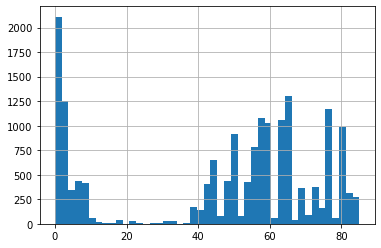

In [88]:
dfres['changecurvecounter'].hist(bins=45)

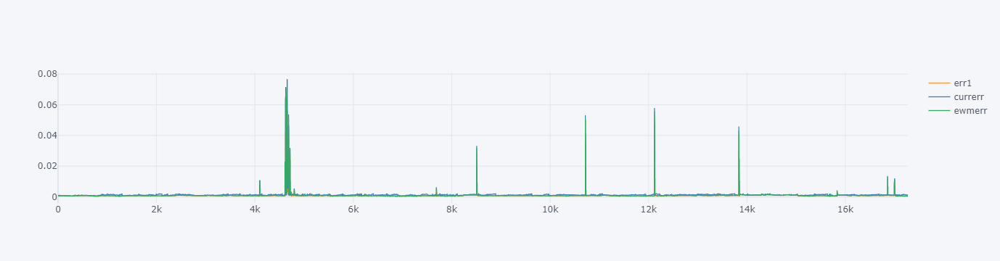

In [80]:
dfres[['err1','currerr','ewmerr']].iplot()

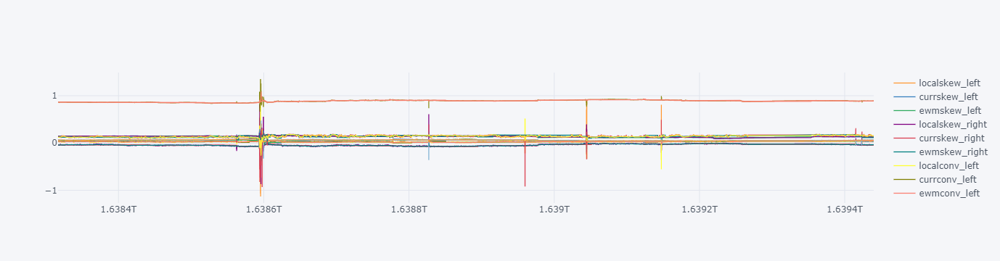

In [81]:
dfres.set_index('t',drop=True)[ptoplot].iplot()

In [ ]:
cusum 

In [89]:
dfres

,t,expire,df,localcurve,currcurve,err1,err2,currerr,changecurvecounter,localATM,...,ewmskew_right,ewmconv_left,ewmconv_right,ewmrightwing,ewmleftwing,localvol_atm,currvol_atm,ewmvol_atm,ewm_x,ewmerr
0,1638316800000,1648195200000,ty s aiv biv v...,<cryptoderiv_quantlib.volatility.data_objects....,<cryptoderiv_quantlib.volatility.data_objects....,0.000756,0.000756,0.000756,0,0.863542,...,-0.038766,0.031284,0.058440,0.142149,0.119561,0.863542,0.863542,0.863542,"[0.03949719586063145, -0.038765937271655664, 0...",0.000756
1,1638316860000,1648195200000,ty s aiv biv v...,<cryptoderiv_quantlib.volatility.data_objects....,<cryptoderiv_quantlib.volatility.data_objects....,0.000752,0.000773,0.000773,0,0.862884,...,-0.038411,0.029234,0.058758,0.141552,0.119899,0.862884,0.863542,0.863195,"[0.04224908942688994, -0.03841119896184843, 0....",0.000757
2,1638316920000,1648195200000,ty s aiv biv v...,<cryptoderiv_quantlib.volatility.data_objects....,<cryptoderiv_quantlib.volatility.data_objects....,0.000766,0.000825,0.000825,0,0.866108,...,-0.040874,0.028897,0.060312,0.141029,0.120940,0.866108,0.863542,0.864270,"[0.04126354223666989, -0.040873697194715584, 0...",0.000777
3,1638316980000,1648195200000,ty s aiv biv v...,<cryptoderiv_quantlib.volatility.data_objects....,<cryptoderiv_quantlib.volatility.data_objects....,0.000718,0.000851,0.000851,0,0.868192,...,-0.043418,0.028594,0.061769,0.140431,0.121552,0.868192,0.863542,0.865411,"[0.040467734597505634, -0.04341818808914003, 0...",0.000737
4,1638317040000,1648195200000,ty s aiv biv v...,<cryptoderiv_quantlib.volatility.data_objects....,<cryptoderiv_quantlib.volatility.data_objects....,0.000713,0.000773,0.000773,0,0.865306,...,-0.044063,0.027706,0.062129,0.140560,0.121677,0.865306,0.863542,0.865385,"[0.04169744249580594, -0.04406310083920882, 0....",0.000732
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17265,1639439700000,1648195200000,ty s aiv biv ve...,<cryptoderiv_quantlib.volatility.data_objects....,<cryptoderiv_quantlib.volatility.data_objects....,0.000492,0.001240,0.001240,85,0.887852,...,-0.037942,0.045204,0.057054,0.121411,0.150062,0.887852,0.891016,0.888336,"[0.03776694967296091, -0.037942010310931605, 0...",0.000558
17266,1639439760000,1648195200000,ty s aiv biv ve...,<cryptoderiv_quantlib.volatility.data_objects....,<cryptoderiv_quantlib.volatility.data_objects....,0.000500,0.001199,0.001199,85,0.888010,...,-0.037893,0.045041,0.057020,0.121411,0.150239,0.888010,0.891016,0.888303,"[0.037994354520110456, -0.03789300680701019, 0...",0.000507
17267,1639439820000,1648195200000,ty s aiv biv ve...,<cryptoderiv_quantlib.volatility.data_objects....,<cryptoderiv_quantlib.volatility.data_objects....,0.000432,0.001139,0.001139,85,0.888208,...,-0.037885,0.044879,0.057060,0.121367,0.150465,0.888208,0.891016,0.888293,"[0.03817421915221212, -0.037884824311650606, 0...",0.000444
17268,1639439880000,1648195200000,ty s aiv biv ve...,<cryptoderiv_quantlib.volatility.data_objects....,<cryptoderiv_quantlib.volatility.data_objects....,0.000446,0.001174,0.001174,85,0.888202,...,-0.038014,0.044713,0.057197,0.121260,0.150643,0.888202,0.891016,0.888284,"[0.0384383377213638, -0.03801364384876071, 0.0...",0.000447
